In [1]:
import matplotlib.pyplot as plt
import numpy as np
from torch.utils.data.sampler import SubsetRandomSampler
import sys, os
import pandas as pd

sys.path.append('../ConformalizedES')
sys.path.append('../third_party')
os.environ["KMP_DUPLICATE_LIB_OK"]="TRUE"

In [2]:
colors = [[31, 120, 180], [51, 160, 44], [250,159,181]]
colors = [(r / 255, g / 255, b / 255) for (r, g, b) in colors]

def plot_loss_acc(train_loss, val_loss, train_acc, val_acc):
    
    x = np.arange(1, len(train_loss) + 1)

    fig,axs = plt.subplots(1, 2, figsize=(16,6))
    axs[0].plot(x, train_loss, color=colors[0], label="Training loss", linewidth=2)
    axs[0].plot(x, val_loss, color=colors[1], label="Validation loss", linewidth=2)
    axs[0].set_xlabel('Epoch')
    axs[0].set_ylabel('Loss')
    axs[0].legend(loc='upper right')
    axs[0].set_title("Evolution of the training, validation and test loss")

    axs[1].plot(x, train_acc, color=colors[0], label="Training accuracy", linewidth=2)
    axs[1].plot(x, val_acc, color=colors[1], label="Validation accuracy", linewidth=2)
    axs[1].set_xlabel('Epoch')
    axs[1].set_ylabel('Accuracy')
    axs[1].legend(loc='lower right')
    axs[1].set_title("Evolution of the training, validation and test accuracy")
    plt.show()
    

def plot_loss(train_loss, val_loss):
    x = np.arange(1, len(train_loss) + 1)

    plt.figure()
    plt.plot(x, train_loss, color=colors[0], label="Training loss", linewidth=2)
    plt.plot(x, val_loss, color=colors[1], label="Validation loss", linewidth=2)
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend(loc='upper right')
    plt.title("Evolution of the training, validation and test loss")
    
    plt.show()

def plot_pvals(pvals, labels):
    idx_in = np.where(labels==0)[0]
    idx_out = np.where(labels==1)[0]

    pvals_in = np.array(pvals)[idx_in]
    pvals_out = np.array(pvals)[idx_out]

    plt.figure(figsize=(8,6))
    plt.hist(pvals_in, bins=100, alpha=0.5, label="inliers")
    plt.hist(pvals_out, bins=100, alpha=0.5, label="outliers")
    plt.legend()
    plt.show

    print('Average p-value for inliers is {:3f}, average p-value for outliers is {:3f}.'\
          .format(np.mean(pvals_in), np.mean(pvals_out)))

In [3]:
from torch.utils.data import Dataset
from sklearn.datasets import make_blobs

class Blob_dataset(Dataset):
    def __init__(self,n_samples, centers, n_features, std):
        self.X, self.y = make_blobs(n_samples=n_samples, centers=centers, 
                          n_features=n_features, cluster_std=std)
        self.X = self.X.astype('float32')
        self.y = self.y.astype('int64')
        
    def __len__(self):
        return len(self.y)
    
    def __getitem__(self, index):
        return self.X[index], self.y[index]

In [4]:
# def split_data(seed, inlier_set, outlier_set, n_train_bm, n_val_bm, n_cal_bm, batch_size=10, num_workers=0):
#     np.random.seed(seed)
#     th.manual_seed(seed)

#     n_full = len(train_set)
#     n_data = n_train_bm + n_val_bm

#     train_set_bm, val_set_bm, _ = th.utils.data.random_split(train_set,\
#                                      [n_train_bm, n_val_bm, n_full-n_data])

#     # CES data splitting: calibration set is not needed, merge back to the training set
#     n_train_ces = n_train_bm + n_val_bm

#     train_set_ces, _ = th.utils.data.random_split(train_set,\
#                                      [n_train_ces, n_full-n_data])
    
#     train_loader_bm = th.utils.data.DataLoader(train_set_bm, batch_size=batch_size,
#                                           num_workers=num_workers)

#     val_loader_bm = th.utils.data.DataLoader(val_set_bm, batch_size=n_val_bm,
#                                               num_workers=num_workers)

#     # For CES
#     train_loader_ces = th.utils.data.DataLoader(train_set_ces, batch_size=batch_size,
#                                               num_workers=num_workers)

#     return train_loader_bm, val_loader_bm, train_loader_ces

def load_train(seed, train_set, n_train, batch_size=10, num_workers=0):
    np.random.seed(seed)
    th.manual_seed(seed)
    n_full = len(train_set)

    train_set, _ = th.utils.data.random_split(train_set, [n_train, n_full-n_train])
    train_loader = th.utils.data.DataLoader(train_set, batch_size=batch_size,
                                          num_workers=num_workers)
    return train_loader


def load_test(seed, test_set, n_test, num_workers=0):
    np.random.seed(seed)
    th.manual_seed(seed)

    test_sampler = SubsetRandomSampler(np.arange(n_test, dtype=np.int64))
    test_loader = th.utils.data.DataLoader(test_set, batch_size=n_test, sampler=test_sampler,
                                             num_workers=num_workers)

    # get all test images
    dataiter = iter(test_loader)
    inputs, labels = dataiter.next()
    return inputs, labels

def load_val_cal(seed, val_set, n_val, n_cal, batch_size=10, num_workers=0):
    np.random.seed(seed)
    th.manual_seed(seed)
    
    n_full = len(val_set)
    n_data = n_val+n_cal

    val_set, cal_set, _ = th.utils.data.random_split(val_set, [n_val, n_cal, n_full-n_data])
    cal_loader = th.utils.data.DataLoader(cal_set, batch_size=batch_size,
                                             num_workers=num_workers)
    val_loader = th.utils.data.DataLoader(val_set, batch_size=batch_size,
                                             num_workers=num_workers)

    return val_loader, cal_loader

In [5]:
import torch.nn as nn
import torch as th
import torch.nn.functional as F
import pdb

class SimpleNN(nn.Module):
    def __init__(self, in_shape, out_shape, hidden_size=32):
        super(SimpleNN, self).__init__()
        
        self.in_shape = in_shape
        self.out_shape = out_shape
        self.hidden_size = hidden_size
    
        self.build_model()
        self.init_weights()
        
    def init_weights(self):
        for m in self.base_model:
            if isinstance(m, nn.Linear):
                th.nn.init.xavier_uniform(m.weight)
                m.bias.data.fill_(0.01)
    
    def build_model(self):
        self.base_model = nn.Sequential(
            nn.Linear(self.in_shape, self.hidden_size),
            nn.ReLU(),
            nn.Linear(self.hidden_size, self.out_shape),
        )
        
    def forward(self, x):
        """
        Forward pass
        """
        return self.base_model(x)
    
    def predict_prob(self, inputs):
        """
        Predict probabilities given any input data
        """
        self.eval()
       
        get_prob = nn.Softmax(dim = 1)
        with th.no_grad():
            logits = self(inputs)    # Assume inputs are already on the correct device
            prob = get_prob(logits).cpu().numpy()
        return prob
    
    # Let the anomaly score be the probability of being an outlier
    def get_anomaly_scores(self,inputs):
#         pdb.set_trace()
        if len(inputs.shape) == 1:
            inputs = inputs[None,]
        full_prob = self.predict_prob(inputs)
        return list(full_prob[:,1])

In [6]:
from method import CES_oneClass
from utils import eval_pvalues
import torch.optim as optim
from inference import Conformal_PVals
import pdb

def run_experiment(seed, train_set, n_train, val_set, n_val, n_cal, test_set, n_test,
                   lr, n_epoch, alpha_list, batch_size=10, num_worker=0, visualize=True):
    # Initialize result data frame
    results = pd.DataFrame({})
    
    # Get the dataloaders and test points
    train_loader_bm, train_loader_ces = load_train(seed, train_set, n_train, batch_size),\
                                        load_train(seed, train_set, n_train, batch_size)
    val_loader_bm, cal_loader_bm = load_val_cal(seed, val_set, n_val, n_cal)
    val_loader_ces, _ = load_val_cal(seed, val_set, n_val, n_cal)

    inputs, labels = load_test(seed, test_set, n_test)
    
    
    # Define default device, we should use the GPU (cuda) if available
    device = th.device("cuda" if th.cuda.is_available() else "cpu")### Define subset of the dataset (so it is faster to train)
    if th.cuda.is_available():
        # Make CuDNN Determinist
        th.backends.cudnn.deterministic = True
        th.cuda.manual_seed(seed)
#     Set the NN parameters 
    net_bm = SimpleNN(in_shape=inputs.shape[1], out_shape=2)
    Loss = th.nn.CrossEntropyLoss()
    def criterion(outputs, inputs, targets):
        return Loss(outputs, targets)
#     optimizer_bm = optim.Adam(net_bm.parameters(), lr=lr)
    optimizer_bm = optim.SGD(net_bm.parameters(), lr=lr)

    
    np.random.seed(seed)
    th.manual_seed(seed)
    
    # Train with benchmark data splitting
    print("Training with standard data splitting...")
    sys.stdout.flush()
    
    CES_oc_bm = CES_oneClass(net_bm, device, train_loader_bm, batch_size=batch_size, max_epoch=n_epoch, 
                        learning_rate=lr, val_loader=val_loader_bm, criterion=criterion,optimizer=optimizer_bm)
    CES_oc_bm.full_train(save_dir = './models/oneClass/exp'+str(seed)+'/benchmarks/', save_every = 1)
    
    if visualize:
        plot_loss_acc(CES_oc_bm.train_loss_history, CES_oc_bm.val_loss_history, 
                      CES_oc_bm.train_acc_history, CES_oc_bm.val_acc_history)
    
    # Compute the benchmark p-values
    print('Computing standard benchmark p-values for {:d} test points...'.format(n_test))
    sys.stdout.flush()
    
    best_loss_bm, best_model_bm, val_loss_history_bm = CES_oc_bm.select_model()
#     pdb.set_trace()
    model_list_bm = CES_oc_bm.model_list
    C_PVals_bm = Conformal_PVals(net_bm, device, cal_loader_bm, model_list_bm, random_state = seed)
    pvals_bm = C_PVals_bm.compute_pvals(inputs, [best_model_bm]*len(inputs))
    results_bm = eval_pvalues(pvals_bm, labels, alpha_list)
    results_bm["Method"] = "Standard benchmark"
    results_bm["train_loss_history"] = [CES_oc_bm.train_loss_history]
    results_bm["val_loss_history"] = [CES_oc_bm.val_loss_history]
    results_bm["train_acc_history"] = [CES_oc_bm.train_acc_history]
    results_bm["val_acc_history"] = [CES_oc_bm.val_acc_history]
    results = pd.concat([results, results_bm])
    
    
    np.random.seed(seed)
    th.manual_seed(seed)

    net_ces = SimpleNN(in_shape=inputs.shape[1], out_shape=2)
#     optimizer_ces = optim.Adam(net_ces.parameters(), lr=lr)
    optimizer_ces = optim.SGD(net_ces.parameters(), lr=lr)
    
    
    # Initialize the CES class with model parameters
    print("Training with CES data splitting...")
    sys.stdout.flush()
    
    CES_oc_ces = CES_oneClass(net_ces, device, train_loader_ces, batch_size=batch_size, max_epoch=n_epoch, 
                            learning_rate=lr, val_loader=val_loader_ces, criterion=criterion,optimizer=optimizer_ces)
    CES_oc_ces.full_train(save_dir = './models/oneClass/exp'+str(seed)+'/ces/', save_every = 1)
    
    if visualize:
        plot_loss_acc(CES_oc_ces.train_loss_history, CES_oc_ces.val_loss_history, 
                      CES_oc_ces.train_acc_history, CES_oc_ces.val_acc_history)
    
    model_list_ces = CES_oc_ces.model_list
    C_PVals_ces = Conformal_PVals(net_ces, device, val_loader_ces, model_list_ces, random_state = seed)
    
    # Compute the benchmark p-values
    print('Computing naive benchmark p-values for {:d} test points...'.format(n_test))
    best_loss_naive, best_model_naive, val_loss_history_naive = CES_oc_ces.select_model()
    pvals_naive = C_PVals_ces.compute_pvals(inputs, [best_model_naive]*len(inputs))
    results_naive = eval_pvalues(pvals_naive, labels, alpha_list)
    results_naive["Method"] = "Naive benchmark"
    results_naive["train_loss_history"] = [CES_oc_ces.train_loss_history]
    results_naive["val_loss_history"] = [CES_oc_ces.val_loss_history]
    results_naive["train_acc_history"] = [CES_oc_ces.train_acc_history]
    results_naive["val_acc_history"] = [CES_oc_ces.val_acc_history]
    results = pd.concat([results, results_naive])
    
    return results


In [7]:
# Define the model parameters
n_train = 100
n_val = 20
n_cal = 20
batch_size = 10 
n_test = 500
lr = 1
alpha_list = [0.1]
n_epoch = 200
n_classes = 2
num_repetitions = 50

# center and standard deviation of the blobs
centers = np.array([[0,0],[3,3]])
null_center =  np.array([[0,0]])
std = 2
n_features = 2
train_set = Blob_dataset(5000, centers, n_features, std)
val_set =  Blob_dataset(5000, null_center, n_features, std)
test_set = Blob_dataset(5000, centers, n_features, std)

<function matplotlib.pyplot.show(close=None, block=None)>

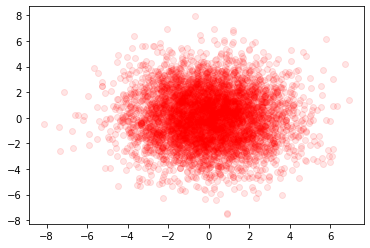

In [8]:
# def plot_blobs(n_classes)
plt.scatter(val_set.X[val_set.y==0][:,0], val_set.X[val_set.y==0][:,1], c='r', alpha=0.1)
plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

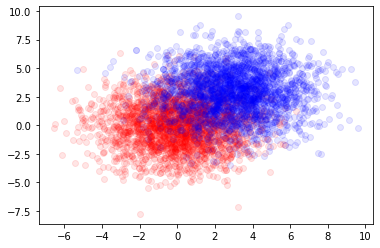

In [9]:
# def plot_blobs(n_classes)
plt.scatter(test_set.X[test_set.y==0][:,0], test_set.X[test_set.y==0][:,1], c='r', alpha=0.1)
plt.scatter(test_set.X[test_set.y==1][:,0], test_set.X[test_set.y==1][:,1], c='b', alpha=0.1)
plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

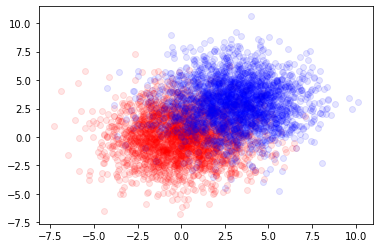

In [10]:
# def plot_blobs(n_classes)
plt.scatter(train_set.X[train_set.y==0][:,0], train_set.X[train_set.y==0][:,1], c='r', alpha=0.1)
plt.scatter(train_set.X[train_set.y==1][:,0], train_set.X[train_set.y==1][:,1], c='b', alpha=0.1)
plt.show


Starting repetition 1 of 50:

Training with standard data splitting...
===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 1.05 train_acc: 40.00% took: 0.05s
Epoch 1 of 200, 20% 	 train_loss: 3.01 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 1.91 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 1.66 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 5.70 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.38 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.86 train_acc: 60.00% took: 0.02s
Epoch 1 of 200, 90% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
val_loss = 0.38 val_acc = 80.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 1.00 train_acc: 40.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss:

C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)



Epoch 4 of 200, 20% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 4 of 200, 30% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 4 of 200, 40% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 4 of 200, 50% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 4 of 200, 60% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 4 of 200, 70% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 4 of 200, 80% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 4 of 200, 90% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 4 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.01s
val_loss = 0.52 val_acc = 60.00%
Snapshot saved at epoch 4.
Epoch 5 of 200, 10% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 5 of 200, 20% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 5 of 200, 30% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 5 of 200, 40% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 5 of 200, 50% 	 train_loss: 0.24 

val_loss = 0.46 val_acc = 75.00%
Snapshot saved at epoch 14.
Epoch 15 of 200, 10% 	 train_loss: 0.59 train_acc: 80.00% took: 0.01s
Epoch 15 of 200, 20% 	 train_loss: 0.31 train_acc: 70.00% took: 0.00s
Epoch 15 of 200, 30% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 40% 	 train_loss: 0.24 train_acc: 90.00% took: 0.01s
Epoch 15 of 200, 50% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 15 of 200, 60% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 15 of 200, 70% 	 train_loss: 0.19 train_acc: 80.00% took: 0.00s
Epoch 15 of 200, 80% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 90% 	 train_loss: 0.41 train_acc: 80.00% took: 0.01s
Epoch 15 of 200, 100% 	 train_loss: 0.39 train_acc: 90.00% took: 0.01s
val_loss = 0.50 val_acc = 75.00%
Snapshot saved at epoch 15.
Epoch 16 of 200, 10% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 20% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 30% 	 train_loss: 

Epoch 27 of 200, 10% 	 train_loss: 0.57 train_acc: 80.00% took: 0.02s
Epoch 27 of 200, 20% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 30% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 40% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 50% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 60% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 70% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 80% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 90% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 100% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
val_loss = 0.50 val_acc = 75.00%
Snapshot saved at epoch 27.
Epoch 28 of 200, 10% 	 train_loss: 0.58 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 20% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 30% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 40% 	 tr

Epoch 38 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 60% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 70% 	 train_loss: 0.18 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 80% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 90% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 100% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
val_loss = 0.53 val_acc = 75.00%
Snapshot saved at epoch 38.
Epoch 39 of 200, 10% 	 train_loss: 0.58 train_acc: 80.00% took: 0.00s
Epoch 39 of 200, 20% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 39 of 200, 30% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 39 of 200, 40% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 39 of 200, 50% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 39 of 200, 60% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 39 of 200, 70% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 39 of 200, 80% 	 

val_loss = 0.49 val_acc = 75.00%
Snapshot saved at epoch 52.
Epoch 53 of 200, 10% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
Epoch 53 of 200, 20% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 53 of 200, 30% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 53 of 200, 40% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 53 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 53 of 200, 60% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 53 of 200, 70% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 53 of 200, 80% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 53 of 200, 90% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 53 of 200, 100% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
val_loss = 0.51 val_acc = 75.00%
Snapshot saved at epoch 53.
Epoch 54 of 200, 10% 	 train_loss: 0.58 train_acc: 80.00% took: 0.00s
Epoch 54 of 200, 20% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 54 of 200, 30% 	 train_loss:

Epoch 63 of 200, 100% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
val_loss = 0.53 val_acc = 75.00%
Snapshot saved at epoch 63.
Epoch 64 of 200, 10% 	 train_loss: 0.58 train_acc: 80.00% took: 0.00s
Epoch 64 of 200, 20% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 64 of 200, 30% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 64 of 200, 40% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 64 of 200, 50% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 64 of 200, 60% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 64 of 200, 70% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 64 of 200, 80% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 64 of 200, 90% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 64 of 200, 100% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
val_loss = 0.53 val_acc = 70.00%
Snapshot saved at epoch 64.
Epoch 65 of 200, 10% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
Epoch 65 of 200, 20% 	 train_loss

Epoch 78 of 200, 20% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 78 of 200, 30% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 78 of 200, 40% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 78 of 200, 50% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 78 of 200, 60% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 78 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 78 of 200, 80% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 78 of 200, 90% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 78 of 200, 100% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
val_loss = 0.51 val_acc = 80.00%
Snapshot saved at epoch 78.
Epoch 79 of 200, 10% 	 train_loss: 0.58 train_acc: 80.00% took: 0.00s
Epoch 79 of 200, 20% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 79 of 200, 30% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 79 of 200, 40% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 79 of 200, 50% 	 tra

val_loss = 0.48 val_acc = 80.00%
Snapshot saved at epoch 88.
Epoch 89 of 200, 10% 	 train_loss: 0.58 train_acc: 80.00% took: 0.00s
Epoch 89 of 200, 20% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 30% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 89 of 200, 40% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 50% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 89 of 200, 60% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 89 of 200, 70% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 89 of 200, 80% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 90% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 89 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
val_loss = 0.56 val_acc = 70.00%
Snapshot saved at epoch 89.
Epoch 90 of 200, 10% 	 train_loss: 0.58 train_acc: 80.00% took: 0.00s
Epoch 90 of 200, 20% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 90 of 200, 30% 	 train_loss

Epoch 99 of 200, 90% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 99 of 200, 100% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
val_loss = 0.57 val_acc = 75.00%
Snapshot saved at epoch 99.
Epoch 100 of 200, 10% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 20% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 100 of 200, 30% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 100 of 200, 40% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 50% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 100 of 200, 60% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 100 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 100 of 200, 80% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 90% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 100% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
val_loss = 0.55 val_acc = 75.00%
Snapshot saved at epoch 100.
Epoch 101 of 200, 10

Epoch 114 of 200, 70% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 114 of 200, 80% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 114 of 200, 90% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 114 of 200, 100% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
val_loss = 0.50 val_acc = 75.00%
Snapshot saved at epoch 114.
Epoch 115 of 200, 10% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
Epoch 115 of 200, 20% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 115 of 200, 30% 	 train_loss: 0.10 train_acc: 100.00% took: 0.02s
Epoch 115 of 200, 40% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 115 of 200, 50% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 115 of 200, 60% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 115 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 115 of 200, 80% 	 train_loss: 0.22 train_acc: 90.00% took: 0.02s
Epoch 115 of 200, 90% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 115

Epoch 125 of 200, 30% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 125 of 200, 40% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 125 of 200, 50% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 125 of 200, 60% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 125 of 200, 70% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 125 of 200, 80% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 125 of 200, 90% 	 train_loss: 0.62 train_acc: 70.00% took: 0.00s
Epoch 125 of 200, 100% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
val_loss = 0.56 val_acc = 75.00%
Snapshot saved at epoch 125.
Epoch 126 of 200, 10% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
Epoch 126 of 200, 20% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 126 of 200, 30% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 126 of 200, 40% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 126 of 200, 50% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 12

val_loss = 0.51 val_acc = 75.00%
Snapshot saved at epoch 135.
Epoch 136 of 200, 10% 	 train_loss: 0.53 train_acc: 80.00% took: 0.01s
Epoch 136 of 200, 20% 	 train_loss: 0.18 train_acc: 90.00% took: 0.01s
Epoch 136 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 136 of 200, 40% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 136 of 200, 50% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 136 of 200, 60% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 136 of 200, 70% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 136 of 200, 80% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 136 of 200, 90% 	 train_loss: 0.56 train_acc: 80.00% took: 0.01s
Epoch 136 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 0.47 val_acc = 75.00%
Snapshot saved at epoch 136.
Epoch 137 of 200, 10% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 137 of 200, 20% 	 train_loss: 0.18 train_acc: 90.00% took: 0.02s
Epoch 137 of 200, 3

val_loss = 0.39 val_acc = 85.00%
Snapshot saved at epoch 150.
Epoch 151 of 200, 10% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 151 of 200, 20% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 151 of 200, 30% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 151 of 200, 40% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 151 of 200, 50% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 151 of 200, 60% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 151 of 200, 70% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 151 of 200, 80% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 151 of 200, 90% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 151 of 200, 100% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
val_loss = 0.40 val_acc = 85.00%
Snapshot saved at epoch 151.
Epoch 152 of 200, 10% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 152 of 200, 20% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 152 of 200, 

Epoch 161 of 200, 60% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 161 of 200, 70% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 161 of 200, 80% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 161 of 200, 90% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 161 of 200, 100% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
val_loss = 0.41 val_acc = 85.00%
Snapshot saved at epoch 161.
Epoch 162 of 200, 10% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 162 of 200, 20% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 162 of 200, 30% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 162 of 200, 40% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 162 of 200, 50% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 162 of 200, 60% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 162 of 200, 70% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 162 of 200, 80% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 1

Epoch 175 of 200, 100% 	 train_loss: 0.94 train_acc: 90.00% took: 0.00s
val_loss = 0.49 val_acc = 80.00%
Snapshot saved at epoch 175.
Epoch 176 of 200, 10% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
Epoch 176 of 200, 20% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 176 of 200, 30% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 176 of 200, 40% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 176 of 200, 50% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 176 of 200, 60% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 176 of 200, 70% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 176 of 200, 80% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 176 of 200, 90% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 176 of 200, 100% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
val_loss = 0.63 val_acc = 75.00%
Snapshot saved at epoch 176.
Epoch 177 of 200, 10% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
Epoch 177 of 200, 2

Epoch 191 of 200, 20% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 191 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 191 of 200, 40% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 191 of 200, 50% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 191 of 200, 60% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 191 of 200, 70% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 191 of 200, 80% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 191 of 200, 90% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 191 of 200, 100% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
val_loss = 0.42 val_acc = 80.00%
Snapshot saved at epoch 191.
Epoch 192 of 200, 10% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 192 of 200, 20% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 192 of 200, 30% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 192 of 200, 40% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 192 

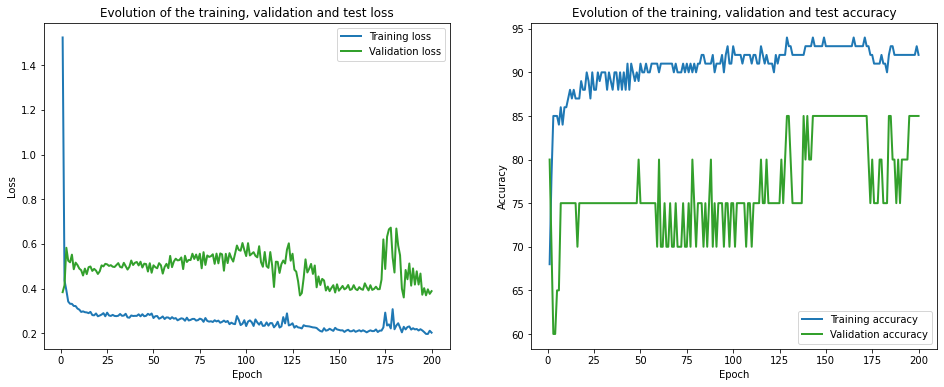

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 158.02it/s]


Initialization done!


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1017.71it/s]


Finished computing p-values for 500 test points.
Training with CES data splitting...


C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.57 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 1.13 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 3.88 train_acc: 30.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 1.22 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.99 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 1.07 train_acc: 70.00% took: 0.00s
val_loss = 0.83 val_acc = 85.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 2.65 train_acc: 50.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 

Epoch 11 of 200, 100% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
val_loss = 0.22 val_acc = 90.00%
Snapshot saved at epoch 11.
Epoch 12 of 200, 10% 	 train_loss: 0.55 train_acc: 60.00% took: 0.00s
Epoch 12 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 30% 	 train_loss: 0.43 train_acc: 70.00% took: 0.02s
Epoch 12 of 200, 40% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 50% 	 train_loss: 0.07 train_acc: 100.00% took: 0.01s
Epoch 12 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 70% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 80% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 90% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 100% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
val_loss = 0.25 val_acc = 85.00%
Snapshot saved at epoch 12.
Epoch 13 of 200, 10% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 13 of 200, 20% 	 train_loss

Epoch 27 of 200, 20% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 40% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 50% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 60% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 70% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 80% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 90% 	 train_loss: 0.69 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 100% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
val_loss = 0.34 val_acc = 85.00%
Snapshot saved at epoch 27.
Epoch 28 of 200, 10% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 20% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 30% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 50% 	 t

Epoch 43 of 200, 40% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 43 of 200, 50% 	 train_loss: 0.04 train_acc: 100.00% took: 0.01s
Epoch 43 of 200, 60% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 43 of 200, 70% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 43 of 200, 80% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 43 of 200, 90% 	 train_loss: 0.92 train_acc: 80.00% took: 0.00s
Epoch 43 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
val_loss = 0.27 val_acc = 85.00%
Snapshot saved at epoch 43.
Epoch 44 of 200, 10% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 44 of 200, 20% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 44 of 200, 30% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 44 of 200, 40% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 44 of 200, 50% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 44 of 200, 60% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 44 of 200, 70% 	 

val_loss = 0.25 val_acc = 85.00%
Snapshot saved at epoch 58.
Epoch 59 of 200, 10% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 59 of 200, 20% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 59 of 200, 30% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 59 of 200, 40% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 59 of 200, 50% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 59 of 200, 60% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 59 of 200, 70% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 59 of 200, 80% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 59 of 200, 90% 	 train_loss: 0.99 train_acc: 80.00% took: 0.00s
Epoch 59 of 200, 100% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
val_loss = 0.30 val_acc = 85.00%
Snapshot saved at epoch 59.
Epoch 60 of 200, 10% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 60 of 200, 20% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 60 of 200, 30% 	 train_loss: 

Epoch 75 of 200, 40% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 75 of 200, 50% 	 train_loss: 0.04 train_acc: 100.00% took: 0.01s
Epoch 75 of 200, 60% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 75 of 200, 70% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 75 of 200, 80% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 75 of 200, 90% 	 train_loss: 1.02 train_acc: 80.00% took: 0.00s
Epoch 75 of 200, 100% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
val_loss = 0.27 val_acc = 85.00%
Snapshot saved at epoch 75.
Epoch 76 of 200, 10% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 76 of 200, 20% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 76 of 200, 30% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 76 of 200, 40% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 76 of 200, 50% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 76 of 200, 60% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 76 of 200, 70% 	 tr

Epoch 86 of 200, 60% 	 train_loss: 0.08 train_acc: 90.00% took: 0.02s
Epoch 86 of 200, 70% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 86 of 200, 80% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 86 of 200, 90% 	 train_loss: 1.00 train_acc: 80.00% took: 0.00s
Epoch 86 of 200, 100% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
val_loss = 0.29 val_acc = 85.00%
Snapshot saved at epoch 86.
Epoch 87 of 200, 10% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 87 of 200, 20% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 87 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 87 of 200, 40% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 87 of 200, 50% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 87 of 200, 60% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 87 of 200, 70% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 87 of 200, 80% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 87 of 200, 90% 	 t

Epoch 102 of 200, 60% 	 train_loss: 0.08 train_acc: 90.00% took: 0.02s
Epoch 102 of 200, 70% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 102 of 200, 80% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 102 of 200, 90% 	 train_loss: 0.99 train_acc: 80.00% took: 0.00s
Epoch 102 of 200, 100% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
val_loss = 0.29 val_acc = 85.00%
Snapshot saved at epoch 102.
Epoch 103 of 200, 10% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 103 of 200, 20% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 103 of 200, 30% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 103 of 200, 40% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 103 of 200, 50% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 103 of 200, 60% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 103 of 200, 70% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 103 of 200, 80% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 103 

Epoch 113 of 200, 60% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 113 of 200, 70% 	 train_loss: 0.07 train_acc: 100.00% took: 0.01s
Epoch 113 of 200, 80% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 113 of 200, 90% 	 train_loss: 1.02 train_acc: 80.00% took: 0.00s
Epoch 113 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.27 val_acc = 85.00%
Snapshot saved at epoch 113.
Epoch 114 of 200, 10% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 114 of 200, 20% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 114 of 200, 30% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 114 of 200, 40% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 114 of 200, 50% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 114 of 200, 60% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 114 of 200, 70% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 114 of 200, 80% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 114 

Epoch 129 of 200, 10% 	 train_loss: 0.29 train_acc: 80.00% took: 0.02s
Epoch 129 of 200, 20% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 129 of 200, 30% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 129 of 200, 40% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 129 of 200, 50% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 129 of 200, 60% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 129 of 200, 70% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 129 of 200, 80% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 129 of 200, 90% 	 train_loss: 1.03 train_acc: 80.00% took: 0.00s
Epoch 129 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.27 val_acc = 85.00%
Snapshot saved at epoch 129.
Epoch 130 of 200, 10% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 130 of 200, 20% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 130 of 200, 30% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 130 o

val_loss = 0.29 val_acc = 85.00%
Snapshot saved at epoch 143.
Epoch 144 of 200, 10% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 144 of 200, 20% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 144 of 200, 30% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 144 of 200, 40% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 144 of 200, 50% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 144 of 200, 60% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 144 of 200, 70% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 144 of 200, 80% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 144 of 200, 90% 	 train_loss: 1.03 train_acc: 80.00% took: 0.00s
Epoch 144 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 0.26 val_acc = 85.00%
Snapshot saved at epoch 144.
Epoch 145 of 200, 10% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 145 of 200, 20% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 145 of 200, 30

val_loss = 0.26 val_acc = 85.00%
Snapshot saved at epoch 154.
Epoch 155 of 200, 10% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 155 of 200, 20% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 155 of 200, 30% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 155 of 200, 40% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 155 of 200, 50% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 155 of 200, 60% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 155 of 200, 70% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 155 of 200, 80% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 155 of 200, 90% 	 train_loss: 1.02 train_acc: 80.00% took: 0.00s
Epoch 155 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 0.28 val_acc = 85.00%
Snapshot saved at epoch 155.
Epoch 156 of 200, 10% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 156 of 200, 20% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 156 of 200, 30

Epoch 165 of 200, 90% 	 train_loss: 1.03 train_acc: 80.00% took: 0.02s
Epoch 165 of 200, 100% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
val_loss = 0.27 val_acc = 85.00%
Snapshot saved at epoch 165.
Epoch 166 of 200, 10% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 166 of 200, 20% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 30% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 166 of 200, 40% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 50% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 166 of 200, 60% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 70% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 166 of 200, 80% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 90% 	 train_loss: 1.02 train_acc: 80.00% took: 0.00s
Epoch 166 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 0.27 val_acc = 85.00%
Snapshot saved at epoch 166.
Epoch 167 of 200, 

Epoch 177 of 200, 10% 	 train_loss: 0.29 train_acc: 80.00% took: 0.01s
Epoch 177 of 200, 20% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 177 of 200, 30% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 177 of 200, 40% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 177 of 200, 50% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 177 of 200, 60% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 177 of 200, 70% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 177 of 200, 80% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 177 of 200, 90% 	 train_loss: 1.01 train_acc: 80.00% took: 0.00s
Epoch 177 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 0.29 val_acc = 85.00%
Snapshot saved at epoch 177.
Epoch 178 of 200, 10% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 178 of 200, 20% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 30% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 178 o

Epoch 192 of 200, 60% 	 train_loss: 0.08 train_acc: 90.00% took: 0.02s
Epoch 192 of 200, 70% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 192 of 200, 80% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 192 of 200, 90% 	 train_loss: 1.04 train_acc: 80.00% took: 0.00s
Epoch 192 of 200, 100% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
val_loss = 0.26 val_acc = 85.00%
Snapshot saved at epoch 192.
Epoch 193 of 200, 10% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 193 of 200, 20% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 193 of 200, 30% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 193 of 200, 40% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 193 of 200, 50% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 193 of 200, 60% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 193 of 200, 70% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 193 of 200, 80% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 193 

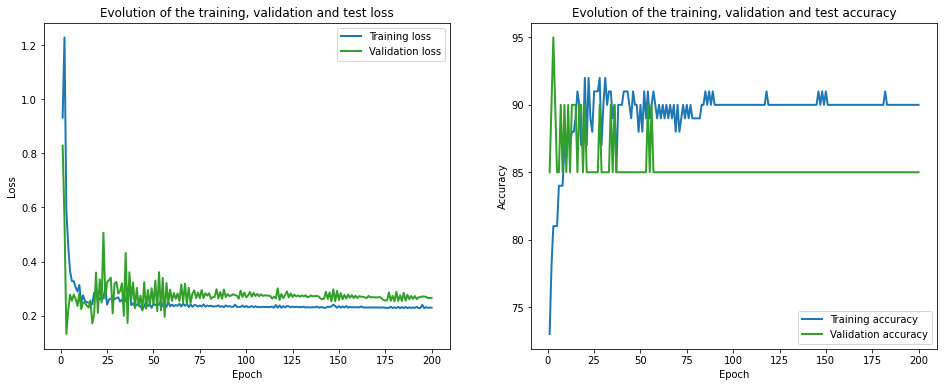

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 159.49it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1379.75it/s]

Finished computing p-values for 500 test points.

Starting repetition 2 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.70 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 3.31 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 1.03 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.62 train_acc: 70.00% took: 0.00s
val_loss = 0.11 val_acc = 100.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.57 train_acc: 60.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.88 train_acc: 60.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0

Epoch 11 of 200, 100% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
val_loss = 0.18 val_acc = 95.00%
Snapshot saved at epoch 11.
Epoch 12 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 20% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 30% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 40% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 50% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 60% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 70% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 80% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 90% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 12 of 200, 100% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
val_loss = 0.17 val_acc = 100.00%
Snapshot saved at epoch 12.
Epoch 13 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 13 of 200, 20% 	 train

Epoch 22 of 200, 70% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 22 of 200, 80% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 22 of 200, 90% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 22 of 200, 100% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
val_loss = 0.16 val_acc = 95.00%
Snapshot saved at epoch 22.
Epoch 23 of 200, 10% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 23 of 200, 20% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 23 of 200, 30% 	 train_loss: 0.08 train_acc: 90.00% took: 0.01s
Epoch 23 of 200, 40% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 23 of 200, 50% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 23 of 200, 60% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 23 of 200, 70% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 23 of 200, 80% 	 train_loss: 0.17 train_acc: 90.00% took: 0.02s
Epoch 23 of 200, 90% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 23 of 200, 100% 	 t

Epoch 33 of 200, 70% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 33 of 200, 80% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 33 of 200, 90% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 33 of 200, 100% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
val_loss = 0.14 val_acc = 95.00%
Snapshot saved at epoch 33.
Epoch 34 of 200, 10% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 34 of 200, 20% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 34 of 200, 30% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 34 of 200, 40% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 34 of 200, 50% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 34 of 200, 60% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 34 of 200, 70% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 34 of 200, 80% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 34 of 200, 90% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 34 of 200, 100% 	 t

Epoch 49 of 200, 90% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 49 of 200, 100% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
val_loss = 0.13 val_acc = 100.00%
Snapshot saved at epoch 49.
Epoch 50 of 200, 10% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 50 of 200, 20% 	 train_loss: 0.58 train_acc: 80.00% took: 0.00s
Epoch 50 of 200, 30% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 40% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 50 of 200, 50% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 50 of 200, 60% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 70% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 50 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 50 of 200, 90% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 50 of 200, 100% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
val_loss = 0.15 val_acc = 95.00%
Snapshot saved at epoch 50.
Epoch 51 of 200, 10% 	 train_l

Epoch 65 of 200, 10% 	 train_loss: 0.09 train_acc: 90.00% took: 0.01s
Epoch 65 of 200, 20% 	 train_loss: 0.66 train_acc: 80.00% took: 0.00s
Epoch 65 of 200, 30% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 65 of 200, 40% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 65 of 200, 50% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 65 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 65 of 200, 70% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 65 of 200, 80% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 65 of 200, 90% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 65 of 200, 100% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
val_loss = 0.14 val_acc = 95.00%
Snapshot saved at epoch 65.
Epoch 66 of 200, 10% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 66 of 200, 20% 	 train_loss: 0.61 train_acc: 70.00% took: 0.00s
Epoch 66 of 200, 30% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 66 of 200, 40% 	 

Epoch 80 of 200, 90% 	 train_loss: 0.35 train_acc: 70.00% took: 0.00s
Epoch 80 of 200, 100% 	 train_loss: 0.20 train_acc: 90.00% took: 0.01s
val_loss = 0.15 val_acc = 95.00%
Snapshot saved at epoch 80.
Epoch 81 of 200, 10% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 81 of 200, 20% 	 train_loss: 0.68 train_acc: 80.00% took: 0.00s
Epoch 81 of 200, 30% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 81 of 200, 40% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 81 of 200, 50% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 81 of 200, 60% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 81 of 200, 70% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 81 of 200, 80% 	 train_loss: 0.19 train_acc: 80.00% took: 0.00s
Epoch 81 of 200, 90% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 81 of 200, 100% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
val_loss = 0.14 val_acc = 95.00%
Snapshot saved at epoch 81.
Epoch 82 of 200, 10% 	 train_loss

Epoch 91 of 200, 60% 	 train_loss: 0.13 train_acc: 90.00% took: 0.02s
Epoch 91 of 200, 70% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 91 of 200, 80% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 91 of 200, 90% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 91 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.12 val_acc = 95.00%
Snapshot saved at epoch 91.
Epoch 92 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 92 of 200, 20% 	 train_loss: 0.64 train_acc: 70.00% took: 0.00s
Epoch 92 of 200, 30% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 92 of 200, 40% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 92 of 200, 50% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 92 of 200, 60% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 92 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 92 of 200, 80% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 92 of 200, 90% 	 t

Epoch 107 of 200, 40% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 107 of 200, 50% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 107 of 200, 60% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 107 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 107 of 200, 80% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 107 of 200, 90% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 107 of 200, 100% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
val_loss = 0.15 val_acc = 95.00%
Snapshot saved at epoch 107.
Epoch 108 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 108 of 200, 20% 	 train_loss: 0.66 train_acc: 70.00% took: 0.00s
Epoch 108 of 200, 30% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 108 of 200, 40% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 108 of 200, 50% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 108 of 200, 60% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 10

Epoch 122 of 200, 60% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 122 of 200, 70% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 122 of 200, 80% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 122 of 200, 90% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 122 of 200, 100% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
val_loss = 0.11 val_acc = 95.00%
Snapshot saved at epoch 122.
Epoch 123 of 200, 10% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 123 of 200, 20% 	 train_loss: 0.72 train_acc: 80.00% took: 0.00s
Epoch 123 of 200, 30% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 123 of 200, 40% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 123 of 200, 50% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 123 of 200, 60% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 123 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 123 of 200, 80% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 123 o

Epoch 138 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.02s
Epoch 138 of 200, 20% 	 train_loss: 0.66 train_acc: 70.00% took: 0.00s
Epoch 138 of 200, 30% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 138 of 200, 40% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 138 of 200, 50% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 138 of 200, 60% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 138 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 138 of 200, 80% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 138 of 200, 90% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 138 of 200, 100% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
val_loss = 0.13 val_acc = 95.00%
Snapshot saved at epoch 138.
Epoch 139 of 200, 10% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 139 of 200, 20% 	 train_loss: 0.70 train_acc: 80.00% took: 0.00s
Epoch 139 of 200, 30% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 139 

Epoch 153 of 200, 80% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 153 of 200, 90% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 153 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.15 val_acc = 95.00%
Snapshot saved at epoch 153.
Epoch 154 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 154 of 200, 20% 	 train_loss: 0.68 train_acc: 70.00% took: 0.00s
Epoch 154 of 200, 30% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 154 of 200, 40% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 154 of 200, 50% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 154 of 200, 60% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 154 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 154 of 200, 80% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 154 of 200, 90% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 154 of 200, 100% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
val_loss

Epoch 164 of 200, 40% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 164 of 200, 50% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 164 of 200, 60% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 164 of 200, 70% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 164 of 200, 80% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 164 of 200, 90% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 164 of 200, 100% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
val_loss = 0.11 val_acc = 100.00%
Snapshot saved at epoch 164.
Epoch 165 of 200, 10% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 165 of 200, 20% 	 train_loss: 0.75 train_acc: 80.00% took: 0.00s
Epoch 165 of 200, 30% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 165 of 200, 40% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 165 of 200, 50% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 165 of 200, 60% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 165

Epoch 175 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 175 of 200, 20% 	 train_loss: 0.75 train_acc: 80.00% took: 0.00s
Epoch 175 of 200, 30% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 175 of 200, 40% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 175 of 200, 50% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 175 of 200, 60% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 175 of 200, 70% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 175 of 200, 80% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 175 of 200, 90% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 175 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 0.17 val_acc = 95.00%
Snapshot saved at epoch 175.
Epoch 176 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 176 of 200, 20% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 176 of 200, 30% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 176

Epoch 189 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.01s
val_loss = 0.15 val_acc = 95.00%
Snapshot saved at epoch 189.
Epoch 190 of 200, 10% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 190 of 200, 20% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 190 of 200, 30% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 190 of 200, 40% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 190 of 200, 50% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 190 of 200, 60% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 190 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 190 of 200, 80% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 190 of 200, 90% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 190 of 200, 100% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
val_loss = 0.10 val_acc = 100.00%
Snapshot saved at epoch 190.
Epoch 191 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 191 of 200,

Epoch 200 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.09 val_acc = 100.00%
Snapshot saved at epoch 200.
Training done! A list of 200 models saved.


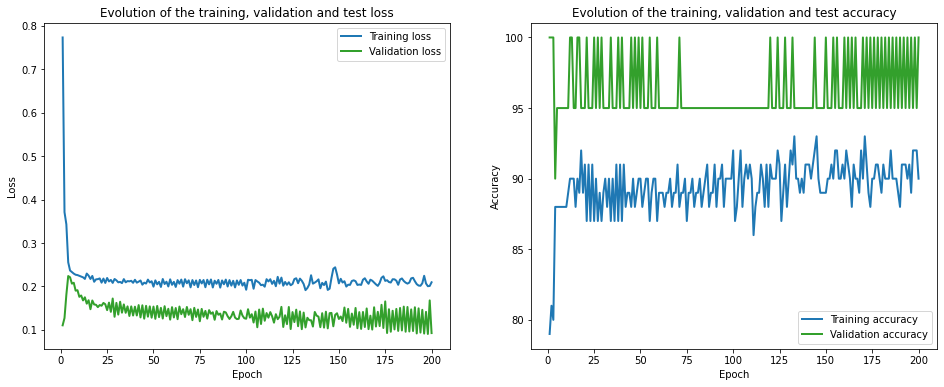

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 161.74it/s]


Initialization done!


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1204.40it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 1.87 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.67 train_acc: 70.00% took: 0.00s
val_loss = 0.11 val_acc = 100.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 1.10 train_acc: 30.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.79 train_acc: 60.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0

Epoch 11 of 200, 100% 	 train_loss: 0.21 train_acc: 100.00% took: 0.02s
val_loss = 0.18 val_acc = 95.00%
Snapshot saved at epoch 11.
Epoch 12 of 200, 10% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 20% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 30% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 40% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 50% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 60% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 70% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 80% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 90% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 12 of 200, 100% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
val_loss = 0.17 val_acc = 95.00%
Snapshot saved at epoch 12.
Epoch 13 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 13 of 200, 20% 	 train_l

Epoch 26 of 200, 50% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 26 of 200, 60% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 26 of 200, 70% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 26 of 200, 80% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 26 of 200, 90% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 26 of 200, 100% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
val_loss = 0.16 val_acc = 100.00%
Snapshot saved at epoch 26.
Epoch 27 of 200, 10% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 20% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 27 of 200, 30% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 40% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 50% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 70% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 80% 	

Epoch 37 of 200, 60% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 37 of 200, 70% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 37 of 200, 80% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 37 of 200, 90% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 37 of 200, 100% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
val_loss = 0.15 val_acc = 100.00%
Snapshot saved at epoch 37.
Epoch 38 of 200, 10% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 20% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 30% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 40% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 50% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 60% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 70% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 80% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 90% 	 

Epoch 48 of 200, 40% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 48 of 200, 50% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 48 of 200, 60% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 48 of 200, 70% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 48 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 48 of 200, 90% 	 train_loss: 0.40 train_acc: 70.00% took: 0.00s
Epoch 48 of 200, 100% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
val_loss = 0.16 val_acc = 95.00%
Snapshot saved at epoch 48.
Epoch 49 of 200, 10% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 49 of 200, 20% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 49 of 200, 30% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 49 of 200, 40% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 49 of 200, 50% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 49 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 49 of 200, 70% 	 t

Epoch 62 of 200, 100% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
val_loss = 0.16 val_acc = 95.00%
Snapshot saved at epoch 62.
Epoch 63 of 200, 10% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 63 of 200, 20% 	 train_loss: 0.60 train_acc: 70.00% took: 0.00s
Epoch 63 of 200, 30% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 63 of 200, 40% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 63 of 200, 50% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 63 of 200, 60% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 63 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 63 of 200, 80% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 63 of 200, 90% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 63 of 200, 100% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
val_loss = 0.14 val_acc = 95.00%
Snapshot saved at epoch 63.
Epoch 64 of 200, 10% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 64 of 200, 20% 	 train_loss

Epoch 79 of 200, 10% 	 train_loss: 0.07 train_acc: 100.00% took: 0.01s
Epoch 79 of 200, 20% 	 train_loss: 0.62 train_acc: 70.00% took: 0.00s
Epoch 79 of 200, 30% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 79 of 200, 40% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 79 of 200, 50% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 79 of 200, 60% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 79 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 79 of 200, 80% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 79 of 200, 90% 	 train_loss: 0.38 train_acc: 70.00% took: 0.00s
Epoch 79 of 200, 100% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
val_loss = 0.15 val_acc = 95.00%
Snapshot saved at epoch 79.
Epoch 80 of 200, 10% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 80 of 200, 20% 	 train_loss: 0.68 train_acc: 80.00% took: 0.00s
Epoch 80 of 200, 30% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 80 of 200, 40% 	 tr

val_loss = 0.16 val_acc = 95.00%
Snapshot saved at epoch 94.
Epoch 95 of 200, 10% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 95 of 200, 20% 	 train_loss: 0.62 train_acc: 70.00% took: 0.00s
Epoch 95 of 200, 30% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 95 of 200, 40% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 95 of 200, 50% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 95 of 200, 60% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 95 of 200, 70% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 95 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 95 of 200, 90% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 95 of 200, 100% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
val_loss = 0.15 val_acc = 95.00%
Snapshot saved at epoch 95.
Epoch 96 of 200, 10% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 96 of 200, 20% 	 train_loss: 0.65 train_acc: 80.00% took: 0.00s
Epoch 96 of 200, 30% 	 train_loss

Epoch 110 of 200, 60% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 110 of 200, 70% 	 train_loss: 0.22 train_acc: 80.00% took: 0.01s
Epoch 110 of 200, 80% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 110 of 200, 90% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 110 of 200, 100% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
val_loss = 0.17 val_acc = 95.00%
Snapshot saved at epoch 110.
Epoch 111 of 200, 10% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 20% 	 train_loss: 0.64 train_acc: 70.00% took: 0.00s
Epoch 111 of 200, 30% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 40% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 50% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 60% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 70% 	 train_loss: 0.19 train_acc: 80.00% took: 0.00s
Epoch 111 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 111

Epoch 121 of 200, 60% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 121 of 200, 70% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 121 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 121 of 200, 90% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 121 of 200, 100% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
val_loss = 0.15 val_acc = 95.00%
Snapshot saved at epoch 121.
Epoch 122 of 200, 10% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 122 of 200, 20% 	 train_loss: 0.72 train_acc: 80.00% took: 0.00s
Epoch 122 of 200, 30% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 122 of 200, 40% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 122 of 200, 50% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 122 of 200, 60% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 122 of 200, 70% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 122 of 200, 80% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 122 o

Epoch 136 of 200, 100% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
val_loss = 0.16 val_acc = 95.00%
Snapshot saved at epoch 136.
Epoch 137 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 137 of 200, 20% 	 train_loss: 0.77 train_acc: 70.00% took: 0.00s
Epoch 137 of 200, 30% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 137 of 200, 40% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 137 of 200, 50% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 137 of 200, 60% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 137 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 137 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 137 of 200, 90% 	 train_loss: 0.37 train_acc: 70.00% took: 0.00s
Epoch 137 of 200, 100% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
val_loss = 0.14 val_acc = 95.00%
Snapshot saved at epoch 137.
Epoch 138 of 200, 10% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 138 of 200, 2

Epoch 147 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.02s
Epoch 147 of 200, 90% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 147 of 200, 100% 	 train_loss: 0.18 train_acc: 90.00% took: 0.01s
val_loss = 0.13 val_acc = 95.00%
Snapshot saved at epoch 147.
Epoch 148 of 200, 10% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 148 of 200, 20% 	 train_loss: 0.72 train_acc: 80.00% took: 0.00s
Epoch 148 of 200, 30% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 148 of 200, 40% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 148 of 200, 50% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 148 of 200, 60% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 148 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 148 of 200, 80% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 148 of 200, 90% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 148 of 200, 100% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
val_loss =

val_loss = 0.16 val_acc = 95.00%
Snapshot saved at epoch 162.
Epoch 163 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.01s
Epoch 163 of 200, 20% 	 train_loss: 0.69 train_acc: 70.00% took: 0.00s
Epoch 163 of 200, 30% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 163 of 200, 40% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 163 of 200, 50% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 163 of 200, 60% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 163 of 200, 70% 	 train_loss: 0.19 train_acc: 80.00% took: 0.00s
Epoch 163 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 163 of 200, 90% 	 train_loss: 0.40 train_acc: 70.00% took: 0.00s
Epoch 163 of 200, 100% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
val_loss = 0.14 val_acc = 100.00%
Snapshot saved at epoch 163.
Epoch 164 of 200, 10% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 164 of 200, 20% 	 train_loss: 0.74 train_acc: 80.00% took: 0.00s
Epoch 164 of 200,

Epoch 177 of 200, 100% 	 train_loss: 0.23 train_acc: 90.00% took: 0.01s
val_loss = 0.15 val_acc = 95.00%
Snapshot saved at epoch 177.
Epoch 178 of 200, 10% 	 train_loss: 0.07 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 20% 	 train_loss: 0.76 train_acc: 80.00% took: 0.00s
Epoch 178 of 200, 30% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 40% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 178 of 200, 50% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 178 of 200, 60% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 70% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 178 of 200, 80% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 90% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 178 of 200, 100% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
val_loss = 0.16 val_acc = 95.00%
Snapshot saved at epoch 178.
Epoch 179 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 179 of 200, 

Epoch 193 of 200, 40% 	 train_loss: 0.19 train_acc: 90.00% took: 0.02s
Epoch 193 of 200, 50% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 193 of 200, 60% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 193 of 200, 70% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 193 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 193 of 200, 90% 	 train_loss: 0.38 train_acc: 70.00% took: 0.00s
Epoch 193 of 200, 100% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
val_loss = 0.14 val_acc = 95.00%
Snapshot saved at epoch 193.
Epoch 194 of 200, 10% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 194 of 200, 20% 	 train_loss: 0.76 train_acc: 80.00% took: 0.00s
Epoch 194 of 200, 30% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 194 of 200, 40% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 194 of 200, 50% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 194 of 200, 60% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 194

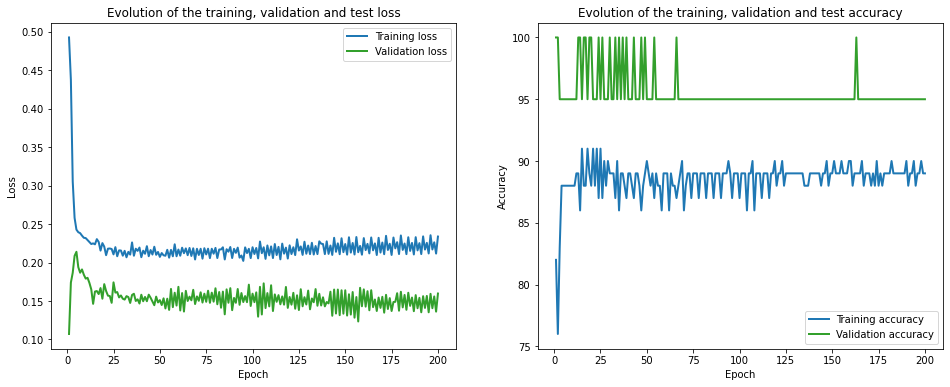

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 158.78it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1067.47it/s]

Finished computing p-values for 500 test points.

Starting repetition 3 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 1.28 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 1.27 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.65 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.61 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.33 train_acc: 100.00% took: 0.00s
val_loss = 0.87 val_acc = 30.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.

Epoch 15 of 200, 100% 	 train_loss: 0.13 train_acc: 100.00% took: 0.01s
val_loss = 0.86 val_acc = 50.00%
Snapshot saved at epoch 15.
Epoch 16 of 200, 10% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 20% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 30% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 40% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 50% 	 train_loss: 0.15 train_acc: 100.00% took: 0.02s
Epoch 16 of 200, 60% 	 train_loss: 0.62 train_acc: 60.00% took: 0.00s
Epoch 16 of 200, 70% 	 train_loss: 0.22 train_acc: 90.00% took: 0.01s
Epoch 16 of 200, 80% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 90% 	 train_loss: 0.26 train_acc: 90.00% took: 0.01s
Epoch 16 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 0.82 val_acc = 45.00%
Snapshot saved at epoch 16.
Epoch 17 of 200, 10% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 20% 	 train_loss

val_loss = 0.98 val_acc = 45.00%
Snapshot saved at epoch 26.
Epoch 27 of 200, 10% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 20% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 27 of 200, 30% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 50% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 60% 	 train_loss: 0.74 train_acc: 70.00% took: 0.00s
Epoch 27 of 200, 70% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 80% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 100% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
val_loss = 0.83 val_acc = 60.00%
Snapshot saved at epoch 27.
Epoch 28 of 200, 10% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 20% 	 train_loss: 0.64 train_acc: 70.00% took: 0.00s
Epoch 28 of 200, 30% 	 train_loss: 

Epoch 42 of 200, 40% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 42 of 200, 50% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 42 of 200, 60% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 42 of 200, 70% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 42 of 200, 80% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 42 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 42 of 200, 100% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
val_loss = 1.05 val_acc = 45.00%
Snapshot saved at epoch 42.
Epoch 43 of 200, 10% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 43 of 200, 20% 	 train_loss: 0.60 train_acc: 70.00% took: 0.00s
Epoch 43 of 200, 30% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 43 of 200, 40% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 43 of 200, 50% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 43 of 200, 60% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 43 of 200, 70% 	 tr

Epoch 57 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 1.13 val_acc = 45.00%
Snapshot saved at epoch 57.
Epoch 58 of 200, 10% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 58 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 58 of 200, 30% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 58 of 200, 50% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 58 of 200, 60% 	 train_loss: 0.60 train_acc: 70.00% took: 0.00s
Epoch 58 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 1.13 val_acc = 45.00%
Snapshot saved at epoch 58.
Epoch 59 of 200, 10% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 59 of 200, 20% 	 train_loss

Epoch 68 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 68 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 68 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 68 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 1.12 val_acc = 45.00%
Snapshot saved at epoch 68.
Epoch 69 of 200, 10% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 69 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.02s
Epoch 69 of 200, 30% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 69 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 69 of 200, 50% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 69 of 200, 60% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 69 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.02s
Epoch 69 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 69 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 69 of 200, 100% 	 tr

val_loss = 1.13 val_acc = 45.00%
Snapshot saved at epoch 83.
Epoch 84 of 200, 10% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 84 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 84 of 200, 30% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 84 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 84 of 200, 50% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 84 of 200, 60% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 84 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 84 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 84 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 84 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 1.14 val_acc = 45.00%
Snapshot saved at epoch 84.
Epoch 85 of 200, 10% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 85 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 85 of 200, 30% 	 train_loss: 

Epoch 94 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 94 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 1.12 val_acc = 40.00%
Snapshot saved at epoch 94.
Epoch 95 of 200, 10% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 95 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 95 of 200, 30% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 95 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 95 of 200, 50% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 95 of 200, 60% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 95 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 95 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 95 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 95 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 1.13 val_acc = 40.00%
Snapshot saved at epoch 95.
Epoch 96 of 200, 10% 	 train_loss

val_loss = 1.12 val_acc = 45.00%
Snapshot saved at epoch 109.
Epoch 110 of 200, 10% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 110 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 110 of 200, 30% 	 train_loss: 0.28 train_acc: 90.00% took: 0.01s
Epoch 110 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 110 of 200, 50% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 110 of 200, 60% 	 train_loss: 0.57 train_acc: 70.00% took: 0.01s
Epoch 110 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 110 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 110 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 110 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 1.12 val_acc = 45.00%
Snapshot saved at epoch 110.
Epoch 111 of 200, 10% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 111 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 111 of 200, 30%

Epoch 125 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.02s
Epoch 125 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 125 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 125 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 1.13 val_acc = 45.00%
Snapshot saved at epoch 125.
Epoch 126 of 200, 10% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 126 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 126 of 200, 30% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 126 of 200, 40% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 126 of 200, 50% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 126 of 200, 60% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
Epoch 126 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 126 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 126 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 126 of

Epoch 136 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.02s
Epoch 136 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 136 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 1.12 val_acc = 45.00%
Snapshot saved at epoch 136.
Epoch 137 of 200, 10% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 137 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 137 of 200, 30% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 137 of 200, 40% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 137 of 200, 50% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 137 of 200, 60% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 137 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 137 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 137 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 137 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss =

Epoch 151 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 151 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 151 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 151 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 1.10 val_acc = 45.00%
Snapshot saved at epoch 151.
Epoch 152 of 200, 10% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 152 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 152 of 200, 30% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 152 of 200, 40% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 152 of 200, 50% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 152 of 200, 60% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 152 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 152 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 152 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 152 of

Epoch 162 of 200, 30% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 162 of 200, 40% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 162 of 200, 50% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 162 of 200, 60% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 162 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 162 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 162 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 162 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 1.12 val_acc = 40.00%
Snapshot saved at epoch 162.
Epoch 163 of 200, 10% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 163 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 163 of 200, 30% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 163 of 200, 40% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 163 of 200, 50% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 163 o

Epoch 173 of 200, 10% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 173 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 173 of 200, 30% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 173 of 200, 40% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 173 of 200, 50% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 173 of 200, 60% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
Epoch 173 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 173 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 173 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 173 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 1.13 val_acc = 45.00%
Snapshot saved at epoch 173.
Epoch 174 of 200, 10% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 174 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 174 of 200, 30% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 174 of

Epoch 184 of 200, 40% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 184 of 200, 50% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 184 of 200, 60% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 184 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 184 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 184 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 184 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 1.14 val_acc = 40.00%
Snapshot saved at epoch 184.
Epoch 185 of 200, 10% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 185 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 185 of 200, 30% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 185 of 200, 40% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 185 of 200, 50% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 185 of 200, 60% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 185 o

Epoch 195 of 200, 10% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 195 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 195 of 200, 30% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 195 of 200, 40% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 195 of 200, 50% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 195 of 200, 60% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 195 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 195 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 195 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 195 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 1.11 val_acc = 40.00%
Snapshot saved at epoch 195.
Epoch 196 of 200, 10% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 196 of 200, 30% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 196 of

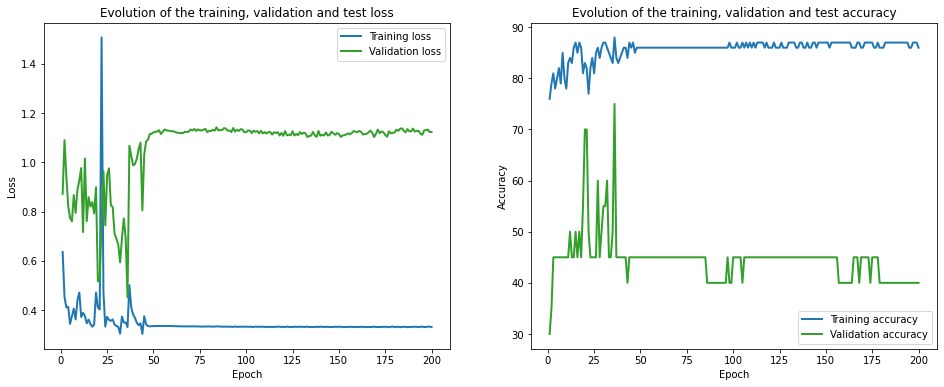

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 155.42it/s]


Initialization done!


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1227.62it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 2.04 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 4.07 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.63 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.78 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.36 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.73 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
val_loss = 0.91 val_acc = 50.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0

Epoch 11 of 200, 90% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 11 of 200, 100% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
val_loss = 1.05 val_acc = 35.00%
Snapshot saved at epoch 11.
Epoch 12 of 200, 10% 	 train_loss: 0.62 train_acc: 70.00% took: 0.00s
Epoch 12 of 200, 20% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 12 of 200, 30% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 40% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 12 of 200, 50% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 60% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 12 of 200, 70% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 80% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 90% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 100% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
val_loss = 1.00 val_acc = 35.00%
Snapshot saved at epoch 12.
Epoch 13 of 200, 10% 	 train_loss

Epoch 27 of 200, 20% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 30% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 40% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 60% 	 train_loss: 0.68 train_acc: 60.00% took: 0.00s
Epoch 27 of 200, 70% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 80% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 100% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
val_loss = 0.93 val_acc = 45.00%
Snapshot saved at epoch 27.
Epoch 28 of 200, 10% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 20% 	 train_loss: 0.65 train_acc: 70.00% took: 0.00s
Epoch 28 of 200, 30% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 40% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 50% 	 trai

Epoch 38 of 200, 10% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 20% 	 train_loss: 0.64 train_acc: 70.00% took: 0.00s
Epoch 38 of 200, 30% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 50% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 60% 	 train_loss: 0.70 train_acc: 70.00% took: 0.00s
Epoch 38 of 200, 70% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 100% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
val_loss = 1.08 val_acc = 45.00%
Snapshot saved at epoch 38.
Epoch 39 of 200, 10% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 39 of 200, 20% 	 train_loss: 0.62 train_acc: 70.00% took: 0.00s
Epoch 39 of 200, 30% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 39 of 200, 40% 	 tra

Epoch 50 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.02s
Epoch 50 of 200, 30% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 50 of 200, 50% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 50 of 200, 60% 	 train_loss: 0.63 train_acc: 60.00% took: 0.00s
Epoch 50 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 1.13 val_acc = 45.00%
Snapshot saved at epoch 50.
Epoch 51 of 200, 10% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 51 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 51 of 200, 30% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 51 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 51 of 200, 50% 	 tra

Epoch 60 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.02s
val_loss = 1.13 val_acc = 45.00%
Snapshot saved at epoch 60.
Epoch 61 of 200, 10% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 61 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 61 of 200, 30% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 61 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 61 of 200, 50% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 61 of 200, 60% 	 train_loss: 0.63 train_acc: 60.00% took: 0.00s
Epoch 61 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 61 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 61 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 61 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 1.13 val_acc = 45.00%
Snapshot saved at epoch 61.
Epoch 62 of 200, 10% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 62 of 200, 20% 	 train_loss

Epoch 76 of 200, 50% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 76 of 200, 60% 	 train_loss: 0.61 train_acc: 70.00% took: 0.00s
Epoch 76 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 76 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 76 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 76 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 1.13 val_acc = 45.00%
Snapshot saved at epoch 76.
Epoch 77 of 200, 10% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 77 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 77 of 200, 30% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 77 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 77 of 200, 50% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 77 of 200, 60% 	 train_loss: 0.61 train_acc: 70.00% took: 0.00s
Epoch 77 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 77 of 200, 80% 	 tr

Epoch 87 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 87 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 87 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 1.12 val_acc = 45.00%
Snapshot saved at epoch 87.
Epoch 88 of 200, 10% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 88 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 88 of 200, 30% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 88 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 88 of 200, 50% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 88 of 200, 60% 	 train_loss: 0.60 train_acc: 70.00% took: 0.00s
Epoch 88 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 88 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 88 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 88 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 1.12 val_acc 

Epoch 101 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 1.11 val_acc = 45.00%
Snapshot saved at epoch 101.
Epoch 102 of 200, 10% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 102 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 102 of 200, 30% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 102 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 102 of 200, 50% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 102 of 200, 60% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 102 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 102 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 102 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 102 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 1.11 val_acc = 45.00%
Snapshot saved at epoch 102.
Epoch 103 of 200, 1

Epoch 116 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 116 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 116 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 1.11 val_acc = 45.00%
Snapshot saved at epoch 116.
Epoch 117 of 200, 10% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 117 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 117 of 200, 30% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 117 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 117 of 200, 50% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 117 of 200, 60% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 117 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 117 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 117 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 117 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss =

Epoch 132 of 200, 10% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 132 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 132 of 200, 30% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 132 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 132 of 200, 50% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 132 of 200, 60% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 132 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 132 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 132 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 132 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 1.10 val_acc = 45.00%
Snapshot saved at epoch 132.
Epoch 133 of 200, 10% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 133 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 133 of 200, 30% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 133 of

Epoch 142 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 142 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 142 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 1.15 val_acc = 40.00%
Snapshot saved at epoch 142.
Epoch 143 of 200, 10% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 143 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 143 of 200, 30% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 143 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 143 of 200, 50% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 143 of 200, 60% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 143 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 143 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 143 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 143 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss =

val_loss = 1.18 val_acc = 40.00%
Snapshot saved at epoch 157.
Epoch 158 of 200, 10% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 158 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 158 of 200, 30% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 158 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 158 of 200, 50% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 158 of 200, 60% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 158 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 158 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 158 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 158 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 1.18 val_acc = 40.00%
Snapshot saved at epoch 158.
Epoch 159 of 200, 10% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 159 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 159 of 200, 30%

Epoch 173 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.01s
Epoch 173 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 173 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 1.18 val_acc = 40.00%
Snapshot saved at epoch 173.
Epoch 174 of 200, 10% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 174 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 174 of 200, 30% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.01s
Epoch 174 of 200, 50% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 174 of 200, 60% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 174 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.01s
val_loss =

Epoch 187 of 200, 20% 	 train_loss: 0.64 train_acc: 70.00% took: 0.00s
Epoch 187 of 200, 30% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 187 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 187 of 200, 50% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 187 of 200, 60% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 187 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 187 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 187 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 187 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 1.16 val_acc = 40.00%
Snapshot saved at epoch 187.
Epoch 188 of 200, 10% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 188 of 200, 20% 	 train_loss: 0.64 train_acc: 70.00% took: 0.01s
Epoch 188 of 200, 30% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 188 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 188 of

val_loss = 1.14 val_acc = 40.00%
Snapshot saved at epoch 200.
Training done! A list of 200 models saved.


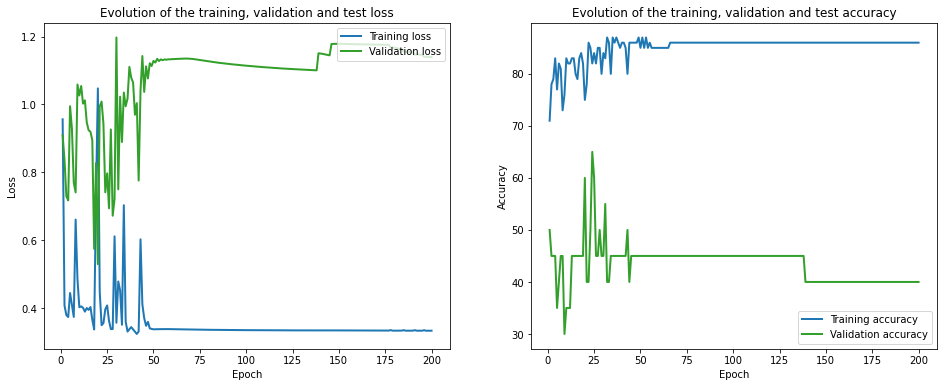

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 134.09it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1236.49it/s]

Finished computing p-values for 500 test points.

Starting repetition 4 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.68 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 0.87 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.78 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.92 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.81 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
val_loss = 1.17 val_acc = 45.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.8

val_loss = 0.71 val_acc = 55.00%
Snapshot saved at epoch 14.
Epoch 15 of 200, 10% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 30% 	 train_loss: 0.92 train_acc: 80.00% took: 0.00s
Epoch 15 of 200, 40% 	 train_loss: 0.51 train_acc: 60.00% took: 0.00s
Epoch 15 of 200, 50% 	 train_loss: 0.65 train_acc: 80.00% took: 0.00s
Epoch 15 of 200, 60% 	 train_loss: 0.36 train_acc: 70.00% took: 0.00s
Epoch 15 of 200, 70% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 15 of 200, 80% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 90% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 15 of 200, 100% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
val_loss = 0.68 val_acc = 65.00%
Snapshot saved at epoch 15.
Epoch 16 of 200, 10% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 30% 	 train_loss: 1

Epoch 28 of 200, 20% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 30% 	 train_loss: 0.77 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 40% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 50% 	 train_loss: 0.72 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 60% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 70% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
Epoch 28 of 200, 80% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 90% 	 train_loss: 0.37 train_acc: 70.00% took: 0.00s
Epoch 28 of 200, 100% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
val_loss = 0.82 val_acc = 50.00%
Snapshot saved at epoch 28.
Epoch 29 of 200, 10% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 29 of 200, 20% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 29 of 200, 30% 	 train_loss: 0.75 train_acc: 80.00% took: 0.00s
Epoch 29 of 200, 40% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 29 of 200, 50% 	 train

Snapshot saved at epoch 38.
Epoch 39 of 200, 10% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 39 of 200, 20% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 39 of 200, 30% 	 train_loss: 0.83 train_acc: 80.00% took: 0.00s
Epoch 39 of 200, 40% 	 train_loss: 0.36 train_acc: 90.00% took: 0.01s
Epoch 39 of 200, 50% 	 train_loss: 0.75 train_acc: 80.00% took: 0.00s
Epoch 39 of 200, 60% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 39 of 200, 70% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
Epoch 39 of 200, 80% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 39 of 200, 90% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 39 of 200, 100% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
val_loss = 0.89 val_acc = 55.00%
Snapshot saved at epoch 39.
Epoch 40 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.01s
Epoch 40 of 200, 20% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 40 of 200, 30% 	 train_loss: 0.82 train_acc: 80.00% took: 0.00s


Epoch 52 of 200, 100% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
val_loss = 1.03 val_acc = 50.00%
Snapshot saved at epoch 52.
Epoch 53 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 53 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 53 of 200, 30% 	 train_loss: 0.86 train_acc: 80.00% took: 0.00s
Epoch 53 of 200, 40% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 53 of 200, 50% 	 train_loss: 0.76 train_acc: 80.00% took: 0.00s
Epoch 53 of 200, 60% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 53 of 200, 70% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
Epoch 53 of 200, 80% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 53 of 200, 90% 	 train_loss: 0.35 train_acc: 70.00% took: 0.00s
Epoch 53 of 200, 100% 	 train_loss: 0.34 train_acc: 80.00% took: 0.01s
val_loss = 0.93 val_acc = 50.00%
Snapshot saved at epoch 53.
Epoch 54 of 200, 10% 	 train_loss: 0.18 train_acc: 100.00% took: 0.01s
Epoch 54 of 200, 20% 	 train_loss: 

Epoch 67 of 200, 10% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 67 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 67 of 200, 30% 	 train_loss: 0.81 train_acc: 80.00% took: 0.00s
Epoch 67 of 200, 40% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 67 of 200, 50% 	 train_loss: 0.78 train_acc: 80.00% took: 0.00s
Epoch 67 of 200, 60% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 67 of 200, 70% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
Epoch 67 of 200, 80% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 67 of 200, 90% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 67 of 200, 100% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
val_loss = 1.23 val_acc = 45.00%
Snapshot saved at epoch 67.
Epoch 68 of 200, 10% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 68 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 68 of 200, 30% 	 train_loss: 0.78 train_acc: 80.00% took: 0.00s
Epoch 68 of 200, 40% 	 train

Epoch 81 of 200, 30% 	 train_loss: 0.81 train_acc: 80.00% took: 0.00s
Epoch 81 of 200, 40% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 81 of 200, 50% 	 train_loss: 0.81 train_acc: 80.00% took: 0.00s
Epoch 81 of 200, 60% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 81 of 200, 70% 	 train_loss: 0.30 train_acc: 70.00% took: 0.00s
Epoch 81 of 200, 80% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 81 of 200, 90% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 81 of 200, 100% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
val_loss = 1.13 val_acc = 55.00%
Snapshot saved at epoch 81.
Epoch 82 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 82 of 200, 20% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 82 of 200, 30% 	 train_loss: 0.80 train_acc: 80.00% took: 0.00s
Epoch 82 of 200, 40% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 82 of 200, 50% 	 train_loss: 0.77 train_acc: 80.00% took: 0.00s
Epoch 82 of 200, 60% 	 train

Epoch 93 of 200, 80% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 93 of 200, 90% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 93 of 200, 100% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
val_loss = 1.20 val_acc = 60.00%
Snapshot saved at epoch 93.
Epoch 94 of 200, 10% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 94 of 200, 20% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 94 of 200, 30% 	 train_loss: 0.74 train_acc: 90.00% took: 0.00s
Epoch 94 of 200, 40% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 94 of 200, 50% 	 train_loss: 0.73 train_acc: 80.00% took: 0.00s
Epoch 94 of 200, 60% 	 train_loss: 0.37 train_acc: 90.00% took: 0.01s
Epoch 94 of 200, 70% 	 train_loss: 0.28 train_acc: 80.00% took: 0.01s
Epoch 94 of 200, 80% 	 train_loss: 0.16 train_acc: 100.00% took: 0.01s
Epoch 94 of 200, 90% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 94 of 200, 100% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
val_loss = 1.47 val_acc 

Epoch 106 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 106 of 200, 20% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 106 of 200, 30% 	 train_loss: 0.74 train_acc: 90.00% took: 0.00s
Epoch 106 of 200, 40% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 106 of 200, 50% 	 train_loss: 0.67 train_acc: 80.00% took: 0.00s
Epoch 106 of 200, 60% 	 train_loss: 0.40 train_acc: 80.00% took: 0.01s
Epoch 106 of 200, 70% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 106 of 200, 80% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 106 of 200, 90% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 106 of 200, 100% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
val_loss = 1.59 val_acc = 55.00%
Snapshot saved at epoch 106.
Epoch 107 of 200, 10% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 107 of 200, 20% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 107 of 200, 30% 	 train_loss: 0.74 train_acc: 80.00% took: 0.00s
Epoch 107 o

Epoch 116 of 200, 90% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 116 of 200, 100% 	 train_loss: 0.31 train_acc: 80.00% took: 0.01s
val_loss = 1.47 val_acc = 55.00%
Snapshot saved at epoch 116.
Epoch 117 of 200, 10% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 117 of 200, 20% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 117 of 200, 30% 	 train_loss: 0.74 train_acc: 80.00% took: 0.01s
Epoch 117 of 200, 40% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 117 of 200, 50% 	 train_loss: 0.65 train_acc: 80.00% took: 0.00s
Epoch 117 of 200, 60% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 117 of 200, 70% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 117 of 200, 80% 	 train_loss: 0.16 train_acc: 100.00% took: 0.01s
Epoch 117 of 200, 90% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 117 of 200, 100% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
val_loss = 1.77 val_acc = 55.00%
Snapshot saved at epoch 117.
Epoch 118 of 200, 10%

Epoch 130 of 200, 70% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 130 of 200, 80% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 130 of 200, 90% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 130 of 200, 100% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
val_loss = 2.29 val_acc = 55.00%
Snapshot saved at epoch 130.
Epoch 131 of 200, 10% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 131 of 200, 20% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 131 of 200, 30% 	 train_loss: 0.74 train_acc: 90.00% took: 0.00s
Epoch 131 of 200, 40% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 131 of 200, 50% 	 train_loss: 0.67 train_acc: 80.00% took: 0.00s
Epoch 131 of 200, 60% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 131 of 200, 70% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 131 of 200, 80% 	 train_loss: 0.16 train_acc: 100.00% took: 0.01s
Epoch 131 of 200, 90% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 131 of

Epoch 144 of 200, 50% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 144 of 200, 60% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 144 of 200, 70% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 144 of 200, 80% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 144 of 200, 90% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 144 of 200, 100% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
val_loss = 2.44 val_acc = 60.00%
Snapshot saved at epoch 144.
Epoch 145 of 200, 10% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 145 of 200, 20% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 145 of 200, 30% 	 train_loss: 0.74 train_acc: 90.00% took: 0.00s
Epoch 145 of 200, 40% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 145 of 200, 50% 	 train_loss: 0.92 train_acc: 80.00% took: 0.00s
Epoch 145 of 200, 60% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 145 of 200, 70% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 145 of

Epoch 157 of 200, 90% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 157 of 200, 100% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
val_loss = 1.28 val_acc = 60.00%
Snapshot saved at epoch 157.
Epoch 158 of 200, 10% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 158 of 200, 20% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 158 of 200, 30% 	 train_loss: 0.74 train_acc: 90.00% took: 0.00s
Epoch 158 of 200, 40% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 158 of 200, 50% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
Epoch 158 of 200, 60% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 158 of 200, 70% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 158 of 200, 80% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 158 of 200, 90% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 158 of 200, 100% 	 train_loss: 0.36 train_acc: 70.00% took: 0.00s
val_loss = 1.33 val_acc = 60.00%
Snapshot saved at epoch 158.
Epoch 159 of 200, 10

Epoch 168 of 200, 70% 	 train_loss: 0.26 train_acc: 70.00% took: 0.00s
Epoch 168 of 200, 80% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 168 of 200, 90% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 168 of 200, 100% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
val_loss = 1.48 val_acc = 60.00%
Snapshot saved at epoch 168.
Epoch 169 of 200, 10% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 169 of 200, 20% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 169 of 200, 30% 	 train_loss: 0.74 train_acc: 90.00% took: 0.00s
Epoch 169 of 200, 40% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 169 of 200, 50% 	 train_loss: 0.71 train_acc: 80.00% took: 0.00s
Epoch 169 of 200, 60% 	 train_loss: 0.35 train_acc: 100.00% took: 0.00s
Epoch 169 of 200, 70% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 169 of 200, 80% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 169 of 200, 90% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 169 

Epoch 183 of 200, 10% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 183 of 200, 20% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 183 of 200, 30% 	 train_loss: 0.73 train_acc: 90.00% took: 0.00s
Epoch 183 of 200, 40% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 183 of 200, 50% 	 train_loss: 1.01 train_acc: 80.00% took: 0.00s
Epoch 183 of 200, 60% 	 train_loss: 0.45 train_acc: 90.00% took: 0.00s
Epoch 183 of 200, 70% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 183 of 200, 80% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 183 of 200, 90% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 183 of 200, 100% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
val_loss = 1.10 val_acc = 60.00%
Snapshot saved at epoch 183.
Epoch 184 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 184 of 200, 20% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 184 of 200, 30% 	 train_loss: 0.74 train_acc: 90.00% took: 0.00s
Epoch 184 of

Epoch 195 of 200, 100% 	 train_loss: 0.38 train_acc: 70.00% took: 0.00s
val_loss = 1.32 val_acc = 65.00%
Snapshot saved at epoch 195.
Epoch 196 of 200, 10% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 196 of 200, 20% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 30% 	 train_loss: 0.74 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 40% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 50% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 60% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 196 of 200, 70% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 80% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 196 of 200, 90% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 100% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
val_loss = 1.35 val_acc = 60.00%
Snapshot saved at epoch 196.
Epoch 197 of 200, 10% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 197 of 200, 20%

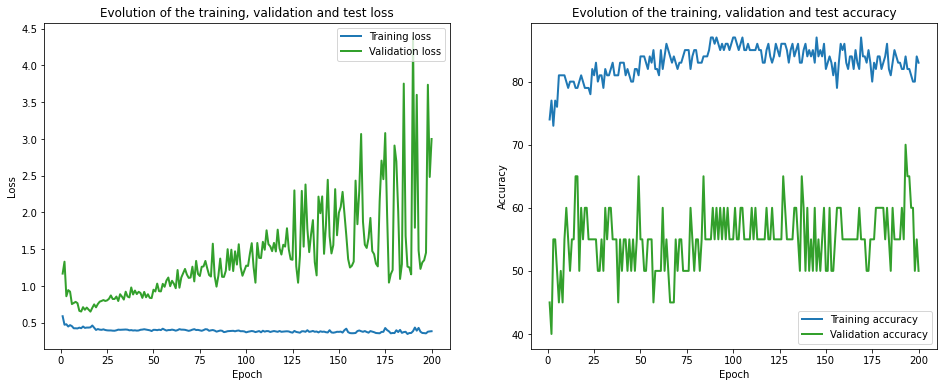

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 119.80it/s]


Initialization done!


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 758.12it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 1.63 train_acc: 20.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 2.18 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 1.02 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 6.57 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 25.44 train_acc: 30.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 4.94 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 34.54 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 13.95 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
val_loss = 13.09 val_acc = 55.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss:

Epoch 15 of 200, 60% 	 train_loss: 0.48 train_acc: 60.00% took: 0.01s
Epoch 15 of 200, 70% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 15 of 200, 80% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 15 of 200, 90% 	 train_loss: 0.71 train_acc: 70.00% took: 0.00s
Epoch 15 of 200, 100% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
val_loss = 0.59 val_acc = 80.00%
Snapshot saved at epoch 15.
Epoch 16 of 200, 10% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 20% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 30% 	 train_loss: 1.09 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 40% 	 train_loss: 0.64 train_acc: 50.00% took: 0.00s
Epoch 16 of 200, 50% 	 train_loss: 1.29 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 60% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 70% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 80% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 90% 	 trai

Epoch 30 of 200, 100% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
val_loss = 0.86 val_acc = 65.00%
Snapshot saved at epoch 30.
Epoch 31 of 200, 10% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 31 of 200, 20% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 30% 	 train_loss: 0.74 train_acc: 80.00% took: 0.01s
Epoch 31 of 200, 40% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 50% 	 train_loss: 0.80 train_acc: 80.00% took: 0.00s
Epoch 31 of 200, 60% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 70% 	 train_loss: 0.26 train_acc: 70.00% took: 0.00s
Epoch 31 of 200, 80% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 90% 	 train_loss: 0.37 train_acc: 70.00% took: 0.00s
Epoch 31 of 200, 100% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
val_loss = 0.86 val_acc = 65.00%
Snapshot saved at epoch 31.
Epoch 32 of 200, 10% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 32 of 200, 20% 	 train_loss:

val_loss = 0.93 val_acc = 65.00%
Snapshot saved at epoch 46.
Epoch 47 of 200, 10% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 47 of 200, 20% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 47 of 200, 30% 	 train_loss: 0.75 train_acc: 90.00% took: 0.00s
Epoch 47 of 200, 40% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 47 of 200, 50% 	 train_loss: 1.04 train_acc: 80.00% took: 0.00s
Epoch 47 of 200, 60% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 47 of 200, 70% 	 train_loss: 0.26 train_acc: 70.00% took: 0.00s
Epoch 47 of 200, 80% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 47 of 200, 90% 	 train_loss: 0.37 train_acc: 70.00% took: 0.00s
Epoch 47 of 200, 100% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
val_loss = 0.73 val_acc = 70.00%
Snapshot saved at epoch 47.
Epoch 48 of 200, 10% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 48 of 200, 20% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 48 of 200, 30% 	 train_loss: 

Epoch 57 of 200, 100% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
val_loss = 1.52 val_acc = 60.00%
Snapshot saved at epoch 57.
Epoch 58 of 200, 10% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 58 of 200, 20% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 58 of 200, 30% 	 train_loss: 0.73 train_acc: 80.00% took: 0.00s
Epoch 58 of 200, 40% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 50% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 58 of 200, 60% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 58 of 200, 70% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 58 of 200, 80% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 90% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 58 of 200, 100% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
val_loss = 1.07 val_acc = 60.00%
Snapshot saved at epoch 58.
Epoch 59 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 59 of 200, 20% 	 train_loss:

Epoch 68 of 200, 80% 	 train_loss: 0.17 train_acc: 100.00% took: 0.02s
Epoch 68 of 200, 90% 	 train_loss: 0.38 train_acc: 70.00% took: 0.01s
Epoch 68 of 200, 100% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
val_loss = 0.84 val_acc = 65.00%
Snapshot saved at epoch 68.
Epoch 69 of 200, 10% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 69 of 200, 20% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 69 of 200, 30% 	 train_loss: 0.74 train_acc: 80.00% took: 0.00s
Epoch 69 of 200, 40% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 69 of 200, 50% 	 train_loss: 0.69 train_acc: 80.00% took: 0.00s
Epoch 69 of 200, 60% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 69 of 200, 70% 	 train_loss: 0.26 train_acc: 70.00% took: 0.00s
Epoch 69 of 200, 80% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 69 of 200, 90% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 69 of 200, 100% 	 train_loss: 0.38 train_acc: 70.00% took: 0.00s
val_loss = 0.80 val_acc =

Epoch 84 of 200, 20% 	 train_loss: 0.37 train_acc: 80.00% took: 0.01s
Epoch 84 of 200, 30% 	 train_loss: 0.73 train_acc: 90.00% took: 0.00s
Epoch 84 of 200, 40% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 84 of 200, 50% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
Epoch 84 of 200, 60% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 84 of 200, 70% 	 train_loss: 0.26 train_acc: 70.00% took: 0.00s
Epoch 84 of 200, 80% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 84 of 200, 90% 	 train_loss: 0.37 train_acc: 70.00% took: 0.00s
Epoch 84 of 200, 100% 	 train_loss: 0.38 train_acc: 70.00% took: 0.00s
val_loss = 0.84 val_acc = 65.00%
Snapshot saved at epoch 84.
Epoch 85 of 200, 10% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 85 of 200, 20% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 85 of 200, 30% 	 train_loss: 0.73 train_acc: 90.00% took: 0.00s
Epoch 85 of 200, 40% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 85 of 200, 50% 	 trai

Epoch 99 of 200, 90% 	 train_loss: 0.51 train_acc: 80.00% took: 0.01s
Epoch 99 of 200, 100% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
val_loss = 1.01 val_acc = 55.00%
Snapshot saved at epoch 99.
Epoch 100 of 200, 10% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 20% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 30% 	 train_loss: 0.72 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 40% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 50% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 60% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 70% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 80% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 100 of 200, 90% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 100% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
val_loss = 0.87 val_acc = 65.00%
Snapshot saved at epoch 100.
Epoch 101 of 200, 10% 	 

Epoch 113 of 200, 70% 	 train_loss: 0.25 train_acc: 70.00% took: 0.00s
Epoch 113 of 200, 80% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 113 of 200, 90% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 113 of 200, 100% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
val_loss = 0.91 val_acc = 60.00%
Snapshot saved at epoch 113.
Epoch 114 of 200, 10% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 114 of 200, 20% 	 train_loss: 0.31 train_acc: 80.00% took: 0.01s
Epoch 114 of 200, 30% 	 train_loss: 0.73 train_acc: 80.00% took: 0.00s
Epoch 114 of 200, 40% 	 train_loss: 0.31 train_acc: 100.00% took: 0.00s
Epoch 114 of 200, 50% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 114 of 200, 60% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 114 of 200, 70% 	 train_loss: 0.25 train_acc: 70.00% took: 0.00s
Epoch 114 of 200, 80% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 114 of 200, 90% 	 train_loss: 0.40 train_acc: 70.00% took: 0.00s
Epoch 114 of 

val_loss = 1.32 val_acc = 65.00%
Snapshot saved at epoch 125.
Epoch 126 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 126 of 200, 20% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 126 of 200, 30% 	 train_loss: 0.74 train_acc: 80.00% took: 0.00s
Epoch 126 of 200, 40% 	 train_loss: 0.31 train_acc: 100.00% took: 0.00s
Epoch 126 of 200, 50% 	 train_loss: 1.65 train_acc: 80.00% took: 0.00s
Epoch 126 of 200, 60% 	 train_loss: 0.37 train_acc: 60.00% took: 0.00s
Epoch 126 of 200, 70% 	 train_loss: 0.24 train_acc: 70.00% took: 0.00s
Epoch 126 of 200, 80% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 126 of 200, 90% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 126 of 200, 100% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
val_loss = 0.92 val_acc = 65.00%
Snapshot saved at epoch 126.
Epoch 127 of 200, 10% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 127 of 200, 20% 	 train_loss: 0.31 train_acc: 80.00% took: 0.02s
Epoch 127 of 200, 30% 

Epoch 141 of 200, 80% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 141 of 200, 90% 	 train_loss: 0.28 train_acc: 80.00% took: 0.01s
Epoch 141 of 200, 100% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
val_loss = 0.96 val_acc = 65.00%
Snapshot saved at epoch 141.
Epoch 142 of 200, 10% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 142 of 200, 20% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 142 of 200, 30% 	 train_loss: 0.73 train_acc: 80.00% took: 0.00s
Epoch 142 of 200, 40% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 142 of 200, 50% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 142 of 200, 60% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 142 of 200, 70% 	 train_loss: 0.26 train_acc: 70.00% took: 0.00s
Epoch 142 of 200, 80% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 142 of 200, 90% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 142 of 200, 100% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
val_loss = 0.

Epoch 155 of 200, 70% 	 train_loss: 0.25 train_acc: 70.00% took: 0.00s
Epoch 155 of 200, 80% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 155 of 200, 90% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 155 of 200, 100% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
val_loss = 0.91 val_acc = 65.00%
Snapshot saved at epoch 155.
Epoch 156 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 156 of 200, 20% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 156 of 200, 30% 	 train_loss: 0.73 train_acc: 80.00% took: 0.00s
Epoch 156 of 200, 40% 	 train_loss: 0.32 train_acc: 100.00% took: 0.00s
Epoch 156 of 200, 50% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
Epoch 156 of 200, 60% 	 train_loss: 0.33 train_acc: 70.00% took: 0.00s
Epoch 156 of 200, 70% 	 train_loss: 0.26 train_acc: 70.00% took: 0.00s
Epoch 156 of 200, 80% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 156 of 200, 90% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 156 of

Epoch 171 of 200, 90% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 171 of 200, 100% 	 train_loss: 0.49 train_acc: 60.00% took: 0.00s
val_loss = 0.99 val_acc = 60.00%
Snapshot saved at epoch 171.
Epoch 172 of 200, 10% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 172 of 200, 20% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 172 of 200, 30% 	 train_loss: 0.73 train_acc: 80.00% took: 0.00s
Epoch 172 of 200, 40% 	 train_loss: 0.35 train_acc: 70.00% took: 0.00s
Epoch 172 of 200, 50% 	 train_loss: 1.25 train_acc: 80.00% took: 0.00s
Epoch 172 of 200, 60% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
Epoch 172 of 200, 70% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 172 of 200, 80% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 172 of 200, 90% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 172 of 200, 100% 	 train_loss: 0.56 train_acc: 60.00% took: 0.00s
val_loss = 1.09 val_acc = 65.00%
Snapshot saved at epoch 172.
Epoch 173 of 200, 10% 

Epoch 186 of 200, 60% 	 train_loss: 0.30 train_acc: 70.00% took: 0.00s
Epoch 186 of 200, 70% 	 train_loss: 0.25 train_acc: 70.00% took: 0.00s
Epoch 186 of 200, 80% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 186 of 200, 90% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 186 of 200, 100% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
val_loss = 0.76 val_acc = 70.00%
Snapshot saved at epoch 186.
Epoch 187 of 200, 10% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 187 of 200, 20% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 187 of 200, 30% 	 train_loss: 0.74 train_acc: 80.00% took: 0.00s
Epoch 187 of 200, 40% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 187 of 200, 50% 	 train_loss: 0.79 train_acc: 80.00% took: 0.00s
Epoch 187 of 200, 60% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 187 of 200, 70% 	 train_loss: 0.25 train_acc: 70.00% took: 0.00s
Epoch 187 of 200, 80% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 187 of 

Epoch 198 of 200, 100% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
val_loss = 0.97 val_acc = 50.00%
Snapshot saved at epoch 198.
Epoch 199 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 199 of 200, 20% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 199 of 200, 30% 	 train_loss: 0.68 train_acc: 80.00% took: 0.00s
Epoch 199 of 200, 40% 	 train_loss: 0.29 train_acc: 100.00% took: 0.00s
Epoch 199 of 200, 50% 	 train_loss: 0.66 train_acc: 80.00% took: 0.00s
Epoch 199 of 200, 60% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 199 of 200, 70% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 199 of 200, 80% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 199 of 200, 90% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 199 of 200, 100% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
val_loss = 1.02 val_acc = 50.00%
Snapshot saved at epoch 199.
Epoch 200 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 200 of 200, 20%

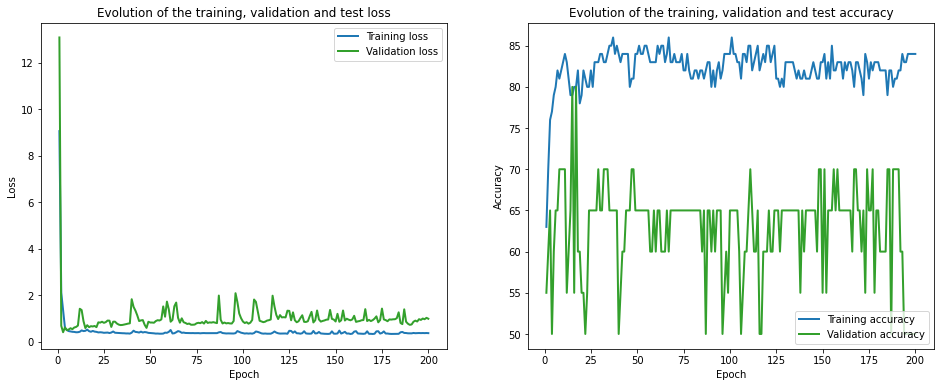

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 107.43it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1109.64it/s]

Finished computing p-values for 500 test points.

Starting repetition 5 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.73 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.86 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.90 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
val_loss = 0.60 val_acc = 60.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.4

Epoch 11 of 200, 90% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 11 of 200, 100% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
val_loss = 0.52 val_acc = 85.00%
Snapshot saved at epoch 11.
Epoch 12 of 200, 10% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 20% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 12 of 200, 30% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 40% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 50% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 60% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 70% 	 train_loss: 0.40 train_acc: 70.00% took: 0.00s
Epoch 12 of 200, 80% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 90% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 100% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
val_loss = 0.52 val_acc = 85.00%
Snapshot saved at epoch 12.
Epoch 13 of 200, 10% 	 train_loss:

Epoch 22 of 200, 100% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
val_loss = 0.46 val_acc = 85.00%
Snapshot saved at epoch 22.
Epoch 23 of 200, 10% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 23 of 200, 20% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 23 of 200, 30% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 23 of 200, 40% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 23 of 200, 50% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 23 of 200, 60% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 23 of 200, 70% 	 train_loss: 0.36 train_acc: 70.00% took: 0.00s
Epoch 23 of 200, 80% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 23 of 200, 90% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 23 of 200, 100% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
val_loss = 0.47 val_acc = 85.00%
Snapshot saved at epoch 23.
Epoch 24 of 200, 10% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 24 of 200, 20% 	 train_loss:

Epoch 38 of 200, 70% 	 train_loss: 0.32 train_acc: 70.00% took: 0.02s
Epoch 38 of 200, 80% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 90% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 100% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
val_loss = 0.45 val_acc = 90.00%
Snapshot saved at epoch 38.
Epoch 39 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 39 of 200, 20% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 39 of 200, 30% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 39 of 200, 40% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 39 of 200, 50% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 39 of 200, 60% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 39 of 200, 70% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
Epoch 39 of 200, 80% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 39 of 200, 90% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 39 of 200, 100% 	 tra

Epoch 49 of 200, 90% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 49 of 200, 100% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
val_loss = 0.44 val_acc = 90.00%
Snapshot saved at epoch 49.
Epoch 50 of 200, 10% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 20% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 50 of 200, 30% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 50 of 200, 40% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 50 of 200, 50% 	 train_loss: 0.37 train_acc: 70.00% took: 0.00s
Epoch 50 of 200, 60% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 50 of 200, 70% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 80% 	 train_loss: 0.26 train_acc: 70.00% took: 0.00s
Epoch 50 of 200, 90% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 100% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
val_loss = 0.47 val_acc = 90.00%
Snapshot saved at epoch 50.
Epoch 51 of 200, 10% 	 train_loss: 

Epoch 64 of 200, 90% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 64 of 200, 100% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
val_loss = 0.47 val_acc = 85.00%
Snapshot saved at epoch 64.
Epoch 65 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 65 of 200, 20% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 65 of 200, 30% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 65 of 200, 40% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 65 of 200, 50% 	 train_loss: 0.33 train_acc: 70.00% took: 0.00s
Epoch 65 of 200, 60% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 65 of 200, 70% 	 train_loss: 0.30 train_acc: 70.00% took: 0.00s
Epoch 65 of 200, 80% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 65 of 200, 90% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 65 of 200, 100% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
val_loss = 0.47 val_acc = 85.00%
Snapshot saved at epoch 65.
Epoch 66 of 200, 10% 	 train_loss:

Epoch 76 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 76 of 200, 20% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 76 of 200, 30% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 76 of 200, 40% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 76 of 200, 50% 	 train_loss: 0.31 train_acc: 70.00% took: 0.00s
Epoch 76 of 200, 60% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 76 of 200, 70% 	 train_loss: 0.29 train_acc: 70.00% took: 0.00s
Epoch 76 of 200, 80% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 76 of 200, 90% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 76 of 200, 100% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
val_loss = 0.44 val_acc = 85.00%
Snapshot saved at epoch 76.
Epoch 77 of 200, 10% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 77 of 200, 20% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 77 of 200, 30% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 77 of 200, 40% 	 trai

Epoch 91 of 200, 40% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 91 of 200, 50% 	 train_loss: 0.30 train_acc: 70.00% took: 0.00s
Epoch 91 of 200, 60% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 91 of 200, 70% 	 train_loss: 0.31 train_acc: 70.00% took: 0.00s
Epoch 91 of 200, 80% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 91 of 200, 90% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 91 of 200, 100% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
val_loss = 0.45 val_acc = 90.00%
Snapshot saved at epoch 91.
Epoch 92 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 92 of 200, 20% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 92 of 200, 30% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 92 of 200, 40% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 92 of 200, 50% 	 train_loss: 0.31 train_acc: 70.00% took: 0.00s
Epoch 92 of 200, 60% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 92 of 200, 70% 	 trai

Epoch 103 of 200, 80% 	 train_loss: 0.22 train_acc: 80.00% took: 0.02s
Epoch 103 of 200, 90% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 103 of 200, 100% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
val_loss = 0.45 val_acc = 95.00%
Snapshot saved at epoch 103.
Epoch 104 of 200, 10% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 104 of 200, 20% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 104 of 200, 30% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 104 of 200, 40% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 104 of 200, 50% 	 train_loss: 0.33 train_acc: 70.00% took: 0.00s
Epoch 104 of 200, 60% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 104 of 200, 70% 	 train_loss: 0.28 train_acc: 70.00% took: 0.00s
Epoch 104 of 200, 80% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 104 of 200, 90% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 104 of 200, 100% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
val_loss = 

Epoch 115 of 200, 80% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 115 of 200, 90% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 115 of 200, 100% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
val_loss = 0.41 val_acc = 90.00%
Snapshot saved at epoch 115.
Epoch 116 of 200, 10% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 116 of 200, 20% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 116 of 200, 30% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 116 of 200, 40% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 116 of 200, 50% 	 train_loss: 0.27 train_acc: 70.00% took: 0.00s
Epoch 116 of 200, 60% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 116 of 200, 70% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 116 of 200, 80% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 116 of 200, 90% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 116 of 200, 100% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
val_loss = 

Epoch 126 of 200, 30% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 126 of 200, 40% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 126 of 200, 50% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 126 of 200, 60% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 126 of 200, 70% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 126 of 200, 80% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 126 of 200, 90% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 126 of 200, 100% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
val_loss = 0.45 val_acc = 95.00%
Snapshot saved at epoch 126.
Epoch 127 of 200, 10% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 127 of 200, 20% 	 train_loss: 0.54 train_acc: 60.00% took: 0.00s
Epoch 127 of 200, 30% 	 train_loss: 0.42 train_acc: 60.00% took: 0.00s
Epoch 127 of 200, 40% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 127 of 200, 50% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 127 of 

Epoch 140 of 200, 40% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 140 of 200, 50% 	 train_loss: 0.27 train_acc: 80.00% took: 0.01s
Epoch 140 of 200, 60% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 140 of 200, 70% 	 train_loss: 0.27 train_acc: 70.00% took: 0.00s
Epoch 140 of 200, 80% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 140 of 200, 90% 	 train_loss: 0.35 train_acc: 90.00% took: 0.01s
Epoch 140 of 200, 100% 	 train_loss: 0.23 train_acc: 100.00% took: 0.01s
val_loss = 0.37 val_acc = 85.00%
Snapshot saved at epoch 140.
Epoch 141 of 200, 10% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 141 of 200, 20% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 141 of 200, 30% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 141 of 200, 40% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 141 of 200, 50% 	 train_loss: 0.26 train_acc: 70.00% took: 0.01s
Epoch 141 of 200, 60% 	 train_loss: 0.25 train_acc: 70.00% took: 0.00s
Epoch 141 of 

Epoch 154 of 200, 80% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 154 of 200, 90% 	 train_loss: 0.32 train_acc: 90.00% took: 0.01s
Epoch 154 of 200, 100% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
val_loss = 0.41 val_acc = 95.00%
Snapshot saved at epoch 154.
Epoch 155 of 200, 10% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 155 of 200, 20% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 155 of 200, 30% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 155 of 200, 40% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 155 of 200, 50% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 155 of 200, 60% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 155 of 200, 70% 	 train_loss: 0.31 train_acc: 70.00% took: 0.00s
Epoch 155 of 200, 80% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 155 of 200, 90% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 155 of 200, 100% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
val_loss = 0

Epoch 168 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.02s
val_loss = 0.41 val_acc = 90.00%
Snapshot saved at epoch 168.
Epoch 169 of 200, 10% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 169 of 200, 20% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 169 of 200, 30% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 169 of 200, 40% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 169 of 200, 50% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 169 of 200, 60% 	 train_loss: 0.25 train_acc: 80.00% took: 0.02s
Epoch 169 of 200, 70% 	 train_loss: 0.26 train_acc: 70.00% took: 0.00s
Epoch 169 of 200, 80% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 169 of 200, 90% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 169 of 200, 100% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
val_loss = 0.44 val_acc = 95.00%
Snapshot saved at epoch 169.
Epoch 170 of 200, 10% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 170 of 200, 20%

Epoch 184 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
val_loss = 0.38 val_acc = 95.00%
Snapshot saved at epoch 184.
Epoch 185 of 200, 10% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 185 of 200, 20% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 185 of 200, 30% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 185 of 200, 40% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 185 of 200, 50% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 185 of 200, 60% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 185 of 200, 70% 	 train_loss: 0.29 train_acc: 70.00% took: 0.00s
Epoch 185 of 200, 80% 	 train_loss: 0.23 train_acc: 70.00% took: 0.00s
Epoch 185 of 200, 90% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 185 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
val_loss = 0.41 val_acc = 95.00%
Snapshot saved at epoch 185.
Epoch 186 of 200, 10% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 186 of 200, 20% 

Epoch 195 of 200, 90% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 195 of 200, 100% 	 train_loss: 0.26 train_acc: 80.00% took: 0.01s
val_loss = 0.39 val_acc = 95.00%
Snapshot saved at epoch 195.
Epoch 196 of 200, 10% 	 train_loss: 0.10 train_acc: 90.00% took: 0.01s
Epoch 196 of 200, 20% 	 train_loss: 0.46 train_acc: 60.00% took: 0.00s
Epoch 196 of 200, 30% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 40% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 50% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 60% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 70% 	 train_loss: 0.25 train_acc: 70.00% took: 0.00s
Epoch 196 of 200, 80% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 90% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
Epoch 196 of 200, 100% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
val_loss = 0.40 val_acc = 95.00%
Snapshot saved at epoch 196.
Epoch 197 of 200, 10% 

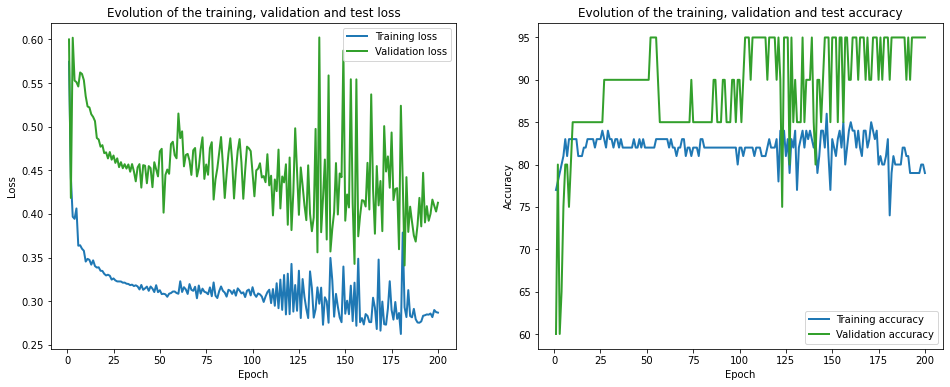

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 133.70it/s]


Initialization done!


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1311.52it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 1.98 train_acc: 10.00% took: 0.02s
Epoch 1 of 200, 20% 	 train_loss: 1.65 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 3.11 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 14.21 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 10.50 train_acc: 20.00% took: 0.02s
Epoch 1 of 200, 60% 	 train_loss: 1.06 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 3.50 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 3.42 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 1.32 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
val_loss = 2.64 val_acc = 60.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.60 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 

Epoch 16 of 200, 30% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 40% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 50% 	 train_loss: 0.38 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 60% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 70% 	 train_loss: 0.34 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 80% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 90% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 100% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
val_loss = 0.46 val_acc = 85.00%
Snapshot saved at epoch 16.
Epoch 17 of 200, 10% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 20% 	 train_loss: 0.46 train_acc: 80.00% took: 0.01s
Epoch 17 of 200, 30% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 40% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 50% 	 train_loss: 0.37 train_acc: 70.00% took: 0.00s
Epoch 17 of 200, 60% 	 trai

Epoch 30 of 200, 60% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 30 of 200, 70% 	 train_loss: 0.33 train_acc: 70.00% took: 0.00s
Epoch 30 of 200, 80% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 30 of 200, 90% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 30 of 200, 100% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
val_loss = 0.45 val_acc = 90.00%
Snapshot saved at epoch 30.
Epoch 31 of 200, 10% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 20% 	 train_loss: 0.44 train_acc: 80.00% took: 0.01s
Epoch 31 of 200, 30% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 31 of 200, 40% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 31 of 200, 50% 	 train_loss: 0.36 train_acc: 70.00% took: 0.00s
Epoch 31 of 200, 60% 	 train_loss: 0.30 train_acc: 80.00% took: 0.01s
Epoch 31 of 200, 70% 	 train_loss: 0.33 train_acc: 70.00% took: 0.00s
Epoch 31 of 200, 80% 	 train_loss: 0.23 train_acc: 90.00% took: 0.01s
Epoch 31 of 200, 90% 	 trai

Epoch 45 of 200, 30% 	 train_loss: 0.36 train_acc: 80.00% took: 0.01s
Epoch 45 of 200, 40% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 45 of 200, 50% 	 train_loss: 0.36 train_acc: 70.00% took: 0.00s
Epoch 45 of 200, 60% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 45 of 200, 70% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
Epoch 45 of 200, 80% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 45 of 200, 90% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 45 of 200, 100% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
val_loss = 0.46 val_acc = 90.00%
Snapshot saved at epoch 45.
Epoch 46 of 200, 10% 	 train_loss: 0.24 train_acc: 90.00% took: 0.01s
Epoch 46 of 200, 20% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 46 of 200, 30% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 46 of 200, 40% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 46 of 200, 50% 	 train_loss: 0.35 train_acc: 70.00% took: 0.00s
Epoch 46 of 200, 60% 	 trai

Epoch 59 of 200, 20% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 59 of 200, 30% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 59 of 200, 40% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 59 of 200, 50% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 59 of 200, 60% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 59 of 200, 70% 	 train_loss: 0.36 train_acc: 70.00% took: 0.00s
Epoch 59 of 200, 80% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 59 of 200, 90% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 59 of 200, 100% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
val_loss = 0.42 val_acc = 90.00%
Snapshot saved at epoch 59.
Epoch 60 of 200, 10% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 60 of 200, 20% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 60 of 200, 30% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 60 of 200, 40% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 60 of 200, 50% 	 tr

Epoch 74 of 200, 80% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 74 of 200, 90% 	 train_loss: 0.26 train_acc: 100.00% took: 0.00s
Epoch 74 of 200, 100% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
val_loss = 0.43 val_acc = 90.00%
Snapshot saved at epoch 74.
Epoch 75 of 200, 10% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 75 of 200, 20% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 75 of 200, 30% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 75 of 200, 40% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 75 of 200, 50% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 75 of 200, 60% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 75 of 200, 70% 	 train_loss: 0.31 train_acc: 70.00% took: 0.00s
Epoch 75 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 75 of 200, 90% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 75 of 200, 100% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
val_loss = 0.41 val_acc =

Epoch 85 of 200, 60% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 85 of 200, 70% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 85 of 200, 80% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 85 of 200, 90% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 85 of 200, 100% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
val_loss = 0.54 val_acc = 90.00%
Snapshot saved at epoch 85.
Epoch 86 of 200, 10% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 86 of 200, 20% 	 train_loss: 0.55 train_acc: 60.00% took: 0.00s
Epoch 86 of 200, 30% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 86 of 200, 40% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 86 of 200, 50% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
Epoch 86 of 200, 60% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 86 of 200, 70% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 86 of 200, 80% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 86 of 200, 90% 	 tra

Epoch 96 of 200, 60% 	 train_loss: 0.33 train_acc: 80.00% took: 0.01s
Epoch 96 of 200, 70% 	 train_loss: 0.29 train_acc: 70.00% took: 0.00s
Epoch 96 of 200, 80% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 96 of 200, 90% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 96 of 200, 100% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
val_loss = 0.34 val_acc = 95.00%
Snapshot saved at epoch 96.
Epoch 97 of 200, 10% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 97 of 200, 20% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 97 of 200, 30% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 97 of 200, 40% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 97 of 200, 50% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 97 of 200, 60% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 97 of 200, 70% 	 train_loss: 0.56 train_acc: 60.00% took: 0.00s
Epoch 97 of 200, 80% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 97 of 200, 90% 	 trai

Epoch 107 of 200, 80% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 107 of 200, 90% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 107 of 200, 100% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
val_loss = 0.47 val_acc = 80.00%
Snapshot saved at epoch 107.
Epoch 108 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 108 of 200, 20% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 108 of 200, 30% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 108 of 200, 40% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 108 of 200, 50% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 108 of 200, 60% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 108 of 200, 70% 	 train_loss: 0.34 train_acc: 70.00% took: 0.00s
Epoch 108 of 200, 80% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 108 of 200, 90% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 108 of 200, 100% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
val_loss =

Epoch 123 of 200, 40% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 123 of 200, 50% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 123 of 200, 60% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 123 of 200, 70% 	 train_loss: 0.29 train_acc: 70.00% took: 0.00s
Epoch 123 of 200, 80% 	 train_loss: 0.19 train_acc: 80.00% took: 0.00s
Epoch 123 of 200, 90% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 123 of 200, 100% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
val_loss = 0.45 val_acc = 90.00%
Snapshot saved at epoch 123.
Epoch 124 of 200, 10% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 124 of 200, 20% 	 train_loss: 0.68 train_acc: 60.00% took: 0.00s
Epoch 124 of 200, 30% 	 train_loss: 0.50 train_acc: 60.00% took: 0.00s
Epoch 124 of 200, 40% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 124 of 200, 50% 	 train_loss: 0.30 train_acc: 70.00% took: 0.00s
Epoch 124 of 200, 60% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 124 of

Epoch 139 of 200, 10% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 139 of 200, 20% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 139 of 200, 30% 	 train_loss: 0.60 train_acc: 60.00% took: 0.00s
Epoch 139 of 200, 40% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 139 of 200, 50% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 139 of 200, 60% 	 train_loss: 0.58 train_acc: 80.00% took: 0.00s
Epoch 139 of 200, 70% 	 train_loss: 0.29 train_acc: 70.00% took: 0.00s
Epoch 139 of 200, 80% 	 train_loss: 0.31 train_acc: 70.00% took: 0.00s
Epoch 139 of 200, 90% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 139 of 200, 100% 	 train_loss: 0.25 train_acc: 100.00% took: 0.00s
val_loss = 0.30 val_acc = 95.00%
Snapshot saved at epoch 139.
Epoch 140 of 200, 10% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 140 of 200, 20% 	 train_loss: 0.57 train_acc: 70.00% took: 0.01s
Epoch 140 of 200, 30% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 140 of 

Epoch 153 of 200, 50% 	 train_loss: 0.21 train_acc: 80.00% took: 0.02s
Epoch 153 of 200, 60% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 153 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 153 of 200, 80% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
Epoch 153 of 200, 90% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 153 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
val_loss = 0.36 val_acc = 95.00%
Snapshot saved at epoch 153.
Epoch 154 of 200, 10% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 154 of 200, 20% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 154 of 200, 30% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 154 of 200, 40% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 154 of 200, 50% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 154 of 200, 60% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 154 of 200, 70% 	 train_loss: 0.29 train_acc: 70.00% took: 0.00s
Epoch 154 of 

Epoch 168 of 200, 90% 	 train_loss: 0.24 train_acc: 100.00% took: 0.02s
Epoch 168 of 200, 100% 	 train_loss: 0.19 train_acc: 100.00% took: 0.01s
val_loss = 0.36 val_acc = 95.00%
Snapshot saved at epoch 168.
Epoch 169 of 200, 10% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 169 of 200, 20% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 169 of 200, 30% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 169 of 200, 40% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 169 of 200, 50% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 169 of 200, 60% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 169 of 200, 70% 	 train_loss: 0.34 train_acc: 70.00% took: 0.00s
Epoch 169 of 200, 80% 	 train_loss: 0.31 train_acc: 70.00% took: 0.00s
Epoch 169 of 200, 90% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 169 of 200, 100% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
val_loss = 0.36 val_acc = 95.00%
Snapshot saved at epoch 169.
Epoch 170 of 200, 10

Epoch 183 of 200, 80% 	 train_loss: 0.31 train_acc: 70.00% took: 0.01s
Epoch 183 of 200, 90% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 183 of 200, 100% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
val_loss = 0.34 val_acc = 80.00%
Snapshot saved at epoch 183.
Epoch 184 of 200, 10% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 184 of 200, 20% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 184 of 200, 30% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 184 of 200, 40% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 184 of 200, 50% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 184 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 184 of 200, 70% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 184 of 200, 80% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 184 of 200, 90% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 184 of 200, 100% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
val_loss = 

Epoch 198 of 200, 20% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 198 of 200, 30% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 198 of 200, 40% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 198 of 200, 50% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 198 of 200, 60% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 198 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 198 of 200, 80% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 198 of 200, 90% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 198 of 200, 100% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
val_loss = 0.29 val_acc = 75.00%
Snapshot saved at epoch 198.
Epoch 199 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 199 of 200, 20% 	 train_loss: 0.67 train_acc: 60.00% took: 0.00s
Epoch 199 of 200, 30% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 199 of 200, 40% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 199 o

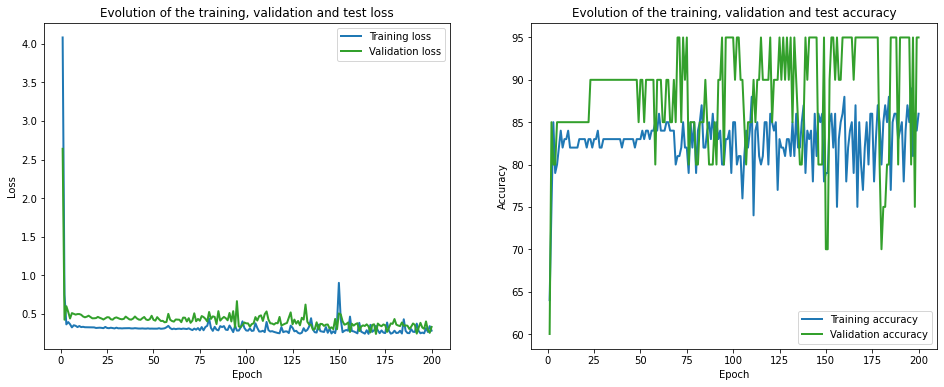

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 141.09it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 997.52it/s]

Finished computing p-values for 500 test points.

Starting repetition 6 of 50:




C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


Training with standard data splitting...
===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 1.42 train_acc: 30.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 3.11 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.89 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.97 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.84 train_acc: 30.00% took: 0.01s
Epoch 1 of 200, 60% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.41 train_acc: 90.00% took: 0.01s
Epoch 1 of 200, 100% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
val_loss = 0.37 val_acc = 90.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.09 train_acc: 90.00% took: 0.01s
Epoch 2 of 200, 20% 	 train_loss: 1.00 train_acc: 60.00% took: 0

Epoch 14 of 200, 20% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
Epoch 14 of 200, 30% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 14 of 200, 40% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 14 of 200, 50% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 14 of 200, 60% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 14 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 14 of 200, 80% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 14 of 200, 90% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 14 of 200, 100% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
val_loss = 0.12 val_acc = 100.00%
Snapshot saved at epoch 14.
Epoch 15 of 200, 10% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 15 of 200, 20% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
Epoch 15 of 200, 30% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 15 of 200, 40% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 15 of 200, 50% 	 tr

Epoch 26 of 200, 40% 	 train_loss: 0.64 train_acc: 70.00% took: 0.00s
Epoch 26 of 200, 50% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 26 of 200, 60% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 26 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 26 of 200, 80% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 26 of 200, 90% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 26 of 200, 100% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
val_loss = 0.12 val_acc = 100.00%
Snapshot saved at epoch 26.
Epoch 27 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 20% 	 train_loss: 0.58 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 30% 	 train_loss: 0.48 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 40% 	 train_loss: 0.65 train_acc: 70.00% took: 0.00s
Epoch 27 of 200, 50% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 60% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 70% 	 tr

Epoch 40 of 200, 10% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 40 of 200, 20% 	 train_loss: 0.57 train_acc: 80.00% took: 0.01s
Epoch 40 of 200, 30% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 40 of 200, 40% 	 train_loss: 0.65 train_acc: 70.00% took: 0.00s
Epoch 40 of 200, 50% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 40 of 200, 60% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 40 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 40 of 200, 80% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 40 of 200, 90% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 40 of 200, 100% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
val_loss = 0.10 val_acc = 100.00%
Snapshot saved at epoch 40.
Epoch 41 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 41 of 200, 20% 	 train_loss: 0.58 train_acc: 80.00% took: 0.00s
Epoch 41 of 200, 30% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 41 of 200, 40% 	 t

Epoch 51 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 0.10 val_acc = 100.00%
Snapshot saved at epoch 51.
Epoch 52 of 200, 10% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 52 of 200, 20% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 52 of 200, 30% 	 train_loss: 0.50 train_acc: 90.00% took: 0.00s
Epoch 52 of 200, 40% 	 train_loss: 0.66 train_acc: 70.00% took: 0.00s
Epoch 52 of 200, 50% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 52 of 200, 60% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 52 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 52 of 200, 80% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 52 of 200, 90% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 52 of 200, 100% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
val_loss = 0.10 val_acc = 100.00%
Snapshot saved at epoch 52.
Epoch 53 of 200, 10% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 53 of 200, 20% 	 train_l

Epoch 65 of 200, 20% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
Epoch 65 of 200, 30% 	 train_loss: 0.50 train_acc: 90.00% took: 0.00s
Epoch 65 of 200, 40% 	 train_loss: 0.67 train_acc: 70.00% took: 0.00s
Epoch 65 of 200, 50% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 65 of 200, 60% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 65 of 200, 70% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 65 of 200, 80% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 65 of 200, 90% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 65 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 0.09 val_acc = 100.00%
Snapshot saved at epoch 65.
Epoch 66 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 66 of 200, 20% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
Epoch 66 of 200, 30% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 66 of 200, 40% 	 train_loss: 0.66 train_acc: 70.00% took: 0.00s
Epoch 66 of 200, 50% 	 tr

Epoch 77 of 200, 60% 	 train_loss: 0.32 train_acc: 90.00% took: 0.02s
Epoch 77 of 200, 70% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 77 of 200, 80% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 77 of 200, 90% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 77 of 200, 100% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
val_loss = 0.08 val_acc = 100.00%
Snapshot saved at epoch 77.
Epoch 78 of 200, 10% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 78 of 200, 20% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 78 of 200, 30% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 78 of 200, 40% 	 train_loss: 0.65 train_acc: 80.00% took: 0.00s
Epoch 78 of 200, 50% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 78 of 200, 60% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 78 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 78 of 200, 80% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 78 of 200, 90% 	 tra

Epoch 90 of 200, 100% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
val_loss = 0.11 val_acc = 100.00%
Snapshot saved at epoch 90.
Epoch 91 of 200, 10% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 91 of 200, 20% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 91 of 200, 30% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 91 of 200, 40% 	 train_loss: 0.65 train_acc: 70.00% took: 0.00s
Epoch 91 of 200, 50% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
Epoch 91 of 200, 60% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 91 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 91 of 200, 80% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 91 of 200, 90% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 91 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.09 val_acc = 100.00%
Snapshot saved at epoch 91.
Epoch 92 of 200, 10% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 92 of 200, 20% 	 train_l

Epoch 103 of 200, 50% 	 train_loss: 0.32 train_acc: 90.00% took: 0.01s
Epoch 103 of 200, 60% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 103 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 103 of 200, 80% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 103 of 200, 90% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 103 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 0.09 val_acc = 100.00%
Snapshot saved at epoch 103.
Epoch 104 of 200, 10% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 104 of 200, 20% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
Epoch 104 of 200, 30% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 104 of 200, 40% 	 train_loss: 0.66 train_acc: 70.00% took: 0.00s
Epoch 104 of 200, 50% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 104 of 200, 60% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 104 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 104 o

Epoch 115 of 200, 10% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 115 of 200, 20% 	 train_loss: 0.66 train_acc: 80.00% took: 0.00s
Epoch 115 of 200, 30% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 115 of 200, 40% 	 train_loss: 0.65 train_acc: 70.00% took: 0.00s
Epoch 115 of 200, 50% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 115 of 200, 60% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 115 of 200, 70% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 115 of 200, 80% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 115 of 200, 90% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 115 of 200, 100% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
val_loss = 0.07 val_acc = 100.00%
Snapshot saved at epoch 115.
Epoch 116 of 200, 10% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 116 of 200, 20% 	 train_loss: 0.58 train_acc: 80.00% took: 0.00s
Epoch 116 of 200, 30% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 116 o

val_loss = 0.09 val_acc = 100.00%
Snapshot saved at epoch 126.
Epoch 127 of 200, 10% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 127 of 200, 20% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 127 of 200, 30% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 127 of 200, 40% 	 train_loss: 0.67 train_acc: 70.00% took: 0.00s
Epoch 127 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 127 of 200, 60% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 127 of 200, 70% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 127 of 200, 80% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 127 of 200, 90% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 127 of 200, 100% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
val_loss = 0.09 val_acc = 100.00%
Snapshot saved at epoch 127.
Epoch 128 of 200, 10% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 128 of 200, 20% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 128 of 200, 

Epoch 140 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 140 of 200, 60% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 140 of 200, 70% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 140 of 200, 80% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 140 of 200, 90% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 140 of 200, 100% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
val_loss = 0.06 val_acc = 100.00%
Snapshot saved at epoch 140.
Epoch 141 of 200, 10% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 141 of 200, 20% 	 train_loss: 0.64 train_acc: 80.00% took: 0.00s
Epoch 141 of 200, 30% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 141 of 200, 40% 	 train_loss: 0.68 train_acc: 70.00% took: 0.00s
Epoch 141 of 200, 50% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 141 of 200, 60% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 141 of 200, 70% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 141 o

Epoch 152 of 200, 70% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 152 of 200, 80% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 152 of 200, 90% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 152 of 200, 100% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
val_loss = 0.07 val_acc = 100.00%
Snapshot saved at epoch 152.
Epoch 153 of 200, 10% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 153 of 200, 20% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 153 of 200, 30% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 153 of 200, 40% 	 train_loss: 0.67 train_acc: 70.00% took: 0.00s
Epoch 153 of 200, 50% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 153 of 200, 60% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 153 of 200, 70% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 153 of 200, 80% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 153 of 200, 90% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 153 o

Epoch 164 of 200, 80% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 164 of 200, 90% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 164 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 0.08 val_acc = 100.00%
Snapshot saved at epoch 164.
Epoch 165 of 200, 10% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 165 of 200, 20% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 165 of 200, 30% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 165 of 200, 40% 	 train_loss: 0.67 train_acc: 70.00% took: 0.00s
Epoch 165 of 200, 50% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 165 of 200, 60% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 165 of 200, 70% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 165 of 200, 80% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 165 of 200, 90% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 165 of 200, 100% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
val_loss =

Epoch 177 of 200, 50% 	 train_loss: 0.32 train_acc: 90.00% took: 0.02s
Epoch 177 of 200, 60% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 177 of 200, 70% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 177 of 200, 80% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 177 of 200, 90% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 177 of 200, 100% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
val_loss = 0.06 val_acc = 100.00%
Snapshot saved at epoch 177.
Epoch 178 of 200, 10% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 178 of 200, 20% 	 train_loss: 0.58 train_acc: 80.00% took: 0.00s
Epoch 178 of 200, 30% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 178 of 200, 40% 	 train_loss: 0.67 train_acc: 70.00% took: 0.00s
Epoch 178 of 200, 50% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 60% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 70% 	 train_loss: 0.16 train_acc: 90.00% took: 0.01s
Epoch 178 o

Epoch 189 of 200, 90% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 189 of 200, 100% 	 train_loss: 0.16 train_acc: 90.00% took: 0.01s
val_loss = 0.05 val_acc = 100.00%
Snapshot saved at epoch 189.
Epoch 190 of 200, 10% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 190 of 200, 20% 	 train_loss: 0.65 train_acc: 80.00% took: 0.01s
Epoch 190 of 200, 30% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 190 of 200, 40% 	 train_loss: 0.67 train_acc: 70.00% took: 0.00s
Epoch 190 of 200, 50% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 190 of 200, 60% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 190 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 190 of 200, 80% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 190 of 200, 90% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 190 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 0.12 val_acc = 100.00%
Snapshot saved at epoch 190.
Epoch 191 of 200, 

val_loss = 0.08 val_acc = 100.00%
Snapshot saved at epoch 200.
Training done! A list of 200 models saved.


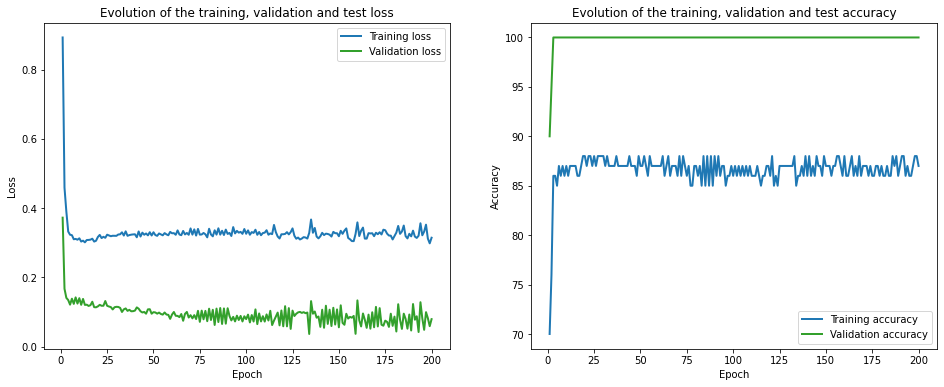

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 133.97it/s]


Initialization done!


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 990.21it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 1.13 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.65 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 1.13 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.87 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.68 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.64 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 0.29 val_acc = 90.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.64 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.

Epoch 15 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.02s
Epoch 15 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 15 of 200, 90% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 15 of 200, 100% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
val_loss = 0.16 val_acc = 100.00%
Snapshot saved at epoch 15.
Epoch 16 of 200, 10% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 20% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 30% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 40% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 50% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 60% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 90% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 100% 	

Epoch 29 of 200, 20% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 29 of 200, 30% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 29 of 200, 40% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 29 of 200, 50% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 29 of 200, 60% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 29 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 29 of 200, 80% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 29 of 200, 90% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 29 of 200, 100% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
val_loss = 0.16 val_acc = 100.00%
Snapshot saved at epoch 29.
Epoch 30 of 200, 10% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 30 of 200, 20% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
Epoch 30 of 200, 30% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 30 of 200, 40% 	 train_loss: 0.62 train_acc: 70.00% took: 0.00s
Epoch 30 of 200, 50% 	 tr

Epoch 44 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 44 of 200, 80% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 44 of 200, 90% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 44 of 200, 100% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
val_loss = 0.15 val_acc = 100.00%
Snapshot saved at epoch 44.
Epoch 45 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 45 of 200, 20% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
Epoch 45 of 200, 30% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 45 of 200, 40% 	 train_loss: 0.65 train_acc: 70.00% took: 0.00s
Epoch 45 of 200, 50% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 45 of 200, 60% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 45 of 200, 70% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 45 of 200, 80% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 45 of 200, 90% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 45 of 200, 100% 	 t

Epoch 59 of 200, 20% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 59 of 200, 30% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 59 of 200, 40% 	 train_loss: 0.65 train_acc: 70.00% took: 0.00s
Epoch 59 of 200, 50% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 59 of 200, 60% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 59 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 59 of 200, 80% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 59 of 200, 90% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 59 of 200, 100% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
val_loss = 0.14 val_acc = 100.00%
Snapshot saved at epoch 59.
Epoch 60 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 60 of 200, 20% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
Epoch 60 of 200, 30% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 60 of 200, 40% 	 train_loss: 0.65 train_acc: 70.00% took: 0.00s
Epoch 60 of 200, 50% 	 tr

Epoch 73 of 200, 100% 	 train_loss: 0.07 train_acc: 100.00% took: 0.02s
val_loss = 0.14 val_acc = 100.00%
Snapshot saved at epoch 73.
Epoch 74 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 74 of 200, 20% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
Epoch 74 of 200, 30% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 74 of 200, 40% 	 train_loss: 0.64 train_acc: 70.00% took: 0.00s
Epoch 74 of 200, 50% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 74 of 200, 60% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 74 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 74 of 200, 80% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 74 of 200, 90% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 74 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 0.14 val_acc = 100.00%
Snapshot saved at epoch 74.
Epoch 75 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 75 of 200, 20% 	 train_l

Epoch 89 of 200, 10% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 89 of 200, 20% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 89 of 200, 30% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 89 of 200, 40% 	 train_loss: 0.64 train_acc: 70.00% took: 0.00s
Epoch 89 of 200, 50% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 60% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 70% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 80% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 90% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 89 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.14 val_acc = 100.00%
Snapshot saved at epoch 89.
Epoch 90 of 200, 10% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 90 of 200, 20% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 90 of 200, 30% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 90 of 200, 40% 	 t

Epoch 104 of 200, 50% 	 train_loss: 0.39 train_acc: 90.00% took: 0.02s
Epoch 104 of 200, 60% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 104 of 200, 70% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 104 of 200, 80% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 104 of 200, 90% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 104 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 0.14 val_acc = 100.00%
Snapshot saved at epoch 104.
Epoch 105 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 105 of 200, 20% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 105 of 200, 30% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 105 of 200, 40% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 105 of 200, 50% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 105 of 200, 60% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 105 of 200, 70% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 105 o

val_loss = 0.12 val_acc = 100.00%
Snapshot saved at epoch 119.
Epoch 120 of 200, 10% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 120 of 200, 20% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 120 of 200, 30% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 120 of 200, 40% 	 train_loss: 0.64 train_acc: 70.00% took: 0.00s
Epoch 120 of 200, 50% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 120 of 200, 60% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 120 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 120 of 200, 80% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 120 of 200, 90% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 120 of 200, 100% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
val_loss = 0.14 val_acc = 100.00%
Snapshot saved at epoch 120.
Epoch 121 of 200, 10% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 121 of 200, 20% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 121 of 200,

Epoch 130 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 0.12 val_acc = 100.00%
Snapshot saved at epoch 130.
Epoch 131 of 200, 10% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 131 of 200, 20% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
Epoch 131 of 200, 30% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 131 of 200, 40% 	 train_loss: 0.60 train_acc: 70.00% took: 0.00s
Epoch 131 of 200, 50% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
Epoch 131 of 200, 60% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 131 of 200, 70% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 131 of 200, 80% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 131 of 200, 90% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 131 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 0.11 val_acc = 100.00%
Snapshot saved at epoch 131.
Epoch 132 of 200, 10% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 132 of 200

Epoch 146 of 200, 40% 	 train_loss: 0.61 train_acc: 70.00% took: 0.00s
Epoch 146 of 200, 50% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 146 of 200, 60% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 146 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 146 of 200, 80% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 146 of 200, 90% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 146 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 0.12 val_acc = 100.00%
Snapshot saved at epoch 146.
Epoch 147 of 200, 10% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 147 of 200, 20% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 147 of 200, 30% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 147 of 200, 40% 	 train_loss: 0.61 train_acc: 70.00% took: 0.00s
Epoch 147 of 200, 50% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 147 of 200, 60% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 147 o

Epoch 157 of 200, 10% 	 train_loss: 0.04 train_acc: 100.00% took: 0.02s
Epoch 157 of 200, 20% 	 train_loss: 0.51 train_acc: 90.00% took: 0.00s
Epoch 157 of 200, 30% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 157 of 200, 40% 	 train_loss: 0.61 train_acc: 70.00% took: 0.00s
Epoch 157 of 200, 50% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 157 of 200, 60% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 157 of 200, 70% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 157 of 200, 80% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 157 of 200, 90% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 157 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 0.10 val_acc = 100.00%
Snapshot saved at epoch 157.
Epoch 158 of 200, 10% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 158 of 200, 20% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 158 of 200, 30% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 158

Epoch 171 of 200, 20% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 171 of 200, 30% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 171 of 200, 40% 	 train_loss: 0.62 train_acc: 70.00% took: 0.00s
Epoch 171 of 200, 50% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 171 of 200, 60% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 171 of 200, 70% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 171 of 200, 80% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 171 of 200, 90% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 171 of 200, 100% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
val_loss = 0.11 val_acc = 100.00%
Snapshot saved at epoch 171.
Epoch 172 of 200, 10% 	 train_loss: 0.02 train_acc: 100.00% took: 0.02s
Epoch 172 of 200, 20% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 172 of 200, 30% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 172 of 200, 40% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 172 o

val_loss = 0.10 val_acc = 100.00%
Snapshot saved at epoch 181.
Epoch 182 of 200, 10% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 182 of 200, 20% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 182 of 200, 30% 	 train_loss: 0.45 train_acc: 60.00% took: 0.00s
Epoch 182 of 200, 40% 	 train_loss: 0.60 train_acc: 70.00% took: 0.00s
Epoch 182 of 200, 50% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 182 of 200, 60% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 182 of 200, 70% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 182 of 200, 80% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 182 of 200, 90% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 182 of 200, 100% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
val_loss = 0.12 val_acc = 100.00%
Snapshot saved at epoch 182.
Epoch 183 of 200, 10% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 183 of 200, 20% 	 train_loss: 0.50 train_acc: 90.00% took: 0.00s
Epoch 183 of 200, 

Epoch 197 of 200, 10% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 197 of 200, 20% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
Epoch 197 of 200, 30% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 197 of 200, 40% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 197 of 200, 50% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 197 of 200, 60% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 197 of 200, 70% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 197 of 200, 80% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 197 of 200, 90% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 197 of 200, 100% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
val_loss = 0.11 val_acc = 100.00%
Snapshot saved at epoch 197.
Epoch 198 of 200, 10% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 198 of 200, 20% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 198 of 200, 30% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 198 

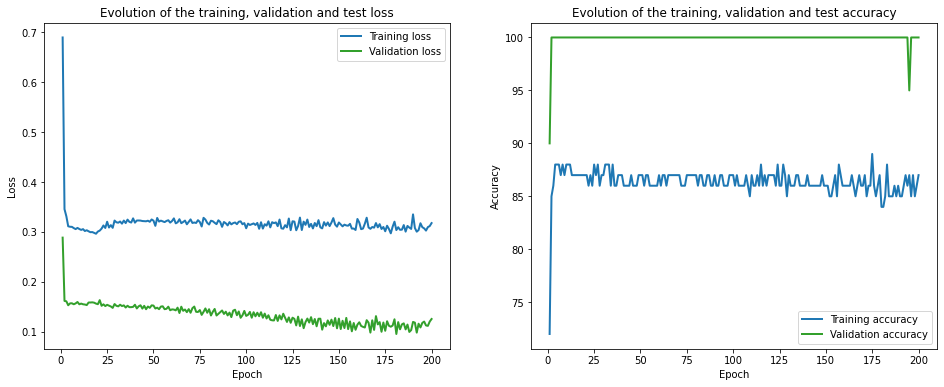

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 142.43it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 988.81it/s]

Finished computing p-values for 500 test points.

Starting repetition 7 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.80 train_acc: 20.00% took: 0.01s
Epoch 1 of 200, 20% 	 train_loss: 1.66 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 1.48 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.86 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.44 train_acc: 70.00% took: 0.01s
Epoch 1 of 200, 70% 	 train_loss: 0.55 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 1.11 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.77 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.35 train_acc: 70.00% took: 0.00s
val_loss = 0.36 val_acc = 75.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.52 train_acc: 90.00% took: 0.01s
Epoch 2 of 200, 20% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.5

Epoch 15 of 200, 70% 	 train_loss: 0.64 train_acc: 80.00% took: 0.01s
Epoch 15 of 200, 80% 	 train_loss: 0.73 train_acc: 50.00% took: 0.00s
Epoch 15 of 200, 90% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 100% 	 train_loss: 0.14 train_acc: 100.00% took: 0.01s
val_loss = 0.50 val_acc = 70.00%
Snapshot saved at epoch 15.
Epoch 16 of 200, 10% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 30% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 40% 	 train_loss: 0.81 train_acc: 40.00% took: 0.00s
Epoch 16 of 200, 50% 	 train_loss: 0.31 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 60% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 70% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 80% 	 train_loss: 0.72 train_acc: 50.00% took: 0.00s
Epoch 16 of 200, 90% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 100% 	 tr

val_loss = 0.39 val_acc = 75.00%
Snapshot saved at epoch 28.
Epoch 29 of 200, 10% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 29 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 29 of 200, 30% 	 train_loss: 0.68 train_acc: 80.00% took: 0.00s
Epoch 29 of 200, 40% 	 train_loss: 0.83 train_acc: 50.00% took: 0.00s
Epoch 29 of 200, 50% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 29 of 200, 60% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 29 of 200, 70% 	 train_loss: 0.58 train_acc: 80.00% took: 0.00s
Epoch 29 of 200, 80% 	 train_loss: 0.71 train_acc: 60.00% took: 0.00s
Epoch 29 of 200, 90% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 29 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.42 val_acc = 75.00%
Snapshot saved at epoch 29.
Epoch 30 of 200, 10% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 30 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 30 of 200, 30% 	 train_loss: 0

Epoch 44 of 200, 10% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 44 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 44 of 200, 30% 	 train_loss: 0.73 train_acc: 70.00% took: 0.00s
Epoch 44 of 200, 40% 	 train_loss: 0.80 train_acc: 60.00% took: 0.00s
Epoch 44 of 200, 50% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 44 of 200, 60% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 44 of 200, 70% 	 train_loss: 0.58 train_acc: 80.00% took: 0.00s
Epoch 44 of 200, 80% 	 train_loss: 0.71 train_acc: 50.00% took: 0.00s
Epoch 44 of 200, 90% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 44 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.46 val_acc = 70.00%
Snapshot saved at epoch 44.
Epoch 45 of 200, 10% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 45 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 45 of 200, 30% 	 train_loss: 0.73 train_acc: 70.00% took: 0.00s
Epoch 45 of 200, 40% 	 trai

Epoch 59 of 200, 70% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 59 of 200, 80% 	 train_loss: 0.71 train_acc: 50.00% took: 0.00s
Epoch 59 of 200, 90% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 59 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.47 val_acc = 70.00%
Snapshot saved at epoch 59.
Epoch 60 of 200, 10% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 60 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 60 of 200, 30% 	 train_loss: 0.70 train_acc: 70.00% took: 0.00s
Epoch 60 of 200, 40% 	 train_loss: 0.81 train_acc: 50.00% took: 0.00s
Epoch 60 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 60 of 200, 60% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 60 of 200, 70% 	 train_loss: 0.63 train_acc: 80.00% took: 0.00s
Epoch 60 of 200, 80% 	 train_loss: 0.72 train_acc: 50.00% took: 0.00s
Epoch 60 of 200, 90% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 60 of 200, 100% 	 tra

Epoch 74 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 74 of 200, 30% 	 train_loss: 0.71 train_acc: 70.00% took: 0.00s
Epoch 74 of 200, 40% 	 train_loss: 0.79 train_acc: 60.00% took: 0.00s
Epoch 74 of 200, 50% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 74 of 200, 60% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 74 of 200, 70% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 74 of 200, 80% 	 train_loss: 0.72 train_acc: 50.00% took: 0.00s
Epoch 74 of 200, 90% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 74 of 200, 100% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
val_loss = 0.46 val_acc = 70.00%
Snapshot saved at epoch 74.
Epoch 75 of 200, 10% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 75 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 75 of 200, 30% 	 train_loss: 0.71 train_acc: 70.00% took: 0.00s
Epoch 75 of 200, 40% 	 train_loss: 0.78 train_acc: 60.00% took: 0.00s
Epoch 75 of 200, 50% 	 trai

Epoch 89 of 200, 90% 	 train_loss: 0.38 train_acc: 90.00% took: 0.01s
Epoch 89 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.47 val_acc = 70.00%
Snapshot saved at epoch 89.
Epoch 90 of 200, 10% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 90 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 90 of 200, 30% 	 train_loss: 0.71 train_acc: 70.00% took: 0.00s
Epoch 90 of 200, 40% 	 train_loss: 0.78 train_acc: 60.00% took: 0.00s
Epoch 90 of 200, 50% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 90 of 200, 60% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 90 of 200, 70% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 90 of 200, 80% 	 train_loss: 0.71 train_acc: 50.00% took: 0.00s
Epoch 90 of 200, 90% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 90 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.48 val_acc = 70.00%
Snapshot saved at epoch 90.
Epoch 91 of 200, 10% 	 train_loss:

Epoch 100 of 200, 70% 	 train_loss: 0.65 train_acc: 80.00% took: 0.02s
Epoch 100 of 200, 80% 	 train_loss: 0.72 train_acc: 50.00% took: 0.00s
Epoch 100 of 200, 90% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 0.48 val_acc = 70.00%
Snapshot saved at epoch 100.
Epoch 101 of 200, 10% 	 train_loss: 0.32 train_acc: 90.00% took: 0.01s
Epoch 101 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 30% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 101 of 200, 40% 	 train_loss: 0.77 train_acc: 60.00% took: 0.00s
Epoch 101 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 60% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 70% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 101 of 200, 80% 	 train_loss: 0.71 train_acc: 50.00% took: 0.00s
Epoch 101 of 200, 90% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 101 of 

Epoch 114 of 200, 40% 	 train_loss: 0.78 train_acc: 60.00% took: 0.00s
Epoch 114 of 200, 50% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 114 of 200, 60% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 114 of 200, 70% 	 train_loss: 0.65 train_acc: 80.00% took: 0.00s
Epoch 114 of 200, 80% 	 train_loss: 0.72 train_acc: 60.00% took: 0.00s
Epoch 114 of 200, 90% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 114 of 200, 100% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
val_loss = 0.46 val_acc = 70.00%
Snapshot saved at epoch 114.
Epoch 115 of 200, 10% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 115 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 115 of 200, 30% 	 train_loss: 0.71 train_acc: 70.00% took: 0.00s
Epoch 115 of 200, 40% 	 train_loss: 0.86 train_acc: 50.00% took: 0.00s
Epoch 115 of 200, 50% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 115 of 200, 60% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 115 of 

Epoch 130 of 200, 30% 	 train_loss: 0.69 train_acc: 70.00% took: 0.02s
Epoch 130 of 200, 40% 	 train_loss: 0.77 train_acc: 60.00% took: 0.00s
Epoch 130 of 200, 50% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 130 of 200, 60% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 130 of 200, 70% 	 train_loss: 0.63 train_acc: 80.00% took: 0.00s
Epoch 130 of 200, 80% 	 train_loss: 0.71 train_acc: 50.00% took: 0.00s
Epoch 130 of 200, 90% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 130 of 200, 100% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
val_loss = 0.52 val_acc = 70.00%
Snapshot saved at epoch 130.
Epoch 131 of 200, 10% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 131 of 200, 20% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 131 of 200, 30% 	 train_loss: 0.69 train_acc: 70.00% took: 0.00s
Epoch 131 of 200, 40% 	 train_loss: 0.78 train_acc: 60.00% took: 0.00s
Epoch 131 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 131 of 

Epoch 140 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.02s
val_loss = 0.49 val_acc = 70.00%
Snapshot saved at epoch 140.
Epoch 141 of 200, 10% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 141 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 141 of 200, 30% 	 train_loss: 0.65 train_acc: 70.00% took: 0.00s
Epoch 141 of 200, 40% 	 train_loss: 0.77 train_acc: 60.00% took: 0.00s
Epoch 141 of 200, 50% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 141 of 200, 60% 	 train_loss: 0.33 train_acc: 90.00% took: 0.01s
Epoch 141 of 200, 70% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 141 of 200, 80% 	 train_loss: 0.71 train_acc: 50.00% took: 0.00s
Epoch 141 of 200, 90% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 141 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 0.48 val_acc = 70.00%
Snapshot saved at epoch 141.
Epoch 142 of 200, 10% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 142 of 200, 20

Epoch 155 of 200, 40% 	 train_loss: 0.77 train_acc: 60.00% took: 0.02s
Epoch 155 of 200, 50% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 155 of 200, 60% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 155 of 200, 70% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 155 of 200, 80% 	 train_loss: 0.72 train_acc: 50.00% took: 0.00s
Epoch 155 of 200, 90% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 155 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 0.49 val_acc = 70.00%
Snapshot saved at epoch 155.
Epoch 156 of 200, 10% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 156 of 200, 20% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 156 of 200, 30% 	 train_loss: 0.67 train_acc: 70.00% took: 0.00s
Epoch 156 of 200, 40% 	 train_loss: 0.76 train_acc: 60.00% took: 0.00s
Epoch 156 of 200, 50% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 156 of 200, 60% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 156 of 

Epoch 170 of 200, 70% 	 train_loss: 0.65 train_acc: 80.00% took: 0.02s
Epoch 170 of 200, 80% 	 train_loss: 0.72 train_acc: 60.00% took: 0.00s
Epoch 170 of 200, 90% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 170 of 200, 100% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
val_loss = 0.49 val_acc = 70.00%
Snapshot saved at epoch 170.
Epoch 171 of 200, 10% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 171 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 171 of 200, 30% 	 train_loss: 0.70 train_acc: 70.00% took: 0.00s
Epoch 171 of 200, 40% 	 train_loss: 0.77 train_acc: 60.00% took: 0.00s
Epoch 171 of 200, 50% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 171 of 200, 60% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 171 of 200, 70% 	 train_loss: 0.65 train_acc: 80.00% took: 0.00s
Epoch 171 of 200, 80% 	 train_loss: 0.72 train_acc: 60.00% took: 0.01s
Epoch 171 of 200, 90% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 171 of 

Epoch 185 of 200, 30% 	 train_loss: 0.67 train_acc: 70.00% took: 0.02s
Epoch 185 of 200, 40% 	 train_loss: 0.77 train_acc: 60.00% took: 0.01s
Epoch 185 of 200, 50% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 185 of 200, 60% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 185 of 200, 70% 	 train_loss: 0.63 train_acc: 80.00% took: 0.00s
Epoch 185 of 200, 80% 	 train_loss: 0.72 train_acc: 50.00% took: 0.00s
Epoch 185 of 200, 90% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 185 of 200, 100% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
val_loss = 0.51 val_acc = 70.00%
Snapshot saved at epoch 185.
Epoch 186 of 200, 10% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 186 of 200, 20% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 186 of 200, 30% 	 train_loss: 0.69 train_acc: 70.00% took: 0.00s
Epoch 186 of 200, 40% 	 train_loss: 0.76 train_acc: 60.00% took: 0.00s
Epoch 186 of 200, 50% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 186 of 

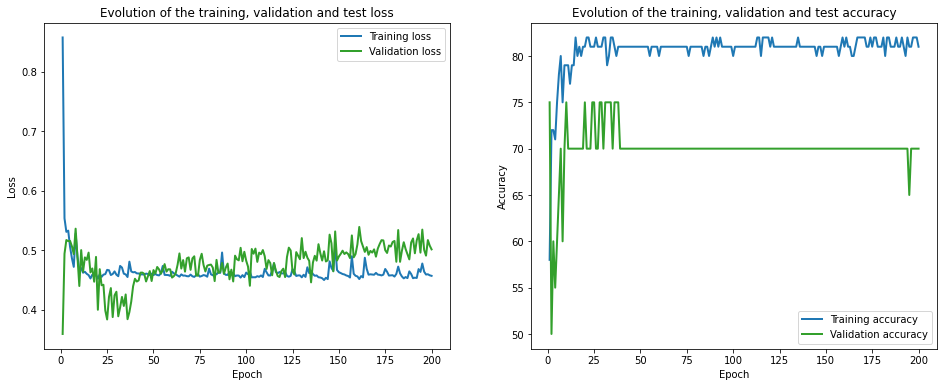

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 137.12it/s]


Initialization done!


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1333.72it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 1.96 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 1.12 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 1.24 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.96 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
val_loss = 0.33 val_acc = 100.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.56 train_acc: 40.00% took: 0.01s
Epoch 2 of 200, 20% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.

Epoch 14 of 200, 80% 	 train_loss: 0.73 train_acc: 50.00% took: 0.00s
Epoch 14 of 200, 90% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 14 of 200, 100% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
val_loss = 0.49 val_acc = 70.00%
Snapshot saved at epoch 14.
Epoch 15 of 200, 10% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 20% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 30% 	 train_loss: 0.68 train_acc: 70.00% took: 0.00s
Epoch 15 of 200, 40% 	 train_loss: 0.83 train_acc: 40.00% took: 0.00s
Epoch 15 of 200, 50% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 60% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 70% 	 train_loss: 0.67 train_acc: 80.00% took: 0.00s
Epoch 15 of 200, 80% 	 train_loss: 0.73 train_acc: 50.00% took: 0.00s
Epoch 15 of 200, 90% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 0.49 val_acc =

Epoch 28 of 200, 60% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 70% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 80% 	 train_loss: 0.73 train_acc: 50.00% took: 0.00s
Epoch 28 of 200, 90% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.48 val_acc = 70.00%
Snapshot saved at epoch 28.
Epoch 29 of 200, 10% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 29 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 29 of 200, 30% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 29 of 200, 40% 	 train_loss: 0.82 train_acc: 50.00% took: 0.00s
Epoch 29 of 200, 50% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 29 of 200, 60% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 29 of 200, 70% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
Epoch 29 of 200, 80% 	 train_loss: 0.71 train_acc: 60.00% took: 0.00s
Epoch 29 of 200, 90% 	 trai

Epoch 43 of 200, 60% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 43 of 200, 70% 	 train_loss: 0.63 train_acc: 80.00% took: 0.00s
Epoch 43 of 200, 80% 	 train_loss: 0.72 train_acc: 60.00% took: 0.00s
Epoch 43 of 200, 90% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 43 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 0.46 val_acc = 70.00%
Snapshot saved at epoch 43.
Epoch 44 of 200, 10% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 44 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 44 of 200, 30% 	 train_loss: 0.73 train_acc: 70.00% took: 0.00s
Epoch 44 of 200, 40% 	 train_loss: 0.82 train_acc: 50.00% took: 0.00s
Epoch 44 of 200, 50% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 44 of 200, 60% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 44 of 200, 70% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 44 of 200, 80% 	 train_loss: 0.72 train_acc: 50.00% took: 0.00s
Epoch 44 of 200, 90% 	 trai

Epoch 57 of 200, 100% 	 train_loss: 0.17 train_acc: 100.00% took: 0.01s
val_loss = 0.45 val_acc = 70.00%
Snapshot saved at epoch 57.
Epoch 58 of 200, 10% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 30% 	 train_loss: 0.71 train_acc: 70.00% took: 0.00s
Epoch 58 of 200, 40% 	 train_loss: 0.79 train_acc: 60.00% took: 0.00s
Epoch 58 of 200, 50% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 60% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 70% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 58 of 200, 80% 	 train_loss: 0.72 train_acc: 50.00% took: 0.00s
Epoch 58 of 200, 90% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 100% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
val_loss = 0.46 val_acc = 70.00%
Snapshot saved at epoch 58.
Epoch 59 of 200, 10% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 59 of 200, 20% 	 train_loss:

Epoch 72 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.42 val_acc = 75.00%
Snapshot saved at epoch 72.
Epoch 73 of 200, 10% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 73 of 200, 20% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 73 of 200, 30% 	 train_loss: 0.65 train_acc: 70.00% took: 0.00s
Epoch 73 of 200, 40% 	 train_loss: 0.98 train_acc: 50.00% took: 0.00s
Epoch 73 of 200, 50% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 73 of 200, 60% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 73 of 200, 70% 	 train_loss: 0.68 train_acc: 80.00% took: 0.00s
Epoch 73 of 200, 80% 	 train_loss: 0.72 train_acc: 60.00% took: 0.00s
Epoch 73 of 200, 90% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 73 of 200, 100% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
val_loss = 0.48 val_acc = 70.00%
Snapshot saved at epoch 73.
Epoch 74 of 200, 10% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 74 of 200, 20% 	 train_loss:

Epoch 87 of 200, 50% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 87 of 200, 60% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 87 of 200, 70% 	 train_loss: 0.63 train_acc: 80.00% took: 0.00s
Epoch 87 of 200, 80% 	 train_loss: 0.71 train_acc: 50.00% took: 0.00s
Epoch 87 of 200, 90% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 87 of 200, 100% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
val_loss = 0.47 val_acc = 70.00%
Snapshot saved at epoch 87.
Epoch 88 of 200, 10% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 88 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 88 of 200, 30% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 88 of 200, 40% 	 train_loss: 0.78 train_acc: 60.00% took: 0.00s
Epoch 88 of 200, 50% 	 train_loss: 0.30 train_acc: 90.00% took: 0.02s
Epoch 88 of 200, 60% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 88 of 200, 70% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 88 of 200, 80% 	 trai

Epoch 103 of 200, 30% 	 train_loss: 0.70 train_acc: 70.00% took: 0.02s
Epoch 103 of 200, 40% 	 train_loss: 0.83 train_acc: 50.00% took: 0.00s
Epoch 103 of 200, 50% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 103 of 200, 60% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 103 of 200, 70% 	 train_loss: 0.66 train_acc: 80.00% took: 0.00s
Epoch 103 of 200, 80% 	 train_loss: 0.72 train_acc: 50.00% took: 0.00s
Epoch 103 of 200, 90% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 103 of 200, 100% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
val_loss = 0.51 val_acc = 70.00%
Snapshot saved at epoch 103.
Epoch 104 of 200, 10% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 104 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 104 of 200, 30% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 104 of 200, 40% 	 train_loss: 0.77 train_acc: 60.00% took: 0.00s
Epoch 104 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 104 of 

Epoch 118 of 200, 70% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 118 of 200, 80% 	 train_loss: 0.71 train_acc: 60.00% took: 0.00s
Epoch 118 of 200, 90% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 118 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.45 val_acc = 70.00%
Snapshot saved at epoch 118.
Epoch 119 of 200, 10% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 119 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 119 of 200, 30% 	 train_loss: 0.67 train_acc: 70.00% took: 0.00s
Epoch 119 of 200, 40% 	 train_loss: 0.78 train_acc: 60.00% took: 0.00s
Epoch 119 of 200, 50% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 119 of 200, 60% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 119 of 200, 70% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 119 of 200, 80% 	 train_loss: 0.71 train_acc: 50.00% took: 0.00s
Epoch 119 of 200, 90% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 119 of 

Epoch 133 of 200, 30% 	 train_loss: 0.66 train_acc: 70.00% took: 0.00s
Epoch 133 of 200, 40% 	 train_loss: 0.77 train_acc: 60.00% took: 0.00s
Epoch 133 of 200, 50% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 133 of 200, 60% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 133 of 200, 70% 	 train_loss: 0.63 train_acc: 80.00% took: 0.00s
Epoch 133 of 200, 80% 	 train_loss: 0.72 train_acc: 50.00% took: 0.00s
Epoch 133 of 200, 90% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 133 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.01s
val_loss = 0.52 val_acc = 70.00%
Snapshot saved at epoch 133.
Epoch 134 of 200, 10% 	 train_loss: 0.32 train_acc: 90.00% took: 0.01s
Epoch 134 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 134 of 200, 30% 	 train_loss: 0.69 train_acc: 70.00% took: 0.00s
Epoch 134 of 200, 40% 	 train_loss: 0.78 train_acc: 60.00% took: 0.00s
Epoch 134 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 134 of 

Epoch 147 of 200, 70% 	 train_loss: 0.62 train_acc: 80.00% took: 0.02s
Epoch 147 of 200, 80% 	 train_loss: 0.71 train_acc: 60.00% took: 0.00s
Epoch 147 of 200, 90% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 147 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 0.49 val_acc = 70.00%
Snapshot saved at epoch 147.
Epoch 148 of 200, 10% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 148 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 148 of 200, 30% 	 train_loss: 0.66 train_acc: 70.00% took: 0.00s
Epoch 148 of 200, 40% 	 train_loss: 0.78 train_acc: 60.00% took: 0.00s
Epoch 148 of 200, 50% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 148 of 200, 60% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 148 of 200, 70% 	 train_loss: 0.63 train_acc: 80.00% took: 0.00s
Epoch 148 of 200, 80% 	 train_loss: 0.72 train_acc: 50.00% took: 0.00s
Epoch 148 of 200, 90% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 148 of 

Epoch 158 of 200, 40% 	 train_loss: 1.02 train_acc: 50.00% took: 0.00s
Epoch 158 of 200, 50% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 158 of 200, 60% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 158 of 200, 70% 	 train_loss: 0.71 train_acc: 80.00% took: 0.00s
Epoch 158 of 200, 80% 	 train_loss: 0.73 train_acc: 60.00% took: 0.00s
Epoch 158 of 200, 90% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 158 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 0.53 val_acc = 65.00%
Snapshot saved at epoch 158.
Epoch 159 of 200, 10% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 159 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 159 of 200, 30% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 159 of 200, 40% 	 train_loss: 0.76 train_acc: 60.00% took: 0.00s
Epoch 159 of 200, 50% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 159 of 200, 60% 	 train_loss: 0.30 train_acc: 90.00% took: 0.02s
Epoch 159 of 

Epoch 172 of 200, 30% 	 train_loss: 0.67 train_acc: 70.00% took: 0.01s
Epoch 172 of 200, 40% 	 train_loss: 0.79 train_acc: 60.00% took: 0.01s
Epoch 172 of 200, 50% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 172 of 200, 60% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 172 of 200, 70% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 172 of 200, 80% 	 train_loss: 0.71 train_acc: 60.00% took: 0.00s
Epoch 172 of 200, 90% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 172 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.46 val_acc = 70.00%
Snapshot saved at epoch 172.
Epoch 173 of 200, 10% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 173 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 173 of 200, 30% 	 train_loss: 0.66 train_acc: 70.00% took: 0.00s
Epoch 173 of 200, 40% 	 train_loss: 0.80 train_acc: 60.00% took: 0.00s
Epoch 173 of 200, 50% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 173 of 

Epoch 183 of 200, 10% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 183 of 200, 20% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 183 of 200, 30% 	 train_loss: 0.64 train_acc: 70.00% took: 0.00s
Epoch 183 of 200, 40% 	 train_loss: 0.87 train_acc: 50.00% took: 0.00s
Epoch 183 of 200, 50% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 183 of 200, 60% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 183 of 200, 70% 	 train_loss: 0.72 train_acc: 80.00% took: 0.00s
Epoch 183 of 200, 80% 	 train_loss: 0.75 train_acc: 60.00% took: 0.00s
Epoch 183 of 200, 90% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 183 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 0.52 val_acc = 70.00%
Snapshot saved at epoch 183.
Epoch 184 of 200, 10% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 184 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 184 of 200, 30% 	 train_loss: 0.70 train_acc: 70.00% took: 0.00s
Epoch 184 of 

Epoch 194 of 200, 10% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 194 of 200, 20% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 194 of 200, 30% 	 train_loss: 0.65 train_acc: 70.00% took: 0.00s
Epoch 194 of 200, 40% 	 train_loss: 1.04 train_acc: 50.00% took: 0.00s
Epoch 194 of 200, 50% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 194 of 200, 60% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 194 of 200, 70% 	 train_loss: 0.73 train_acc: 80.00% took: 0.00s
Epoch 194 of 200, 80% 	 train_loss: 0.74 train_acc: 60.00% took: 0.00s
Epoch 194 of 200, 90% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 194 of 200, 100% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
val_loss = 0.53 val_acc = 65.00%
Snapshot saved at epoch 194.
Epoch 195 of 200, 10% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 195 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 195 of 200, 30% 	 train_loss: 0.75 train_acc: 70.00% took: 0.00s
Epoch 195 of 

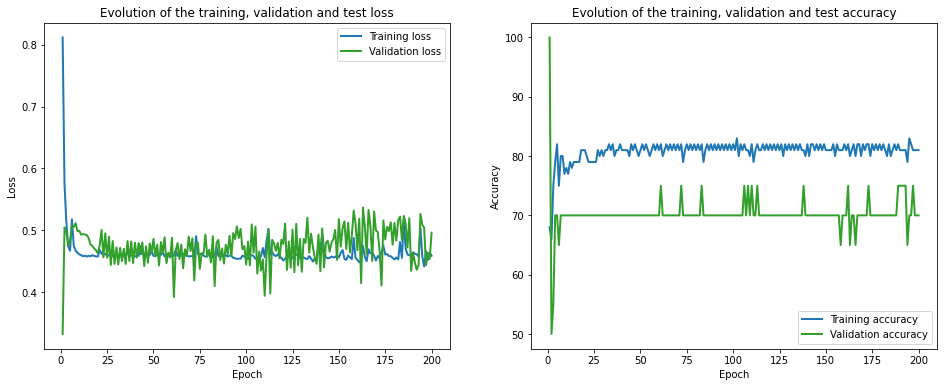

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 147.21it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1206.02it/s]

Finished computing p-values for 500 test points.

Starting repetition 8 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.68 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.65 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.91 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.66 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.88 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
val_loss = 0.31 val_acc = 85.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.82 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 

Epoch 16 of 200, 50% 	 train_loss: 0.78 train_acc: 60.00% took: 0.00s
Epoch 16 of 200, 60% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 80% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 90% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 0.56 val_acc = 85.00%
Snapshot saved at epoch 16.
Epoch 17 of 200, 10% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 20% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 30% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 40% 	 train_loss: 0.86 train_acc: 70.00% took: 0.00s
Epoch 17 of 200, 50% 	 train_loss: 0.76 train_acc: 70.00% took: 0.00s
Epoch 17 of 200, 60% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 80% 	 

Epoch 27 of 200, 60% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 70% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 80% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 27 of 200, 90% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 100% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
val_loss = 0.61 val_acc = 75.00%
Snapshot saved at epoch 27.
Epoch 28 of 200, 10% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 20% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 30% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 40% 	 train_loss: 0.82 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 50% 	 train_loss: 0.72 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 70% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 80% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 28 of 200, 90% 	 

Epoch 42 of 200, 20% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 42 of 200, 30% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 42 of 200, 40% 	 train_loss: 0.79 train_acc: 80.00% took: 0.00s
Epoch 42 of 200, 50% 	 train_loss: 0.65 train_acc: 80.00% took: 0.00s
Epoch 42 of 200, 60% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 42 of 200, 70% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 42 of 200, 80% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 42 of 200, 90% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 42 of 200, 100% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
val_loss = 0.56 val_acc = 85.00%
Snapshot saved at epoch 42.
Epoch 43 of 200, 10% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 43 of 200, 20% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 43 of 200, 30% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 43 of 200, 40% 	 train_loss: 0.83 train_acc: 70.00% took: 0.00s
Epoch 43 of 200, 50% 	

Epoch 56 of 200, 70% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 56 of 200, 80% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 56 of 200, 90% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 56 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 0.56 val_acc = 85.00%
Snapshot saved at epoch 56.
Epoch 57 of 200, 10% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 20% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 57 of 200, 30% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 57 of 200, 40% 	 train_loss: 0.80 train_acc: 70.00% took: 0.00s
Epoch 57 of 200, 50% 	 train_loss: 0.67 train_acc: 80.00% took: 0.00s
Epoch 57 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 70% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 57 of 200, 80% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 57 of 200, 90% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 57 of 200, 100% 	

Epoch 71 of 200, 100% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
val_loss = 0.56 val_acc = 85.00%
Snapshot saved at epoch 71.
Epoch 72 of 200, 10% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 72 of 200, 20% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 72 of 200, 30% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 72 of 200, 40% 	 train_loss: 0.78 train_acc: 70.00% took: 0.00s
Epoch 72 of 200, 50% 	 train_loss: 0.65 train_acc: 80.00% took: 0.00s
Epoch 72 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 72 of 200, 70% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 72 of 200, 80% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 72 of 200, 90% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 72 of 200, 100% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
val_loss = 0.56 val_acc = 85.00%
Snapshot saved at epoch 72.
Epoch 73 of 200, 10% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 73 of 200, 20% 	 train_lo

Epoch 82 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 82 of 200, 80% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 82 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 82 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 0.56 val_acc = 80.00%
Snapshot saved at epoch 82.
Epoch 83 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 83 of 200, 20% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 83 of 200, 30% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 83 of 200, 40% 	 train_loss: 0.77 train_acc: 70.00% took: 0.00s
Epoch 83 of 200, 50% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 83 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 83 of 200, 70% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 83 of 200, 80% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 83 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 83 of 200, 100% 	 

Epoch 98 of 200, 20% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 98 of 200, 30% 	 train_loss: 0.08 train_acc: 100.00% took: 0.01s
Epoch 98 of 200, 40% 	 train_loss: 0.76 train_acc: 70.00% took: 0.00s
Epoch 98 of 200, 50% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 98 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 98 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 98 of 200, 80% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 98 of 200, 90% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 98 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 0.52 val_acc = 75.00%
Snapshot saved at epoch 98.
Epoch 99 of 200, 10% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 99 of 200, 20% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 99 of 200, 30% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 99 of 200, 40% 	 train_loss: 0.76 train_acc: 80.00% took: 0.00s
Epoch 99 of 200, 50% 	 

Epoch 113 of 200, 10% 	 train_loss: 0.25 train_acc: 90.00% took: 0.02s
Epoch 113 of 200, 20% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 113 of 200, 30% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 113 of 200, 40% 	 train_loss: 0.76 train_acc: 70.00% took: 0.00s
Epoch 113 of 200, 50% 	 train_loss: 0.63 train_acc: 80.00% took: 0.00s
Epoch 113 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 113 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 113 of 200, 80% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 113 of 200, 90% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 113 of 200, 100% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
val_loss = 0.56 val_acc = 85.00%
Snapshot saved at epoch 113.
Epoch 114 of 200, 10% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 114 of 200, 20% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 114 of 200, 30% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 114

Epoch 123 of 200, 90% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 123 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 0.57 val_acc = 85.00%
Snapshot saved at epoch 123.
Epoch 124 of 200, 10% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 124 of 200, 20% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 124 of 200, 30% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 124 of 200, 40% 	 train_loss: 0.75 train_acc: 70.00% took: 0.00s
Epoch 124 of 200, 50% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
Epoch 124 of 200, 60% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 124 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 124 of 200, 80% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 124 of 200, 90% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 124 of 200, 100% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
val_loss = 0.57 val_acc = 80.00%
Snapshot saved at epoch 124.
Epoch 125 of 200, 

Epoch 134 of 200, 70% 	 train_loss: 0.18 train_acc: 90.00% took: 0.02s
Epoch 134 of 200, 80% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 134 of 200, 90% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 134 of 200, 100% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
val_loss = 0.55 val_acc = 80.00%
Snapshot saved at epoch 134.
Epoch 135 of 200, 10% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 135 of 200, 20% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 135 of 200, 30% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 135 of 200, 40% 	 train_loss: 0.75 train_acc: 70.00% took: 0.00s
Epoch 135 of 200, 50% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 135 of 200, 60% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 135 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 135 of 200, 80% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 135 of 200, 90% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 135 o

Epoch 150 of 200, 10% 	 train_loss: 0.27 train_acc: 90.00% took: 0.02s
Epoch 150 of 200, 20% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 150 of 200, 30% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 150 of 200, 40% 	 train_loss: 0.74 train_acc: 80.00% took: 0.00s
Epoch 150 of 200, 50% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 150 of 200, 60% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 150 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 80% 	 train_loss: 0.38 train_acc: 70.00% took: 0.00s
Epoch 150 of 200, 90% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 0.58 val_acc = 75.00%
Snapshot saved at epoch 150.
Epoch 151 of 200, 10% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 151 of 200, 20% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 151 of 200, 30% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 151

Epoch 165 of 200, 50% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 165 of 200, 60% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 165 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 165 of 200, 80% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 165 of 200, 90% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 165 of 200, 100% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
val_loss = 0.57 val_acc = 75.00%
Snapshot saved at epoch 165.
Epoch 166 of 200, 10% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 20% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 166 of 200, 30% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 166 of 200, 40% 	 train_loss: 0.75 train_acc: 70.00% took: 0.00s
Epoch 166 of 200, 50% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 166 of 200, 60% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 166 of 200, 70% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 166 o

Epoch 176 of 200, 90% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 176 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 0.59 val_acc = 75.00%
Snapshot saved at epoch 176.
Epoch 177 of 200, 10% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 177 of 200, 20% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 177 of 200, 30% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 177 of 200, 40% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 177 of 200, 50% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 177 of 200, 60% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 177 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 177 of 200, 80% 	 train_loss: 0.37 train_acc: 70.00% took: 0.00s
Epoch 177 of 200, 90% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 177 of 200, 100% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
val_loss = 0.58 val_acc = 75.00%
Snapshot saved at epoch 177.
Epoch 178 of 200, 

Epoch 192 of 200, 60% 	 train_loss: 0.26 train_acc: 80.00% took: 0.02s
Epoch 192 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.01s
Epoch 192 of 200, 80% 	 train_loss: 0.38 train_acc: 70.00% took: 0.00s
Epoch 192 of 200, 90% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 192 of 200, 100% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
val_loss = 0.61 val_acc = 75.00%
Snapshot saved at epoch 192.
Epoch 193 of 200, 10% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 193 of 200, 20% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 193 of 200, 30% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 193 of 200, 40% 	 train_loss: 0.73 train_acc: 70.00% took: 0.00s
Epoch 193 of 200, 50% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 193 of 200, 60% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 193 of 200, 70% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 193 of 200, 80% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 193 o

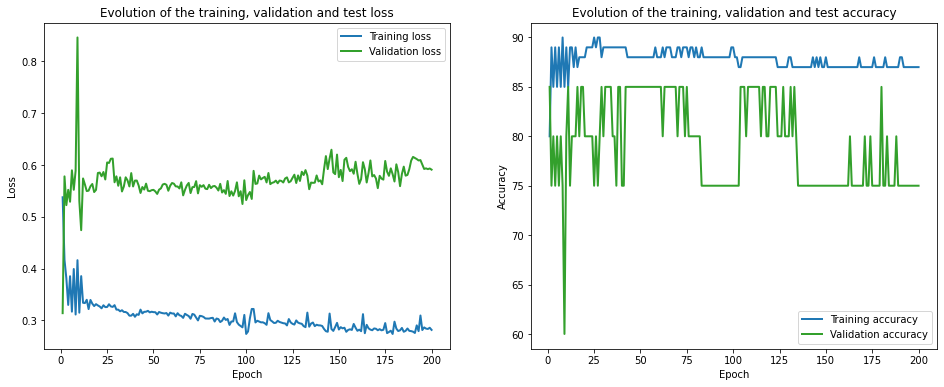

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 149.76it/s]


Initialization done!


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1147.23it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.74 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 1.32 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 2.51 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.86 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 1.44 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.84 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.52 train_acc: 50.00% took: 0.00s
val_loss = 1.36 val_acc = 75.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 1.44 train_acc: 70.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0

Epoch 16 of 200, 50% 	 train_loss: 0.69 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 60% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 70% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 80% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 90% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 100% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
val_loss = 0.60 val_acc = 75.00%
Snapshot saved at epoch 16.
Epoch 17 of 200, 10% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 20% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 30% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 40% 	 train_loss: 0.85 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 50% 	 train_loss: 0.87 train_acc: 50.00% took: 0.00s
Epoch 17 of 200, 60% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 70% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 80% 	 t

Epoch 27 of 200, 30% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 40% 	 train_loss: 0.79 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 50% 	 train_loss: 0.69 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 60% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 70% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 80% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 27 of 200, 90% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 100% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
val_loss = 0.58 val_acc = 80.00%
Snapshot saved at epoch 27.
Epoch 28 of 200, 10% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 20% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 30% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 40% 	 train_loss: 0.79 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 50% 	 train_loss: 0.69 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 60% 	 

Epoch 42 of 200, 40% 	 train_loss: 0.76 train_acc: 70.00% took: 0.00s
Epoch 42 of 200, 50% 	 train_loss: 0.70 train_acc: 80.00% took: 0.00s
Epoch 42 of 200, 60% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 42 of 200, 70% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 42 of 200, 80% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 42 of 200, 90% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 42 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.53 val_acc = 85.00%
Snapshot saved at epoch 42.
Epoch 43 of 200, 10% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 43 of 200, 20% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 43 of 200, 30% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 43 of 200, 40% 	 train_loss: 0.75 train_acc: 70.00% took: 0.00s
Epoch 43 of 200, 50% 	 train_loss: 0.72 train_acc: 80.00% took: 0.00s
Epoch 43 of 200, 60% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 43 of 200, 70% 	 t

val_loss = 0.55 val_acc = 75.00%
Snapshot saved at epoch 57.
Epoch 58 of 200, 10% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 20% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 58 of 200, 30% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 58 of 200, 40% 	 train_loss: 0.75 train_acc: 70.00% took: 0.00s
Epoch 58 of 200, 50% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 58 of 200, 60% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 70% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 58 of 200, 80% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 58 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 100% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
val_loss = 0.57 val_acc = 75.00%
Snapshot saved at epoch 58.
Epoch 59 of 200, 10% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 59 of 200, 20% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 59 of 200, 30% 	 train_los

val_loss = 0.54 val_acc = 75.00%
Snapshot saved at epoch 68.
Epoch 69 of 200, 10% 	 train_loss: 0.28 train_acc: 90.00% took: 0.01s
Epoch 69 of 200, 20% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 69 of 200, 30% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 69 of 200, 40% 	 train_loss: 0.76 train_acc: 80.00% took: 0.00s
Epoch 69 of 200, 50% 	 train_loss: 0.65 train_acc: 80.00% took: 0.00s
Epoch 69 of 200, 60% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 69 of 200, 70% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 69 of 200, 80% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 69 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 69 of 200, 100% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
val_loss = 0.55 val_acc = 75.00%
Snapshot saved at epoch 69.
Epoch 70 of 200, 10% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 70 of 200, 20% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 70 of 200, 30% 	 train_los

Epoch 85 of 200, 10% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 85 of 200, 20% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 85 of 200, 30% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 85 of 200, 40% 	 train_loss: 0.74 train_acc: 80.00% took: 0.00s
Epoch 85 of 200, 50% 	 train_loss: 0.66 train_acc: 80.00% took: 0.00s
Epoch 85 of 200, 60% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 85 of 200, 70% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 85 of 200, 80% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 85 of 200, 90% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 85 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 0.55 val_acc = 75.00%
Snapshot saved at epoch 85.
Epoch 86 of 200, 10% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 86 of 200, 20% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 86 of 200, 30% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 86 of 200, 40% 	

Epoch 95 of 200, 80% 	 train_loss: 0.36 train_acc: 70.00% took: 0.02s
Epoch 95 of 200, 90% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 95 of 200, 100% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
val_loss = 0.54 val_acc = 80.00%
Snapshot saved at epoch 95.
Epoch 96 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 96 of 200, 20% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 96 of 200, 30% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 96 of 200, 40% 	 train_loss: 0.73 train_acc: 70.00% took: 0.00s
Epoch 96 of 200, 50% 	 train_loss: 0.74 train_acc: 80.00% took: 0.00s
Epoch 96 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 96 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 96 of 200, 80% 	 train_loss: 0.36 train_acc: 70.00% took: 0.00s
Epoch 96 of 200, 90% 	 train_loss: 0.26 train_acc: 100.00% took: 0.00s
Epoch 96 of 200, 100% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
val_loss = 0.58 val_ac

Epoch 109 of 200, 90% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 109 of 200, 100% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
val_loss = 0.50 val_acc = 80.00%
Snapshot saved at epoch 109.
Epoch 110 of 200, 10% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 110 of 200, 20% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 110 of 200, 30% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 110 of 200, 40% 	 train_loss: 0.66 train_acc: 80.00% took: 0.00s
Epoch 110 of 200, 50% 	 train_loss: 0.67 train_acc: 90.00% took: 0.00s
Epoch 110 of 200, 60% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 110 of 200, 70% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 110 of 200, 80% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 110 of 200, 90% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 110 of 200, 100% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
val_loss = 0.46 val_acc = 80.00%
Snapshot saved at epoch 110.
Epoch 111 of 200, 1

Epoch 121 of 200, 10% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 121 of 200, 20% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 121 of 200, 30% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 121 of 200, 40% 	 train_loss: 0.68 train_acc: 80.00% took: 0.00s
Epoch 121 of 200, 50% 	 train_loss: 0.67 train_acc: 90.00% took: 0.00s
Epoch 121 of 200, 60% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 121 of 200, 70% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 121 of 200, 80% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 121 of 200, 90% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 121 of 200, 100% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
val_loss = 0.52 val_acc = 75.00%
Snapshot saved at epoch 121.
Epoch 122 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 122 of 200, 20% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 122 of 200, 30% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 12

val_loss = 0.56 val_acc = 75.00%
Snapshot saved at epoch 135.
Epoch 136 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 136 of 200, 20% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 136 of 200, 30% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 136 of 200, 40% 	 train_loss: 0.66 train_acc: 80.00% took: 0.00s
Epoch 136 of 200, 50% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 136 of 200, 60% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 136 of 200, 70% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 136 of 200, 80% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 136 of 200, 90% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 136 of 200, 100% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
val_loss = 0.55 val_acc = 75.00%
Snapshot saved at epoch 136.
Epoch 137 of 200, 10% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 137 of 200, 20% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 137 of 200,

Epoch 151 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 0.56 val_acc = 85.00%
Snapshot saved at epoch 151.
Epoch 152 of 200, 10% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 152 of 200, 20% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 152 of 200, 30% 	 train_loss: 0.09 train_acc: 100.00% took: 0.01s
Epoch 152 of 200, 40% 	 train_loss: 0.70 train_acc: 70.00% took: 0.00s
Epoch 152 of 200, 50% 	 train_loss: 0.65 train_acc: 90.00% took: 0.00s
Epoch 152 of 200, 60% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 152 of 200, 70% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 152 of 200, 80% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 152 of 200, 90% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 152 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 0.60 val_acc = 85.00%
Snapshot saved at epoch 152.
Epoch 153 of 200, 10% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 153 of 200, 

Epoch 167 of 200, 20% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 167 of 200, 30% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 167 of 200, 40% 	 train_loss: 0.67 train_acc: 80.00% took: 0.00s
Epoch 167 of 200, 50% 	 train_loss: 0.60 train_acc: 90.00% took: 0.00s
Epoch 167 of 200, 60% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 167 of 200, 70% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 167 of 200, 80% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 167 of 200, 90% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 167 of 200, 100% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
val_loss = 0.52 val_acc = 85.00%
Snapshot saved at epoch 167.
Epoch 168 of 200, 10% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 168 of 200, 20% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 168 of 200, 30% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 168 of 200, 40% 	 train_loss: 0.68 train_acc: 80.00% took: 0.00s
Epoch 168

Epoch 178 of 200, 20% 	 train_loss: 0.07 train_acc: 100.00% took: 0.02s
Epoch 178 of 200, 30% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 178 of 200, 40% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 178 of 200, 50% 	 train_loss: 0.55 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 80% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 178 of 200, 90% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 178 of 200, 100% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
val_loss = 0.52 val_acc = 80.00%
Snapshot saved at epoch 178.
Epoch 179 of 200, 10% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 179 of 200, 20% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 179 of 200, 30% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 179 of 200, 40% 	 train_loss: 0.68 train_acc: 80.00% took: 0.00s
Epoch 179 

Epoch 188 of 200, 80% 	 train_loss: 0.41 train_acc: 70.00% took: 0.02s
Epoch 188 of 200, 90% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 188 of 200, 100% 	 train_loss: 0.20 train_acc: 100.00% took: 0.01s
val_loss = 0.53 val_acc = 80.00%
Snapshot saved at epoch 188.
Epoch 189 of 200, 10% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 189 of 200, 20% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 189 of 200, 30% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 189 of 200, 40% 	 train_loss: 0.66 train_acc: 80.00% took: 0.00s
Epoch 189 of 200, 50% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 189 of 200, 60% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 189 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 189 of 200, 80% 	 train_loss: 0.44 train_acc: 60.00% took: 0.00s
Epoch 189 of 200, 90% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 189 of 200, 100% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
val_loss =

Epoch 200 of 200, 10% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 200 of 200, 20% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 200 of 200, 30% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 200 of 200, 40% 	 train_loss: 0.67 train_acc: 80.00% took: 0.00s
Epoch 200 of 200, 50% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 200 of 200, 60% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 200 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 200 of 200, 80% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 200 of 200, 90% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 200 of 200, 100% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
val_loss = 0.46 val_acc = 85.00%
Snapshot saved at epoch 200.
Training done! A list of 200 models saved.


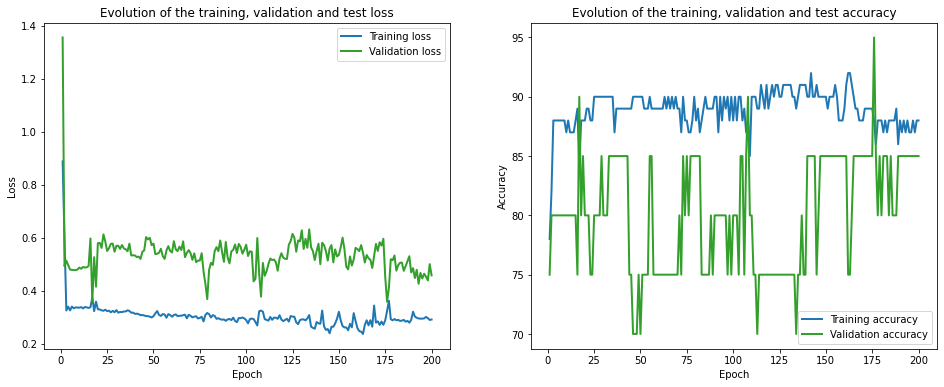

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 143.80it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1100.08it/s]

Finished computing p-values for 500 test points.

Starting repetition 9 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 1.07 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 7.26 train_acc: 30.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 2.16 train_acc: 30.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 2.13 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 2.05 train_acc: 20.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 2.81 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.66 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 1.07 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.68 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.71 train_acc: 50.00% took: 0.00s
val_loss = 1.93 val_acc = 50.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.69 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 1.0

Epoch 15 of 200, 80% 	 train_loss: 0.15 train_acc: 100.00% took: 0.02s
Epoch 15 of 200, 90% 	 train_loss: 0.69 train_acc: 70.00% took: 0.00s
Epoch 15 of 200, 100% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
val_loss = 1.74 val_acc = 65.00%
Snapshot saved at epoch 15.
Epoch 16 of 200, 10% 	 train_loss: 0.44 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 20% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 30% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 40% 	 train_loss: 0.70 train_acc: 50.00% took: 0.00s
Epoch 16 of 200, 50% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 60% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 70% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 80% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 90% 	 train_loss: 0.67 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 100% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
val_loss = 1.82 val_acc =

Epoch 31 of 200, 40% 	 train_loss: 0.71 train_acc: 50.00% took: 0.02s
Epoch 31 of 200, 50% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 31 of 200, 60% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 70% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 31 of 200, 80% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 31 of 200, 90% 	 train_loss: 0.68 train_acc: 70.00% took: 0.00s
Epoch 31 of 200, 100% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
val_loss = 1.98 val_acc = 55.00%
Snapshot saved at epoch 31.
Epoch 32 of 200, 10% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 32 of 200, 20% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 32 of 200, 30% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 32 of 200, 40% 	 train_loss: 0.69 train_acc: 50.00% took: 0.00s
Epoch 32 of 200, 50% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 32 of 200, 60% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 32 of 200, 70% 	 trai

Epoch 42 of 200, 30% 	 train_loss: 0.40 train_acc: 80.00% took: 0.02s
Epoch 42 of 200, 40% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 42 of 200, 50% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 42 of 200, 60% 	 train_loss: 0.25 train_acc: 100.00% took: 0.00s
Epoch 42 of 200, 70% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 42 of 200, 80% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 42 of 200, 90% 	 train_loss: 0.79 train_acc: 70.00% took: 0.00s
Epoch 42 of 200, 100% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
val_loss = 2.30 val_acc = 50.00%
Snapshot saved at epoch 42.
Epoch 43 of 200, 10% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
Epoch 43 of 200, 20% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 43 of 200, 30% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 43 of 200, 40% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 43 of 200, 50% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 43 of 200, 60% 	 tra

Epoch 53 of 200, 60% 	 train_loss: 0.25 train_acc: 100.00% took: 0.00s
Epoch 53 of 200, 70% 	 train_loss: 0.29 train_acc: 80.00% took: 0.01s
Epoch 53 of 200, 80% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 53 of 200, 90% 	 train_loss: 0.78 train_acc: 70.00% took: 0.00s
Epoch 53 of 200, 100% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
val_loss = 2.67 val_acc = 50.00%
Snapshot saved at epoch 53.
Epoch 54 of 200, 10% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 54 of 200, 20% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 54 of 200, 30% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 54 of 200, 40% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 54 of 200, 50% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 54 of 200, 60% 	 train_loss: 0.25 train_acc: 100.00% took: 0.00s
Epoch 54 of 200, 70% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 54 of 200, 80% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 54 of 200, 90% 	 t

Epoch 69 of 200, 10% 	 train_loss: 0.44 train_acc: 90.00% took: 0.00s
Epoch 69 of 200, 20% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 69 of 200, 30% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 69 of 200, 40% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 69 of 200, 50% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 69 of 200, 60% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 69 of 200, 70% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 69 of 200, 80% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 69 of 200, 90% 	 train_loss: 0.73 train_acc: 70.00% took: 0.00s
Epoch 69 of 200, 100% 	 train_loss: 0.44 train_acc: 80.00% took: 0.01s
val_loss = 2.55 val_acc = 60.00%
Snapshot saved at epoch 69.
Epoch 70 of 200, 10% 	 train_loss: 0.45 train_acc: 90.00% took: 0.01s
Epoch 70 of 200, 20% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 70 of 200, 30% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 70 of 200, 40% 	 tra

Epoch 84 of 200, 20% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 84 of 200, 30% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 84 of 200, 40% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 84 of 200, 50% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 84 of 200, 60% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 84 of 200, 70% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 84 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 84 of 200, 90% 	 train_loss: 0.70 train_acc: 70.00% took: 0.00s
Epoch 84 of 200, 100% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
val_loss = 3.07 val_acc = 45.00%
Snapshot saved at epoch 84.
Epoch 85 of 200, 10% 	 train_loss: 0.45 train_acc: 90.00% took: 0.00s
Epoch 85 of 200, 20% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 85 of 200, 30% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 85 of 200, 40% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 85 of 200, 50% 	 tra

Epoch 98 of 200, 70% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 98 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 98 of 200, 90% 	 train_loss: 0.67 train_acc: 70.00% took: 0.00s
Epoch 98 of 200, 100% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
val_loss = 3.16 val_acc = 55.00%
Snapshot saved at epoch 98.
Epoch 99 of 200, 10% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 99 of 200, 20% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 99 of 200, 30% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 99 of 200, 40% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 99 of 200, 50% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 99 of 200, 60% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 99 of 200, 70% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 99 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 99 of 200, 90% 	 train_loss: 0.68 train_acc: 70.00% took: 0.00s
Epoch 99 of 200, 100% 	 t

Epoch 109 of 200, 60% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 109 of 200, 70% 	 train_loss: 0.26 train_acc: 80.00% took: 0.01s
Epoch 109 of 200, 80% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 109 of 200, 90% 	 train_loss: 0.70 train_acc: 70.00% took: 0.00s
Epoch 109 of 200, 100% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
val_loss = 3.01 val_acc = 55.00%
Snapshot saved at epoch 109.
Epoch 110 of 200, 10% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 110 of 200, 20% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 110 of 200, 30% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 110 of 200, 40% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 110 of 200, 50% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 110 of 200, 60% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 110 of 200, 70% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 110 of 200, 80% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 110 

Epoch 125 of 200, 50% 	 train_loss: 0.52 train_acc: 70.00% took: 0.02s
Epoch 125 of 200, 60% 	 train_loss: 0.22 train_acc: 100.00% took: 0.01s
Epoch 125 of 200, 70% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 125 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 125 of 200, 90% 	 train_loss: 0.69 train_acc: 70.00% took: 0.00s
Epoch 125 of 200, 100% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
val_loss = 2.94 val_acc = 55.00%
Snapshot saved at epoch 125.
Epoch 126 of 200, 10% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 126 of 200, 20% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 126 of 200, 30% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 126 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 126 of 200, 50% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 126 of 200, 60% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 126 of 200, 70% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 126 o

Epoch 136 of 200, 90% 	 train_loss: 0.71 train_acc: 70.00% took: 0.00s
Epoch 136 of 200, 100% 	 train_loss: 0.44 train_acc: 90.00% took: 0.00s
val_loss = 2.58 val_acc = 55.00%
Snapshot saved at epoch 136.
Epoch 137 of 200, 10% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 137 of 200, 20% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 137 of 200, 30% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 137 of 200, 40% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 137 of 200, 50% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 137 of 200, 60% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 137 of 200, 70% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 137 of 200, 80% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 137 of 200, 90% 	 train_loss: 0.65 train_acc: 70.00% took: 0.00s
Epoch 137 of 200, 100% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
val_loss = 4.22 val_acc = 40.00%
Snapshot saved at epoch 137.
Epoch 138 of 200, 10

Epoch 152 of 200, 10% 	 train_loss: 0.44 train_acc: 80.00% took: 0.02s
Epoch 152 of 200, 20% 	 train_loss: 0.46 train_acc: 60.00% took: 0.00s
Epoch 152 of 200, 30% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 152 of 200, 40% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 152 of 200, 50% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 152 of 200, 60% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 152 of 200, 70% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 152 of 200, 80% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 152 of 200, 90% 	 train_loss: 0.64 train_acc: 70.00% took: 0.00s
Epoch 152 of 200, 100% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
val_loss = 4.84 val_acc = 45.00%
Snapshot saved at epoch 152.
Epoch 153 of 200, 10% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 153 of 200, 20% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 153 of 200, 30% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 153 of

Epoch 166 of 200, 90% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 166 of 200, 100% 	 train_loss: 0.45 train_acc: 90.00% took: 0.00s
val_loss = 3.56 val_acc = 55.00%
Snapshot saved at epoch 166.
Epoch 167 of 200, 10% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
Epoch 167 of 200, 20% 	 train_loss: 0.45 train_acc: 60.00% took: 0.00s
Epoch 167 of 200, 30% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 167 of 200, 40% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 167 of 200, 50% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 167 of 200, 60% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 167 of 200, 70% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 167 of 200, 80% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 167 of 200, 90% 	 train_loss: 0.63 train_acc: 80.00% took: 0.00s
Epoch 167 of 200, 100% 	 train_loss: 0.45 train_acc: 90.00% took: 0.00s
val_loss = 4.16 val_acc = 55.00%
Snapshot saved at epoch 167.
Epoch 168 of 200, 10

val_loss = 4.07 val_acc = 55.00%
Snapshot saved at epoch 181.
Epoch 182 of 200, 10% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 182 of 200, 20% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 182 of 200, 30% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 182 of 200, 40% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 182 of 200, 50% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 182 of 200, 60% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 182 of 200, 70% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 182 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 182 of 200, 90% 	 train_loss: 0.63 train_acc: 80.00% took: 0.00s
Epoch 182 of 200, 100% 	 train_loss: 0.44 train_acc: 90.00% took: 0.00s
val_loss = 4.38 val_acc = 55.00%
Snapshot saved at epoch 182.
Epoch 183 of 200, 10% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 183 of 200, 20% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 183 of 200, 30%

Epoch 192 of 200, 70% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 192 of 200, 80% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 192 of 200, 90% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 192 of 200, 100% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
val_loss = 4.94 val_acc = 55.00%
Snapshot saved at epoch 192.
Epoch 193 of 200, 10% 	 train_loss: 0.44 train_acc: 90.00% took: 0.00s
Epoch 193 of 200, 20% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 193 of 200, 30% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 193 of 200, 40% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 193 of 200, 50% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 193 of 200, 60% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 193 of 200, 70% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 193 of 200, 80% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 193 of 200, 90% 	 train_loss: 0.66 train_acc: 80.00% took: 0.00s
Epoch 193 o

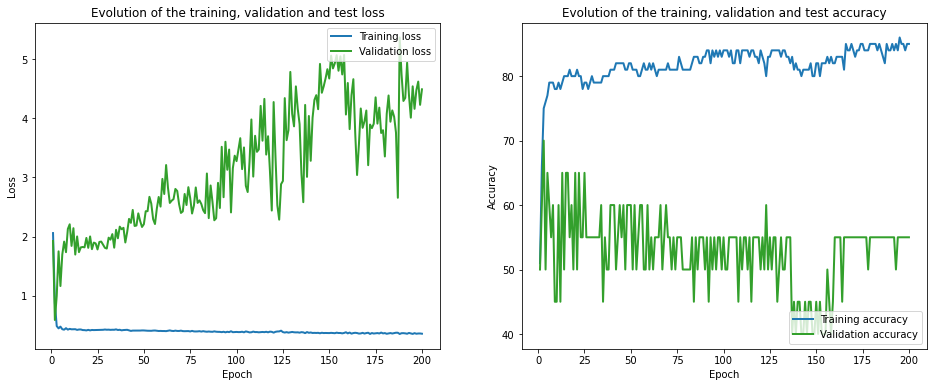

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 121.91it/s]


Initialization done!


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1045.65it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.89 train_acc: 30.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 5.46 train_acc: 30.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 1.60 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.82 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.88 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.86 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.53 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.69 train_acc: 60.00% took: 0.00s
val_loss = 0.48 val_acc = 85.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.5

Epoch 15 of 200, 60% 	 train_loss: 0.28 train_acc: 100.00% took: 0.02s
Epoch 15 of 200, 70% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 15 of 200, 80% 	 train_loss: 0.22 train_acc: 100.00% took: 0.01s
Epoch 15 of 200, 90% 	 train_loss: 0.66 train_acc: 70.00% took: 0.00s
Epoch 15 of 200, 100% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
val_loss = 1.08 val_acc = 55.00%
Snapshot saved at epoch 15.
Epoch 16 of 200, 10% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 20% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 30% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 40% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 50% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 60% 	 train_loss: 0.28 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 70% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 80% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 90% 	 t

Epoch 31 of 200, 90% 	 train_loss: 0.68 train_acc: 70.00% took: 0.02s
Epoch 31 of 200, 100% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
val_loss = 1.16 val_acc = 50.00%
Snapshot saved at epoch 31.
Epoch 32 of 200, 10% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 32 of 200, 20% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 32 of 200, 30% 	 train_loss: 0.44 train_acc: 90.00% took: 0.00s
Epoch 32 of 200, 40% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 32 of 200, 50% 	 train_loss: 0.40 train_acc: 70.00% took: 0.00s
Epoch 32 of 200, 60% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 32 of 200, 70% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 32 of 200, 80% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 32 of 200, 90% 	 train_loss: 0.67 train_acc: 70.00% took: 0.01s
Epoch 32 of 200, 100% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
val_loss = 1.16 val_acc = 50.00%
Snapshot saved at epoch 32.
Epoch 33 of 200, 10% 	 train_loss: 

Epoch 47 of 200, 80% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 47 of 200, 90% 	 train_loss: 0.67 train_acc: 70.00% took: 0.00s
Epoch 47 of 200, 100% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
val_loss = 1.47 val_acc = 45.00%
Snapshot saved at epoch 47.
Epoch 48 of 200, 10% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 48 of 200, 20% 	 train_loss: 0.62 train_acc: 60.00% took: 0.00s
Epoch 48 of 200, 30% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 48 of 200, 40% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 48 of 200, 50% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 48 of 200, 60% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 48 of 200, 70% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 48 of 200, 80% 	 train_loss: 0.83 train_acc: 90.00% took: 0.00s
Epoch 48 of 200, 90% 	 train_loss: 0.67 train_acc: 70.00% took: 0.02s
Epoch 48 of 200, 100% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
val_loss = 0.79 val_acc = 

Epoch 59 of 200, 10% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 59 of 200, 20% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 59 of 200, 30% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 59 of 200, 40% 	 train_loss: 0.71 train_acc: 50.00% took: 0.00s
Epoch 59 of 200, 50% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 59 of 200, 60% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 59 of 200, 70% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 59 of 200, 80% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 59 of 200, 90% 	 train_loss: 0.61 train_acc: 70.00% took: 0.00s
Epoch 59 of 200, 100% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
val_loss = 0.89 val_acc = 60.00%
Snapshot saved at epoch 59.
Epoch 60 of 200, 10% 	 train_loss: 0.44 train_acc: 90.00% took: 0.00s
Epoch 60 of 200, 20% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 60 of 200, 30% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 60 of 200, 40% 	 trai

Epoch 73 of 200, 70% 	 train_loss: 0.27 train_acc: 90.00% took: 0.01s
Epoch 73 of 200, 80% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 73 of 200, 90% 	 train_loss: 0.71 train_acc: 70.00% took: 0.00s
Epoch 73 of 200, 100% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
val_loss = 1.21 val_acc = 55.00%
Snapshot saved at epoch 73.
Epoch 74 of 200, 10% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 74 of 200, 20% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 74 of 200, 30% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 74 of 200, 40% 	 train_loss: 0.60 train_acc: 60.00% took: 0.00s
Epoch 74 of 200, 50% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 74 of 200, 60% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 74 of 200, 70% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 74 of 200, 80% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 74 of 200, 90% 	 train_loss: 0.62 train_acc: 70.00% took: 0.00s
Epoch 74 of 200, 100% 	 tr

Epoch 88 of 200, 70% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 88 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 88 of 200, 90% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 88 of 200, 100% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
val_loss = 1.44 val_acc = 55.00%
Snapshot saved at epoch 88.
Epoch 89 of 200, 10% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 20% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 89 of 200, 30% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 89 of 200, 40% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 89 of 200, 50% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 89 of 200, 60% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 89 of 200, 70% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 89 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 89 of 200, 90% 	 train_loss: 0.71 train_acc: 70.00% took: 0.00s
Epoch 89 of 200, 100% 	 t

Epoch 99 of 200, 80% 	 train_loss: 0.10 train_acc: 100.00% took: 0.01s
Epoch 99 of 200, 90% 	 train_loss: 0.73 train_acc: 70.00% took: 0.00s
Epoch 99 of 200, 100% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
val_loss = 0.76 val_acc = 70.00%
Snapshot saved at epoch 99.
Epoch 100 of 200, 10% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 20% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 30% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 40% 	 train_loss: 0.64 train_acc: 70.00% took: 0.00s
Epoch 100 of 200, 50% 	 train_loss: 0.39 train_acc: 70.00% took: 0.01s
Epoch 100 of 200, 60% 	 train_loss: 0.33 train_acc: 100.00% took: 0.00s
Epoch 100 of 200, 70% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 80% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 100 of 200, 90% 	 train_loss: 0.74 train_acc: 70.00% took: 0.01s
Epoch 100 of 200, 100% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
val_loss = 0.7

Epoch 114 of 200, 30% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 114 of 200, 40% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 114 of 200, 50% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 114 of 200, 60% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 114 of 200, 70% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 114 of 200, 80% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 114 of 200, 90% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 114 of 200, 100% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
val_loss = 1.04 val_acc = 60.00%
Snapshot saved at epoch 114.
Epoch 115 of 200, 10% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 115 of 200, 20% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 115 of 200, 30% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 115 of 200, 40% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 115 of 200, 50% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 115 of

Epoch 128 of 200, 90% 	 train_loss: 1.07 train_acc: 70.00% took: 0.02s
Epoch 128 of 200, 100% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
val_loss = 1.21 val_acc = 55.00%
Snapshot saved at epoch 128.
Epoch 129 of 200, 10% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 129 of 200, 20% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 129 of 200, 30% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 129 of 200, 40% 	 train_loss: 0.52 train_acc: 70.00% took: 0.00s
Epoch 129 of 200, 50% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 129 of 200, 60% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 129 of 200, 70% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 129 of 200, 80% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 129 of 200, 90% 	 train_loss: 0.65 train_acc: 70.00% took: 0.00s
Epoch 129 of 200, 100% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
val_loss = 1.43 val_acc = 55.00%
Snapshot saved at epoch 129.
Epoch 130 of 200, 10%

Epoch 143 of 200, 80% 	 train_loss: 0.11 train_acc: 100.00% took: 0.02s
Epoch 143 of 200, 90% 	 train_loss: 0.70 train_acc: 70.00% took: 0.00s
Epoch 143 of 200, 100% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
val_loss = 1.46 val_acc = 50.00%
Snapshot saved at epoch 143.
Epoch 144 of 200, 10% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 144 of 200, 20% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 144 of 200, 30% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 144 of 200, 40% 	 train_loss: 0.54 train_acc: 60.00% took: 0.00s
Epoch 144 of 200, 50% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 144 of 200, 60% 	 train_loss: 0.30 train_acc: 100.00% took: 0.00s
Epoch 144 of 200, 70% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 144 of 200, 80% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 144 of 200, 90% 	 train_loss: 0.65 train_acc: 70.00% took: 0.00s
Epoch 144 of 200, 100% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
val_loss =

Epoch 154 of 200, 50% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 154 of 200, 60% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 154 of 200, 70% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 154 of 200, 80% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 154 of 200, 90% 	 train_loss: 0.65 train_acc: 70.00% took: 0.00s
Epoch 154 of 200, 100% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
val_loss = 1.93 val_acc = 50.00%
Snapshot saved at epoch 154.
Epoch 155 of 200, 10% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 155 of 200, 20% 	 train_loss: 0.40 train_acc: 70.00% took: 0.00s
Epoch 155 of 200, 30% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 155 of 200, 40% 	 train_loss: 0.52 train_acc: 60.00% took: 0.00s
Epoch 155 of 200, 50% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 155 of 200, 60% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 155 of 200, 70% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 155 o

Epoch 169 of 200, 60% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 169 of 200, 70% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 169 of 200, 80% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 169 of 200, 90% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 169 of 200, 100% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
val_loss = 2.22 val_acc = 60.00%
Snapshot saved at epoch 169.
Epoch 170 of 200, 10% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 170 of 200, 20% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 170 of 200, 30% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 170 of 200, 40% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 170 of 200, 50% 	 train_loss: 0.40 train_acc: 70.00% took: 0.00s
Epoch 170 of 200, 60% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 170 of 200, 70% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 170 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 170 

Epoch 184 of 200, 80% 	 train_loss: 0.06 train_acc: 100.00% took: 0.02s
Epoch 184 of 200, 90% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 184 of 200, 100% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
val_loss = 3.64 val_acc = 45.00%
Snapshot saved at epoch 184.
Epoch 185 of 200, 10% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 185 of 200, 20% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 185 of 200, 30% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 185 of 200, 40% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 185 of 200, 50% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 185 of 200, 60% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 185 of 200, 70% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 185 of 200, 80% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 185 of 200, 90% 	 train_loss: 0.71 train_acc: 70.00% took: 0.00s
Epoch 185 of 200, 100% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
val_loss =

val_loss = 4.85 val_acc = 40.00%
Snapshot saved at epoch 199.
Epoch 200 of 200, 10% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 200 of 200, 20% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 200 of 200, 30% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 200 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 200 of 200, 50% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 200 of 200, 60% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 200 of 200, 70% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 200 of 200, 80% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 200 of 200, 90% 	 train_loss: 0.73 train_acc: 70.00% took: 0.00s
Epoch 200 of 200, 100% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
val_loss = 4.83 val_acc = 40.00%
Snapshot saved at epoch 200.
Training done! A list of 200 models saved.


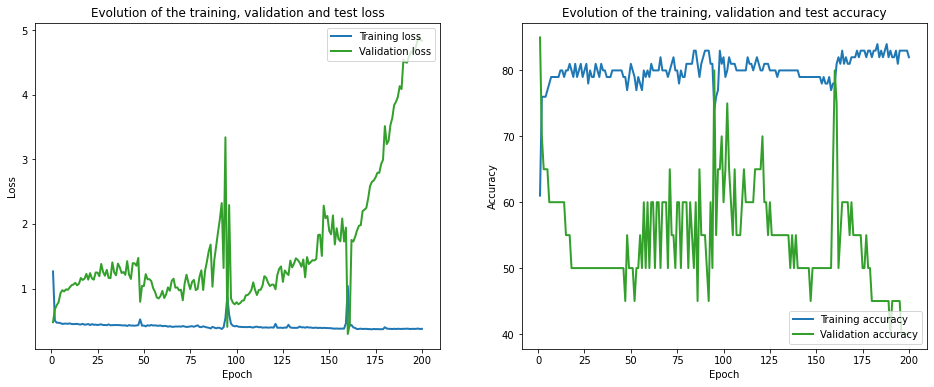

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 136.62it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1017.58it/s]

Finished computing p-values for 500 test points.

Starting repetition 10 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.83 train_acc: 30.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 1.27 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 1.87 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.83 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
val_loss = 0.23 val_acc = 100.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.40 train_acc: 70.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.94 train_acc: 70.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0

Epoch 14 of 200, 90% 	 train_loss: 0.33 train_acc: 70.00% took: 0.02s
Epoch 14 of 200, 100% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
val_loss = 0.30 val_acc = 95.00%
Snapshot saved at epoch 14.
Epoch 15 of 200, 10% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 20% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 15 of 200, 30% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 15 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 50% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 60% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 15 of 200, 70% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 15 of 200, 80% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 90% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 15 of 200, 100% 	 train_loss: 0.65 train_acc: 70.00% took: 0.00s
val_loss = 0.29 val_acc = 90.00%
Snapshot saved at epoch 15.
Epoch 16 of 200, 10% 	 train_loss: 

Epoch 25 of 200, 80% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 25 of 200, 90% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 25 of 200, 100% 	 train_loss: 0.62 train_acc: 70.00% took: 0.00s
val_loss = 0.32 val_acc = 90.00%
Snapshot saved at epoch 25.
Epoch 26 of 200, 10% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 26 of 200, 20% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 26 of 200, 30% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 26 of 200, 40% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 26 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 26 of 200, 60% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 26 of 200, 70% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 26 of 200, 80% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 26 of 200, 90% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 26 of 200, 100% 	 train_loss: 0.61 train_acc: 70.00% took: 0.00s
val_loss = 0.32 val_acc = 

Epoch 41 of 200, 60% 	 train_loss: 0.20 train_acc: 100.00% took: 0.02s
Epoch 41 of 200, 70% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 41 of 200, 80% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 41 of 200, 90% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 41 of 200, 100% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
val_loss = 0.36 val_acc = 85.00%
Snapshot saved at epoch 41.
Epoch 42 of 200, 10% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 42 of 200, 20% 	 train_loss: 0.52 train_acc: 70.00% took: 0.00s
Epoch 42 of 200, 30% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 42 of 200, 40% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 42 of 200, 50% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 42 of 200, 60% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 42 of 200, 70% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 42 of 200, 80% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 42 of 200, 90% 	 tra

Epoch 57 of 200, 10% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 20% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 57 of 200, 30% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 57 of 200, 40% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 50% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 60% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 57 of 200, 70% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 57 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 90% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 57 of 200, 100% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
val_loss = 0.39 val_acc = 85.00%
Snapshot saved at epoch 57.
Epoch 58 of 200, 10% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 20% 	 train_loss: 0.52 train_acc: 70.00% took: 0.00s
Epoch 58 of 200, 30% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 58 of 200, 40% 	 trai

val_loss = 0.41 val_acc = 90.00%
Snapshot saved at epoch 71.
Epoch 72 of 200, 10% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 72 of 200, 20% 	 train_loss: 0.64 train_acc: 70.00% took: 0.00s
Epoch 72 of 200, 30% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 72 of 200, 40% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 72 of 200, 50% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 72 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 72 of 200, 70% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 72 of 200, 80% 	 train_loss: 0.27 train_acc: 70.00% took: 0.00s
Epoch 72 of 200, 90% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 72 of 200, 100% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
val_loss = 0.46 val_acc = 85.00%
Snapshot saved at epoch 72.
Epoch 73 of 200, 10% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 73 of 200, 20% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 73 of 200, 30% 	 train_loss: 0

Epoch 87 of 200, 80% 	 train_loss: 0.25 train_acc: 90.00% took: 0.02s
Epoch 87 of 200, 90% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 87 of 200, 100% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
val_loss = 0.54 val_acc = 80.00%
Snapshot saved at epoch 87.
Epoch 88 of 200, 10% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 88 of 200, 20% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 88 of 200, 30% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 88 of 200, 40% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 88 of 200, 50% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 88 of 200, 60% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 88 of 200, 70% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 88 of 200, 80% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 88 of 200, 90% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 88 of 200, 100% 	 train_loss: 0.58 train_acc: 80.00% took: 0.00s
val_loss = 0.55 val_acc = 

Epoch 103 of 200, 60% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 103 of 200, 70% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 103 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 103 of 200, 90% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 103 of 200, 100% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
val_loss = 0.57 val_acc = 80.00%
Snapshot saved at epoch 103.
Epoch 104 of 200, 10% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 104 of 200, 20% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 104 of 200, 30% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 104 of 200, 40% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 104 of 200, 50% 	 train_loss: 0.21 train_acc: 90.00% took: 0.01s
Epoch 104 of 200, 60% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 104 of 200, 70% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 104 of 200, 80% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 104 of

Epoch 118 of 200, 20% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 118 of 200, 30% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 118 of 200, 40% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 118 of 200, 50% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 118 of 200, 60% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 118 of 200, 70% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 118 of 200, 80% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 118 of 200, 90% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 118 of 200, 100% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
val_loss = 0.58 val_acc = 80.00%
Snapshot saved at epoch 118.
Epoch 119 of 200, 10% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 119 of 200, 20% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 119 of 200, 30% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 119 of 200, 40% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 119 of 

Epoch 128 of 200, 100% 	 train_loss: 0.60 train_acc: 80.00% took: 0.02s
val_loss = 0.59 val_acc = 80.00%
Snapshot saved at epoch 128.
Epoch 129 of 200, 10% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 129 of 200, 20% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 129 of 200, 30% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 129 of 200, 40% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 129 of 200, 50% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 129 of 200, 60% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 129 of 200, 70% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 129 of 200, 80% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 129 of 200, 90% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 129 of 200, 100% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
val_loss = 0.58 val_acc = 80.00%
Snapshot saved at epoch 129.
Epoch 130 of 200, 10% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 130 of 200, 20%

Epoch 144 of 200, 90% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 144 of 200, 100% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
val_loss = 0.59 val_acc = 80.00%
Snapshot saved at epoch 144.
Epoch 145 of 200, 10% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 145 of 200, 20% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 145 of 200, 30% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 145 of 200, 40% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 145 of 200, 50% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 145 of 200, 60% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 145 of 200, 70% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 145 of 200, 80% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 145 of 200, 90% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 145 of 200, 100% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
val_loss = 0.61 val_acc = 80.00%
Snapshot saved at epoch 145.
Epoch 146 of 200, 10%

Epoch 156 of 200, 40% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 156 of 200, 50% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 156 of 200, 60% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 156 of 200, 70% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 156 of 200, 80% 	 train_loss: 0.25 train_acc: 80.00% took: 0.01s
Epoch 156 of 200, 90% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 156 of 200, 100% 	 train_loss: 0.57 train_acc: 80.00% took: 0.01s
val_loss = 0.60 val_acc = 80.00%
Snapshot saved at epoch 156.
Epoch 157 of 200, 10% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 157 of 200, 20% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 157 of 200, 30% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 157 of 200, 40% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 157 of 200, 50% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 157 of 200, 60% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 157 of

Epoch 167 of 200, 50% 	 train_loss: 0.25 train_acc: 90.00% took: 0.01s
Epoch 167 of 200, 60% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 167 of 200, 70% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 167 of 200, 80% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 167 of 200, 90% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 167 of 200, 100% 	 train_loss: 0.70 train_acc: 80.00% took: 0.00s
val_loss = 0.68 val_acc = 80.00%
Snapshot saved at epoch 167.
Epoch 168 of 200, 10% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 168 of 200, 20% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 168 of 200, 30% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 168 of 200, 40% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 168 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 168 of 200, 60% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 168 of 200, 70% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 168 of 

Epoch 178 of 200, 30% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 178 of 200, 40% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 50% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 60% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 178 of 200, 70% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 178 of 200, 80% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 178 of 200, 90% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 178 of 200, 100% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
val_loss = 0.53 val_acc = 90.00%
Snapshot saved at epoch 178.
Epoch 179 of 200, 10% 	 train_loss: 0.26 train_acc: 100.00% took: 0.00s
Epoch 179 of 200, 20% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 179 of 200, 30% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 179 of 200, 40% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 179 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 179 of 

Epoch 193 of 200, 90% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 193 of 200, 100% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
val_loss = 0.59 val_acc = 80.00%
Snapshot saved at epoch 193.
Epoch 194 of 200, 10% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 194 of 200, 20% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 194 of 200, 30% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 194 of 200, 40% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 194 of 200, 50% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 194 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 194 of 200, 70% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 194 of 200, 80% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 194 of 200, 90% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 194 of 200, 100% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
val_loss = 0.60 val_acc = 80.00%
Snapshot saved at epoch 194.
Epoch 195 of 200, 10%

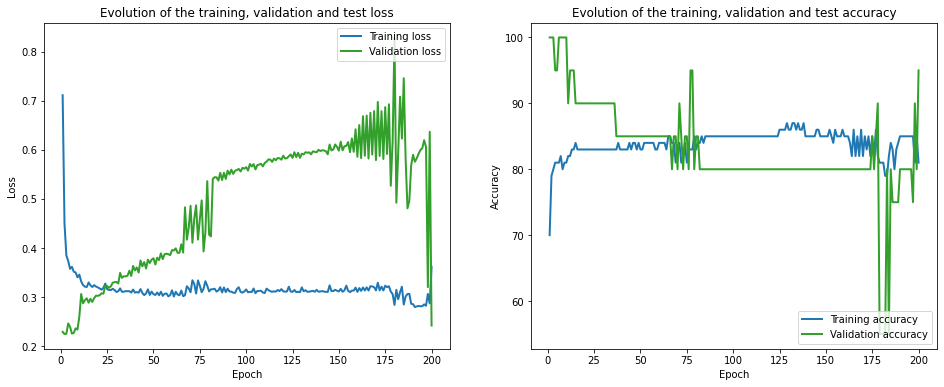

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 137.77it/s]


Initialization done!


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 985.00it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 1.45 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.73 train_acc: 30.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
val_loss = 0.24 val_acc = 95.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.90 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.5

Epoch 14 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.02s
Epoch 14 of 200, 60% 	 train_loss: 0.18 train_acc: 100.00% took: 0.01s
Epoch 14 of 200, 70% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 14 of 200, 80% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 14 of 200, 90% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 14 of 200, 100% 	 train_loss: 0.61 train_acc: 70.00% took: 0.00s
val_loss = 0.29 val_acc = 90.00%
Snapshot saved at epoch 14.
Epoch 15 of 200, 10% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 20% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 15 of 200, 30% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 15 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 50% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 60% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 15 of 200, 70% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 15 of 200, 80% 	 tra

Epoch 25 of 200, 30% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 25 of 200, 40% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 25 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 25 of 200, 60% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 25 of 200, 70% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 25 of 200, 80% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 25 of 200, 90% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 25 of 200, 100% 	 train_loss: 0.62 train_acc: 70.00% took: 0.00s
val_loss = 0.32 val_acc = 90.00%
Snapshot saved at epoch 25.
Epoch 26 of 200, 10% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 26 of 200, 20% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 26 of 200, 30% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 26 of 200, 40% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 26 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 26 of 200, 60% 	 trai

Epoch 40 of 200, 50% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 40 of 200, 60% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 40 of 200, 70% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 40 of 200, 80% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 40 of 200, 90% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 40 of 200, 100% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
val_loss = 0.36 val_acc = 85.00%
Snapshot saved at epoch 40.
Epoch 41 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 41 of 200, 20% 	 train_loss: 0.61 train_acc: 70.00% took: 0.00s
Epoch 41 of 200, 30% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 41 of 200, 40% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 41 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 41 of 200, 60% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 41 of 200, 70% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 41 of 200, 80% 	 tra

val_loss = 0.39 val_acc = 85.00%
Snapshot saved at epoch 55.
Epoch 56 of 200, 10% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 56 of 200, 20% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 56 of 200, 30% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 56 of 200, 40% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 56 of 200, 50% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 56 of 200, 60% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 56 of 200, 70% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 56 of 200, 80% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 56 of 200, 90% 	 train_loss: 0.32 train_acc: 80.00% took: 0.01s
Epoch 56 of 200, 100% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
val_loss = 0.39 val_acc = 85.00%
Snapshot saved at epoch 56.
Epoch 57 of 200, 10% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 20% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 57 of 200, 30% 	 train_loss: 0

Epoch 70 of 200, 30% 	 train_loss: 0.35 train_acc: 80.00% took: 0.02s
Epoch 70 of 200, 40% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 70 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.01s
Epoch 70 of 200, 60% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 70 of 200, 70% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 70 of 200, 80% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 70 of 200, 90% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 70 of 200, 100% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
val_loss = 0.41 val_acc = 85.00%
Snapshot saved at epoch 70.
Epoch 71 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 71 of 200, 20% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 71 of 200, 30% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 71 of 200, 40% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 71 of 200, 50% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 71 of 200, 60% 	 trai

Epoch 81 of 200, 40% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 81 of 200, 50% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 81 of 200, 60% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 81 of 200, 70% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 81 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 81 of 200, 90% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 81 of 200, 100% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
val_loss = 0.54 val_acc = 80.00%
Snapshot saved at epoch 81.
Epoch 82 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 82 of 200, 20% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 82 of 200, 30% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 82 of 200, 40% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 82 of 200, 50% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 82 of 200, 60% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 82 of 200, 70% 	 tra

Epoch 97 of 200, 20% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 97 of 200, 30% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 97 of 200, 40% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 97 of 200, 50% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 97 of 200, 60% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 97 of 200, 70% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 97 of 200, 80% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 97 of 200, 90% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 97 of 200, 100% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
val_loss = 0.57 val_acc = 80.00%
Snapshot saved at epoch 97.
Epoch 98 of 200, 10% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 98 of 200, 20% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 98 of 200, 30% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 98 of 200, 40% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 98 of 200, 50% 	 trai

Epoch 112 of 200, 20% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 112 of 200, 30% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 112 of 200, 40% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 112 of 200, 50% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 112 of 200, 60% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 112 of 200, 70% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 112 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 112 of 200, 90% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 112 of 200, 100% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
val_loss = 0.58 val_acc = 80.00%
Snapshot saved at epoch 112.
Epoch 113 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 113 of 200, 20% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 113 of 200, 30% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 113 of 200, 40% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 113 of 

Epoch 123 of 200, 30% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 123 of 200, 40% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 123 of 200, 50% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 123 of 200, 60% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 123 of 200, 70% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 123 of 200, 80% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 123 of 200, 90% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 123 of 200, 100% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
val_loss = 0.58 val_acc = 80.00%
Snapshot saved at epoch 123.
Epoch 124 of 200, 10% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 124 of 200, 20% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 124 of 200, 30% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 124 of 200, 40% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 124 of 200, 50% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 124 of 

Epoch 139 of 200, 20% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 139 of 200, 30% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 139 of 200, 40% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 139 of 200, 50% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 139 of 200, 60% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 139 of 200, 70% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 139 of 200, 80% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 139 of 200, 90% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 139 of 200, 100% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
val_loss = 0.59 val_acc = 80.00%
Snapshot saved at epoch 139.
Epoch 140 of 200, 10% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 140 of 200, 20% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 140 of 200, 30% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 140 of 200, 40% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 140 of

Epoch 150 of 200, 30% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 150 of 200, 40% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 150 of 200, 50% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 60% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 150 of 200, 70% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 80% 	 train_loss: 0.27 train_acc: 70.00% took: 0.00s
Epoch 150 of 200, 90% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 100% 	 train_loss: 0.66 train_acc: 80.00% took: 0.00s
val_loss = 0.65 val_acc = 80.00%
Snapshot saved at epoch 150.
Epoch 151 of 200, 10% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 151 of 200, 20% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 151 of 200, 30% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 151 of 200, 40% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 151 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 151 of

Epoch 161 of 200, 30% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 161 of 200, 40% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 161 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 161 of 200, 60% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 161 of 200, 70% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 161 of 200, 80% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 161 of 200, 90% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 161 of 200, 100% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
val_loss = 0.58 val_acc = 80.00%
Snapshot saved at epoch 161.
Epoch 162 of 200, 10% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 162 of 200, 20% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 162 of 200, 30% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 162 of 200, 40% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 162 of 200, 50% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 162 of 

val_loss = 0.65 val_acc = 60.00%
Snapshot saved at epoch 172.
Epoch 173 of 200, 10% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 173 of 200, 20% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 173 of 200, 30% 	 train_loss: 0.30 train_acc: 70.00% took: 0.00s
Epoch 173 of 200, 40% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 173 of 200, 50% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 173 of 200, 60% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 173 of 200, 70% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 173 of 200, 80% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 173 of 200, 90% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 173 of 200, 100% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
val_loss = 0.63 val_acc = 60.00%
Snapshot saved at epoch 173.
Epoch 174 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 20% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 174 of 200, 30% 	

Epoch 184 of 200, 70% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 184 of 200, 80% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 184 of 200, 90% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 184 of 200, 100% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
val_loss = 0.29 val_acc = 90.00%
Snapshot saved at epoch 184.
Epoch 185 of 200, 10% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 185 of 200, 20% 	 train_loss: 0.65 train_acc: 70.00% took: 0.00s
Epoch 185 of 200, 30% 	 train_loss: 0.35 train_acc: 70.00% took: 0.00s
Epoch 185 of 200, 40% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 185 of 200, 50% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 185 of 200, 60% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 185 of 200, 70% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 185 of 200, 80% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 185 of 200, 90% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 185 of

val_loss = 0.27 val_acc = 95.00%
Snapshot saved at epoch 200.
Training done! A list of 200 models saved.


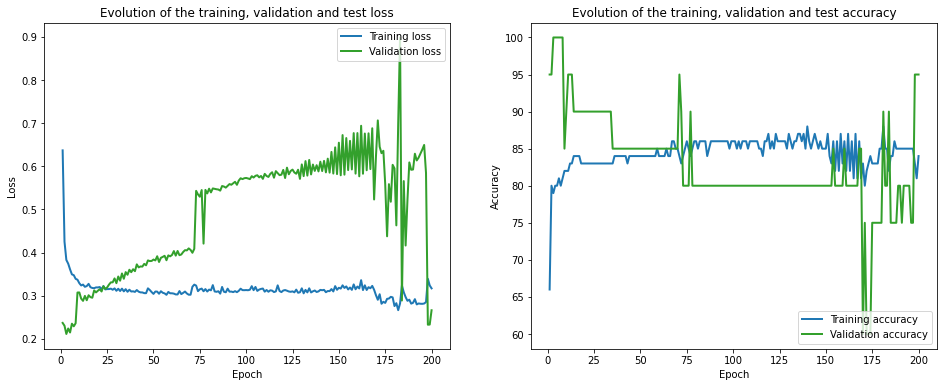

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 146.27it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 938.06it/s]

Finished computing p-values for 500 test points.

Starting repetition 11 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.84 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 2.49 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 1.15 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.85 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.60 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
val_loss = 1.01 val_acc = 40.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.50 train_acc: 60.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0

Epoch 14 of 200, 10% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 14 of 200, 20% 	 train_loss: 0.68 train_acc: 70.00% took: 0.00s
Epoch 14 of 200, 30% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 14 of 200, 40% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 14 of 200, 50% 	 train_loss: 0.73 train_acc: 60.00% took: 0.00s
Epoch 14 of 200, 60% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 14 of 200, 70% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 14 of 200, 80% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 14 of 200, 90% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 14 of 200, 100% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
val_loss = 0.72 val_acc = 50.00%
Snapshot saved at epoch 14.
Epoch 15 of 200, 10% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 15 of 200, 20% 	 train_loss: 0.67 train_acc: 70.00% took: 0.00s
Epoch 15 of 200, 30% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 15 of 200, 40% 	 trai

Epoch 25 of 200, 60% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 25 of 200, 70% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 25 of 200, 80% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 25 of 200, 90% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 25 of 200, 100% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
val_loss = 0.65 val_acc = 50.00%
Snapshot saved at epoch 25.
Epoch 26 of 200, 10% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 26 of 200, 20% 	 train_loss: 0.64 train_acc: 70.00% took: 0.00s
Epoch 26 of 200, 30% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 26 of 200, 40% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 26 of 200, 50% 	 train_loss: 0.71 train_acc: 60.00% took: 0.00s
Epoch 26 of 200, 60% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 26 of 200, 70% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 26 of 200, 80% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 26 of 200, 90% 	 tra

Epoch 39 of 200, 100% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
val_loss = 0.60 val_acc = 50.00%
Snapshot saved at epoch 39.
Epoch 40 of 200, 10% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 40 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 40 of 200, 30% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 40 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 40 of 200, 50% 	 train_loss: 0.73 train_acc: 60.00% took: 0.00s
Epoch 40 of 200, 60% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 40 of 200, 70% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 40 of 200, 80% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 40 of 200, 90% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 40 of 200, 100% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
val_loss = 0.60 val_acc = 50.00%
Snapshot saved at epoch 40.
Epoch 41 of 200, 10% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 41 of 200, 20% 	 train_loss: 

Epoch 55 of 200, 10% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 55 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 55 of 200, 30% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 55 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 55 of 200, 50% 	 train_loss: 0.76 train_acc: 60.00% took: 0.00s
Epoch 55 of 200, 60% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 55 of 200, 70% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 55 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 55 of 200, 90% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 55 of 200, 100% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
val_loss = 0.63 val_acc = 50.00%
Snapshot saved at epoch 55.
Epoch 56 of 200, 10% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 56 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 56 of 200, 30% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 56 of 200, 40% 	 tra

Epoch 69 of 200, 90% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 69 of 200, 100% 	 train_loss: 0.19 train_acc: 90.00% took: 0.01s
val_loss = 0.62 val_acc = 50.00%
Snapshot saved at epoch 69.
Epoch 70 of 200, 10% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 70 of 200, 20% 	 train_loss: 0.62 train_acc: 70.00% took: 0.00s
Epoch 70 of 200, 30% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 70 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 70 of 200, 50% 	 train_loss: 0.72 train_acc: 60.00% took: 0.00s
Epoch 70 of 200, 60% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 70 of 200, 70% 	 train_loss: 0.39 train_acc: 80.00% took: 0.01s
Epoch 70 of 200, 80% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 70 of 200, 90% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 70 of 200, 100% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
val_loss = 0.61 val_acc = 50.00%
Snapshot saved at epoch 70.
Epoch 71 of 200, 10% 	 train_loss:

Epoch 84 of 200, 10% 	 train_loss: 0.22 train_acc: 80.00% took: 0.01s
Epoch 84 of 200, 20% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 84 of 200, 30% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 84 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 84 of 200, 50% 	 train_loss: 0.71 train_acc: 60.00% took: 0.00s
Epoch 84 of 200, 60% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 84 of 200, 70% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 84 of 200, 80% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 84 of 200, 90% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 84 of 200, 100% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
val_loss = 0.60 val_acc = 50.00%
Snapshot saved at epoch 84.
Epoch 85 of 200, 10% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 85 of 200, 20% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 85 of 200, 30% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 85 of 200, 40% 	 tra

Epoch 95 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 95 of 200, 50% 	 train_loss: 0.72 train_acc: 60.00% took: 0.00s
Epoch 95 of 200, 60% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 95 of 200, 70% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 95 of 200, 80% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 95 of 200, 90% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 95 of 200, 100% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
val_loss = 0.59 val_acc = 60.00%
Snapshot saved at epoch 95.
Epoch 96 of 200, 10% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 96 of 200, 20% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 96 of 200, 30% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 96 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 96 of 200, 50% 	 train_loss: 0.72 train_acc: 60.00% took: 0.00s
Epoch 96 of 200, 60% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 96 of 200, 70% 	 tr

Epoch 110 of 200, 100% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
val_loss = 0.58 val_acc = 50.00%
Snapshot saved at epoch 110.
Epoch 111 of 200, 10% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 111 of 200, 20% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 111 of 200, 30% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 111 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 50% 	 train_loss: 0.73 train_acc: 60.00% took: 0.00s
Epoch 111 of 200, 60% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 111 of 200, 70% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 111 of 200, 80% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 90% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 100% 	 train_loss: 0.19 train_acc: 80.00% took: 0.00s
val_loss = 0.60 val_acc = 50.00%
Snapshot saved at epoch 111.
Epoch 112 of 200, 10% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 112 of 200, 20

val_loss = 0.64 val_acc = 50.00%
Snapshot saved at epoch 124.
Epoch 125 of 200, 10% 	 train_loss: 0.24 train_acc: 80.00% took: 0.01s
Epoch 125 of 200, 20% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 125 of 200, 30% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 125 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 125 of 200, 50% 	 train_loss: 0.72 train_acc: 60.00% took: 0.00s
Epoch 125 of 200, 60% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 125 of 200, 70% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 125 of 200, 80% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 125 of 200, 90% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 125 of 200, 100% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
val_loss = 0.57 val_acc = 60.00%
Snapshot saved at epoch 125.
Epoch 126 of 200, 10% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 126 of 200, 20% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 126 of 200, 30%

Epoch 136 of 200, 10% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 136 of 200, 20% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 136 of 200, 30% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 136 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 136 of 200, 50% 	 train_loss: 0.71 train_acc: 60.00% took: 0.00s
Epoch 136 of 200, 60% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 136 of 200, 70% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 136 of 200, 80% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 136 of 200, 90% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 136 of 200, 100% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
val_loss = 0.58 val_acc = 60.00%
Snapshot saved at epoch 136.
Epoch 137 of 200, 10% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 137 of 200, 20% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
Epoch 137 of 200, 30% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 137 of

Epoch 150 of 200, 50% 	 train_loss: 0.70 train_acc: 60.00% took: 0.02s
Epoch 150 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.01s
Epoch 150 of 200, 70% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 150 of 200, 80% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 150 of 200, 90% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 100% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
val_loss = 0.58 val_acc = 60.00%
Snapshot saved at epoch 150.
Epoch 151 of 200, 10% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 151 of 200, 20% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 151 of 200, 30% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 151 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 151 of 200, 50% 	 train_loss: 0.70 train_acc: 60.00% took: 0.00s
Epoch 151 of 200, 60% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 151 of 200, 70% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 151 of

Epoch 165 of 200, 40% 	 train_loss: 0.00 train_acc: 100.00% took: 0.00s
Epoch 165 of 200, 50% 	 train_loss: 0.71 train_acc: 60.00% took: 0.00s
Epoch 165 of 200, 60% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 165 of 200, 70% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 165 of 200, 80% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 165 of 200, 90% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 165 of 200, 100% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
val_loss = 0.58 val_acc = 60.00%
Snapshot saved at epoch 165.
Epoch 166 of 200, 10% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 166 of 200, 20% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 166 of 200, 30% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 166 of 200, 40% 	 train_loss: 0.00 train_acc: 100.00% took: 0.00s
Epoch 166 of 200, 50% 	 train_loss: 0.71 train_acc: 60.00% took: 0.00s
Epoch 166 of 200, 60% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 166 o

Epoch 176 of 200, 10% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 176 of 200, 20% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 176 of 200, 30% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 176 of 200, 40% 	 train_loss: 0.00 train_acc: 100.00% took: 0.00s
Epoch 176 of 200, 50% 	 train_loss: 0.70 train_acc: 60.00% took: 0.00s
Epoch 176 of 200, 60% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 176 of 200, 70% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 176 of 200, 80% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 176 of 200, 90% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 176 of 200, 100% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
val_loss = 0.56 val_acc = 55.00%
Snapshot saved at epoch 176.
Epoch 177 of 200, 10% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 177 of 200, 20% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 177 of 200, 30% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 177 of

Epoch 191 of 200, 90% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 191 of 200, 100% 	 train_loss: 0.22 train_acc: 80.00% took: 0.01s
val_loss = 0.57 val_acc = 50.00%
Snapshot saved at epoch 191.
Epoch 192 of 200, 10% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 192 of 200, 20% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
Epoch 192 of 200, 30% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 192 of 200, 40% 	 train_loss: 0.00 train_acc: 100.00% took: 0.00s
Epoch 192 of 200, 50% 	 train_loss: 0.70 train_acc: 60.00% took: 0.00s
Epoch 192 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 192 of 200, 70% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 192 of 200, 80% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 192 of 200, 90% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 192 of 200, 100% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
val_loss = 0.59 val_acc = 50.00%
Snapshot saved at epoch 192.
Epoch 193 of 200, 10

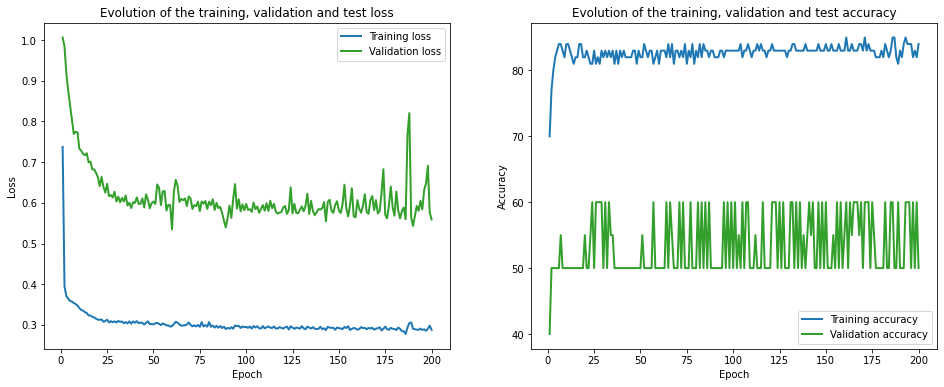

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 139.30it/s]


Initialization done!


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1370.38it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.62 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 1.19 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 1.07 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.65 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 1.38 val_acc = 50.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 

val_loss = 0.72 val_acc = 50.00%
Snapshot saved at epoch 15.
Epoch 16 of 200, 10% 	 train_loss: 0.25 train_acc: 80.00% took: 0.01s
Epoch 16 of 200, 20% 	 train_loss: 0.68 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 30% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 40% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 50% 	 train_loss: 0.75 train_acc: 60.00% took: 0.00s
Epoch 16 of 200, 60% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 70% 	 train_loss: 0.40 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 90% 	 train_loss: 0.19 train_acc: 90.00% took: 0.01s
Epoch 16 of 200, 100% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
val_loss = 0.71 val_acc = 50.00%
Snapshot saved at epoch 16.
Epoch 17 of 200, 10% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 20% 	 train_loss: 0.67 train_acc: 70.00% took: 0.00s
Epoch 17 of 200, 30% 	 train_loss: 

Epoch 27 of 200, 20% 	 train_loss: 0.61 train_acc: 70.00% took: 0.00s
Epoch 27 of 200, 30% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 40% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 50% 	 train_loss: 0.81 train_acc: 60.00% took: 0.00s
Epoch 27 of 200, 60% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 70% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 27 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 90% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 100% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
val_loss = 0.64 val_acc = 60.00%
Snapshot saved at epoch 27.
Epoch 28 of 200, 10% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 20% 	 train_loss: 0.65 train_acc: 70.00% took: 0.00s
Epoch 28 of 200, 30% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 50% 	 tr

Epoch 38 of 200, 20% 	 train_loss: 0.62 train_acc: 70.00% took: 0.00s
Epoch 38 of 200, 30% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 50% 	 train_loss: 0.74 train_acc: 60.00% took: 0.00s
Epoch 38 of 200, 60% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 70% 	 train_loss: 0.37 train_acc: 80.00% took: 0.01s
Epoch 38 of 200, 80% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 90% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 100% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
val_loss = 0.58 val_acc = 50.00%
Snapshot saved at epoch 38.
Epoch 39 of 200, 10% 	 train_loss: 0.25 train_acc: 80.00% took: 0.01s
Epoch 39 of 200, 20% 	 train_loss: 0.62 train_acc: 70.00% took: 0.00s
Epoch 39 of 200, 30% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 39 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 39 of 200, 50% 	 tra

Epoch 53 of 200, 80% 	 train_loss: 0.08 train_acc: 100.00% took: 0.02s
Epoch 53 of 200, 90% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 53 of 200, 100% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
val_loss = 0.63 val_acc = 50.00%
Snapshot saved at epoch 53.
Epoch 54 of 200, 10% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 54 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 54 of 200, 30% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 54 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 54 of 200, 50% 	 train_loss: 0.71 train_acc: 60.00% took: 0.00s
Epoch 54 of 200, 60% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 54 of 200, 70% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 54 of 200, 80% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 54 of 200, 90% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 54 of 200, 100% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
val_loss = 0.60 val_acc =

Epoch 68 of 200, 60% 	 train_loss: 0.27 train_acc: 80.00% took: 0.02s
Epoch 68 of 200, 70% 	 train_loss: 0.41 train_acc: 70.00% took: 0.01s
Epoch 68 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 68 of 200, 90% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 68 of 200, 100% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
val_loss = 0.62 val_acc = 50.00%
Snapshot saved at epoch 68.
Epoch 69 of 200, 10% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 69 of 200, 20% 	 train_loss: 0.62 train_acc: 70.00% took: 0.00s
Epoch 69 of 200, 30% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 69 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 69 of 200, 50% 	 train_loss: 0.73 train_acc: 60.00% took: 0.00s
Epoch 69 of 200, 60% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 69 of 200, 70% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 69 of 200, 80% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 69 of 200, 90% 	 t

Epoch 83 of 200, 50% 	 train_loss: 0.71 train_acc: 60.00% took: 0.02s
Epoch 83 of 200, 60% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 83 of 200, 70% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 83 of 200, 80% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 83 of 200, 90% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 83 of 200, 100% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
val_loss = 0.57 val_acc = 60.00%
Snapshot saved at epoch 83.
Epoch 84 of 200, 10% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 84 of 200, 20% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
Epoch 84 of 200, 30% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 84 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 84 of 200, 50% 	 train_loss: 0.72 train_acc: 60.00% took: 0.00s
Epoch 84 of 200, 60% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 84 of 200, 70% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 84 of 200, 80% 	 tra

val_loss = 0.57 val_acc = 60.00%
Snapshot saved at epoch 97.
Epoch 98 of 200, 10% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 98 of 200, 20% 	 train_loss: 0.58 train_acc: 80.00% took: 0.00s
Epoch 98 of 200, 30% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 98 of 200, 40% 	 train_loss: 0.00 train_acc: 100.00% took: 0.00s
Epoch 98 of 200, 50% 	 train_loss: 0.70 train_acc: 60.00% took: 0.00s
Epoch 98 of 200, 60% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 98 of 200, 70% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 98 of 200, 80% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 98 of 200, 90% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 98 of 200, 100% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
val_loss = 0.57 val_acc = 60.00%
Snapshot saved at epoch 98.
Epoch 99 of 200, 10% 	 train_loss: 0.23 train_acc: 80.00% took: 0.01s
Epoch 99 of 200, 20% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
Epoch 99 of 200, 30% 	 train_loss: 0

Epoch 113 of 200, 10% 	 train_loss: 0.23 train_acc: 80.00% took: 0.01s
Epoch 113 of 200, 20% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 113 of 200, 30% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 113 of 200, 40% 	 train_loss: 0.00 train_acc: 100.00% took: 0.00s
Epoch 113 of 200, 50% 	 train_loss: 0.71 train_acc: 60.00% took: 0.00s
Epoch 113 of 200, 60% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 113 of 200, 70% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 113 of 200, 80% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 113 of 200, 90% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 113 of 200, 100% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
val_loss = 0.55 val_acc = 55.00%
Snapshot saved at epoch 113.
Epoch 114 of 200, 10% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 114 of 200, 20% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
Epoch 114 of 200, 30% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 114 of

Epoch 127 of 200, 80% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 127 of 200, 90% 	 train_loss: 0.19 train_acc: 90.00% took: 0.01s
Epoch 127 of 200, 100% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
val_loss = 0.54 val_acc = 60.00%
Snapshot saved at epoch 127.
Epoch 128 of 200, 10% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 128 of 200, 20% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 128 of 200, 30% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 128 of 200, 40% 	 train_loss: 0.00 train_acc: 100.00% took: 0.00s
Epoch 128 of 200, 50% 	 train_loss: 0.75 train_acc: 60.00% took: 0.00s
Epoch 128 of 200, 60% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 128 of 200, 70% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 128 of 200, 80% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 128 of 200, 90% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 128 of 200, 100% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
val_loss =

Epoch 142 of 200, 10% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 142 of 200, 20% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 142 of 200, 30% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 142 of 200, 40% 	 train_loss: 0.00 train_acc: 100.00% took: 0.00s
Epoch 142 of 200, 50% 	 train_loss: 0.72 train_acc: 60.00% took: 0.00s
Epoch 142 of 200, 60% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 142 of 200, 70% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 142 of 200, 80% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 142 of 200, 90% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 142 of 200, 100% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
val_loss = 0.57 val_acc = 60.00%
Snapshot saved at epoch 142.
Epoch 143 of 200, 10% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 143 of 200, 20% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 143 of 200, 30% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 143 of

Epoch 153 of 200, 40% 	 train_loss: 0.00 train_acc: 100.00% took: 0.00s
Epoch 153 of 200, 50% 	 train_loss: 0.73 train_acc: 60.00% took: 0.00s
Epoch 153 of 200, 60% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 153 of 200, 70% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 153 of 200, 80% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 153 of 200, 90% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 153 of 200, 100% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
val_loss = 0.55 val_acc = 55.00%
Snapshot saved at epoch 153.
Epoch 154 of 200, 10% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 154 of 200, 20% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 154 of 200, 30% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 154 of 200, 40% 	 train_loss: 0.00 train_acc: 100.00% took: 0.00s
Epoch 154 of 200, 50% 	 train_loss: 0.71 train_acc: 60.00% took: 0.00s
Epoch 154 of 200, 60% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 154 o

Epoch 167 of 200, 10% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 167 of 200, 20% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 167 of 200, 30% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 167 of 200, 40% 	 train_loss: 0.00 train_acc: 100.00% took: 0.00s
Epoch 167 of 200, 50% 	 train_loss: 0.72 train_acc: 60.00% took: 0.00s
Epoch 167 of 200, 60% 	 train_loss: 0.26 train_acc: 80.00% took: 0.01s
Epoch 167 of 200, 70% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 167 of 200, 80% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 167 of 200, 90% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 167 of 200, 100% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
val_loss = 0.57 val_acc = 60.00%
Snapshot saved at epoch 167.
Epoch 168 of 200, 10% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 168 of 200, 20% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 168 of 200, 30% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 168 of

Epoch 181 of 200, 70% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 181 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 181 of 200, 90% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 181 of 200, 100% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
val_loss = 0.56 val_acc = 60.00%
Snapshot saved at epoch 181.
Epoch 182 of 200, 10% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 182 of 200, 20% 	 train_loss: 0.50 train_acc: 80.00% took: 0.02s
Epoch 182 of 200, 30% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 182 of 200, 40% 	 train_loss: 0.00 train_acc: 100.00% took: 0.00s
Epoch 182 of 200, 50% 	 train_loss: 0.74 train_acc: 60.00% took: 0.00s
Epoch 182 of 200, 60% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 182 of 200, 70% 	 train_loss: 0.40 train_acc: 80.00% took: 0.02s
Epoch 182 of 200, 80% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 182 of 200, 90% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 182 o

val_loss = 0.57 val_acc = 60.00%
Snapshot saved at epoch 195.
Epoch 196 of 200, 10% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 20% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 30% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 40% 	 train_loss: 0.00 train_acc: 100.00% took: 0.00s
Epoch 196 of 200, 50% 	 train_loss: 0.76 train_acc: 60.00% took: 0.00s
Epoch 196 of 200, 60% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 70% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 196 of 200, 80% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 196 of 200, 90% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 196 of 200, 100% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
val_loss = 0.57 val_acc = 60.00%
Snapshot saved at epoch 196.
Epoch 197 of 200, 10% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 197 of 200, 20% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 197 of 200, 30%

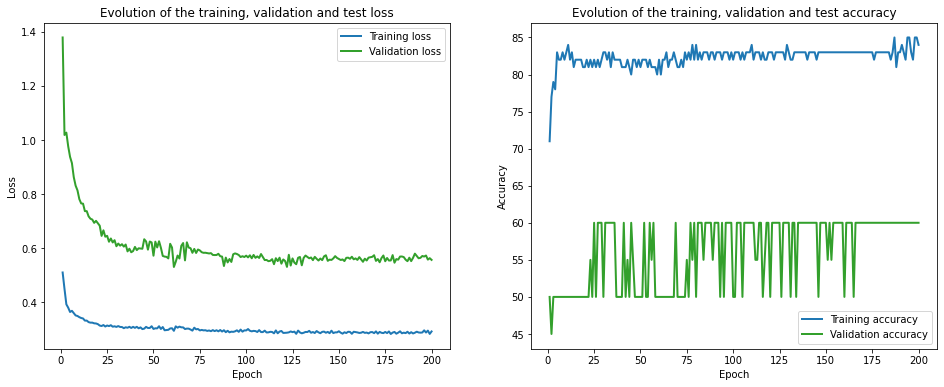

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 146.00it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 916.72it/s]

Finished computing p-values for 500 test points.

Starting repetition 12 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 0.69 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 1.88 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.55 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.60 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.89 train_acc: 30.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.89 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.62 train_acc: 50.00% took: 0.00s
val_loss = 0.25 val_acc = 100.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 1.02 train_acc: 30.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.44 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.

Epoch 15 of 200, 70% 	 train_loss: 0.39 train_acc: 80.00% took: 0.02s
Epoch 15 of 200, 80% 	 train_loss: 0.40 train_acc: 70.00% took: 0.00s
Epoch 15 of 200, 90% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 15 of 200, 100% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
val_loss = 0.20 val_acc = 90.00%
Snapshot saved at epoch 15.
Epoch 16 of 200, 10% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 20% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 30% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 40% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 50% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 60% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 70% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 80% 	 train_loss: 0.40 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 90% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 100% 	 tr

Epoch 30 of 200, 70% 	 train_loss: 0.40 train_acc: 80.00% took: 0.01s
Epoch 30 of 200, 80% 	 train_loss: 0.38 train_acc: 70.00% took: 0.00s
Epoch 30 of 200, 90% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 30 of 200, 100% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
val_loss = 0.08 val_acc = 100.00%
Snapshot saved at epoch 30.
Epoch 31 of 200, 10% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 31 of 200, 20% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 30% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 40% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 31 of 200, 50% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 60% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 31 of 200, 70% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 31 of 200, 80% 	 train_loss: 0.38 train_acc: 70.00% took: 0.00s
Epoch 31 of 200, 90% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 31 of 200, 100% 	 

Epoch 45 of 200, 70% 	 train_loss: 0.41 train_acc: 90.00% took: 0.02s
Epoch 45 of 200, 80% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 45 of 200, 90% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 45 of 200, 100% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
val_loss = 0.05 val_acc = 100.00%
Snapshot saved at epoch 45.
Epoch 46 of 200, 10% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 46 of 200, 20% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 46 of 200, 30% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 46 of 200, 40% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 46 of 200, 50% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 46 of 200, 60% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 46 of 200, 70% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 46 of 200, 80% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 46 of 200, 90% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 46 of 200, 100% 	 

Epoch 60 of 200, 100% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
val_loss = 0.05 val_acc = 100.00%
Snapshot saved at epoch 60.
Epoch 61 of 200, 10% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 61 of 200, 20% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 61 of 200, 30% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 61 of 200, 40% 	 train_loss: 0.10 train_acc: 90.00% took: 0.02s
Epoch 61 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 61 of 200, 60% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 61 of 200, 70% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 61 of 200, 80% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 61 of 200, 90% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 61 of 200, 100% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
val_loss = 0.06 val_acc = 100.00%
Snapshot saved at epoch 61.
Epoch 62 of 200, 10% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 62 of 200, 20% 	 train_lo

Epoch 77 of 200, 30% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 77 of 200, 40% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 77 of 200, 50% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 77 of 200, 60% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 77 of 200, 70% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 77 of 200, 80% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 77 of 200, 90% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 77 of 200, 100% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
val_loss = 0.05 val_acc = 100.00%
Snapshot saved at epoch 77.
Epoch 78 of 200, 10% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 78 of 200, 20% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 78 of 200, 30% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 78 of 200, 40% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 78 of 200, 50% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 78 of 200, 60% 	 trai

Epoch 88 of 200, 10% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 88 of 200, 20% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 88 of 200, 30% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 88 of 200, 40% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 88 of 200, 50% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 88 of 200, 60% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 88 of 200, 70% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
Epoch 88 of 200, 80% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 88 of 200, 90% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 88 of 200, 100% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
val_loss = 0.05 val_acc = 100.00%
Snapshot saved at epoch 88.
Epoch 89 of 200, 10% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 89 of 200, 20% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 30% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 40% 	 tr

Epoch 99 of 200, 90% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 99 of 200, 100% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
val_loss = 0.05 val_acc = 100.00%
Snapshot saved at epoch 99.
Epoch 100 of 200, 10% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 20% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 30% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 40% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 50% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 100 of 200, 60% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 70% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 80% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 90% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 100% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
val_loss = 0.05 val_acc = 100.00%
Snapshot saved at epoch 100.
Epoch 101 of 200, 10% 

Epoch 111 of 200, 30% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 40% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 50% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 60% 	 train_loss: 0.07 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 70% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 80% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 90% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 111 of 200, 100% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
val_loss = 0.05 val_acc = 100.00%
Snapshot saved at epoch 111.
Epoch 112 of 200, 10% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 112 of 200, 20% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 112 of 200, 30% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 112 of 200, 40% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 112 of 200, 50% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 112 o

Epoch 125 of 200, 70% 	 train_loss: 0.40 train_acc: 90.00% took: 0.02s
Epoch 125 of 200, 80% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 125 of 200, 90% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 125 of 200, 100% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
val_loss = 0.04 val_acc = 100.00%
Snapshot saved at epoch 125.
Epoch 126 of 200, 10% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 126 of 200, 20% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 126 of 200, 30% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 126 of 200, 40% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 126 of 200, 50% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 126 of 200, 60% 	 train_loss: 0.07 train_acc: 90.00% took: 0.00s
Epoch 126 of 200, 70% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 126 of 200, 80% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 126 of 200, 90% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 126 of

Epoch 140 of 200, 70% 	 train_loss: 0.40 train_acc: 90.00% took: 0.02s
Epoch 140 of 200, 80% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 140 of 200, 90% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 140 of 200, 100% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
val_loss = 0.05 val_acc = 100.00%
Snapshot saved at epoch 140.
Epoch 141 of 200, 10% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 141 of 200, 20% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 141 of 200, 30% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 141 of 200, 40% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 141 of 200, 50% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 141 of 200, 60% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 141 of 200, 70% 	 train_loss: 0.39 train_acc: 90.00% took: 0.01s
Epoch 141 of 200, 80% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 141 of 200, 90% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 141 

Epoch 155 of 200, 10% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 155 of 200, 20% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 155 of 200, 30% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 155 of 200, 40% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 155 of 200, 50% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 155 of 200, 60% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 155 of 200, 70% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 155 of 200, 80% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 155 of 200, 90% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 155 of 200, 100% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
val_loss = 0.05 val_acc = 100.00%
Snapshot saved at epoch 155.
Epoch 156 of 200, 10% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 156 of 200, 20% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 156 of 200, 30% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 156 

val_loss = 0.05 val_acc = 100.00%
Snapshot saved at epoch 165.
Epoch 166 of 200, 10% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 166 of 200, 20% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 30% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 40% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 50% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 166 of 200, 60% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 166 of 200, 70% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 80% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 90% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 166 of 200, 100% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
val_loss = 0.06 val_acc = 100.00%
Snapshot saved at epoch 166.
Epoch 167 of 200, 10% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 167 of 200, 20% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 167 of 200, 3

Epoch 176 of 200, 90% 	 train_loss: 0.29 train_acc: 80.00% took: 0.02s
Epoch 176 of 200, 100% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
val_loss = 0.05 val_acc = 100.00%
Snapshot saved at epoch 176.
Epoch 177 of 200, 10% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 177 of 200, 20% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 177 of 200, 30% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 177 of 200, 40% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 177 of 200, 50% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 177 of 200, 60% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 177 of 200, 70% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 177 of 200, 80% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 177 of 200, 90% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 177 of 200, 100% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
val_loss = 0.06 val_acc = 100.00%
Snapshot saved at epoch 177.
Epoch 178 of 200, 

Epoch 192 of 200, 10% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 192 of 200, 20% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 192 of 200, 30% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 192 of 200, 40% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 192 of 200, 50% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 192 of 200, 60% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 192 of 200, 70% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 192 of 200, 80% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 192 of 200, 90% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 192 of 200, 100% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
val_loss = 0.05 val_acc = 100.00%
Snapshot saved at epoch 192.
Epoch 193 of 200, 10% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 193 of 200, 20% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 193 of 200, 30% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 193 o

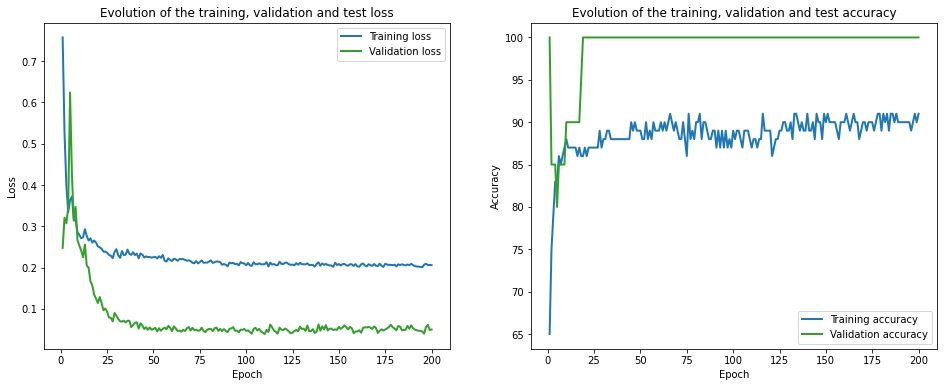

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 149.59it/s]


Initialization done!


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1112.34it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.78 train_acc: 20.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 2.33 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.99 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 5.14 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 1.33 train_acc: 30.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.78 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.85 train_acc: 30.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
val_loss = 0.22 val_acc = 95.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.93 train_acc: 60.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.2

Epoch 11 of 200, 90% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 11 of 200, 100% 	 train_loss: 0.30 train_acc: 100.00% took: 0.00s
val_loss = 0.16 val_acc = 90.00%
Snapshot saved at epoch 11.
Epoch 12 of 200, 10% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 20% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 30% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 40% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 50% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 60% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 70% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 80% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 12 of 200, 90% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 100% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
val_loss = 0.19 val_acc = 90.00%
Snapshot saved at epoch 12.
Epoch 13 of 200, 10% 	 train_los

Epoch 22 of 200, 70% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 22 of 200, 80% 	 train_loss: 0.40 train_acc: 60.00% took: 0.01s
Epoch 22 of 200, 90% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 22 of 200, 100% 	 train_loss: 0.25 train_acc: 100.00% took: 0.00s
val_loss = 0.09 val_acc = 100.00%
Snapshot saved at epoch 22.
Epoch 23 of 200, 10% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 23 of 200, 20% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 23 of 200, 30% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 23 of 200, 40% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 23 of 200, 50% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 23 of 200, 60% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 23 of 200, 70% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 23 of 200, 80% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 23 of 200, 90% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 23 of 200, 100% 	 

Epoch 33 of 200, 80% 	 train_loss: 0.38 train_acc: 70.00% took: 0.00s
Epoch 33 of 200, 90% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 33 of 200, 100% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
val_loss = 0.06 val_acc = 100.00%
Snapshot saved at epoch 33.
Epoch 34 of 200, 10% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 34 of 200, 20% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 34 of 200, 30% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 34 of 200, 40% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 34 of 200, 50% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 34 of 200, 60% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 34 of 200, 70% 	 train_loss: 0.50 train_acc: 90.00% took: 0.00s
Epoch 34 of 200, 80% 	 train_loss: 0.38 train_acc: 70.00% took: 0.00s
Epoch 34 of 200, 90% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 34 of 200, 100% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
val_loss = 0.07 val_acc 

Epoch 45 of 200, 10% 	 train_loss: 0.34 train_acc: 80.00% took: 0.01s
Epoch 45 of 200, 20% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 45 of 200, 30% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 45 of 200, 40% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 45 of 200, 50% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 45 of 200, 60% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 45 of 200, 70% 	 train_loss: 0.44 train_acc: 90.00% took: 0.00s
Epoch 45 of 200, 80% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 45 of 200, 90% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 45 of 200, 100% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
val_loss = 0.05 val_acc = 100.00%
Snapshot saved at epoch 45.
Epoch 46 of 200, 10% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 46 of 200, 20% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 46 of 200, 30% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 46 of 200, 40% 	 tr

Epoch 56 of 200, 20% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 56 of 200, 30% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 56 of 200, 40% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 56 of 200, 50% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 56 of 200, 60% 	 train_loss: 0.07 train_acc: 90.00% took: 0.00s
Epoch 56 of 200, 70% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 56 of 200, 80% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 56 of 200, 90% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 56 of 200, 100% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
val_loss = 0.06 val_acc = 100.00%
Snapshot saved at epoch 56.
Epoch 57 of 200, 10% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 57 of 200, 20% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 30% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 40% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 50% 	 tra

Epoch 72 of 200, 30% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 72 of 200, 40% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 72 of 200, 50% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 72 of 200, 60% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 72 of 200, 70% 	 train_loss: 0.45 train_acc: 90.00% took: 0.00s
Epoch 72 of 200, 80% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 72 of 200, 90% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 72 of 200, 100% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
val_loss = 0.06 val_acc = 100.00%
Snapshot saved at epoch 72.
Epoch 73 of 200, 10% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 73 of 200, 20% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 73 of 200, 30% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 73 of 200, 40% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 73 of 200, 50% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 73 of 200, 60% 	 tr

Epoch 83 of 200, 30% 	 train_loss: 0.11 train_acc: 90.00% took: 0.02s
Epoch 83 of 200, 40% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 83 of 200, 50% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 83 of 200, 60% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 83 of 200, 70% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 83 of 200, 80% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 83 of 200, 90% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 83 of 200, 100% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
val_loss = 0.05 val_acc = 100.00%
Snapshot saved at epoch 83.
Epoch 84 of 200, 10% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 84 of 200, 20% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 84 of 200, 30% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 84 of 200, 40% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 84 of 200, 50% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 84 of 200, 60% 	 tr

Epoch 94 of 200, 10% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 94 of 200, 20% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 94 of 200, 30% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 94 of 200, 40% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 94 of 200, 50% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 94 of 200, 60% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 94 of 200, 70% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 94 of 200, 80% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 94 of 200, 90% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 94 of 200, 100% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
val_loss = 0.06 val_acc = 100.00%
Snapshot saved at epoch 94.
Epoch 95 of 200, 10% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 95 of 200, 20% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 95 of 200, 30% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 95 of 200, 40% 	 tra

Epoch 108 of 200, 90% 	 train_loss: 0.25 train_acc: 80.00% took: 0.02s
Epoch 108 of 200, 100% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
val_loss = 0.06 val_acc = 100.00%
Snapshot saved at epoch 108.
Epoch 109 of 200, 10% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 109 of 200, 20% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 109 of 200, 30% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 109 of 200, 40% 	 train_loss: 0.14 train_acc: 90.00% took: 0.01s
Epoch 109 of 200, 50% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 109 of 200, 60% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 109 of 200, 70% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 109 of 200, 80% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 109 of 200, 90% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 109 of 200, 100% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
val_loss = 0.06 val_acc = 100.00%
Snapshot saved at epoch 109.
Epoch 110 of 200, 1

val_loss = 0.07 val_acc = 100.00%
Snapshot saved at epoch 123.
Epoch 124 of 200, 10% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 124 of 200, 20% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 124 of 200, 30% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 124 of 200, 40% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 124 of 200, 50% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 124 of 200, 60% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 124 of 200, 70% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 124 of 200, 80% 	 train_loss: 0.37 train_acc: 70.00% took: 0.00s
Epoch 124 of 200, 90% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 124 of 200, 100% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
val_loss = 0.05 val_acc = 100.00%
Snapshot saved at epoch 124.
Epoch 125 of 200, 10% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 125 of 200, 20% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 125 of 200, 30

Epoch 134 of 200, 80% 	 train_loss: 0.37 train_acc: 70.00% took: 0.01s
Epoch 134 of 200, 90% 	 train_loss: 0.15 train_acc: 80.00% took: 0.00s
Epoch 134 of 200, 100% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
val_loss = 0.07 val_acc = 100.00%
Snapshot saved at epoch 134.
Epoch 135 of 200, 10% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 135 of 200, 20% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 135 of 200, 30% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 135 of 200, 40% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 135 of 200, 50% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 135 of 200, 60% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 135 of 200, 70% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 135 of 200, 80% 	 train_loss: 0.36 train_acc: 70.00% took: 0.00s
Epoch 135 of 200, 90% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 135 of 200, 100% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
val_loss = 

Epoch 150 of 200, 40% 	 train_loss: 0.13 train_acc: 90.00% took: 0.02s
Epoch 150 of 200, 50% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 60% 	 train_loss: 0.07 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 70% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 150 of 200, 80% 	 train_loss: 0.34 train_acc: 70.00% took: 0.00s
Epoch 150 of 200, 90% 	 train_loss: 0.19 train_acc: 80.00% took: 0.00s
Epoch 150 of 200, 100% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
val_loss = 0.06 val_acc = 100.00%
Snapshot saved at epoch 150.
Epoch 151 of 200, 10% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 151 of 200, 20% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 151 of 200, 30% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 151 of 200, 40% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 151 of 200, 50% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 151 of 200, 60% 	 train_loss: 0.07 train_acc: 90.00% took: 0.00s
Epoch 151 of

Epoch 166 of 200, 30% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 40% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 50% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 60% 	 train_loss: 0.07 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 70% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 166 of 200, 80% 	 train_loss: 0.36 train_acc: 70.00% took: 0.00s
Epoch 166 of 200, 90% 	 train_loss: 0.18 train_acc: 80.00% took: 0.00s
Epoch 166 of 200, 100% 	 train_loss: 0.19 train_acc: 80.00% took: 0.00s
val_loss = 0.06 val_acc = 100.00%
Snapshot saved at epoch 166.
Epoch 167 of 200, 10% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 167 of 200, 20% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 167 of 200, 30% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 167 of 200, 40% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 167 of 200, 50% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 167 of 

Epoch 177 of 200, 70% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 177 of 200, 80% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 177 of 200, 90% 	 train_loss: 0.17 train_acc: 80.00% took: 0.00s
Epoch 177 of 200, 100% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
val_loss = 0.06 val_acc = 100.00%
Snapshot saved at epoch 177.
Epoch 178 of 200, 10% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 178 of 200, 20% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 30% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 40% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 50% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 60% 	 train_loss: 0.07 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 70% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 178 of 200, 80% 	 train_loss: 0.35 train_acc: 70.00% took: 0.00s
Epoch 178 of 200, 90% 	 train_loss: 0.18 train_acc: 80.00% took: 0.00s
Epoch 178 of 

Epoch 189 of 200, 10% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 189 of 200, 20% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 189 of 200, 30% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 189 of 200, 40% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 189 of 200, 50% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 189 of 200, 60% 	 train_loss: 0.07 train_acc: 90.00% took: 0.00s
Epoch 189 of 200, 70% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 189 of 200, 80% 	 train_loss: 0.33 train_acc: 70.00% took: 0.00s
Epoch 189 of 200, 90% 	 train_loss: 0.18 train_acc: 80.00% took: 0.00s
Epoch 189 of 200, 100% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
val_loss = 0.06 val_acc = 100.00%
Snapshot saved at epoch 189.
Epoch 190 of 200, 10% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 190 of 200, 20% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 190 of 200, 30% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 190 of 

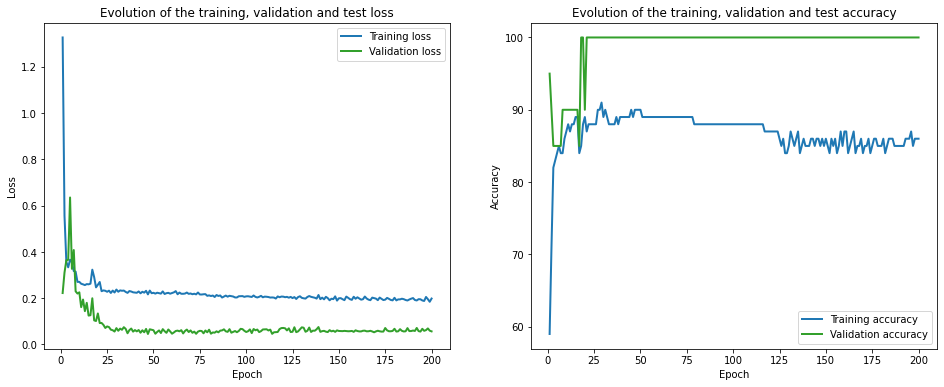

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 146.58it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1295.17it/s]

Finished computing p-values for 500 test points.

Starting repetition 13 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.72 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.75 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.50 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.57 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 1.52 train_acc: 60.00% took: 0.00s
val_loss = 1.23 val_acc = 50.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.69 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0

val_loss = 0.41 val_acc = 85.00%
Snapshot saved at epoch 15.
Epoch 16 of 200, 10% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 20% 	 train_loss: 0.52 train_acc: 80.00% took: 0.01s
Epoch 16 of 200, 30% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 40% 	 train_loss: 0.37 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 50% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 60% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 70% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 80% 	 train_loss: 0.65 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 90% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 100% 	 train_loss: 0.61 train_acc: 60.00% took: 0.00s
val_loss = 0.48 val_acc = 85.00%
Snapshot saved at epoch 16.
Epoch 17 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 20% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 30% 	 train_loss

Epoch 31 of 200, 20% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 31 of 200, 30% 	 train_loss: 0.47 train_acc: 80.00% took: 0.01s
Epoch 31 of 200, 40% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 31 of 200, 50% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 31 of 200, 60% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 31 of 200, 70% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 31 of 200, 80% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 31 of 200, 90% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 100% 	 train_loss: 0.65 train_acc: 60.00% took: 0.00s
val_loss = 0.45 val_acc = 85.00%
Snapshot saved at epoch 31.
Epoch 32 of 200, 10% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 32 of 200, 20% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 32 of 200, 30% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 32 of 200, 40% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 32 of 200, 50% 	 tr

val_loss = 0.35 val_acc = 90.00%
Snapshot saved at epoch 46.
Epoch 47 of 200, 10% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 47 of 200, 20% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 47 of 200, 30% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 47 of 200, 40% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 47 of 200, 50% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 47 of 200, 60% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 47 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 47 of 200, 80% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
Epoch 47 of 200, 90% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 47 of 200, 100% 	 train_loss: 0.64 train_acc: 70.00% took: 0.00s
val_loss = 0.43 val_acc = 90.00%
Snapshot saved at epoch 47.
Epoch 48 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 48 of 200, 20% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 48 of 200, 30% 	 train_loss:

Epoch 62 of 200, 10% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 62 of 200, 20% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 62 of 200, 30% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 62 of 200, 40% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 62 of 200, 50% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 62 of 200, 60% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 62 of 200, 70% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 62 of 200, 80% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 62 of 200, 90% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 62 of 200, 100% 	 train_loss: 0.66 train_acc: 70.00% took: 0.00s
val_loss = 0.46 val_acc = 90.00%
Snapshot saved at epoch 62.
Epoch 63 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 63 of 200, 20% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 63 of 200, 30% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 63 of 200, 40% 	 tr

Epoch 78 of 200, 20% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 78 of 200, 30% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 78 of 200, 40% 	 train_loss: 0.42 train_acc: 60.00% took: 0.00s
Epoch 78 of 200, 50% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 78 of 200, 60% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 78 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 78 of 200, 80% 	 train_loss: 0.51 train_acc: 90.00% took: 0.00s
Epoch 78 of 200, 90% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 78 of 200, 100% 	 train_loss: 0.65 train_acc: 70.00% took: 0.00s
val_loss = 0.30 val_acc = 90.00%
Snapshot saved at epoch 78.
Epoch 79 of 200, 10% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 79 of 200, 20% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 79 of 200, 30% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 79 of 200, 40% 	 train_loss: 0.44 train_acc: 60.00% took: 0.00s
Epoch 79 of 200, 50% 	 trai

Epoch 93 of 200, 90% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 93 of 200, 100% 	 train_loss: 0.65 train_acc: 70.00% took: 0.00s
val_loss = 0.38 val_acc = 90.00%
Snapshot saved at epoch 93.
Epoch 94 of 200, 10% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 94 of 200, 20% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 94 of 200, 30% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 94 of 200, 40% 	 train_loss: 0.43 train_acc: 60.00% took: 0.00s
Epoch 94 of 200, 50% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 94 of 200, 60% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 94 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 94 of 200, 80% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 94 of 200, 90% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 94 of 200, 100% 	 train_loss: 0.65 train_acc: 70.00% took: 0.00s
val_loss = 0.38 val_acc = 90.00%
Snapshot saved at epoch 94.
Epoch 95 of 200, 10% 	 train_loss:

Epoch 109 of 200, 10% 	 train_loss: 0.15 train_acc: 100.00% took: 0.02s
Epoch 109 of 200, 20% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 109 of 200, 30% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 109 of 200, 40% 	 train_loss: 0.45 train_acc: 60.00% took: 0.00s
Epoch 109 of 200, 50% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 109 of 200, 60% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 109 of 200, 70% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 109 of 200, 80% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
Epoch 109 of 200, 90% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 109 of 200, 100% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
val_loss = 0.38 val_acc = 90.00%
Snapshot saved at epoch 109.
Epoch 110 of 200, 10% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 110 of 200, 20% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 110 of 200, 30% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 110 

Epoch 124 of 200, 50% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 124 of 200, 60% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 124 of 200, 70% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 124 of 200, 80% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 124 of 200, 90% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 124 of 200, 100% 	 train_loss: 0.69 train_acc: 60.00% took: 0.00s
val_loss = 0.65 val_acc = 85.00%
Snapshot saved at epoch 124.
Epoch 125 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 125 of 200, 20% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 125 of 200, 30% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 125 of 200, 40% 	 train_loss: 0.44 train_acc: 60.00% took: 0.00s
Epoch 125 of 200, 50% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 125 of 200, 60% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 125 of 200, 70% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 125

Epoch 140 of 200, 60% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 140 of 200, 70% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 140 of 200, 80% 	 train_loss: 0.52 train_acc: 70.00% took: 0.00s
Epoch 140 of 200, 90% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 140 of 200, 100% 	 train_loss: 0.65 train_acc: 60.00% took: 0.00s
val_loss = 0.64 val_acc = 85.00%
Snapshot saved at epoch 140.
Epoch 141 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 141 of 200, 20% 	 train_loss: 0.36 train_acc: 70.00% took: 0.00s
Epoch 141 of 200, 30% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 141 of 200, 40% 	 train_loss: 0.44 train_acc: 60.00% took: 0.00s
Epoch 141 of 200, 50% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 141 of 200, 60% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 141 of 200, 70% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 141 of 200, 80% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 141

Epoch 151 of 200, 50% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 151 of 200, 60% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 151 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 151 of 200, 80% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 151 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 151 of 200, 100% 	 train_loss: 0.70 train_acc: 60.00% took: 0.00s
val_loss = 0.60 val_acc = 85.00%
Snapshot saved at epoch 151.
Epoch 152 of 200, 10% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 152 of 200, 20% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 152 of 200, 30% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 152 of 200, 40% 	 train_loss: 0.50 train_acc: 50.00% took: 0.00s
Epoch 152 of 200, 50% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 152 of 200, 60% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 152 of 200, 70% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 152 o

Epoch 162 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 162 of 200, 100% 	 train_loss: 0.65 train_acc: 60.00% took: 0.00s
val_loss = 0.74 val_acc = 85.00%
Snapshot saved at epoch 162.
Epoch 163 of 200, 10% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 163 of 200, 20% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 163 of 200, 30% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 163 of 200, 40% 	 train_loss: 0.43 train_acc: 60.00% took: 0.00s
Epoch 163 of 200, 50% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 163 of 200, 60% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 163 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 163 of 200, 80% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 163 of 200, 90% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 163 of 200, 100% 	 train_loss: 0.62 train_acc: 60.00% took: 0.00s
val_loss = 0.61 val_acc = 80.00%
Snapshot saved at epoch 163.
Epoch 164 of 200, 10

Epoch 174 of 200, 20% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 174 of 200, 30% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 174 of 200, 40% 	 train_loss: 0.51 train_acc: 60.00% took: 0.00s
Epoch 174 of 200, 50% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 174 of 200, 60% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 70% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 80% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 174 of 200, 90% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 100% 	 train_loss: 0.62 train_acc: 60.00% took: 0.00s
val_loss = 0.82 val_acc = 85.00%
Snapshot saved at epoch 174.
Epoch 175 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 175 of 200, 20% 	 train_loss: 0.37 train_acc: 70.00% took: 0.00s
Epoch 175 of 200, 30% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 175 of 200, 40% 	 train_loss: 0.48 train_acc: 60.00% took: 0.00s
Epoch 175 of 2

Epoch 184 of 200, 90% 	 train_loss: 0.34 train_acc: 90.00% took: 0.02s
Epoch 184 of 200, 100% 	 train_loss: 0.70 train_acc: 60.00% took: 0.00s
val_loss = 0.85 val_acc = 85.00%
Snapshot saved at epoch 184.
Epoch 185 of 200, 10% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 185 of 200, 20% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 185 of 200, 30% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 185 of 200, 40% 	 train_loss: 0.42 train_acc: 60.00% took: 0.00s
Epoch 185 of 200, 50% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 185 of 200, 60% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 185 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 185 of 200, 80% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 185 of 200, 90% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 185 of 200, 100% 	 train_loss: 0.64 train_acc: 70.00% took: 0.00s
val_loss = 0.53 val_acc = 80.00%
Snapshot saved at epoch 185.
Epoch 186 of 200, 10

Epoch 198 of 200, 100% 	 train_loss: 0.60 train_acc: 70.00% took: 0.00s
val_loss = 0.72 val_acc = 80.00%
Snapshot saved at epoch 198.
Epoch 199 of 200, 10% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 199 of 200, 20% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 199 of 200, 30% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 199 of 200, 40% 	 train_loss: 0.46 train_acc: 60.00% took: 0.00s
Epoch 199 of 200, 50% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 199 of 200, 60% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 199 of 200, 70% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 199 of 200, 80% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 199 of 200, 90% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 199 of 200, 100% 	 train_loss: 0.72 train_acc: 60.00% took: 0.00s
val_loss = 1.28 val_acc = 75.00%
Snapshot saved at epoch 199.
Epoch 200 of 200, 10% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 200 of 200, 20

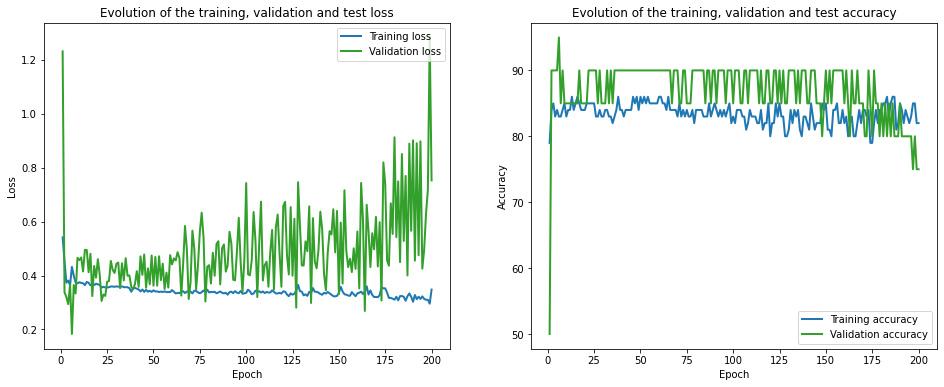

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 120.93it/s]


Initialization done!


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1191.25it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.59 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 0.61 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.89 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.63 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.52 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.64 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 1.43 train_acc: 60.00% took: 0.00s
val_loss = 0.61 val_acc = 65.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.

Epoch 15 of 200, 40% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 15 of 200, 50% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 15 of 200, 60% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 15 of 200, 70% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 15 of 200, 80% 	 train_loss: 0.63 train_acc: 80.00% took: 0.00s
Epoch 15 of 200, 90% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 15 of 200, 100% 	 train_loss: 0.62 train_acc: 60.00% took: 0.00s
val_loss = 0.52 val_acc = 85.00%
Snapshot saved at epoch 15.
Epoch 16 of 200, 10% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 20% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 30% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 40% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 50% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 60% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 70% 	 t

Epoch 29 of 200, 60% 	 train_loss: 0.15 train_acc: 100.00% took: 0.02s
Epoch 29 of 200, 70% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 29 of 200, 80% 	 train_loss: 0.64 train_acc: 80.00% took: 0.00s
Epoch 29 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 29 of 200, 100% 	 train_loss: 0.75 train_acc: 70.00% took: 0.00s
val_loss = 0.91 val_acc = 85.00%
Snapshot saved at epoch 29.
Epoch 30 of 200, 10% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 30 of 200, 20% 	 train_loss: 0.61 train_acc: 70.00% took: 0.00s
Epoch 30 of 200, 30% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 30 of 200, 40% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 30 of 200, 50% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 30 of 200, 60% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 30 of 200, 70% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 30 of 200, 80% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 30 of 200, 90% 	 t

Epoch 44 of 200, 100% 	 train_loss: 0.58 train_acc: 60.00% took: 0.00s
val_loss = 0.55 val_acc = 85.00%
Snapshot saved at epoch 44.
Epoch 45 of 200, 10% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 45 of 200, 20% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 45 of 200, 30% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 45 of 200, 40% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 45 of 200, 50% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 45 of 200, 60% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 45 of 200, 70% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 45 of 200, 80% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 45 of 200, 90% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 45 of 200, 100% 	 train_loss: 0.76 train_acc: 70.00% took: 0.00s
val_loss = 0.99 val_acc = 85.00%
Snapshot saved at epoch 45.
Epoch 46 of 200, 10% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 46 of 200, 20% 	 train_loss

Epoch 59 of 200, 70% 	 train_loss: 0.18 train_acc: 100.00% took: 0.02s
Epoch 59 of 200, 80% 	 train_loss: 0.57 train_acc: 80.00% took: 0.01s
Epoch 59 of 200, 90% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 59 of 200, 100% 	 train_loss: 0.65 train_acc: 60.00% took: 0.00s
val_loss = 0.91 val_acc = 85.00%
Snapshot saved at epoch 59.
Epoch 60 of 200, 10% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 60 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 60 of 200, 30% 	 train_loss: 0.64 train_acc: 80.00% took: 0.00s
Epoch 60 of 200, 40% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 60 of 200, 50% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 60 of 200, 60% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 60 of 200, 70% 	 train_loss: 0.18 train_acc: 100.00% took: 0.01s
Epoch 60 of 200, 80% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
Epoch 60 of 200, 90% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 60 of 200, 100% 	 t

Epoch 74 of 200, 100% 	 train_loss: 0.65 train_acc: 60.00% took: 0.00s
val_loss = 0.85 val_acc = 85.00%
Snapshot saved at epoch 74.
Epoch 75 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 75 of 200, 20% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 75 of 200, 30% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 75 of 200, 40% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 75 of 200, 50% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 75 of 200, 60% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 75 of 200, 70% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 75 of 200, 80% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 75 of 200, 90% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 75 of 200, 100% 	 train_loss: 0.67 train_acc: 60.00% took: 0.00s
val_loss = 0.83 val_acc = 85.00%
Snapshot saved at epoch 75.
Epoch 76 of 200, 10% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 76 of 200, 20% 	 train_loss:

Epoch 89 of 200, 30% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
Epoch 89 of 200, 40% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 89 of 200, 50% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 60% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 70% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 89 of 200, 80% 	 train_loss: 0.67 train_acc: 80.00% took: 0.00s
Epoch 89 of 200, 90% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 100% 	 train_loss: 0.60 train_acc: 70.00% took: 0.00s
val_loss = 0.31 val_acc = 90.00%
Snapshot saved at epoch 89.
Epoch 90 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 90 of 200, 20% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 90 of 200, 30% 	 train_loss: 0.68 train_acc: 80.00% took: 0.00s
Epoch 90 of 200, 40% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 90 of 200, 50% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 90 of 200, 60% 	 trai

Epoch 104 of 200, 60% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 104 of 200, 70% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 104 of 200, 80% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 104 of 200, 90% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 104 of 200, 100% 	 train_loss: 0.62 train_acc: 60.00% took: 0.00s
val_loss = 0.38 val_acc = 90.00%
Snapshot saved at epoch 104.
Epoch 105 of 200, 10% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 105 of 200, 20% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 105 of 200, 30% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
Epoch 105 of 200, 40% 	 train_loss: 0.44 train_acc: 60.00% took: 0.00s
Epoch 105 of 200, 50% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 105 of 200, 60% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 105 of 200, 70% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 105 of 200, 80% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 105 

Epoch 118 of 200, 70% 	 train_loss: 0.18 train_acc: 100.00% took: 0.02s
Epoch 118 of 200, 80% 	 train_loss: 0.57 train_acc: 80.00% took: 0.01s
Epoch 118 of 200, 90% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 118 of 200, 100% 	 train_loss: 0.70 train_acc: 60.00% took: 0.00s
val_loss = 0.50 val_acc = 80.00%
Snapshot saved at epoch 118.
Epoch 119 of 200, 10% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 119 of 200, 20% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 119 of 200, 30% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 119 of 200, 40% 	 train_loss: 0.43 train_acc: 60.00% took: 0.00s
Epoch 119 of 200, 50% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 119 of 200, 60% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 119 of 200, 70% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 119 of 200, 80% 	 train_loss: 0.58 train_acc: 80.00% took: 0.00s
Epoch 119 of 200, 90% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 119 

Epoch 133 of 200, 40% 	 train_loss: 0.46 train_acc: 60.00% took: 0.00s
Epoch 133 of 200, 50% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 133 of 200, 60% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 133 of 200, 70% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 133 of 200, 80% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 133 of 200, 90% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 133 of 200, 100% 	 train_loss: 0.61 train_acc: 60.00% took: 0.00s
val_loss = 0.53 val_acc = 85.00%
Snapshot saved at epoch 133.
Epoch 134 of 200, 10% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 134 of 200, 20% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 134 of 200, 30% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 134 of 200, 40% 	 train_loss: 0.43 train_acc: 60.00% took: 0.00s
Epoch 134 of 200, 50% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 134 of 200, 60% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 134 o

Epoch 148 of 200, 30% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
Epoch 148 of 200, 40% 	 train_loss: 0.47 train_acc: 60.00% took: 0.01s
Epoch 148 of 200, 50% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 148 of 200, 60% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 148 of 200, 70% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 148 of 200, 80% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 148 of 200, 90% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 148 of 200, 100% 	 train_loss: 0.62 train_acc: 60.00% took: 0.00s
val_loss = 0.57 val_acc = 85.00%
Snapshot saved at epoch 148.
Epoch 149 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 149 of 200, 20% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 149 of 200, 30% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 149 of 200, 40% 	 train_loss: 0.44 train_acc: 60.00% took: 0.00s
Epoch 149 of 200, 50% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 149 of

Epoch 163 of 200, 20% 	 train_loss: 0.33 train_acc: 70.00% took: 0.00s
Epoch 163 of 200, 30% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 163 of 200, 40% 	 train_loss: 0.46 train_acc: 60.00% took: 0.00s
Epoch 163 of 200, 50% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 163 of 200, 60% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 163 of 200, 70% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 163 of 200, 80% 	 train_loss: 0.59 train_acc: 80.00% took: 0.01s
Epoch 163 of 200, 90% 	 train_loss: 0.44 train_acc: 90.00% took: 0.00s
Epoch 163 of 200, 100% 	 train_loss: 0.65 train_acc: 60.00% took: 0.00s
val_loss = 0.77 val_acc = 80.00%
Snapshot saved at epoch 163.
Epoch 164 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.01s
Epoch 164 of 200, 20% 	 train_loss: 0.35 train_acc: 70.00% took: 0.00s
Epoch 164 of 200, 30% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 164 of 200, 40% 	 train_loss: 0.46 train_acc: 60.00% took: 0.00s
Epoch 164 o

Epoch 177 of 200, 100% 	 train_loss: 0.61 train_acc: 60.00% took: 0.00s
val_loss = 0.53 val_acc = 85.00%
Snapshot saved at epoch 177.
Epoch 178 of 200, 10% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 178 of 200, 20% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 178 of 200, 30% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 178 of 200, 40% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 178 of 200, 50% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 60% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 178 of 200, 70% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 178 of 200, 80% 	 train_loss: 0.65 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 90% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 100% 	 train_loss: 0.62 train_acc: 70.00% took: 0.00s
val_loss = 0.34 val_acc = 90.00%
Snapshot saved at epoch 178.
Epoch 179 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 179 of 200, 2

Epoch 192 of 200, 100% 	 train_loss: 0.67 train_acc: 60.00% took: 0.00s
val_loss = 0.40 val_acc = 90.00%
Snapshot saved at epoch 192.
Epoch 193 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 193 of 200, 20% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 193 of 200, 30% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 193 of 200, 40% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 193 of 200, 50% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 193 of 200, 60% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 193 of 200, 70% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 193 of 200, 80% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
Epoch 193 of 200, 90% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 193 of 200, 100% 	 train_loss: 0.62 train_acc: 60.00% took: 0.00s
val_loss = 0.58 val_acc = 85.00%
Snapshot saved at epoch 193.
Epoch 194 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 194 of 200, 20

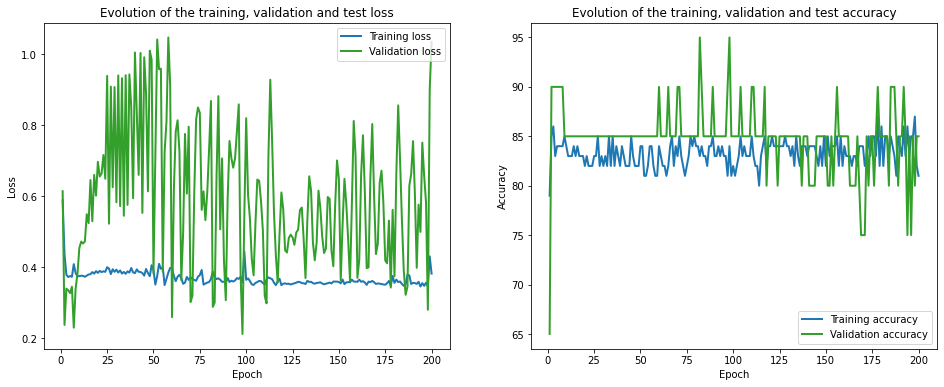

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 127.91it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1075.66it/s]

Finished computing p-values for 500 test points.

Starting repetition 14 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 1.16 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 5.54 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.70 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.67 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.51 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.77 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.72 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 1.16 train_acc: 30.00% took: 0.00s
val_loss = 0.72 val_acc = 55.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.75 train_acc: 70.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0

Epoch 15 of 200, 50% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 60% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 70% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 15 of 200, 80% 	 train_loss: 0.66 train_acc: 70.00% took: 0.00s
Epoch 15 of 200, 90% 	 train_loss: 0.57 train_acc: 60.00% took: 0.00s
Epoch 15 of 200, 100% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
val_loss = 0.58 val_acc = 60.00%
Snapshot saved at epoch 15.
Epoch 16 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 20% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 30% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 40% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 50% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 60% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 70% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 80% 	 tra

Epoch 28 of 200, 100% 	 train_loss: 0.48 train_acc: 80.00% took: 0.02s
val_loss = 0.47 val_acc = 65.00%
Snapshot saved at epoch 28.
Epoch 29 of 200, 10% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 29 of 200, 20% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 29 of 200, 30% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 29 of 200, 40% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 29 of 200, 50% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 29 of 200, 60% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 29 of 200, 70% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 29 of 200, 80% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 29 of 200, 90% 	 train_loss: 0.61 train_acc: 60.00% took: 0.00s
Epoch 29 of 200, 100% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
val_loss = 0.46 val_acc = 65.00%
Snapshot saved at epoch 29.
Epoch 30 of 200, 10% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 30 of 200, 20% 	 train_loss

Epoch 43 of 200, 90% 	 train_loss: 0.64 train_acc: 70.00% took: 0.00s
Epoch 43 of 200, 100% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
val_loss = 0.44 val_acc = 65.00%
Snapshot saved at epoch 43.
Epoch 44 of 200, 10% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 44 of 200, 20% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 44 of 200, 30% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 44 of 200, 40% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 44 of 200, 50% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 44 of 200, 60% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 44 of 200, 70% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 44 of 200, 80% 	 train_loss: 0.64 train_acc: 80.00% took: 0.00s
Epoch 44 of 200, 90% 	 train_loss: 0.59 train_acc: 60.00% took: 0.00s
Epoch 44 of 200, 100% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
val_loss = 0.48 val_acc = 65.00%
Snapshot saved at epoch 44.
Epoch 45 of 200, 10% 	 train_loss

Epoch 58 of 200, 10% 	 train_loss: 0.22 train_acc: 100.00% took: 0.01s
Epoch 58 of 200, 20% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 30% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 40% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 58 of 200, 50% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 60% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 70% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 58 of 200, 80% 	 train_loss: 0.69 train_acc: 80.00% took: 0.00s
Epoch 58 of 200, 90% 	 train_loss: 0.61 train_acc: 60.00% took: 0.00s
Epoch 58 of 200, 100% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
val_loss = 0.46 val_acc = 65.00%
Snapshot saved at epoch 58.
Epoch 59 of 200, 10% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 59 of 200, 20% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 59 of 200, 30% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 59 of 200, 40% 	 tr

Epoch 73 of 200, 90% 	 train_loss: 0.56 train_acc: 70.00% took: 0.02s
Epoch 73 of 200, 100% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
val_loss = 0.52 val_acc = 65.00%
Snapshot saved at epoch 73.
Epoch 74 of 200, 10% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 74 of 200, 20% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 74 of 200, 30% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 74 of 200, 40% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 74 of 200, 50% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 74 of 200, 60% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 74 of 200, 70% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 74 of 200, 80% 	 train_loss: 0.69 train_acc: 80.00% took: 0.00s
Epoch 74 of 200, 90% 	 train_loss: 0.58 train_acc: 60.00% took: 0.00s
Epoch 74 of 200, 100% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
val_loss = 0.49 val_acc = 65.00%
Snapshot saved at epoch 74.
Epoch 75 of 200, 10% 	 train_loss:

Epoch 88 of 200, 80% 	 train_loss: 0.68 train_acc: 80.00% took: 0.00s
Epoch 88 of 200, 90% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 88 of 200, 100% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
val_loss = 0.50 val_acc = 65.00%
Snapshot saved at epoch 88.
Epoch 89 of 200, 10% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 89 of 200, 20% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 30% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 40% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 89 of 200, 50% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 60% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 70% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 89 of 200, 80% 	 train_loss: 0.69 train_acc: 80.00% took: 0.00s
Epoch 89 of 200, 90% 	 train_loss: 0.59 train_acc: 60.00% took: 0.00s
Epoch 89 of 200, 100% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
val_loss = 0.49 val_acc =

Epoch 103 of 200, 80% 	 train_loss: 0.73 train_acc: 80.00% took: 0.02s
Epoch 103 of 200, 90% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 103 of 200, 100% 	 train_loss: 0.38 train_acc: 80.00% took: 0.01s
val_loss = 0.50 val_acc = 65.00%
Snapshot saved at epoch 103.
Epoch 104 of 200, 10% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 104 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 104 of 200, 30% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 104 of 200, 40% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 104 of 200, 50% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 104 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 104 of 200, 70% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 104 of 200, 80% 	 train_loss: 0.72 train_acc: 80.00% took: 0.00s
Epoch 104 of 200, 90% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 104 of 200, 100% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
val_loss = 

Epoch 118 of 200, 70% 	 train_loss: 0.44 train_acc: 80.00% took: 0.02s
Epoch 118 of 200, 80% 	 train_loss: 0.71 train_acc: 80.00% took: 0.00s
Epoch 118 of 200, 90% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 118 of 200, 100% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
val_loss = 0.51 val_acc = 70.00%
Snapshot saved at epoch 118.
Epoch 119 of 200, 10% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 119 of 200, 20% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 119 of 200, 30% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 119 of 200, 40% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 119 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 119 of 200, 60% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 119 of 200, 70% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 119 of 200, 80% 	 train_loss: 0.82 train_acc: 80.00% took: 0.00s
Epoch 119 of 200, 90% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 119 of

Epoch 133 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 133 of 200, 50% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 133 of 200, 60% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 133 of 200, 70% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 133 of 200, 80% 	 train_loss: 0.85 train_acc: 80.00% took: 0.00s
Epoch 133 of 200, 90% 	 train_loss: 0.56 train_acc: 60.00% took: 0.00s
Epoch 133 of 200, 100% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
val_loss = 0.35 val_acc = 70.00%
Snapshot saved at epoch 133.
Epoch 134 of 200, 10% 	 train_loss: 0.25 train_acc: 100.00% took: 0.00s
Epoch 134 of 200, 20% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 134 of 200, 30% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 134 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 134 of 200, 50% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 134 of 200, 60% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 134 o

Epoch 147 of 200, 40% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 147 of 200, 50% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 147 of 200, 60% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 147 of 200, 70% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 147 of 200, 80% 	 train_loss: 0.74 train_acc: 80.00% took: 0.00s
Epoch 147 of 200, 90% 	 train_loss: 0.65 train_acc: 70.00% took: 0.00s
Epoch 147 of 200, 100% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
val_loss = 0.52 val_acc = 70.00%
Snapshot saved at epoch 147.
Epoch 148 of 200, 10% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 148 of 200, 20% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 148 of 200, 30% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 148 of 200, 40% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 148 of 200, 50% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 148 of 200, 60% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 148 o

Epoch 162 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 162 of 200, 70% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 162 of 200, 80% 	 train_loss: 0.78 train_acc: 70.00% took: 0.00s
Epoch 162 of 200, 90% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 162 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss = 0.47 val_acc = 70.00%
Snapshot saved at epoch 162.
Epoch 163 of 200, 10% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 163 of 200, 20% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 163 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 163 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 163 of 200, 50% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 163 of 200, 60% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 163 of 200, 70% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 163 of 200, 80% 	 train_loss: 0.83 train_acc: 70.00% took: 0.00s
Epoch 163 of 

val_loss = 0.55 val_acc = 70.00%
Snapshot saved at epoch 177.
Epoch 178 of 200, 10% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 178 of 200, 20% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 40% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 178 of 200, 50% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 70% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 178 of 200, 80% 	 train_loss: 0.74 train_acc: 80.00% took: 0.00s
Epoch 178 of 200, 90% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 178 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss = 0.46 val_acc = 70.00%
Snapshot saved at epoch 178.
Epoch 179 of 200, 10% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 179 of 200, 20% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 179 of 200, 30%

Epoch 193 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.01s
Epoch 193 of 200, 40% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 193 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 193 of 200, 60% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 193 of 200, 70% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 193 of 200, 80% 	 train_loss: 0.81 train_acc: 80.00% took: 0.00s
Epoch 193 of 200, 90% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 193 of 200, 100% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
val_loss = 0.37 val_acc = 70.00%
Snapshot saved at epoch 193.
Epoch 194 of 200, 10% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 194 of 200, 20% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 194 of 200, 30% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 194 of 200, 40% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 194 of 200, 50% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 194 o

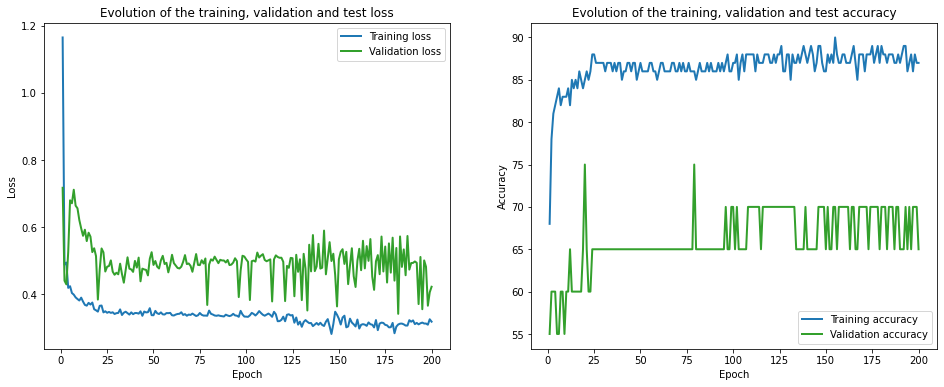

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 135.28it/s]


Initialization done!


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1099.18it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 1.05 train_acc: 30.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 5.09 train_acc: 30.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.69 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.64 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 1.09 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.82 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 1.06 train_acc: 30.00% took: 0.00s
val_loss = 0.64 val_acc = 60.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.26 train_acc: 100.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.74 train_acc: 70.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 

Epoch 16 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 20% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 30% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 40% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 50% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 60% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 70% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 80% 	 train_loss: 0.65 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 90% 	 train_loss: 0.61 train_acc: 60.00% took: 0.00s
Epoch 16 of 200, 100% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
val_loss = 0.53 val_acc = 65.00%
Snapshot saved at epoch 16.
Epoch 17 of 200, 10% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 20% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 30% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 40% 	 t

val_loss = 0.51 val_acc = 65.00%
Snapshot saved at epoch 30.
Epoch 31 of 200, 10% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 31 of 200, 20% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 31 of 200, 30% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 31 of 200, 40% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 31 of 200, 50% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 31 of 200, 60% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 70% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 31 of 200, 80% 	 train_loss: 0.64 train_acc: 80.00% took: 0.00s
Epoch 31 of 200, 90% 	 train_loss: 0.57 train_acc: 60.00% took: 0.00s
Epoch 31 of 200, 100% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
val_loss = 0.54 val_acc = 65.00%
Snapshot saved at epoch 31.
Epoch 32 of 200, 10% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 32 of 200, 20% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 32 of 200, 30% 	 train_los

val_loss = 0.50 val_acc = 65.00%
Snapshot saved at epoch 45.
Epoch 46 of 200, 10% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 46 of 200, 20% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 46 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 46 of 200, 40% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 46 of 200, 50% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 46 of 200, 60% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 46 of 200, 70% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 46 of 200, 80% 	 train_loss: 0.69 train_acc: 80.00% took: 0.00s
Epoch 46 of 200, 90% 	 train_loss: 0.59 train_acc: 60.00% took: 0.00s
Epoch 46 of 200, 100% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
val_loss = 0.53 val_acc = 65.00%
Snapshot saved at epoch 46.
Epoch 47 of 200, 10% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 47 of 200, 20% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 47 of 200, 30% 	 train_loss:

Epoch 61 of 200, 30% 	 train_loss: 0.26 train_acc: 90.00% took: 0.02s
Epoch 61 of 200, 40% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 61 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 61 of 200, 60% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 61 of 200, 70% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 61 of 200, 80% 	 train_loss: 0.82 train_acc: 80.00% took: 0.00s
Epoch 61 of 200, 90% 	 train_loss: 0.56 train_acc: 60.00% took: 0.00s
Epoch 61 of 200, 100% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
val_loss = 0.54 val_acc = 65.00%
Snapshot saved at epoch 61.
Epoch 62 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 62 of 200, 20% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 62 of 200, 30% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 62 of 200, 40% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 62 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 62 of 200, 60% 	 t

val_loss = 0.51 val_acc = 65.00%
Snapshot saved at epoch 74.
Epoch 75 of 200, 10% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 75 of 200, 20% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 75 of 200, 30% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 75 of 200, 40% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 75 of 200, 50% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 75 of 200, 60% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 75 of 200, 70% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 75 of 200, 80% 	 train_loss: 0.71 train_acc: 80.00% took: 0.00s
Epoch 75 of 200, 90% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 75 of 200, 100% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
val_loss = 0.53 val_acc = 65.00%
Snapshot saved at epoch 75.
Epoch 76 of 200, 10% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 76 of 200, 20% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 76 of 200, 30% 	 train_loss:

Epoch 90 of 200, 40% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 90 of 200, 50% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 90 of 200, 60% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 90 of 200, 70% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 90 of 200, 80% 	 train_loss: 0.77 train_acc: 80.00% took: 0.00s
Epoch 90 of 200, 90% 	 train_loss: 0.57 train_acc: 70.00% took: 0.01s
Epoch 90 of 200, 100% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
val_loss = 0.43 val_acc = 70.00%
Snapshot saved at epoch 90.
Epoch 91 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.01s
Epoch 91 of 200, 20% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 91 of 200, 30% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 91 of 200, 40% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 91 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 91 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.01s
Epoch 91 of 200, 70% 	 tr

Epoch 104 of 200, 10% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 104 of 200, 20% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 104 of 200, 30% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 104 of 200, 40% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 104 of 200, 50% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 104 of 200, 60% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 104 of 200, 70% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 104 of 200, 80% 	 train_loss: 0.81 train_acc: 80.00% took: 0.00s
Epoch 104 of 200, 90% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 104 of 200, 100% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
val_loss = 0.54 val_acc = 65.00%
Snapshot saved at epoch 104.
Epoch 105 of 200, 10% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 105 of 200, 20% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 105 of 200, 30% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 105 o

Epoch 114 of 200, 100% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
val_loss = 0.51 val_acc = 65.00%
Snapshot saved at epoch 114.
Epoch 115 of 200, 10% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 115 of 200, 20% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 115 of 200, 30% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 115 of 200, 40% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 115 of 200, 50% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 115 of 200, 60% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 115 of 200, 70% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 115 of 200, 80% 	 train_loss: 0.77 train_acc: 80.00% took: 0.00s
Epoch 115 of 200, 90% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 115 of 200, 100% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
val_loss = 0.53 val_acc = 65.00%
Snapshot saved at epoch 115.
Epoch 116 of 200, 10% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 116 of 200, 2

Epoch 125 of 200, 60% 	 train_loss: 0.21 train_acc: 90.00% took: 0.01s
Epoch 125 of 200, 70% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 125 of 200, 80% 	 train_loss: 0.82 train_acc: 80.00% took: 0.00s
Epoch 125 of 200, 90% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 125 of 200, 100% 	 train_loss: 0.34 train_acc: 90.00% took: 0.01s
val_loss = 0.53 val_acc = 65.00%
Snapshot saved at epoch 125.
Epoch 126 of 200, 10% 	 train_loss: 0.20 train_acc: 100.00% took: 0.01s
Epoch 126 of 200, 20% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 126 of 200, 30% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 126 of 200, 40% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 126 of 200, 50% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 126 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 126 of 200, 70% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 126 of 200, 80% 	 train_loss: 0.90 train_acc: 70.00% took: 0.00s
Epoch 126 of

Epoch 140 of 200, 60% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 140 of 200, 70% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 140 of 200, 80% 	 train_loss: 0.80 train_acc: 80.00% took: 0.00s
Epoch 140 of 200, 90% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 140 of 200, 100% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
val_loss = 0.38 val_acc = 70.00%
Snapshot saved at epoch 140.
Epoch 141 of 200, 10% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 141 of 200, 20% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 141 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 141 of 200, 40% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 141 of 200, 50% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 141 of 200, 60% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 141 of 200, 70% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 141 of 200, 80% 	 train_loss: 0.81 train_acc: 80.00% took: 0.00s
Epoch 141 of

Epoch 154 of 200, 70% 	 train_loss: 0.37 train_acc: 80.00% took: 0.02s
Epoch 154 of 200, 80% 	 train_loss: 0.75 train_acc: 80.00% took: 0.00s
Epoch 154 of 200, 90% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 154 of 200, 100% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
val_loss = 0.51 val_acc = 65.00%
Snapshot saved at epoch 154.
Epoch 155 of 200, 10% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 155 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 155 of 200, 30% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 155 of 200, 40% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 155 of 200, 50% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 155 of 200, 60% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 155 of 200, 70% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 155 of 200, 80% 	 train_loss: 0.84 train_acc: 80.00% took: 0.00s
Epoch 155 of 200, 90% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 155 of

Epoch 170 of 200, 30% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 170 of 200, 40% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 170 of 200, 50% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 170 of 200, 60% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 170 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 170 of 200, 80% 	 train_loss: 0.68 train_acc: 80.00% took: 0.00s
Epoch 170 of 200, 90% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 170 of 200, 100% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
val_loss = 0.54 val_acc = 65.00%
Snapshot saved at epoch 170.
Epoch 171 of 200, 10% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 171 of 200, 20% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 171 of 200, 30% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 171 of 200, 40% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 171 of 200, 50% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 171

Epoch 180 of 200, 100% 	 train_loss: 0.35 train_acc: 90.00% took: 0.02s
val_loss = 0.52 val_acc = 65.00%
Snapshot saved at epoch 180.
Epoch 181 of 200, 10% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 181 of 200, 20% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 181 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 181 of 200, 40% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 181 of 200, 50% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 181 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 181 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 181 of 200, 80% 	 train_loss: 0.75 train_acc: 70.00% took: 0.00s
Epoch 181 of 200, 90% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
Epoch 181 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss = 0.58 val_acc = 65.00%
Snapshot saved at epoch 181.
Epoch 182 of 200, 10% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 182 of 200, 2

Epoch 195 of 200, 10% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 195 of 200, 20% 	 train_loss: 0.32 train_acc: 80.00% took: 0.01s
Epoch 195 of 200, 30% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 195 of 200, 40% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 195 of 200, 50% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 195 of 200, 60% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 195 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 195 of 200, 80% 	 train_loss: 0.77 train_acc: 80.00% took: 0.00s
Epoch 195 of 200, 90% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
Epoch 195 of 200, 100% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
val_loss = 0.59 val_acc = 65.00%
Snapshot saved at epoch 195.
Epoch 196 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 196 of 200, 20% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 30% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 196 o

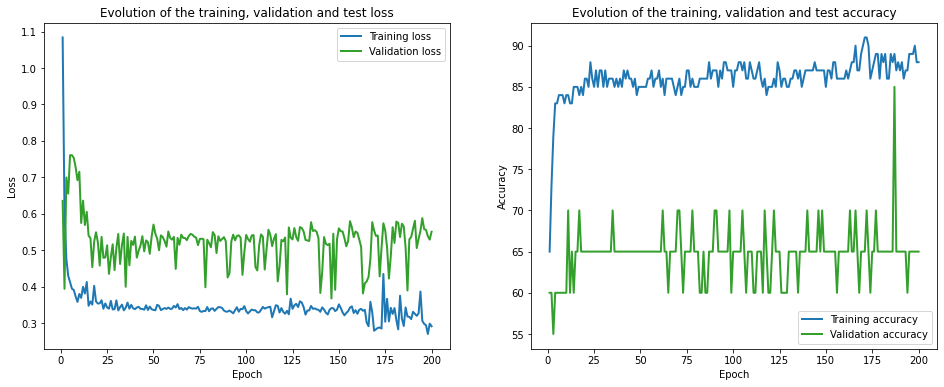

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 138.23it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1209.51it/s]

Finished computing p-values for 500 test points.

Starting repetition 15 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 4.12 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 1.65 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.58 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.37 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.57 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 1.13 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
val_loss = 0.70 val_acc = 55.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.78 train_acc: 50.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.5

Epoch 15 of 200, 40% 	 train_loss: 0.41 train_acc: 80.00% took: 0.01s
Epoch 15 of 200, 50% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 60% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 70% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 80% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 90% 	 train_loss: 1.30 train_acc: 70.00% took: 0.00s
Epoch 15 of 200, 100% 	 train_loss: 0.37 train_acc: 70.00% took: 0.00s
val_loss = 0.54 val_acc = 60.00%
Snapshot saved at epoch 15.
Epoch 16 of 200, 10% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 20% 	 train_loss: 0.69 train_acc: 60.00% took: 0.00s
Epoch 16 of 200, 30% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 40% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 50% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 60% 	 train_loss: 1.33 train_acc: 30.00% took: 0.00s
Epoch 16 of 200, 70% 	 train

Epoch 30 of 200, 90% 	 train_loss: 1.27 train_acc: 70.00% took: 0.00s
Epoch 30 of 200, 100% 	 train_loss: 0.74 train_acc: 70.00% took: 0.00s
val_loss = 0.54 val_acc = 60.00%
Snapshot saved at epoch 30.
Epoch 31 of 200, 10% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 20% 	 train_loss: 0.72 train_acc: 60.00% took: 0.00s
Epoch 31 of 200, 30% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 40% 	 train_loss: 0.27 train_acc: 100.00% took: 0.00s
Epoch 31 of 200, 50% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 60% 	 train_loss: 1.48 train_acc: 30.00% took: 0.00s
Epoch 31 of 200, 70% 	 train_loss: 0.66 train_acc: 80.00% took: 0.00s
Epoch 31 of 200, 80% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 90% 	 train_loss: 2.52 train_acc: 60.00% took: 0.00s
Epoch 31 of 200, 100% 	 train_loss: 4.31 train_acc: 60.00% took: 0.00s
val_loss = 0.52 val_acc = 55.00%
Snapshot saved at epoch 31.
Epoch 32 of 200, 10% 	 train_loss: 

val_loss = 0.71 val_acc = 55.00%
Snapshot saved at epoch 45.
Epoch 46 of 200, 10% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 46 of 200, 20% 	 train_loss: 0.75 train_acc: 60.00% took: 0.00s
Epoch 46 of 200, 30% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 46 of 200, 40% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 46 of 200, 50% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 46 of 200, 60% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 46 of 200, 70% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 46 of 200, 80% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 46 of 200, 90% 	 train_loss: 1.05 train_acc: 70.00% took: 0.00s
Epoch 46 of 200, 100% 	 train_loss: 0.37 train_acc: 70.00% took: 0.00s
val_loss = 0.68 val_acc = 55.00%
Snapshot saved at epoch 46.
Epoch 47 of 200, 10% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 47 of 200, 20% 	 train_loss: 0.74 train_acc: 60.00% took: 0.00s
Epoch 47 of 200, 30% 	 train_loss: 0.

Epoch 61 of 200, 60% 	 train_loss: 2.54 train_acc: 30.00% took: 0.00s
Epoch 61 of 200, 70% 	 train_loss: 1.03 train_acc: 80.00% took: 0.00s
Epoch 61 of 200, 80% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 61 of 200, 90% 	 train_loss: 1.87 train_acc: 60.00% took: 0.00s
Epoch 61 of 200, 100% 	 train_loss: 4.96 train_acc: 60.00% took: 0.00s
val_loss = 0.64 val_acc = 55.00%
Snapshot saved at epoch 61.
Epoch 62 of 200, 10% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 62 of 200, 20% 	 train_loss: 0.80 train_acc: 50.00% took: 0.00s
Epoch 62 of 200, 30% 	 train_loss: 0.46 train_acc: 80.00% took: 0.02s
Epoch 62 of 200, 40% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 62 of 200, 50% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 62 of 200, 60% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 62 of 200, 70% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 62 of 200, 80% 	 train_loss: 0.62 train_acc: 90.00% took: 0.00s
Epoch 62 of 200, 90% 	 train

val_loss = 0.78 val_acc = 55.00%
Snapshot saved at epoch 75.
Epoch 76 of 200, 10% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 76 of 200, 20% 	 train_loss: 0.76 train_acc: 60.00% took: 0.00s
Epoch 76 of 200, 30% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 76 of 200, 40% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 76 of 200, 50% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 76 of 200, 60% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 76 of 200, 70% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 76 of 200, 80% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 76 of 200, 90% 	 train_loss: 1.25 train_acc: 70.00% took: 0.00s
Epoch 76 of 200, 100% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
val_loss = 0.72 val_acc = 55.00%
Snapshot saved at epoch 76.
Epoch 77 of 200, 10% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 77 of 200, 20% 	 train_loss: 0.73 train_acc: 60.00% took: 0.00s
Epoch 77 of 200, 30% 	 train_loss: 0.

Epoch 91 of 200, 100% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
val_loss = 0.68 val_acc = 55.00%
Snapshot saved at epoch 91.
Epoch 92 of 200, 10% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 92 of 200, 20% 	 train_loss: 0.74 train_acc: 60.00% took: 0.00s
Epoch 92 of 200, 30% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 92 of 200, 40% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 92 of 200, 50% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 92 of 200, 60% 	 train_loss: 1.61 train_acc: 30.00% took: 0.00s
Epoch 92 of 200, 70% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 92 of 200, 80% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 92 of 200, 90% 	 train_loss: 1.90 train_acc: 60.00% took: 0.00s
Epoch 92 of 200, 100% 	 train_loss: 2.18 train_acc: 70.00% took: 0.00s
val_loss = 0.76 val_acc = 55.00%
Snapshot saved at epoch 92.
Epoch 93 of 200, 10% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 93 of 200, 20% 	 train_loss: 

Epoch 102 of 200, 80% 	 train_loss: 0.21 train_acc: 90.00% took: 0.01s
Epoch 102 of 200, 90% 	 train_loss: 2.03 train_acc: 60.00% took: 0.00s
Epoch 102 of 200, 100% 	 train_loss: 2.27 train_acc: 70.00% took: 0.00s
val_loss = 0.78 val_acc = 55.00%
Snapshot saved at epoch 102.
Epoch 103 of 200, 10% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 103 of 200, 20% 	 train_loss: 0.82 train_acc: 50.00% took: 0.00s
Epoch 103 of 200, 30% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 103 of 200, 40% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 103 of 200, 50% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 103 of 200, 60% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 103 of 200, 70% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 103 of 200, 80% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 103 of 200, 90% 	 train_loss: 1.76 train_acc: 60.00% took: 0.00s
Epoch 103 of 200, 100% 	 train_loss: 1.66 train_acc: 70.00% took: 0.00s
val_loss = 0.

Epoch 117 of 200, 80% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 117 of 200, 90% 	 train_loss: 1.49 train_acc: 60.00% took: 0.00s
Epoch 117 of 200, 100% 	 train_loss: 0.82 train_acc: 70.00% took: 0.00s
val_loss = 0.81 val_acc = 45.00%
Snapshot saved at epoch 117.
Epoch 118 of 200, 10% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 118 of 200, 20% 	 train_loss: 0.83 train_acc: 50.00% took: 0.00s
Epoch 118 of 200, 30% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 118 of 200, 40% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 118 of 200, 50% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 118 of 200, 60% 	 train_loss: 0.44 train_acc: 90.00% took: 0.00s
Epoch 118 of 200, 70% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 118 of 200, 80% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 118 of 200, 90% 	 train_loss: 1.43 train_acc: 60.00% took: 0.01s
Epoch 118 of 200, 100% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
val_loss = 0.

Epoch 132 of 200, 60% 	 train_loss: 0.40 train_acc: 90.00% took: 0.02s
Epoch 132 of 200, 70% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 132 of 200, 80% 	 train_loss: 0.31 train_acc: 90.00% took: 0.01s
Epoch 132 of 200, 90% 	 train_loss: 1.54 train_acc: 60.00% took: 0.00s
Epoch 132 of 200, 100% 	 train_loss: 0.90 train_acc: 70.00% took: 0.00s
val_loss = 0.68 val_acc = 55.00%
Snapshot saved at epoch 132.
Epoch 133 of 200, 10% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 133 of 200, 20% 	 train_loss: 0.76 train_acc: 50.00% took: 0.00s
Epoch 133 of 200, 30% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 133 of 200, 40% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 133 of 200, 50% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 133 of 200, 60% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 133 of 200, 70% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 133 of 200, 80% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 133 of 2

Epoch 147 of 200, 50% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 147 of 200, 60% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 147 of 200, 70% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 147 of 200, 80% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 147 of 200, 90% 	 train_loss: 1.36 train_acc: 60.00% took: 0.00s
Epoch 147 of 200, 100% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
val_loss = 0.71 val_acc = 55.00%
Snapshot saved at epoch 147.
Epoch 148 of 200, 10% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 148 of 200, 20% 	 train_loss: 0.74 train_acc: 50.00% took: 0.00s
Epoch 148 of 200, 30% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 148 of 200, 40% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 148 of 200, 50% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 148 of 200, 60% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 148 of 200, 70% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 148 of 2

Epoch 162 of 200, 20% 	 train_loss: 0.75 train_acc: 60.00% took: 0.00s
Epoch 162 of 200, 30% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 162 of 200, 40% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 162 of 200, 50% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 162 of 200, 60% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 162 of 200, 70% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 162 of 200, 80% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 162 of 200, 90% 	 train_loss: 1.15 train_acc: 70.00% took: 0.00s
Epoch 162 of 200, 100% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
val_loss = 0.72 val_acc = 55.00%
Snapshot saved at epoch 162.
Epoch 163 of 200, 10% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 163 of 200, 20% 	 train_loss: 0.76 train_acc: 60.00% took: 0.00s
Epoch 163 of 200, 30% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 163 of 200, 40% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 163 of 2

Epoch 175 of 200, 100% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
val_loss = 0.73 val_acc = 55.00%
Snapshot saved at epoch 175.
Epoch 176 of 200, 10% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 176 of 200, 20% 	 train_loss: 0.75 train_acc: 60.00% took: 0.00s
Epoch 176 of 200, 30% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 176 of 200, 40% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 176 of 200, 50% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 176 of 200, 60% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 176 of 200, 70% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 176 of 200, 80% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 176 of 200, 90% 	 train_loss: 1.11 train_acc: 70.00% took: 0.00s
Epoch 176 of 200, 100% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
val_loss = 0.68 val_acc = 55.00%
Snapshot saved at epoch 176.
Epoch 177 of 200, 10% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 177 of 200, 20% 

Epoch 190 of 200, 20% 	 train_loss: 0.78 train_acc: 50.00% took: 0.00s
Epoch 190 of 200, 30% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 190 of 200, 40% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 190 of 200, 50% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 190 of 200, 60% 	 train_loss: 0.39 train_acc: 90.00% took: 0.01s
Epoch 190 of 200, 70% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 190 of 200, 80% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 190 of 200, 90% 	 train_loss: 1.18 train_acc: 70.00% took: 0.00s
Epoch 190 of 200, 100% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
val_loss = 0.71 val_acc = 55.00%
Snapshot saved at epoch 190.
Epoch 191 of 200, 10% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 191 of 200, 20% 	 train_loss: 0.76 train_acc: 60.00% took: 0.00s
Epoch 191 of 200, 30% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 191 of 200, 40% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 191 of 2

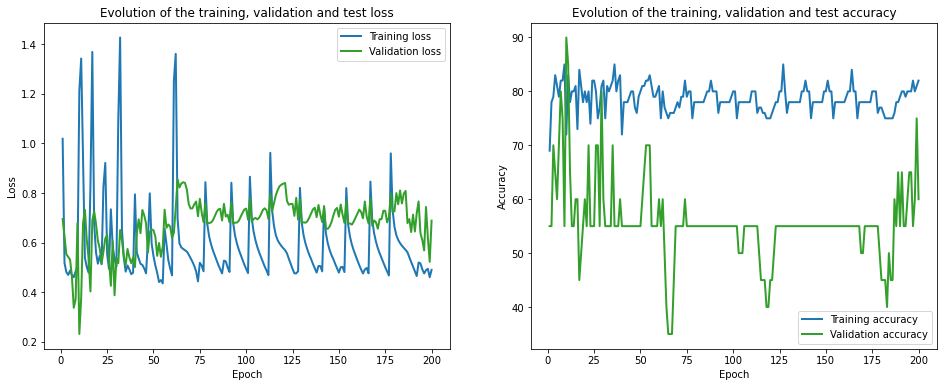

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 145.90it/s]


Initialization done!


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1143.26it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 1.06 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 13.68 train_acc: 30.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 3.27 train_acc: 30.00% took: 0.01s
Epoch 1 of 200, 40% 	 train_loss: 0.58 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.42 train_acc: 90.00% took: 0.02s
Epoch 1 of 200, 90% 	 train_loss: 4.49 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.36 train_acc: 60.00% took: 0.00s
val_loss = 0.46 val_acc = 60.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.72 train_acc: 50.00% took: 0.01s
Epoch 2 of 200, 30% 	 train_loss: 0.

Epoch 15 of 200, 30% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 15 of 200, 40% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 15 of 200, 50% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 60% 	 train_loss: 1.46 train_acc: 30.00% took: 0.00s
Epoch 15 of 200, 70% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 15 of 200, 80% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 90% 	 train_loss: 1.27 train_acc: 60.00% took: 0.00s
Epoch 15 of 200, 100% 	 train_loss: 5.90 train_acc: 40.00% took: 0.00s
val_loss = 0.33 val_acc = 75.00%
Snapshot saved at epoch 15.
Epoch 16 of 200, 10% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 20% 	 train_loss: 0.70 train_acc: 60.00% took: 0.00s
Epoch 16 of 200, 30% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 40% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 50% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 60% 	 trai

Epoch 30 of 200, 50% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 30 of 200, 60% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 30 of 200, 70% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 30 of 200, 80% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 30 of 200, 90% 	 train_loss: 1.25 train_acc: 70.00% took: 0.00s
Epoch 30 of 200, 100% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
val_loss = 0.52 val_acc = 65.00%
Snapshot saved at epoch 30.
Epoch 31 of 200, 10% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 20% 	 train_loss: 0.73 train_acc: 60.00% took: 0.00s
Epoch 31 of 200, 30% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 31 of 200, 40% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 31 of 200, 50% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 60% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 70% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 80% 	 train

Epoch 45 of 200, 10% 	 train_loss: 0.41 train_acc: 90.00% took: 0.02s
Epoch 45 of 200, 20% 	 train_loss: 0.72 train_acc: 60.00% took: 0.00s
Epoch 45 of 200, 30% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 45 of 200, 40% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 45 of 200, 50% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 45 of 200, 60% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 45 of 200, 70% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 45 of 200, 80% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 45 of 200, 90% 	 train_loss: 0.94 train_acc: 70.00% took: 0.00s
Epoch 45 of 200, 100% 	 train_loss: 0.52 train_acc: 70.00% took: 0.00s
val_loss = 0.53 val_acc = 70.00%
Snapshot saved at epoch 45.
Epoch 46 of 200, 10% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 46 of 200, 20% 	 train_loss: 0.77 train_acc: 60.00% took: 0.00s
Epoch 46 of 200, 30% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 46 of 200, 40% 	 train

Epoch 56 of 200, 30% 	 train_loss: 0.40 train_acc: 80.00% took: 0.02s
Epoch 56 of 200, 40% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 56 of 200, 50% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 56 of 200, 60% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 56 of 200, 70% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 56 of 200, 80% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 56 of 200, 90% 	 train_loss: 1.01 train_acc: 70.00% took: 0.00s
Epoch 56 of 200, 100% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
val_loss = 0.63 val_acc = 60.00%
Snapshot saved at epoch 56.
Epoch 57 of 200, 10% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 20% 	 train_loss: 0.72 train_acc: 60.00% took: 0.00s
Epoch 57 of 200, 30% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 40% 	 train_loss: 0.25 train_acc: 100.00% took: 0.00s
Epoch 57 of 200, 50% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 60% 	 trai

val_loss = 0.66 val_acc = 55.00%
Snapshot saved at epoch 66.
Epoch 67 of 200, 10% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 67 of 200, 20% 	 train_loss: 0.80 train_acc: 50.00% took: 0.00s
Epoch 67 of 200, 30% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 67 of 200, 40% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 67 of 200, 50% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 67 of 200, 60% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 67 of 200, 70% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 67 of 200, 80% 	 train_loss: 0.26 train_acc: 100.00% took: 0.00s
Epoch 67 of 200, 90% 	 train_loss: 1.08 train_acc: 70.00% took: 0.00s
Epoch 67 of 200, 100% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
val_loss = 0.66 val_acc = 55.00%
Snapshot saved at epoch 67.
Epoch 68 of 200, 10% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 68 of 200, 20% 	 train_loss: 0.77 train_acc: 50.00% took: 0.00s
Epoch 68 of 200, 30% 	 train_loss: 0

Epoch 82 of 200, 60% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 82 of 200, 70% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 82 of 200, 80% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 82 of 200, 90% 	 train_loss: 0.61 train_acc: 70.00% took: 0.00s
Epoch 82 of 200, 100% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
val_loss = 1.35 val_acc = 40.00%
Snapshot saved at epoch 82.
Epoch 83 of 200, 10% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 83 of 200, 20% 	 train_loss: 0.74 train_acc: 60.00% took: 0.00s
Epoch 83 of 200, 30% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 83 of 200, 40% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 83 of 200, 50% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 83 of 200, 60% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 83 of 200, 70% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 83 of 200, 80% 	 train_loss: 0.50 train_acc: 90.00% took: 0.00s
Epoch 83 of 200, 90% 	 train

Epoch 97 of 200, 70% 	 train_loss: 0.31 train_acc: 90.00% took: 0.02s
Epoch 97 of 200, 80% 	 train_loss: 0.51 train_acc: 70.00% took: 0.01s
Epoch 97 of 200, 90% 	 train_loss: 1.24 train_acc: 70.00% took: 0.00s
Epoch 97 of 200, 100% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
val_loss = 0.96 val_acc = 55.00%
Snapshot saved at epoch 97.
Epoch 98 of 200, 10% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 98 of 200, 20% 	 train_loss: 0.77 train_acc: 60.00% took: 0.00s
Epoch 98 of 200, 30% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 98 of 200, 40% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 98 of 200, 50% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 98 of 200, 60% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 98 of 200, 70% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 98 of 200, 80% 	 train_loss: 0.91 train_acc: 80.00% took: 0.00s
Epoch 98 of 200, 90% 	 train_loss: 0.82 train_acc: 70.00% took: 0.00s
Epoch 98 of 200, 100% 	 trai

Epoch 112 of 200, 90% 	 train_loss: 1.35 train_acc: 70.00% took: 0.02s
Epoch 112 of 200, 100% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
val_loss = 0.96 val_acc = 55.00%
Snapshot saved at epoch 112.
Epoch 113 of 200, 10% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 113 of 200, 20% 	 train_loss: 0.77 train_acc: 60.00% took: 0.00s
Epoch 113 of 200, 30% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 113 of 200, 40% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 113 of 200, 50% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 113 of 200, 60% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 113 of 200, 70% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 113 of 200, 80% 	 train_loss: 0.92 train_acc: 80.00% took: 0.00s
Epoch 113 of 200, 90% 	 train_loss: 0.81 train_acc: 70.00% took: 0.00s
Epoch 113 of 200, 100% 	 train_loss: 0.27 train_acc: 100.00% took: 0.00s
val_loss = 0.66 val_acc = 65.00%
Snapshot saved at epoch 113.
Epoch 114 of 200, 10%

val_loss = 0.76 val_acc = 70.00%
Snapshot saved at epoch 127.
Epoch 128 of 200, 10% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 128 of 200, 20% 	 train_loss: 0.80 train_acc: 60.00% took: 0.00s
Epoch 128 of 200, 30% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 128 of 200, 40% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 128 of 200, 50% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 128 of 200, 60% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 128 of 200, 70% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 128 of 200, 80% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 128 of 200, 90% 	 train_loss: 1.30 train_acc: 70.00% took: 0.00s
Epoch 128 of 200, 100% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
val_loss = 1.04 val_acc = 55.00%
Snapshot saved at epoch 128.
Epoch 129 of 200, 10% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 129 of 200, 20% 	 train_loss: 0.76 train_acc: 60.00% took: 0.00s
Epoch 129 of 200, 30%

Epoch 143 of 200, 90% 	 train_loss: 1.11 train_acc: 70.00% took: 0.00s
Epoch 143 of 200, 100% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
val_loss = 0.80 val_acc = 65.00%
Snapshot saved at epoch 143.
Epoch 144 of 200, 10% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 144 of 200, 20% 	 train_loss: 0.77 train_acc: 60.00% took: 0.00s
Epoch 144 of 200, 30% 	 train_loss: 0.63 train_acc: 90.00% took: 0.00s
Epoch 144 of 200, 40% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 144 of 200, 50% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 144 of 200, 60% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 144 of 200, 70% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 144 of 200, 80% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 144 of 200, 90% 	 train_loss: 0.95 train_acc: 70.00% took: 0.00s
Epoch 144 of 200, 100% 	 train_loss: 0.45 train_acc: 70.00% took: 0.01s
val_loss = 0.79 val_acc = 65.00%
Snapshot saved at epoch 144.
Epoch 145 of 200, 10% 

Epoch 158 of 200, 100% 	 train_loss: 0.62 train_acc: 70.00% took: 0.00s
val_loss = 0.86 val_acc = 55.00%
Snapshot saved at epoch 158.
Epoch 159 of 200, 10% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 159 of 200, 20% 	 train_loss: 0.68 train_acc: 60.00% took: 0.00s
Epoch 159 of 200, 30% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 159 of 200, 40% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 159 of 200, 50% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 159 of 200, 60% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 159 of 200, 70% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 159 of 200, 80% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 159 of 200, 90% 	 train_loss: 1.35 train_acc: 60.00% took: 0.00s
Epoch 159 of 200, 100% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
val_loss = 0.85 val_acc = 55.00%
Snapshot saved at epoch 159.
Epoch 160 of 200, 10% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 160 of 200, 20% 

Epoch 173 of 200, 60% 	 train_loss: 0.35 train_acc: 90.00% took: 0.02s
Epoch 173 of 200, 70% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 173 of 200, 80% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 173 of 200, 90% 	 train_loss: 1.05 train_acc: 70.00% took: 0.00s
Epoch 173 of 200, 100% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
val_loss = 0.69 val_acc = 65.00%
Snapshot saved at epoch 173.
Epoch 174 of 200, 10% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 20% 	 train_loss: 0.78 train_acc: 60.00% took: 0.00s
Epoch 174 of 200, 30% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 40% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 174 of 200, 50% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 60% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 70% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 80% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 174 of 

Epoch 188 of 200, 90% 	 train_loss: 1.02 train_acc: 70.00% took: 0.00s
Epoch 188 of 200, 100% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
val_loss = 0.71 val_acc = 60.00%
Snapshot saved at epoch 188.
Epoch 189 of 200, 10% 	 train_loss: 0.28 train_acc: 100.00% took: 0.00s
Epoch 189 of 200, 20% 	 train_loss: 0.78 train_acc: 60.00% took: 0.00s
Epoch 189 of 200, 30% 	 train_loss: 0.60 train_acc: 90.00% took: 0.00s
Epoch 189 of 200, 40% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 189 of 200, 50% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 189 of 200, 60% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 189 of 200, 70% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 189 of 200, 80% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 189 of 200, 90% 	 train_loss: 0.99 train_acc: 70.00% took: 0.00s
Epoch 189 of 200, 100% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
val_loss = 0.74 val_acc = 65.00%
Snapshot saved at epoch 189.
Epoch 190 of 200, 10%

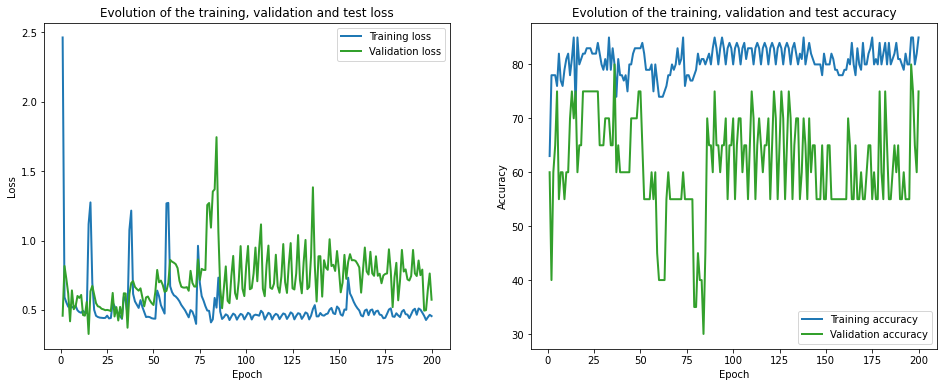

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 130.26it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1267.76it/s]

Finished computing p-values for 500 test points.

Starting repetition 16 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 2.49 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.80 train_acc: 30.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 1.75 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.73 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.52 train_acc: 70.00% took: 0.00s
val_loss = 0.54 val_acc = 65.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.

val_loss = 0.51 val_acc = 75.00%
Snapshot saved at epoch 14.
Epoch 15 of 200, 10% 	 train_loss: 0.28 train_acc: 90.00% took: 0.01s
Epoch 15 of 200, 20% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 15 of 200, 30% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 15 of 200, 40% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 15 of 200, 50% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 60% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 70% 	 train_loss: 0.69 train_acc: 70.00% took: 0.00s
Epoch 15 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.01s
Epoch 15 of 200, 90% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 15 of 200, 100% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
val_loss = 0.52 val_acc = 75.00%
Snapshot saved at epoch 15.
Epoch 16 of 200, 10% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 20% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 30% 	 train_los

Epoch 29 of 200, 60% 	 train_loss: 0.31 train_acc: 90.00% took: 0.02s
Epoch 29 of 200, 70% 	 train_loss: 0.70 train_acc: 70.00% took: 0.00s
Epoch 29 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 29 of 200, 90% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 29 of 200, 100% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
val_loss = 0.49 val_acc = 75.00%
Snapshot saved at epoch 29.
Epoch 30 of 200, 10% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 30 of 200, 20% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 30 of 200, 30% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 30 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 30 of 200, 50% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 30 of 200, 60% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 30 of 200, 70% 	 train_loss: 0.70 train_acc: 70.00% took: 0.00s
Epoch 30 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 30 of 200, 90% 	 

Epoch 44 of 200, 60% 	 train_loss: 0.29 train_acc: 90.00% took: 0.02s
Epoch 44 of 200, 70% 	 train_loss: 0.69 train_acc: 70.00% took: 0.00s
Epoch 44 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 44 of 200, 90% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 44 of 200, 100% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
val_loss = 0.50 val_acc = 75.00%
Snapshot saved at epoch 44.
Epoch 45 of 200, 10% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 45 of 200, 20% 	 train_loss: 0.09 train_acc: 100.00% took: 0.02s
Epoch 45 of 200, 30% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 45 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 45 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 45 of 200, 60% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 45 of 200, 70% 	 train_loss: 0.69 train_acc: 70.00% took: 0.02s
Epoch 45 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 45 of 200, 90% 	 

Epoch 55 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.02s
Epoch 55 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 55 of 200, 60% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 55 of 200, 70% 	 train_loss: 0.69 train_acc: 70.00% took: 0.00s
Epoch 55 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 55 of 200, 90% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 55 of 200, 100% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
val_loss = 0.51 val_acc = 75.00%
Snapshot saved at epoch 55.
Epoch 56 of 200, 10% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 56 of 200, 20% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 56 of 200, 30% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 56 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 56 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 56 of 200, 60% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 56 of 200, 70% 	 

Epoch 70 of 200, 30% 	 train_loss: 0.31 train_acc: 90.00% took: 0.02s
Epoch 70 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 70 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 70 of 200, 60% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 70 of 200, 70% 	 train_loss: 0.68 train_acc: 70.00% took: 0.00s
Epoch 70 of 200, 80% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 70 of 200, 90% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 70 of 200, 100% 	 train_loss: 0.33 train_acc: 90.00% took: 0.02s
val_loss = 0.53 val_acc = 75.00%
Snapshot saved at epoch 70.
Epoch 71 of 200, 10% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 71 of 200, 20% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 71 of 200, 30% 	 train_loss: 0.31 train_acc: 90.00% took: 0.02s
Epoch 71 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 71 of 200, 50% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 71 of 200, 60% 	 

Epoch 84 of 200, 100% 	 train_loss: 0.32 train_acc: 90.00% took: 0.02s
val_loss = 0.57 val_acc = 75.00%
Snapshot saved at epoch 84.
Epoch 85 of 200, 10% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 85 of 200, 20% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 85 of 200, 30% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 85 of 200, 40% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 85 of 200, 50% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 85 of 200, 60% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 85 of 200, 70% 	 train_loss: 0.75 train_acc: 70.00% took: 0.00s
Epoch 85 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 85 of 200, 90% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 85 of 200, 100% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
val_loss = 0.56 val_acc = 75.00%
Snapshot saved at epoch 85.
Epoch 86 of 200, 10% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 86 of 200, 20% 	 train_los

Epoch 95 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.02s
Epoch 95 of 200, 90% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 95 of 200, 100% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
val_loss = 0.58 val_acc = 75.00%
Snapshot saved at epoch 95.
Epoch 96 of 200, 10% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 96 of 200, 20% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 96 of 200, 30% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 96 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 96 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 96 of 200, 60% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 96 of 200, 70% 	 train_loss: 0.69 train_acc: 70.00% took: 0.00s
Epoch 96 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 96 of 200, 90% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 96 of 200, 100% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
val_loss = 0.60 val_a

val_loss = 0.62 val_acc = 75.00%
Snapshot saved at epoch 110.
Epoch 111 of 200, 10% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 20% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 30% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 60% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 70% 	 train_loss: 0.68 train_acc: 70.00% took: 0.00s
Epoch 111 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 90% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 100% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
val_loss = 0.62 val_acc = 75.00%
Snapshot saved at epoch 111.
Epoch 112 of 200, 10% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 112 of 200, 20% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 112 of 200, 

val_loss = 0.65 val_acc = 75.00%
Snapshot saved at epoch 124.
Epoch 125 of 200, 10% 	 train_loss: 0.28 train_acc: 90.00% took: 0.01s
Epoch 125 of 200, 20% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 125 of 200, 30% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 125 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 125 of 200, 50% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 125 of 200, 60% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 125 of 200, 70% 	 train_loss: 0.68 train_acc: 70.00% took: 0.00s
Epoch 125 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 125 of 200, 90% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 125 of 200, 100% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
val_loss = 0.64 val_acc = 75.00%
Snapshot saved at epoch 125.
Epoch 126 of 200, 10% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 126 of 200, 20% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 126 of 200, 

val_loss = 0.65 val_acc = 75.00%
Snapshot saved at epoch 139.
Epoch 140 of 200, 10% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 140 of 200, 20% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 140 of 200, 30% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 140 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 140 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 140 of 200, 60% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 140 of 200, 70% 	 train_loss: 0.68 train_acc: 70.00% took: 0.00s
Epoch 140 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 140 of 200, 90% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 140 of 200, 100% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
val_loss = 0.64 val_acc = 75.00%
Snapshot saved at epoch 140.
Epoch 141 of 200, 10% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 141 of 200, 20% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 141 of 200, 

Epoch 153 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.02s
Epoch 153 of 200, 90% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 153 of 200, 100% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
val_loss = 0.65 val_acc = 75.00%
Snapshot saved at epoch 153.
Epoch 154 of 200, 10% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 154 of 200, 20% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 154 of 200, 30% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 154 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 154 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 154 of 200, 60% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 154 of 200, 70% 	 train_loss: 0.69 train_acc: 70.00% took: 0.00s
Epoch 154 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 154 of 200, 90% 	 train_loss: 0.10 train_acc: 100.00% took: 0.01s
Epoch 154 of 200, 100% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
val_los

Epoch 167 of 200, 70% 	 train_loss: 0.68 train_acc: 70.00% took: 0.01s
Epoch 167 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 167 of 200, 90% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 167 of 200, 100% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
val_loss = 0.66 val_acc = 75.00%
Snapshot saved at epoch 167.
Epoch 168 of 200, 10% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 168 of 200, 20% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 168 of 200, 30% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 168 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 168 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 168 of 200, 60% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 168 of 200, 70% 	 train_loss: 0.68 train_acc: 70.00% took: 0.00s
Epoch 168 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 168 of 200, 90% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 16

Epoch 181 of 200, 30% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 181 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 181 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 181 of 200, 60% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 181 of 200, 70% 	 train_loss: 0.69 train_acc: 70.00% took: 0.00s
Epoch 181 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 181 of 200, 90% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 181 of 200, 100% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
val_loss = 0.67 val_acc = 75.00%
Snapshot saved at epoch 181.
Epoch 182 of 200, 10% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 182 of 200, 20% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 182 of 200, 30% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 182 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 182 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 182

val_loss = 0.67 val_acc = 75.00%
Snapshot saved at epoch 196.
Epoch 197 of 200, 10% 	 train_loss: 0.28 train_acc: 90.00% took: 0.01s
Epoch 197 of 200, 20% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 197 of 200, 30% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 197 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 197 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 197 of 200, 60% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 197 of 200, 70% 	 train_loss: 0.69 train_acc: 70.00% took: 0.00s
Epoch 197 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 197 of 200, 90% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 197 of 200, 100% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
val_loss = 0.66 val_acc = 75.00%
Snapshot saved at epoch 197.
Epoch 198 of 200, 10% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 198 of 200, 20% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 198 of 200, 

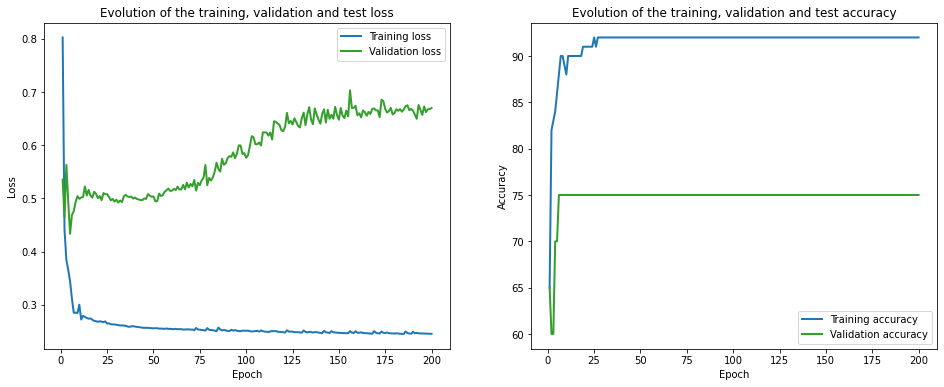

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 137.40it/s]


Initialization done!


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1025.80it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.70 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.93 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 3.15 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 6.51 train_acc: 30.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 2.28 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 1.83 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.92 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.69 train_acc: 60.00% took: 0.00s
val_loss = 0.55 val_acc = 70.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0

Epoch 16 of 200, 40% 	 train_loss: 0.11 train_acc: 100.00% took: 0.01s
Epoch 16 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 60% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 70% 	 train_loss: 0.69 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 90% 	 train_loss: 0.13 train_acc: 100.00% took: 0.01s
Epoch 16 of 200, 100% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
val_loss = 0.52 val_acc = 75.00%
Snapshot saved at epoch 16.
Epoch 17 of 200, 10% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 20% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 30% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 40% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 60% 	 train_loss: 0.30 train_acc: 90.00% took: 0.01s
Epoch 17 of 200, 70% 	 

Epoch 30 of 200, 100% 	 train_loss: 0.32 train_acc: 90.00% took: 0.02s
val_loss = 0.49 val_acc = 75.00%
Snapshot saved at epoch 30.
Epoch 31 of 200, 10% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 20% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 31 of 200, 30% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 40% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 31 of 200, 50% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 60% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 70% 	 train_loss: 0.71 train_acc: 70.00% took: 0.00s
Epoch 31 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 31 of 200, 90% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 31 of 200, 100% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
val_loss = 0.49 val_acc = 75.00%
Snapshot saved at epoch 31.
Epoch 32 of 200, 10% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 32 of 200, 20% 	 train_los

val_loss = 0.47 val_acc = 75.00%
Snapshot saved at epoch 41.
Epoch 42 of 200, 10% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 42 of 200, 20% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 42 of 200, 30% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 42 of 200, 40% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 42 of 200, 50% 	 train_loss: 0.30 train_acc: 90.00% took: 0.02s
Epoch 42 of 200, 60% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 42 of 200, 70% 	 train_loss: 0.71 train_acc: 70.00% took: 0.00s
Epoch 42 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 42 of 200, 90% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 42 of 200, 100% 	 train_loss: 0.31 train_acc: 90.00% took: 0.02s
val_loss = 0.48 val_acc = 75.00%
Snapshot saved at epoch 42.
Epoch 43 of 200, 10% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 43 of 200, 20% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 43 of 200, 30% 	 train_los

Epoch 56 of 200, 30% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 56 of 200, 40% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 56 of 200, 50% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 56 of 200, 60% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 56 of 200, 70% 	 train_loss: 0.71 train_acc: 70.00% took: 0.00s
Epoch 56 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 56 of 200, 90% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 56 of 200, 100% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
val_loss = 0.47 val_acc = 75.00%
Snapshot saved at epoch 56.
Epoch 57 of 200, 10% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 20% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 57 of 200, 30% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 40% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 57 of 200, 50% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 60% 	 

Epoch 67 of 200, 90% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 67 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss = 0.46 val_acc = 75.00%
Snapshot saved at epoch 67.
Epoch 68 of 200, 10% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 68 of 200, 20% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 68 of 200, 30% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 68 of 200, 40% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 68 of 200, 50% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 68 of 200, 60% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 68 of 200, 70% 	 train_loss: 0.71 train_acc: 70.00% took: 0.00s
Epoch 68 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 68 of 200, 90% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 68 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss = 0.45 val_acc = 75.00%
Snapshot saved at epoch 68.
Epoch 69 of 200, 10% 	 train_lo

Epoch 78 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss = 0.45 val_acc = 75.00%
Snapshot saved at epoch 78.
Epoch 79 of 200, 10% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 79 of 200, 20% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 79 of 200, 30% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 79 of 200, 40% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 79 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 79 of 200, 60% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 79 of 200, 70% 	 train_loss: 0.71 train_acc: 70.00% took: 0.00s
Epoch 79 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 79 of 200, 90% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 79 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss = 0.45 val_acc = 75.00%
Snapshot saved at epoch 79.
Epoch 80 of 200, 10% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 80 of 200, 20% 	 train_los

Epoch 89 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.01s
Epoch 89 of 200, 90% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 89 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss = 0.45 val_acc = 75.00%
Snapshot saved at epoch 89.
Epoch 90 of 200, 10% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 90 of 200, 20% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 90 of 200, 30% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 90 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 90 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 90 of 200, 60% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 90 of 200, 70% 	 train_loss: 0.71 train_acc: 70.00% took: 0.00s
Epoch 90 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 90 of 200, 90% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 90 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss = 0.45 val_a

Epoch 105 of 200, 20% 	 train_loss: 0.09 train_acc: 100.00% took: 0.02s
Epoch 105 of 200, 30% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 105 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 105 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 105 of 200, 60% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 105 of 200, 70% 	 train_loss: 0.71 train_acc: 70.00% took: 0.00s
Epoch 105 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 105 of 200, 90% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 105 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss = 0.43 val_acc = 80.00%
Snapshot saved at epoch 105.
Epoch 106 of 200, 10% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 106 of 200, 20% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 106 of 200, 30% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 106 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 10

Epoch 119 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 119 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 119 of 200, 60% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 119 of 200, 70% 	 train_loss: 0.71 train_acc: 70.00% took: 0.00s
Epoch 119 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 119 of 200, 90% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 119 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss = 0.43 val_acc = 80.00%
Snapshot saved at epoch 119.
Epoch 120 of 200, 10% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 120 of 200, 20% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 120 of 200, 30% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 120 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 120 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 120 of 200, 60% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 120

Epoch 134 of 200, 70% 	 train_loss: 0.71 train_acc: 70.00% took: 0.00s
Epoch 134 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 134 of 200, 90% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 134 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss = 0.44 val_acc = 75.00%
Snapshot saved at epoch 134.
Epoch 135 of 200, 10% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 135 of 200, 20% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 135 of 200, 30% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 135 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 135 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 135 of 200, 60% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 135 of 200, 70% 	 train_loss: 0.71 train_acc: 70.00% took: 0.00s
Epoch 135 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 135 of 200, 90% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 13

Epoch 149 of 200, 10% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 149 of 200, 20% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 149 of 200, 30% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 149 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 149 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 149 of 200, 60% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 149 of 200, 70% 	 train_loss: 0.71 train_acc: 70.00% took: 0.00s
Epoch 149 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 149 of 200, 90% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 149 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss = 0.44 val_acc = 75.00%
Snapshot saved at epoch 149.
Epoch 150 of 200, 10% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 20% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 150 of 200, 30% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 150

val_loss = 0.45 val_acc = 75.00%
Snapshot saved at epoch 159.
Epoch 160 of 200, 10% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 160 of 200, 20% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 160 of 200, 30% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 160 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 160 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 160 of 200, 60% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 160 of 200, 70% 	 train_loss: 0.71 train_acc: 70.00% took: 0.00s
Epoch 160 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 160 of 200, 90% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 160 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss = 0.45 val_acc = 75.00%
Snapshot saved at epoch 160.
Epoch 161 of 200, 10% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 161 of 200, 20% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 161 of 200, 

Epoch 171 of 200, 10% 	 train_loss: 0.27 train_acc: 90.00% took: 0.01s
Epoch 171 of 200, 20% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 171 of 200, 30% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 171 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 171 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 171 of 200, 60% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 171 of 200, 70% 	 train_loss: 0.71 train_acc: 70.00% took: 0.00s
Epoch 171 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 171 of 200, 90% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 171 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss = 0.44 val_acc = 75.00%
Snapshot saved at epoch 171.
Epoch 172 of 200, 10% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 172 of 200, 20% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 172 of 200, 30% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 172

Epoch 186 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss = 0.44 val_acc = 80.00%
Snapshot saved at epoch 186.
Epoch 187 of 200, 10% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 187 of 200, 20% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 187 of 200, 30% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 187 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 187 of 200, 50% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 187 of 200, 60% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 187 of 200, 70% 	 train_loss: 0.71 train_acc: 70.00% took: 0.00s
Epoch 187 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 187 of 200, 90% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 187 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss = 0.44 val_acc = 80.00%
Snapshot saved at epoch 187.
Epoch 188 of 200, 10% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 188 of 200, 

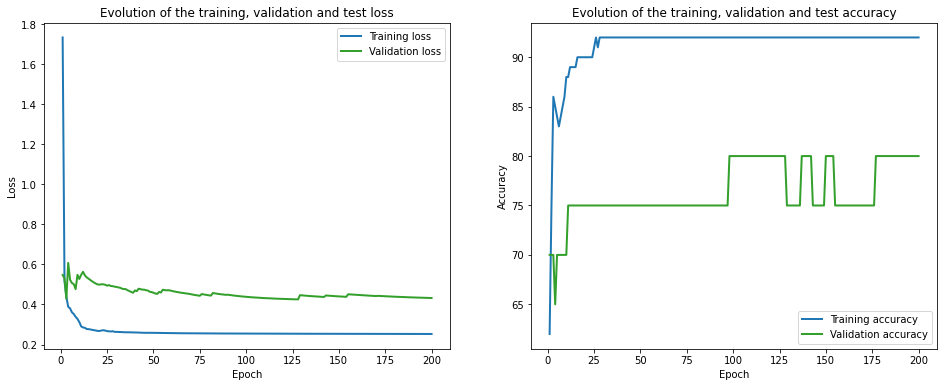

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 139.40it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1003.67it/s]

Finished computing p-values for 500 test points.

Starting repetition 17 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 0.61 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 7.54 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 4.97 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.57 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
val_loss = 1.04 val_acc = 55.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.51 train_acc: 60.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 1

val_loss = 0.40 val_acc = 80.00%
Snapshot saved at epoch 15.
Epoch 16 of 200, 10% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 20% 	 train_loss: 0.82 train_acc: 60.00% took: 0.00s
Epoch 16 of 200, 30% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 50% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 70% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 80% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 90% 	 train_loss: 0.13 train_acc: 100.00% took: 0.01s
Epoch 16 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.40 val_acc = 80.00%
Snapshot saved at epoch 16.
Epoch 17 of 200, 10% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 20% 	 train_loss: 0.82 train_acc: 60.00% took: 0.00s
Epoch 17 of 200, 30% 	 train_loss

Epoch 26 of 200, 90% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 26 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.42 val_acc = 80.00%
Snapshot saved at epoch 26.
Epoch 27 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 20% 	 train_loss: 0.83 train_acc: 60.00% took: 0.00s
Epoch 27 of 200, 30% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 50% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 70% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 80% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 90% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.42 val_acc = 80.00%
Snapshot saved at epoch 27.
Epoch 28 of 200, 10% 	 train_l

Epoch 41 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 41 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 41 of 200, 80% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 41 of 200, 90% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 41 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.01s
val_loss = 0.44 val_acc = 80.00%
Snapshot saved at epoch 41.
Epoch 42 of 200, 10% 	 train_loss: 0.22 train_acc: 90.00% took: 0.01s
Epoch 42 of 200, 20% 	 train_loss: 0.84 train_acc: 60.00% took: 0.00s
Epoch 42 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 42 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 42 of 200, 50% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 42 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 42 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 42 of 200, 80% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 42 of 200, 90% 	 

Epoch 55 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.02s
Epoch 55 of 200, 50% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 55 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.01s
Epoch 55 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 55 of 200, 80% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 55 of 200, 90% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 55 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 0.44 val_acc = 80.00%
Snapshot saved at epoch 55.
Epoch 56 of 200, 10% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 56 of 200, 20% 	 train_loss: 0.84 train_acc: 60.00% took: 0.00s
Epoch 56 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 56 of 200, 40% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 56 of 200, 50% 	 train_loss: 0.13 train_acc: 100.00% took: 0.02s
Epoch 56 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 56 of 200, 70% 	 

Epoch 68 of 200, 50% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 68 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 68 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 68 of 200, 80% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 68 of 200, 90% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 68 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 0.44 val_acc = 80.00%
Snapshot saved at epoch 68.
Epoch 69 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 69 of 200, 20% 	 train_loss: 0.85 train_acc: 60.00% took: 0.00s
Epoch 69 of 200, 30% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 69 of 200, 40% 	 train_loss: 0.43 train_acc: 80.00% took: 0.02s
Epoch 69 of 200, 50% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 69 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 69 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 69 of 200, 80% 

Epoch 82 of 200, 50% 	 train_loss: 0.14 train_acc: 100.00% took: 0.02s
Epoch 82 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 82 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 82 of 200, 80% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 82 of 200, 90% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 82 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 0.44 val_acc = 80.00%
Snapshot saved at epoch 82.
Epoch 83 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 83 of 200, 20% 	 train_loss: 0.85 train_acc: 60.00% took: 0.00s
Epoch 83 of 200, 30% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 83 of 200, 40% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 83 of 200, 50% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 83 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 83 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 83 of 200, 80% 

Epoch 93 of 200, 80% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 93 of 200, 90% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 93 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.42 val_acc = 80.00%
Snapshot saved at epoch 93.
Epoch 94 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.01s
Epoch 94 of 200, 20% 	 train_loss: 0.83 train_acc: 60.00% took: 0.00s
Epoch 94 of 200, 30% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 94 of 200, 40% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 94 of 200, 50% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 94 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.01s
Epoch 94 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 94 of 200, 80% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 94 of 200, 90% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 94 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.42 val_

Epoch 106 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 106 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 106 of 200, 80% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 106 of 200, 90% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 106 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.42 val_acc = 80.00%
Snapshot saved at epoch 106.
Epoch 107 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 107 of 200, 20% 	 train_loss: 0.83 train_acc: 60.00% took: 0.00s
Epoch 107 of 200, 30% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 107 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 107 of 200, 50% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 107 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 107 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 107 of 200, 80% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 107

Epoch 117 of 200, 50% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 117 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 117 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 117 of 200, 80% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 117 of 200, 90% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 117 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.43 val_acc = 80.00%
Snapshot saved at epoch 117.
Epoch 118 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 118 of 200, 20% 	 train_loss: 0.83 train_acc: 60.00% took: 0.00s
Epoch 118 of 200, 30% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 118 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 118 of 200, 50% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 118 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 118 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 1

Epoch 132 of 200, 40% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 132 of 200, 50% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 132 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 132 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 132 of 200, 80% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 132 of 200, 90% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 132 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.41 val_acc = 80.00%
Snapshot saved at epoch 132.
Epoch 133 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 133 of 200, 20% 	 train_loss: 0.83 train_acc: 60.00% took: 0.00s
Epoch 133 of 200, 30% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 133 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 133 of 200, 50% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 133 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 13

Epoch 147 of 200, 90% 	 train_loss: 0.11 train_acc: 100.00% took: 0.01s
Epoch 147 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.01s
val_loss = 0.43 val_acc = 80.00%
Snapshot saved at epoch 147.
Epoch 148 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 148 of 200, 20% 	 train_loss: 0.84 train_acc: 60.00% took: 0.00s
Epoch 148 of 200, 30% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 148 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 148 of 200, 50% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 148 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 148 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 148 of 200, 80% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 148 of 200, 90% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 148 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 0.43 val_acc = 80.00%
Snapshot saved at epoch 148.
Epoch 149 of 20

Epoch 158 of 200, 50% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 158 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 158 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 158 of 200, 80% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 158 of 200, 90% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 158 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.42 val_acc = 80.00%
Snapshot saved at epoch 158.
Epoch 159 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 159 of 200, 20% 	 train_loss: 0.83 train_acc: 60.00% took: 0.00s
Epoch 159 of 200, 30% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 159 of 200, 40% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 159 of 200, 50% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 159 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 159 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 1

Epoch 173 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 173 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 173 of 200, 80% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 173 of 200, 90% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 173 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.43 val_acc = 80.00%
Snapshot saved at epoch 173.
Epoch 174 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 20% 	 train_loss: 0.83 train_acc: 60.00% took: 0.00s
Epoch 174 of 200, 30% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 174 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 174 of 200, 50% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 174 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 174 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 174 of 200, 80% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 17

Epoch 184 of 200, 20% 	 train_loss: 0.83 train_acc: 60.00% took: 0.00s
Epoch 184 of 200, 30% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 184 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 184 of 200, 50% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 184 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 184 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 184 of 200, 80% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 184 of 200, 90% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 184 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.42 val_acc = 80.00%
Snapshot saved at epoch 184.
Epoch 185 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 185 of 200, 20% 	 train_loss: 0.83 train_acc: 60.00% took: 0.00s
Epoch 185 of 200, 30% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 185 of 200, 40% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 18

Epoch 195 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 195 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 195 of 200, 80% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 195 of 200, 90% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 195 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 0.42 val_acc = 80.00%
Snapshot saved at epoch 195.
Epoch 196 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 196 of 200, 20% 	 train_loss: 0.83 train_acc: 60.00% took: 0.00s
Epoch 196 of 200, 30% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 196 of 200, 40% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 50% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 196 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 196 of 200, 80% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 19

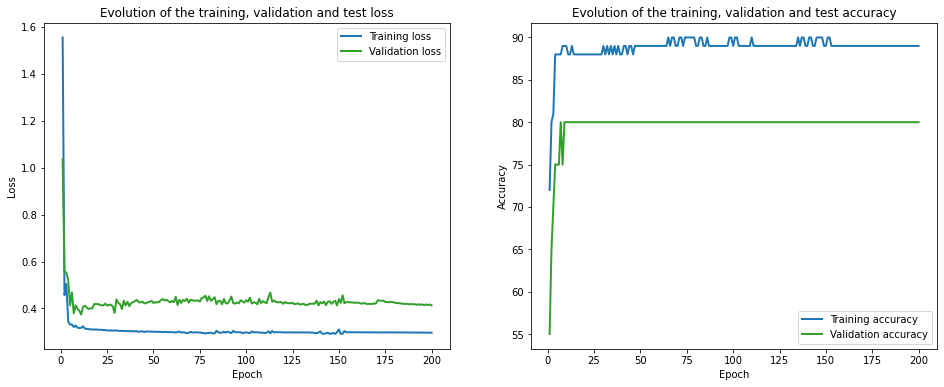

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 137.02it/s]


Initialization done!


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1045.49it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.85 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 3.85 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 1.06 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.55 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.45 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.30 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.26 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.27 train_acc: 100.00% took: 0.00s
val_loss = 0.72 val_acc = 50.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.57 train_acc: 60.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 

Epoch 11 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.47 val_acc = 70.00%
Snapshot saved at epoch 11.
Epoch 12 of 200, 10% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 20% 	 train_loss: 0.83 train_acc: 60.00% took: 0.00s
Epoch 12 of 200, 30% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 40% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 50% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 60% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 70% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 80% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 90% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.45 val_acc = 70.00%
Snapshot saved at epoch 12.
Epoch 13 of 200, 10% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 13 of 200, 20% 	 train_lo

val_loss = 0.49 val_acc = 70.00%
Snapshot saved at epoch 22.
Epoch 23 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 23 of 200, 20% 	 train_loss: 0.83 train_acc: 60.00% took: 0.00s
Epoch 23 of 200, 30% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 23 of 200, 40% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 23 of 200, 50% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 23 of 200, 60% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 23 of 200, 70% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 23 of 200, 80% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 23 of 200, 90% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 23 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.45 val_acc = 75.00%
Snapshot saved at epoch 23.
Epoch 24 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 24 of 200, 20% 	 train_loss: 0.83 train_acc: 60.00% took: 0.00s
Epoch 24 of 200, 30% 	 train_loss

Epoch 38 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 20% 	 train_loss: 0.83 train_acc: 60.00% took: 0.00s
Epoch 38 of 200, 30% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 50% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 60% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 80% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 90% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.46 val_acc = 80.00%
Snapshot saved at epoch 38.
Epoch 39 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 39 of 200, 20% 	 train_loss: 0.84 train_acc: 60.00% took: 0.00s
Epoch 39 of 200, 30% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 39 of 200, 40% 	 t

Epoch 49 of 200, 20% 	 train_loss: 0.84 train_acc: 60.00% took: 0.00s
Epoch 49 of 200, 30% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 49 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 49 of 200, 50% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 49 of 200, 60% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 49 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 49 of 200, 80% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 49 of 200, 90% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 49 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 0.46 val_acc = 80.00%
Snapshot saved at epoch 49.
Epoch 50 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 20% 	 train_loss: 0.84 train_acc: 60.00% took: 0.00s
Epoch 50 of 200, 30% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 50 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 50 of 200, 50% 	 t

Epoch 60 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 60 of 200, 20% 	 train_loss: 0.84 train_acc: 60.00% took: 0.00s
Epoch 60 of 200, 30% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 60 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 60 of 200, 50% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 60 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 60 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 60 of 200, 80% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 60 of 200, 90% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 60 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 0.47 val_acc = 75.00%
Snapshot saved at epoch 60.
Epoch 61 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 61 of 200, 20% 	 train_loss: 0.84 train_acc: 60.00% took: 0.01s
Epoch 61 of 200, 30% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 61 of 200, 40% 	 t

Epoch 76 of 200, 20% 	 train_loss: 0.83 train_acc: 60.00% took: 0.00s
Epoch 76 of 200, 30% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 76 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 76 of 200, 50% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 76 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 76 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 76 of 200, 80% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 76 of 200, 90% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 76 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 0.45 val_acc = 80.00%
Snapshot saved at epoch 76.
Epoch 77 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 77 of 200, 20% 	 train_loss: 0.84 train_acc: 60.00% took: 0.00s
Epoch 77 of 200, 30% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 77 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 77 of 200, 50% 	 

Epoch 87 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.02s
Epoch 87 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 87 of 200, 80% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 87 of 200, 90% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 87 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 0.45 val_acc = 80.00%
Snapshot saved at epoch 87.
Epoch 88 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 88 of 200, 20% 	 train_loss: 0.84 train_acc: 60.00% took: 0.00s
Epoch 88 of 200, 30% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 88 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 88 of 200, 50% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 88 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 88 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 88 of 200, 80% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 88 of 200, 90% 	

Epoch 103 of 200, 20% 	 train_loss: 0.85 train_acc: 60.00% took: 0.00s
Epoch 103 of 200, 30% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 103 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 103 of 200, 50% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 103 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 103 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 103 of 200, 80% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 103 of 200, 90% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 103 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.43 val_acc = 80.00%
Snapshot saved at epoch 103.
Epoch 104 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 104 of 200, 20% 	 train_loss: 0.83 train_acc: 60.00% took: 0.00s
Epoch 104 of 200, 30% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 104 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 104

Epoch 114 of 200, 20% 	 train_loss: 0.83 train_acc: 60.00% took: 0.01s
Epoch 114 of 200, 30% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 114 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 114 of 200, 50% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 114 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 114 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 114 of 200, 80% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 114 of 200, 90% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 114 of 200, 100% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
val_loss = 0.47 val_acc = 80.00%
Snapshot saved at epoch 114.
Epoch 115 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 115 of 200, 20% 	 train_loss: 0.85 train_acc: 60.00% took: 0.00s
Epoch 115 of 200, 30% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 115 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 115

Epoch 124 of 200, 100% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
val_loss = 0.46 val_acc = 80.00%
Snapshot saved at epoch 124.
Epoch 125 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 125 of 200, 20% 	 train_loss: 0.86 train_acc: 60.00% took: 0.00s
Epoch 125 of 200, 30% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 125 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 125 of 200, 50% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 125 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 125 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 125 of 200, 80% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 125 of 200, 90% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 125 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.42 val_acc = 80.00%
Snapshot saved at epoch 125.
Epoch 126 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 126 of 200

Epoch 135 of 200, 80% 	 train_loss: 0.39 train_acc: 80.00% took: 0.02s
Epoch 135 of 200, 90% 	 train_loss: 0.12 train_acc: 100.00% took: 0.01s
Epoch 135 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.41 val_acc = 80.00%
Snapshot saved at epoch 135.
Epoch 136 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 136 of 200, 20% 	 train_loss: 0.83 train_acc: 60.00% took: 0.00s
Epoch 136 of 200, 30% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 136 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 136 of 200, 50% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 136 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 136 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 136 of 200, 80% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 136 of 200, 90% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 136 of 200, 100% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
val_los

Epoch 150 of 200, 20% 	 train_loss: 0.83 train_acc: 60.00% took: 0.01s
Epoch 150 of 200, 30% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 150 of 200, 50% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 150 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 150 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 150 of 200, 80% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 90% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 150 of 200, 100% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
val_loss = 0.46 val_acc = 80.00%
Snapshot saved at epoch 150.
Epoch 151 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 151 of 200, 20% 	 train_loss: 0.86 train_acc: 60.00% took: 0.00s
Epoch 151 of 200, 30% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 151 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 151

Epoch 165 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 165 of 200, 80% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 165 of 200, 90% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 165 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.41 val_acc = 80.00%
Snapshot saved at epoch 165.
Epoch 166 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 20% 	 train_loss: 0.83 train_acc: 60.00% took: 0.00s
Epoch 166 of 200, 30% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 166 of 200, 50% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 166 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 166 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 166 of 200, 80% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 90% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 16

Epoch 181 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.01s
Epoch 181 of 200, 20% 	 train_loss: 0.86 train_acc: 60.00% took: 0.00s
Epoch 181 of 200, 30% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 181 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 181 of 200, 50% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 181 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 181 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 181 of 200, 80% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 181 of 200, 90% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 181 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.43 val_acc = 80.00%
Snapshot saved at epoch 181.
Epoch 182 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 182 of 200, 20% 	 train_loss: 0.83 train_acc: 60.00% took: 0.00s
Epoch 182 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 182

Epoch 191 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 191 of 200, 80% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 191 of 200, 90% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 191 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.43 val_acc = 80.00%
Snapshot saved at epoch 191.
Epoch 192 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 192 of 200, 20% 	 train_loss: 0.83 train_acc: 60.00% took: 0.00s
Epoch 192 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 192 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 192 of 200, 50% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 192 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 192 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 192 of 200, 80% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 192 of 200, 90% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 19

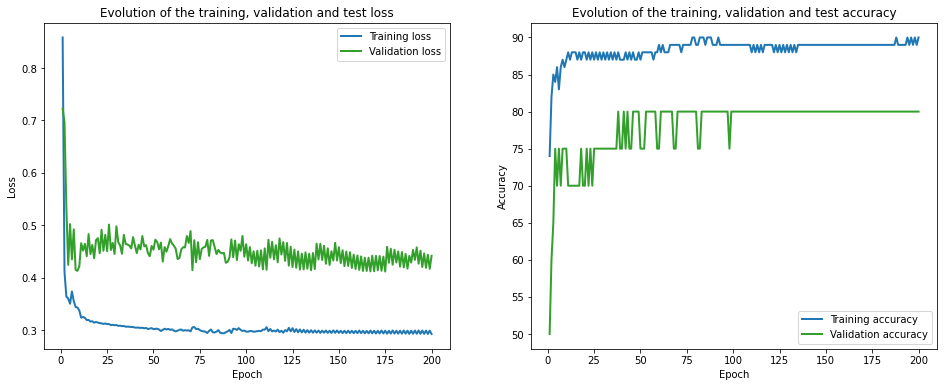

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 157.41it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1124.78it/s]

Finished computing p-values for 500 test points.

Starting repetition 18 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 1.12 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 0.61 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 1.05 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 1.12 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 5.40 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 4.62 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.29 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.62 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.63 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.55 train_acc: 50.00% took: 0.00s
val_loss = 0.49 val_acc = 60.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.97 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.

Epoch 15 of 200, 60% 	 train_loss: 0.44 train_acc: 80.00% took: 0.01s
Epoch 15 of 200, 70% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 80% 	 train_loss: 0.81 train_acc: 50.00% took: 0.00s
Epoch 15 of 200, 90% 	 train_loss: 0.35 train_acc: 90.00% took: 0.01s
Epoch 15 of 200, 100% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
val_loss = 0.50 val_acc = 55.00%
Snapshot saved at epoch 15.
Epoch 16 of 200, 10% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 20% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 30% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 40% 	 train_loss: 0.69 train_acc: 60.00% took: 0.00s
Epoch 16 of 200, 50% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 60% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 70% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 80% 	 train_loss: 0.82 train_acc: 50.00% took: 0.00s
Epoch 16 of 200, 90% 	 trai

Epoch 30 of 200, 50% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 30 of 200, 60% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 30 of 200, 70% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 30 of 200, 80% 	 train_loss: 0.81 train_acc: 50.00% took: 0.00s
Epoch 30 of 200, 90% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 30 of 200, 100% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
val_loss = 0.47 val_acc = 70.00%
Snapshot saved at epoch 30.
Epoch 31 of 200, 10% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 31 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 40% 	 train_loss: 0.70 train_acc: 60.00% took: 0.00s
Epoch 31 of 200, 50% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 60% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 31 of 200, 70% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 80% 	 tra

val_loss = 0.49 val_acc = 70.00%
Snapshot saved at epoch 45.
Epoch 46 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.01s
Epoch 46 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 46 of 200, 30% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 46 of 200, 40% 	 train_loss: 0.69 train_acc: 60.00% took: 0.00s
Epoch 46 of 200, 50% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 46 of 200, 60% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 46 of 200, 70% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 46 of 200, 80% 	 train_loss: 0.79 train_acc: 50.00% took: 0.00s
Epoch 46 of 200, 90% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 46 of 200, 100% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
val_loss = 0.46 val_acc = 70.00%
Snapshot saved at epoch 46.
Epoch 47 of 200, 10% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 47 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 47 of 200, 30% 	 train_loss

Epoch 60 of 200, 70% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 60 of 200, 80% 	 train_loss: 0.80 train_acc: 50.00% took: 0.00s
Epoch 60 of 200, 90% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 60 of 200, 100% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
val_loss = 0.47 val_acc = 70.00%
Snapshot saved at epoch 60.
Epoch 61 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 61 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 61 of 200, 30% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 61 of 200, 40% 	 train_loss: 0.69 train_acc: 60.00% took: 0.00s
Epoch 61 of 200, 50% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 61 of 200, 60% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
Epoch 61 of 200, 70% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 61 of 200, 80% 	 train_loss: 0.84 train_acc: 50.00% took: 0.00s
Epoch 61 of 200, 90% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 61 of 200, 100% 	 tr

Epoch 75 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 75 of 200, 30% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 75 of 200, 40% 	 train_loss: 0.69 train_acc: 60.00% took: 0.00s
Epoch 75 of 200, 50% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 75 of 200, 60% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 75 of 200, 70% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 75 of 200, 80% 	 train_loss: 0.84 train_acc: 50.00% took: 0.00s
Epoch 75 of 200, 90% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 75 of 200, 100% 	 train_loss: 0.48 train_acc: 70.00% took: 0.02s
val_loss = 0.49 val_acc = 70.00%
Snapshot saved at epoch 75.
Epoch 76 of 200, 10% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 76 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 76 of 200, 30% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 76 of 200, 40% 	 train_loss: 0.69 train_acc: 60.00% took: 0.02s
Epoch 76 of 200, 50% 	 tr

Epoch 90 of 200, 100% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
val_loss = 0.47 val_acc = 70.00%
Snapshot saved at epoch 90.
Epoch 91 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 91 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 91 of 200, 30% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 91 of 200, 40% 	 train_loss: 0.69 train_acc: 60.00% took: 0.00s
Epoch 91 of 200, 50% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 91 of 200, 60% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 91 of 200, 70% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 91 of 200, 80% 	 train_loss: 0.81 train_acc: 50.00% took: 0.00s
Epoch 91 of 200, 90% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 91 of 200, 100% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
val_loss = 0.47 val_acc = 70.00%
Snapshot saved at epoch 91.
Epoch 92 of 200, 10% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 92 of 200, 20% 	 train_loss

Epoch 105 of 200, 100% 	 train_loss: 0.50 train_acc: 70.00% took: 0.02s
val_loss = 0.47 val_acc = 70.00%
Snapshot saved at epoch 105.
Epoch 106 of 200, 10% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 106 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 106 of 200, 30% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 106 of 200, 40% 	 train_loss: 0.69 train_acc: 60.00% took: 0.00s
Epoch 106 of 200, 50% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 106 of 200, 60% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
Epoch 106 of 200, 70% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 106 of 200, 80% 	 train_loss: 0.81 train_acc: 50.00% took: 0.00s
Epoch 106 of 200, 90% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 106 of 200, 100% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
val_loss = 0.47 val_acc = 70.00%
Snapshot saved at epoch 106.
Epoch 107 of 200, 10% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 107 of 200, 2

Epoch 116 of 200, 60% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 116 of 200, 70% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 116 of 200, 80% 	 train_loss: 0.85 train_acc: 50.00% took: 0.00s
Epoch 116 of 200, 90% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 116 of 200, 100% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
val_loss = 0.49 val_acc = 70.00%
Snapshot saved at epoch 116.
Epoch 117 of 200, 10% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 117 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 117 of 200, 30% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 117 of 200, 40% 	 train_loss: 0.69 train_acc: 60.00% took: 0.00s
Epoch 117 of 200, 50% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 117 of 200, 60% 	 train_loss: 0.58 train_acc: 80.00% took: 0.00s
Epoch 117 of 200, 70% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 117 of 200, 80% 	 train_loss: 0.81 train_acc: 50.00% took: 0.00s
Epoch 117 o

val_loss = 0.47 val_acc = 70.00%
Snapshot saved at epoch 127.
Epoch 128 of 200, 10% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 128 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 128 of 200, 30% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 128 of 200, 40% 	 train_loss: 0.69 train_acc: 60.00% took: 0.00s
Epoch 128 of 200, 50% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 128 of 200, 60% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
Epoch 128 of 200, 70% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 128 of 200, 80% 	 train_loss: 0.85 train_acc: 50.00% took: 0.00s
Epoch 128 of 200, 90% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 128 of 200, 100% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
val_loss = 0.49 val_acc = 70.00%
Snapshot saved at epoch 128.
Epoch 129 of 200, 10% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 129 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 129 of 200, 30

Epoch 143 of 200, 90% 	 train_loss: 0.30 train_acc: 90.00% took: 0.02s
Epoch 143 of 200, 100% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
val_loss = 0.47 val_acc = 70.00%
Snapshot saved at epoch 143.
Epoch 144 of 200, 10% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 144 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 144 of 200, 30% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 144 of 200, 40% 	 train_loss: 0.69 train_acc: 60.00% took: 0.00s
Epoch 144 of 200, 50% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 144 of 200, 60% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
Epoch 144 of 200, 70% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 144 of 200, 80% 	 train_loss: 0.81 train_acc: 50.00% took: 0.00s
Epoch 144 of 200, 90% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 144 of 200, 100% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
val_loss = 0.47 val_acc = 70.00%
Snapshot saved at epoch 144.
Epoch 145 of 200, 10

Epoch 154 of 200, 70% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 154 of 200, 80% 	 train_loss: 0.81 train_acc: 50.00% took: 0.00s
Epoch 154 of 200, 90% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 154 of 200, 100% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
val_loss = 0.47 val_acc = 70.00%
Snapshot saved at epoch 154.
Epoch 155 of 200, 10% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 155 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 155 of 200, 30% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 155 of 200, 40% 	 train_loss: 0.69 train_acc: 60.00% took: 0.00s
Epoch 155 of 200, 50% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 155 of 200, 60% 	 train_loss: 0.58 train_acc: 80.00% took: 0.00s
Epoch 155 of 200, 70% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 155 of 200, 80% 	 train_loss: 0.81 train_acc: 50.00% took: 0.02s
Epoch 155 of 200, 90% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 155 of

Epoch 166 of 200, 100% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
val_loss = 0.47 val_acc = 70.00%
Snapshot saved at epoch 166.
Epoch 167 of 200, 10% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 167 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 167 of 200, 30% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 167 of 200, 40% 	 train_loss: 0.69 train_acc: 60.00% took: 0.00s
Epoch 167 of 200, 50% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 167 of 200, 60% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 167 of 200, 70% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 167 of 200, 80% 	 train_loss: 0.85 train_acc: 50.00% took: 0.00s
Epoch 167 of 200, 90% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 167 of 200, 100% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
val_loss = 0.49 val_acc = 70.00%
Snapshot saved at epoch 167.
Epoch 168 of 200, 10% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 168 of 200, 2

Epoch 181 of 200, 70% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 181 of 200, 80% 	 train_loss: 0.81 train_acc: 50.00% took: 0.00s
Epoch 181 of 200, 90% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 181 of 200, 100% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
val_loss = 0.48 val_acc = 70.00%
Snapshot saved at epoch 181.
Epoch 182 of 200, 10% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 182 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 182 of 200, 30% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 182 of 200, 40% 	 train_loss: 0.69 train_acc: 60.00% took: 0.00s
Epoch 182 of 200, 50% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 182 of 200, 60% 	 train_loss: 0.58 train_acc: 80.00% took: 0.00s
Epoch 182 of 200, 70% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 182 of 200, 80% 	 train_loss: 0.81 train_acc: 50.00% took: 0.00s
Epoch 182 of 200, 90% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 182 of

Epoch 192 of 200, 40% 	 train_loss: 0.69 train_acc: 60.00% took: 0.00s
Epoch 192 of 200, 50% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 192 of 200, 60% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 192 of 200, 70% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 192 of 200, 80% 	 train_loss: 0.85 train_acc: 50.00% took: 0.00s
Epoch 192 of 200, 90% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 192 of 200, 100% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
val_loss = 0.49 val_acc = 70.00%
Snapshot saved at epoch 192.
Epoch 193 of 200, 10% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 193 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 193 of 200, 30% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 193 of 200, 40% 	 train_loss: 0.69 train_acc: 60.00% took: 0.00s
Epoch 193 of 200, 50% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 193 of 200, 60% 	 train_loss: 0.58 train_acc: 80.00% took: 0.00s
Epoch 193 o

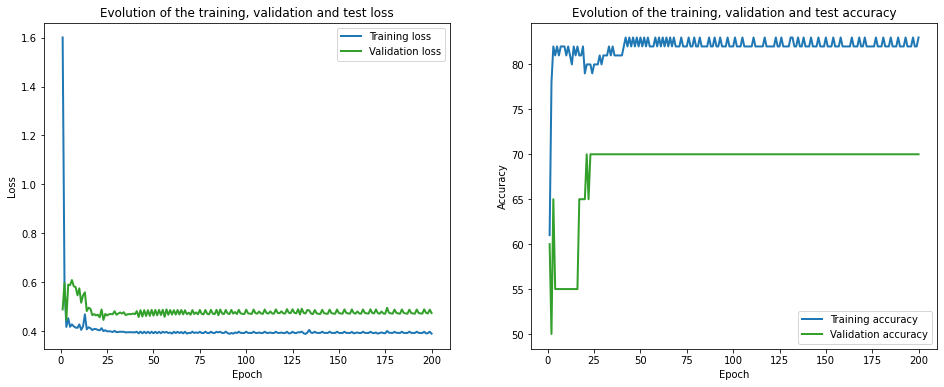

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 128.54it/s]


Initialization done!


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1327.37it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.71 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.95 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.68 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 2.84 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 1.44 train_acc: 20.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.24 train_acc: 90.00% took: 0.01s
Epoch 1 of 200, 80% 	 train_loss: 0.59 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.51 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
val_loss = 0.52 val_acc = 55.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.

Epoch 16 of 200, 50% 	 train_loss: 0.31 train_acc: 80.00% took: 0.02s
Epoch 16 of 200, 60% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 70% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 80% 	 train_loss: 0.81 train_acc: 50.00% took: 0.00s
Epoch 16 of 200, 90% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 100% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
val_loss = 0.48 val_acc = 65.00%
Snapshot saved at epoch 16.
Epoch 17 of 200, 10% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 20% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 30% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 40% 	 train_loss: 0.75 train_acc: 60.00% took: 0.00s
Epoch 17 of 200, 50% 	 train_loss: 0.26 train_acc: 100.00% took: 0.01s
Epoch 17 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 70% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 80% 	 trai

Epoch 31 of 200, 50% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 31 of 200, 60% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
Epoch 31 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 80% 	 train_loss: 0.68 train_acc: 50.00% took: 0.00s
Epoch 31 of 200, 90% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 100% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
val_loss = 0.43 val_acc = 70.00%
Snapshot saved at epoch 31.
Epoch 32 of 200, 10% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 32 of 200, 20% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 32 of 200, 30% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 32 of 200, 40% 	 train_loss: 0.82 train_acc: 60.00% took: 0.00s
Epoch 32 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 32 of 200, 60% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
Epoch 32 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 32 of 200, 80% 	 tr

Epoch 47 of 200, 80% 	 train_loss: 0.66 train_acc: 50.00% took: 0.00s
Epoch 47 of 200, 90% 	 train_loss: 0.33 train_acc: 90.00% took: 0.01s
Epoch 47 of 200, 100% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
val_loss = 0.45 val_acc = 70.00%
Snapshot saved at epoch 47.
Epoch 48 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 48 of 200, 20% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 48 of 200, 30% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 48 of 200, 40% 	 train_loss: 0.68 train_acc: 60.00% took: 0.00s
Epoch 48 of 200, 50% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 48 of 200, 60% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 48 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 48 of 200, 80% 	 train_loss: 0.66 train_acc: 50.00% took: 0.00s
Epoch 48 of 200, 90% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 48 of 200, 100% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
val_loss = 0.43 val_acc =

Epoch 63 of 200, 30% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 63 of 200, 40% 	 train_loss: 0.66 train_acc: 60.00% took: 0.00s
Epoch 63 of 200, 50% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 63 of 200, 60% 	 train_loss: 0.63 train_acc: 80.00% took: 0.00s
Epoch 63 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 63 of 200, 80% 	 train_loss: 0.57 train_acc: 60.00% took: 0.00s
Epoch 63 of 200, 90% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 63 of 200, 100% 	 train_loss: 0.48 train_acc: 90.00% took: 0.00s
val_loss = 0.43 val_acc = 70.00%
Snapshot saved at epoch 63.
Epoch 64 of 200, 10% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 64 of 200, 20% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 64 of 200, 30% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 64 of 200, 40% 	 train_loss: 0.82 train_acc: 60.00% took: 0.00s
Epoch 64 of 200, 50% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 64 of 200, 60% 	 tr

Epoch 77 of 200, 40% 	 train_loss: 0.75 train_acc: 60.00% took: 0.00s
Epoch 77 of 200, 50% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 77 of 200, 60% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 77 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 77 of 200, 80% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 77 of 200, 90% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 77 of 200, 100% 	 train_loss: 0.53 train_acc: 90.00% took: 0.00s
val_loss = 0.43 val_acc = 70.00%
Snapshot saved at epoch 77.
Epoch 78 of 200, 10% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 78 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 78 of 200, 30% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 78 of 200, 40% 	 train_loss: 0.57 train_acc: 60.00% took: 0.00s
Epoch 78 of 200, 50% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 78 of 200, 60% 	 train_loss: 0.67 train_acc: 80.00% took: 0.00s
Epoch 78 of 200, 70% 	 tr

Epoch 91 of 200, 90% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 91 of 200, 100% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
val_loss = 0.46 val_acc = 65.00%
Snapshot saved at epoch 91.
Epoch 92 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 92 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 92 of 200, 30% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 92 of 200, 40% 	 train_loss: 0.60 train_acc: 60.00% took: 0.00s
Epoch 92 of 200, 50% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 92 of 200, 60% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 92 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 92 of 200, 80% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 92 of 200, 90% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 92 of 200, 100% 	 train_loss: 0.52 train_acc: 90.00% took: 0.00s
val_loss = 0.42 val_acc = 65.00%
Snapshot saved at epoch 92.
Epoch 93 of 200, 10% 	 train_loss:

Epoch 107 of 200, 10% 	 train_loss: 0.11 train_acc: 100.00% took: 0.01s
Epoch 107 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 107 of 200, 30% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 107 of 200, 40% 	 train_loss: 0.56 train_acc: 60.00% took: 0.00s
Epoch 107 of 200, 50% 	 train_loss: 0.17 train_acc: 100.00% took: 0.01s
Epoch 107 of 200, 60% 	 train_loss: 0.66 train_acc: 80.00% took: 0.00s
Epoch 107 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 107 of 200, 80% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 107 of 200, 90% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 107 of 200, 100% 	 train_loss: 0.54 train_acc: 90.00% took: 0.00s
val_loss = 0.46 val_acc = 65.00%
Snapshot saved at epoch 107.
Epoch 108 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 108 of 200, 20% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 108 of 200, 30% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 108 

Epoch 117 of 200, 100% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
val_loss = 0.41 val_acc = 65.00%
Snapshot saved at epoch 117.
Epoch 118 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 118 of 200, 20% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 118 of 200, 30% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 118 of 200, 40% 	 train_loss: 0.51 train_acc: 60.00% took: 0.00s
Epoch 118 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 118 of 200, 60% 	 train_loss: 0.79 train_acc: 80.00% took: 0.00s
Epoch 118 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 118 of 200, 80% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 118 of 200, 90% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 118 of 200, 100% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
val_loss = 0.47 val_acc = 65.00%
Snapshot saved at epoch 118.
Epoch 119 of 200, 10% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 119 of 200, 

Epoch 129 of 200, 60% 	 train_loss: 0.78 train_acc: 80.00% took: 0.00s
Epoch 129 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 129 of 200, 80% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 129 of 200, 90% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 129 of 200, 100% 	 train_loss: 0.55 train_acc: 90.00% took: 0.00s
val_loss = 0.48 val_acc = 65.00%
Snapshot saved at epoch 129.
Epoch 130 of 200, 10% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 130 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 130 of 200, 30% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 130 of 200, 40% 	 train_loss: 0.54 train_acc: 60.00% took: 0.00s
Epoch 130 of 200, 50% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 130 of 200, 60% 	 train_loss: 0.63 train_acc: 80.00% took: 0.00s
Epoch 130 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 130 of 200, 80% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 130 of

Epoch 144 of 200, 10% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 144 of 200, 20% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 144 of 200, 30% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 144 of 200, 40% 	 train_loss: 0.53 train_acc: 60.00% took: 0.00s
Epoch 144 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.02s
Epoch 144 of 200, 60% 	 train_loss: 0.66 train_acc: 80.00% took: 0.00s
Epoch 144 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 144 of 200, 80% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 144 of 200, 90% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 144 of 200, 100% 	 train_loss: 0.50 train_acc: 90.00% took: 0.02s
val_loss = 0.45 val_acc = 65.00%
Snapshot saved at epoch 144.
Epoch 145 of 200, 10% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 145 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 145 of 200, 30% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 145 

Epoch 159 of 200, 70% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 159 of 200, 80% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 159 of 200, 90% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 159 of 200, 100% 	 train_loss: 0.56 train_acc: 90.00% took: 0.00s
val_loss = 0.38 val_acc = 70.00%
Snapshot saved at epoch 159.
Epoch 160 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 160 of 200, 20% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 160 of 200, 30% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 160 of 200, 40% 	 train_loss: 0.54 train_acc: 60.00% took: 0.00s
Epoch 160 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 160 of 200, 60% 	 train_loss: 0.71 train_acc: 80.00% took: 0.00s
Epoch 160 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.02s
Epoch 160 of 200, 80% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 160 of 200, 90% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 160 o

Epoch 170 of 200, 40% 	 train_loss: 0.52 train_acc: 60.00% took: 0.00s
Epoch 170 of 200, 50% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 170 of 200, 60% 	 train_loss: 0.65 train_acc: 80.00% took: 0.01s
Epoch 170 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 170 of 200, 80% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 170 of 200, 90% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 170 of 200, 100% 	 train_loss: 0.55 train_acc: 90.00% took: 0.00s
val_loss = 0.47 val_acc = 65.00%
Snapshot saved at epoch 170.
Epoch 171 of 200, 10% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 171 of 200, 20% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 171 of 200, 30% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 171 of 200, 40% 	 train_loss: 0.53 train_acc: 60.00% took: 0.01s
Epoch 171 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 171 of 200, 60% 	 train_loss: 0.68 train_acc: 80.00% took: 0.00s
Epoch 171 o

Epoch 185 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.02s
Epoch 185 of 200, 30% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 185 of 200, 40% 	 train_loss: 0.53 train_acc: 60.00% took: 0.00s
Epoch 185 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 185 of 200, 60% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 185 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.02s
Epoch 185 of 200, 80% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 185 of 200, 90% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 185 of 200, 100% 	 train_loss: 0.55 train_acc: 90.00% took: 0.00s
val_loss = 0.43 val_acc = 65.00%
Snapshot saved at epoch 185.
Epoch 186 of 200, 10% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 186 of 200, 20% 	 train_loss: 0.31 train_acc: 90.00% took: 0.02s
Epoch 186 of 200, 30% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 186 of 200, 40% 	 train_loss: 0.52 train_acc: 60.00% took: 0.00s
Epoch 186 

Epoch 200 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.01s
Epoch 200 of 200, 60% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 200 of 200, 70% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 200 of 200, 80% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 200 of 200, 90% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 200 of 200, 100% 	 train_loss: 0.54 train_acc: 90.00% took: 0.00s
val_loss = 0.44 val_acc = 65.00%
Snapshot saved at epoch 200.
Training done! A list of 200 models saved.


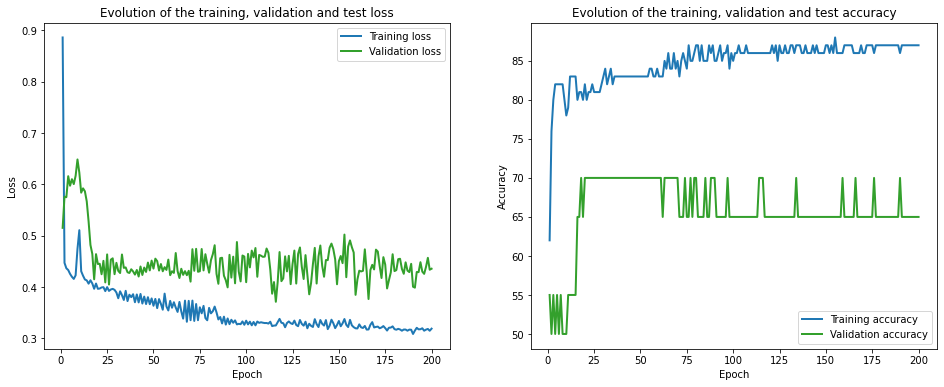

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 172.35it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1293.62it/s]

Finished computing p-values for 500 test points.

Starting repetition 19 of 50:



Training with standard data splitting...


C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.74 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 4.05 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 1.40 train_acc: 40.00% took: 0.02s
Epoch 1 of 200, 40% 	 train_loss: 0.78 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.15 train_acc: 90.00% took: 0.01s
Epoch 1 of 200, 90% 	 train_loss: 0.98 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.87 train_acc: 80.00% took: 0.00s
val_loss = 0.11 val_acc = 100.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 1.57 train_acc: 40.00% took: 0.02s
Epoch 2 of 200, 20% 	 train_loss: 0.64 train_acc: 50.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0

Epoch 15 of 200, 10% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 15 of 200, 20% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 30% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 40% 	 train_loss: 0.32 train_acc: 90.00% took: 0.02s
Epoch 15 of 200, 50% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 60% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 70% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 15 of 200, 80% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 15 of 200, 90% 	 train_loss: 0.52 train_acc: 90.00% took: 0.02s
Epoch 15 of 200, 100% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
val_loss = 0.33 val_acc = 90.00%
Snapshot saved at epoch 15.
Epoch 16 of 200, 10% 	 train_loss: 0.52 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 20% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 40% 	 tra

Epoch 26 of 200, 30% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 26 of 200, 40% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 26 of 200, 50% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 26 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 26 of 200, 70% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 26 of 200, 80% 	 train_loss: 0.26 train_acc: 80.00% took: 0.01s
Epoch 26 of 200, 90% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 26 of 200, 100% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
val_loss = 0.69 val_acc = 85.00%
Snapshot saved at epoch 26.
Epoch 27 of 200, 10% 	 train_loss: 0.24 train_acc: 90.00% took: 0.02s
Epoch 27 of 200, 20% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 40% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 50% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 60% 	 tr

Epoch 37 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 37 of 200, 70% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 37 of 200, 80% 	 train_loss: 0.27 train_acc: 80.00% took: 0.01s
Epoch 37 of 200, 90% 	 train_loss: 0.47 train_acc: 90.00% took: 0.00s
Epoch 37 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.01s
val_loss = 0.63 val_acc = 85.00%
Snapshot saved at epoch 37.
Epoch 38 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 30% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 40% 	 train_loss: 0.45 train_acc: 90.00% took: 0.01s
Epoch 38 of 200, 50% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 70% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 80% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 90% 	 t

Epoch 49 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 49 of 200, 70% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 49 of 200, 80% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 49 of 200, 90% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 49 of 200, 100% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
val_loss = 0.70 val_acc = 85.00%
Snapshot saved at epoch 49.
Epoch 50 of 200, 10% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 50 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 40% 	 train_loss: 0.43 train_acc: 90.00% took: 0.02s
Epoch 50 of 200, 50% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 50 of 200, 80% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 50 of 200, 90% 	 t

val_loss = 0.78 val_acc = 85.00%
Snapshot saved at epoch 64.
Epoch 65 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 65 of 200, 20% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 65 of 200, 30% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 65 of 200, 40% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 65 of 200, 50% 	 train_loss: 0.19 train_acc: 90.00% took: 0.02s
Epoch 65 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 65 of 200, 70% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 65 of 200, 80% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 65 of 200, 90% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 65 of 200, 100% 	 train_loss: 0.14 train_acc: 100.00% took: 0.02s
val_loss = 1.05 val_acc = 70.00%
Snapshot saved at epoch 65.
Epoch 66 of 200, 10% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 66 of 200, 20% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 66 of 200, 30% 	 train_loss

Epoch 76 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.02s
Epoch 76 of 200, 20% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 76 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 76 of 200, 40% 	 train_loss: 0.44 train_acc: 90.00% took: 0.00s
Epoch 76 of 200, 50% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 76 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.01s
Epoch 76 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 76 of 200, 80% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 76 of 200, 90% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 76 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 1.06 val_acc = 70.00%
Snapshot saved at epoch 76.
Epoch 77 of 200, 10% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 77 of 200, 20% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 77 of 200, 30% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 77 of 200, 40% 	 t

Epoch 91 of 200, 40% 	 train_loss: 0.44 train_acc: 90.00% took: 0.00s
Epoch 91 of 200, 50% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 91 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 91 of 200, 70% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 91 of 200, 80% 	 train_loss: 0.24 train_acc: 80.00% took: 0.01s
Epoch 91 of 200, 90% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 91 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 0.96 val_acc = 75.00%
Snapshot saved at epoch 91.
Epoch 92 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 92 of 200, 20% 	 train_loss: 0.14 train_acc: 100.00% took: 0.02s
Epoch 92 of 200, 30% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 92 of 200, 40% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 92 of 200, 50% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 92 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 92 of 200, 70% 	 tr

Epoch 102 of 200, 50% 	 train_loss: 0.16 train_acc: 100.00% took: 0.02s
Epoch 102 of 200, 60% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 102 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 102 of 200, 80% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 102 of 200, 90% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 102 of 200, 100% 	 train_loss: 0.14 train_acc: 100.00% took: 0.01s
val_loss = 0.78 val_acc = 75.00%
Snapshot saved at epoch 102.
Epoch 103 of 200, 10% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 103 of 200, 20% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 103 of 200, 30% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 103 of 200, 40% 	 train_loss: 0.46 train_acc: 90.00% took: 0.02s
Epoch 103 of 200, 50% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 103 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 103 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 10

Epoch 113 of 200, 60% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 113 of 200, 70% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 113 of 200, 80% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 113 of 200, 90% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 113 of 200, 100% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
val_loss = 1.27 val_acc = 75.00%
Snapshot saved at epoch 113.
Epoch 114 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 114 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 114 of 200, 30% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 114 of 200, 40% 	 train_loss: 0.45 train_acc: 90.00% took: 0.00s
Epoch 114 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.02s
Epoch 114 of 200, 60% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 114 of 200, 70% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 114 of 200, 80% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 114 

Epoch 124 of 200, 50% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 124 of 200, 60% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 124 of 200, 70% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 124 of 200, 80% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 124 of 200, 90% 	 train_loss: 0.47 train_acc: 90.00% took: 0.00s
Epoch 124 of 200, 100% 	 train_loss: 0.14 train_acc: 100.00% took: 0.02s
val_loss = 0.98 val_acc = 80.00%
Snapshot saved at epoch 124.
Epoch 125 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 125 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 125 of 200, 30% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 125 of 200, 40% 	 train_loss: 0.47 train_acc: 90.00% took: 0.00s
Epoch 125 of 200, 50% 	 train_loss: 0.17 train_acc: 100.00% took: 0.02s
Epoch 125 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 125 of 200, 70% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 12

val_loss = 0.76 val_acc = 85.00%
Snapshot saved at epoch 134.
Epoch 135 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 135 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 135 of 200, 30% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 135 of 200, 40% 	 train_loss: 0.49 train_acc: 90.00% took: 0.00s
Epoch 135 of 200, 50% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 135 of 200, 60% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 135 of 200, 70% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 135 of 200, 80% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 135 of 200, 90% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 135 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 0.74 val_acc = 90.00%
Snapshot saved at epoch 135.
Epoch 136 of 200, 10% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 136 of 200, 20% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 136 of 200, 

Epoch 150 of 200, 40% 	 train_loss: 0.48 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 50% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 70% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 150 of 200, 80% 	 train_loss: 0.33 train_acc: 70.00% took: 0.00s
Epoch 150 of 200, 90% 	 train_loss: 0.47 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.01s
val_loss = 0.62 val_acc = 85.00%
Snapshot saved at epoch 150.
Epoch 151 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 151 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 151 of 200, 30% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 151 of 200, 40% 	 train_loss: 0.49 train_acc: 90.00% took: 0.02s
Epoch 151 of 200, 50% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 151 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 151 

Epoch 165 of 200, 30% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 165 of 200, 40% 	 train_loss: 0.50 train_acc: 90.00% took: 0.00s
Epoch 165 of 200, 50% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 165 of 200, 60% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 165 of 200, 70% 	 train_loss: 0.07 train_acc: 100.00% took: 0.02s
Epoch 165 of 200, 80% 	 train_loss: 0.33 train_acc: 70.00% took: 0.00s
Epoch 165 of 200, 90% 	 train_loss: 0.47 train_acc: 90.00% took: 0.00s
Epoch 165 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 0.62 val_acc = 85.00%
Snapshot saved at epoch 165.
Epoch 166 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 166 of 200, 30% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 40% 	 train_loss: 0.49 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 50% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 166

Epoch 176 of 200, 30% 	 train_loss: 0.15 train_acc: 90.00% took: 0.02s
Epoch 176 of 200, 40% 	 train_loss: 0.52 train_acc: 90.00% took: 0.00s
Epoch 176 of 200, 50% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 176 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 176 of 200, 70% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 176 of 200, 80% 	 train_loss: 0.32 train_acc: 70.00% took: 0.02s
Epoch 176 of 200, 90% 	 train_loss: 0.49 train_acc: 90.00% took: 0.00s
Epoch 176 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 0.69 val_acc = 90.00%
Snapshot saved at epoch 176.
Epoch 177 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.02s
Epoch 177 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 177 of 200, 30% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 177 of 200, 40% 	 train_loss: 0.53 train_acc: 90.00% took: 0.00s
Epoch 177 of 200, 50% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 177

Epoch 191 of 200, 70% 	 train_loss: 0.07 train_acc: 100.00% took: 0.02s
Epoch 191 of 200, 80% 	 train_loss: 0.34 train_acc: 70.00% took: 0.00s
Epoch 191 of 200, 90% 	 train_loss: 0.51 train_acc: 90.00% took: 0.01s
Epoch 191 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.63 val_acc = 85.00%
Snapshot saved at epoch 191.
Epoch 192 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 192 of 200, 20% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 192 of 200, 30% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 192 of 200, 40% 	 train_loss: 0.51 train_acc: 90.00% took: 0.00s
Epoch 192 of 200, 50% 	 train_loss: 0.17 train_acc: 100.00% took: 0.02s
Epoch 192 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 192 of 200, 70% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 192 of 200, 80% 	 train_loss: 0.33 train_acc: 70.00% took: 0.00s
Epoch 192 of 200, 90% 	 train_loss: 0.45 train_acc: 90.00% took: 0.00s
Epoch 192

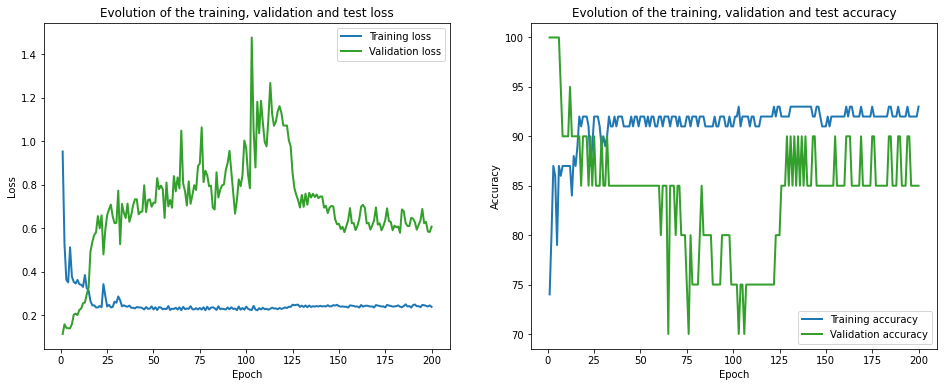

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 170.37it/s]


Initialization done!


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 986.80it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.78 train_acc: 50.00% took: 0.01s
Epoch 1 of 200, 20% 	 train_loss: 2.87 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 1.57 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.81 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.32 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.10 train_acc: 100.00% took: 0.02s
Epoch 1 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.63 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.70 train_acc: 80.00% took: 0.00s
val_loss = 0.14 val_acc = 100.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 2.05 train_acc: 40.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.63 train_acc: 60.00% took: 0.02s
Epoch 2 of 200, 30% 	 train_loss:

Epoch 16 of 200, 40% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 50% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 60% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 70% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 80% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 90% 	 train_loss: 0.49 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 100% 	 train_loss: 0.16 train_acc: 90.00% took: 0.02s
val_loss = 0.54 val_acc = 90.00%
Snapshot saved at epoch 16.
Epoch 17 of 200, 10% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 20% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.02s
Epoch 17 of 200, 40% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 50% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 70% 	 tra

Epoch 27 of 200, 40% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 50% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 70% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 80% 	 train_loss: 0.25 train_acc: 80.00% took: 0.02s
Epoch 27 of 200, 90% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 100% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
val_loss = 0.78 val_acc = 85.00%
Snapshot saved at epoch 27.
Epoch 28 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 20% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 30% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 40% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 50% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 70% 	 tr

Epoch 38 of 200, 50% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 80% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 90% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 100% 	 train_loss: 0.13 train_acc: 100.00% took: 0.02s
val_loss = 0.74 val_acc = 85.00%
Snapshot saved at epoch 38.
Epoch 39 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 39 of 200, 20% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 39 of 200, 30% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 39 of 200, 40% 	 train_loss: 0.43 train_acc: 90.00% took: 0.02s
Epoch 39 of 200, 50% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 39 of 200, 60% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 39 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 39 of 200, 80% 	 t

Epoch 49 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 49 of 200, 80% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 49 of 200, 90% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 49 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 0.78 val_acc = 85.00%
Snapshot saved at epoch 49.
Epoch 50 of 200, 10% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 20% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 50 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 40% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 50% 	 train_loss: 0.22 train_acc: 90.00% took: 0.02s
Epoch 50 of 200, 60% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 70% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 50 of 200, 80% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 50 of 200, 90% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 100% 	 

Epoch 63 of 200, 10% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 63 of 200, 20% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 63 of 200, 30% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 63 of 200, 40% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 63 of 200, 50% 	 train_loss: 0.17 train_acc: 100.00% took: 0.02s
Epoch 63 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 63 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 63 of 200, 80% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 63 of 200, 90% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 63 of 200, 100% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
val_loss = 0.76 val_acc = 85.00%
Snapshot saved at epoch 63.
Epoch 64 of 200, 10% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 64 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 64 of 200, 30% 	 train_loss: 0.25 train_acc: 80.00% took: 0.01s
Epoch 64 of 200, 40% 	 

val_loss = 0.83 val_acc = 80.00%
Snapshot saved at epoch 77.
Epoch 78 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 78 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 78 of 200, 30% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 78 of 200, 40% 	 train_loss: 0.46 train_acc: 90.00% took: 0.02s
Epoch 78 of 200, 50% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 78 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 78 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 78 of 200, 80% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 78 of 200, 90% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 78 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.02s
val_loss = 0.82 val_acc = 80.00%
Snapshot saved at epoch 78.
Epoch 79 of 200, 10% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 79 of 200, 20% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 79 of 200, 30% 	 train_loss

Epoch 88 of 200, 100% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
val_loss = 0.99 val_acc = 75.00%
Snapshot saved at epoch 88.
Epoch 89 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 20% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 89 of 200, 30% 	 train_loss: 0.20 train_acc: 90.00% took: 0.02s
Epoch 89 of 200, 40% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 50% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 70% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 89 of 200, 80% 	 train_loss: 0.26 train_acc: 80.00% took: 0.02s
Epoch 89 of 200, 90% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 1.12 val_acc = 75.00%
Snapshot saved at epoch 89.
Epoch 90 of 200, 10% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 90 of 200, 20% 	 train_los

Epoch 99 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 1.10 val_acc = 80.00%
Snapshot saved at epoch 99.
Epoch 100 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 100 of 200, 30% 	 train_loss: 0.27 train_acc: 80.00% took: 0.02s
Epoch 100 of 200, 40% 	 train_loss: 0.45 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 60% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 100 of 200, 80% 	 train_loss: 0.25 train_acc: 80.00% took: 0.02s
Epoch 100 of 200, 90% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 1.02 val_acc = 80.00%
Snapshot saved at epoch 100.
Epoch 101 of 200, 10% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 20

Epoch 110 of 200, 50% 	 train_loss: 0.16 train_acc: 100.00% took: 0.02s
Epoch 110 of 200, 60% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 110 of 200, 70% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 110 of 200, 80% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 110 of 200, 90% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 110 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 0.99 val_acc = 75.00%
Snapshot saved at epoch 110.
Epoch 111 of 200, 10% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 20% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 30% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 40% 	 train_loss: 0.48 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 50% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 60% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 70% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 11

Epoch 124 of 200, 90% 	 train_loss: 0.44 train_acc: 90.00% took: 0.00s
Epoch 124 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.55 val_acc = 90.00%
Snapshot saved at epoch 124.
Epoch 125 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.02s
Epoch 125 of 200, 20% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 125 of 200, 30% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 125 of 200, 40% 	 train_loss: 0.49 train_acc: 90.00% took: 0.00s
Epoch 125 of 200, 50% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 125 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 125 of 200, 70% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 125 of 200, 80% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 125 of 200, 90% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 125 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 0.62 val_acc = 90.00%
Snapshot saved at epoch 125.
Epoch 126 of 200,

Epoch 136 of 200, 20% 	 train_loss: 0.15 train_acc: 100.00% took: 0.02s
Epoch 136 of 200, 30% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 136 of 200, 40% 	 train_loss: 0.49 train_acc: 90.00% took: 0.00s
Epoch 136 of 200, 50% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 136 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.02s
Epoch 136 of 200, 70% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 136 of 200, 80% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 136 of 200, 90% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 136 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 0.65 val_acc = 90.00%
Snapshot saved at epoch 136.
Epoch 137 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 137 of 200, 20% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 137 of 200, 30% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 137 of 200, 40% 	 train_loss: 0.52 train_acc: 90.00% took: 0.00s
Epoch 137

Epoch 150 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 20% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 150 of 200, 30% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 40% 	 train_loss: 0.50 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 50% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 150 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 70% 	 train_loss: 0.08 train_acc: 100.00% took: 0.02s
Epoch 150 of 200, 80% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 150 of 200, 90% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 0.64 val_acc = 90.00%
Snapshot saved at epoch 150.
Epoch 151 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 151 of 200, 20% 	 train_loss: 0.15 train_acc: 100.00% took: 0.02s
Epoch 151 of 200, 30% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 151

Epoch 161 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 161 of 200, 30% 	 train_loss: 0.15 train_acc: 90.00% took: 0.01s
Epoch 161 of 200, 40% 	 train_loss: 0.51 train_acc: 90.00% took: 0.00s
Epoch 161 of 200, 50% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 161 of 200, 60% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 161 of 200, 70% 	 train_loss: 0.06 train_acc: 100.00% took: 0.01s
Epoch 161 of 200, 80% 	 train_loss: 0.33 train_acc: 70.00% took: 0.00s
Epoch 161 of 200, 90% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 161 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.57 val_acc = 90.00%
Snapshot saved at epoch 161.
Epoch 162 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 162 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 162 of 200, 30% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 162 of 200, 40% 	 train_loss: 0.51 train_acc: 90.00% took: 0.00s
Epoch 162

Epoch 172 of 200, 40% 	 train_loss: 0.52 train_acc: 90.00% took: 0.02s
Epoch 172 of 200, 50% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 172 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 172 of 200, 70% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 172 of 200, 80% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 172 of 200, 90% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 172 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.02s
val_loss = 0.64 val_acc = 85.00%
Snapshot saved at epoch 172.
Epoch 173 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.01s
Epoch 173 of 200, 20% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 173 of 200, 30% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 173 of 200, 40% 	 train_loss: 0.52 train_acc: 90.00% took: 0.00s
Epoch 173 of 200, 50% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 173 of 200, 60% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 173

Epoch 183 of 200, 40% 	 train_loss: 0.53 train_acc: 90.00% took: 0.00s
Epoch 183 of 200, 50% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 183 of 200, 60% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 183 of 200, 70% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 183 of 200, 80% 	 train_loss: 0.33 train_acc: 70.00% took: 0.00s
Epoch 183 of 200, 90% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 183 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.56 val_acc = 90.00%
Snapshot saved at epoch 183.
Epoch 184 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 184 of 200, 20% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 184 of 200, 30% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 184 of 200, 40% 	 train_loss: 0.52 train_acc: 90.00% took: 0.00s
Epoch 184 of 200, 50% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 184 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 184

Epoch 194 of 200, 20% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 194 of 200, 30% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 194 of 200, 40% 	 train_loss: 0.53 train_acc: 90.00% took: 0.00s
Epoch 194 of 200, 50% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 194 of 200, 60% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 194 of 200, 70% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 194 of 200, 80% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
Epoch 194 of 200, 90% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 194 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.58 val_acc = 85.00%
Snapshot saved at epoch 194.
Epoch 195 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 195 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 195 of 200, 30% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 195 of 200, 40% 	 train_loss: 0.53 train_acc: 90.00% took: 0.00s
Epoch 195

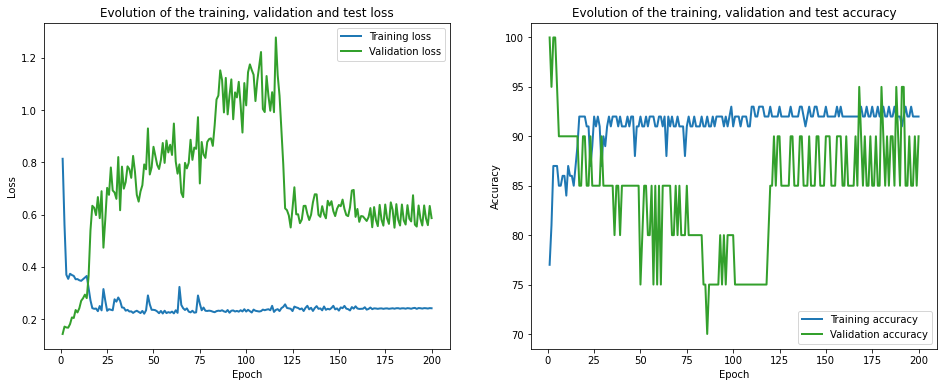

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 167.73it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1098.27it/s]

Finished computing p-values for 500 test points.

Starting repetition 20 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.98 train_acc: 20.00% took: 0.01s
Epoch 1 of 200, 20% 	 train_loss: 1.14 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.68 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 2.23 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.60 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
val_loss = 0.64 val_acc = 70.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.

val_loss = 0.52 val_acc = 70.00%
Snapshot saved at epoch 14.
Epoch 15 of 200, 10% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 20% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 30% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 15 of 200, 40% 	 train_loss: 0.20 train_acc: 90.00% took: 0.02s
Epoch 15 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 15 of 200, 60% 	 train_loss: 0.66 train_acc: 70.00% took: 0.00s
Epoch 15 of 200, 70% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 80% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 90% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 15 of 200, 100% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
val_loss = 0.54 val_acc = 70.00%
Snapshot saved at epoch 15.
Epoch 16 of 200, 10% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 20% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 30% 	 train_loss: 

Epoch 30 of 200, 60% 	 train_loss: 0.73 train_acc: 70.00% took: 0.00s
Epoch 30 of 200, 70% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 30 of 200, 80% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 30 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 30 of 200, 100% 	 train_loss: 0.19 train_acc: 90.00% took: 0.02s
val_loss = 0.55 val_acc = 70.00%
Snapshot saved at epoch 30.
Epoch 31 of 200, 10% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 20% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 30% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 31 of 200, 40% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 50% 	 train_loss: 0.09 train_acc: 100.00% took: 0.02s
Epoch 31 of 200, 60% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 31 of 200, 70% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 80% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 90% 	 tra

Epoch 46 of 200, 70% 	 train_loss: 0.28 train_acc: 90.00% took: 0.02s
Epoch 46 of 200, 80% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 46 of 200, 90% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 46 of 200, 100% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
val_loss = 0.58 val_acc = 70.00%
Snapshot saved at epoch 46.
Epoch 47 of 200, 10% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 47 of 200, 20% 	 train_loss: 0.16 train_acc: 90.00% took: 0.02s
Epoch 47 of 200, 30% 	 train_loss: 0.52 train_acc: 70.00% took: 0.00s
Epoch 47 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 47 of 200, 50% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 47 of 200, 60% 	 train_loss: 0.73 train_acc: 70.00% took: 0.00s
Epoch 47 of 200, 70% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 47 of 200, 80% 	 train_loss: 0.39 train_acc: 80.00% took: 0.02s
Epoch 47 of 200, 90% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 47 of 200, 100% 	 t

Epoch 57 of 200, 60% 	 train_loss: 0.73 train_acc: 70.00% took: 0.00s
Epoch 57 of 200, 70% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 80% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 90% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 57 of 200, 100% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
val_loss = 0.56 val_acc = 70.00%
Snapshot saved at epoch 57.
Epoch 58 of 200, 10% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 20% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 30% 	 train_loss: 0.52 train_acc: 70.00% took: 0.02s
Epoch 58 of 200, 40% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 50% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 58 of 200, 60% 	 train_loss: 0.72 train_acc: 70.00% took: 0.02s
Epoch 58 of 200, 70% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 80% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 90% 	 tra

Epoch 72 of 200, 20% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 72 of 200, 30% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 72 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 72 of 200, 50% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 72 of 200, 60% 	 train_loss: 0.78 train_acc: 70.00% took: 0.01s
Epoch 72 of 200, 70% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 72 of 200, 80% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 72 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 72 of 200, 100% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
val_loss = 0.61 val_acc = 65.00%
Snapshot saved at epoch 72.
Epoch 73 of 200, 10% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 73 of 200, 20% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 73 of 200, 30% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 73 of 200, 40% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 73 of 200, 50% 	 tr

Epoch 87 of 200, 50% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 87 of 200, 60% 	 train_loss: 0.77 train_acc: 70.00% took: 0.00s
Epoch 87 of 200, 70% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 87 of 200, 80% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 87 of 200, 90% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 87 of 200, 100% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
val_loss = 0.61 val_acc = 65.00%
Snapshot saved at epoch 87.
Epoch 88 of 200, 10% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 88 of 200, 20% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 88 of 200, 30% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 88 of 200, 40% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 88 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 88 of 200, 60% 	 train_loss: 0.58 train_acc: 80.00% took: 0.00s
Epoch 88 of 200, 70% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 88 of 200, 80% 	 t

Epoch 100 of 200, 20% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 30% 	 train_loss: 0.52 train_acc: 70.00% took: 0.00s
Epoch 100 of 200, 40% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 100 of 200, 60% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 70% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 80% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 90% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 100 of 200, 100% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
val_loss = 0.70 val_acc = 65.00%
Snapshot saved at epoch 100.
Epoch 101 of 200, 10% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 101 of 200, 20% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 30% 	 train_loss: 0.52 train_acc: 70.00% took: 0.00s
Epoch 101 of 200, 40% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 101 o

Epoch 114 of 200, 60% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
Epoch 114 of 200, 70% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 114 of 200, 80% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 114 of 200, 90% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 114 of 200, 100% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
val_loss = 0.68 val_acc = 65.00%
Snapshot saved at epoch 114.
Epoch 115 of 200, 10% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 115 of 200, 20% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 115 of 200, 30% 	 train_loss: 0.52 train_acc: 70.00% took: 0.00s
Epoch 115 of 200, 40% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 115 of 200, 50% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 115 of 200, 60% 	 train_loss: 0.75 train_acc: 70.00% took: 0.00s
Epoch 115 of 200, 70% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 115 of 200, 80% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 115 o

Epoch 125 of 200, 30% 	 train_loss: 0.52 train_acc: 70.00% took: 0.00s
Epoch 125 of 200, 40% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 125 of 200, 50% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 125 of 200, 60% 	 train_loss: 0.77 train_acc: 80.00% took: 0.00s
Epoch 125 of 200, 70% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 125 of 200, 80% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 125 of 200, 90% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 125 of 200, 100% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
val_loss = 0.59 val_acc = 65.00%
Snapshot saved at epoch 125.
Epoch 126 of 200, 10% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 126 of 200, 20% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 126 of 200, 30% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 126 of 200, 40% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 126 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 126 

Epoch 139 of 200, 90% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 139 of 200, 100% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
val_loss = 0.59 val_acc = 65.00%
Snapshot saved at epoch 139.
Epoch 140 of 200, 10% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 140 of 200, 20% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 140 of 200, 30% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 140 of 200, 40% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 140 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 140 of 200, 60% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
Epoch 140 of 200, 70% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 140 of 200, 80% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 140 of 200, 90% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 140 of 200, 100% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
val_loss = 0.69 val_acc = 70.00%
Snapshot saved at epoch 140.
Epoch 141 of 200, 

Epoch 155 of 200, 10% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 155 of 200, 20% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 155 of 200, 30% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 155 of 200, 40% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 155 of 200, 50% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 155 of 200, 60% 	 train_loss: 0.66 train_acc: 80.00% took: 0.00s
Epoch 155 of 200, 70% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 155 of 200, 80% 	 train_loss: 0.34 train_acc: 80.00% took: 0.02s
Epoch 155 of 200, 90% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 155 of 200, 100% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
val_loss = 0.64 val_acc = 65.00%
Snapshot saved at epoch 155.
Epoch 156 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 156 of 200, 20% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 156 of 200, 30% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 156 o

Epoch 165 of 200, 100% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
val_loss = 0.66 val_acc = 65.00%
Snapshot saved at epoch 165.
Epoch 166 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 20% 	 train_loss: 0.13 train_acc: 90.00% took: 0.02s
Epoch 166 of 200, 30% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 166 of 200, 40% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 166 of 200, 60% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 166 of 200, 70% 	 train_loss: 0.27 train_acc: 90.00% took: 0.02s
Epoch 166 of 200, 80% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 166 of 200, 90% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 166 of 200, 100% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
val_loss = 0.74 val_acc = 70.00%
Snapshot saved at epoch 166.
Epoch 167 of 200, 10% 	 train_loss: 0.21 train_acc: 100.00% took: 0.01s
Epoch 167 of 200, 2

Epoch 180 of 200, 10% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 180 of 200, 20% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 180 of 200, 30% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 180 of 200, 40% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 180 of 200, 50% 	 train_loss: 0.07 train_acc: 100.00% took: 0.01s
Epoch 180 of 200, 60% 	 train_loss: 0.65 train_acc: 80.00% took: 0.00s
Epoch 180 of 200, 70% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 180 of 200, 80% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 180 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 180 of 200, 100% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
val_loss = 0.71 val_acc = 65.00%
Snapshot saved at epoch 180.
Epoch 181 of 200, 10% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 181 of 200, 20% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 181 of 200, 30% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 181 o

val_loss = 0.72 val_acc = 65.00%
Snapshot saved at epoch 195.
Epoch 196 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 196 of 200, 20% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 196 of 200, 30% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 196 of 200, 40% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 196 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.01s
Epoch 196 of 200, 60% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 70% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 196 of 200, 80% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 90% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 196 of 200, 100% 	 train_loss: 0.23 train_acc: 80.00% took: 0.02s
val_loss = 0.85 val_acc = 70.00%
Snapshot saved at epoch 196.
Epoch 197 of 200, 10% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 197 of 200, 20% 	 train_loss: 0.12 train_acc: 90.00% took: 0.02s
Epoch 197 of 200, 30

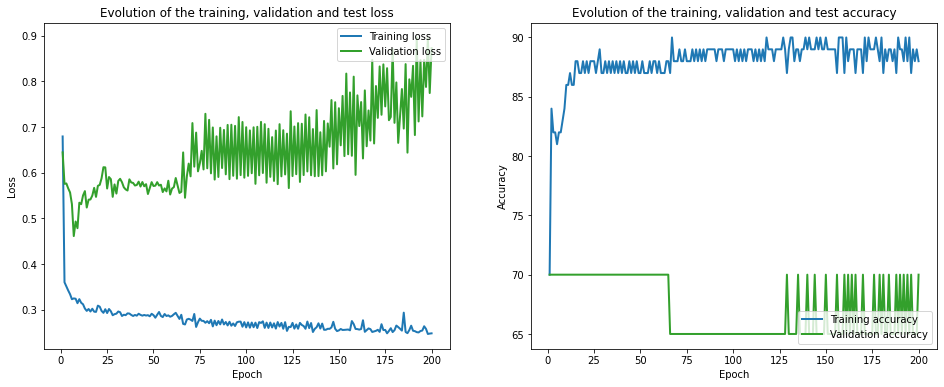

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 188.27it/s]


Initialization done!


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1081.27it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.77 train_acc: 30.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 1.61 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.22 train_acc: 100.00% took: 0.02s
Epoch 1 of 200, 60% 	 train_loss: 1.47 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 1.04 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.52 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.28 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.33 train_acc: 80.00% took: 0.02s
val_loss = 0.60 val_acc = 70.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0

Epoch 17 of 200, 10% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 20% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 30% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 17 of 200, 40% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 50% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 60% 	 train_loss: 0.69 train_acc: 70.00% took: 0.00s
Epoch 17 of 200, 70% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 80% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 90% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 100% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
val_loss = 0.50 val_acc = 70.00%
Snapshot saved at epoch 17.
Epoch 18 of 200, 10% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 18 of 200, 20% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 18 of 200, 30% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 18 of 200, 40% 	 tra

Epoch 32 of 200, 30% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 32 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 32 of 200, 50% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 32 of 200, 60% 	 train_loss: 0.68 train_acc: 70.00% took: 0.00s
Epoch 32 of 200, 70% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 32 of 200, 80% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 32 of 200, 90% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 32 of 200, 100% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
val_loss = 0.51 val_acc = 70.00%
Snapshot saved at epoch 32.
Epoch 33 of 200, 10% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 33 of 200, 20% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 33 of 200, 30% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 33 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 33 of 200, 50% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 33 of 200, 60% 	 tr

Epoch 43 of 200, 90% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 43 of 200, 100% 	 train_loss: 0.19 train_acc: 90.00% took: 0.01s
val_loss = 0.52 val_acc = 70.00%
Snapshot saved at epoch 43.
Epoch 44 of 200, 10% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 44 of 200, 20% 	 train_loss: 0.20 train_acc: 90.00% took: 0.01s
Epoch 44 of 200, 30% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 44 of 200, 40% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 44 of 200, 50% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 44 of 200, 60% 	 train_loss: 0.68 train_acc: 70.00% took: 0.01s
Epoch 44 of 200, 70% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 44 of 200, 80% 	 train_loss: 0.39 train_acc: 80.00% took: 0.01s
Epoch 44 of 200, 90% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 44 of 200, 100% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
val_loss = 0.49 val_acc = 70.00%
Snapshot saved at epoch 44.
Epoch 45 of 200, 10% 	 train_loss

Epoch 56 of 200, 70% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 56 of 200, 80% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 56 of 200, 90% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 56 of 200, 100% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
val_loss = 0.52 val_acc = 70.00%
Snapshot saved at epoch 56.
Epoch 57 of 200, 10% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 20% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 30% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 57 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 57 of 200, 60% 	 train_loss: 0.66 train_acc: 70.00% took: 0.00s
Epoch 57 of 200, 70% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 80% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 90% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 57 of 200, 100% 	 t

Epoch 72 of 200, 10% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 72 of 200, 20% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 72 of 200, 30% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 72 of 200, 40% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 72 of 200, 50% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 72 of 200, 60% 	 train_loss: 0.67 train_acc: 70.00% took: 0.00s
Epoch 72 of 200, 70% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 72 of 200, 80% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 72 of 200, 90% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 72 of 200, 100% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
val_loss = 0.49 val_acc = 70.00%
Snapshot saved at epoch 72.
Epoch 73 of 200, 10% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 73 of 200, 20% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 73 of 200, 30% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 73 of 200, 40% 	 tr

Epoch 82 of 200, 90% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 82 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 0.63 val_acc = 70.00%
Snapshot saved at epoch 82.
Epoch 83 of 200, 10% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 83 of 200, 20% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 83 of 200, 30% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 83 of 200, 40% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 83 of 200, 50% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 83 of 200, 60% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 83 of 200, 70% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 83 of 200, 80% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 83 of 200, 90% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 83 of 200, 100% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
val_loss = 0.57 val_acc = 70.00%
Snapshot saved at epoch 83.
Epoch 84 of 200, 10% 	 train_lo

Epoch 96 of 200, 10% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 96 of 200, 20% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 96 of 200, 30% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 96 of 200, 40% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 96 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 96 of 200, 60% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 96 of 200, 70% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 96 of 200, 80% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 96 of 200, 90% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 96 of 200, 100% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
val_loss = 0.64 val_acc = 70.00%
Snapshot saved at epoch 96.
Epoch 97 of 200, 10% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 97 of 200, 20% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 97 of 200, 30% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 97 of 200, 40% 	 tr

Epoch 110 of 200, 100% 	 train_loss: 0.23 train_acc: 90.00% took: 0.02s
val_loss = 0.61 val_acc = 70.00%
Snapshot saved at epoch 110.
Epoch 111 of 200, 10% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 20% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 30% 	 train_loss: 0.52 train_acc: 70.00% took: 0.02s
Epoch 111 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 50% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 60% 	 train_loss: 0.52 train_acc: 70.00% took: 0.00s
Epoch 111 of 200, 70% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 80% 	 train_loss: 0.37 train_acc: 80.00% took: 0.02s
Epoch 111 of 200, 90% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 100% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
val_loss = 0.55 val_acc = 75.00%
Snapshot saved at epoch 111.
Epoch 112 of 200, 10% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 112 of 200, 2

Epoch 121 of 200, 50% 	 train_loss: 0.05 train_acc: 100.00% took: 0.01s
Epoch 121 of 200, 60% 	 train_loss: 0.60 train_acc: 80.00% took: 0.01s
Epoch 121 of 200, 70% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 121 of 200, 80% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 121 of 200, 90% 	 train_loss: 0.07 train_acc: 100.00% took: 0.01s
Epoch 121 of 200, 100% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
val_loss = 0.62 val_acc = 70.00%
Snapshot saved at epoch 121.
Epoch 122 of 200, 10% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 122 of 200, 20% 	 train_loss: 0.12 train_acc: 90.00% took: 0.01s
Epoch 122 of 200, 30% 	 train_loss: 0.52 train_acc: 70.00% took: 0.00s
Epoch 122 of 200, 40% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 122 of 200, 50% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 122 of 200, 60% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 122 of 200, 70% 	 train_loss: 0.31 train_acc: 90.00% took: 0.02s
Epoch 122 

Epoch 132 of 200, 40% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 132 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 132 of 200, 60% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 132 of 200, 70% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 132 of 200, 80% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 132 of 200, 90% 	 train_loss: 0.05 train_acc: 100.00% took: 0.02s
Epoch 132 of 200, 100% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
val_loss = 0.65 val_acc = 65.00%
Snapshot saved at epoch 132.
Epoch 133 of 200, 10% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 133 of 200, 20% 	 train_loss: 0.11 train_acc: 90.00% took: 0.02s
Epoch 133 of 200, 30% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 133 of 200, 40% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 133 of 200, 50% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 133 of 200, 60% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 133 

Epoch 147 of 200, 90% 	 train_loss: 0.07 train_acc: 100.00% took: 0.02s
Epoch 147 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 0.66 val_acc = 65.00%
Snapshot saved at epoch 147.
Epoch 148 of 200, 10% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 148 of 200, 20% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 148 of 200, 30% 	 train_loss: 0.52 train_acc: 70.00% took: 0.01s
Epoch 148 of 200, 40% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 148 of 200, 50% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 148 of 200, 60% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 148 of 200, 70% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 148 of 200, 80% 	 train_loss: 0.47 train_acc: 80.00% took: 0.02s
Epoch 148 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 148 of 200, 100% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
val_loss = 0.66 val_acc = 65.00%
Snapshot saved at epoch 148.
Epoch 149 of 200,

Epoch 162 of 200, 20% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 162 of 200, 30% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 162 of 200, 40% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 162 of 200, 50% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 162 of 200, 60% 	 train_loss: 0.66 train_acc: 80.00% took: 0.00s
Epoch 162 of 200, 70% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 162 of 200, 80% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 162 of 200, 90% 	 train_loss: 0.06 train_acc: 100.00% took: 0.01s
Epoch 162 of 200, 100% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
val_loss = 0.59 val_acc = 65.00%
Snapshot saved at epoch 162.
Epoch 163 of 200, 10% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 163 of 200, 20% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 163 of 200, 30% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 163 of 200, 40% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 163 o

Epoch 177 of 200, 20% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 177 of 200, 30% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 177 of 200, 40% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 177 of 200, 50% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 177 of 200, 60% 	 train_loss: 0.64 train_acc: 70.00% took: 0.00s
Epoch 177 of 200, 70% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 177 of 200, 80% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 177 of 200, 90% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 177 of 200, 100% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
val_loss = 0.63 val_acc = 65.00%
Snapshot saved at epoch 177.
Epoch 178 of 200, 10% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 178 of 200, 20% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 30% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 178 of 200, 40% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 178 o

Epoch 191 of 200, 40% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 191 of 200, 50% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 191 of 200, 60% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 191 of 200, 70% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 191 of 200, 80% 	 train_loss: 0.37 train_acc: 80.00% took: 0.02s
Epoch 191 of 200, 90% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 191 of 200, 100% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
val_loss = 0.83 val_acc = 65.00%
Snapshot saved at epoch 191.
Epoch 192 of 200, 10% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 192 of 200, 20% 	 train_loss: 0.09 train_acc: 100.00% took: 0.02s
Epoch 192 of 200, 30% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 192 of 200, 40% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 192 of 200, 50% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 192 of 200, 60% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 192

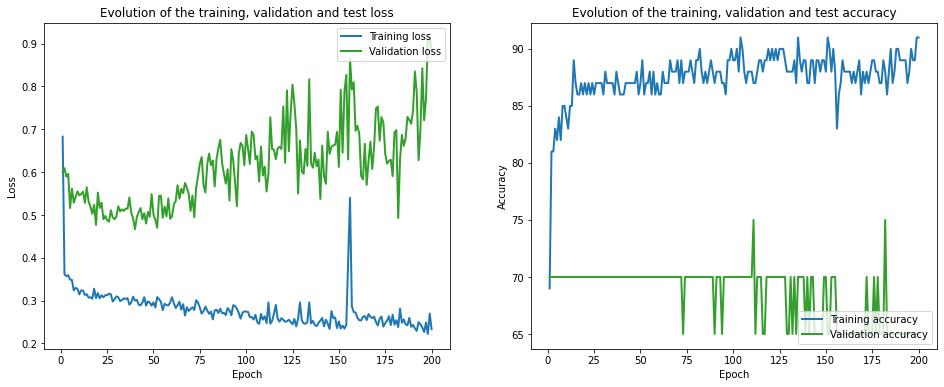

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 158.47it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1068.89it/s]

Finished computing p-values for 500 test points.

Starting repetition 21 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 1.43 train_acc: 60.00% took: 0.02s
Epoch 1 of 200, 30% 	 train_loss: 6.84 train_acc: 30.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.73 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 1.07 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 1.04 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 1.90 train_acc: 80.00% took: 0.02s
Epoch 1 of 200, 90% 	 train_loss: 1.38 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 1.01 train_acc: 30.00% took: 0.00s
val_loss = 0.32 val_acc = 80.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.17 train_acc: 90.00% took: 0.02s
Epoch 2 of 200, 30% 	 train_loss: 0.2

Epoch 12 of 200, 20% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 40% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 50% 	 train_loss: 0.55 train_acc: 60.00% took: 0.00s
Epoch 12 of 200, 60% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 70% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 80% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 90% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 12 of 200, 100% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
val_loss = 0.58 val_acc = 75.00%
Snapshot saved at epoch 12.
Epoch 13 of 200, 10% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 13 of 200, 20% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 13 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 13 of 200, 40% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 13 of 200, 50% 	 train

Epoch 23 of 200, 60% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 23 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 23 of 200, 80% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 23 of 200, 90% 	 train_loss: 0.40 train_acc: 60.00% took: 0.00s
Epoch 23 of 200, 100% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
val_loss = 0.42 val_acc = 80.00%
Snapshot saved at epoch 23.
Epoch 24 of 200, 10% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 24 of 200, 20% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 24 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 24 of 200, 40% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 24 of 200, 50% 	 train_loss: 0.59 train_acc: 60.00% took: 0.00s
Epoch 24 of 200, 60% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 24 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 24 of 200, 80% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 24 of 200, 90% 	 train

Epoch 35 of 200, 30% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 35 of 200, 40% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 35 of 200, 50% 	 train_loss: 0.53 train_acc: 60.00% took: 0.00s
Epoch 35 of 200, 60% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 35 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 35 of 200, 80% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 35 of 200, 90% 	 train_loss: 0.39 train_acc: 60.00% took: 0.00s
Epoch 35 of 200, 100% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
val_loss = 0.47 val_acc = 75.00%
Snapshot saved at epoch 35.
Epoch 36 of 200, 10% 	 train_loss: 0.19 train_acc: 80.00% took: 0.00s
Epoch 36 of 200, 20% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 36 of 200, 30% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 36 of 200, 40% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 36 of 200, 50% 	 train_loss: 0.55 train_acc: 60.00% took: 0.00s
Epoch 36 of 200, 60% 	 trai

Epoch 47 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 47 of 200, 20% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 47 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 47 of 200, 40% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 47 of 200, 50% 	 train_loss: 0.55 train_acc: 60.00% took: 0.02s
Epoch 47 of 200, 60% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 47 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 47 of 200, 80% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 47 of 200, 90% 	 train_loss: 0.38 train_acc: 70.00% took: 0.00s
Epoch 47 of 200, 100% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
val_loss = 0.41 val_acc = 80.00%
Snapshot saved at epoch 47.
Epoch 48 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 48 of 200, 20% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 48 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 48 of 200, 40% 	 tra

Epoch 58 of 200, 80% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 58 of 200, 90% 	 train_loss: 0.37 train_acc: 70.00% took: 0.00s
Epoch 58 of 200, 100% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
val_loss = 0.37 val_acc = 80.00%
Snapshot saved at epoch 58.
Epoch 59 of 200, 10% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 59 of 200, 20% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 59 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 59 of 200, 40% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 59 of 200, 50% 	 train_loss: 0.54 train_acc: 60.00% took: 0.00s
Epoch 59 of 200, 60% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 59 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 59 of 200, 80% 	 train_loss: 0.31 train_acc: 80.00% took: 0.02s
Epoch 59 of 200, 90% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
Epoch 59 of 200, 100% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
val_loss = 0.34 val_acc = 

Epoch 70 of 200, 10% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 70 of 200, 20% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 70 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 70 of 200, 40% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 70 of 200, 50% 	 train_loss: 0.55 train_acc: 60.00% took: 0.00s
Epoch 70 of 200, 60% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 70 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 70 of 200, 80% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 70 of 200, 90% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
Epoch 70 of 200, 100% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
val_loss = 0.33 val_acc = 85.00%
Snapshot saved at epoch 70.
Epoch 71 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 71 of 200, 20% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 71 of 200, 30% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 71 of 200, 40% 	 tra

Epoch 81 of 200, 10% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 81 of 200, 20% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 81 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 81 of 200, 40% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 81 of 200, 50% 	 train_loss: 0.55 train_acc: 60.00% took: 0.00s
Epoch 81 of 200, 60% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 81 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 81 of 200, 80% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 81 of 200, 90% 	 train_loss: 0.30 train_acc: 70.00% took: 0.00s
Epoch 81 of 200, 100% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
val_loss = 0.30 val_acc = 90.00%
Snapshot saved at epoch 81.
Epoch 82 of 200, 10% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 82 of 200, 20% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 82 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 82 of 200, 40% 	 tra

Epoch 93 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 93 of 200, 20% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 93 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 93 of 200, 40% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 93 of 200, 50% 	 train_loss: 0.53 train_acc: 60.00% took: 0.02s
Epoch 93 of 200, 60% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 93 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 93 of 200, 80% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 93 of 200, 90% 	 train_loss: 0.30 train_acc: 70.00% took: 0.00s
Epoch 93 of 200, 100% 	 train_loss: 0.16 train_acc: 90.00% took: 0.02s
val_loss = 0.30 val_acc = 90.00%
Snapshot saved at epoch 93.
Epoch 94 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 94 of 200, 20% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 94 of 200, 30% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 94 of 200, 40% 	 tra

Epoch 104 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 104 of 200, 20% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 104 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 104 of 200, 40% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 104 of 200, 50% 	 train_loss: 0.53 train_acc: 60.00% took: 0.00s
Epoch 104 of 200, 60% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 104 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 104 of 200, 80% 	 train_loss: 0.31 train_acc: 70.00% took: 0.00s
Epoch 104 of 200, 90% 	 train_loss: 0.30 train_acc: 70.00% took: 0.00s
Epoch 104 of 200, 100% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
val_loss = 0.31 val_acc = 90.00%
Snapshot saved at epoch 104.
Epoch 105 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 105 of 200, 20% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 105 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 105 of

Epoch 115 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 115 of 200, 40% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 115 of 200, 50% 	 train_loss: 0.53 train_acc: 60.00% took: 0.00s
Epoch 115 of 200, 60% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 115 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 115 of 200, 80% 	 train_loss: 0.31 train_acc: 70.00% took: 0.02s
Epoch 115 of 200, 90% 	 train_loss: 0.33 train_acc: 70.00% took: 0.00s
Epoch 115 of 200, 100% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
val_loss = 0.31 val_acc = 90.00%
Snapshot saved at epoch 115.
Epoch 116 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 116 of 200, 20% 	 train_loss: 0.18 train_acc: 90.00% took: 0.02s
Epoch 116 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 116 of 200, 40% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 116 of 200, 50% 	 train_loss: 0.54 train_acc: 60.00% took: 0.00s
Epoch 116 of 

Epoch 126 of 200, 50% 	 train_loss: 0.51 train_acc: 60.00% took: 0.00s
Epoch 126 of 200, 60% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 126 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 126 of 200, 80% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 126 of 200, 90% 	 train_loss: 0.38 train_acc: 70.00% took: 0.02s
Epoch 126 of 200, 100% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
val_loss = 0.39 val_acc = 80.00%
Snapshot saved at epoch 126.
Epoch 127 of 200, 10% 	 train_loss: 0.17 train_acc: 80.00% took: 0.00s
Epoch 127 of 200, 20% 	 train_loss: 0.14 train_acc: 90.00% took: 0.02s
Epoch 127 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 127 of 200, 40% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 127 of 200, 50% 	 train_loss: 0.50 train_acc: 60.00% took: 0.00s
Epoch 127 of 200, 60% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 127 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 127 of 2

Epoch 137 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.02s
Epoch 137 of 200, 20% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 137 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 137 of 200, 40% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 137 of 200, 50% 	 train_loss: 0.53 train_acc: 60.00% took: 0.00s
Epoch 137 of 200, 60% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 137 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.02s
Epoch 137 of 200, 80% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 137 of 200, 90% 	 train_loss: 0.31 train_acc: 70.00% took: 0.00s
Epoch 137 of 200, 100% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
val_loss = 0.32 val_acc = 90.00%
Snapshot saved at epoch 137.
Epoch 138 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 138 of 200, 20% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 138 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 138 of

Epoch 147 of 200, 100% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
val_loss = 0.29 val_acc = 90.00%
Snapshot saved at epoch 147.
Epoch 148 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 148 of 200, 20% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 148 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 148 of 200, 40% 	 train_loss: 0.06 train_acc: 100.00% took: 0.01s
Epoch 148 of 200, 50% 	 train_loss: 0.51 train_acc: 60.00% took: 0.00s
Epoch 148 of 200, 60% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 148 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 148 of 200, 80% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
Epoch 148 of 200, 90% 	 train_loss: 0.31 train_acc: 70.00% took: 0.00s
Epoch 148 of 200, 100% 	 train_loss: 0.10 train_acc: 90.00% took: 0.02s
val_loss = 0.28 val_acc = 90.00%
Snapshot saved at epoch 148.
Epoch 149 of 200, 10% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 149 of 200, 2

Epoch 163 of 200, 40% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 163 of 200, 50% 	 train_loss: 0.52 train_acc: 60.00% took: 0.00s
Epoch 163 of 200, 60% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 163 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 163 of 200, 80% 	 train_loss: 0.34 train_acc: 70.00% took: 0.02s
Epoch 163 of 200, 90% 	 train_loss: 0.34 train_acc: 70.00% took: 0.00s
Epoch 163 of 200, 100% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
val_loss = 0.26 val_acc = 85.00%
Snapshot saved at epoch 163.
Epoch 164 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 164 of 200, 20% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 164 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.02s
Epoch 164 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 164 of 200, 50% 	 train_loss: 0.53 train_acc: 60.00% took: 0.00s
Epoch 164 of 200, 60% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 164 of 

Epoch 174 of 200, 100% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
val_loss = 0.31 val_acc = 85.00%
Snapshot saved at epoch 174.
Epoch 175 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 175 of 200, 20% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 175 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 175 of 200, 40% 	 train_loss: 0.14 train_acc: 90.00% took: 0.02s
Epoch 175 of 200, 50% 	 train_loss: 0.52 train_acc: 60.00% took: 0.00s
Epoch 175 of 200, 60% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 175 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 175 of 200, 80% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
Epoch 175 of 200, 90% 	 train_loss: 0.37 train_acc: 70.00% took: 0.00s
Epoch 175 of 200, 100% 	 train_loss: 0.13 train_acc: 90.00% took: 0.02s
val_loss = 0.35 val_acc = 85.00%
Snapshot saved at epoch 175.
Epoch 176 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 176 of 200, 20

Epoch 190 of 200, 50% 	 train_loss: 0.51 train_acc: 60.00% took: 0.00s
Epoch 190 of 200, 60% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 190 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 190 of 200, 80% 	 train_loss: 0.31 train_acc: 70.00% took: 0.00s
Epoch 190 of 200, 90% 	 train_loss: 0.30 train_acc: 70.00% took: 0.02s
Epoch 190 of 200, 100% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
val_loss = 0.26 val_acc = 95.00%
Snapshot saved at epoch 190.
Epoch 191 of 200, 10% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 191 of 200, 20% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 191 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.02s
Epoch 191 of 200, 40% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 191 of 200, 50% 	 train_loss: 0.53 train_acc: 60.00% took: 0.00s
Epoch 191 of 200, 60% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 191 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 191 of 

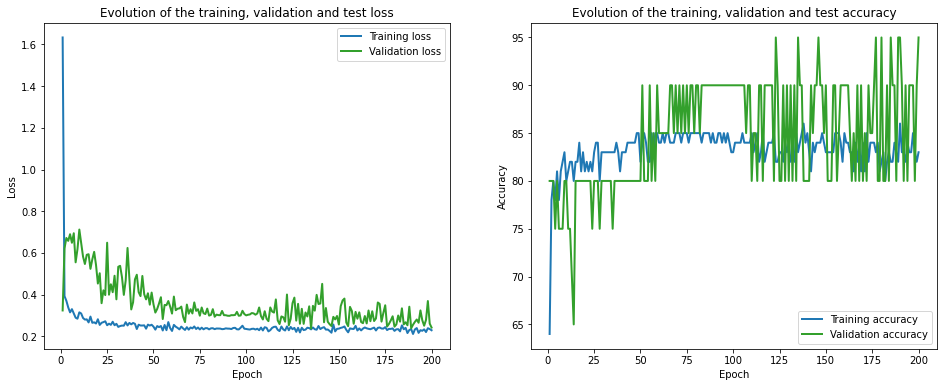

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 175.03it/s]


Initialization done!


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1287.88it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.56 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 1.42 train_acc: 60.00% took: 0.02s
Epoch 1 of 200, 30% 	 train_loss: 6.33 train_acc: 30.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 2.54 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 1.26 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.31 train_acc: 90.00% took: 0.02s
Epoch 1 of 200, 70% 	 train_loss: 0.78 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.67 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 5.49 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 1.14 train_acc: 30.00% took: 0.00s
val_loss = 0.30 val_acc = 80.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.2

val_loss = 0.59 val_acc = 80.00%
Snapshot saved at epoch 11.
Epoch 12 of 200, 10% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 20% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 30% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 40% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 50% 	 train_loss: 0.57 train_acc: 60.00% took: 0.00s
Epoch 12 of 200, 60% 	 train_loss: 0.17 train_acc: 90.00% took: 0.02s
Epoch 12 of 200, 70% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 80% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 90% 	 train_loss: 0.35 train_acc: 70.00% took: 0.00s
Epoch 12 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
val_loss = 0.57 val_acc = 80.00%
Snapshot saved at epoch 12.
Epoch 13 of 200, 10% 	 train_loss: 0.24 train_acc: 80.00% took: 0.02s
Epoch 13 of 200, 20% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 13 of 200, 30% 	 train_loss: 0.

Epoch 23 of 200, 20% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 23 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.01s
Epoch 23 of 200, 40% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 23 of 200, 50% 	 train_loss: 0.59 train_acc: 60.00% took: 0.00s
Epoch 23 of 200, 60% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 23 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 23 of 200, 80% 	 train_loss: 0.27 train_acc: 80.00% took: 0.01s
Epoch 23 of 200, 90% 	 train_loss: 0.31 train_acc: 70.00% took: 0.00s
Epoch 23 of 200, 100% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
val_loss = 0.53 val_acc = 80.00%
Snapshot saved at epoch 23.
Epoch 24 of 200, 10% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 24 of 200, 20% 	 train_loss: 0.23 train_acc: 90.00% took: 0.01s
Epoch 24 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 24 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 24 of 200, 50% 	 train

Epoch 34 of 200, 100% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
val_loss = 0.43 val_acc = 80.00%
Snapshot saved at epoch 34.
Epoch 35 of 200, 10% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 35 of 200, 20% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 35 of 200, 30% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 35 of 200, 40% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 35 of 200, 50% 	 train_loss: 0.55 train_acc: 60.00% took: 0.00s
Epoch 35 of 200, 60% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 35 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 35 of 200, 80% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 35 of 200, 90% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 35 of 200, 100% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
val_loss = 0.45 val_acc = 80.00%
Snapshot saved at epoch 35.
Epoch 36 of 200, 10% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 36 of 200, 20% 	 train_loss: 

Epoch 50 of 200, 50% 	 train_loss: 0.57 train_acc: 60.00% took: 0.00s
Epoch 50 of 200, 60% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 80% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 50 of 200, 90% 	 train_loss: 0.35 train_acc: 70.00% took: 0.00s
Epoch 50 of 200, 100% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
val_loss = 0.36 val_acc = 85.00%
Snapshot saved at epoch 50.
Epoch 51 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 51 of 200, 20% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 51 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 51 of 200, 40% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 51 of 200, 50% 	 train_loss: 0.53 train_acc: 60.00% took: 0.00s
Epoch 51 of 200, 60% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 51 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 51 of 200, 80% 	 trai

Epoch 62 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 62 of 200, 20% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 62 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 62 of 200, 40% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 62 of 200, 50% 	 train_loss: 0.53 train_acc: 60.00% took: 0.00s
Epoch 62 of 200, 60% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 62 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 62 of 200, 80% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
Epoch 62 of 200, 90% 	 train_loss: 0.31 train_acc: 70.00% took: 0.00s
Epoch 62 of 200, 100% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
val_loss = 0.32 val_acc = 90.00%
Snapshot saved at epoch 62.
Epoch 63 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 63 of 200, 20% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 63 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 63 of 200, 40% 	 tra

Epoch 73 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 73 of 200, 20% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 73 of 200, 30% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 73 of 200, 40% 	 train_loss: 0.12 train_acc: 90.00% took: 0.01s
Epoch 73 of 200, 50% 	 train_loss: 0.53 train_acc: 60.00% took: 0.00s
Epoch 73 of 200, 60% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 73 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 73 of 200, 80% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 73 of 200, 90% 	 train_loss: 0.31 train_acc: 70.00% took: 0.00s
Epoch 73 of 200, 100% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
val_loss = 0.36 val_acc = 90.00%
Snapshot saved at epoch 73.
Epoch 74 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 74 of 200, 20% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 74 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 74 of 200, 40% 	 tra

Epoch 88 of 200, 50% 	 train_loss: 0.54 train_acc: 60.00% took: 0.00s
Epoch 88 of 200, 60% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 88 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 88 of 200, 80% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 88 of 200, 90% 	 train_loss: 0.30 train_acc: 70.00% took: 0.01s
Epoch 88 of 200, 100% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
val_loss = 0.32 val_acc = 85.00%
Snapshot saved at epoch 88.
Epoch 89 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 89 of 200, 20% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 40% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 50% 	 train_loss: 0.53 train_acc: 60.00% took: 0.00s
Epoch 89 of 200, 60% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.02s
Epoch 89 of 200, 80% 	 trai

Epoch 100 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 100 of 200, 20% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 30% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 40% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 50% 	 train_loss: 0.54 train_acc: 60.00% took: 0.00s
Epoch 100 of 200, 60% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 80% 	 train_loss: 0.30 train_acc: 70.00% took: 0.00s
Epoch 100 of 200, 90% 	 train_loss: 0.27 train_acc: 70.00% took: 0.00s
Epoch 100 of 200, 100% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
val_loss = 0.35 val_acc = 85.00%
Snapshot saved at epoch 100.
Epoch 101 of 200, 10% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 101 of 200, 20% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 101 of

Epoch 111 of 200, 30% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 111 of 200, 40% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 50% 	 train_loss: 0.52 train_acc: 60.00% took: 0.00s
Epoch 111 of 200, 60% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 80% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
Epoch 111 of 200, 90% 	 train_loss: 0.28 train_acc: 70.00% took: 0.00s
Epoch 111 of 200, 100% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
val_loss = 0.34 val_acc = 85.00%
Snapshot saved at epoch 111.
Epoch 112 of 200, 10% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 112 of 200, 20% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 112 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 112 of 200, 40% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 112 of 200, 50% 	 train_loss: 0.54 train_acc: 60.00% took: 0.00s
Epoch 112 of 

Epoch 126 of 200, 30% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 126 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 126 of 200, 50% 	 train_loss: 0.54 train_acc: 60.00% took: 0.00s
Epoch 126 of 200, 60% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 126 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 126 of 200, 80% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 126 of 200, 90% 	 train_loss: 0.34 train_acc: 60.00% took: 0.00s
Epoch 126 of 200, 100% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
val_loss = 0.39 val_acc = 75.00%
Snapshot saved at epoch 126.
Epoch 127 of 200, 10% 	 train_loss: 0.15 train_acc: 80.00% took: 0.00s
Epoch 127 of 200, 20% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 127 of 200, 30% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 127 of 200, 40% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 127 of 200, 50% 	 train_loss: 0.51 train_acc: 60.00% took: 0.00s
Epoch 127 of 2

Epoch 142 of 200, 10% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 142 of 200, 20% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 142 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 142 of 200, 40% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 142 of 200, 50% 	 train_loss: 0.52 train_acc: 60.00% took: 0.02s
Epoch 142 of 200, 60% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 142 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 142 of 200, 80% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 142 of 200, 90% 	 train_loss: 0.31 train_acc: 70.00% took: 0.01s
Epoch 142 of 200, 100% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
val_loss = 0.35 val_acc = 80.00%
Snapshot saved at epoch 142.
Epoch 143 of 200, 10% 	 train_loss: 0.15 train_acc: 80.00% took: 0.00s
Epoch 143 of 200, 20% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 143 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 143 of 2

Epoch 153 of 200, 80% 	 train_loss: 0.34 train_acc: 70.00% took: 0.00s
Epoch 153 of 200, 90% 	 train_loss: 0.34 train_acc: 70.00% took: 0.00s
Epoch 153 of 200, 100% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
val_loss = 0.31 val_acc = 80.00%
Snapshot saved at epoch 153.
Epoch 154 of 200, 10% 	 train_loss: 0.15 train_acc: 80.00% took: 0.00s
Epoch 154 of 200, 20% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 154 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 154 of 200, 40% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 154 of 200, 50% 	 train_loss: 0.49 train_acc: 60.00% took: 0.00s
Epoch 154 of 200, 60% 	 train_loss: 0.22 train_acc: 80.00% took: 0.02s
Epoch 154 of 200, 70% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 154 of 200, 80% 	 train_loss: 0.33 train_acc: 70.00% took: 0.00s
Epoch 154 of 200, 90% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
Epoch 154 of 200, 100% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
val_loss = 0.

Epoch 164 of 200, 90% 	 train_loss: 0.30 train_acc: 70.00% took: 0.00s
Epoch 164 of 200, 100% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
val_loss = 0.34 val_acc = 85.00%
Snapshot saved at epoch 164.
Epoch 165 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.02s
Epoch 165 of 200, 20% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 165 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 165 of 200, 40% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 165 of 200, 50% 	 train_loss: 0.52 train_acc: 60.00% took: 0.00s
Epoch 165 of 200, 60% 	 train_loss: 0.20 train_acc: 90.00% took: 0.02s
Epoch 165 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 165 of 200, 80% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 165 of 200, 90% 	 train_loss: 0.29 train_acc: 70.00% took: 0.00s
Epoch 165 of 200, 100% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
val_loss = 0.38 val_acc = 80.00%
Snapshot saved at epoch 165.
Epoch 166 of 200, 10%

Epoch 179 of 200, 80% 	 train_loss: 0.28 train_acc: 70.00% took: 0.02s
Epoch 179 of 200, 90% 	 train_loss: 0.26 train_acc: 70.00% took: 0.00s
Epoch 179 of 200, 100% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
val_loss = 0.28 val_acc = 90.00%
Snapshot saved at epoch 179.
Epoch 180 of 200, 10% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 180 of 200, 20% 	 train_loss: 0.15 train_acc: 90.00% took: 0.02s
Epoch 180 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 180 of 200, 40% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 180 of 200, 50% 	 train_loss: 0.52 train_acc: 60.00% took: 0.00s
Epoch 180 of 200, 60% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 180 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.02s
Epoch 180 of 200, 80% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 180 of 200, 90% 	 train_loss: 0.30 train_acc: 70.00% took: 0.00s
Epoch 180 of 200, 100% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
val_loss = 

Epoch 194 of 200, 100% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
val_loss = 0.25 val_acc = 90.00%
Snapshot saved at epoch 194.
Epoch 195 of 200, 10% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 195 of 200, 20% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 195 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 195 of 200, 40% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 195 of 200, 50% 	 train_loss: 0.52 train_acc: 60.00% took: 0.00s
Epoch 195 of 200, 60% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 195 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 195 of 200, 80% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 195 of 200, 90% 	 train_loss: 0.27 train_acc: 70.00% took: 0.00s
Epoch 195 of 200, 100% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
val_loss = 0.26 val_acc = 90.00%
Snapshot saved at epoch 195.
Epoch 196 of 200, 10% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 196 of 200, 2

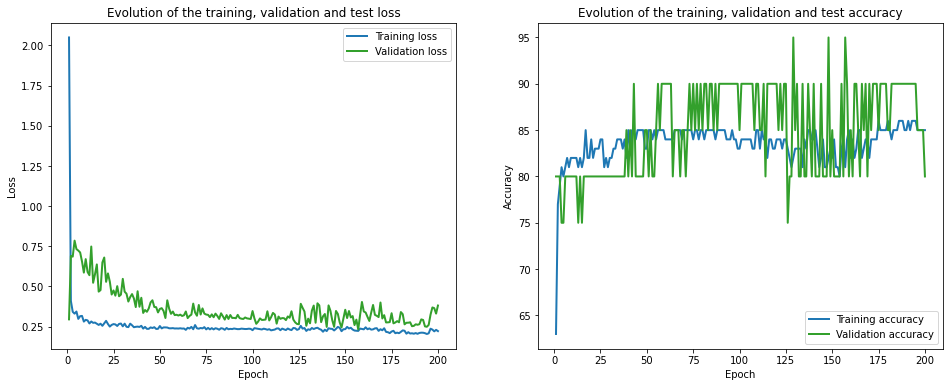

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 159.92it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1347.08it/s]

Finished computing p-values for 500 test points.

Starting repetition 22 of 50:




C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


Training with standard data splitting...
===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.62 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 0.48 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.87 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.29 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.19 train_acc: 100.00% took: 0.02s
Epoch 1 of 200, 60% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.66 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 1.54 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.82 train_acc: 40.00% took: 0.02s
Epoch 1 of 200, 100% 	 train_loss: 0.36 train_acc: 100.00% took: 0.00s
val_loss = 0.83 val_acc = 75.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.74 train_acc: 60.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.35 train_acc: 90.00% took:

Epoch 17 of 200, 10% 	 train_loss: 0.32 train_acc: 90.00% took: 0.01s
Epoch 17 of 200, 20% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 30% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 17 of 200, 40% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 50% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 60% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 17 of 200, 70% 	 train_loss: 0.56 train_acc: 70.00% took: 0.01s
Epoch 17 of 200, 80% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 17 of 200, 90% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.20 val_acc = 90.00%
Snapshot saved at epoch 17.
Epoch 18 of 200, 10% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 18 of 200, 20% 	 train_loss: 0.20 train_acc: 100.00% took: 0.02s
Epoch 18 of 200, 30% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 18 of 200, 40% 	 t

Epoch 29 of 200, 20% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 29 of 200, 30% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 29 of 200, 40% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 29 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 29 of 200, 60% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 29 of 200, 70% 	 train_loss: 0.61 train_acc: 80.00% took: 0.02s
Epoch 29 of 200, 80% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 29 of 200, 90% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 29 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 0.13 val_acc = 100.00%
Snapshot saved at epoch 29.
Epoch 30 of 200, 10% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 30 of 200, 20% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 30 of 200, 30% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 30 of 200, 40% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 30 of 200, 50% 	 t

Epoch 39 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.02s
val_loss = 0.11 val_acc = 95.00%
Snapshot saved at epoch 39.
Epoch 40 of 200, 10% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 40 of 200, 20% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 40 of 200, 30% 	 train_loss: 0.44 train_acc: 80.00% took: 0.02s
Epoch 40 of 200, 40% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 40 of 200, 50% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 40 of 200, 60% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 40 of 200, 70% 	 train_loss: 0.60 train_acc: 70.00% took: 0.00s
Epoch 40 of 200, 80% 	 train_loss: 0.51 train_acc: 60.00% took: 0.00s
Epoch 40 of 200, 90% 	 train_loss: 0.35 train_acc: 80.00% took: 0.02s
Epoch 40 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 0.10 val_acc = 100.00%
Snapshot saved at epoch 40.
Epoch 41 of 200, 10% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 41 of 200, 20% 	 train_loss

Epoch 51 of 200, 70% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 51 of 200, 80% 	 train_loss: 0.54 train_acc: 60.00% took: 0.00s
Epoch 51 of 200, 90% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 51 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 0.10 val_acc = 100.00%
Snapshot saved at epoch 51.
Epoch 52 of 200, 10% 	 train_loss: 0.45 train_acc: 80.00% took: 0.02s
Epoch 52 of 200, 20% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 52 of 200, 30% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 52 of 200, 40% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 52 of 200, 50% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 52 of 200, 60% 	 train_loss: 0.19 train_acc: 100.00% took: 0.02s
Epoch 52 of 200, 70% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 52 of 200, 80% 	 train_loss: 0.55 train_acc: 60.00% took: 0.00s
Epoch 52 of 200, 90% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 52 of 200, 100% 	 t

Epoch 62 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 0.12 val_acc = 95.00%
Snapshot saved at epoch 62.
Epoch 63 of 200, 10% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 63 of 200, 20% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 63 of 200, 30% 	 train_loss: 0.35 train_acc: 80.00% took: 0.02s
Epoch 63 of 200, 40% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 63 of 200, 50% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 63 of 200, 60% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 63 of 200, 70% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 63 of 200, 80% 	 train_loss: 0.55 train_acc: 60.00% took: 0.02s
Epoch 63 of 200, 90% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 63 of 200, 100% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
val_loss = 0.12 val_acc = 95.00%
Snapshot saved at epoch 63.
Epoch 64 of 200, 10% 	 train_loss: 0.47 train_acc: 80.00% took: 0.02s
Epoch 64 of 200, 20% 	 train_loss

Epoch 73 of 200, 100% 	 train_loss: 0.11 train_acc: 100.00% took: 0.02s
val_loss = 0.09 val_acc = 95.00%
Snapshot saved at epoch 73.
Epoch 74 of 200, 10% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 74 of 200, 20% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 74 of 200, 30% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 74 of 200, 40% 	 train_loss: 0.33 train_acc: 80.00% took: 0.02s
Epoch 74 of 200, 50% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 74 of 200, 60% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 74 of 200, 70% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 74 of 200, 80% 	 train_loss: 0.54 train_acc: 60.00% took: 0.00s
Epoch 74 of 200, 90% 	 train_loss: 0.23 train_acc: 90.00% took: 0.02s
Epoch 74 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 0.11 val_acc = 95.00%
Snapshot saved at epoch 74.
Epoch 75 of 200, 10% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 75 of 200, 20% 	 train_loss

Epoch 84 of 200, 90% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 84 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 0.10 val_acc = 95.00%
Snapshot saved at epoch 84.
Epoch 85 of 200, 10% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 85 of 200, 20% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 85 of 200, 30% 	 train_loss: 0.43 train_acc: 80.00% took: 0.02s
Epoch 85 of 200, 40% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 85 of 200, 50% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
Epoch 85 of 200, 60% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 85 of 200, 70% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 85 of 200, 80% 	 train_loss: 0.63 train_acc: 60.00% took: 0.00s
Epoch 85 of 200, 90% 	 train_loss: 0.31 train_acc: 70.00% took: 0.02s
Epoch 85 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.09 val_acc = 95.00%
Snapshot saved at epoch 85.
Epoch 86 of 200, 10% 	 train_loss

Epoch 95 of 200, 70% 	 train_loss: 0.32 train_acc: 80.00% took: 0.02s
Epoch 95 of 200, 80% 	 train_loss: 0.58 train_acc: 60.00% took: 0.00s
Epoch 95 of 200, 90% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 95 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 0.09 val_acc = 95.00%
Snapshot saved at epoch 95.
Epoch 96 of 200, 10% 	 train_loss: 0.51 train_acc: 80.00% took: 0.02s
Epoch 96 of 200, 20% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 96 of 200, 30% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 96 of 200, 40% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 96 of 200, 50% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 96 of 200, 60% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 96 of 200, 70% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 96 of 200, 80% 	 train_loss: 0.58 train_acc: 60.00% took: 0.02s
Epoch 96 of 200, 90% 	 train_loss: 0.33 train_acc: 70.00% took: 0.00s
Epoch 96 of 200, 100% 	 tr

Epoch 107 of 200, 90% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 107 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 0.09 val_acc = 95.00%
Snapshot saved at epoch 107.
Epoch 108 of 200, 10% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 108 of 200, 20% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 108 of 200, 30% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 108 of 200, 40% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 108 of 200, 50% 	 train_loss: 0.31 train_acc: 70.00% took: 0.00s
Epoch 108 of 200, 60% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 108 of 200, 70% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 108 of 200, 80% 	 train_loss: 0.73 train_acc: 50.00% took: 0.02s
Epoch 108 of 200, 90% 	 train_loss: 0.65 train_acc: 80.00% took: 0.00s
Epoch 108 of 200, 100% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
val_loss = 0.31 val_acc = 90.00%
Snapshot saved at epoch 108.
Epoch 109 of 200, 10

Epoch 118 of 200, 70% 	 train_loss: 0.27 train_acc: 80.00% took: 0.02s
Epoch 118 of 200, 80% 	 train_loss: 0.68 train_acc: 60.00% took: 0.00s
Epoch 118 of 200, 90% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 118 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.30 val_acc = 90.00%
Snapshot saved at epoch 118.
Epoch 119 of 200, 10% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 119 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.01s
Epoch 119 of 200, 30% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 119 of 200, 40% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 119 of 200, 50% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 119 of 200, 60% 	 train_loss: 0.27 train_acc: 90.00% took: 0.02s
Epoch 119 of 200, 70% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 119 of 200, 80% 	 train_loss: 0.98 train_acc: 50.00% took: 0.00s
Epoch 119 of 200, 90% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 119 of 

Epoch 130 of 200, 20% 	 train_loss: 0.25 train_acc: 80.00% took: 0.02s
Epoch 130 of 200, 30% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 130 of 200, 40% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 130 of 200, 50% 	 train_loss: 0.32 train_acc: 70.00% took: 0.01s
Epoch 130 of 200, 60% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 130 of 200, 70% 	 train_loss: 0.33 train_acc: 70.00% took: 0.00s
Epoch 130 of 200, 80% 	 train_loss: 0.89 train_acc: 60.00% took: 0.00s
Epoch 130 of 200, 90% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 130 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 0.10 val_acc = 95.00%
Snapshot saved at epoch 130.
Epoch 131 of 200, 10% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 131 of 200, 20% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 131 of 200, 30% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 131 of 200, 40% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 131 of 

Epoch 141 of 200, 10% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 141 of 200, 20% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 141 of 200, 30% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 141 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 141 of 200, 50% 	 train_loss: 0.27 train_acc: 80.00% took: 0.02s
Epoch 141 of 200, 60% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 141 of 200, 70% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
Epoch 141 of 200, 80% 	 train_loss: 0.47 train_acc: 60.00% took: 0.00s
Epoch 141 of 200, 90% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 141 of 200, 100% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
val_loss = 0.14 val_acc = 90.00%
Snapshot saved at epoch 141.
Epoch 142 of 200, 10% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 142 of 200, 20% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 142 of 200, 30% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 142 of

Epoch 151 of 200, 80% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 151 of 200, 90% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 151 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 0.17 val_acc = 90.00%
Snapshot saved at epoch 151.
Epoch 152 of 200, 10% 	 train_loss: 0.63 train_acc: 80.00% took: 0.00s
Epoch 152 of 200, 20% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 152 of 200, 30% 	 train_loss: 0.17 train_acc: 90.00% took: 0.01s
Epoch 152 of 200, 40% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 152 of 200, 50% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 152 of 200, 60% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 152 of 200, 70% 	 train_loss: 0.29 train_acc: 70.00% took: 0.00s
Epoch 152 of 200, 80% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 152 of 200, 90% 	 train_loss: 0.12 train_acc: 90.00% took: 0.01s
Epoch 152 of 200, 100% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
val_loss =

Epoch 162 of 200, 50% 	 train_loss: 0.34 train_acc: 70.00% took: 0.00s
Epoch 162 of 200, 60% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 162 of 200, 70% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 162 of 200, 80% 	 train_loss: 0.38 train_acc: 80.00% took: 0.01s
Epoch 162 of 200, 90% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 162 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 0.14 val_acc = 95.00%
Snapshot saved at epoch 162.
Epoch 163 of 200, 10% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 163 of 200, 20% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 163 of 200, 30% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 163 of 200, 40% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 163 of 200, 50% 	 train_loss: 0.28 train_acc: 70.00% took: 0.00s
Epoch 163 of 200, 60% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 163 of 200, 70% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 163 of 

Epoch 173 of 200, 40% 	 train_loss: 0.33 train_acc: 90.00% took: 0.01s
Epoch 173 of 200, 50% 	 train_loss: 0.36 train_acc: 60.00% took: 0.00s
Epoch 173 of 200, 60% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 173 of 200, 70% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 173 of 200, 80% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 173 of 200, 90% 	 train_loss: 0.21 train_acc: 80.00% took: 0.01s
Epoch 173 of 200, 100% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
val_loss = 0.14 val_acc = 95.00%
Snapshot saved at epoch 173.
Epoch 174 of 200, 10% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 174 of 200, 20% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 30% 	 train_loss: 0.52 train_acc: 80.00% took: 0.02s
Epoch 174 of 200, 40% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 50% 	 train_loss: 0.35 train_acc: 60.00% took: 0.00s
Epoch 174 of 200, 60% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 174 of 

Epoch 185 of 200, 10% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 185 of 200, 20% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 185 of 200, 30% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 185 of 200, 40% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 185 of 200, 50% 	 train_loss: 0.38 train_acc: 60.00% took: 0.02s
Epoch 185 of 200, 60% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 185 of 200, 70% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 185 of 200, 80% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 185 of 200, 90% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 185 of 200, 100% 	 train_loss: 0.19 train_acc: 100.00% took: 0.02s
val_loss = 0.15 val_acc = 95.00%
Snapshot saved at epoch 185.
Epoch 186 of 200, 10% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 186 of 200, 20% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 186 of 200, 30% 	 train_loss: 0.50 train_acc: 80.00% took: 0.02s
Epoch 186 of 

Epoch 195 of 200, 90% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 195 of 200, 100% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
val_loss = 0.15 val_acc = 95.00%
Snapshot saved at epoch 195.
Epoch 196 of 200, 10% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 20% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 196 of 200, 30% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 40% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 196 of 200, 50% 	 train_loss: 0.35 train_acc: 60.00% took: 0.00s
Epoch 196 of 200, 60% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 196 of 200, 70% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 196 of 200, 80% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 90% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 100% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
val_loss = 0.15 val_acc = 95.00%
Snapshot saved at epoch 196.
Epoch 197 of 200, 10

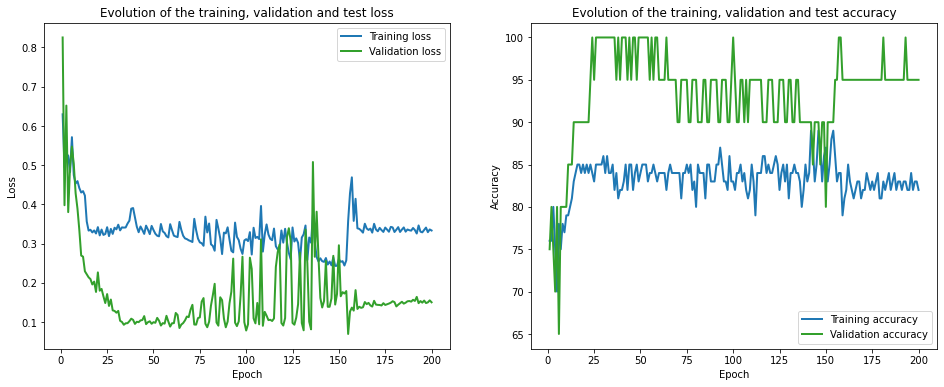

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 167.54it/s]


Initialization done!


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 986.02it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.63 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.95 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.35 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.26 train_acc: 100.00% took: 0.01s
Epoch 1 of 200, 60% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.88 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 1.48 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.78 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.35 train_acc: 100.00% took: 0.02s
val_loss = 0.84 val_acc = 75.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.79 train_acc: 60.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0

Epoch 12 of 200, 40% 	 train_loss: 0.29 train_acc: 90.00% took: 0.02s
Epoch 12 of 200, 50% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 60% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 70% 	 train_loss: 0.95 train_acc: 70.00% took: 0.00s
Epoch 12 of 200, 80% 	 train_loss: 0.63 train_acc: 60.00% took: 0.00s
Epoch 12 of 200, 90% 	 train_loss: 0.56 train_acc: 60.00% took: 0.00s
Epoch 12 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.01s
val_loss = 0.23 val_acc = 85.00%
Snapshot saved at epoch 12.
Epoch 13 of 200, 10% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 13 of 200, 20% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 13 of 200, 30% 	 train_loss: 0.39 train_acc: 80.00% took: 0.02s
Epoch 13 of 200, 40% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 13 of 200, 50% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 13 of 200, 60% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 13 of 200, 70% 	 trai

Epoch 27 of 200, 70% 	 train_loss: 0.58 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 80% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 27 of 200, 90% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 100% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
val_loss = 0.14 val_acc = 100.00%
Snapshot saved at epoch 27.
Epoch 28 of 200, 10% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 20% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 30% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 28 of 200, 40% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 50% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 60% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 70% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 80% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 28 of 200, 90% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 100% 	 t

Epoch 41 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 0.11 val_acc = 100.00%
Snapshot saved at epoch 41.
Epoch 42 of 200, 10% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 42 of 200, 20% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 42 of 200, 30% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 42 of 200, 40% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 42 of 200, 50% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 42 of 200, 60% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 42 of 200, 70% 	 train_loss: 0.64 train_acc: 80.00% took: 0.00s
Epoch 42 of 200, 80% 	 train_loss: 0.58 train_acc: 60.00% took: 0.00s
Epoch 42 of 200, 90% 	 train_loss: 0.60 train_acc: 70.00% took: 0.00s
Epoch 42 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.11 val_acc = 100.00%
Snapshot saved at epoch 42.
Epoch 43 of 200, 10% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 43 of 200, 20% 	 train_lo

val_loss = 0.10 val_acc = 100.00%
Snapshot saved at epoch 52.
Epoch 53 of 200, 10% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 53 of 200, 20% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 53 of 200, 30% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 53 of 200, 40% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 53 of 200, 50% 	 train_loss: 0.32 train_acc: 80.00% took: 0.02s
Epoch 53 of 200, 60% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 53 of 200, 70% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 53 of 200, 80% 	 train_loss: 0.50 train_acc: 60.00% took: 0.00s
Epoch 53 of 200, 90% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 53 of 200, 100% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
val_loss = 0.10 val_acc = 100.00%
Snapshot saved at epoch 53.
Epoch 54 of 200, 10% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 54 of 200, 20% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 54 of 200, 30% 	 train_lo

Epoch 67 of 200, 30% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 67 of 200, 40% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 67 of 200, 50% 	 train_loss: 0.38 train_acc: 70.00% took: 0.00s
Epoch 67 of 200, 60% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 67 of 200, 70% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 67 of 200, 80% 	 train_loss: 0.56 train_acc: 50.00% took: 0.00s
Epoch 67 of 200, 90% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 67 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 0.10 val_acc = 100.00%
Snapshot saved at epoch 67.
Epoch 68 of 200, 10% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 68 of 200, 20% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 68 of 200, 30% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 68 of 200, 40% 	 train_loss: 0.34 train_acc: 80.00% took: 0.02s
Epoch 68 of 200, 50% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 68 of 200, 60% 	 t

Epoch 83 of 200, 20% 	 train_loss: 0.25 train_acc: 100.00% took: 0.00s
Epoch 83 of 200, 30% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 83 of 200, 40% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 83 of 200, 50% 	 train_loss: 0.42 train_acc: 60.00% took: 0.00s
Epoch 83 of 200, 60% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 83 of 200, 70% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 83 of 200, 80% 	 train_loss: 0.52 train_acc: 60.00% took: 0.00s
Epoch 83 of 200, 90% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 83 of 200, 100% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
val_loss = 0.11 val_acc = 100.00%
Snapshot saved at epoch 83.
Epoch 84 of 200, 10% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 84 of 200, 20% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 84 of 200, 30% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 84 of 200, 40% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 84 of 200, 50% 	 

Epoch 94 of 200, 20% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 94 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 94 of 200, 40% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 94 of 200, 50% 	 train_loss: 0.33 train_acc: 70.00% took: 0.00s
Epoch 94 of 200, 60% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 94 of 200, 70% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 94 of 200, 80% 	 train_loss: 0.49 train_acc: 60.00% took: 0.00s
Epoch 94 of 200, 90% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 94 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.10 val_acc = 100.00%
Snapshot saved at epoch 94.
Epoch 95 of 200, 10% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 95 of 200, 20% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 95 of 200, 30% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 95 of 200, 40% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 95 of 200, 50% 	 

Epoch 105 of 200, 70% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 105 of 200, 80% 	 train_loss: 0.57 train_acc: 50.00% took: 0.00s
Epoch 105 of 200, 90% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 105 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.07 val_acc = 100.00%
Snapshot saved at epoch 105.
Epoch 106 of 200, 10% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 106 of 200, 20% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 106 of 200, 30% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 106 of 200, 40% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 106 of 200, 50% 	 train_loss: 0.43 train_acc: 60.00% took: 0.00s
Epoch 106 of 200, 60% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 106 of 200, 70% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 106 of 200, 80% 	 train_loss: 0.58 train_acc: 60.00% took: 0.00s
Epoch 106 of 200, 90% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 106 o

Epoch 118 of 200, 50% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 118 of 200, 60% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 118 of 200, 70% 	 train_loss: 0.25 train_acc: 70.00% took: 0.00s
Epoch 118 of 200, 80% 	 train_loss: 0.63 train_acc: 60.00% took: 0.00s
Epoch 118 of 200, 90% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 118 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 0.23 val_acc = 95.00%
Snapshot saved at epoch 118.
Epoch 119 of 200, 10% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 119 of 200, 20% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 119 of 200, 30% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 119 of 200, 40% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 119 of 200, 50% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 119 of 200, 60% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 119 of 200, 70% 	 train_loss: 0.27 train_acc: 70.00% took: 0.00s
Epoch 119 

Epoch 130 of 200, 60% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 130 of 200, 70% 	 train_loss: 0.27 train_acc: 70.00% took: 0.00s
Epoch 130 of 200, 80% 	 train_loss: 0.84 train_acc: 60.00% took: 0.00s
Epoch 130 of 200, 90% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 130 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 0.10 val_acc = 95.00%
Snapshot saved at epoch 130.
Epoch 131 of 200, 10% 	 train_loss: 0.63 train_acc: 80.00% took: 0.00s
Epoch 131 of 200, 20% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 131 of 200, 30% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
Epoch 131 of 200, 40% 	 train_loss: 0.36 train_acc: 60.00% took: 0.00s
Epoch 131 of 200, 50% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 131 of 200, 60% 	 train_loss: 0.44 train_acc: 90.00% took: 0.00s
Epoch 131 of 200, 70% 	 train_loss: 0.27 train_acc: 70.00% took: 0.00s
Epoch 131 of 200, 80% 	 train_loss: 0.54 train_acc: 60.00% took: 0.00s
Epoch 131 of 

Epoch 142 of 200, 80% 	 train_loss: 0.60 train_acc: 60.00% took: 0.00s
Epoch 142 of 200, 90% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 142 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 0.12 val_acc = 95.00%
Snapshot saved at epoch 142.
Epoch 143 of 200, 10% 	 train_loss: 0.53 train_acc: 80.00% took: 0.02s
Epoch 143 of 200, 20% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 143 of 200, 30% 	 train_loss: 0.20 train_acc: 90.00% took: 0.01s
Epoch 143 of 200, 40% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 143 of 200, 50% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
Epoch 143 of 200, 60% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 143 of 200, 70% 	 train_loss: 0.23 train_acc: 70.00% took: 0.00s
Epoch 143 of 200, 80% 	 train_loss: 0.64 train_acc: 70.00% took: 0.00s
Epoch 143 of 200, 90% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 143 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss =

Epoch 159 of 200, 20% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 159 of 200, 30% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 159 of 200, 40% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 159 of 200, 50% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 159 of 200, 60% 	 train_loss: 0.18 train_acc: 100.00% took: 0.02s
Epoch 159 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 159 of 200, 80% 	 train_loss: 0.64 train_acc: 60.00% took: 0.00s
Epoch 159 of 200, 90% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 159 of 200, 100% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
val_loss = 0.15 val_acc = 95.00%
Snapshot saved at epoch 159.
Epoch 160 of 200, 10% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 160 of 200, 20% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 160 of 200, 30% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 160 of 200, 40% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 160 of

Epoch 170 of 200, 10% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 170 of 200, 20% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 170 of 200, 30% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 170 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 170 of 200, 50% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 170 of 200, 60% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 170 of 200, 70% 	 train_loss: 0.26 train_acc: 70.00% took: 0.00s
Epoch 170 of 200, 80% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 170 of 200, 90% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 170 of 200, 100% 	 train_loss: 0.07 train_acc: 100.00% took: 0.01s
val_loss = 0.15 val_acc = 90.00%
Snapshot saved at epoch 170.
Epoch 171 of 200, 10% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 171 of 200, 20% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 171 of 200, 30% 	 train_loss: 0.19 train_acc: 90.00% took: 0.02s
Epoch 171 of

Epoch 184 of 200, 80% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 184 of 200, 90% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 184 of 200, 100% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
val_loss = 0.13 val_acc = 90.00%
Snapshot saved at epoch 184.
Epoch 185 of 200, 10% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 185 of 200, 20% 	 train_loss: 0.21 train_acc: 90.00% took: 0.01s
Epoch 185 of 200, 30% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 185 of 200, 40% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 185 of 200, 50% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 185 of 200, 60% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 185 of 200, 70% 	 train_loss: 0.26 train_acc: 70.00% took: 0.02s
Epoch 185 of 200, 80% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 185 of 200, 90% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 185 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss 

Epoch 199 of 200, 90% 	 train_loss: 0.11 train_acc: 100.00% took: 0.02s
Epoch 199 of 200, 100% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
val_loss = 0.14 val_acc = 90.00%
Snapshot saved at epoch 199.
Epoch 200 of 200, 10% 	 train_loss: 0.65 train_acc: 80.00% took: 0.00s
Epoch 200 of 200, 20% 	 train_loss: 0.20 train_acc: 90.00% took: 0.01s
Epoch 200 of 200, 30% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 200 of 200, 40% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 200 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 200 of 200, 60% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 200 of 200, 70% 	 train_loss: 0.27 train_acc: 70.00% took: 0.02s
Epoch 200 of 200, 80% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 200 of 200, 90% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 200 of 200, 100% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
val_loss = 0.15 val_acc = 90.00%
Snapshot saved at epoch 200.
Training done! A l

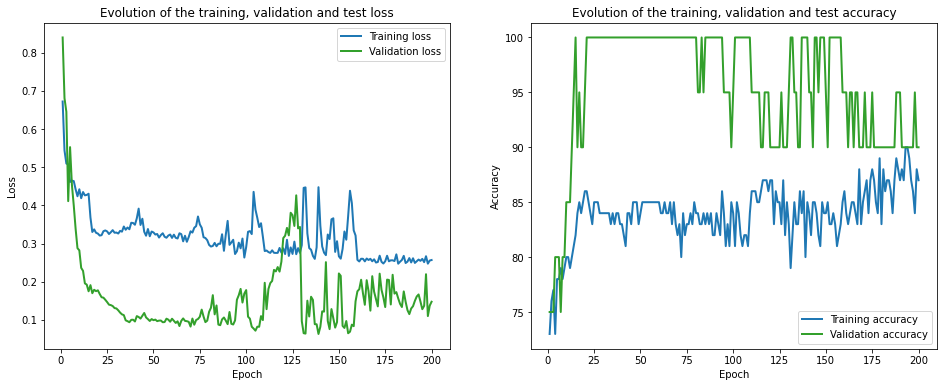

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 139.79it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1122.28it/s]

Finished computing p-values for 500 test points.

Starting repetition 23 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.93 train_acc: 30.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 2.66 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.52 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 1.45 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 1.66 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.40 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
val_loss = 0.35 val_acc = 70.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.48 train_acc: 80.00% took: 0.01s
Epoch 2 of 200, 20% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.

Epoch 12 of 200, 10% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 20% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 30% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 40% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 50% 	 train_loss: 0.87 train_acc: 50.00% took: 0.02s
Epoch 12 of 200, 60% 	 train_loss: 0.66 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 80% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 90% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 100% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
val_loss = 0.47 val_acc = 70.00%
Snapshot saved at epoch 12.
Epoch 13 of 200, 10% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 13 of 200, 20% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 13 of 200, 30% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 13 of 200, 40% 	 

Epoch 23 of 200, 10% 	 train_loss: 0.32 train_acc: 90.00% took: 0.02s
Epoch 23 of 200, 20% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 23 of 200, 30% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 23 of 200, 40% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 23 of 200, 50% 	 train_loss: 0.87 train_acc: 60.00% took: 0.00s
Epoch 23 of 200, 60% 	 train_loss: 0.59 train_acc: 90.00% took: 0.02s
Epoch 23 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 23 of 200, 80% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 23 of 200, 90% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 23 of 200, 100% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
val_loss = 0.49 val_acc = 70.00%
Snapshot saved at epoch 23.
Epoch 24 of 200, 10% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 24 of 200, 20% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 24 of 200, 30% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 24 of 200, 40% 	 

val_loss = 0.50 val_acc = 70.00%
Snapshot saved at epoch 33.
Epoch 34 of 200, 10% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 34 of 200, 20% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 34 of 200, 30% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 34 of 200, 40% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 34 of 200, 50% 	 train_loss: 0.88 train_acc: 50.00% took: 0.00s
Epoch 34 of 200, 60% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 34 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 34 of 200, 80% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 34 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 34 of 200, 100% 	 train_loss: 0.36 train_acc: 80.00% took: 0.02s
val_loss = 0.49 val_acc = 70.00%
Snapshot saved at epoch 34.
Epoch 35 of 200, 10% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 35 of 200, 20% 	 train_loss: 0.41 train_acc: 80.00% took: 0.02s
Epoch 35 of 200, 30% 	 train_loss

Epoch 49 of 200, 60% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 49 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 49 of 200, 80% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 49 of 200, 90% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 49 of 200, 100% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
val_loss = 0.48 val_acc = 70.00%
Snapshot saved at epoch 49.
Epoch 50 of 200, 10% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 20% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 50 of 200, 30% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 50 of 200, 40% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 50 of 200, 50% 	 train_loss: 0.88 train_acc: 60.00% took: 0.02s
Epoch 50 of 200, 60% 	 train_loss: 0.52 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 50 of 200, 80% 	 train_loss: 0.53 train_acc: 80.00% took: 0.02s
Epoch 50 of 200, 90% 	 

Epoch 63 of 200, 100% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
val_loss = 0.50 val_acc = 70.00%
Snapshot saved at epoch 63.
Epoch 64 of 200, 10% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 64 of 200, 20% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 64 of 200, 30% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 64 of 200, 40% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 64 of 200, 50% 	 train_loss: 0.83 train_acc: 50.00% took: 0.00s
Epoch 64 of 200, 60% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 64 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 64 of 200, 80% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 64 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 64 of 200, 100% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
val_loss = 0.51 val_acc = 70.00%
Snapshot saved at epoch 64.
Epoch 65 of 200, 10% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 65 of 200, 20% 	 train_los

Epoch 78 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 78 of 200, 100% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
val_loss = 0.50 val_acc = 70.00%
Snapshot saved at epoch 78.
Epoch 79 of 200, 10% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 79 of 200, 20% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 79 of 200, 30% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 79 of 200, 40% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 79 of 200, 50% 	 train_loss: 0.82 train_acc: 60.00% took: 0.00s
Epoch 79 of 200, 60% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 79 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 79 of 200, 80% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 79 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 79 of 200, 100% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
val_loss = 0.51 val_acc = 70.00%
Snapshot saved at epoch 79.
Epoch 80 of 200, 10% 	 train_lo

Epoch 89 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 89 of 200, 80% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 89 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 89 of 200, 100% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
val_loss = 0.50 val_acc = 70.00%
Snapshot saved at epoch 89.
Epoch 90 of 200, 10% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 90 of 200, 20% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 90 of 200, 30% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 90 of 200, 40% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 90 of 200, 50% 	 train_loss: 0.79 train_acc: 50.00% took: 0.00s
Epoch 90 of 200, 60% 	 train_loss: 0.51 train_acc: 90.00% took: 0.00s
Epoch 90 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 90 of 200, 80% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 90 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 90 of 200, 100% 

Epoch 104 of 200, 10% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 104 of 200, 20% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 104 of 200, 30% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 104 of 200, 40% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 104 of 200, 50% 	 train_loss: 0.81 train_acc: 60.00% took: 0.00s
Epoch 104 of 200, 60% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 104 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 104 of 200, 80% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 104 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 104 of 200, 100% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
val_loss = 0.50 val_acc = 70.00%
Snapshot saved at epoch 104.
Epoch 105 of 200, 10% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 105 of 200, 20% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 105 of 200, 30% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 105

Epoch 119 of 200, 60% 	 train_loss: 0.36 train_acc: 90.00% took: 0.02s
Epoch 119 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 119 of 200, 80% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 119 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 119 of 200, 100% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
val_loss = 0.49 val_acc = 70.00%
Snapshot saved at epoch 119.
Epoch 120 of 200, 10% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 120 of 200, 20% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 120 of 200, 30% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 120 of 200, 40% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 120 of 200, 50% 	 train_loss: 0.79 train_acc: 60.00% took: 0.02s
Epoch 120 of 200, 60% 	 train_loss: 0.47 train_acc: 90.00% took: 0.00s
Epoch 120 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 120 of 200, 80% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 120

val_loss = 0.50 val_acc = 70.00%
Snapshot saved at epoch 135.
Epoch 136 of 200, 10% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 136 of 200, 20% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 136 of 200, 30% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 136 of 200, 40% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 136 of 200, 50% 	 train_loss: 0.80 train_acc: 50.00% took: 0.00s
Epoch 136 of 200, 60% 	 train_loss: 0.48 train_acc: 90.00% took: 0.00s
Epoch 136 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 136 of 200, 80% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 136 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 136 of 200, 100% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
val_loss = 0.51 val_acc = 70.00%
Snapshot saved at epoch 136.
Epoch 137 of 200, 10% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 137 of 200, 20% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 137 of 200, 3

Epoch 147 of 200, 100% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
val_loss = 0.51 val_acc = 70.00%
Snapshot saved at epoch 147.
Epoch 148 of 200, 10% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 148 of 200, 20% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 148 of 200, 30% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 148 of 200, 40% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 148 of 200, 50% 	 train_loss: 0.79 train_acc: 60.00% took: 0.00s
Epoch 148 of 200, 60% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 148 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 148 of 200, 80% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 148 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 148 of 200, 100% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
val_loss = 0.50 val_acc = 70.00%
Snapshot saved at epoch 148.
Epoch 149 of 200, 10% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 149 of 200, 

Epoch 159 of 200, 10% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 159 of 200, 20% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 159 of 200, 30% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 159 of 200, 40% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 159 of 200, 50% 	 train_loss: 0.80 train_acc: 60.00% took: 0.01s
Epoch 159 of 200, 60% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 159 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 159 of 200, 80% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 159 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 159 of 200, 100% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
val_loss = 0.50 val_acc = 70.00%
Snapshot saved at epoch 159.
Epoch 160 of 200, 10% 	 train_loss: 0.29 train_acc: 90.00% took: 0.01s
Epoch 160 of 200, 20% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 160 of 200, 30% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 160

Epoch 174 of 200, 10% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 20% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 174 of 200, 30% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 174 of 200, 40% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 174 of 200, 50% 	 train_loss: 0.80 train_acc: 60.00% took: 0.00s
Epoch 174 of 200, 60% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.02s
Epoch 174 of 200, 80% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 174 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.01s
Epoch 174 of 200, 100% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
val_loss = 0.50 val_acc = 70.00%
Snapshot saved at epoch 174.
Epoch 175 of 200, 10% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 175 of 200, 20% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 175 of 200, 30% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 175

Epoch 188 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.02s
Epoch 188 of 200, 80% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 188 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 188 of 200, 100% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
val_loss = 0.50 val_acc = 70.00%
Snapshot saved at epoch 188.
Epoch 189 of 200, 10% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 189 of 200, 20% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 189 of 200, 30% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 189 of 200, 40% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 189 of 200, 50% 	 train_loss: 0.79 train_acc: 60.00% took: 0.02s
Epoch 189 of 200, 60% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 189 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 189 of 200, 80% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 189 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 18

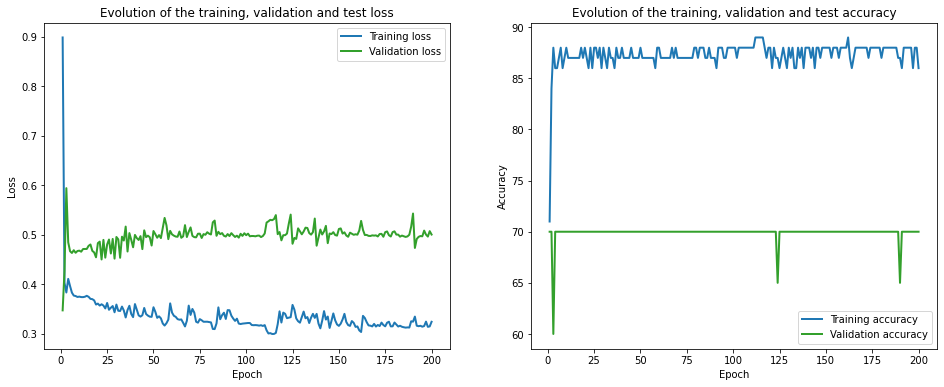

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 147.54it/s]


Initialization done!


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1112.91it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.83 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 2.17 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 1.18 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 2.15 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.55 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.48 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
val_loss = 0.63 val_acc = 70.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.41 train_acc: 80.00% took: 0.01s
Epoch 2 of 200, 30% 	 train_loss: 0.2

Epoch 13 of 200, 60% 	 train_loss: 0.59 train_acc: 90.00% took: 0.00s
Epoch 13 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 13 of 200, 80% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 13 of 200, 90% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 13 of 200, 100% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
val_loss = 0.46 val_acc = 70.00%
Snapshot saved at epoch 13.
Epoch 14 of 200, 10% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 14 of 200, 20% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 14 of 200, 30% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 14 of 200, 40% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 14 of 200, 50% 	 train_loss: 0.87 train_acc: 50.00% took: 0.00s
Epoch 14 of 200, 60% 	 train_loss: 0.56 train_acc: 90.00% took: 0.00s
Epoch 14 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 14 of 200, 80% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 14 of 200, 90% 	 

Epoch 24 of 200, 30% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 24 of 200, 40% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 24 of 200, 50% 	 train_loss: 0.89 train_acc: 60.00% took: 0.00s
Epoch 24 of 200, 60% 	 train_loss: 0.55 train_acc: 90.00% took: 0.00s
Epoch 24 of 200, 70% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 24 of 200, 80% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 24 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 24 of 200, 100% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
val_loss = 0.49 val_acc = 70.00%
Snapshot saved at epoch 24.
Epoch 25 of 200, 10% 	 train_loss: 0.35 train_acc: 90.00% took: 0.01s
Epoch 25 of 200, 20% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 25 of 200, 30% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 25 of 200, 40% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 25 of 200, 50% 	 train_loss: 0.85 train_acc: 50.00% took: 0.00s
Epoch 25 of 200, 60% 	

Epoch 38 of 200, 60% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 80% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 100% 	 train_loss: 0.34 train_acc: 80.00% took: 0.01s
val_loss = 0.49 val_acc = 70.00%
Snapshot saved at epoch 38.
Epoch 39 of 200, 10% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 39 of 200, 20% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 39 of 200, 30% 	 train_loss: 0.12 train_acc: 100.00% took: 0.02s
Epoch 39 of 200, 40% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 39 of 200, 50% 	 train_loss: 0.86 train_acc: 50.00% took: 0.00s
Epoch 39 of 200, 60% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 39 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 39 of 200, 80% 	 train_loss: 0.53 train_acc: 80.00% took: 0.02s
Epoch 39 of 200, 90% 	 

Epoch 49 of 200, 60% 	 train_loss: 0.43 train_acc: 90.00% took: 0.01s
Epoch 49 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 49 of 200, 80% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 49 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 49 of 200, 100% 	 train_loss: 0.37 train_acc: 80.00% took: 0.01s
val_loss = 0.50 val_acc = 70.00%
Snapshot saved at epoch 49.
Epoch 50 of 200, 10% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 20% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 50 of 200, 30% 	 train_loss: 0.13 train_acc: 100.00% took: 0.02s
Epoch 50 of 200, 40% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 50 of 200, 50% 	 train_loss: 0.81 train_acc: 50.00% took: 0.00s
Epoch 50 of 200, 60% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 50 of 200, 80% 	 train_loss: 0.53 train_acc: 80.00% took: 0.02s
Epoch 50 of 200, 90% 	 

Epoch 60 of 200, 60% 	 train_loss: 0.37 train_acc: 90.00% took: 0.02s
Epoch 60 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 60 of 200, 80% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 60 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 60 of 200, 100% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
val_loss = 0.49 val_acc = 70.00%
Snapshot saved at epoch 60.
Epoch 61 of 200, 10% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 61 of 200, 20% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 61 of 200, 30% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 61 of 200, 40% 	 train_loss: 0.13 train_acc: 100.00% took: 0.02s
Epoch 61 of 200, 50% 	 train_loss: 0.81 train_acc: 60.00% took: 0.00s
Epoch 61 of 200, 60% 	 train_loss: 0.37 train_acc: 90.00% took: 0.01s
Epoch 61 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 61 of 200, 80% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 61 of 200, 90% 	 

Epoch 75 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 75 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
val_loss = 0.52 val_acc = 70.00%
Snapshot saved at epoch 75.
Epoch 76 of 200, 10% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 76 of 200, 20% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 76 of 200, 30% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 76 of 200, 40% 	 train_loss: 0.11 train_acc: 100.00% took: 0.02s
Epoch 76 of 200, 50% 	 train_loss: 0.83 train_acc: 60.00% took: 0.00s
Epoch 76 of 200, 60% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 76 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 76 of 200, 80% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 76 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.02s
Epoch 76 of 200, 100% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
val_loss = 0.52 val_acc = 70.00%
Snapshot saved at epoch 76.
Epoch 77 of 200, 10% 	 train_lo

Epoch 86 of 200, 100% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
val_loss = 0.50 val_acc = 70.00%
Snapshot saved at epoch 86.
Epoch 87 of 200, 10% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 87 of 200, 20% 	 train_loss: 0.39 train_acc: 80.00% took: 0.02s
Epoch 87 of 200, 30% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 87 of 200, 40% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 87 of 200, 50% 	 train_loss: 0.81 train_acc: 60.00% took: 0.00s
Epoch 87 of 200, 60% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 87 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 87 of 200, 80% 	 train_loss: 0.52 train_acc: 80.00% took: 0.02s
Epoch 87 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 87 of 200, 100% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
val_loss = 0.50 val_acc = 70.00%
Snapshot saved at epoch 87.
Epoch 88 of 200, 10% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 88 of 200, 20% 	 train_los

Epoch 98 of 200, 60% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 98 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 98 of 200, 80% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 98 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 98 of 200, 100% 	 train_loss: 0.22 train_acc: 90.00% took: 0.01s
val_loss = 0.53 val_acc = 70.00%
Snapshot saved at epoch 98.
Epoch 99 of 200, 10% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 99 of 200, 20% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 99 of 200, 30% 	 train_loss: 0.16 train_acc: 100.00% took: 0.02s
Epoch 99 of 200, 40% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 99 of 200, 50% 	 train_loss: 0.82 train_acc: 60.00% took: 0.00s
Epoch 99 of 200, 60% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 99 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 99 of 200, 80% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 99 of 200, 90% 	 

Epoch 112 of 200, 40% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 112 of 200, 50% 	 train_loss: 0.75 train_acc: 50.00% took: 0.00s
Epoch 112 of 200, 60% 	 train_loss: 0.47 train_acc: 90.00% took: 0.02s
Epoch 112 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 112 of 200, 80% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 112 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 112 of 200, 100% 	 train_loss: 0.38 train_acc: 80.00% took: 0.02s
val_loss = 0.50 val_acc = 70.00%
Snapshot saved at epoch 112.
Epoch 113 of 200, 10% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 113 of 200, 20% 	 train_loss: 0.39 train_acc: 80.00% took: 0.02s
Epoch 113 of 200, 30% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 113 of 200, 40% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 113 of 200, 50% 	 train_loss: 0.79 train_acc: 60.00% took: 0.00s
Epoch 113 of 200, 60% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 113

Epoch 127 of 200, 80% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 127 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 127 of 200, 100% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
val_loss = 0.50 val_acc = 70.00%
Snapshot saved at epoch 127.
Epoch 128 of 200, 10% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 128 of 200, 20% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 128 of 200, 30% 	 train_loss: 0.15 train_acc: 100.00% took: 0.01s
Epoch 128 of 200, 40% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 128 of 200, 50% 	 train_loss: 0.80 train_acc: 60.00% took: 0.00s
Epoch 128 of 200, 60% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 128 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 128 of 200, 80% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 128 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 128 of 200, 100% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
val_loss

val_loss = 0.50 val_acc = 70.00%
Snapshot saved at epoch 138.
Epoch 139 of 200, 10% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 139 of 200, 20% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 139 of 200, 30% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 139 of 200, 40% 	 train_loss: 0.13 train_acc: 100.00% took: 0.01s
Epoch 139 of 200, 50% 	 train_loss: 0.81 train_acc: 60.00% took: 0.00s
Epoch 139 of 200, 60% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 139 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 139 of 200, 80% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 139 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 139 of 200, 100% 	 train_loss: 0.36 train_acc: 80.00% took: 0.02s
val_loss = 0.50 val_acc = 70.00%
Snapshot saved at epoch 139.
Epoch 140 of 200, 10% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 140 of 200, 20% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 140 of 200, 3

Epoch 149 of 200, 100% 	 train_loss: 0.36 train_acc: 80.00% took: 0.01s
val_loss = 0.50 val_acc = 70.00%
Snapshot saved at epoch 149.
Epoch 150 of 200, 10% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 20% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 150 of 200, 30% 	 train_loss: 0.12 train_acc: 100.00% took: 0.01s
Epoch 150 of 200, 40% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 150 of 200, 50% 	 train_loss: 0.79 train_acc: 60.00% took: 0.01s
Epoch 150 of 200, 60% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 150 of 200, 80% 	 train_loss: 0.50 train_acc: 80.00% took: 0.01s
Epoch 150 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 150 of 200, 100% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
val_loss = 0.50 val_acc = 70.00%
Snapshot saved at epoch 150.
Epoch 151 of 200, 10% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 151 of 200, 

Epoch 165 of 200, 20% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 165 of 200, 30% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 165 of 200, 40% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 165 of 200, 50% 	 train_loss: 0.82 train_acc: 60.00% took: 0.00s
Epoch 165 of 200, 60% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 165 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 165 of 200, 80% 	 train_loss: 0.53 train_acc: 80.00% took: 0.02s
Epoch 165 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 165 of 200, 100% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
val_loss = 0.54 val_acc = 70.00%
Snapshot saved at epoch 165.
Epoch 166 of 200, 10% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 20% 	 train_loss: 0.41 train_acc: 80.00% took: 0.01s
Epoch 166 of 200, 30% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 166 of 200, 40% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 16

Epoch 180 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.02s
Epoch 180 of 200, 100% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
val_loss = 0.50 val_acc = 70.00%
Snapshot saved at epoch 180.
Epoch 181 of 200, 10% 	 train_loss: 0.31 train_acc: 90.00% took: 0.01s
Epoch 181 of 200, 20% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 181 of 200, 30% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 181 of 200, 40% 	 train_loss: 0.14 train_acc: 100.00% took: 0.01s
Epoch 181 of 200, 50% 	 train_loss: 0.77 train_acc: 60.00% took: 0.00s
Epoch 181 of 200, 60% 	 train_loss: 0.39 train_acc: 90.00% took: 0.01s
Epoch 181 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 181 of 200, 80% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 181 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 181 of 200, 100% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
val_loss = 0.50 val_acc = 70.00%
Snapshot saved at epoch 181.
Epoch 182 of 200,

Epoch 196 of 200, 40% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 196 of 200, 50% 	 train_loss: 0.80 train_acc: 60.00% took: 0.00s
Epoch 196 of 200, 60% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 196 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 196 of 200, 80% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 196 of 200, 100% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
val_loss = 0.51 val_acc = 70.00%
Snapshot saved at epoch 196.
Epoch 197 of 200, 10% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 197 of 200, 20% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 197 of 200, 30% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 197 of 200, 40% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 197 of 200, 50% 	 train_loss: 0.81 train_acc: 60.00% took: 0.00s
Epoch 197 of 200, 60% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 197

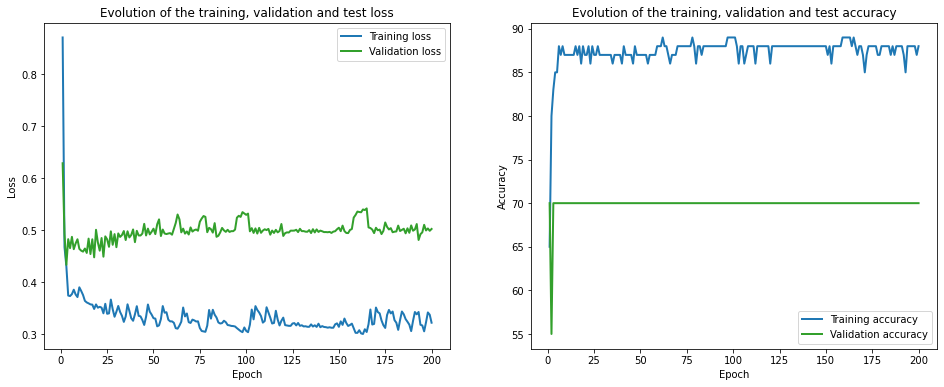

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 144.83it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 906.17it/s]

Finished computing p-values for 500 test points.

Starting repetition 24 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.66 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 1.18 train_acc: 60.00% took: 0.02s
Epoch 1 of 200, 30% 	 train_loss: 4.09 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 5.16 train_acc: 20.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.72 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 1.05 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 1.58 train_acc: 50.00% took: 0.02s
Epoch 1 of 200, 90% 	 train_loss: 1.00 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
val_loss = 6.09 val_acc = 45.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 2.75 train_acc: 90.00% took: 0.02s
Epoch 2 of 200, 20% 	 train_loss: 1.16 train_acc: 50.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 2.1

Epoch 16 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.02s
Epoch 16 of 200, 70% 	 train_loss: 0.45 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 80% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 90% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 100% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
val_loss = 1.56 val_acc = 65.00%
Snapshot saved at epoch 16.
Epoch 17 of 200, 10% 	 train_loss: 1.08 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 20% 	 train_loss: 0.69 train_acc: 60.00% took: 0.00s
Epoch 17 of 200, 30% 	 train_loss: 0.61 train_acc: 60.00% took: 0.00s
Epoch 17 of 200, 40% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 50% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.02s
Epoch 17 of 200, 70% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 80% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 90% 	 train

Epoch 28 of 200, 50% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 70% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 80% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 90% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 28 of 200, 100% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
val_loss = 1.59 val_acc = 70.00%
Snapshot saved at epoch 28.
Epoch 29 of 200, 10% 	 train_loss: 1.11 train_acc: 90.00% took: 0.00s
Epoch 29 of 200, 20% 	 train_loss: 0.68 train_acc: 60.00% took: 0.01s
Epoch 29 of 200, 30% 	 train_loss: 0.60 train_acc: 60.00% took: 0.00s
Epoch 29 of 200, 40% 	 train_loss: 0.39 train_acc: 100.00% took: 0.00s
Epoch 29 of 200, 50% 	 train_loss: 0.28 train_acc: 90.00% took: 0.01s
Epoch 29 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 29 of 200, 70% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 29 of 200, 80% 	 trai

val_loss = 1.93 val_acc = 65.00%
Snapshot saved at epoch 39.
Epoch 40 of 200, 10% 	 train_loss: 1.27 train_acc: 90.00% took: 0.00s
Epoch 40 of 200, 20% 	 train_loss: 0.70 train_acc: 50.00% took: 0.00s
Epoch 40 of 200, 30% 	 train_loss: 0.57 train_acc: 60.00% took: 0.00s
Epoch 40 of 200, 40% 	 train_loss: 0.45 train_acc: 90.00% took: 0.02s
Epoch 40 of 200, 50% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 40 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 40 of 200, 70% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 40 of 200, 80% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 40 of 200, 90% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 40 of 200, 100% 	 train_loss: 0.53 train_acc: 80.00% took: 0.02s
val_loss = 1.51 val_acc = 70.00%
Snapshot saved at epoch 40.
Epoch 41 of 200, 10% 	 train_loss: 1.08 train_acc: 90.00% took: 0.00s
Epoch 41 of 200, 20% 	 train_loss: 0.66 train_acc: 50.00% took: 0.00s
Epoch 41 of 200, 30% 	 train_loss: 0.

Epoch 50 of 200, 80% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 90% 	 train_loss: 0.60 train_acc: 70.00% took: 0.00s
Epoch 50 of 200, 100% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
val_loss = 1.69 val_acc = 70.00%
Snapshot saved at epoch 50.
Epoch 51 of 200, 10% 	 train_loss: 1.17 train_acc: 90.00% took: 0.00s
Epoch 51 of 200, 20% 	 train_loss: 0.66 train_acc: 50.00% took: 0.02s
Epoch 51 of 200, 30% 	 train_loss: 0.61 train_acc: 60.00% took: 0.00s
Epoch 51 of 200, 40% 	 train_loss: 0.42 train_acc: 100.00% took: 0.00s
Epoch 51 of 200, 50% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 51 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 51 of 200, 70% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 51 of 200, 80% 	 train_loss: 0.31 train_acc: 90.00% took: 0.02s
Epoch 51 of 200, 90% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 51 of 200, 100% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
val_loss = 1.48 val_acc = 

Epoch 61 of 200, 80% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 61 of 200, 90% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 61 of 200, 100% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
val_loss = 1.33 val_acc = 70.00%
Snapshot saved at epoch 61.
Epoch 62 of 200, 10% 	 train_loss: 0.99 train_acc: 90.00% took: 0.02s
Epoch 62 of 200, 20% 	 train_loss: 0.63 train_acc: 60.00% took: 0.00s
Epoch 62 of 200, 30% 	 train_loss: 0.61 train_acc: 60.00% took: 0.00s
Epoch 62 of 200, 40% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 62 of 200, 50% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 62 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 62 of 200, 70% 	 train_loss: 0.40 train_acc: 90.00% took: 0.02s
Epoch 62 of 200, 80% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 62 of 200, 90% 	 train_loss: 0.60 train_acc: 70.00% took: 0.00s
Epoch 62 of 200, 100% 	 train_loss: 0.60 train_acc: 60.00% took: 0.00s
val_loss = 1.74 val_acc = 7

Epoch 72 of 200, 80% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 72 of 200, 90% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 72 of 200, 100% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
val_loss = 1.54 val_acc = 70.00%
Snapshot saved at epoch 72.
Epoch 73 of 200, 10% 	 train_loss: 1.12 train_acc: 90.00% took: 0.01s
Epoch 73 of 200, 20% 	 train_loss: 0.68 train_acc: 50.00% took: 0.00s
Epoch 73 of 200, 30% 	 train_loss: 0.65 train_acc: 60.00% took: 0.00s
Epoch 73 of 200, 40% 	 train_loss: 0.39 train_acc: 100.00% took: 0.00s
Epoch 73 of 200, 50% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 73 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 73 of 200, 70% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 73 of 200, 80% 	 train_loss: 0.32 train_acc: 90.00% took: 0.02s
Epoch 73 of 200, 90% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 73 of 200, 100% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
val_loss = 1.33 val_acc = 

Epoch 83 of 200, 80% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 83 of 200, 90% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 83 of 200, 100% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
val_loss = 1.69 val_acc = 65.00%
Snapshot saved at epoch 83.
Epoch 84 of 200, 10% 	 train_loss: 1.16 train_acc: 90.00% took: 0.00s
Epoch 84 of 200, 20% 	 train_loss: 0.64 train_acc: 60.00% took: 0.00s
Epoch 84 of 200, 30% 	 train_loss: 0.58 train_acc: 60.00% took: 0.00s
Epoch 84 of 200, 40% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 84 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 84 of 200, 60% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 84 of 200, 70% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 84 of 200, 80% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 84 of 200, 90% 	 train_loss: 0.60 train_acc: 70.00% took: 0.00s
Epoch 84 of 200, 100% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
val_loss = 1.61 val_acc = 7

Epoch 98 of 200, 50% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 98 of 200, 60% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 98 of 200, 70% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 98 of 200, 80% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 98 of 200, 90% 	 train_loss: 0.60 train_acc: 70.00% took: 0.00s
Epoch 98 of 200, 100% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
val_loss = 1.88 val_acc = 65.00%
Snapshot saved at epoch 98.
Epoch 99 of 200, 10% 	 train_loss: 1.24 train_acc: 90.00% took: 0.00s
Epoch 99 of 200, 20% 	 train_loss: 0.67 train_acc: 50.00% took: 0.00s
Epoch 99 of 200, 30% 	 train_loss: 0.59 train_acc: 60.00% took: 0.00s
Epoch 99 of 200, 40% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 99 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.02s
Epoch 99 of 200, 60% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 99 of 200, 70% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 99 of 200, 80% 	 train

Epoch 109 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 109 of 200, 60% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 109 of 200, 70% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 109 of 200, 80% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 109 of 200, 90% 	 train_loss: 0.61 train_acc: 70.00% took: 0.02s
Epoch 109 of 200, 100% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
val_loss = 1.65 val_acc = 70.00%
Snapshot saved at epoch 109.
Epoch 110 of 200, 10% 	 train_loss: 1.17 train_acc: 90.00% took: 0.00s
Epoch 110 of 200, 20% 	 train_loss: 0.68 train_acc: 50.00% took: 0.02s
Epoch 110 of 200, 30% 	 train_loss: 0.67 train_acc: 60.00% took: 0.00s
Epoch 110 of 200, 40% 	 train_loss: 0.44 train_acc: 100.00% took: 0.00s
Epoch 110 of 200, 50% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 110 of 200, 60% 	 train_loss: 0.21 train_acc: 90.00% took: 0.02s
Epoch 110 of 200, 70% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 110 of 

Epoch 124 of 200, 90% 	 train_loss: 0.55 train_acc: 70.00% took: 0.01s
Epoch 124 of 200, 100% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
val_loss = 1.11 val_acc = 70.00%
Snapshot saved at epoch 124.
Epoch 125 of 200, 10% 	 train_loss: 0.89 train_acc: 80.00% took: 0.00s
Epoch 125 of 200, 20% 	 train_loss: 0.63 train_acc: 60.00% took: 0.00s
Epoch 125 of 200, 30% 	 train_loss: 0.66 train_acc: 60.00% took: 0.02s
Epoch 125 of 200, 40% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 125 of 200, 50% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 125 of 200, 60% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 125 of 200, 70% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 125 of 200, 80% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 125 of 200, 90% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 125 of 200, 100% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
val_loss = 1.51 val_acc = 70.00%
Snapshot saved at epoch 125.
Epoch 126 of 200, 10% 

Epoch 135 of 200, 80% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 135 of 200, 90% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 135 of 200, 100% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
val_loss = 1.56 val_acc = 70.00%
Snapshot saved at epoch 135.
Epoch 136 of 200, 10% 	 train_loss: 1.15 train_acc: 90.00% took: 0.00s
Epoch 136 of 200, 20% 	 train_loss: 0.69 train_acc: 50.00% took: 0.01s
Epoch 136 of 200, 30% 	 train_loss: 0.69 train_acc: 60.00% took: 0.00s
Epoch 136 of 200, 40% 	 train_loss: 0.41 train_acc: 100.00% took: 0.00s
Epoch 136 of 200, 50% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 136 of 200, 60% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 136 of 200, 70% 	 train_loss: 0.36 train_acc: 90.00% took: 0.02s
Epoch 136 of 200, 80% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 136 of 200, 90% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 136 of 200, 100% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
val_loss = 1

Epoch 146 of 200, 60% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 146 of 200, 70% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 146 of 200, 80% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 146 of 200, 90% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 146 of 200, 100% 	 train_loss: 0.54 train_acc: 80.00% took: 0.02s
val_loss = 1.46 val_acc = 70.00%
Snapshot saved at epoch 146.
Epoch 147 of 200, 10% 	 train_loss: 1.08 train_acc: 90.00% took: 0.00s
Epoch 147 of 200, 20% 	 train_loss: 0.65 train_acc: 50.00% took: 0.00s
Epoch 147 of 200, 30% 	 train_loss: 0.62 train_acc: 70.00% took: 0.00s
Epoch 147 of 200, 40% 	 train_loss: 0.41 train_acc: 100.00% took: 0.02s
Epoch 147 of 200, 50% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 147 of 200, 60% 	 train_loss: 0.19 train_acc: 90.00% took: 0.01s
Epoch 147 of 200, 70% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 147 of 200, 80% 	 train_loss: 0.29 train_acc: 90.00% took: 0.01s
Epoch 147 of 

Epoch 157 of 200, 60% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 157 of 200, 70% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 157 of 200, 80% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 157 of 200, 90% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 157 of 200, 100% 	 train_loss: 0.50 train_acc: 80.00% took: 0.02s
val_loss = 1.39 val_acc = 70.00%
Snapshot saved at epoch 157.
Epoch 158 of 200, 10% 	 train_loss: 1.04 train_acc: 90.00% took: 0.00s
Epoch 158 of 200, 20% 	 train_loss: 0.65 train_acc: 50.00% took: 0.00s
Epoch 158 of 200, 30% 	 train_loss: 0.61 train_acc: 70.00% took: 0.02s
Epoch 158 of 200, 40% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 158 of 200, 50% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 158 of 200, 60% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 158 of 200, 70% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 158 of 200, 80% 	 train_loss: 0.28 train_acc: 90.00% took: 0.02s
Epoch 158 of 2

Epoch 168 of 200, 60% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 168 of 200, 70% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 168 of 200, 80% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 168 of 200, 90% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 168 of 200, 100% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
val_loss = 1.35 val_acc = 70.00%
Snapshot saved at epoch 168.
Epoch 169 of 200, 10% 	 train_loss: 1.00 train_acc: 90.00% took: 0.00s
Epoch 169 of 200, 20% 	 train_loss: 0.63 train_acc: 50.00% took: 0.00s
Epoch 169 of 200, 30% 	 train_loss: 0.62 train_acc: 70.00% took: 0.00s
Epoch 169 of 200, 40% 	 train_loss: 0.41 train_acc: 100.00% took: 0.00s
Epoch 169 of 200, 50% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 169 of 200, 60% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 169 of 200, 70% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 169 of 200, 80% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 169 of 

Epoch 179 of 200, 80% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 179 of 200, 90% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 179 of 200, 100% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
val_loss = 1.44 val_acc = 70.00%
Snapshot saved at epoch 179.
Epoch 180 of 200, 10% 	 train_loss: 1.06 train_acc: 90.00% took: 0.00s
Epoch 180 of 200, 20% 	 train_loss: 0.64 train_acc: 50.00% took: 0.00s
Epoch 180 of 200, 30% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 180 of 200, 40% 	 train_loss: 0.43 train_acc: 100.00% took: 0.00s
Epoch 180 of 200, 50% 	 train_loss: 0.29 train_acc: 90.00% took: 0.01s
Epoch 180 of 200, 60% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 180 of 200, 70% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 180 of 200, 80% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 180 of 200, 90% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 180 of 200, 100% 	 train_loss: 0.49 train_acc: 80.00% took: 0.02s
val_loss = 1

Epoch 190 of 200, 50% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 190 of 200, 60% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 190 of 200, 70% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 190 of 200, 80% 	 train_loss: 0.28 train_acc: 90.00% took: 0.01s
Epoch 190 of 200, 90% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 190 of 200, 100% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
val_loss = 1.33 val_acc = 70.00%
Snapshot saved at epoch 190.
Epoch 191 of 200, 10% 	 train_loss: 0.98 train_acc: 90.00% took: 0.00s
Epoch 191 of 200, 20% 	 train_loss: 0.64 train_acc: 50.00% took: 0.00s
Epoch 191 of 200, 30% 	 train_loss: 0.60 train_acc: 70.00% took: 0.00s
Epoch 191 of 200, 40% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
Epoch 191 of 200, 50% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 191 of 200, 60% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 191 of 200, 70% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 191 of 2

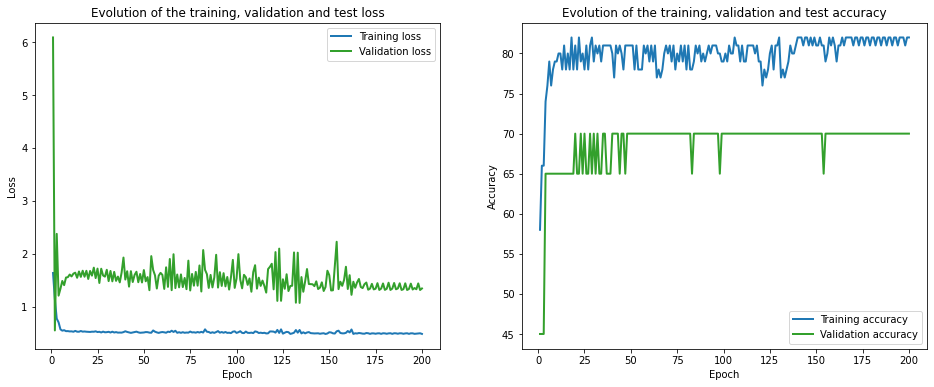

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 153.73it/s]


Initialization done!


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1515.08it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.99 train_acc: 20.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 3.71 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 1.41 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 2.26 train_acc: 20.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 1.19 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.77 train_acc: 50.00% took: 0.02s
Epoch 1 of 200, 90% 	 train_loss: 2.06 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.65 train_acc: 40.00% took: 0.00s
val_loss = 0.52 val_acc = 60.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.67 train_acc: 70.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 2.0

Epoch 16 of 200, 20% 	 train_loss: 0.65 train_acc: 60.00% took: 0.00s
Epoch 16 of 200, 30% 	 train_loss: 3.05 train_acc: 60.00% took: 0.00s
Epoch 16 of 200, 40% 	 train_loss: 0.49 train_acc: 60.00% took: 0.00s
Epoch 16 of 200, 50% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 60% 	 train_loss: 0.83 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 70% 	 train_loss: 0.81 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 80% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 90% 	 train_loss: 0.73 train_acc: 50.00% took: 0.00s
Epoch 16 of 200, 100% 	 train_loss: 0.52 train_acc: 40.00% took: 0.00s
val_loss = 0.80 val_acc = 45.00%
Snapshot saved at epoch 16.
Epoch 17 of 200, 10% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 20% 	 train_loss: 0.60 train_acc: 60.00% took: 0.00s
Epoch 17 of 200, 30% 	 train_loss: 1.35 train_acc: 60.00% took: 0.00s
Epoch 17 of 200, 40% 	 train_loss: 0.53 train_acc: 60.00% took: 0.00s
Epoch 17 of 200, 50% 	 train

Epoch 27 of 200, 100% 	 train_loss: 0.57 train_acc: 50.00% took: 0.00s
val_loss = 1.19 val_acc = 65.00%
Snapshot saved at epoch 27.
Epoch 28 of 200, 10% 	 train_loss: 0.86 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 20% 	 train_loss: 0.63 train_acc: 60.00% took: 0.00s
Epoch 28 of 200, 30% 	 train_loss: 0.72 train_acc: 60.00% took: 0.00s
Epoch 28 of 200, 40% 	 train_loss: 0.48 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 50% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 60% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 70% 	 train_loss: 0.52 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 80% 	 train_loss: 0.26 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 90% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 28 of 200, 100% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
val_loss = 1.23 val_acc = 65.00%
Snapshot saved at epoch 28.
Epoch 29 of 200, 10% 	 train_loss: 0.91 train_acc: 90.00% took: 0.00s
Epoch 29 of 200, 20% 	 train_loss: 

Epoch 39 of 200, 50% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 39 of 200, 60% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 39 of 200, 70% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 39 of 200, 80% 	 train_loss: 0.27 train_acc: 100.00% took: 0.02s
Epoch 39 of 200, 90% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 39 of 200, 100% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
val_loss = 1.14 val_acc = 65.00%
Snapshot saved at epoch 39.
Epoch 40 of 200, 10% 	 train_loss: 0.86 train_acc: 90.00% took: 0.02s
Epoch 40 of 200, 20% 	 train_loss: 0.63 train_acc: 60.00% took: 0.00s
Epoch 40 of 200, 30% 	 train_loss: 0.66 train_acc: 60.00% took: 0.00s
Epoch 40 of 200, 40% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 40 of 200, 50% 	 train_loss: 0.33 train_acc: 90.00% took: 0.02s
Epoch 40 of 200, 60% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 40 of 200, 70% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 40 of 200, 80% 	 trai

Epoch 54 of 200, 40% 	 train_loss: 0.47 train_acc: 90.00% took: 0.00s
Epoch 54 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 54 of 200, 60% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 54 of 200, 70% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 54 of 200, 80% 	 train_loss: 0.25 train_acc: 100.00% took: 0.00s
Epoch 54 of 200, 90% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 54 of 200, 100% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
val_loss = 1.17 val_acc = 65.00%
Snapshot saved at epoch 54.
Epoch 55 of 200, 10% 	 train_loss: 0.93 train_acc: 80.00% took: 0.00s
Epoch 55 of 200, 20% 	 train_loss: 0.64 train_acc: 60.00% took: 0.00s
Epoch 55 of 200, 30% 	 train_loss: 0.67 train_acc: 60.00% took: 0.00s
Epoch 55 of 200, 40% 	 train_loss: 0.47 train_acc: 90.00% took: 0.00s
Epoch 55 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.02s
Epoch 55 of 200, 60% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 55 of 200, 70% 	 trai

Epoch 65 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 65 of 200, 60% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 65 of 200, 70% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 65 of 200, 80% 	 train_loss: 0.25 train_acc: 100.00% took: 0.00s
Epoch 65 of 200, 90% 	 train_loss: 0.61 train_acc: 70.00% took: 0.02s
Epoch 65 of 200, 100% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
val_loss = 1.18 val_acc = 65.00%
Snapshot saved at epoch 65.
Epoch 66 of 200, 10% 	 train_loss: 0.96 train_acc: 80.00% took: 0.00s
Epoch 66 of 200, 20% 	 train_loss: 0.63 train_acc: 60.00% took: 0.00s
Epoch 66 of 200, 30% 	 train_loss: 0.73 train_acc: 60.00% took: 0.02s
Epoch 66 of 200, 40% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 66 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 66 of 200, 60% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 66 of 200, 70% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 66 of 200, 80% 	 trai

Epoch 76 of 200, 30% 	 train_loss: 0.68 train_acc: 60.00% took: 0.00s
Epoch 76 of 200, 40% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 76 of 200, 50% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 76 of 200, 60% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 76 of 200, 70% 	 train_loss: 0.56 train_acc: 80.00% took: 0.02s
Epoch 76 of 200, 80% 	 train_loss: 0.25 train_acc: 100.00% took: 0.00s
Epoch 76 of 200, 90% 	 train_loss: 0.61 train_acc: 70.00% took: 0.00s
Epoch 76 of 200, 100% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
val_loss = 1.21 val_acc = 65.00%
Snapshot saved at epoch 76.
Epoch 77 of 200, 10% 	 train_loss: 0.98 train_acc: 80.00% took: 0.00s
Epoch 77 of 200, 20% 	 train_loss: 0.63 train_acc: 60.00% took: 0.00s
Epoch 77 of 200, 30% 	 train_loss: 0.69 train_acc: 60.00% took: 0.00s
Epoch 77 of 200, 40% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 77 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 77 of 200, 60% 	 trai

Epoch 87 of 200, 10% 	 train_loss: 0.98 train_acc: 80.00% took: 0.00s
Epoch 87 of 200, 20% 	 train_loss: 0.63 train_acc: 60.00% took: 0.00s
Epoch 87 of 200, 30% 	 train_loss: 0.69 train_acc: 60.00% took: 0.00s
Epoch 87 of 200, 40% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 87 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 87 of 200, 60% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 87 of 200, 70% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
Epoch 87 of 200, 80% 	 train_loss: 0.25 train_acc: 100.00% took: 0.00s
Epoch 87 of 200, 90% 	 train_loss: 0.62 train_acc: 70.00% took: 0.00s
Epoch 87 of 200, 100% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
val_loss = 1.19 val_acc = 65.00%
Snapshot saved at epoch 87.
Epoch 88 of 200, 10% 	 train_loss: 0.96 train_acc: 80.00% took: 0.00s
Epoch 88 of 200, 20% 	 train_loss: 0.64 train_acc: 60.00% took: 0.00s
Epoch 88 of 200, 30% 	 train_loss: 0.68 train_acc: 60.00% took: 0.00s
Epoch 88 of 200, 40% 	 trai

Epoch 98 of 200, 20% 	 train_loss: 0.65 train_acc: 60.00% took: 0.02s
Epoch 98 of 200, 30% 	 train_loss: 0.66 train_acc: 60.00% took: 0.00s
Epoch 98 of 200, 40% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 98 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 98 of 200, 60% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 98 of 200, 70% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
Epoch 98 of 200, 80% 	 train_loss: 0.26 train_acc: 100.00% took: 0.02s
Epoch 98 of 200, 90% 	 train_loss: 0.61 train_acc: 70.00% took: 0.00s
Epoch 98 of 200, 100% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
val_loss = 1.18 val_acc = 65.00%
Snapshot saved at epoch 98.
Epoch 99 of 200, 10% 	 train_loss: 0.95 train_acc: 80.00% took: 0.00s
Epoch 99 of 200, 20% 	 train_loss: 0.65 train_acc: 60.00% took: 0.02s
Epoch 99 of 200, 30% 	 train_loss: 0.65 train_acc: 60.00% took: 0.00s
Epoch 99 of 200, 40% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 99 of 200, 50% 	 trai

Epoch 109 of 200, 50% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 109 of 200, 60% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 109 of 200, 70% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 109 of 200, 80% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 109 of 200, 90% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 109 of 200, 100% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
val_loss = 1.35 val_acc = 70.00%
Snapshot saved at epoch 109.
Epoch 110 of 200, 10% 	 train_loss: 0.99 train_acc: 90.00% took: 0.00s
Epoch 110 of 200, 20% 	 train_loss: 0.70 train_acc: 40.00% took: 0.00s
Epoch 110 of 200, 30% 	 train_loss: 0.70 train_acc: 60.00% took: 0.00s
Epoch 110 of 200, 40% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 110 of 200, 50% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 110 of 200, 60% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 110 of 200, 70% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 110 of 2

Epoch 123 of 200, 80% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 123 of 200, 90% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 123 of 200, 100% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
val_loss = 1.54 val_acc = 70.00%
Snapshot saved at epoch 123.
Epoch 124 of 200, 10% 	 train_loss: 1.12 train_acc: 90.00% took: 0.00s
Epoch 124 of 200, 20% 	 train_loss: 0.76 train_acc: 40.00% took: 0.00s
Epoch 124 of 200, 30% 	 train_loss: 0.60 train_acc: 60.00% took: 0.00s
Epoch 124 of 200, 40% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 124 of 200, 50% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 124 of 200, 60% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 124 of 200, 70% 	 train_loss: 0.44 train_acc: 90.00% took: 0.00s
Epoch 124 of 200, 80% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 124 of 200, 90% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 124 of 200, 100% 	 train_loss: 0.62 train_acc: 50.00% took: 0.00s
val_loss = 1.

val_loss = 1.69 val_acc = 70.00%
Snapshot saved at epoch 137.
Epoch 138 of 200, 10% 	 train_loss: 1.23 train_acc: 90.00% took: 0.00s
Epoch 138 of 200, 20% 	 train_loss: 0.76 train_acc: 40.00% took: 0.00s
Epoch 138 of 200, 30% 	 train_loss: 0.66 train_acc: 50.00% took: 0.00s
Epoch 138 of 200, 40% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 138 of 200, 50% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 138 of 200, 60% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 138 of 200, 70% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 138 of 200, 80% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 138 of 200, 90% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 138 of 200, 100% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
val_loss = 1.11 val_acc = 70.00%
Snapshot saved at epoch 138.
Epoch 139 of 200, 10% 	 train_loss: 0.88 train_acc: 80.00% took: 0.00s
Epoch 139 of 200, 20% 	 train_loss: 0.64 train_acc: 60.00% took: 0.00s
Epoch 139 of 200, 30% 

Epoch 149 of 200, 50% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 149 of 200, 60% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 149 of 200, 70% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 149 of 200, 80% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 149 of 200, 90% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 149 of 200, 100% 	 train_loss: 0.60 train_acc: 50.00% took: 0.00s
val_loss = 1.69 val_acc = 70.00%
Snapshot saved at epoch 149.
Epoch 150 of 200, 10% 	 train_loss: 1.22 train_acc: 90.00% took: 0.01s
Epoch 150 of 200, 20% 	 train_loss: 0.67 train_acc: 50.00% took: 0.00s
Epoch 150 of 200, 30% 	 train_loss: 0.64 train_acc: 60.00% took: 0.00s
Epoch 150 of 200, 40% 	 train_loss: 0.40 train_acc: 90.00% took: 0.01s
Epoch 150 of 200, 50% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 70% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 150 of 2

Epoch 164 of 200, 50% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 164 of 200, 60% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 164 of 200, 70% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 164 of 200, 80% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 164 of 200, 90% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 164 of 200, 100% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
val_loss = 1.62 val_acc = 70.00%
Snapshot saved at epoch 164.
Epoch 165 of 200, 10% 	 train_loss: 1.13 train_acc: 90.00% took: 0.01s
Epoch 165 of 200, 20% 	 train_loss: 0.64 train_acc: 50.00% took: 0.00s
Epoch 165 of 200, 30% 	 train_loss: 0.62 train_acc: 60.00% took: 0.00s
Epoch 165 of 200, 40% 	 train_loss: 0.47 train_acc: 90.00% took: 0.00s
Epoch 165 of 200, 50% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 165 of 200, 60% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 165 of 200, 70% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 165 of 

Epoch 178 of 200, 20% 	 train_loss: 0.63 train_acc: 60.00% took: 0.00s
Epoch 178 of 200, 30% 	 train_loss: 0.64 train_acc: 60.00% took: 0.00s
Epoch 178 of 200, 40% 	 train_loss: 0.39 train_acc: 100.00% took: 0.00s
Epoch 178 of 200, 50% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 70% 	 train_loss: 0.38 train_acc: 90.00% took: 0.02s
Epoch 178 of 200, 80% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 90% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 178 of 200, 100% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
val_loss = 1.55 val_acc = 70.00%
Snapshot saved at epoch 178.
Epoch 179 of 200, 10% 	 train_loss: 1.13 train_acc: 90.00% took: 0.00s
Epoch 179 of 200, 20% 	 train_loss: 0.70 train_acc: 50.00% took: 0.00s
Epoch 179 of 200, 30% 	 train_loss: 0.59 train_acc: 60.00% took: 0.00s
Epoch 179 of 200, 40% 	 train_loss: 0.39 train_acc: 100.00% took: 0.00s
Epoch 179 of

Epoch 193 of 200, 80% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 193 of 200, 90% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 193 of 200, 100% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
val_loss = 1.28 val_acc = 70.00%
Snapshot saved at epoch 193.
Epoch 194 of 200, 10% 	 train_loss: 0.98 train_acc: 80.00% took: 0.00s
Epoch 194 of 200, 20% 	 train_loss: 0.67 train_acc: 60.00% took: 0.00s
Epoch 194 of 200, 30% 	 train_loss: 0.61 train_acc: 60.00% took: 0.00s
Epoch 194 of 200, 40% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 194 of 200, 50% 	 train_loss: 0.30 train_acc: 90.00% took: 0.02s
Epoch 194 of 200, 60% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 194 of 200, 70% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 194 of 200, 80% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 194 of 200, 90% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 194 of 200, 100% 	 train_loss: 0.60 train_acc: 50.00% took: 0.02s
val_loss = 1.

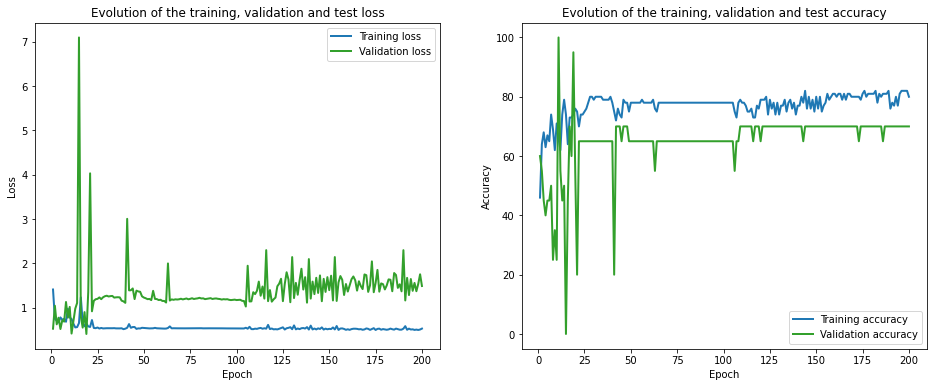

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 137.86it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 970.77it/s]

Finished computing p-values for 500 test points.

Starting repetition 25 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.80 train_acc: 20.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 2.83 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 1.70 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 1.08 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.22 train_acc: 80.00% took: 0.02s
val_loss = 1.52 val_acc = 60.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.3

Epoch 15 of 200, 60% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 15 of 200, 70% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 80% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 15 of 200, 90% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 0.76 val_acc = 70.00%
Snapshot saved at epoch 15.
Epoch 16 of 200, 10% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 20% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 30% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 40% 	 train_loss: 0.40 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 50% 	 train_loss: 0.55 train_acc: 60.00% took: 0.00s
Epoch 16 of 200, 60% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 70% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 80% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 90% 	 t

Epoch 30 of 200, 80% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 30 of 200, 90% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 30 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 0.86 val_acc = 70.00%
Snapshot saved at epoch 30.
Epoch 31 of 200, 10% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 20% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 31 of 200, 30% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 40% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 50% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 31 of 200, 60% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 31 of 200, 70% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 31 of 200, 80% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 31 of 200, 90% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 0.87 val_ac

Epoch 42 of 200, 30% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 42 of 200, 40% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 42 of 200, 50% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 42 of 200, 60% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 42 of 200, 70% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 42 of 200, 80% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 42 of 200, 90% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 42 of 200, 100% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
val_loss = 0.88 val_acc = 75.00%
Snapshot saved at epoch 42.
Epoch 43 of 200, 10% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 43 of 200, 20% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 43 of 200, 30% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 43 of 200, 40% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 43 of 200, 50% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 43 of 200, 60% 	 tra

Epoch 56 of 200, 70% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 56 of 200, 80% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 56 of 200, 90% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 56 of 200, 100% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
val_loss = 0.91 val_acc = 80.00%
Snapshot saved at epoch 56.
Epoch 57 of 200, 10% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 57 of 200, 20% 	 train_loss: 0.21 train_acc: 90.00% took: 0.01s
Epoch 57 of 200, 30% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 40% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 50% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 57 of 200, 60% 	 train_loss: 0.10 train_acc: 100.00% took: 0.01s
Epoch 57 of 200, 70% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 80% 	 train_loss: 0.14 train_acc: 90.00% took: 0.01s
Epoch 57 of 200, 90% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 100% 	 tra

Epoch 67 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 67 of 200, 80% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 67 of 200, 90% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 67 of 200, 100% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
val_loss = 0.99 val_acc = 80.00%
Snapshot saved at epoch 67.
Epoch 68 of 200, 10% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 68 of 200, 20% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 68 of 200, 30% 	 train_loss: 0.44 train_acc: 90.00% took: 0.00s
Epoch 68 of 200, 40% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 68 of 200, 50% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 68 of 200, 60% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 68 of 200, 70% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 68 of 200, 80% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 68 of 200, 90% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 68 of 200, 100% 	 t

Epoch 78 of 200, 60% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 78 of 200, 70% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 78 of 200, 80% 	 train_loss: 0.06 train_acc: 100.00% took: 0.02s
Epoch 78 of 200, 90% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 78 of 200, 100% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
val_loss = 1.05 val_acc = 80.00%
Snapshot saved at epoch 78.
Epoch 79 of 200, 10% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 79 of 200, 20% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 79 of 200, 30% 	 train_loss: 0.45 train_acc: 90.00% took: 0.02s
Epoch 79 of 200, 40% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 79 of 200, 50% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 79 of 200, 60% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 79 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 79 of 200, 80% 	 train_loss: 0.06 train_acc: 100.00% took: 0.02s
Epoch 79 of 200, 90% 	 t

Epoch 89 of 200, 60% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 89 of 200, 70% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 80% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 89 of 200, 90% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 100% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
val_loss = 1.02 val_acc = 75.00%
Snapshot saved at epoch 89.
Epoch 90 of 200, 10% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 90 of 200, 20% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 90 of 200, 30% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 90 of 200, 40% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 90 of 200, 50% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 90 of 200, 60% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 90 of 200, 70% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 90 of 200, 80% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 90 of 200, 90% 	 t

Epoch 100 of 200, 80% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 100 of 200, 90% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 100% 	 train_loss: 0.23 train_acc: 80.00% took: 0.01s
val_loss = 1.05 val_acc = 80.00%
Snapshot saved at epoch 100.
Epoch 101 of 200, 10% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 101 of 200, 20% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 30% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 40% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 50% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 101 of 200, 60% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 101 of 200, 70% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 80% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 101 of 200, 90% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 100% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
val_loss =

Epoch 115 of 200, 40% 	 train_loss: 0.26 train_acc: 90.00% took: 0.02s
Epoch 115 of 200, 50% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 115 of 200, 60% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 115 of 200, 70% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 115 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 115 of 200, 90% 	 train_loss: 0.31 train_acc: 80.00% took: 0.02s
Epoch 115 of 200, 100% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
val_loss = 1.07 val_acc = 80.00%
Snapshot saved at epoch 115.
Epoch 116 of 200, 10% 	 train_loss: 0.36 train_acc: 80.00% took: 0.02s
Epoch 116 of 200, 20% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 116 of 200, 30% 	 train_loss: 0.47 train_acc: 90.00% took: 0.00s
Epoch 116 of 200, 40% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 116 of 200, 50% 	 train_loss: 0.28 train_acc: 100.00% took: 0.00s
Epoch 116 of 200, 60% 	 train_loss: 0.06 train_acc: 100.00% took: 0.02s
Epoch 116 

Epoch 131 of 200, 40% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 131 of 200, 50% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 131 of 200, 60% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 131 of 200, 70% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 131 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 131 of 200, 90% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 131 of 200, 100% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
val_loss = 1.08 val_acc = 80.00%
Snapshot saved at epoch 131.
Epoch 132 of 200, 10% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 132 of 200, 20% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 132 of 200, 30% 	 train_loss: 0.49 train_acc: 90.00% took: 0.00s
Epoch 132 of 200, 40% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 132 of 200, 50% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 132 of 200, 60% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 132

Epoch 143 of 200, 10% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 143 of 200, 20% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 143 of 200, 30% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 143 of 200, 40% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 143 of 200, 50% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 143 of 200, 60% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 143 of 200, 70% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 143 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 143 of 200, 90% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 143 of 200, 100% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
val_loss = 1.12 val_acc = 75.00%
Snapshot saved at epoch 143.
Epoch 144 of 200, 10% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 144 of 200, 20% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 144 of 200, 30% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 144 o

Epoch 153 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 153 of 200, 90% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 153 of 200, 100% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
val_loss = 1.10 val_acc = 80.00%
Snapshot saved at epoch 153.
Epoch 154 of 200, 10% 	 train_loss: 0.32 train_acc: 80.00% took: 0.02s
Epoch 154 of 200, 20% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 154 of 200, 30% 	 train_loss: 0.47 train_acc: 90.00% took: 0.00s
Epoch 154 of 200, 40% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 154 of 200, 50% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 154 of 200, 60% 	 train_loss: 0.07 train_acc: 100.00% took: 0.02s
Epoch 154 of 200, 70% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 154 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 154 of 200, 90% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 154 of 200, 100% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
val_loss 

Epoch 168 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 168 of 200, 90% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 168 of 200, 100% 	 train_loss: 0.17 train_acc: 90.00% took: 0.02s
val_loss = 1.11 val_acc = 80.00%
Snapshot saved at epoch 168.
Epoch 169 of 200, 10% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 169 of 200, 20% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 169 of 200, 30% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 169 of 200, 40% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 169 of 200, 50% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 169 of 200, 60% 	 train_loss: 0.06 train_acc: 100.00% took: 0.01s
Epoch 169 of 200, 70% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 169 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 169 of 200, 90% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 169 of 200, 100% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
val_loss 

Epoch 184 of 200, 20% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 184 of 200, 30% 	 train_loss: 0.47 train_acc: 90.00% took: 0.00s
Epoch 184 of 200, 40% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 184 of 200, 50% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 184 of 200, 60% 	 train_loss: 0.08 train_acc: 100.00% took: 0.02s
Epoch 184 of 200, 70% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 184 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 184 of 200, 90% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 184 of 200, 100% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
val_loss = 1.04 val_acc = 75.00%
Snapshot saved at epoch 184.
Epoch 185 of 200, 10% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 185 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 185 of 200, 30% 	 train_loss: 0.47 train_acc: 90.00% took: 0.00s
Epoch 185 of 200, 40% 	 train_loss: 0.29 train_acc: 90.00% took: 0.02s
Epoch 185

Epoch 199 of 200, 30% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 199 of 200, 40% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 199 of 200, 50% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 199 of 200, 60% 	 train_loss: 0.07 train_acc: 100.00% took: 0.02s
Epoch 199 of 200, 70% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 199 of 200, 80% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 199 of 200, 90% 	 train_loss: 0.23 train_acc: 80.00% took: 0.02s
Epoch 199 of 200, 100% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
val_loss = 1.12 val_acc = 80.00%
Snapshot saved at epoch 199.
Epoch 200 of 200, 10% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 200 of 200, 20% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 200 of 200, 30% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 200 of 200, 40% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 200 of 200, 50% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 200 of

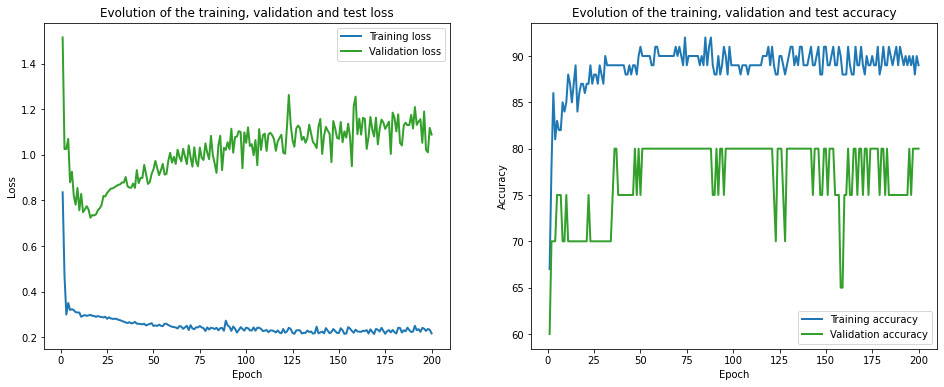

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 150.87it/s]


Initialization done!


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1261.76it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 1.30 train_acc: 10.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 2.37 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.19 train_acc: 80.00% took: 0.00s
val_loss = 1.13 val_acc = 60.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.38 train_acc: 70.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.3

Epoch 12 of 200, 30% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 40% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 12 of 200, 50% 	 train_loss: 0.55 train_acc: 60.00% took: 0.00s
Epoch 12 of 200, 60% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 70% 	 train_loss: 0.31 train_acc: 80.00% took: 0.02s
Epoch 12 of 200, 80% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 90% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 100% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
val_loss = 0.80 val_acc = 70.00%
Snapshot saved at epoch 12.
Epoch 13 of 200, 10% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 13 of 200, 20% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 13 of 200, 30% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
Epoch 13 of 200, 40% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 13 of 200, 50% 	 train_loss: 0.54 train_acc: 60.00% took: 0.02s
Epoch 13 of 200, 60% 	 trai

Epoch 27 of 200, 100% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
val_loss = 0.83 val_acc = 70.00%
Snapshot saved at epoch 27.
Epoch 28 of 200, 10% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 20% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 30% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 40% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 50% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 60% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 70% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 80% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 90% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 100% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
val_loss = 0.85 val_acc = 70.00%
Snapshot saved at epoch 28.
Epoch 29 of 200, 10% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 29 of 200, 20% 	 train_los

Epoch 38 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 90% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 100% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
val_loss = 0.91 val_acc = 70.00%
Snapshot saved at epoch 38.
Epoch 39 of 200, 10% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 39 of 200, 20% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 39 of 200, 30% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 39 of 200, 40% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 39 of 200, 50% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 39 of 200, 60% 	 train_loss: 0.11 train_acc: 100.00% took: 0.02s
Epoch 39 of 200, 70% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 39 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 39 of 200, 90% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 39 of 200, 100% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
val_loss = 0.86 val_acc 

Epoch 52 of 200, 70% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 52 of 200, 80% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 52 of 200, 90% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 52 of 200, 100% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
val_loss = 0.94 val_acc = 80.00%
Snapshot saved at epoch 52.
Epoch 53 of 200, 10% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 53 of 200, 20% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 53 of 200, 30% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 53 of 200, 40% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 53 of 200, 50% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 53 of 200, 60% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 53 of 200, 70% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 53 of 200, 80% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 53 of 200, 90% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 53 of 200, 100% 	 t

Epoch 63 of 200, 100% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
val_loss = 1.00 val_acc = 80.00%
Snapshot saved at epoch 63.
Epoch 64 of 200, 10% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 64 of 200, 20% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 64 of 200, 30% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
Epoch 64 of 200, 40% 	 train_loss: 0.29 train_acc: 90.00% took: 0.02s
Epoch 64 of 200, 50% 	 train_loss: 0.29 train_acc: 100.00% took: 0.00s
Epoch 64 of 200, 60% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 64 of 200, 70% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 64 of 200, 80% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 64 of 200, 90% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 64 of 200, 100% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
val_loss = 0.94 val_acc = 80.00%
Snapshot saved at epoch 64.
Epoch 65 of 200, 10% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 65 of 200, 20% 	 train_loss

Epoch 78 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 78 of 200, 80% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 78 of 200, 90% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 78 of 200, 100% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
val_loss = 0.95 val_acc = 80.00%
Snapshot saved at epoch 78.
Epoch 79 of 200, 10% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 79 of 200, 20% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 79 of 200, 30% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
Epoch 79 of 200, 40% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 79 of 200, 50% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 79 of 200, 60% 	 train_loss: 0.08 train_acc: 100.00% took: 0.01s
Epoch 79 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 79 of 200, 80% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 79 of 200, 90% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 79 of 200, 100% 	 t

Epoch 92 of 200, 50% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 92 of 200, 60% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 92 of 200, 70% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 92 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 92 of 200, 90% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 92 of 200, 100% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
val_loss = 0.98 val_acc = 80.00%
Snapshot saved at epoch 92.
Epoch 93 of 200, 10% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 93 of 200, 20% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 93 of 200, 30% 	 train_loss: 0.45 train_acc: 90.00% took: 0.00s
Epoch 93 of 200, 40% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 93 of 200, 50% 	 train_loss: 0.25 train_acc: 100.00% took: 0.00s
Epoch 93 of 200, 60% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 93 of 200, 70% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 93 of 200, 80% 	 t

Epoch 103 of 200, 20% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 103 of 200, 30% 	 train_loss: 0.44 train_acc: 90.00% took: 0.00s
Epoch 103 of 200, 40% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 103 of 200, 50% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 103 of 200, 60% 	 train_loss: 0.07 train_acc: 100.00% took: 0.01s
Epoch 103 of 200, 70% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 103 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 103 of 200, 90% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 103 of 200, 100% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
val_loss = 1.14 val_acc = 75.00%
Snapshot saved at epoch 103.
Epoch 104 of 200, 10% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 104 of 200, 20% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 104 of 200, 30% 	 train_loss: 0.45 train_acc: 90.00% took: 0.00s
Epoch 104 of 200, 40% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 104 of

Epoch 119 of 200, 50% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 119 of 200, 60% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 119 of 200, 70% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 119 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 119 of 200, 90% 	 train_loss: 0.26 train_acc: 80.00% took: 0.02s
Epoch 119 of 200, 100% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
val_loss = 1.15 val_acc = 75.00%
Snapshot saved at epoch 119.
Epoch 120 of 200, 10% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 120 of 200, 20% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 120 of 200, 30% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 120 of 200, 40% 	 train_loss: 0.29 train_acc: 90.00% took: 0.02s
Epoch 120 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 120 of 200, 60% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 120 of 200, 70% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 120 o

Epoch 130 of 200, 50% 	 train_loss: 0.26 train_acc: 100.00% took: 0.00s
Epoch 130 of 200, 60% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 130 of 200, 70% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 130 of 200, 80% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 130 of 200, 90% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 130 of 200, 100% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
val_loss = 1.00 val_acc = 80.00%
Snapshot saved at epoch 130.
Epoch 131 of 200, 10% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 131 of 200, 20% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 131 of 200, 30% 	 train_loss: 0.45 train_acc: 90.00% took: 0.00s
Epoch 131 of 200, 40% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 131 of 200, 50% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 131 of 200, 60% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 131 of 200, 70% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 131 

Epoch 145 of 200, 60% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 145 of 200, 70% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 145 of 200, 80% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 145 of 200, 90% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 145 of 200, 100% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
val_loss = 1.09 val_acc = 80.00%
Snapshot saved at epoch 145.
Epoch 146 of 200, 10% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 146 of 200, 20% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 146 of 200, 30% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 146 of 200, 40% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 146 of 200, 50% 	 train_loss: 0.33 train_acc: 70.00% took: 0.00s
Epoch 146 of 200, 60% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 146 of 200, 70% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 146 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 14

Epoch 159 of 200, 60% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 159 of 200, 70% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 159 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 159 of 200, 90% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 159 of 200, 100% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
val_loss = 1.15 val_acc = 75.00%
Snapshot saved at epoch 159.
Epoch 160 of 200, 10% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 160 of 200, 20% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 160 of 200, 30% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 160 of 200, 40% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 160 of 200, 50% 	 train_loss: 0.38 train_acc: 70.00% took: 0.00s
Epoch 160 of 200, 60% 	 train_loss: 0.06 train_acc: 100.00% took: 0.01s
Epoch 160 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 160 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 16

Epoch 175 of 200, 70% 	 train_loss: 0.06 train_acc: 100.00% took: 0.02s
Epoch 175 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 175 of 200, 90% 	 train_loss: 0.37 train_acc: 80.00% took: 0.01s
Epoch 175 of 200, 100% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
val_loss = 1.11 val_acc = 80.00%
Snapshot saved at epoch 175.
Epoch 176 of 200, 10% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 176 of 200, 20% 	 train_loss: 0.15 train_acc: 90.00% took: 0.01s
Epoch 176 of 200, 30% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 176 of 200, 40% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 176 of 200, 50% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 176 of 200, 60% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 176 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.02s
Epoch 176 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 176 of 200, 90% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 176

Epoch 190 of 200, 100% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
val_loss = 1.16 val_acc = 80.00%
Snapshot saved at epoch 190.
Epoch 191 of 200, 10% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 191 of 200, 20% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 191 of 200, 30% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 191 of 200, 40% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 191 of 200, 50% 	 train_loss: 0.40 train_acc: 70.00% took: 0.00s
Epoch 191 of 200, 60% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 191 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 191 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 191 of 200, 90% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 191 of 200, 100% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
val_loss = 1.17 val_acc = 80.00%
Snapshot saved at epoch 191.
Epoch 192 of 200, 10% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 192 of 200, 2

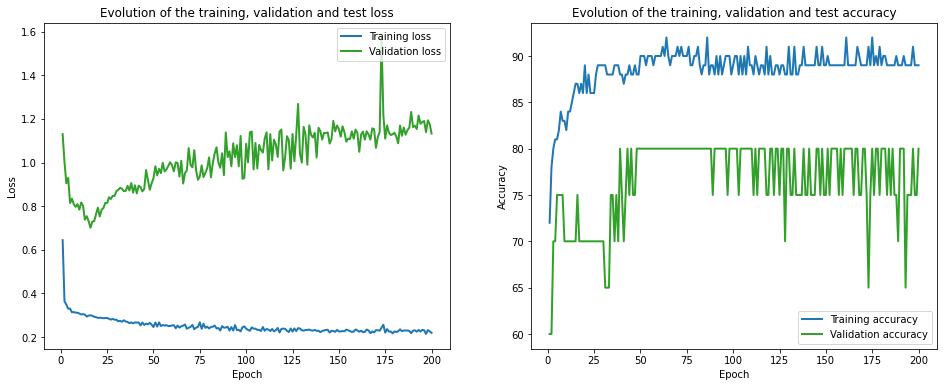

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 144.88it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 985.85it/s]

Finished computing p-values for 500 test points.

Starting repetition 26 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.70 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 1.63 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 1.06 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.66 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 1.01 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
val_loss = 0.24 val_acc = 90.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.3

Epoch 11 of 200, 100% 	 train_loss: 0.38 train_acc: 70.00% took: 0.00s
val_loss = 0.19 val_acc = 90.00%
Snapshot saved at epoch 11.
Epoch 12 of 200, 10% 	 train_loss: 0.53 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 20% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 30% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 40% 	 train_loss: 0.71 train_acc: 70.00% took: 0.00s
Epoch 12 of 200, 50% 	 train_loss: 0.25 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 60% 	 train_loss: 0.51 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 70% 	 train_loss: 0.82 train_acc: 60.00% took: 0.00s
Epoch 12 of 200, 80% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 90% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 100% 	 train_loss: 0.65 train_acc: 70.00% took: 0.00s
val_loss = 0.22 val_acc = 85.00%
Snapshot saved at epoch 12.
Epoch 13 of 200, 10% 	 train_loss: 0.74 train_acc: 90.00% took: 0.00s
Epoch 13 of 200, 20% 	 train_loss:

Epoch 22 of 200, 90% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 22 of 200, 100% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
val_loss = 0.18 val_acc = 90.00%
Snapshot saved at epoch 22.
Epoch 23 of 200, 10% 	 train_loss: 0.63 train_acc: 90.00% took: 0.00s
Epoch 23 of 200, 20% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 23 of 200, 30% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 23 of 200, 40% 	 train_loss: 0.70 train_acc: 70.00% took: 0.00s
Epoch 23 of 200, 50% 	 train_loss: 0.25 train_acc: 100.00% took: 0.00s
Epoch 23 of 200, 60% 	 train_loss: 0.57 train_acc: 90.00% took: 0.00s
Epoch 23 of 200, 70% 	 train_loss: 0.79 train_acc: 60.00% took: 0.00s
Epoch 23 of 200, 80% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 23 of 200, 90% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 23 of 200, 100% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
val_loss = 0.22 val_acc = 90.00%
Snapshot saved at epoch 23.
Epoch 24 of 200, 10% 	 train_loss:

val_loss = 0.36 val_acc = 85.00%
Snapshot saved at epoch 33.
Epoch 34 of 200, 10% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 34 of 200, 20% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
Epoch 34 of 200, 30% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 34 of 200, 40% 	 train_loss: 0.62 train_acc: 50.00% took: 0.00s
Epoch 34 of 200, 50% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 34 of 200, 60% 	 train_loss: 0.48 train_acc: 90.00% took: 0.00s
Epoch 34 of 200, 70% 	 train_loss: 0.89 train_acc: 60.00% took: 0.00s
Epoch 34 of 200, 80% 	 train_loss: 1.05 train_acc: 90.00% took: 0.00s
Epoch 34 of 200, 90% 	 train_loss: 0.59 train_acc: 50.00% took: 0.00s
Epoch 34 of 200, 100% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
val_loss = 0.20 val_acc = 90.00%
Snapshot saved at epoch 34.
Epoch 35 of 200, 10% 	 train_loss: 0.58 train_acc: 90.00% took: 0.00s
Epoch 35 of 200, 20% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 35 of 200, 30% 	 train_loss: 0

Epoch 48 of 200, 20% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 48 of 200, 30% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
Epoch 48 of 200, 40% 	 train_loss: 0.70 train_acc: 70.00% took: 0.00s
Epoch 48 of 200, 50% 	 train_loss: 0.26 train_acc: 100.00% took: 0.00s
Epoch 48 of 200, 60% 	 train_loss: 0.61 train_acc: 90.00% took: 0.00s
Epoch 48 of 200, 70% 	 train_loss: 0.74 train_acc: 60.00% took: 0.00s
Epoch 48 of 200, 80% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 48 of 200, 90% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 48 of 200, 100% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
val_loss = 0.19 val_acc = 90.00%
Snapshot saved at epoch 48.
Epoch 49 of 200, 10% 	 train_loss: 0.56 train_acc: 90.00% took: 0.00s
Epoch 49 of 200, 20% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 49 of 200, 30% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 49 of 200, 40% 	 train_loss: 0.70 train_acc: 60.00% took: 0.00s
Epoch 49 of 200, 50% 	 tra

Epoch 63 of 200, 30% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 63 of 200, 40% 	 train_loss: 0.69 train_acc: 70.00% took: 0.00s
Epoch 63 of 200, 50% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 63 of 200, 60% 	 train_loss: 0.65 train_acc: 90.00% took: 0.00s
Epoch 63 of 200, 70% 	 train_loss: 0.61 train_acc: 60.00% took: 0.00s
Epoch 63 of 200, 80% 	 train_loss: 0.58 train_acc: 80.00% took: 0.00s
Epoch 63 of 200, 90% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 63 of 200, 100% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
val_loss = 0.22 val_acc = 85.00%
Snapshot saved at epoch 63.
Epoch 64 of 200, 10% 	 train_loss: 0.57 train_acc: 90.00% took: 0.00s
Epoch 64 of 200, 20% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 64 of 200, 30% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 64 of 200, 40% 	 train_loss: 0.69 train_acc: 70.00% took: 0.00s
Epoch 64 of 200, 50% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 64 of 200, 60% 	 train

Epoch 75 of 200, 80% 	 train_loss: 0.22 train_acc: 100.00% took: 0.01s
Epoch 75 of 200, 90% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 75 of 200, 100% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
val_loss = 0.15 val_acc = 90.00%
Snapshot saved at epoch 75.
Epoch 76 of 200, 10% 	 train_loss: 0.67 train_acc: 90.00% took: 0.00s
Epoch 76 of 200, 20% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 76 of 200, 30% 	 train_loss: 0.45 train_acc: 90.00% took: 0.00s
Epoch 76 of 200, 40% 	 train_loss: 0.69 train_acc: 70.00% took: 0.00s
Epoch 76 of 200, 50% 	 train_loss: 0.25 train_acc: 100.00% took: 0.00s
Epoch 76 of 200, 60% 	 train_loss: 0.57 train_acc: 90.00% took: 0.00s
Epoch 76 of 200, 70% 	 train_loss: 0.78 train_acc: 60.00% took: 0.00s
Epoch 76 of 200, 80% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 76 of 200, 90% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 76 of 200, 100% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
val_loss = 0.19 val_acc 

Epoch 86 of 200, 60% 	 train_loss: 0.68 train_acc: 90.00% took: 0.02s
Epoch 86 of 200, 70% 	 train_loss: 0.55 train_acc: 60.00% took: 0.00s
Epoch 86 of 200, 80% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 86 of 200, 90% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 86 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.17 val_acc = 90.00%
Snapshot saved at epoch 86.
Epoch 87 of 200, 10% 	 train_loss: 0.67 train_acc: 90.00% took: 0.00s
Epoch 87 of 200, 20% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 87 of 200, 30% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
Epoch 87 of 200, 40% 	 train_loss: 0.69 train_acc: 60.00% took: 0.00s
Epoch 87 of 200, 50% 	 train_loss: 0.25 train_acc: 100.00% took: 0.02s
Epoch 87 of 200, 60% 	 train_loss: 0.55 train_acc: 90.00% took: 0.00s
Epoch 87 of 200, 70% 	 train_loss: 0.76 train_acc: 60.00% took: 0.00s
Epoch 87 of 200, 80% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 87 of 200, 90% 	 tr

val_loss = 0.31 val_acc = 85.00%
Snapshot saved at epoch 100.
Epoch 101 of 200, 10% 	 train_loss: 0.53 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 20% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 30% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 40% 	 train_loss: 0.69 train_acc: 70.00% took: 0.01s
Epoch 101 of 200, 50% 	 train_loss: 0.28 train_acc: 100.00% took: 0.00s
Epoch 101 of 200, 60% 	 train_loss: 0.62 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 70% 	 train_loss: 0.75 train_acc: 60.00% took: 0.00s
Epoch 101 of 200, 80% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 101 of 200, 90% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 100% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
val_loss = 0.20 val_acc = 90.00%
Snapshot saved at epoch 101.
Epoch 102 of 200, 10% 	 train_loss: 0.62 train_acc: 90.00% took: 0.00s
Epoch 102 of 200, 20% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 102 of 200, 3

Epoch 114 of 200, 80% 	 train_loss: 0.78 train_acc: 80.00% took: 0.01s
Epoch 114 of 200, 90% 	 train_loss: 0.54 train_acc: 60.00% took: 0.00s
Epoch 114 of 200, 100% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
val_loss = 0.26 val_acc = 85.00%
Snapshot saved at epoch 114.
Epoch 115 of 200, 10% 	 train_loss: 0.49 train_acc: 90.00% took: 0.01s
Epoch 115 of 200, 20% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 115 of 200, 30% 	 train_loss: 0.37 train_acc: 90.00% took: 0.01s
Epoch 115 of 200, 40% 	 train_loss: 0.69 train_acc: 60.00% took: 0.00s
Epoch 115 of 200, 50% 	 train_loss: 0.31 train_acc: 100.00% took: 0.00s
Epoch 115 of 200, 60% 	 train_loss: 0.46 train_acc: 90.00% took: 0.01s
Epoch 115 of 200, 70% 	 train_loss: 0.76 train_acc: 60.00% took: 0.00s
Epoch 115 of 200, 80% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 115 of 200, 90% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
Epoch 115 of 200, 100% 	 train_loss: 1.08 train_acc: 50.00% took: 0.01s
val_loss = 0

Epoch 127 of 200, 80% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 127 of 200, 90% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 127 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 0.17 val_acc = 90.00%
Snapshot saved at epoch 127.
Epoch 128 of 200, 10% 	 train_loss: 0.65 train_acc: 90.00% took: 0.00s
Epoch 128 of 200, 20% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 128 of 200, 30% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 128 of 200, 40% 	 train_loss: 0.69 train_acc: 60.00% took: 0.00s
Epoch 128 of 200, 50% 	 train_loss: 0.25 train_acc: 100.00% took: 0.00s
Epoch 128 of 200, 60% 	 train_loss: 0.56 train_acc: 90.00% took: 0.00s
Epoch 128 of 200, 70% 	 train_loss: 0.77 train_acc: 60.00% took: 0.00s
Epoch 128 of 200, 80% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 128 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 128 of 200, 100% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
val_loss =

Epoch 140 of 200, 10% 	 train_loss: 0.67 train_acc: 30.00% took: 0.00s
Epoch 140 of 200, 20% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 140 of 200, 30% 	 train_loss: 0.47 train_acc: 90.00% took: 0.00s
Epoch 140 of 200, 40% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 140 of 200, 50% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 140 of 200, 60% 	 train_loss: 0.67 train_acc: 90.00% took: 0.00s
Epoch 140 of 200, 70% 	 train_loss: 0.58 train_acc: 60.00% took: 0.00s
Epoch 140 of 200, 80% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 140 of 200, 90% 	 train_loss: 0.75 train_acc: 80.00% took: 0.00s
Epoch 140 of 200, 100% 	 train_loss: 0.85 train_acc: 40.00% took: 0.00s
val_loss = 0.27 val_acc = 95.00%
Snapshot saved at epoch 140.
Epoch 141 of 200, 10% 	 train_loss: 0.76 train_acc: 30.00% took: 0.00s
Epoch 141 of 200, 20% 	 train_loss: 0.37 train_acc: 100.00% took: 0.00s
Epoch 141 of 200, 30% 	 train_loss: 0.44 train_acc: 90.00% took: 0.00s
Epoch 141 of 

Epoch 154 of 200, 10% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 154 of 200, 20% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 154 of 200, 30% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 154 of 200, 40% 	 train_loss: 0.68 train_acc: 50.00% took: 0.00s
Epoch 154 of 200, 50% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 154 of 200, 60% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 154 of 200, 70% 	 train_loss: 0.79 train_acc: 60.00% took: 0.00s
Epoch 154 of 200, 80% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 154 of 200, 90% 	 train_loss: 0.69 train_acc: 80.00% took: 0.00s
Epoch 154 of 200, 100% 	 train_loss: 0.70 train_acc: 30.00% took: 0.00s
val_loss = 0.13 val_acc = 95.00%
Snapshot saved at epoch 154.
Epoch 155 of 200, 10% 	 train_loss: 0.52 train_acc: 70.00% took: 0.00s
Epoch 155 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 155 of 200, 30% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 155 of

Epoch 167 of 200, 60% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 167 of 200, 70% 	 train_loss: 0.84 train_acc: 60.00% took: 0.00s
Epoch 167 of 200, 80% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 167 of 200, 90% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 167 of 200, 100% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
val_loss = 0.12 val_acc = 100.00%
Snapshot saved at epoch 167.
Epoch 168 of 200, 10% 	 train_loss: 0.52 train_acc: 70.00% took: 0.00s
Epoch 168 of 200, 20% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 168 of 200, 30% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 168 of 200, 40% 	 train_loss: 0.62 train_acc: 60.00% took: 0.00s
Epoch 168 of 200, 50% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 168 of 200, 60% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 168 of 200, 70% 	 train_loss: 0.72 train_acc: 60.00% took: 0.00s
Epoch 168 of 200, 80% 	 train_loss: 0.70 train_acc: 70.00% took: 0.00s
Epoch 168 o

Epoch 180 of 200, 70% 	 train_loss: 0.78 train_acc: 60.00% took: 0.00s
Epoch 180 of 200, 80% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 180 of 200, 90% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 180 of 200, 100% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
val_loss = 0.16 val_acc = 95.00%
Snapshot saved at epoch 180.
Epoch 181 of 200, 10% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 181 of 200, 20% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 181 of 200, 30% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 181 of 200, 40% 	 train_loss: 0.61 train_acc: 70.00% took: 0.00s
Epoch 181 of 200, 50% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 181 of 200, 60% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 181 of 200, 70% 	 train_loss: 0.80 train_acc: 60.00% took: 0.00s
Epoch 181 of 200, 80% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 181 of 200, 90% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 181 of 

Epoch 194 of 200, 10% 	 train_loss: 0.39 train_acc: 80.00% took: 0.01s
Epoch 194 of 200, 20% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 194 of 200, 30% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 194 of 200, 40% 	 train_loss: 0.61 train_acc: 70.00% took: 0.00s
Epoch 194 of 200, 50% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 194 of 200, 60% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 194 of 200, 70% 	 train_loss: 0.79 train_acc: 70.00% took: 0.00s
Epoch 194 of 200, 80% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 194 of 200, 90% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 194 of 200, 100% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
val_loss = 0.15 val_acc = 95.00%
Snapshot saved at epoch 194.
Epoch 195 of 200, 10% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 195 of 200, 20% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 195 of 200, 30% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 195 of 

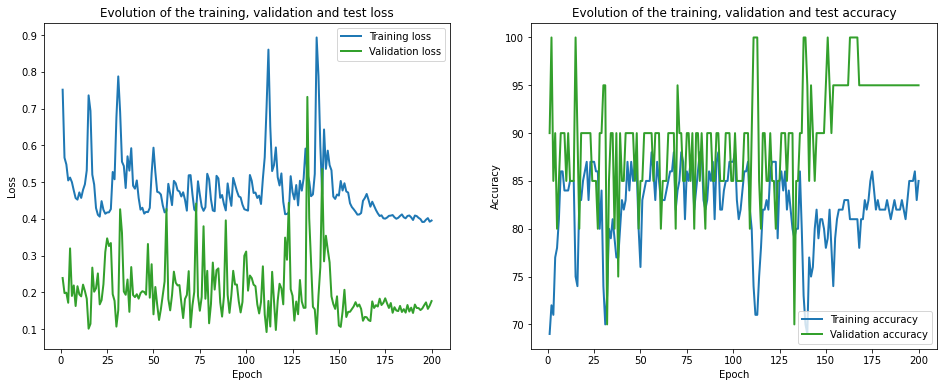

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 117.90it/s]


Initialization done!


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 864.94it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.76 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 1.97 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 1.29 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.63 train_acc: 60.00% took: 0.01s
Epoch 1 of 200, 60% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 1.02 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.73 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
val_loss = 0.31 val_acc = 90.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.73 train_acc: 70.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.65 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.4

Epoch 16 of 200, 90% 	 train_loss: 0.34 train_acc: 90.00% took: 0.01s
Epoch 16 of 200, 100% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
val_loss = 0.10 val_acc = 95.00%
Snapshot saved at epoch 16.
Epoch 17 of 200, 10% 	 train_loss: 0.93 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 20% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 30% 	 train_loss: 0.49 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 40% 	 train_loss: 0.70 train_acc: 70.00% took: 0.00s
Epoch 17 of 200, 50% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 60% 	 train_loss: 0.63 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 70% 	 train_loss: 0.70 train_acc: 60.00% took: 0.00s
Epoch 17 of 200, 80% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 90% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 100% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
val_loss = 0.24 val_acc = 85.00%
Snapshot saved at epoch 17.
Epoch 18 of 200, 10% 	 train_loss: 0

Epoch 29 of 200, 60% 	 train_loss: 0.58 train_acc: 90.00% took: 0.00s
Epoch 29 of 200, 70% 	 train_loss: 0.77 train_acc: 60.00% took: 0.00s
Epoch 29 of 200, 80% 	 train_loss: 0.25 train_acc: 90.00% took: 0.01s
Epoch 29 of 200, 90% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 29 of 200, 100% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
val_loss = 0.36 val_acc = 85.00%
Snapshot saved at epoch 29.
Epoch 30 of 200, 10% 	 train_loss: 0.51 train_acc: 90.00% took: 0.00s
Epoch 30 of 200, 20% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 30 of 200, 30% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 30 of 200, 40% 	 train_loss: 0.69 train_acc: 70.00% took: 0.00s
Epoch 30 of 200, 50% 	 train_loss: 0.26 train_acc: 100.00% took: 0.00s
Epoch 30 of 200, 60% 	 train_loss: 0.56 train_acc: 90.00% took: 0.00s
Epoch 30 of 200, 70% 	 train_loss: 0.79 train_acc: 60.00% took: 0.00s
Epoch 30 of 200, 80% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 30 of 200, 90% 	 tr

Epoch 42 of 200, 10% 	 train_loss: 0.57 train_acc: 90.00% took: 0.00s
Epoch 42 of 200, 20% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 42 of 200, 30% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 42 of 200, 40% 	 train_loss: 0.69 train_acc: 60.00% took: 0.00s
Epoch 42 of 200, 50% 	 train_loss: 0.26 train_acc: 100.00% took: 0.00s
Epoch 42 of 200, 60% 	 train_loss: 0.60 train_acc: 90.00% took: 0.00s
Epoch 42 of 200, 70% 	 train_loss: 0.75 train_acc: 70.00% took: 0.00s
Epoch 42 of 200, 80% 	 train_loss: 0.78 train_acc: 80.00% took: 0.00s
Epoch 42 of 200, 90% 	 train_loss: 0.60 train_acc: 50.00% took: 0.00s
Epoch 42 of 200, 100% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
val_loss = 0.31 val_acc = 85.00%
Snapshot saved at epoch 42.
Epoch 43 of 200, 10% 	 train_loss: 0.89 train_acc: 90.00% took: 0.00s
Epoch 43 of 200, 20% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 43 of 200, 30% 	 train_loss: 0.45 train_acc: 90.00% took: 0.00s
Epoch 43 of 200, 40% 	 trai

val_loss = 0.24 val_acc = 95.00%
Snapshot saved at epoch 56.
Epoch 57 of 200, 10% 	 train_loss: 0.95 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 20% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 57 of 200, 30% 	 train_loss: 0.44 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 40% 	 train_loss: 0.72 train_acc: 60.00% took: 0.01s
Epoch 57 of 200, 50% 	 train_loss: 0.30 train_acc: 90.00% took: 0.01s
Epoch 57 of 200, 60% 	 train_loss: 0.60 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 70% 	 train_loss: 0.69 train_acc: 60.00% took: 0.00s
Epoch 57 of 200, 80% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 57 of 200, 90% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 100% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
val_loss = 0.42 val_acc = 80.00%
Snapshot saved at epoch 57.
Epoch 58 of 200, 10% 	 train_loss: 0.39 train_acc: 90.00% took: 0.01s
Epoch 58 of 200, 20% 	 train_loss: 0.52 train_acc: 90.00% took: 0.01s
Epoch 58 of 200, 30% 	 train_loss: 0.

Epoch 69 of 200, 50% 	 train_loss: 0.26 train_acc: 100.00% took: 0.00s
Epoch 69 of 200, 60% 	 train_loss: 0.47 train_acc: 90.00% took: 0.00s
Epoch 69 of 200, 70% 	 train_loss: 0.72 train_acc: 60.00% took: 0.00s
Epoch 69 of 200, 80% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 69 of 200, 90% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 69 of 200, 100% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
val_loss = 0.18 val_acc = 90.00%
Snapshot saved at epoch 69.
Epoch 70 of 200, 10% 	 train_loss: 0.62 train_acc: 90.00% took: 0.00s
Epoch 70 of 200, 20% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 70 of 200, 30% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 70 of 200, 40% 	 train_loss: 0.67 train_acc: 70.00% took: 0.00s
Epoch 70 of 200, 50% 	 train_loss: 0.26 train_acc: 100.00% took: 0.00s
Epoch 70 of 200, 60% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 70 of 200, 70% 	 train_loss: 0.79 train_acc: 60.00% took: 0.00s
Epoch 70 of 200, 80% 	 tr

Epoch 80 of 200, 40% 	 train_loss: 0.67 train_acc: 70.00% took: 0.00s
Epoch 80 of 200, 50% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 80 of 200, 60% 	 train_loss: 0.47 train_acc: 90.00% took: 0.00s
Epoch 80 of 200, 70% 	 train_loss: 0.76 train_acc: 60.00% took: 0.00s
Epoch 80 of 200, 80% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 80 of 200, 90% 	 train_loss: 0.87 train_acc: 80.00% took: 0.00s
Epoch 80 of 200, 100% 	 train_loss: 1.05 train_acc: 30.00% took: 0.00s
val_loss = 0.13 val_acc = 90.00%
Snapshot saved at epoch 80.
Epoch 81 of 200, 10% 	 train_loss: 2.12 train_acc: 80.00% took: 0.00s
Epoch 81 of 200, 20% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 81 of 200, 30% 	 train_loss: 0.54 train_acc: 90.00% took: 0.00s
Epoch 81 of 200, 40% 	 train_loss: 0.69 train_acc: 70.00% took: 0.00s
Epoch 81 of 200, 50% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 81 of 200, 60% 	 train_loss: 1.00 train_acc: 90.00% took: 0.00s
Epoch 81 of 200, 70% 	 tra

Epoch 93 of 200, 60% 	 train_loss: 0.48 train_acc: 90.00% took: 0.00s
Epoch 93 of 200, 70% 	 train_loss: 0.73 train_acc: 60.00% took: 0.00s
Epoch 93 of 200, 80% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 93 of 200, 90% 	 train_loss: 0.63 train_acc: 90.00% took: 0.00s
Epoch 93 of 200, 100% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
val_loss = 0.10 val_acc = 95.00%
Snapshot saved at epoch 93.
Epoch 94 of 200, 10% 	 train_loss: 1.07 train_acc: 80.00% took: 0.00s
Epoch 94 of 200, 20% 	 train_loss: 0.33 train_acc: 80.00% took: 0.01s
Epoch 94 of 200, 30% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 94 of 200, 40% 	 train_loss: 0.76 train_acc: 60.00% took: 0.00s
Epoch 94 of 200, 50% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 94 of 200, 60% 	 train_loss: 0.54 train_acc: 90.00% took: 0.00s
Epoch 94 of 200, 70% 	 train_loss: 0.77 train_acc: 50.00% took: 0.01s
Epoch 94 of 200, 80% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 94 of 200, 90% 	 trai

Epoch 107 of 200, 100% 	 train_loss: 1.13 train_acc: 30.00% took: 0.00s
val_loss = 0.10 val_acc = 90.00%
Snapshot saved at epoch 107.
Epoch 108 of 200, 10% 	 train_loss: 1.13 train_acc: 90.00% took: 0.01s
Epoch 108 of 200, 20% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 108 of 200, 30% 	 train_loss: 0.74 train_acc: 90.00% took: 0.00s
Epoch 108 of 200, 40% 	 train_loss: 1.06 train_acc: 50.00% took: 0.00s
Epoch 108 of 200, 50% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 108 of 200, 60% 	 train_loss: 0.76 train_acc: 90.00% took: 0.00s
Epoch 108 of 200, 70% 	 train_loss: 0.74 train_acc: 60.00% took: 0.01s
Epoch 108 of 200, 80% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 108 of 200, 90% 	 train_loss: 1.50 train_acc: 90.00% took: 0.01s
Epoch 108 of 200, 100% 	 train_loss: 1.10 train_acc: 30.00% took: 0.00s
val_loss = 0.16 val_acc = 90.00%
Snapshot saved at epoch 108.
Epoch 109 of 200, 10% 	 train_loss: 0.93 train_acc: 90.00% took: 0.01s
Epoch 109 of 200, 20%

Epoch 120 of 200, 30% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 120 of 200, 40% 	 train_loss: 0.66 train_acc: 60.00% took: 0.01s
Epoch 120 of 200, 50% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 120 of 200, 60% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 120 of 200, 70% 	 train_loss: 0.69 train_acc: 70.00% took: 0.00s
Epoch 120 of 200, 80% 	 train_loss: 1.05 train_acc: 80.00% took: 0.01s
Epoch 120 of 200, 90% 	 train_loss: 0.66 train_acc: 50.00% took: 0.00s
Epoch 120 of 200, 100% 	 train_loss: 0.13 train_acc: 100.00% took: 0.01s
val_loss = 0.23 val_acc = 85.00%
Snapshot saved at epoch 120.
Epoch 121 of 200, 10% 	 train_loss: 1.07 train_acc: 90.00% took: 0.00s
Epoch 121 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 121 of 200, 30% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
Epoch 121 of 200, 40% 	 train_loss: 0.67 train_acc: 60.00% took: 0.01s
Epoch 121 of 200, 50% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 121 of

Epoch 132 of 200, 90% 	 train_loss: 0.61 train_acc: 60.00% took: 0.01s
Epoch 132 of 200, 100% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
val_loss = 0.19 val_acc = 90.00%
Snapshot saved at epoch 132.
Epoch 133 of 200, 10% 	 train_loss: 0.63 train_acc: 90.00% took: 0.01s
Epoch 133 of 200, 20% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 133 of 200, 30% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 133 of 200, 40% 	 train_loss: 0.66 train_acc: 70.00% took: 0.00s
Epoch 133 of 200, 50% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 133 of 200, 60% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 133 of 200, 70% 	 train_loss: 0.73 train_acc: 60.00% took: 0.00s
Epoch 133 of 200, 80% 	 train_loss: 0.26 train_acc: 100.00% took: 0.00s
Epoch 133 of 200, 90% 	 train_loss: 0.50 train_acc: 90.00% took: 0.00s
Epoch 133 of 200, 100% 	 train_loss: 0.36 train_acc: 90.00% took: 0.01s
val_loss = 0.16 val_acc = 90.00%
Snapshot saved at epoch 133.
Epoch 134 of 200, 10%

Epoch 148 of 200, 60% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 148 of 200, 70% 	 train_loss: 0.79 train_acc: 60.00% took: 0.01s
Epoch 148 of 200, 80% 	 train_loss: 0.67 train_acc: 80.00% took: 0.00s
Epoch 148 of 200, 90% 	 train_loss: 0.77 train_acc: 70.00% took: 0.00s
Epoch 148 of 200, 100% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
val_loss = 0.19 val_acc = 90.00%
Snapshot saved at epoch 148.
Epoch 149 of 200, 10% 	 train_loss: 0.90 train_acc: 90.00% took: 0.00s
Epoch 149 of 200, 20% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 149 of 200, 30% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 149 of 200, 40% 	 train_loss: 0.68 train_acc: 70.00% took: 0.00s
Epoch 149 of 200, 50% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 149 of 200, 60% 	 train_loss: 0.47 train_acc: 90.00% took: 0.00s
Epoch 149 of 200, 70% 	 train_loss: 0.79 train_acc: 60.00% took: 0.00s
Epoch 149 of 200, 80% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 149 o

Epoch 161 of 200, 10% 	 train_loss: 0.69 train_acc: 90.00% took: 0.00s
Epoch 161 of 200, 20% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 161 of 200, 30% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 161 of 200, 40% 	 train_loss: 0.66 train_acc: 60.00% took: 0.00s
Epoch 161 of 200, 50% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 161 of 200, 60% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 161 of 200, 70% 	 train_loss: 0.79 train_acc: 60.00% took: 0.00s
Epoch 161 of 200, 80% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 161 of 200, 90% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 161 of 200, 100% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
val_loss = 0.22 val_acc = 90.00%
Snapshot saved at epoch 161.
Epoch 162 of 200, 10% 	 train_loss: 0.64 train_acc: 90.00% took: 0.00s
Epoch 162 of 200, 20% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 162 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 162 o

Epoch 173 of 200, 90% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 173 of 200, 100% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
val_loss = 0.17 val_acc = 90.00%
Snapshot saved at epoch 173.
Epoch 174 of 200, 10% 	 train_loss: 0.63 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 20% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 30% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 40% 	 train_loss: 0.67 train_acc: 70.00% took: 0.00s
Epoch 174 of 200, 50% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 174 of 200, 60% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 70% 	 train_loss: 0.74 train_acc: 60.00% took: 0.00s
Epoch 174 of 200, 80% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 174 of 200, 90% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 174 of 200, 100% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
val_loss = 0.14 val_acc = 90.00%
Snapshot saved at epoch 174.
Epoch 175 of 200, 10

Epoch 187 of 200, 100% 	 train_loss: 0.79 train_acc: 30.00% took: 0.00s
val_loss = 0.16 val_acc = 100.00%
Snapshot saved at epoch 187.
Epoch 188 of 200, 10% 	 train_loss: 0.83 train_acc: 30.00% took: 0.00s
Epoch 188 of 200, 20% 	 train_loss: 0.44 train_acc: 90.00% took: 0.00s
Epoch 188 of 200, 30% 	 train_loss: 0.49 train_acc: 90.00% took: 0.00s
Epoch 188 of 200, 40% 	 train_loss: 0.67 train_acc: 60.00% took: 0.00s
Epoch 188 of 200, 50% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 188 of 200, 60% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 188 of 200, 70% 	 train_loss: 0.60 train_acc: 60.00% took: 0.00s
Epoch 188 of 200, 80% 	 train_loss: 0.70 train_acc: 80.00% took: 0.00s
Epoch 188 of 200, 90% 	 train_loss: 0.61 train_acc: 50.00% took: 0.00s
Epoch 188 of 200, 100% 	 train_loss: 0.49 train_acc: 90.00% took: 0.00s
val_loss = 0.18 val_acc = 85.00%
Snapshot saved at epoch 188.
Epoch 189 of 200, 10% 	 train_loss: 0.51 train_acc: 90.00% took: 0.00s
Epoch 189 of 200, 20%

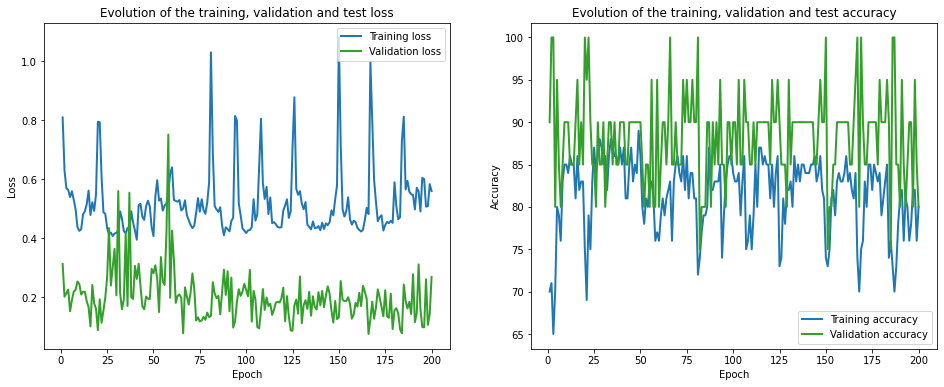

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 124.43it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1075.03it/s]

Finished computing p-values for 500 test points.

Starting repetition 27 of 50:




C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


Training with standard data splitting...
===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.75 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.64 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.79 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.74 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
val_loss = 0.20 val_acc = 100.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.57 train_acc: 80.00% took: 

Epoch 12 of 200, 70% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 80% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 90% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss = 0.22 val_acc = 100.00%
Snapshot saved at epoch 12.
Epoch 13 of 200, 10% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 13 of 200, 20% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 13 of 200, 30% 	 train_loss: 0.63 train_acc: 80.00% took: 0.01s
Epoch 13 of 200, 40% 	 train_loss: 0.67 train_acc: 50.00% took: 0.00s
Epoch 13 of 200, 50% 	 train_loss: 0.64 train_acc: 70.00% took: 0.00s
Epoch 13 of 200, 60% 	 train_loss: 0.71 train_acc: 60.00% took: 0.00s
Epoch 13 of 200, 70% 	 train_loss: 0.18 train_acc: 100.00% took: 0.01s
Epoch 13 of 200, 80% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 13 of 200, 90% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
Epoch 13 of 200, 100% 

Epoch 25 of 200, 80% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 25 of 200, 90% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 25 of 200, 100% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
val_loss = 0.25 val_acc = 95.00%
Snapshot saved at epoch 25.
Epoch 26 of 200, 10% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 26 of 200, 20% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 26 of 200, 30% 	 train_loss: 0.66 train_acc: 80.00% took: 0.00s
Epoch 26 of 200, 40% 	 train_loss: 0.71 train_acc: 50.00% took: 0.00s
Epoch 26 of 200, 50% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 26 of 200, 60% 	 train_loss: 0.70 train_acc: 50.00% took: 0.00s
Epoch 26 of 200, 70% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 26 of 200, 80% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 26 of 200, 90% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 26 of 200, 100% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
val_loss = 0.23 val_ac

Epoch 38 of 200, 30% 	 train_loss: 0.80 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 40% 	 train_loss: 0.63 train_acc: 50.00% took: 0.00s
Epoch 38 of 200, 50% 	 train_loss: 0.35 train_acc: 70.00% took: 0.00s
Epoch 38 of 200, 60% 	 train_loss: 0.62 train_acc: 70.00% took: 0.00s
Epoch 38 of 200, 70% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 80% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 90% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 100% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
val_loss = 0.28 val_acc = 95.00%
Snapshot saved at epoch 38.
Epoch 39 of 200, 10% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 39 of 200, 20% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 39 of 200, 30% 	 train_loss: 0.84 train_acc: 80.00% took: 0.00s
Epoch 39 of 200, 40% 	 train_loss: 0.62 train_acc: 50.00% took: 0.01s
Epoch 39 of 200, 50% 	 train_loss: 0.33 train_acc: 70.00% took: 0.00s
Epoch 39 of 200, 60% 	 tr

Epoch 51 of 200, 30% 	 train_loss: 0.84 train_acc: 80.00% took: 0.00s
Epoch 51 of 200, 40% 	 train_loss: 0.59 train_acc: 60.00% took: 0.00s
Epoch 51 of 200, 50% 	 train_loss: 0.38 train_acc: 70.00% took: 0.01s
Epoch 51 of 200, 60% 	 train_loss: 0.77 train_acc: 60.00% took: 0.00s
Epoch 51 of 200, 70% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 51 of 200, 80% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 51 of 200, 90% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 51 of 200, 100% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
val_loss = 0.33 val_acc = 95.00%
Snapshot saved at epoch 51.
Epoch 52 of 200, 10% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 52 of 200, 20% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 52 of 200, 30% 	 train_loss: 0.87 train_acc: 80.00% took: 0.00s
Epoch 52 of 200, 40% 	 train_loss: 0.60 train_acc: 60.00% took: 0.00s
Epoch 52 of 200, 50% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 52 of 200, 60% 	 tr

Epoch 65 of 200, 10% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 65 of 200, 20% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 65 of 200, 30% 	 train_loss: 0.77 train_acc: 80.00% took: 0.00s
Epoch 65 of 200, 40% 	 train_loss: 0.51 train_acc: 60.00% took: 0.00s
Epoch 65 of 200, 50% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 65 of 200, 60% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 65 of 200, 70% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 65 of 200, 80% 	 train_loss: 0.21 train_acc: 90.00% took: 0.01s
Epoch 65 of 200, 90% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 65 of 200, 100% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
val_loss = 0.33 val_acc = 85.00%
Snapshot saved at epoch 65.
Epoch 66 of 200, 10% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 66 of 200, 20% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 66 of 200, 30% 	 train_loss: 0.75 train_acc: 80.00% took: 0.00s
Epoch 66 of 200, 40% 	 

val_loss = 0.36 val_acc = 75.00%
Snapshot saved at epoch 75.
Epoch 76 of 200, 10% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 76 of 200, 20% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 76 of 200, 30% 	 train_loss: 0.72 train_acc: 80.00% took: 0.00s
Epoch 76 of 200, 40% 	 train_loss: 0.49 train_acc: 60.00% took: 0.00s
Epoch 76 of 200, 50% 	 train_loss: 0.37 train_acc: 70.00% took: 0.00s
Epoch 76 of 200, 60% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 76 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 76 of 200, 80% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 76 of 200, 90% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 76 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss = 0.35 val_acc = 85.00%
Snapshot saved at epoch 76.
Epoch 77 of 200, 10% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 77 of 200, 20% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 77 of 200, 30% 	 train_los

Epoch 90 of 200, 20% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 90 of 200, 30% 	 train_loss: 0.66 train_acc: 80.00% took: 0.00s
Epoch 90 of 200, 40% 	 train_loss: 0.45 train_acc: 90.00% took: 0.00s
Epoch 90 of 200, 50% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 90 of 200, 60% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 90 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 90 of 200, 80% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 90 of 200, 90% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 90 of 200, 100% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
val_loss = 0.35 val_acc = 70.00%
Snapshot saved at epoch 90.
Epoch 91 of 200, 10% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 91 of 200, 20% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 91 of 200, 30% 	 train_loss: 0.64 train_acc: 80.00% took: 0.00s
Epoch 91 of 200, 40% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 91 of 200, 50% 	 t

Epoch 101 of 200, 10% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 101 of 200, 20% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 101 of 200, 30% 	 train_loss: 0.65 train_acc: 80.00% took: 0.00s
Epoch 101 of 200, 40% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 50% 	 train_loss: 0.52 train_acc: 70.00% took: 0.00s
Epoch 101 of 200, 60% 	 train_loss: 0.50 train_acc: 60.00% took: 0.00s
Epoch 101 of 200, 70% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 80% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 90% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 101 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss = 0.34 val_acc = 75.00%
Snapshot saved at epoch 101.
Epoch 102 of 200, 10% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 102 of 200, 20% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 102 of 200, 30% 	 train_loss: 0.65 train_acc: 80.00% took: 0.00s
Epoch 102 

Epoch 111 of 200, 80% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 90% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 111 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss = 0.34 val_acc = 75.00%
Snapshot saved at epoch 111.
Epoch 112 of 200, 10% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 112 of 200, 20% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 112 of 200, 30% 	 train_loss: 0.65 train_acc: 80.00% took: 0.00s
Epoch 112 of 200, 40% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 112 of 200, 50% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 112 of 200, 60% 	 train_loss: 0.49 train_acc: 60.00% took: 0.00s
Epoch 112 of 200, 70% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 112 of 200, 80% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 112 of 200, 90% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 112 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss = 

Epoch 122 of 200, 80% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 122 of 200, 90% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 122 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss = 0.34 val_acc = 70.00%
Snapshot saved at epoch 122.
Epoch 123 of 200, 10% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 123 of 200, 20% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 123 of 200, 30% 	 train_loss: 0.64 train_acc: 80.00% took: 0.00s
Epoch 123 of 200, 40% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 123 of 200, 50% 	 train_loss: 0.52 train_acc: 70.00% took: 0.00s
Epoch 123 of 200, 60% 	 train_loss: 0.49 train_acc: 60.00% took: 0.00s
Epoch 123 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 123 of 200, 80% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 123 of 200, 90% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 123 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss =

Epoch 136 of 200, 40% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 136 of 200, 50% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 136 of 200, 60% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 136 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 136 of 200, 80% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 136 of 200, 90% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 136 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss = 0.34 val_acc = 75.00%
Snapshot saved at epoch 136.
Epoch 137 of 200, 10% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 137 of 200, 20% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 137 of 200, 30% 	 train_loss: 0.65 train_acc: 80.00% took: 0.00s
Epoch 137 of 200, 40% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
Epoch 137 of 200, 50% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 137 of 200, 60% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 137 o

Epoch 147 of 200, 40% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 147 of 200, 50% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 147 of 200, 60% 	 train_loss: 0.52 train_acc: 60.00% took: 0.00s
Epoch 147 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 147 of 200, 80% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 147 of 200, 90% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 147 of 200, 100% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
val_loss = 0.35 val_acc = 70.00%
Snapshot saved at epoch 147.
Epoch 148 of 200, 10% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 148 of 200, 20% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 148 of 200, 30% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 148 of 200, 40% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 148 of 200, 50% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 148 of 200, 60% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 148 o

Epoch 160 of 200, 40% 	 train_loss: 0.44 train_acc: 90.00% took: 0.00s
Epoch 160 of 200, 50% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 160 of 200, 60% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 160 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 160 of 200, 80% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 160 of 200, 90% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 160 of 200, 100% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
val_loss = 0.34 val_acc = 75.00%
Snapshot saved at epoch 160.
Epoch 161 of 200, 10% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 161 of 200, 20% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 161 of 200, 30% 	 train_loss: 0.63 train_acc: 80.00% took: 0.00s
Epoch 161 of 200, 40% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 161 of 200, 50% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 161 of 200, 60% 	 train_loss: 0.51 train_acc: 60.00% took: 0.01s
Epoch 161 o

val_loss = 0.33 val_acc = 70.00%
Snapshot saved at epoch 173.
Epoch 174 of 200, 10% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 174 of 200, 20% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 174 of 200, 30% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 174 of 200, 40% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 50% 	 train_loss: 0.49 train_acc: 70.00% took: 0.01s
Epoch 174 of 200, 60% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 174 of 200, 70% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 174 of 200, 80% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 90% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 174 of 200, 100% 	 train_loss: 0.35 train_acc: 70.00% took: 0.01s
val_loss = 0.34 val_acc = 70.00%
Snapshot saved at epoch 174.
Epoch 175 of 200, 10% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 175 of 200, 20% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 175 of 200, 

Epoch 188 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.02s
Epoch 188 of 200, 80% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 188 of 200, 90% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 188 of 200, 100% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
val_loss = 0.33 val_acc = 70.00%
Snapshot saved at epoch 188.
Epoch 189 of 200, 10% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 189 of 200, 20% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 189 of 200, 30% 	 train_loss: 0.64 train_acc: 80.00% took: 0.00s
Epoch 189 of 200, 40% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
Epoch 189 of 200, 50% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 189 of 200, 60% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 189 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 189 of 200, 80% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 189 of 200, 90% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 189 

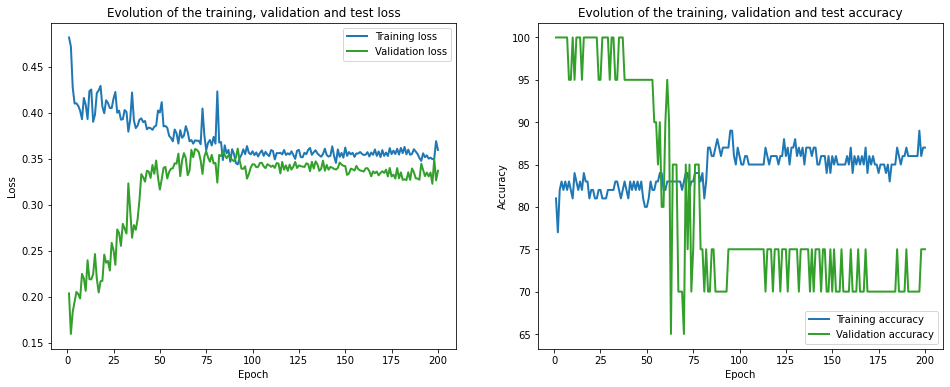

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 123.46it/s]


Initialization done!


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1007.02it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.62 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.68 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 2.43 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.61 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 1.02 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.74 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
val_loss = 0.15 val_acc = 100.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.

Epoch 13 of 200, 90% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 13 of 200, 100% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
val_loss = 0.22 val_acc = 100.00%
Snapshot saved at epoch 13.
Epoch 14 of 200, 10% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 14 of 200, 20% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 14 of 200, 30% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 14 of 200, 40% 	 train_loss: 0.61 train_acc: 50.00% took: 0.00s
Epoch 14 of 200, 50% 	 train_loss: 0.70 train_acc: 70.00% took: 0.00s
Epoch 14 of 200, 60% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 14 of 200, 70% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 14 of 200, 80% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 14 of 200, 90% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 14 of 200, 100% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
val_loss = 0.23 val_acc = 100.00%
Snapshot saved at epoch 14.
Epoch 15 of 200, 10% 	 train_lo

Epoch 28 of 200, 10% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 20% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 30% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 40% 	 train_loss: 0.63 train_acc: 50.00% took: 0.00s
Epoch 28 of 200, 50% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 28 of 200, 60% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 70% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 80% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 90% 	 train_loss: 0.43 train_acc: 80.00% took: 0.01s
Epoch 28 of 200, 100% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
val_loss = 0.28 val_acc = 95.00%
Snapshot saved at epoch 28.
Epoch 29 of 200, 10% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 29 of 200, 20% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 29 of 200, 30% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 29 of 200, 40% 	 

Epoch 43 of 200, 50% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 43 of 200, 60% 	 train_loss: 0.52 train_acc: 70.00% took: 0.00s
Epoch 43 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 43 of 200, 80% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 43 of 200, 90% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 43 of 200, 100% 	 train_loss: 0.31 train_acc: 90.00% took: 0.02s
val_loss = 0.31 val_acc = 75.00%
Snapshot saved at epoch 43.
Epoch 44 of 200, 10% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 44 of 200, 20% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 44 of 200, 30% 	 train_loss: 0.79 train_acc: 80.00% took: 0.00s
Epoch 44 of 200, 40% 	 train_loss: 0.48 train_acc: 90.00% took: 0.00s
Epoch 44 of 200, 50% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 44 of 200, 60% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 44 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 44 of 200, 80% 	 tra

Epoch 57 of 200, 40% 	 train_loss: 0.48 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 50% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 57 of 200, 60% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 57 of 200, 70% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 80% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 90% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 57 of 200, 100% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
val_loss = 0.33 val_acc = 75.00%
Snapshot saved at epoch 57.
Epoch 58 of 200, 10% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 58 of 200, 20% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 58 of 200, 30% 	 train_loss: 0.78 train_acc: 80.00% took: 0.00s
Epoch 58 of 200, 40% 	 train_loss: 0.47 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 50% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 58 of 200, 60% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 58 of 200, 70% 	 tra

Epoch 72 of 200, 40% 	 train_loss: 0.48 train_acc: 90.00% took: 0.00s
Epoch 72 of 200, 50% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 72 of 200, 60% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 72 of 200, 70% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 72 of 200, 80% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 72 of 200, 90% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 72 of 200, 100% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
val_loss = 0.35 val_acc = 75.00%
Snapshot saved at epoch 72.
Epoch 73 of 200, 10% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 73 of 200, 20% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 73 of 200, 30% 	 train_loss: 0.77 train_acc: 80.00% took: 0.00s
Epoch 73 of 200, 40% 	 train_loss: 0.48 train_acc: 90.00% took: 0.00s
Epoch 73 of 200, 50% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 73 of 200, 60% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 73 of 200, 70% 	 tra

Epoch 87 of 200, 100% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
val_loss = 0.35 val_acc = 75.00%
Snapshot saved at epoch 87.
Epoch 88 of 200, 10% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 88 of 200, 20% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 88 of 200, 30% 	 train_loss: 0.80 train_acc: 80.00% took: 0.00s
Epoch 88 of 200, 40% 	 train_loss: 0.48 train_acc: 90.00% took: 0.00s
Epoch 88 of 200, 50% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 88 of 200, 60% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 88 of 200, 70% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 88 of 200, 80% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 88 of 200, 90% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 88 of 200, 100% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
val_loss = 0.34 val_acc = 75.00%
Snapshot saved at epoch 88.
Epoch 89 of 200, 10% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 89 of 200, 20% 	 train_loss

Epoch 101 of 200, 100% 	 train_loss: 0.28 train_acc: 90.00% took: 0.01s
val_loss = 0.35 val_acc = 75.00%
Snapshot saved at epoch 101.
Epoch 102 of 200, 10% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 102 of 200, 20% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 102 of 200, 30% 	 train_loss: 0.78 train_acc: 80.00% took: 0.00s
Epoch 102 of 200, 40% 	 train_loss: 0.47 train_acc: 90.00% took: 0.00s
Epoch 102 of 200, 50% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 102 of 200, 60% 	 train_loss: 0.47 train_acc: 60.00% took: 0.00s
Epoch 102 of 200, 70% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 102 of 200, 80% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 102 of 200, 90% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 102 of 200, 100% 	 train_loss: 0.29 train_acc: 90.00% took: 0.01s
val_loss = 0.34 val_acc = 75.00%
Snapshot saved at epoch 102.
Epoch 103 of 200, 10% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 103 of 200, 

Epoch 116 of 200, 40% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 116 of 200, 50% 	 train_loss: 0.40 train_acc: 70.00% took: 0.00s
Epoch 116 of 200, 60% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 116 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 116 of 200, 80% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 116 of 200, 90% 	 train_loss: 0.48 train_acc: 80.00% took: 0.01s
Epoch 116 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss = 0.35 val_acc = 70.00%
Snapshot saved at epoch 116.
Epoch 117 of 200, 10% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 117 of 200, 20% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 117 of 200, 30% 	 train_loss: 0.78 train_acc: 80.00% took: 0.00s
Epoch 117 of 200, 40% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 117 of 200, 50% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 117 of 200, 60% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 117 o

Epoch 130 of 200, 20% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 130 of 200, 30% 	 train_loss: 0.77 train_acc: 80.00% took: 0.00s
Epoch 130 of 200, 40% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 130 of 200, 50% 	 train_loss: 0.40 train_acc: 70.00% took: 0.00s
Epoch 130 of 200, 60% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 130 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 130 of 200, 80% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 130 of 200, 90% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 130 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss = 0.35 val_acc = 70.00%
Snapshot saved at epoch 130.
Epoch 131 of 200, 10% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 131 of 200, 20% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 131 of 200, 30% 	 train_loss: 0.78 train_acc: 80.00% took: 0.00s
Epoch 131 of 200, 40% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 131 

Epoch 143 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 143 of 200, 80% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 143 of 200, 90% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 143 of 200, 100% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
val_loss = 0.34 val_acc = 70.00%
Snapshot saved at epoch 143.
Epoch 144 of 200, 10% 	 train_loss: 0.16 train_acc: 100.00% took: 0.01s
Epoch 144 of 200, 20% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 144 of 200, 30% 	 train_loss: 0.77 train_acc: 80.00% took: 0.00s
Epoch 144 of 200, 40% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 144 of 200, 50% 	 train_loss: 0.33 train_acc: 70.00% took: 0.00s
Epoch 144 of 200, 60% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 144 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 144 of 200, 80% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 144 of 200, 90% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 144 

Epoch 156 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 156 of 200, 80% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 156 of 200, 90% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 156 of 200, 100% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
val_loss = 0.35 val_acc = 70.00%
Snapshot saved at epoch 156.
Epoch 157 of 200, 10% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 157 of 200, 20% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 157 of 200, 30% 	 train_loss: 0.76 train_acc: 80.00% took: 0.00s
Epoch 157 of 200, 40% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 157 of 200, 50% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 157 of 200, 60% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 157 of 200, 70% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 157 of 200, 80% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 157 of 200, 90% 	 train_loss: 0.57 train_acc: 80.00% took: 0.01s
Epoch 157 

Epoch 169 of 200, 10% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 169 of 200, 20% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 169 of 200, 30% 	 train_loss: 0.75 train_acc: 80.00% took: 0.00s
Epoch 169 of 200, 40% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 169 of 200, 50% 	 train_loss: 0.35 train_acc: 70.00% took: 0.00s
Epoch 169 of 200, 60% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 169 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 169 of 200, 80% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 169 of 200, 90% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 169 of 200, 100% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
val_loss = 0.35 val_acc = 70.00%
Snapshot saved at epoch 169.
Epoch 170 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 170 of 200, 20% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 170 of 200, 30% 	 train_loss: 0.77 train_acc: 80.00% took: 0.00s
Epoch 170

val_loss = 0.35 val_acc = 75.00%
Snapshot saved at epoch 183.
Epoch 184 of 200, 10% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 184 of 200, 20% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 184 of 200, 30% 	 train_loss: 0.76 train_acc: 80.00% took: 0.00s
Epoch 184 of 200, 40% 	 train_loss: 0.47 train_acc: 90.00% took: 0.00s
Epoch 184 of 200, 50% 	 train_loss: 0.43 train_acc: 70.00% took: 0.01s
Epoch 184 of 200, 60% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 184 of 200, 70% 	 train_loss: 0.14 train_acc: 90.00% took: 0.01s
Epoch 184 of 200, 80% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 184 of 200, 90% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 184 of 200, 100% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
val_loss = 0.36 val_acc = 75.00%
Snapshot saved at epoch 184.
Epoch 185 of 200, 10% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 185 of 200, 20% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 185 of 200, 3

Epoch 197 of 200, 20% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 197 of 200, 30% 	 train_loss: 0.78 train_acc: 80.00% took: 0.00s
Epoch 197 of 200, 40% 	 train_loss: 0.47 train_acc: 90.00% took: 0.00s
Epoch 197 of 200, 50% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 197 of 200, 60% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 197 of 200, 70% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 197 of 200, 80% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 197 of 200, 90% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 197 of 200, 100% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
val_loss = 0.35 val_acc = 75.00%
Snapshot saved at epoch 197.
Epoch 198 of 200, 10% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 198 of 200, 20% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 198 of 200, 30% 	 train_loss: 0.77 train_acc: 80.00% took: 0.00s
Epoch 198 of 200, 40% 	 train_loss: 0.48 train_acc: 90.00% took: 0.00s
Epoch 198 o

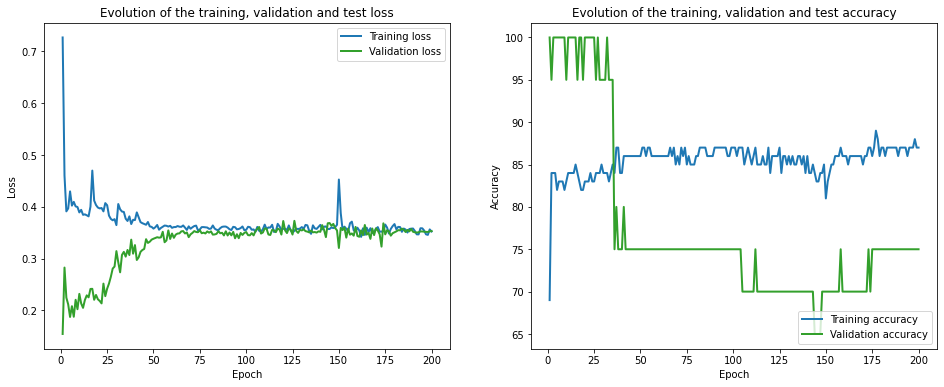

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 115.36it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 908.94it/s]

Finished computing p-values for 500 test points.

Starting repetition 28 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.79 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 1.35 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.63 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.98 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
val_loss = 0.68 val_acc = 70.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.11 train_acc: 100.00% took: 0.01s
Epoch 2 of 200, 20% 	 train_loss: 0.94 train_acc: 70.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 

Epoch 14 of 200, 40% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 14 of 200, 50% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 14 of 200, 60% 	 train_loss: 0.91 train_acc: 90.00% took: 0.00s
Epoch 14 of 200, 70% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 14 of 200, 80% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 14 of 200, 90% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 14 of 200, 100% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
val_loss = 0.64 val_acc = 75.00%
Snapshot saved at epoch 14.
Epoch 15 of 200, 10% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 15 of 200, 20% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 15 of 200, 30% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 15 of 200, 40% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 50% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 60% 	 train_loss: 1.06 train_acc: 80.00% took: 0.00s
Epoch 15 of 200, 70% 	 t

Epoch 25 of 200, 60% 	 train_loss: 1.09 train_acc: 70.00% took: 0.00s
Epoch 25 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 25 of 200, 80% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 25 of 200, 90% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 25 of 200, 100% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
val_loss = 0.61 val_acc = 75.00%
Snapshot saved at epoch 25.
Epoch 26 of 200, 10% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 26 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 26 of 200, 30% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 26 of 200, 40% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 26 of 200, 50% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 26 of 200, 60% 	 train_loss: 1.03 train_acc: 80.00% took: 0.00s
Epoch 26 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 26 of 200, 80% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 26 of 200, 90% 	 

Epoch 36 of 200, 60% 	 train_loss: 0.98 train_acc: 80.00% took: 0.00s
Epoch 36 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 36 of 200, 80% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 36 of 200, 90% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 36 of 200, 100% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
val_loss = 0.62 val_acc = 75.00%
Snapshot saved at epoch 36.
Epoch 37 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 37 of 200, 20% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 37 of 200, 30% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 37 of 200, 40% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 37 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 37 of 200, 60% 	 train_loss: 1.05 train_acc: 70.00% took: 0.00s
Epoch 37 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 37 of 200, 80% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 37 of 200, 90% 	 

Epoch 51 of 200, 60% 	 train_loss: 1.06 train_acc: 70.00% took: 0.00s
Epoch 51 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 51 of 200, 80% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 51 of 200, 90% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 51 of 200, 100% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
val_loss = 0.60 val_acc = 75.00%
Snapshot saved at epoch 51.
Epoch 52 of 200, 10% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 52 of 200, 20% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 52 of 200, 30% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 52 of 200, 40% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 52 of 200, 50% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 52 of 200, 60% 	 train_loss: 0.98 train_acc: 80.00% took: 0.00s
Epoch 52 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 52 of 200, 80% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 52 of 200, 90% 	 

Epoch 66 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 66 of 200, 20% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 66 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 66 of 200, 40% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 66 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 66 of 200, 60% 	 train_loss: 0.98 train_acc: 80.00% took: 0.00s
Epoch 66 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 66 of 200, 80% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 66 of 200, 90% 	 train_loss: 0.06 train_acc: 100.00% took: 0.01s
Epoch 66 of 200, 100% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
val_loss = 0.59 val_acc = 75.00%
Snapshot saved at epoch 66.
Epoch 67 of 200, 10% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 67 of 200, 20% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 67 of 200, 30% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 67 of 200, 40% 	

val_loss = 0.58 val_acc = 75.00%
Snapshot saved at epoch 80.
Epoch 81 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 81 of 200, 20% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 81 of 200, 30% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 81 of 200, 40% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 81 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 81 of 200, 60% 	 train_loss: 1.01 train_acc: 80.00% took: 0.00s
Epoch 81 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 81 of 200, 80% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 81 of 200, 90% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 81 of 200, 100% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
val_loss = 0.59 val_acc = 75.00%
Snapshot saved at epoch 81.
Epoch 82 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 82 of 200, 20% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 82 of 200, 30% 	 train_los

Epoch 91 of 200, 90% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 91 of 200, 100% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
val_loss = 0.58 val_acc = 75.00%
Snapshot saved at epoch 91.
Epoch 92 of 200, 10% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 92 of 200, 20% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 92 of 200, 30% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 92 of 200, 40% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 92 of 200, 50% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 92 of 200, 60% 	 train_loss: 1.00 train_acc: 80.00% took: 0.00s
Epoch 92 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 92 of 200, 80% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 92 of 200, 90% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 92 of 200, 100% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
val_loss = 0.59 val_acc = 75.00%
Snapshot saved at epoch 92.
Epoch 93 of 200, 10% 	 train_lo

Epoch 102 of 200, 60% 	 train_loss: 0.95 train_acc: 80.00% took: 0.00s
Epoch 102 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 102 of 200, 80% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 102 of 200, 90% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 102 of 200, 100% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
val_loss = 0.58 val_acc = 75.00%
Snapshot saved at epoch 102.
Epoch 103 of 200, 10% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 103 of 200, 20% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 103 of 200, 30% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 103 of 200, 40% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 103 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 103 of 200, 60% 	 train_loss: 1.07 train_acc: 80.00% took: 0.00s
Epoch 103 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 103 of 200, 80% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 103

Epoch 116 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 116 of 200, 80% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 116 of 200, 90% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 116 of 200, 100% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
val_loss = 0.60 val_acc = 75.00%
Snapshot saved at epoch 116.
Epoch 117 of 200, 10% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 117 of 200, 20% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
Epoch 117 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 117 of 200, 40% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 117 of 200, 50% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 117 of 200, 60% 	 train_loss: 0.97 train_acc: 80.00% took: 0.00s
Epoch 117 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 117 of 200, 80% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 117 of 200, 90% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 117

Epoch 127 of 200, 60% 	 train_loss: 0.96 train_acc: 80.00% took: 0.00s
Epoch 127 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 127 of 200, 80% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 127 of 200, 90% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 127 of 200, 100% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
val_loss = 0.60 val_acc = 75.00%
Snapshot saved at epoch 127.
Epoch 128 of 200, 10% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 128 of 200, 20% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 128 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 128 of 200, 40% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 128 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 128 of 200, 60% 	 train_loss: 1.00 train_acc: 80.00% took: 0.00s
Epoch 128 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 128 of 200, 80% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 128

Epoch 142 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 142 of 200, 20% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 142 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 142 of 200, 40% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 142 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 142 of 200, 60% 	 train_loss: 0.96 train_acc: 80.00% took: 0.00s
Epoch 142 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 142 of 200, 80% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 142 of 200, 90% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 142 of 200, 100% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
val_loss = 0.60 val_acc = 75.00%
Snapshot saved at epoch 142.
Epoch 143 of 200, 10% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 143 of 200, 20% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
Epoch 143 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 143

Epoch 153 of 200, 40% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 153 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 153 of 200, 60% 	 train_loss: 0.97 train_acc: 80.00% took: 0.00s
Epoch 153 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 153 of 200, 80% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 153 of 200, 90% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 153 of 200, 100% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
val_loss = 0.61 val_acc = 75.00%
Snapshot saved at epoch 153.
Epoch 154 of 200, 10% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 154 of 200, 20% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 154 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 154 of 200, 40% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 154 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 154 of 200, 60% 	 train_loss: 0.94 train_acc: 80.00% took: 0.00s
Epoch 154 

val_loss = 0.58 val_acc = 75.00%
Snapshot saved at epoch 163.
Epoch 164 of 200, 10% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 164 of 200, 20% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 164 of 200, 30% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 164 of 200, 40% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 164 of 200, 50% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 164 of 200, 60% 	 train_loss: 1.00 train_acc: 80.00% took: 0.00s
Epoch 164 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 164 of 200, 80% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 164 of 200, 90% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 164 of 200, 100% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
val_loss = 0.58 val_acc = 75.00%
Snapshot saved at epoch 164.
Epoch 165 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 165 of 200, 20% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 165 of 200, 

Snapshot saved at epoch 174.
Epoch 175 of 200, 10% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 175 of 200, 20% 	 train_loss: 0.63 train_acc: 80.00% took: 0.00s
Epoch 175 of 200, 30% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 175 of 200, 40% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 175 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 175 of 200, 60% 	 train_loss: 1.12 train_acc: 80.00% took: 0.00s
Epoch 175 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 175 of 200, 80% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 175 of 200, 90% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 175 of 200, 100% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
val_loss = 0.59 val_acc = 75.00%
Snapshot saved at epoch 175.
Epoch 176 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 176 of 200, 20% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 176 of 200, 30% 	 train_loss: 0.04 train_acc:

val_loss = 0.61 val_acc = 75.00%
Snapshot saved at epoch 188.
Epoch 189 of 200, 10% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 189 of 200, 20% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
Epoch 189 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 189 of 200, 40% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 189 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 189 of 200, 60% 	 train_loss: 0.95 train_acc: 80.00% took: 0.00s
Epoch 189 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 189 of 200, 80% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 189 of 200, 90% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 189 of 200, 100% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
val_loss = 0.61 val_acc = 75.00%
Snapshot saved at epoch 189.
Epoch 190 of 200, 10% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 190 of 200, 20% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
Epoch 190 of 200, 3

Epoch 200 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 200 of 200, 40% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 200 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 200 of 200, 60% 	 train_loss: 0.96 train_acc: 80.00% took: 0.00s
Epoch 200 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 200 of 200, 80% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 200 of 200, 90% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 200 of 200, 100% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
val_loss = 0.62 val_acc = 70.00%
Snapshot saved at epoch 200.
Training done! A list of 200 models saved.


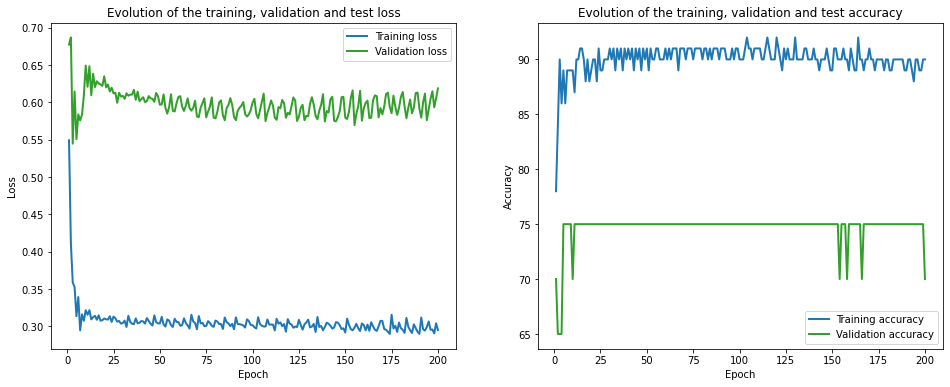

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 144.07it/s]


Initialization done!


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 959.02it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.63 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 1.87 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.66 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.76 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.76 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.28 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.28 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
val_loss = 0.62 val_acc = 60.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0

Epoch 16 of 200, 50% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 60% 	 train_loss: 0.99 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 70% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 80% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 90% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 100% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
val_loss = 0.58 val_acc = 75.00%
Snapshot saved at epoch 16.
Epoch 17 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 20% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 30% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 40% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 60% 	 train_loss: 1.04 train_acc: 70.00% took: 0.00s
Epoch 17 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 80% 	 

Epoch 30 of 200, 20% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 30 of 200, 30% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 30 of 200, 40% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 30 of 200, 50% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 30 of 200, 60% 	 train_loss: 0.99 train_acc: 80.00% took: 0.00s
Epoch 30 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 30 of 200, 80% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 30 of 200, 90% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 30 of 200, 100% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
val_loss = 0.57 val_acc = 75.00%
Snapshot saved at epoch 30.
Epoch 31 of 200, 10% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 31 of 200, 20% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 31 of 200, 30% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 31 of 200, 40% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 31 of 200, 50% 	 

Epoch 41 of 200, 30% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 41 of 200, 40% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 41 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 41 of 200, 60% 	 train_loss: 1.07 train_acc: 80.00% took: 0.00s
Epoch 41 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 41 of 200, 80% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 41 of 200, 90% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 41 of 200, 100% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
val_loss = 0.58 val_acc = 75.00%
Snapshot saved at epoch 41.
Epoch 42 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 42 of 200, 20% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 42 of 200, 30% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 42 of 200, 40% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 42 of 200, 50% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 42 of 200, 60% 	 

Epoch 54 of 200, 60% 	 train_loss: 0.98 train_acc: 80.00% took: 0.00s
Epoch 54 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 54 of 200, 80% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 54 of 200, 90% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 54 of 200, 100% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
val_loss = 0.59 val_acc = 75.00%
Snapshot saved at epoch 54.
Epoch 55 of 200, 10% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 55 of 200, 20% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
Epoch 55 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 55 of 200, 40% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 55 of 200, 50% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 55 of 200, 60% 	 train_loss: 0.98 train_acc: 80.00% took: 0.00s
Epoch 55 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 55 of 200, 80% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 55 of 200, 90% 	 t

val_loss = 0.58 val_acc = 75.00%
Snapshot saved at epoch 69.
Epoch 70 of 200, 10% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 70 of 200, 20% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 70 of 200, 30% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 70 of 200, 40% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 70 of 200, 50% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 70 of 200, 60% 	 train_loss: 1.02 train_acc: 80.00% took: 0.00s
Epoch 70 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.02s
Epoch 70 of 200, 80% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 70 of 200, 90% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 70 of 200, 100% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
val_loss = 0.58 val_acc = 75.00%
Snapshot saved at epoch 70.
Epoch 71 of 200, 10% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 71 of 200, 20% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
Epoch 71 of 200, 30% 	 train_los

Snapshot saved at epoch 80.
Epoch 81 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 81 of 200, 20% 	 train_loss: 0.62 train_acc: 80.00% took: 0.01s
Epoch 81 of 200, 30% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 81 of 200, 40% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 81 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 81 of 200, 60% 	 train_loss: 1.04 train_acc: 80.00% took: 0.00s
Epoch 81 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 81 of 200, 80% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 81 of 200, 90% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 81 of 200, 100% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
val_loss = 0.58 val_acc = 75.00%
Snapshot saved at epoch 81.
Epoch 82 of 200, 10% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 82 of 200, 20% 	 train_loss: 0.60 train_acc: 80.00% took: 0.01s
Epoch 82 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 

Epoch 93 of 200, 80% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 93 of 200, 90% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 93 of 200, 100% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
val_loss = 0.58 val_acc = 75.00%
Snapshot saved at epoch 93.
Epoch 94 of 200, 10% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 94 of 200, 20% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 94 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 94 of 200, 40% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 94 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 94 of 200, 60% 	 train_loss: 0.98 train_acc: 80.00% took: 0.00s
Epoch 94 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 94 of 200, 80% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 94 of 200, 90% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 94 of 200, 100% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
val_loss = 0.59 val_ac

Epoch 105 of 200, 10% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 105 of 200, 20% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 105 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 105 of 200, 40% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 105 of 200, 50% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 105 of 200, 60% 	 train_loss: 1.01 train_acc: 80.00% took: 0.00s
Epoch 105 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 105 of 200, 80% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 105 of 200, 90% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 105 of 200, 100% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
val_loss = 0.57 val_acc = 75.00%
Snapshot saved at epoch 105.
Epoch 106 of 200, 10% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 106 of 200, 20% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 106 of 200, 30% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 106

Epoch 119 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 119 of 200, 40% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 119 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.01s
Epoch 119 of 200, 60% 	 train_loss: 0.99 train_acc: 80.00% took: 0.00s
Epoch 119 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 119 of 200, 80% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 119 of 200, 90% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 119 of 200, 100% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
val_loss = 0.60 val_acc = 75.00%
Snapshot saved at epoch 119.
Epoch 120 of 200, 10% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 120 of 200, 20% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 120 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 120 of 200, 40% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 120 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 120

Epoch 133 of 200, 60% 	 train_loss: 1.02 train_acc: 80.00% took: 0.00s
Epoch 133 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.01s
Epoch 133 of 200, 80% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 133 of 200, 90% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 133 of 200, 100% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
val_loss = 0.60 val_acc = 75.00%
Snapshot saved at epoch 133.
Epoch 134 of 200, 10% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 134 of 200, 20% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
Epoch 134 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 134 of 200, 40% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 134 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 134 of 200, 60% 	 train_loss: 0.93 train_acc: 80.00% took: 0.00s
Epoch 134 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 134 of 200, 80% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 134

Epoch 144 of 200, 60% 	 train_loss: 0.97 train_acc: 80.00% took: 0.00s
Epoch 144 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 144 of 200, 80% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 144 of 200, 90% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 144 of 200, 100% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
val_loss = 0.62 val_acc = 70.00%
Snapshot saved at epoch 144.
Epoch 145 of 200, 10% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 145 of 200, 20% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
Epoch 145 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 145 of 200, 40% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 145 of 200, 50% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 145 of 200, 60% 	 train_loss: 0.95 train_acc: 80.00% took: 0.00s
Epoch 145 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 145 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 145 

Epoch 155 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 155 of 200, 40% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 155 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 155 of 200, 60% 	 train_loss: 1.04 train_acc: 80.00% took: 0.00s
Epoch 155 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 155 of 200, 80% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 155 of 200, 90% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 155 of 200, 100% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
val_loss = 0.61 val_acc = 75.00%
Snapshot saved at epoch 155.
Epoch 156 of 200, 10% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 156 of 200, 20% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 156 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 156 of 200, 40% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 156 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 156

Epoch 169 of 200, 90% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 169 of 200, 100% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
val_loss = 0.60 val_acc = 75.00%
Snapshot saved at epoch 169.
Epoch 170 of 200, 10% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 170 of 200, 20% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
Epoch 170 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 170 of 200, 40% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 170 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 170 of 200, 60% 	 train_loss: 0.93 train_acc: 80.00% took: 0.00s
Epoch 170 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 170 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 170 of 200, 90% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 170 of 200, 100% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
val_loss = 0.62 val_acc = 70.00%
Snapshot saved at epoch 170.
Epoch 171 of 200,

Epoch 180 of 200, 100% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
val_loss = 0.59 val_acc = 75.00%
Snapshot saved at epoch 180.
Epoch 181 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 181 of 200, 20% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 181 of 200, 30% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 181 of 200, 40% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 181 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 181 of 200, 60% 	 train_loss: 1.02 train_acc: 80.00% took: 0.00s
Epoch 181 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 181 of 200, 80% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 181 of 200, 90% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 181 of 200, 100% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
val_loss = 0.62 val_acc = 75.00%
Snapshot saved at epoch 181.
Epoch 182 of 200, 10% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 182 of 200,

Epoch 191 of 200, 80% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 191 of 200, 90% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 191 of 200, 100% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
val_loss = 0.62 val_acc = 75.00%
Snapshot saved at epoch 191.
Epoch 192 of 200, 10% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 192 of 200, 20% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
Epoch 192 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 192 of 200, 40% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 192 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 192 of 200, 60% 	 train_loss: 0.95 train_acc: 80.00% took: 0.00s
Epoch 192 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 192 of 200, 80% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 192 of 200, 90% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 192 of 200, 100% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
val_loss 

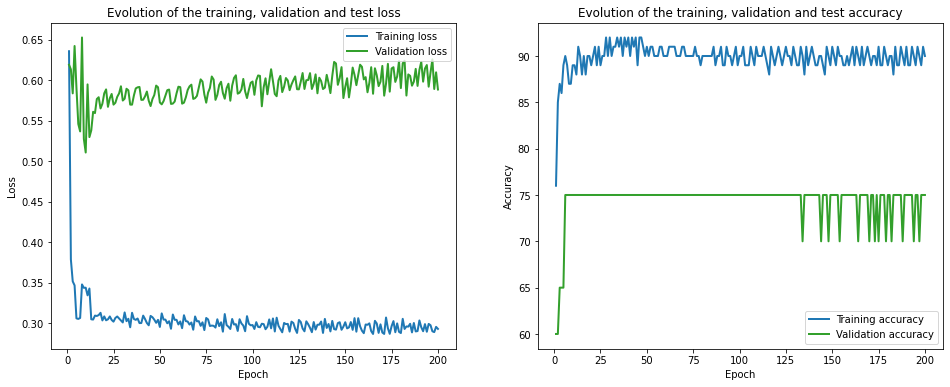

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 146.90it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1006.11it/s]

Finished computing p-values for 500 test points.

Starting repetition 29 of 50:




C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


Training with standard data splitting...
===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.76 train_acc: 10.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 1.06 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.53 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.47 train_acc: 90.00% took: 0.00s
val_loss = 0.54 val_acc = 85.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.49 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.82 train_acc: 50.00% took: 

Epoch 16 of 200, 70% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 80% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 90% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 100% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
val_loss = 0.62 val_acc = 80.00%
Snapshot saved at epoch 16.
Epoch 17 of 200, 10% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 20% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 30% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 40% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 50% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 60% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 80% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 90% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 100% 	 t

Epoch 32 of 200, 10% 	 train_loss: 0.40 train_acc: 90.00% took: 0.02s
Epoch 32 of 200, 20% 	 train_loss: 0.34 train_acc: 90.00% took: 0.01s
Epoch 32 of 200, 30% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 32 of 200, 40% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 32 of 200, 50% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 32 of 200, 60% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 32 of 200, 70% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 32 of 200, 80% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 32 of 200, 90% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 32 of 200, 100% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
val_loss = 0.68 val_acc = 70.00%
Snapshot saved at epoch 32.
Epoch 33 of 200, 10% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 33 of 200, 20% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 33 of 200, 30% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 33 of 200, 40% 	 tr

Epoch 47 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.02s
Epoch 47 of 200, 80% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 47 of 200, 90% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 47 of 200, 100% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
val_loss = 0.69 val_acc = 70.00%
Snapshot saved at epoch 47.
Epoch 48 of 200, 10% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 48 of 200, 20% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 48 of 200, 30% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 48 of 200, 40% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 48 of 200, 50% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 48 of 200, 60% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 48 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 48 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 48 of 200, 90% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 48 of 200, 100% 	

Epoch 58 of 200, 40% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 58 of 200, 50% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 58 of 200, 60% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 58 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 58 of 200, 90% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 100% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
val_loss = 0.75 val_acc = 70.00%
Snapshot saved at epoch 58.
Epoch 59 of 200, 10% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 59 of 200, 20% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 59 of 200, 30% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 59 of 200, 40% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 59 of 200, 50% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 59 of 200, 60% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 59 of 200, 70% 	 t

Epoch 74 of 200, 20% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 74 of 200, 30% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 74 of 200, 40% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 74 of 200, 50% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 74 of 200, 60% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 74 of 200, 70% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 74 of 200, 80% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 74 of 200, 90% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 74 of 200, 100% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
val_loss = 0.93 val_acc = 70.00%
Snapshot saved at epoch 74.
Epoch 75 of 200, 10% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
Epoch 75 of 200, 20% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 75 of 200, 30% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 75 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 75 of 200, 50% 	 t

Epoch 90 of 200, 10% 	 train_loss: 0.36 train_acc: 90.00% took: 0.01s
Epoch 90 of 200, 20% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 90 of 200, 30% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 90 of 200, 40% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 90 of 200, 50% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 90 of 200, 60% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 90 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 90 of 200, 80% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 90 of 200, 90% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 90 of 200, 100% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
val_loss = 1.06 val_acc = 65.00%
Snapshot saved at epoch 90.
Epoch 91 of 200, 10% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 91 of 200, 20% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 91 of 200, 30% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 91 of 200, 40% 	 tr

Epoch 105 of 200, 90% 	 train_loss: 0.13 train_acc: 90.00% took: 0.02s
Epoch 105 of 200, 100% 	 train_loss: 0.33 train_acc: 90.00% took: 0.01s
val_loss = 1.32 val_acc = 65.00%
Snapshot saved at epoch 105.
Epoch 106 of 200, 10% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 106 of 200, 20% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 106 of 200, 30% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 106 of 200, 40% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 106 of 200, 50% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 106 of 200, 60% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 106 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 106 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 106 of 200, 90% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 106 of 200, 100% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
val_loss = 1.38 val_acc = 65.00%
Snapshot saved at epoch 106.
Epoch 107 of 200, 1

val_loss = 1.58 val_acc = 60.00%
Snapshot saved at epoch 120.
Epoch 121 of 200, 10% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 121 of 200, 20% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 121 of 200, 30% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 121 of 200, 40% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 121 of 200, 50% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 121 of 200, 60% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 121 of 200, 70% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 121 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 121 of 200, 90% 	 train_loss: 0.07 train_acc: 90.00% took: 0.00s
Epoch 121 of 200, 100% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
val_loss = 1.57 val_acc = 65.00%
Snapshot saved at epoch 121.
Epoch 122 of 200, 10% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 122 of 200, 20% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 122 of 200, 30

val_loss = 1.77 val_acc = 60.00%
Snapshot saved at epoch 136.
Epoch 137 of 200, 10% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 137 of 200, 20% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 137 of 200, 30% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 137 of 200, 40% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 137 of 200, 50% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 137 of 200, 60% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 137 of 200, 70% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 137 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 137 of 200, 90% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 137 of 200, 100% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
val_loss = 1.38 val_acc = 65.00%
Snapshot saved at epoch 137.
Epoch 138 of 200, 10% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 138 of 200, 20% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 138 of 200, 30

Epoch 147 of 200, 90% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 147 of 200, 100% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
val_loss = 1.20 val_acc = 65.00%
Snapshot saved at epoch 147.
Epoch 148 of 200, 10% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 148 of 200, 20% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 148 of 200, 30% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 148 of 200, 40% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 148 of 200, 50% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 148 of 200, 60% 	 train_loss: 0.07 train_acc: 90.00% took: 0.00s
Epoch 148 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 148 of 200, 80% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 148 of 200, 90% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 148 of 200, 100% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
val_loss = 1.63 val_acc = 60.00%
Snapshot saved at epoch 148.
Epoch 149 of 200, 

Epoch 158 of 200, 70% 	 train_loss: 0.14 train_acc: 100.00% took: 0.02s
Epoch 158 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 158 of 200, 90% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 158 of 200, 100% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
val_loss = 1.94 val_acc = 60.00%
Snapshot saved at epoch 158.
Epoch 159 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 159 of 200, 20% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 159 of 200, 30% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 159 of 200, 40% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 159 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 159 of 200, 60% 	 train_loss: 0.07 train_acc: 90.00% took: 0.00s
Epoch 159 of 200, 70% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 159 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 159 of 200, 90% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 15

Epoch 174 of 200, 20% 	 train_loss: 0.31 train_acc: 90.00% took: 0.01s
Epoch 174 of 200, 30% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 40% 	 train_loss: 0.07 train_acc: 100.00% took: 0.01s
Epoch 174 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 60% 	 train_loss: 0.07 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 70% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 174 of 200, 90% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 174 of 200, 100% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
val_loss = 2.63 val_acc = 60.00%
Snapshot saved at epoch 174.
Epoch 175 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 175 of 200, 20% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 175 of 200, 30% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 175 of 200, 40% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 175 

Epoch 185 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.02s
val_loss = 1.50 val_acc = 65.00%
Snapshot saved at epoch 185.
Epoch 186 of 200, 10% 	 train_loss: 0.28 train_acc: 90.00% took: 0.01s
Epoch 186 of 200, 20% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 186 of 200, 30% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 186 of 200, 40% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 186 of 200, 50% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 186 of 200, 60% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 186 of 200, 70% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 186 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 186 of 200, 90% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 186 of 200, 100% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
val_loss = 2.07 val_acc = 60.00%
Snapshot saved at epoch 186.
Epoch 187 of 200, 10% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 187 of 200,

Epoch 196 of 200, 60% 	 train_loss: 0.07 train_acc: 100.00% took: 0.01s
Epoch 196 of 200, 70% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 196 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 196 of 200, 90% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 196 of 200, 100% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
val_loss = 2.24 val_acc = 60.00%
Snapshot saved at epoch 196.
Epoch 197 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 197 of 200, 20% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 197 of 200, 30% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 197 of 200, 40% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 197 of 200, 50% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 197 of 200, 60% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 197 of 200, 70% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 197 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 1

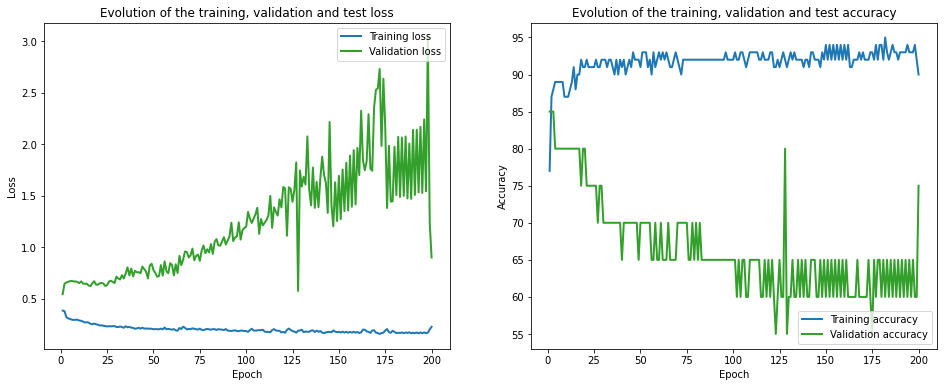

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 158.44it/s]


Initialization done!


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1031.28it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.96 train_acc: 20.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
val_loss = 0.44 val_acc = 90.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 1.10 train_acc: 50.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0

Epoch 16 of 200, 50% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 60% 	 train_loss: 0.08 train_acc: 90.00% took: 0.01s
Epoch 16 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 80% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 90% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 100% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
val_loss = 0.62 val_acc = 80.00%
Snapshot saved at epoch 16.
Epoch 17 of 200, 10% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 20% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 30% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 40% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 50% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 60% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 80% 	 t

Epoch 32 of 200, 10% 	 train_loss: 0.39 train_acc: 90.00% took: 0.01s
Epoch 32 of 200, 20% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 32 of 200, 30% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 32 of 200, 40% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 32 of 200, 50% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 32 of 200, 60% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 32 of 200, 70% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 32 of 200, 80% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 32 of 200, 90% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 32 of 200, 100% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
val_loss = 0.58 val_acc = 75.00%
Snapshot saved at epoch 32.
Epoch 33 of 200, 10% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 33 of 200, 20% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 33 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 33 of 200, 40% 	 tr

Epoch 47 of 200, 80% 	 train_loss: 0.11 train_acc: 100.00% took: 0.01s
Epoch 47 of 200, 90% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 47 of 200, 100% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
val_loss = 0.64 val_acc = 75.00%
Snapshot saved at epoch 47.
Epoch 48 of 200, 10% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 48 of 200, 20% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 48 of 200, 30% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 48 of 200, 40% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 48 of 200, 50% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 48 of 200, 60% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 48 of 200, 70% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 48 of 200, 80% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 48 of 200, 90% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 48 of 200, 100% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
val_loss = 0.62 val_ac

Epoch 63 of 200, 40% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 63 of 200, 50% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 63 of 200, 60% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 63 of 200, 70% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 63 of 200, 80% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 63 of 200, 90% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 63 of 200, 100% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
val_loss = 0.58 val_acc = 80.00%
Snapshot saved at epoch 63.
Epoch 64 of 200, 10% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 64 of 200, 20% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 64 of 200, 30% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 64 of 200, 40% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 64 of 200, 50% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 64 of 200, 60% 	 train_loss: 0.04 train_acc: 100.00% took: 0.02s
Epoch 64 of 200, 70% 	 

Epoch 77 of 200, 80% 	 train_loss: 0.12 train_acc: 100.00% took: 0.02s
Epoch 77 of 200, 90% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 77 of 200, 100% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
val_loss = 0.57 val_acc = 75.00%
Snapshot saved at epoch 77.
Epoch 78 of 200, 10% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 78 of 200, 20% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 78 of 200, 30% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 78 of 200, 40% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 78 of 200, 50% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 78 of 200, 60% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 78 of 200, 70% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 78 of 200, 80% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 78 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 78 of 200, 100% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
val_loss = 0.53 val_a

Epoch 88 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 88 of 200, 90% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 88 of 200, 100% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
val_loss = 0.66 val_acc = 70.00%
Snapshot saved at epoch 88.
Epoch 89 of 200, 10% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 20% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 89 of 200, 30% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 40% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 89 of 200, 50% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 60% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 89 of 200, 70% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 89 of 200, 80% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 89 of 200, 90% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 100% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
val_loss = 0.63 val_ac

Epoch 100 of 200, 10% 	 train_loss: 0.35 train_acc: 90.00% took: 0.02s
Epoch 100 of 200, 20% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 30% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 40% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 100 of 200, 50% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 60% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 100 of 200, 70% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 100 of 200, 80% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 100 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 100 of 200, 100% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
val_loss = 0.53 val_acc = 75.00%
Snapshot saved at epoch 100.
Epoch 101 of 200, 10% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 20% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 101 of 200, 30% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 101

Epoch 116 of 200, 60% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 116 of 200, 70% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 116 of 200, 80% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 116 of 200, 90% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 116 of 200, 100% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
val_loss = 0.61 val_acc = 75.00%
Snapshot saved at epoch 116.
Epoch 117 of 200, 10% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 117 of 200, 20% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 117 of 200, 30% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 117 of 200, 40% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 117 of 200, 50% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 117 of 200, 60% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 117 of 200, 70% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 117 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 1

Epoch 127 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 127 of 200, 90% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 127 of 200, 100% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
val_loss = 0.47 val_acc = 75.00%
Snapshot saved at epoch 127.
Epoch 128 of 200, 10% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 128 of 200, 20% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 128 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 128 of 200, 40% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 128 of 200, 50% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 128 of 200, 60% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 128 of 200, 70% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 128 of 200, 80% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 128 of 200, 90% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 128 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss

Epoch 138 of 200, 70% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 138 of 200, 80% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 138 of 200, 90% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 138 of 200, 100% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
val_loss = 0.52 val_acc = 75.00%
Snapshot saved at epoch 138.
Epoch 139 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 139 of 200, 20% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 139 of 200, 30% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 139 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 139 of 200, 50% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 139 of 200, 60% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 139 of 200, 70% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 139 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 139 of 200, 90% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 13

Epoch 149 of 200, 80% 	 train_loss: 0.10 train_acc: 100.00% took: 0.02s
Epoch 149 of 200, 90% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 149 of 200, 100% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
val_loss = 0.52 val_acc = 75.00%
Snapshot saved at epoch 149.
Epoch 150 of 200, 10% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 20% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 150 of 200, 30% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 40% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 150 of 200, 50% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 150 of 200, 60% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 150 of 200, 70% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 150 of 200, 80% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 150 of 200, 90% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 150 of 200, 100% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
val_lo

Epoch 165 of 200, 100% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
val_loss = 0.46 val_acc = 75.00%
Snapshot saved at epoch 165.
Epoch 166 of 200, 10% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 20% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 30% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 166 of 200, 50% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 166 of 200, 60% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 166 of 200, 70% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 166 of 200, 80% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 166 of 200, 90% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 100% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
val_loss = 0.63 val_acc = 70.00%
Snapshot saved at epoch 166.
Epoch 167 of 200, 10% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 167 of 200, 

Epoch 180 of 200, 60% 	 train_loss: 0.11 train_acc: 90.00% took: 0.02s
Epoch 180 of 200, 70% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 180 of 200, 80% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 180 of 200, 90% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 180 of 200, 100% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
val_loss = 0.55 val_acc = 80.00%
Snapshot saved at epoch 180.
Epoch 181 of 200, 10% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 181 of 200, 20% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 181 of 200, 30% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 181 of 200, 40% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 181 of 200, 50% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 181 of 200, 60% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 181 of 200, 70% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 181 of 200, 80% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 181

Epoch 196 of 200, 50% 	 train_loss: 0.27 train_acc: 80.00% took: 0.01s
Epoch 196 of 200, 60% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 196 of 200, 70% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 196 of 200, 80% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 196 of 200, 90% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 196 of 200, 100% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
val_loss = 0.45 val_acc = 75.00%
Snapshot saved at epoch 196.
Epoch 197 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 197 of 200, 20% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 197 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 197 of 200, 40% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 197 of 200, 50% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 197 of 200, 60% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 197 of 200, 70% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 197

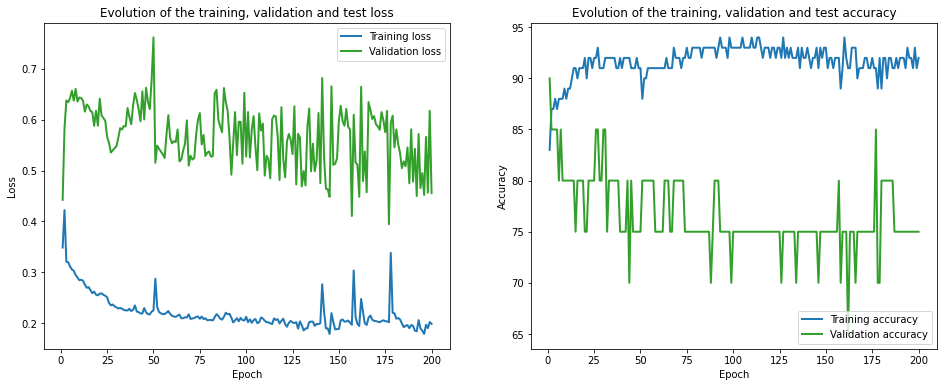

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 158.92it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 991.41it/s]

Finished computing p-values for 500 test points.

Starting repetition 30 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.65 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 1.36 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.66 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.70 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.97 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
val_loss = 0.23 val_acc = 100.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.47 train_acc: 60.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 1.03 train_acc: 70.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 

Epoch 11 of 200, 100% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
val_loss = 0.29 val_acc = 95.00%
Snapshot saved at epoch 11.
Epoch 12 of 200, 10% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 20% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 12 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 40% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 50% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 60% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 70% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 80% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 90% 	 train_loss: 0.53 train_acc: 60.00% took: 0.00s
Epoch 12 of 200, 100% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
val_loss = 0.31 val_acc = 95.00%
Snapshot saved at epoch 12.
Epoch 13 of 200, 10% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 13 of 200, 20% 	 train_loss: 

Epoch 22 of 200, 80% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 22 of 200, 90% 	 train_loss: 0.53 train_acc: 60.00% took: 0.00s
Epoch 22 of 200, 100% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
val_loss = 0.29 val_acc = 100.00%
Snapshot saved at epoch 22.
Epoch 23 of 200, 10% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 23 of 200, 20% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 23 of 200, 30% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 23 of 200, 40% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 23 of 200, 50% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 23 of 200, 60% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 23 of 200, 70% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 23 of 200, 80% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 23 of 200, 90% 	 train_loss: 0.50 train_acc: 60.00% took: 0.00s
Epoch 23 of 200, 100% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
val_loss = 0.34 val_acc = 

Epoch 38 of 200, 50% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 60% 	 train_loss: 0.19 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 70% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 80% 	 train_loss: 0.65 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 90% 	 train_loss: 0.53 train_acc: 60.00% took: 0.00s
Epoch 38 of 200, 100% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
val_loss = 0.33 val_acc = 95.00%
Snapshot saved at epoch 38.
Epoch 39 of 200, 10% 	 train_loss: 0.25 train_acc: 100.00% took: 0.00s
Epoch 39 of 200, 20% 	 train_loss: 0.37 train_acc: 70.00% took: 0.00s
Epoch 39 of 200, 30% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 39 of 200, 40% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 39 of 200, 50% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 39 of 200, 60% 	 train_loss: 0.19 train_acc: 80.00% took: 0.00s
Epoch 39 of 200, 70% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 39 of 200, 80% 	 tr

Epoch 54 of 200, 40% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 54 of 200, 50% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 54 of 200, 60% 	 train_loss: 0.17 train_acc: 80.00% took: 0.00s
Epoch 54 of 200, 70% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 54 of 200, 80% 	 train_loss: 0.64 train_acc: 80.00% took: 0.00s
Epoch 54 of 200, 90% 	 train_loss: 0.52 train_acc: 60.00% took: 0.00s
Epoch 54 of 200, 100% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
val_loss = 0.36 val_acc = 95.00%
Snapshot saved at epoch 54.
Epoch 55 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 55 of 200, 20% 	 train_loss: 0.37 train_acc: 60.00% took: 0.00s
Epoch 55 of 200, 30% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 55 of 200, 40% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 55 of 200, 50% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 55 of 200, 60% 	 train_loss: 0.17 train_acc: 80.00% took: 0.00s
Epoch 55 of 200, 70% 	 trai

val_loss = 0.38 val_acc = 95.00%
Snapshot saved at epoch 69.
Epoch 70 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 70 of 200, 20% 	 train_loss: 0.37 train_acc: 60.00% took: 0.00s
Epoch 70 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 70 of 200, 40% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 70 of 200, 50% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 70 of 200, 60% 	 train_loss: 0.16 train_acc: 80.00% took: 0.02s
Epoch 70 of 200, 70% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 70 of 200, 80% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 70 of 200, 90% 	 train_loss: 0.52 train_acc: 60.00% took: 0.00s
Epoch 70 of 200, 100% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
val_loss = 0.38 val_acc = 95.00%
Snapshot saved at epoch 70.
Epoch 71 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 71 of 200, 20% 	 train_loss: 0.38 train_acc: 60.00% took: 0.00s
Epoch 71 of 200, 30% 	 train_loss: 0

Epoch 85 of 200, 100% 	 train_loss: 0.34 train_acc: 90.00% took: 0.02s
val_loss = 0.40 val_acc = 95.00%
Snapshot saved at epoch 85.
Epoch 86 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 86 of 200, 20% 	 train_loss: 0.37 train_acc: 60.00% took: 0.00s
Epoch 86 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 86 of 200, 40% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 86 of 200, 50% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 86 of 200, 60% 	 train_loss: 0.18 train_acc: 80.00% took: 0.00s
Epoch 86 of 200, 70% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 86 of 200, 80% 	 train_loss: 0.58 train_acc: 80.00% took: 0.00s
Epoch 86 of 200, 90% 	 train_loss: 0.50 train_acc: 60.00% took: 0.00s
Epoch 86 of 200, 100% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
val_loss = 0.42 val_acc = 95.00%
Snapshot saved at epoch 86.
Epoch 87 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 87 of 200, 20% 	 train_loss: 

Epoch 101 of 200, 60% 	 train_loss: 0.19 train_acc: 80.00% took: 0.01s
Epoch 101 of 200, 70% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 80% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
Epoch 101 of 200, 90% 	 train_loss: 0.49 train_acc: 60.00% took: 0.00s
Epoch 101 of 200, 100% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
val_loss = 0.44 val_acc = 90.00%
Snapshot saved at epoch 101.
Epoch 102 of 200, 10% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 102 of 200, 20% 	 train_loss: 0.33 train_acc: 70.00% took: 0.00s
Epoch 102 of 200, 30% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 102 of 200, 40% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 102 of 200, 50% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 102 of 200, 60% 	 train_loss: 0.19 train_acc: 80.00% took: 0.00s
Epoch 102 of 200, 70% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 102 of 200, 80% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
Epoch 102 of

Epoch 116 of 200, 90% 	 train_loss: 0.47 train_acc: 70.00% took: 0.02s
Epoch 116 of 200, 100% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
val_loss = 0.44 val_acc = 95.00%
Snapshot saved at epoch 116.
Epoch 117 of 200, 10% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 117 of 200, 20% 	 train_loss: 0.36 train_acc: 60.00% took: 0.00s
Epoch 117 of 200, 30% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 117 of 200, 40% 	 train_loss: 0.07 train_acc: 90.00% took: 0.00s
Epoch 117 of 200, 50% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 117 of 200, 60% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 117 of 200, 70% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 117 of 200, 80% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 117 of 200, 90% 	 train_loss: 0.51 train_acc: 60.00% took: 0.00s
Epoch 117 of 200, 100% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
val_loss = 0.45 val_acc = 95.00%
Snapshot saved at epoch 117.
Epoch 118 of 200, 10

Epoch 128 of 200, 20% 	 train_loss: 0.40 train_acc: 60.00% took: 0.00s
Epoch 128 of 200, 30% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 128 of 200, 40% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 128 of 200, 50% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 128 of 200, 60% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 128 of 200, 70% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 128 of 200, 80% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
Epoch 128 of 200, 90% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 128 of 200, 100% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
val_loss = 0.45 val_acc = 95.00%
Snapshot saved at epoch 128.
Epoch 129 of 200, 10% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 129 of 200, 20% 	 train_loss: 0.37 train_acc: 60.00% took: 0.00s
Epoch 129 of 200, 30% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 129 of 200, 40% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 129 of

Epoch 139 of 200, 10% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 139 of 200, 20% 	 train_loss: 0.36 train_acc: 60.00% took: 0.00s
Epoch 139 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 139 of 200, 40% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 139 of 200, 50% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 139 of 200, 60% 	 train_loss: 0.19 train_acc: 80.00% took: 0.00s
Epoch 139 of 200, 70% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 139 of 200, 80% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 139 of 200, 90% 	 train_loss: 0.48 train_acc: 60.00% took: 0.00s
Epoch 139 of 200, 100% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
val_loss = 0.49 val_acc = 95.00%
Snapshot saved at epoch 139.
Epoch 140 of 200, 10% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 140 of 200, 20% 	 train_loss: 0.38 train_acc: 60.00% took: 0.00s
Epoch 140 of 200, 30% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 140 o

Epoch 151 of 200, 10% 	 train_loss: 0.18 train_acc: 100.00% took: 0.01s
Epoch 151 of 200, 20% 	 train_loss: 0.37 train_acc: 60.00% took: 0.00s
Epoch 151 of 200, 30% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 151 of 200, 40% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 151 of 200, 50% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 151 of 200, 60% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 151 of 200, 70% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 151 of 200, 80% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 151 of 200, 90% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 151 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss = 0.50 val_acc = 90.00%
Snapshot saved at epoch 151.
Epoch 152 of 200, 10% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 152 of 200, 20% 	 train_loss: 0.35 train_acc: 70.00% took: 0.00s
Epoch 152 of 200, 30% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 152 

Epoch 162 of 200, 10% 	 train_loss: 0.18 train_acc: 100.00% took: 0.01s
Epoch 162 of 200, 20% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
Epoch 162 of 200, 30% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 162 of 200, 40% 	 train_loss: 0.08 train_acc: 90.00% took: 0.01s
Epoch 162 of 200, 50% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 162 of 200, 60% 	 train_loss: 0.20 train_acc: 100.00% took: 0.01s
Epoch 162 of 200, 70% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 162 of 200, 80% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 162 of 200, 90% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 162 of 200, 100% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
val_loss = 0.52 val_acc = 90.00%
Snapshot saved at epoch 162.
Epoch 163 of 200, 10% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 163 of 200, 20% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
Epoch 163 of 200, 30% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 163 o

Epoch 173 of 200, 80% 	 train_loss: 0.58 train_acc: 80.00% took: 0.00s
Epoch 173 of 200, 90% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 173 of 200, 100% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
val_loss = 0.52 val_acc = 90.00%
Snapshot saved at epoch 173.
Epoch 174 of 200, 10% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 174 of 200, 20% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
Epoch 174 of 200, 30% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 174 of 200, 40% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 50% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 174 of 200, 60% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 70% 	 train_loss: 0.26 train_acc: 100.00% took: 0.00s
Epoch 174 of 200, 80% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 174 of 200, 90% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 174 of 200, 100% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
val_loss = 

Epoch 189 of 200, 60% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 189 of 200, 70% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 189 of 200, 80% 	 train_loss: 0.58 train_acc: 80.00% took: 0.00s
Epoch 189 of 200, 90% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 189 of 200, 100% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
val_loss = 0.65 val_acc = 90.00%
Snapshot saved at epoch 189.
Epoch 190 of 200, 10% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 190 of 200, 20% 	 train_loss: 0.30 train_acc: 70.00% took: 0.00s
Epoch 190 of 200, 30% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 190 of 200, 40% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 190 of 200, 50% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 190 of 200, 60% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 190 of 200, 70% 	 train_loss: 0.26 train_acc: 100.00% took: 0.00s
Epoch 190 of 200, 80% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 190 

Epoch 200 of 200, 90% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 200 of 200, 100% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
val_loss = 0.64 val_acc = 90.00%
Snapshot saved at epoch 200.
Training done! A list of 200 models saved.


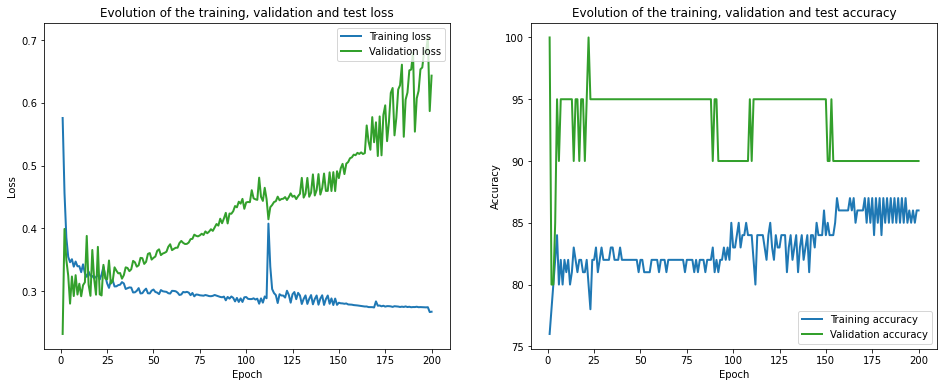

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 153.37it/s]


Initialization done!


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 987.69it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 1.04 train_acc: 20.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 0.54 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 1.82 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 1.38 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.99 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 2.39 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 1.06 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.45 train_acc: 70.00% took: 0.01s
val_loss = 0.23 val_acc = 90.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.91 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.2

val_loss = 0.30 val_acc = 95.00%
Snapshot saved at epoch 16.
Epoch 17 of 200, 10% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 20% 	 train_loss: 0.38 train_acc: 70.00% took: 0.00s
Epoch 17 of 200, 30% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 40% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 50% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 60% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 70% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 80% 	 train_loss: 0.65 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 90% 	 train_loss: 0.52 train_acc: 60.00% took: 0.00s
Epoch 17 of 200, 100% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
val_loss = 0.31 val_acc = 95.00%
Snapshot saved at epoch 17.
Epoch 18 of 200, 10% 	 train_loss: 0.32 train_acc: 100.00% took: 0.00s
Epoch 18 of 200, 20% 	 train_loss: 0.37 train_acc: 70.00% took: 0.00s
Epoch 18 of 200, 30% 	 train_loss: 

Epoch 33 of 200, 50% 	 train_loss: 0.22 train_acc: 80.00% took: 0.02s
Epoch 33 of 200, 60% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 33 of 200, 70% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 33 of 200, 80% 	 train_loss: 0.65 train_acc: 80.00% took: 0.00s
Epoch 33 of 200, 90% 	 train_loss: 0.55 train_acc: 60.00% took: 0.00s
Epoch 33 of 200, 100% 	 train_loss: 0.40 train_acc: 70.00% took: 0.00s
val_loss = 0.32 val_acc = 95.00%
Snapshot saved at epoch 33.
Epoch 34 of 200, 10% 	 train_loss: 0.25 train_acc: 100.00% took: 0.00s
Epoch 34 of 200, 20% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 34 of 200, 30% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 34 of 200, 40% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 34 of 200, 50% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 34 of 200, 60% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 34 of 200, 70% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 34 of 200, 80% 	 tr

Epoch 49 of 200, 20% 	 train_loss: 0.35 train_acc: 70.00% took: 0.00s
Epoch 49 of 200, 30% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 49 of 200, 40% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 49 of 200, 50% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 49 of 200, 60% 	 train_loss: 0.16 train_acc: 80.00% took: 0.00s
Epoch 49 of 200, 70% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 49 of 200, 80% 	 train_loss: 0.64 train_acc: 80.00% took: 0.00s
Epoch 49 of 200, 90% 	 train_loss: 0.53 train_acc: 60.00% took: 0.02s
Epoch 49 of 200, 100% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
val_loss = 0.36 val_acc = 95.00%
Snapshot saved at epoch 49.
Epoch 50 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 20% 	 train_loss: 0.35 train_acc: 70.00% took: 0.01s
Epoch 50 of 200, 30% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 50 of 200, 40% 	 train_loss: 0.07 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 50% 	 tra

Epoch 64 of 200, 100% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
val_loss = 0.37 val_acc = 95.00%
Snapshot saved at epoch 64.
Epoch 65 of 200, 10% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 65 of 200, 20% 	 train_loss: 0.35 train_acc: 70.00% took: 0.00s
Epoch 65 of 200, 30% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 65 of 200, 40% 	 train_loss: 0.07 train_acc: 90.00% took: 0.00s
Epoch 65 of 200, 50% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 65 of 200, 60% 	 train_loss: 0.16 train_acc: 80.00% took: 0.00s
Epoch 65 of 200, 70% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 65 of 200, 80% 	 train_loss: 0.64 train_acc: 80.00% took: 0.00s
Epoch 65 of 200, 90% 	 train_loss: 0.53 train_acc: 60.00% took: 0.00s
Epoch 65 of 200, 100% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
val_loss = 0.38 val_acc = 90.00%
Snapshot saved at epoch 65.
Epoch 66 of 200, 10% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 66 of 200, 20% 	 train_loss: 

val_loss = 0.38 val_acc = 95.00%
Snapshot saved at epoch 75.
Epoch 76 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 76 of 200, 20% 	 train_loss: 0.42 train_acc: 60.00% took: 0.00s
Epoch 76 of 200, 30% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 76 of 200, 40% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 76 of 200, 50% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 76 of 200, 60% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 76 of 200, 70% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 76 of 200, 80% 	 train_loss: 0.58 train_acc: 80.00% took: 0.00s
Epoch 76 of 200, 90% 	 train_loss: 0.53 train_acc: 60.00% took: 0.00s
Epoch 76 of 200, 100% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
val_loss = 0.38 val_acc = 95.00%
Snapshot saved at epoch 76.
Epoch 77 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 77 of 200, 20% 	 train_loss: 0.45 train_acc: 60.00% took: 0.00s
Epoch 77 of 200, 30% 	 train_loss: 

Epoch 90 of 200, 60% 	 train_loss: 0.19 train_acc: 80.00% took: 0.02s
Epoch 90 of 200, 70% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 90 of 200, 80% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
Epoch 90 of 200, 90% 	 train_loss: 0.49 train_acc: 60.00% took: 0.00s
Epoch 90 of 200, 100% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
val_loss = 0.42 val_acc = 95.00%
Snapshot saved at epoch 90.
Epoch 91 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 91 of 200, 20% 	 train_loss: 0.38 train_acc: 60.00% took: 0.00s
Epoch 91 of 200, 30% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 91 of 200, 40% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 91 of 200, 50% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 91 of 200, 60% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 91 of 200, 70% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 91 of 200, 80% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
Epoch 91 of 200, 90% 	 tra

val_loss = 0.47 val_acc = 85.00%
Snapshot saved at epoch 105.
Epoch 106 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 106 of 200, 20% 	 train_loss: 0.34 train_acc: 70.00% took: 0.00s
Epoch 106 of 200, 30% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 106 of 200, 40% 	 train_loss: 0.07 train_acc: 90.00% took: 0.00s
Epoch 106 of 200, 50% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 106 of 200, 60% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 106 of 200, 70% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 106 of 200, 80% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
Epoch 106 of 200, 90% 	 train_loss: 0.52 train_acc: 60.00% took: 0.00s
Epoch 106 of 200, 100% 	 train_loss: 0.27 train_acc: 100.00% took: 0.00s
val_loss = 0.46 val_acc = 85.00%
Snapshot saved at epoch 106.
Epoch 107 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 107 of 200, 20% 	 train_loss: 0.46 train_acc: 60.00% took: 0.00s
Epoch 107 of 200, 30%

Epoch 116 of 200, 100% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
val_loss = 0.50 val_acc = 80.00%
Snapshot saved at epoch 116.
Epoch 117 of 200, 10% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 117 of 200, 20% 	 train_loss: 0.40 train_acc: 60.00% took: 0.00s
Epoch 117 of 200, 30% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 117 of 200, 40% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 117 of 200, 50% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 117 of 200, 60% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 117 of 200, 70% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 117 of 200, 80% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 117 of 200, 90% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 117 of 200, 100% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
val_loss = 0.55 val_acc = 85.00%
Snapshot saved at epoch 117.
Epoch 118 of 200, 10% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 118 of 200, 

Epoch 132 of 200, 10% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 132 of 200, 20% 	 train_loss: 0.46 train_acc: 60.00% took: 0.00s
Epoch 132 of 200, 30% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 132 of 200, 40% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 132 of 200, 50% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 132 of 200, 60% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 132 of 200, 70% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 132 of 200, 80% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
Epoch 132 of 200, 90% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 132 of 200, 100% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
val_loss = 0.52 val_acc = 85.00%
Snapshot saved at epoch 132.
Epoch 133 of 200, 10% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 133 of 200, 20% 	 train_loss: 0.46 train_acc: 60.00% took: 0.00s
Epoch 133 of 200, 30% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 133

val_loss = 0.45 val_acc = 95.00%
Snapshot saved at epoch 142.
Epoch 143 of 200, 10% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 143 of 200, 20% 	 train_loss: 0.39 train_acc: 60.00% took: 0.00s
Epoch 143 of 200, 30% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 143 of 200, 40% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 143 of 200, 50% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 143 of 200, 60% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 143 of 200, 70% 	 train_loss: 0.24 train_acc: 70.00% took: 0.00s
Epoch 143 of 200, 80% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 143 of 200, 90% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 143 of 200, 100% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
val_loss = 0.46 val_acc = 95.00%
Snapshot saved at epoch 143.
Epoch 144 of 200, 10% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 144 of 200, 20% 	 train_loss: 0.37 train_acc: 60.00% took: 0.00s
Epoch 144 of 200, 30%

Epoch 159 of 200, 20% 	 train_loss: 0.36 train_acc: 60.00% took: 0.02s
Epoch 159 of 200, 30% 	 train_loss: 0.25 train_acc: 90.00% took: 0.01s
Epoch 159 of 200, 40% 	 train_loss: 0.07 train_acc: 90.00% took: 0.00s
Epoch 159 of 200, 50% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 159 of 200, 60% 	 train_loss: 0.19 train_acc: 80.00% took: 0.00s
Epoch 159 of 200, 70% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 159 of 200, 80% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
Epoch 159 of 200, 90% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 159 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss = 0.46 val_acc = 95.00%
Snapshot saved at epoch 159.
Epoch 160 of 200, 10% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 160 of 200, 20% 	 train_loss: 0.38 train_acc: 60.00% took: 0.00s
Epoch 160 of 200, 30% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 160 of 200, 40% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 160 of

Epoch 174 of 200, 70% 	 train_loss: 0.24 train_acc: 70.00% took: 0.00s
Epoch 174 of 200, 80% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 174 of 200, 90% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 174 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss = 0.47 val_acc = 95.00%
Snapshot saved at epoch 174.
Epoch 175 of 200, 10% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 175 of 200, 20% 	 train_loss: 0.37 train_acc: 60.00% took: 0.00s
Epoch 175 of 200, 30% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 175 of 200, 40% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 175 of 200, 50% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 175 of 200, 60% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 175 of 200, 70% 	 train_loss: 0.24 train_acc: 70.00% took: 0.00s
Epoch 175 of 200, 80% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 175 of 200, 90% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 175 of 

Epoch 190 of 200, 80% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 190 of 200, 90% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 190 of 200, 100% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
val_loss = 0.50 val_acc = 95.00%
Snapshot saved at epoch 190.
Epoch 191 of 200, 10% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 191 of 200, 20% 	 train_loss: 0.36 train_acc: 60.00% took: 0.00s
Epoch 191 of 200, 30% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 191 of 200, 40% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 191 of 200, 50% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 191 of 200, 60% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 191 of 200, 70% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 191 of 200, 80% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
Epoch 191 of 200, 90% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 191 of 200, 100% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
val_loss = 

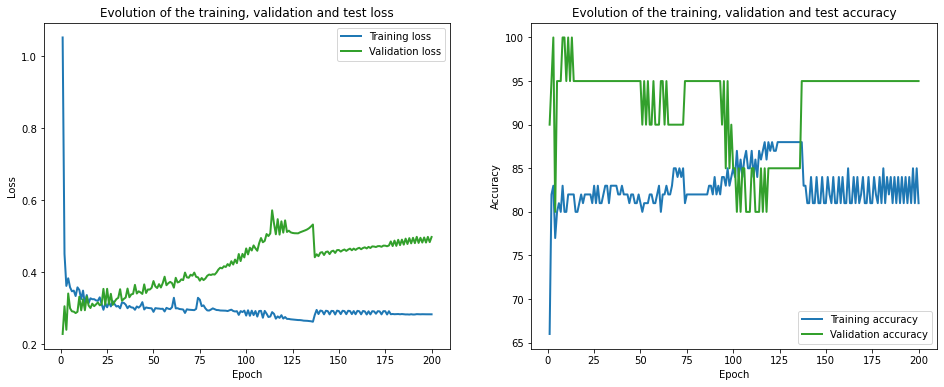

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 151.84it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1469.27it/s]

Finished computing p-values for 500 test points.

Starting repetition 31 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.79 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 3.72 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.74 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
val_loss = 1.06 val_acc = 65.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.74 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.

Epoch 15 of 200, 100% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
val_loss = 0.33 val_acc = 85.00%
Snapshot saved at epoch 15.
Epoch 16 of 200, 10% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 20% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 30% 	 train_loss: 0.16 train_acc: 100.00% took: 0.02s
Epoch 16 of 200, 40% 	 train_loss: 0.58 train_acc: 90.00% took: 0.01s
Epoch 16 of 200, 50% 	 train_loss: 0.66 train_acc: 60.00% took: 0.00s
Epoch 16 of 200, 60% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 70% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 80% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 90% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 100% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
val_loss = 0.31 val_acc = 85.00%
Snapshot saved at epoch 16.
Epoch 17 of 200, 10% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 20% 	 train_los

Epoch 26 of 200, 80% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 26 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 26 of 200, 100% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
val_loss = 0.28 val_acc = 85.00%
Snapshot saved at epoch 26.
Epoch 27 of 200, 10% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 20% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 30% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 40% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 50% 	 train_loss: 0.66 train_acc: 60.00% took: 0.00s
Epoch 27 of 200, 60% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 70% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 80% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 100% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
val_loss = 0.29 val_acc

Epoch 43 of 200, 10% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 43 of 200, 20% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 43 of 200, 30% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 43 of 200, 40% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
Epoch 43 of 200, 50% 	 train_loss: 0.68 train_acc: 60.00% took: 0.00s
Epoch 43 of 200, 60% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 43 of 200, 70% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 43 of 200, 80% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 43 of 200, 90% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 43 of 200, 100% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
val_loss = 0.37 val_acc = 85.00%
Snapshot saved at epoch 43.
Epoch 44 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 44 of 200, 20% 	 train_loss: 0.38 train_acc: 70.00% took: 0.00s
Epoch 44 of 200, 30% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 44 of 200, 40% 	 tr

Epoch 54 of 200, 50% 	 train_loss: 0.69 train_acc: 60.00% took: 0.01s
Epoch 54 of 200, 60% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 54 of 200, 70% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 54 of 200, 80% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 54 of 200, 90% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 54 of 200, 100% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
val_loss = 0.44 val_acc = 85.00%
Snapshot saved at epoch 54.
Epoch 55 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 55 of 200, 20% 	 train_loss: 0.38 train_acc: 70.00% took: 0.02s
Epoch 55 of 200, 30% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 55 of 200, 40% 	 train_loss: 0.70 train_acc: 80.00% took: 0.00s
Epoch 55 of 200, 50% 	 train_loss: 0.69 train_acc: 60.00% took: 0.00s
Epoch 55 of 200, 60% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 55 of 200, 70% 	 train_loss: 0.19 train_acc: 100.00% took: 0.02s
Epoch 55 of 200, 80% 	

Epoch 65 of 200, 40% 	 train_loss: 0.64 train_acc: 90.00% took: 0.00s
Epoch 65 of 200, 50% 	 train_loss: 0.67 train_acc: 60.00% took: 0.00s
Epoch 65 of 200, 60% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 65 of 200, 70% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 65 of 200, 80% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 65 of 200, 90% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 65 of 200, 100% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
val_loss = 0.28 val_acc = 85.00%
Snapshot saved at epoch 65.
Epoch 66 of 200, 10% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 66 of 200, 20% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
Epoch 66 of 200, 30% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 66 of 200, 40% 	 train_loss: 0.63 train_acc: 80.00% took: 0.00s
Epoch 66 of 200, 50% 	 train_loss: 0.66 train_acc: 60.00% took: 0.00s
Epoch 66 of 200, 60% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 66 of 200, 70% 	 tr

Epoch 80 of 200, 90% 	 train_loss: 0.20 train_acc: 90.00% took: 0.02s
Epoch 80 of 200, 100% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
val_loss = 0.27 val_acc = 85.00%
Snapshot saved at epoch 80.
Epoch 81 of 200, 10% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 81 of 200, 20% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 81 of 200, 30% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 81 of 200, 40% 	 train_loss: 0.65 train_acc: 80.00% took: 0.00s
Epoch 81 of 200, 50% 	 train_loss: 0.66 train_acc: 60.00% took: 0.00s
Epoch 81 of 200, 60% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 81 of 200, 70% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 81 of 200, 80% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 81 of 200, 90% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 81 of 200, 100% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
val_loss = 0.26 val_acc = 85.00%
Snapshot saved at epoch 81.
Epoch 82 of 200, 10% 	 train_los

Epoch 96 of 200, 40% 	 train_loss: 0.56 train_acc: 80.00% took: 0.02s
Epoch 96 of 200, 50% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 96 of 200, 60% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 96 of 200, 70% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 96 of 200, 80% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 96 of 200, 90% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 96 of 200, 100% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
val_loss = 0.27 val_acc = 85.00%
Snapshot saved at epoch 96.
Epoch 97 of 200, 10% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 97 of 200, 20% 	 train_loss: 0.33 train_acc: 70.00% took: 0.00s
Epoch 97 of 200, 30% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 97 of 200, 40% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
Epoch 97 of 200, 50% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 97 of 200, 60% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 97 of 200, 70% 	 tr

Epoch 107 of 200, 50% 	 train_loss: 0.59 train_acc: 70.00% took: 0.02s
Epoch 107 of 200, 60% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 107 of 200, 70% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 107 of 200, 80% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 107 of 200, 90% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 107 of 200, 100% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
val_loss = 0.25 val_acc = 85.00%
Snapshot saved at epoch 107.
Epoch 108 of 200, 10% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 108 of 200, 20% 	 train_loss: 0.33 train_acc: 70.00% took: 0.00s
Epoch 108 of 200, 30% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 108 of 200, 40% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
Epoch 108 of 200, 50% 	 train_loss: 0.64 train_acc: 70.00% took: 0.00s
Epoch 108 of 200, 60% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 108 of 200, 70% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 10

Epoch 117 of 200, 100% 	 train_loss: 0.02 train_acc: 100.00% took: 0.02s
val_loss = 0.24 val_acc = 85.00%
Snapshot saved at epoch 117.
Epoch 118 of 200, 10% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 118 of 200, 20% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
Epoch 118 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 118 of 200, 40% 	 train_loss: 0.60 train_acc: 90.00% took: 0.00s
Epoch 118 of 200, 50% 	 train_loss: 0.62 train_acc: 70.00% took: 0.00s
Epoch 118 of 200, 60% 	 train_loss: 0.17 train_acc: 100.00% took: 0.02s
Epoch 118 of 200, 70% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 118 of 200, 80% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 118 of 200, 90% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 118 of 200, 100% 	 train_loss: 0.02 train_acc: 100.00% took: 0.01s
val_loss = 0.23 val_acc = 85.00%
Snapshot saved at epoch 118.
Epoch 119 of 200, 10% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 119 of 200,

val_loss = 0.22 val_acc = 90.00%
Snapshot saved at epoch 133.
Epoch 134 of 200, 10% 	 train_loss: 0.24 train_acc: 90.00% took: 0.01s
Epoch 134 of 200, 20% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 134 of 200, 30% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 134 of 200, 40% 	 train_loss: 0.63 train_acc: 80.00% took: 0.00s
Epoch 134 of 200, 50% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 134 of 200, 60% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 134 of 200, 70% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 134 of 200, 80% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 134 of 200, 90% 	 train_loss: 0.12 train_acc: 100.00% took: 0.02s
Epoch 134 of 200, 100% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
val_loss = 0.23 val_acc = 85.00%
Snapshot saved at epoch 134.
Epoch 135 of 200, 10% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 135 of 200, 20% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 135 of 200, 3

Epoch 145 of 200, 10% 	 train_loss: 0.19 train_acc: 90.00% took: 0.01s
Epoch 145 of 200, 20% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 145 of 200, 30% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 145 of 200, 40% 	 train_loss: 0.63 train_acc: 80.00% took: 0.00s
Epoch 145 of 200, 50% 	 train_loss: 0.65 train_acc: 80.00% took: 0.00s
Epoch 145 of 200, 60% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 145 of 200, 70% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 145 of 200, 80% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 145 of 200, 90% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 145 of 200, 100% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
val_loss = 0.24 val_acc = 85.00%
Snapshot saved at epoch 145.
Epoch 146 of 200, 10% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 146 of 200, 20% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 146 of 200, 30% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 146 

Epoch 156 of 200, 70% 	 train_loss: 0.18 train_acc: 100.00% took: 0.02s
Epoch 156 of 200, 80% 	 train_loss: 0.28 train_acc: 90.00% took: 0.01s
Epoch 156 of 200, 90% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 156 of 200, 100% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
val_loss = 0.26 val_acc = 80.00%
Snapshot saved at epoch 156.
Epoch 157 of 200, 10% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 157 of 200, 20% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 157 of 200, 30% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 157 of 200, 40% 	 train_loss: 0.56 train_acc: 90.00% took: 0.00s
Epoch 157 of 200, 50% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
Epoch 157 of 200, 60% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 157 of 200, 70% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 157 of 200, 80% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 157 of 200, 90% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 157

Epoch 167 of 200, 60% 	 train_loss: 0.19 train_acc: 80.00% took: 0.00s
Epoch 167 of 200, 70% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 167 of 200, 80% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 167 of 200, 90% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 167 of 200, 100% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
val_loss = 0.23 val_acc = 85.00%
Snapshot saved at epoch 167.
Epoch 168 of 200, 10% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 168 of 200, 20% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 168 of 200, 30% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 168 of 200, 40% 	 train_loss: 0.61 train_acc: 90.00% took: 0.00s
Epoch 168 of 200, 50% 	 train_loss: 0.54 train_acc: 90.00% took: 0.00s
Epoch 168 of 200, 60% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 168 of 200, 70% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 168 of 200, 80% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 168 

Epoch 178 of 200, 70% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 178 of 200, 80% 	 train_loss: 0.34 train_acc: 80.00% took: 0.01s
Epoch 178 of 200, 90% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 178 of 200, 100% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
val_loss = 0.26 val_acc = 85.00%
Snapshot saved at epoch 178.
Epoch 179 of 200, 10% 	 train_loss: 0.84 train_acc: 90.00% took: 0.00s
Epoch 179 of 200, 20% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 179 of 200, 30% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 179 of 200, 40% 	 train_loss: 0.59 train_acc: 90.00% took: 0.00s
Epoch 179 of 200, 50% 	 train_loss: 0.73 train_acc: 90.00% took: 0.00s
Epoch 179 of 200, 60% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 179 of 200, 70% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 179 of 200, 80% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 179 of 200, 90% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 179

Epoch 194 of 200, 10% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 194 of 200, 20% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 194 of 200, 30% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 194 of 200, 40% 	 train_loss: 0.66 train_acc: 90.00% took: 0.00s
Epoch 194 of 200, 50% 	 train_loss: 0.71 train_acc: 80.00% took: 0.00s
Epoch 194 of 200, 60% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 194 of 200, 70% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 194 of 200, 80% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 194 of 200, 90% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 194 of 200, 100% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
val_loss = 0.22 val_acc = 80.00%
Snapshot saved at epoch 194.
Epoch 195 of 200, 10% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 195 of 200, 20% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 195 of 200, 30% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 195 o

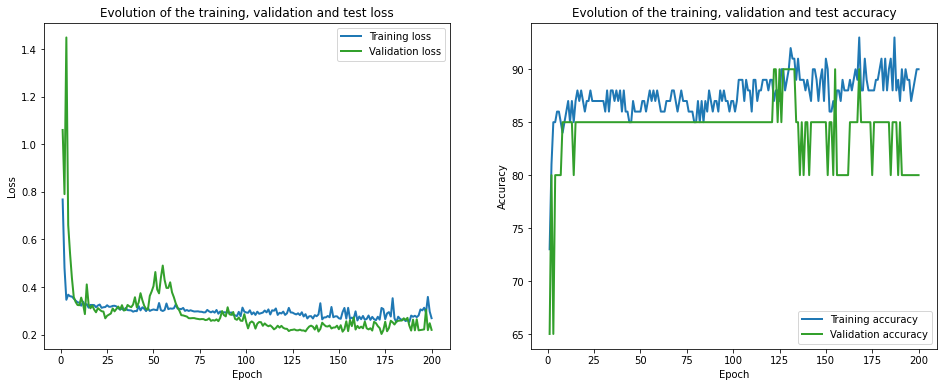

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 146.89it/s]


Initialization done!


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1121.31it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 1.15 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 9.10 train_acc: 30.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.76 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 1.86 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 1.62 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.38 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
val_loss = 1.32 val_acc = 60.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.69 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.

val_loss = 0.38 val_acc = 80.00%
Snapshot saved at epoch 15.
Epoch 16 of 200, 10% 	 train_loss: 0.26 train_acc: 90.00% took: 0.01s
Epoch 16 of 200, 20% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 30% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 40% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 50% 	 train_loss: 0.69 train_acc: 60.00% took: 0.00s
Epoch 16 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 70% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 80% 	 train_loss: 0.40 train_acc: 80.00% took: 0.02s
Epoch 16 of 200, 90% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 100% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
val_loss = 0.41 val_acc = 80.00%
Snapshot saved at epoch 16.
Epoch 17 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 20% 	 train_loss: 0.44 train_acc: 90.00% took: 0.02s
Epoch 17 of 200, 30% 	 train_loss: 

Epoch 27 of 200, 10% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 20% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 30% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 40% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 50% 	 train_loss: 0.66 train_acc: 60.00% took: 0.02s
Epoch 27 of 200, 60% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 70% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 80% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 90% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 100% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
val_loss = 0.31 val_acc = 85.00%
Snapshot saved at epoch 27.
Epoch 28 of 200, 10% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 20% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 30% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 40% 	 t

Epoch 42 of 200, 100% 	 train_loss: 0.02 train_acc: 100.00% took: 0.02s
val_loss = 0.28 val_acc = 85.00%
Snapshot saved at epoch 42.
Epoch 43 of 200, 10% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 43 of 200, 20% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 43 of 200, 30% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 43 of 200, 40% 	 train_loss: 0.63 train_acc: 80.00% took: 0.00s
Epoch 43 of 200, 50% 	 train_loss: 0.66 train_acc: 60.00% took: 0.00s
Epoch 43 of 200, 60% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 43 of 200, 70% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 43 of 200, 80% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 43 of 200, 90% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 43 of 200, 100% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
val_loss = 0.29 val_acc = 85.00%
Snapshot saved at epoch 43.
Epoch 44 of 200, 10% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 44 of 200, 20% 	 train_loss

Epoch 53 of 200, 80% 	 train_loss: 0.40 train_acc: 80.00% took: 0.02s
Epoch 53 of 200, 90% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 53 of 200, 100% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
val_loss = 0.29 val_acc = 85.00%
Snapshot saved at epoch 53.
Epoch 54 of 200, 10% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 54 of 200, 20% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 54 of 200, 30% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 54 of 200, 40% 	 train_loss: 0.54 train_acc: 90.00% took: 0.00s
Epoch 54 of 200, 50% 	 train_loss: 0.65 train_acc: 70.00% took: 0.00s
Epoch 54 of 200, 60% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 54 of 200, 70% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 54 of 200, 80% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 54 of 200, 90% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 54 of 200, 100% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
val_loss = 0.28 val_acc 

Epoch 64 of 200, 50% 	 train_loss: 0.67 train_acc: 60.00% took: 0.02s
Epoch 64 of 200, 60% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 64 of 200, 70% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 64 of 200, 80% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 64 of 200, 90% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 64 of 200, 100% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
val_loss = 0.29 val_acc = 85.00%
Snapshot saved at epoch 64.
Epoch 65 of 200, 10% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 65 of 200, 20% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 65 of 200, 30% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 65 of 200, 40% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
Epoch 65 of 200, 50% 	 train_loss: 0.66 train_acc: 60.00% took: 0.00s
Epoch 65 of 200, 60% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 65 of 200, 70% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 65 of 200, 80% 	 t

Epoch 79 of 200, 60% 	 train_loss: 0.20 train_acc: 90.00% took: 0.01s
Epoch 79 of 200, 70% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 79 of 200, 80% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 79 of 200, 90% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 79 of 200, 100% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
val_loss = 0.25 val_acc = 85.00%
Snapshot saved at epoch 79.
Epoch 80 of 200, 10% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 80 of 200, 20% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 80 of 200, 30% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 80 of 200, 40% 	 train_loss: 0.56 train_acc: 90.00% took: 0.00s
Epoch 80 of 200, 50% 	 train_loss: 0.71 train_acc: 70.00% took: 0.00s
Epoch 80 of 200, 60% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 80 of 200, 70% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 80 of 200, 80% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 80 of 200, 90% 	 tr

Epoch 94 of 200, 80% 	 train_loss: 0.37 train_acc: 80.00% took: 0.02s
Epoch 94 of 200, 90% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 94 of 200, 100% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
val_loss = 0.24 val_acc = 85.00%
Snapshot saved at epoch 94.
Epoch 95 of 200, 10% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 95 of 200, 20% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 95 of 200, 30% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 95 of 200, 40% 	 train_loss: 0.59 train_acc: 90.00% took: 0.00s
Epoch 95 of 200, 50% 	 train_loss: 0.67 train_acc: 70.00% took: 0.00s
Epoch 95 of 200, 60% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 95 of 200, 70% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 95 of 200, 80% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 95 of 200, 90% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 95 of 200, 100% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
val_loss = 0.24 val_ac

Epoch 105 of 200, 80% 	 train_loss: 0.37 train_acc: 80.00% took: 0.01s
Epoch 105 of 200, 90% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 105 of 200, 100% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
val_loss = 0.25 val_acc = 80.00%
Snapshot saved at epoch 105.
Epoch 106 of 200, 10% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 106 of 200, 20% 	 train_loss: 0.30 train_acc: 80.00% took: 0.02s
Epoch 106 of 200, 30% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 106 of 200, 40% 	 train_loss: 0.50 train_acc: 90.00% took: 0.00s
Epoch 106 of 200, 50% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 106 of 200, 60% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 106 of 200, 70% 	 train_loss: 0.17 train_acc: 100.00% took: 0.02s
Epoch 106 of 200, 80% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 106 of 200, 90% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 106 of 200, 100% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
val_los

Epoch 116 of 200, 80% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 116 of 200, 90% 	 train_loss: 0.12 train_acc: 100.00% took: 0.01s
Epoch 116 of 200, 100% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
val_loss = 0.25 val_acc = 80.00%
Snapshot saved at epoch 116.
Epoch 117 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 117 of 200, 20% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 117 of 200, 30% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 117 of 200, 40% 	 train_loss: 0.50 train_acc: 90.00% took: 0.00s
Epoch 117 of 200, 50% 	 train_loss: 0.60 train_acc: 70.00% took: 0.00s
Epoch 117 of 200, 60% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 117 of 200, 70% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 117 of 200, 80% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 117 of 200, 90% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 117 of 200, 100% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
val_los

Epoch 127 of 200, 50% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 127 of 200, 60% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 127 of 200, 70% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 127 of 200, 80% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 127 of 200, 90% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 127 of 200, 100% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
val_loss = 0.22 val_acc = 85.00%
Snapshot saved at epoch 127.
Epoch 128 of 200, 10% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 128 of 200, 20% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 128 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 128 of 200, 40% 	 train_loss: 0.48 train_acc: 90.00% took: 0.00s
Epoch 128 of 200, 50% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
Epoch 128 of 200, 60% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 128 of 200, 70% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 128 

Epoch 142 of 200, 80% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 142 of 200, 90% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 142 of 200, 100% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
val_loss = 0.26 val_acc = 85.00%
Snapshot saved at epoch 142.
Epoch 143 of 200, 10% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 143 of 200, 20% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 143 of 200, 30% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 143 of 200, 40% 	 train_loss: 0.48 train_acc: 90.00% took: 0.00s
Epoch 143 of 200, 50% 	 train_loss: 0.63 train_acc: 80.00% took: 0.00s
Epoch 143 of 200, 60% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 143 of 200, 70% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 143 of 200, 80% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 143 of 200, 90% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 143 of 200, 100% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
val_loss

Epoch 153 of 200, 50% 	 train_loss: 0.67 train_acc: 80.00% took: 0.01s
Epoch 153 of 200, 60% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 153 of 200, 70% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 153 of 200, 80% 	 train_loss: 0.37 train_acc: 70.00% took: 0.00s
Epoch 153 of 200, 90% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 153 of 200, 100% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
val_loss = 0.25 val_acc = 85.00%
Snapshot saved at epoch 153.
Epoch 154 of 200, 10% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 154 of 200, 20% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 154 of 200, 30% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 154 of 200, 40% 	 train_loss: 0.51 train_acc: 90.00% took: 0.00s
Epoch 154 of 200, 50% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 154 of 200, 60% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 154 of 200, 70% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 154

Epoch 164 of 200, 100% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
val_loss = 0.26 val_acc = 85.00%
Snapshot saved at epoch 164.
Epoch 165 of 200, 10% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 165 of 200, 20% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 165 of 200, 30% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 165 of 200, 40% 	 train_loss: 0.47 train_acc: 90.00% took: 0.00s
Epoch 165 of 200, 50% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
Epoch 165 of 200, 60% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 165 of 200, 70% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 165 of 200, 80% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 165 of 200, 90% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 165 of 200, 100% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
val_loss = 0.26 val_acc = 80.00%
Snapshot saved at epoch 165.
Epoch 166 of 200, 10% 	 train_loss: 0.49 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 

Epoch 175 of 200, 80% 	 train_loss: 0.38 train_acc: 70.00% took: 0.01s
Epoch 175 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 175 of 200, 100% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
val_loss = 0.28 val_acc = 80.00%
Snapshot saved at epoch 175.
Epoch 176 of 200, 10% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 176 of 200, 20% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 176 of 200, 30% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 176 of 200, 40% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
Epoch 176 of 200, 50% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 176 of 200, 60% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 176 of 200, 70% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 176 of 200, 80% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 176 of 200, 90% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 176 of 200, 100% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
val_loss

val_loss = 0.27 val_acc = 85.00%
Snapshot saved at epoch 186.
Epoch 187 of 200, 10% 	 train_loss: 0.59 train_acc: 90.00% took: 0.00s
Epoch 187 of 200, 20% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 187 of 200, 30% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 187 of 200, 40% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 187 of 200, 50% 	 train_loss: 0.63 train_acc: 90.00% took: 0.00s
Epoch 187 of 200, 60% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 187 of 200, 70% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 187 of 200, 80% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 187 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 187 of 200, 100% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
val_loss = 0.30 val_acc = 85.00%
Snapshot saved at epoch 187.
Epoch 188 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 188 of 200, 20% 	 train_loss: 0.19 train_acc: 80.00% took: 0.00s
Epoch 188 of 200, 30

Epoch 198 of 200, 70% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 198 of 200, 80% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 198 of 200, 90% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 198 of 200, 100% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
val_loss = 0.27 val_acc = 85.00%
Snapshot saved at epoch 198.
Epoch 199 of 200, 10% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 199 of 200, 20% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 199 of 200, 30% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 199 of 200, 40% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 199 of 200, 50% 	 train_loss: 0.62 train_acc: 70.00% took: 0.00s
Epoch 199 of 200, 60% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 199 of 200, 70% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 199 of 200, 80% 	 train_loss: 0.37 train_acc: 70.00% took: 0.00s
Epoch 199 of 200, 90% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 199

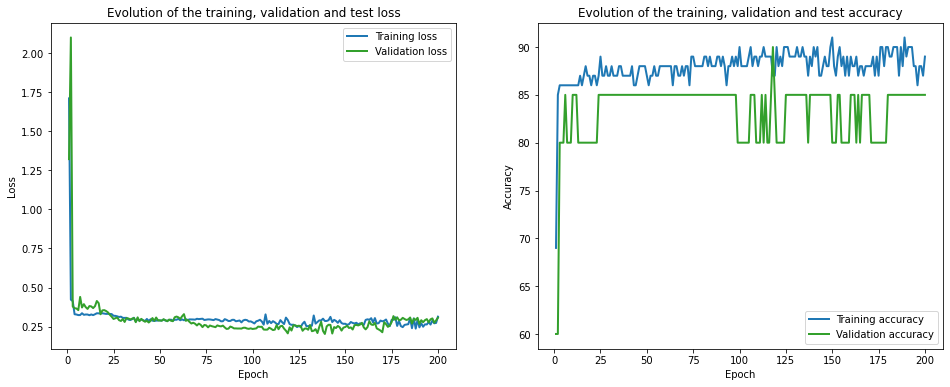

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 132.63it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 933.51it/s]

Finished computing p-values for 500 test points.

Starting repetition 32 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 1.07 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 1.50 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 1.15 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.71 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.58 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
val_loss = 0.87 val_acc = 85.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 1.52 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 1.18 train_acc: 50.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.

Epoch 15 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 15 of 200, 70% 	 train_loss: 0.74 train_acc: 70.00% took: 0.00s
Epoch 15 of 200, 80% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 90% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 15 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.31 val_acc = 85.00%
Snapshot saved at epoch 15.
Epoch 16 of 200, 10% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 20% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 30% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 40% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 50% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 70% 	 train_loss: 0.77 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 90% 	

Epoch 26 of 200, 40% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 26 of 200, 50% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 26 of 200, 60% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 26 of 200, 70% 	 train_loss: 0.76 train_acc: 70.00% took: 0.00s
Epoch 26 of 200, 80% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 26 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 26 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 0.29 val_acc = 85.00%
Snapshot saved at epoch 26.
Epoch 27 of 200, 10% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 20% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 30% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 40% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 50% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 70%

Epoch 37 of 200, 80% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 37 of 200, 90% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 37 of 200, 100% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
val_loss = 0.29 val_acc = 85.00%
Snapshot saved at epoch 37.
Epoch 38 of 200, 10% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 30% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 40% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 50% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 70% 	 train_loss: 0.73 train_acc: 70.00% took: 0.00s
Epoch 38 of 200, 80% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 90% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.30 va

Epoch 49 of 200, 10% 	 train_loss: 0.51 train_acc: 80.00% took: 0.01s
Epoch 49 of 200, 20% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 49 of 200, 30% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 49 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 49 of 200, 50% 	 train_loss: 0.03 train_acc: 100.00% took: 0.01s
Epoch 49 of 200, 60% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 49 of 200, 70% 	 train_loss: 0.76 train_acc: 70.00% took: 0.00s
Epoch 49 of 200, 80% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 49 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 49 of 200, 100% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
val_loss = 0.32 val_acc = 85.00%
Snapshot saved at epoch 49.
Epoch 50 of 200, 10% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 50 of 200, 20% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 30% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 40% 	 

Epoch 59 of 200, 90% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 59 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.30 val_acc = 85.00%
Snapshot saved at epoch 59.
Epoch 60 of 200, 10% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 60 of 200, 20% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 60 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 60 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 60 of 200, 50% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 60 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 60 of 200, 70% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 60 of 200, 80% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 60 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 60 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.30 val_acc = 85.00%
Snapshot saved at epoch 60.
Epoch 61 of 200, 10% 	 train

Epoch 75 of 200, 20% 	 train_loss: 0.11 train_acc: 100.00% took: 0.02s
Epoch 75 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 75 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 75 of 200, 50% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 75 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 75 of 200, 70% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 75 of 200, 80% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 75 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 75 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.29 val_acc = 85.00%
Snapshot saved at epoch 75.
Epoch 76 of 200, 10% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 76 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 76 of 200, 30% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 76 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 76 of 200, 50% 

Epoch 85 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 85 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.29 val_acc = 85.00%
Snapshot saved at epoch 85.
Epoch 86 of 200, 10% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 86 of 200, 20% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 86 of 200, 30% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 86 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 86 of 200, 50% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 86 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 86 of 200, 70% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 86 of 200, 80% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 86 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 86 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.29 val_acc = 85.00%
Snapshot saved at epoch 86.
Epoch 87 of 200, 10% 	 train

Epoch 100 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.29 val_acc = 85.00%
Snapshot saved at epoch 100.
Epoch 101 of 200, 10% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 101 of 200, 20% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 101 of 200, 30% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 50% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 101 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 101 of 200, 70% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 101 of 200, 80% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 101 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 101 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.29 val_acc = 85.00%
Snapshot saved at epoch 101.
Epoch 102 of 200, 10% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 102 of 20

Epoch 111 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 70% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 111 of 200, 80% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 0.29 val_acc = 85.00%
Snapshot saved at epoch 111.
Epoch 112 of 200, 10% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 112 of 200, 20% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 112 of 200, 30% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 112 of 200, 40% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 112 of 200, 50% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 112 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 112 of 200, 70% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 112 of 200, 80% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 

Epoch 125 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 125 of 200, 70% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 125 of 200, 80% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 125 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 125 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.29 val_acc = 85.00%
Snapshot saved at epoch 125.
Epoch 126 of 200, 10% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 126 of 200, 20% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 126 of 200, 30% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 126 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 126 of 200, 50% 	 train_loss: 0.02 train_acc: 100.00% took: 0.01s
Epoch 126 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 126 of 200, 70% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 126 of 200, 80% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 

Epoch 138 of 200, 50% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 138 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 138 of 200, 70% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 138 of 200, 80% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 138 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.02s
Epoch 138 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.28 val_acc = 85.00%
Snapshot saved at epoch 138.
Epoch 139 of 200, 10% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 139 of 200, 20% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 139 of 200, 30% 	 train_loss: 0.21 train_acc: 90.00% took: 0.01s
Epoch 139 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 139 of 200, 50% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 139 of 200, 60% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 139 of 200, 70% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 

Epoch 151 of 200, 70% 	 train_loss: 0.72 train_acc: 70.00% took: 0.02s
Epoch 151 of 200, 80% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 151 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 151 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 0.28 val_acc = 85.00%
Snapshot saved at epoch 151.
Epoch 152 of 200, 10% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 152 of 200, 20% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 152 of 200, 30% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 152 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 152 of 200, 50% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 152 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 152 of 200, 70% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 152 of 200, 80% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 152 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 

Epoch 162 of 200, 30% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 162 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 162 of 200, 50% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 162 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 162 of 200, 70% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 162 of 200, 80% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 162 of 200, 90% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 162 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 0.28 val_acc = 85.00%
Snapshot saved at epoch 162.
Epoch 163 of 200, 10% 	 train_loss: 0.48 train_acc: 80.00% took: 0.01s
Epoch 163 of 200, 20% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 163 of 200, 30% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 163 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 163 of 200, 50% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 1

val_loss = 0.28 val_acc = 85.00%
Snapshot saved at epoch 176.
Epoch 177 of 200, 10% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 177 of 200, 20% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 177 of 200, 30% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 177 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 177 of 200, 50% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 177 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 177 of 200, 70% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 177 of 200, 80% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 177 of 200, 90% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 177 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 0.28 val_acc = 85.00%
Snapshot saved at epoch 177.
Epoch 178 of 200, 10% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 178 of 200, 20% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 178 of 200

val_loss = 0.28 val_acc = 85.00%
Snapshot saved at epoch 187.
Epoch 188 of 200, 10% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 188 of 200, 20% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 188 of 200, 30% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 188 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 188 of 200, 50% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 188 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 188 of 200, 70% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 188 of 200, 80% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 188 of 200, 90% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 188 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 0.28 val_acc = 85.00%
Snapshot saved at epoch 188.
Epoch 189 of 200, 10% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 189 of 200, 20% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 189 of 200

Epoch 198 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.02s
Epoch 198 of 200, 70% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 198 of 200, 80% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 198 of 200, 90% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 198 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 0.28 val_acc = 85.00%
Snapshot saved at epoch 198.
Epoch 199 of 200, 10% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 199 of 200, 20% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 199 of 200, 30% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 199 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 199 of 200, 50% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 199 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 199 of 200, 70% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 199 of 200, 80% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 

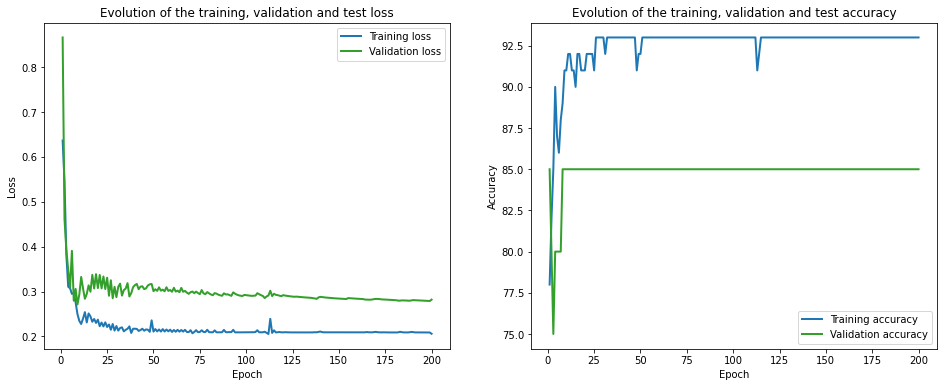

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 145.77it/s]


Initialization done!


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 963.75it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.62 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 1.21 train_acc: 10.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.97 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
val_loss = 0.81 val_acc = 85.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 1.58 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 1.56 train_acc: 50.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 

Epoch 15 of 200, 70% 	 train_loss: 0.87 train_acc: 70.00% took: 0.01s
Epoch 15 of 200, 80% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 90% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 15 of 200, 100% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
val_loss = 0.32 val_acc = 85.00%
Snapshot saved at epoch 15.
Epoch 16 of 200, 10% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 20% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 30% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 40% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 50% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 60% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 70% 	 train_loss: 0.77 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 80% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 90% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 100% 	

Epoch 30 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 30 of 200, 90% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 30 of 200, 100% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
val_loss = 0.32 val_acc = 85.00%
Snapshot saved at epoch 30.
Epoch 31 of 200, 10% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 31 of 200, 20% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 31 of 200, 30% 	 train_loss: 0.68 train_acc: 80.00% took: 0.00s
Epoch 31 of 200, 40% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 50% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 31 of 200, 60% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 31 of 200, 70% 	 train_loss: 0.77 train_acc: 70.00% took: 0.00s
Epoch 31 of 200, 80% 	 train_loss: 0.17 train_acc: 90.00% took: 0.01s
Epoch 31 of 200, 90% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 31 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.33 val_

Epoch 46 of 200, 70% 	 train_loss: 0.72 train_acc: 70.00% took: 0.02s
Epoch 46 of 200, 80% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 46 of 200, 90% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 46 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 0.31 val_acc = 85.00%
Snapshot saved at epoch 46.
Epoch 47 of 200, 10% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 47 of 200, 20% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 47 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 47 of 200, 40% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 47 of 200, 50% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 47 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 47 of 200, 70% 	 train_loss: 0.73 train_acc: 70.00% took: 0.00s
Epoch 47 of 200, 80% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 47 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 47 of 200, 100

val_loss = 0.29 val_acc = 85.00%
Snapshot saved at epoch 57.
Epoch 58 of 200, 10% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 58 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 58 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 50% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 58 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 58 of 200, 70% 	 train_loss: 0.73 train_acc: 70.00% took: 0.00s
Epoch 58 of 200, 80% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 58 of 200, 90% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 58 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 0.30 val_acc = 85.00%
Snapshot saved at epoch 58.
Epoch 59 of 200, 10% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 59 of 200, 20% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 59 of 200, 30% 	 train_l

val_loss = 0.30 val_acc = 85.00%
Snapshot saved at epoch 68.
Epoch 69 of 200, 10% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 69 of 200, 20% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 69 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 69 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 69 of 200, 50% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 69 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 69 of 200, 70% 	 train_loss: 0.73 train_acc: 70.00% took: 0.00s
Epoch 69 of 200, 80% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 69 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 69 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.30 val_acc = 85.00%
Snapshot saved at epoch 69.
Epoch 70 of 200, 10% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 70 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 70 of 200, 30% 	 train_l

Epoch 80 of 200, 10% 	 train_loss: 0.50 train_acc: 80.00% took: 0.01s
Epoch 80 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 80 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 80 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 80 of 200, 50% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 80 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 80 of 200, 70% 	 train_loss: 0.73 train_acc: 70.00% took: 0.00s
Epoch 80 of 200, 80% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 80 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 80 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.30 val_acc = 85.00%
Snapshot saved at epoch 80.
Epoch 81 of 200, 10% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 81 of 200, 20% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 81 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 81 of 200, 40% 

Epoch 90 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 90 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.30 val_acc = 85.00%
Snapshot saved at epoch 90.
Epoch 91 of 200, 10% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 91 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 91 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 91 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 91 of 200, 50% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 91 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 91 of 200, 70% 	 train_loss: 0.73 train_acc: 70.00% took: 0.00s
Epoch 91 of 200, 80% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 91 of 200, 90% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 91 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.30 val_acc = 85.00%
Snapshot saved at epoch 91.
Epoch 92 of 200, 10% 	 train

Epoch 101 of 200, 80% 	 train_loss: 0.17 train_acc: 100.00% took: 0.01s
Epoch 101 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 101 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.30 val_acc = 85.00%
Snapshot saved at epoch 101.
Epoch 102 of 200, 10% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 102 of 200, 20% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 102 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.02s
Epoch 102 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.01s
Epoch 102 of 200, 50% 	 train_loss: 0.02 train_acc: 100.00% took: 0.01s
Epoch 102 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 102 of 200, 70% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 102 of 200, 80% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 102 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 102 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.02s
val_

Epoch 117 of 200, 90% 	 train_loss: 0.10 train_acc: 100.00% took: 0.01s
Epoch 117 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.29 val_acc = 85.00%
Snapshot saved at epoch 117.
Epoch 118 of 200, 10% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 118 of 200, 20% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 118 of 200, 30% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 118 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 118 of 200, 50% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 118 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 118 of 200, 70% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 118 of 200, 80% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 118 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 118 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.02s
val_loss = 0.29 val_acc = 85.00%
Snapshot saved at epoch 118.
Epoch 119 of 2

Epoch 128 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 128 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.01s
val_loss = 0.29 val_acc = 85.00%
Snapshot saved at epoch 128.
Epoch 129 of 200, 10% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 129 of 200, 20% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 129 of 200, 30% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 129 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 129 of 200, 50% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 129 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 129 of 200, 70% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 129 of 200, 80% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 129 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 129 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.29 val_acc = 85.00%
Snapshot saved at epoch 129.
Epoch 130 of 2

Epoch 144 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 144 of 200, 50% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 144 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 144 of 200, 70% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 144 of 200, 80% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 144 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 144 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.29 val_acc = 85.00%
Snapshot saved at epoch 144.
Epoch 145 of 200, 10% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 145 of 200, 20% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 145 of 200, 30% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 145 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 145 of 200, 50% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 145 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 

Epoch 155 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.28 val_acc = 85.00%
Snapshot saved at epoch 155.
Epoch 156 of 200, 10% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 156 of 200, 20% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 156 of 200, 30% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 156 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 156 of 200, 50% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 156 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 156 of 200, 70% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 156 of 200, 80% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 156 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 156 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.28 val_acc = 85.00%
Snapshot saved at epoch 156.
Epoch 157 of 200, 10% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 157 of 20

Epoch 166 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.02s
Epoch 166 of 200, 70% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 166 of 200, 80% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 166 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 166 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.28 val_acc = 85.00%
Snapshot saved at epoch 166.
Epoch 167 of 200, 10% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 167 of 200, 20% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 167 of 200, 30% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 167 of 200, 40% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 167 of 200, 50% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 167 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 167 of 200, 70% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 167 of 200, 80% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 

Epoch 177 of 200, 70% 	 train_loss: 0.72 train_acc: 70.00% took: 0.02s
Epoch 177 of 200, 80% 	 train_loss: 0.17 train_acc: 100.00% took: 0.01s
Epoch 177 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 177 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.28 val_acc = 85.00%
Snapshot saved at epoch 177.
Epoch 178 of 200, 10% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 178 of 200, 20% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 178 of 200, 30% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 50% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 178 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 178 of 200, 70% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 178 of 200, 80% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 178 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 

Epoch 188 of 200, 40% 	 train_loss: 0.17 train_acc: 90.00% took: 0.01s
Epoch 188 of 200, 50% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 188 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 188 of 200, 70% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 188 of 200, 80% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 188 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 188 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.28 val_acc = 85.00%
Snapshot saved at epoch 188.
Epoch 189 of 200, 10% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 189 of 200, 20% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 189 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 189 of 200, 40% 	 train_loss: 0.17 train_acc: 90.00% took: 0.02s
Epoch 189 of 200, 50% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 189 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 

Epoch 199 of 200, 10% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 199 of 200, 20% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 199 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 199 of 200, 40% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 199 of 200, 50% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 199 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 199 of 200, 70% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 199 of 200, 80% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 199 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 199 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.28 val_acc = 85.00%
Snapshot saved at epoch 199.
Epoch 200 of 200, 10% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 200 of 200, 20% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 200 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 2

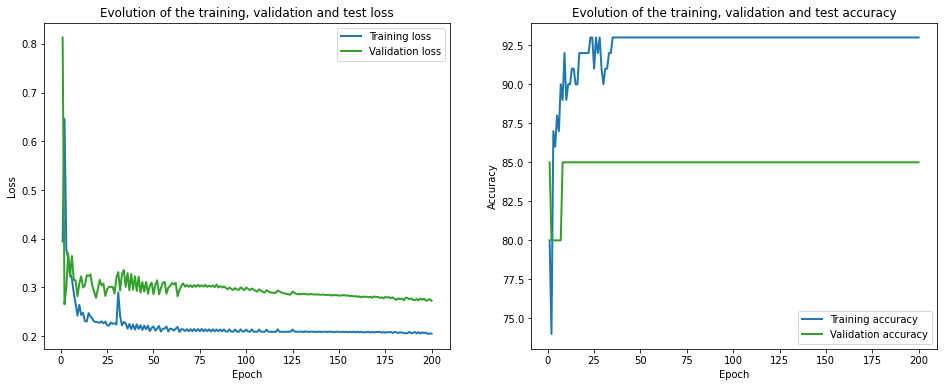

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 149.22it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1224.28it/s]

Finished computing p-values for 500 test points.

Starting repetition 33 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 1.03 train_acc: 30.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 1.00 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 1.67 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.79 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 1.90 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 1.33 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.97 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 1.20 train_acc: 70.00% took: 0.00s
val_loss = 0.39 val_acc = 80.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.

Epoch 16 of 200, 20% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 30% 	 train_loss: 0.52 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 40% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 50% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 70% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 80% 	 train_loss: 0.73 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 90% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 100% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
val_loss = 0.32 val_acc = 85.00%
Snapshot saved at epoch 16.
Epoch 17 of 200, 10% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 20% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 30% 	 train_loss: 0.55 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 40% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 50% 	 tra

Epoch 27 of 200, 40% 	 train_loss: 0.26 train_acc: 90.00% took: 0.01s
Epoch 27 of 200, 50% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 60% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 70% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 80% 	 train_loss: 0.70 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 90% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
val_loss = 0.33 val_acc = 85.00%
Snapshot saved at epoch 27.
Epoch 28 of 200, 10% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 20% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 30% 	 train_loss: 0.53 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 40% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 50% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 60% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 70% 	 tr

Epoch 38 of 200, 10% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 20% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 30% 	 train_loss: 0.50 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 40% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 50% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 60% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 70% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 80% 	 train_loss: 0.69 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 90% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
val_loss = 0.33 val_acc = 80.00%
Snapshot saved at epoch 38.
Epoch 39 of 200, 10% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 39 of 200, 20% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 39 of 200, 30% 	 train_loss: 0.53 train_acc: 90.00% took: 0.00s
Epoch 39 of 200, 40% 	 tra

Epoch 49 of 200, 90% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 49 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
val_loss = 0.33 val_acc = 85.00%
Snapshot saved at epoch 49.
Epoch 50 of 200, 10% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 20% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 30% 	 train_loss: 0.48 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 40% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 50% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 50 of 200, 60% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 70% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 80% 	 train_loss: 0.68 train_acc: 80.00% took: 0.00s
Epoch 50 of 200, 90% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 50 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
val_loss = 0.32 val_acc = 85.00%
Snapshot saved at epoch 50.
Epoch 51 of 200, 10% 	 train_loss

Epoch 61 of 200, 50% 	 train_loss: 0.09 train_acc: 100.00% took: 0.02s
Epoch 61 of 200, 60% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 61 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 61 of 200, 80% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 61 of 200, 90% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 61 of 200, 100% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
val_loss = 0.28 val_acc = 80.00%
Snapshot saved at epoch 61.
Epoch 62 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 62 of 200, 20% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 62 of 200, 30% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 62 of 200, 40% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 62 of 200, 50% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 62 of 200, 60% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 62 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 62 of 200, 80% 	 tr

Epoch 72 of 200, 30% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 72 of 200, 40% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 72 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 72 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 72 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 72 of 200, 80% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 72 of 200, 90% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 72 of 200, 100% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
val_loss = 0.30 val_acc = 75.00%
Snapshot saved at epoch 72.
Epoch 73 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 73 of 200, 20% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 73 of 200, 30% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 73 of 200, 40% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 73 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 73 of 200, 60% 	 tr

Epoch 83 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 83 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 83 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 83 of 200, 80% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 83 of 200, 90% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 83 of 200, 100% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
val_loss = 0.33 val_acc = 75.00%
Snapshot saved at epoch 83.
Epoch 84 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 84 of 200, 20% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 84 of 200, 30% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 84 of 200, 40% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 84 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 84 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 84 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 84 of 200, 80% 	 tr

Epoch 94 of 200, 100% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
val_loss = 0.33 val_acc = 75.00%
Snapshot saved at epoch 94.
Epoch 95 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 95 of 200, 20% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 95 of 200, 30% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 95 of 200, 40% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 95 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 95 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 95 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 95 of 200, 80% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 95 of 200, 90% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 95 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
val_loss = 0.31 val_acc = 75.00%
Snapshot saved at epoch 95.
Epoch 96 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 96 of 200, 20% 	 train_loss:

Epoch 105 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.02s
Epoch 105 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.01s
Epoch 105 of 200, 80% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 105 of 200, 90% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 105 of 200, 100% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
val_loss = 0.36 val_acc = 75.00%
Snapshot saved at epoch 105.
Epoch 106 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 106 of 200, 20% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 106 of 200, 30% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 106 of 200, 40% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 106 of 200, 50% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 106 of 200, 60% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 106 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 106 of 200, 80% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 106 of

Epoch 116 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.02s
Epoch 116 of 200, 80% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 116 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 116 of 200, 100% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
val_loss = 0.36 val_acc = 75.00%
Snapshot saved at epoch 116.
Epoch 117 of 200, 10% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 117 of 200, 20% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 117 of 200, 30% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 117 of 200, 40% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 117 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 117 of 200, 60% 	 train_loss: 0.22 train_acc: 90.00% took: 0.02s
Epoch 117 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 117 of 200, 80% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 117 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 117 o

Epoch 127 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.02s
Epoch 127 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss = 0.36 val_acc = 75.00%
Snapshot saved at epoch 127.
Epoch 128 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 128 of 200, 20% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 128 of 200, 30% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 128 of 200, 40% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 128 of 200, 50% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 128 of 200, 60% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 128 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 128 of 200, 80% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
Epoch 128 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 128 of 200, 100% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
val_loss = 0.38 val_acc = 75.00%
Snapshot saved at epoch 128.
Epoch 129 of 200, 1

Epoch 138 of 200, 100% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
val_loss = 0.30 val_acc = 75.00%
Snapshot saved at epoch 138.
Epoch 139 of 200, 10% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 139 of 200, 20% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 139 of 200, 30% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 139 of 200, 40% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 139 of 200, 50% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 139 of 200, 60% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 139 of 200, 70% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 139 of 200, 80% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 139 of 200, 90% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 139 of 200, 100% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
val_loss = 0.28 val_acc = 80.00%
Snapshot saved at epoch 139.
Epoch 140 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 140 of 200, 20

Epoch 151 of 200, 10% 	 train_loss: 0.22 train_acc: 90.00% took: 0.01s
Epoch 151 of 200, 20% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 151 of 200, 30% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 151 of 200, 40% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 151 of 200, 50% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 151 of 200, 60% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 151 of 200, 70% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 151 of 200, 80% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 151 of 200, 90% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 151 of 200, 100% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
val_loss = 0.30 val_acc = 80.00%
Snapshot saved at epoch 151.
Epoch 152 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 152 of 200, 20% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 152 of 200, 30% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 152 

Epoch 162 of 200, 40% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 162 of 200, 50% 	 train_loss: 0.07 train_acc: 100.00% took: 0.01s
Epoch 162 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 162 of 200, 70% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 162 of 200, 80% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 162 of 200, 90% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 162 of 200, 100% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
val_loss = 0.30 val_acc = 80.00%
Snapshot saved at epoch 162.
Epoch 163 of 200, 10% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 163 of 200, 20% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 163 of 200, 30% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 163 of 200, 40% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 163 of 200, 50% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 163 of 200, 60% 	 train_loss: 0.25 train_acc: 90.00% took: 0.01s
Epoch 163 

val_loss = 0.29 val_acc = 75.00%
Snapshot saved at epoch 172.
Epoch 173 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 173 of 200, 20% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 173 of 200, 30% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 173 of 200, 40% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 173 of 200, 50% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 173 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 173 of 200, 70% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 173 of 200, 80% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 173 of 200, 90% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 173 of 200, 100% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
val_loss = 0.30 val_acc = 80.00%
Snapshot saved at epoch 173.
Epoch 174 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 20% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 174 of 200, 3

Epoch 189 of 200, 20% 	 train_loss: 0.15 train_acc: 100.00% took: 0.02s
Epoch 189 of 200, 30% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 189 of 200, 40% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 189 of 200, 50% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 189 of 200, 60% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 189 of 200, 70% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 189 of 200, 80% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 189 of 200, 90% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 189 of 200, 100% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
val_loss = 0.30 val_acc = 80.00%
Snapshot saved at epoch 189.
Epoch 190 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 190 of 200, 20% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 190 of 200, 30% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 190 of 200, 40% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 190

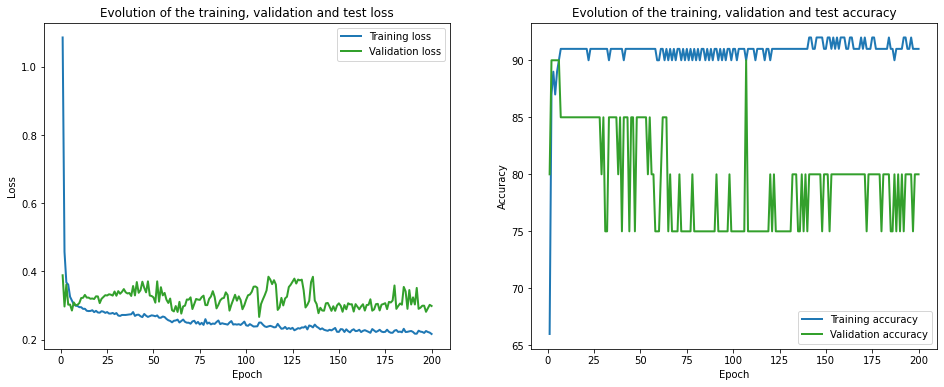

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 152.16it/s]


Initialization done!


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1030.67it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 1.10 train_acc: 20.00% took: 0.01s
Epoch 1 of 200, 20% 	 train_loss: 0.79 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 1.56 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 1.51 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.71 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 1.42 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
val_loss = 0.32 val_acc = 85.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0

Epoch 11 of 200, 100% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
val_loss = 0.29 val_acc = 85.00%
Snapshot saved at epoch 11.
Epoch 12 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 20% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 30% 	 train_loss: 0.49 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 40% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 50% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 60% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 70% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 80% 	 train_loss: 0.81 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 90% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 100% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
val_loss = 0.29 val_acc = 85.00%
Snapshot saved at epoch 12.
Epoch 13 of 200, 10% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 13 of 200, 20% 	 train_loss:

Epoch 28 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.01s
Epoch 28 of 200, 20% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 30% 	 train_loss: 0.47 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 40% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 50% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 60% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 70% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 80% 	 train_loss: 0.76 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 90% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 100% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
val_loss = 0.28 val_acc = 80.00%
Snapshot saved at epoch 28.
Epoch 29 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 29 of 200, 20% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 29 of 200, 30% 	 train_loss: 0.47 train_acc: 90.00% took: 0.00s
Epoch 29 of 200, 40% 	 tra

Epoch 38 of 200, 90% 	 train_loss: 0.15 train_acc: 100.00% took: 0.01s
Epoch 38 of 200, 100% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
val_loss = 0.31 val_acc = 80.00%
Snapshot saved at epoch 38.
Epoch 39 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.01s
Epoch 39 of 200, 20% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 39 of 200, 30% 	 train_loss: 0.44 train_acc: 90.00% took: 0.00s
Epoch 39 of 200, 40% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 39 of 200, 50% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 39 of 200, 60% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 39 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 39 of 200, 80% 	 train_loss: 0.67 train_acc: 80.00% took: 0.00s
Epoch 39 of 200, 90% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 39 of 200, 100% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
val_loss = 0.30 val_acc = 85.00%
Snapshot saved at epoch 39.
Epoch 40 of 200, 10% 	 train_loss

Epoch 53 of 200, 40% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 53 of 200, 50% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 53 of 200, 60% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 53 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 53 of 200, 80% 	 train_loss: 0.69 train_acc: 80.00% took: 0.01s
Epoch 53 of 200, 90% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 53 of 200, 100% 	 train_loss: 0.27 train_acc: 90.00% took: 0.01s
val_loss = 0.28 val_acc = 75.00%
Snapshot saved at epoch 53.
Epoch 54 of 200, 10% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 54 of 200, 20% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 54 of 200, 30% 	 train_loss: 0.45 train_acc: 90.00% took: 0.00s
Epoch 54 of 200, 40% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 54 of 200, 50% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 54 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 54 of 200, 70% 	 tr

Epoch 69 of 200, 40% 	 train_loss: 0.28 train_acc: 80.00% took: 0.02s
Epoch 69 of 200, 50% 	 train_loss: 0.08 train_acc: 100.00% took: 0.01s
Epoch 69 of 200, 60% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 69 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 69 of 200, 80% 	 train_loss: 0.67 train_acc: 80.00% took: 0.00s
Epoch 69 of 200, 90% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 69 of 200, 100% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
val_loss = 0.31 val_acc = 75.00%
Snapshot saved at epoch 69.
Epoch 70 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 70 of 200, 20% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 70 of 200, 30% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 70 of 200, 40% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 70 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 70 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 70 of 200, 70% 	 tr

Epoch 80 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.01s
Epoch 80 of 200, 20% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 80 of 200, 30% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 80 of 200, 40% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 80 of 200, 50% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 80 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 80 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 80 of 200, 80% 	 train_loss: 0.67 train_acc: 80.00% took: 0.00s
Epoch 80 of 200, 90% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 80 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
val_loss = 0.31 val_acc = 75.00%
Snapshot saved at epoch 80.
Epoch 81 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 81 of 200, 20% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 81 of 200, 30% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 81 of 200, 40% 	 tra

Epoch 91 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.02s
Epoch 91 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 91 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 91 of 200, 80% 	 train_loss: 0.66 train_acc: 80.00% took: 0.00s
Epoch 91 of 200, 90% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 91 of 200, 100% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
val_loss = 0.32 val_acc = 75.00%
Snapshot saved at epoch 91.
Epoch 92 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 92 of 200, 20% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 92 of 200, 30% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 92 of 200, 40% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 92 of 200, 50% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 92 of 200, 60% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 92 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 92 of 200, 80% 	 tr

Epoch 102 of 200, 40% 	 train_loss: 0.20 train_acc: 90.00% took: 0.02s
Epoch 102 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 102 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 102 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 102 of 200, 80% 	 train_loss: 0.63 train_acc: 80.00% took: 0.00s
Epoch 102 of 200, 90% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 102 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
val_loss = 0.31 val_acc = 75.00%
Snapshot saved at epoch 102.
Epoch 103 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 103 of 200, 20% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 103 of 200, 30% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 103 of 200, 40% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 103 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 103 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 103 o

Epoch 113 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.02s
Epoch 113 of 200, 80% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 113 of 200, 90% 	 train_loss: 0.11 train_acc: 100.00% took: 0.01s
Epoch 113 of 200, 100% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
val_loss = 0.33 val_acc = 75.00%
Snapshot saved at epoch 113.
Epoch 114 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 114 of 200, 20% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 114 of 200, 30% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 114 of 200, 40% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 114 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 114 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 114 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 114 of 200, 80% 	 train_loss: 0.63 train_acc: 80.00% took: 0.00s
Epoch 114 of 200, 90% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 114 o

Epoch 124 of 200, 50% 	 train_loss: 0.13 train_acc: 100.00% took: 0.02s
Epoch 124 of 200, 60% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 124 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.01s
Epoch 124 of 200, 80% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 124 of 200, 90% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 124 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
val_loss = 0.33 val_acc = 75.00%
Snapshot saved at epoch 124.
Epoch 125 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 125 of 200, 20% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 125 of 200, 30% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 125 of 200, 40% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 125 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 125 of 200, 60% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 125 of 200, 70% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 125 o

Epoch 139 of 200, 30% 	 train_loss: 0.33 train_acc: 80.00% took: 0.02s
Epoch 139 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 139 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 139 of 200, 60% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 139 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 139 of 200, 80% 	 train_loss: 0.63 train_acc: 80.00% took: 0.00s
Epoch 139 of 200, 90% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 139 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
val_loss = 0.36 val_acc = 75.00%
Snapshot saved at epoch 139.
Epoch 140 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 140 of 200, 20% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 140 of 200, 30% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 140 of 200, 40% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 140 of 200, 50% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 140 o

Epoch 150 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.02s
Epoch 150 of 200, 20% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 30% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 40% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 150 of 200, 50% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 80% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
Epoch 150 of 200, 90% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 150 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
val_loss = 0.32 val_acc = 75.00%
Snapshot saved at epoch 150.
Epoch 151 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 151 of 200, 20% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 151 of 200, 30% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 151 of 

Epoch 160 of 200, 80% 	 train_loss: 0.63 train_acc: 80.00% took: 0.02s
Epoch 160 of 200, 90% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 160 of 200, 100% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
val_loss = 0.31 val_acc = 80.00%
Snapshot saved at epoch 160.
Epoch 161 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 161 of 200, 20% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 161 of 200, 30% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 161 of 200, 40% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 161 of 200, 50% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 161 of 200, 60% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 161 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 161 of 200, 80% 	 train_loss: 0.64 train_acc: 80.00% took: 0.00s
Epoch 161 of 200, 90% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 161 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
val_loss = 

Epoch 171 of 200, 40% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 171 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 171 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 171 of 200, 70% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 171 of 200, 80% 	 train_loss: 0.66 train_acc: 80.00% took: 0.00s
Epoch 171 of 200, 90% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 171 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
val_loss = 0.30 val_acc = 75.00%
Snapshot saved at epoch 171.
Epoch 172 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 172 of 200, 20% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 172 of 200, 30% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 172 of 200, 40% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 172 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 172 of 200, 60% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 172 o

Epoch 182 of 200, 50% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 182 of 200, 60% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 182 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 182 of 200, 80% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 182 of 200, 90% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 182 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
val_loss = 0.33 val_acc = 75.00%
Snapshot saved at epoch 182.
Epoch 183 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 183 of 200, 20% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 183 of 200, 30% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 183 of 200, 40% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 183 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 183 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 183 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 183 of

Epoch 193 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.01s
Epoch 193 of 200, 20% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 193 of 200, 30% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 193 of 200, 40% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 193 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 193 of 200, 60% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 193 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 193 of 200, 80% 	 train_loss: 0.64 train_acc: 80.00% took: 0.00s
Epoch 193 of 200, 90% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 193 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
val_loss = 0.35 val_acc = 75.00%
Snapshot saved at epoch 193.
Epoch 194 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 194 of 200, 20% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 194 of 200, 30% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 194 of

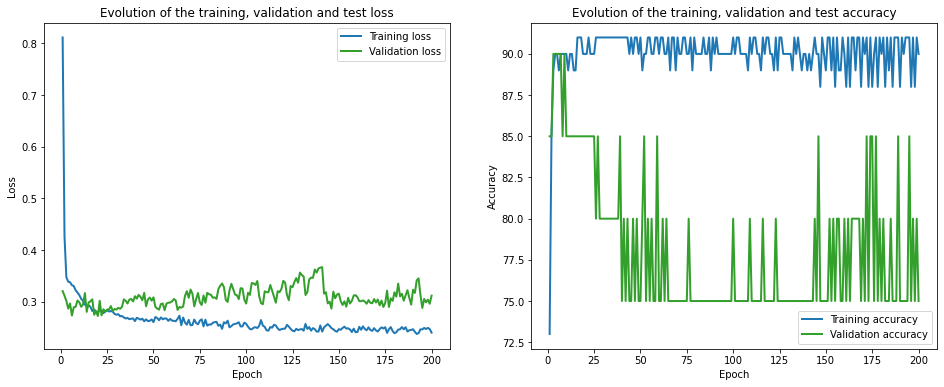

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 148.77it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1204.09it/s]

Finished computing p-values for 500 test points.

Starting repetition 34 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.60 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 1.32 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.86 train_acc: 30.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 1.68 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.84 train_acc: 30.00% took: 0.00s
val_loss = 0.37 val_acc = 90.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 1.02 train_acc: 40.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.71 train_acc: 70.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.

val_loss = 0.63 val_acc = 65.00%
Snapshot saved at epoch 14.
Epoch 15 of 200, 10% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 15 of 200, 20% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 15 of 200, 30% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 15 of 200, 40% 	 train_loss: 0.48 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 50% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 60% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 15 of 200, 70% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 80% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 90% 	 train_loss: 0.81 train_acc: 60.00% took: 0.00s
Epoch 15 of 200, 100% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
val_loss = 0.64 val_acc = 65.00%
Snapshot saved at epoch 15.
Epoch 16 of 200, 10% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 20% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 30% 	 train_loss: 0

Epoch 25 of 200, 90% 	 train_loss: 1.05 train_acc: 60.00% took: 0.01s
Epoch 25 of 200, 100% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
val_loss = 0.52 val_acc = 65.00%
Snapshot saved at epoch 25.
Epoch 26 of 200, 10% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 26 of 200, 20% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 26 of 200, 30% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 26 of 200, 40% 	 train_loss: 0.45 train_acc: 90.00% took: 0.00s
Epoch 26 of 200, 50% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 26 of 200, 60% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 26 of 200, 70% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 26 of 200, 80% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 26 of 200, 90% 	 train_loss: 0.87 train_acc: 60.00% took: 0.00s
Epoch 26 of 200, 100% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
val_loss = 0.59 val_acc = 65.00%
Snapshot saved at epoch 26.
Epoch 27 of 200, 10% 	 train_loss: 

val_loss = 0.54 val_acc = 65.00%
Snapshot saved at epoch 36.
Epoch 37 of 200, 10% 	 train_loss: 0.38 train_acc: 80.00% took: 0.01s
Epoch 37 of 200, 20% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
Epoch 37 of 200, 30% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 37 of 200, 40% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 37 of 200, 50% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 37 of 200, 60% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 37 of 200, 70% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 37 of 200, 80% 	 train_loss: 0.32 train_acc: 90.00% took: 0.02s
Epoch 37 of 200, 90% 	 train_loss: 1.12 train_acc: 60.00% took: 0.00s
Epoch 37 of 200, 100% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
val_loss = 0.50 val_acc = 65.00%
Snapshot saved at epoch 37.
Epoch 38 of 200, 10% 	 train_loss: 0.38 train_acc: 80.00% took: 0.01s
Epoch 38 of 200, 20% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 30% 	 train_loss: 0

Epoch 52 of 200, 10% 	 train_loss: 0.38 train_acc: 80.00% took: 0.01s
Epoch 52 of 200, 20% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 52 of 200, 30% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 52 of 200, 40% 	 train_loss: 0.52 train_acc: 90.00% took: 0.00s
Epoch 52 of 200, 50% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 52 of 200, 60% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 52 of 200, 70% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 52 of 200, 80% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 52 of 200, 90% 	 train_loss: 1.19 train_acc: 60.00% took: 0.00s
Epoch 52 of 200, 100% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
val_loss = 0.55 val_acc = 65.00%
Snapshot saved at epoch 52.
Epoch 53 of 200, 10% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 53 of 200, 20% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
Epoch 53 of 200, 30% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 53 of 200, 40% 	 trai

Epoch 62 of 200, 90% 	 train_loss: 1.12 train_acc: 60.00% took: 0.01s
Epoch 62 of 200, 100% 	 train_loss: 0.34 train_acc: 90.00% took: 0.01s
val_loss = 0.52 val_acc = 65.00%
Snapshot saved at epoch 62.
Epoch 63 of 200, 10% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 63 of 200, 20% 	 train_loss: 0.58 train_acc: 80.00% took: 0.00s
Epoch 63 of 200, 30% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 63 of 200, 40% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 63 of 200, 50% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 63 of 200, 60% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 63 of 200, 70% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 63 of 200, 80% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 63 of 200, 90% 	 train_loss: 1.25 train_acc: 60.00% took: 0.00s
Epoch 63 of 200, 100% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
val_loss = 0.42 val_acc = 70.00%
Snapshot saved at epoch 63.
Epoch 64 of 200, 10% 	 train_loss: 

Epoch 73 of 200, 80% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 73 of 200, 90% 	 train_loss: 0.99 train_acc: 60.00% took: 0.00s
Epoch 73 of 200, 100% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
val_loss = 0.43 val_acc = 75.00%
Snapshot saved at epoch 73.
Epoch 74 of 200, 10% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 74 of 200, 20% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 74 of 200, 30% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 74 of 200, 40% 	 train_loss: 0.58 train_acc: 90.00% took: 0.00s
Epoch 74 of 200, 50% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 74 of 200, 60% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 74 of 200, 70% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 74 of 200, 80% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 74 of 200, 90% 	 train_loss: 1.23 train_acc: 60.00% took: 0.00s
Epoch 74 of 200, 100% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
val_loss = 0.57 val_acc = 

Epoch 88 of 200, 90% 	 train_loss: 1.00 train_acc: 60.00% took: 0.00s
Epoch 88 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss = 0.41 val_acc = 75.00%
Snapshot saved at epoch 88.
Epoch 89 of 200, 10% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 89 of 200, 20% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 89 of 200, 30% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 89 of 200, 40% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 50% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 60% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 89 of 200, 70% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 80% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 89 of 200, 90% 	 train_loss: 0.95 train_acc: 60.00% took: 0.00s
Epoch 89 of 200, 100% 	 train_loss: 0.62 train_acc: 60.00% took: 0.00s
val_loss = 0.42 val_acc = 70.00%
Snapshot saved at epoch 89.
Epoch 90 of 200, 10% 	 train_loss:

Epoch 99 of 200, 90% 	 train_loss: 1.04 train_acc: 60.00% took: 0.00s
Epoch 99 of 200, 100% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
val_loss = 0.57 val_acc = 65.00%
Snapshot saved at epoch 99.
Epoch 100 of 200, 10% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 20% 	 train_loss: 0.65 train_acc: 70.00% took: 0.00s
Epoch 100 of 200, 30% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 40% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 100 of 200, 50% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 60% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 100 of 200, 70% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 80% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 90% 	 train_loss: 1.03 train_acc: 60.00% took: 0.00s
Epoch 100 of 200, 100% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
val_loss = 0.55 val_acc = 65.00%
Snapshot saved at epoch 100.
Epoch 101 of 200, 10% 	

Epoch 110 of 200, 100% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
val_loss = 0.56 val_acc = 60.00%
Snapshot saved at epoch 110.
Epoch 111 of 200, 10% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 111 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.02s
Epoch 111 of 200, 30% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 111 of 200, 40% 	 train_loss: 0.21 train_acc: 100.00% took: 0.01s
Epoch 111 of 200, 50% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 60% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 70% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 80% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 90% 	 train_loss: 1.23 train_acc: 70.00% took: 0.00s
Epoch 111 of 200, 100% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
val_loss = 0.49 val_acc = 65.00%
Snapshot saved at epoch 111.
Epoch 112 of 200, 10% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 112 of 200, 20

Epoch 126 of 200, 80% 	 train_loss: 0.35 train_acc: 80.00% took: 0.01s
Epoch 126 of 200, 90% 	 train_loss: 1.66 train_acc: 70.00% took: 0.00s
Epoch 126 of 200, 100% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
val_loss = 0.44 val_acc = 55.00%
Snapshot saved at epoch 126.
Epoch 127 of 200, 10% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 127 of 200, 20% 	 train_loss: 0.61 train_acc: 70.00% took: 0.00s
Epoch 127 of 200, 30% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 127 of 200, 40% 	 train_loss: 0.37 train_acc: 100.00% took: 0.00s
Epoch 127 of 200, 50% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 127 of 200, 60% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 127 of 200, 70% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 127 of 200, 80% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 127 of 200, 90% 	 train_loss: 1.25 train_acc: 70.00% took: 0.00s
Epoch 127 of 200, 100% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
val_loss = 

Epoch 141 of 200, 80% 	 train_loss: 0.51 train_acc: 90.00% took: 0.00s
Epoch 141 of 200, 90% 	 train_loss: 1.20 train_acc: 70.00% took: 0.00s
Epoch 141 of 200, 100% 	 train_loss: 0.52 train_acc: 70.00% took: 0.00s
val_loss = 0.86 val_acc = 55.00%
Snapshot saved at epoch 141.
Epoch 142 of 200, 10% 	 train_loss: 0.56 train_acc: 50.00% took: 0.00s
Epoch 142 of 200, 20% 	 train_loss: 0.66 train_acc: 70.00% took: 0.00s
Epoch 142 of 200, 30% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 142 of 200, 40% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 142 of 200, 50% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 142 of 200, 60% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 142 of 200, 70% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 142 of 200, 80% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 142 of 200, 90% 	 train_loss: 0.68 train_acc: 70.00% took: 0.00s
Epoch 142 of 200, 100% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
val_loss =

Epoch 157 of 200, 50% 	 train_loss: 0.17 train_acc: 80.00% took: 0.00s
Epoch 157 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 157 of 200, 70% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 157 of 200, 80% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 157 of 200, 90% 	 train_loss: 1.46 train_acc: 70.00% took: 0.00s
Epoch 157 of 200, 100% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
val_loss = 0.46 val_acc = 55.00%
Snapshot saved at epoch 157.
Epoch 158 of 200, 10% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 158 of 200, 20% 	 train_loss: 0.68 train_acc: 70.00% took: 0.00s
Epoch 158 of 200, 30% 	 train_loss: 0.47 train_acc: 60.00% took: 0.00s
Epoch 158 of 200, 40% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 158 of 200, 50% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 158 of 200, 60% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 158 of 200, 70% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 158 of

Epoch 168 of 200, 10% 	 train_loss: 0.32 train_acc: 80.00% took: 0.02s
Epoch 168 of 200, 20% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 168 of 200, 30% 	 train_loss: 0.36 train_acc: 70.00% took: 0.00s
Epoch 168 of 200, 40% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 168 of 200, 50% 	 train_loss: 0.18 train_acc: 80.00% took: 0.00s
Epoch 168 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 168 of 200, 70% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 168 of 200, 80% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 168 of 200, 90% 	 train_loss: 0.97 train_acc: 70.00% took: 0.00s
Epoch 168 of 200, 100% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
val_loss = 0.91 val_acc = 55.00%
Snapshot saved at epoch 168.
Epoch 169 of 200, 10% 	 train_loss: 0.34 train_acc: 60.00% took: 0.00s
Epoch 169 of 200, 20% 	 train_loss: 0.78 train_acc: 70.00% took: 0.00s
Epoch 169 of 200, 30% 	 train_loss: 0.35 train_acc: 70.00% took: 0.00s
Epoch 169 of 

Epoch 183 of 200, 100% 	 train_loss: 0.50 train_acc: 80.00% took: 0.02s
val_loss = 0.92 val_acc = 55.00%
Snapshot saved at epoch 183.
Epoch 184 of 200, 10% 	 train_loss: 0.41 train_acc: 60.00% took: 0.00s
Epoch 184 of 200, 20% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 184 of 200, 30% 	 train_loss: 0.34 train_acc: 70.00% took: 0.00s
Epoch 184 of 200, 40% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 184 of 200, 50% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 184 of 200, 60% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 184 of 200, 70% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 184 of 200, 80% 	 train_loss: 0.34 train_acc: 70.00% took: 0.00s
Epoch 184 of 200, 90% 	 train_loss: 0.86 train_acc: 60.00% took: 0.00s
Epoch 184 of 200, 100% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
val_loss = 1.07 val_acc = 55.00%
Snapshot saved at epoch 184.
Epoch 185 of 200, 10% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 185 of 200, 20

val_loss = 0.85 val_acc = 55.00%
Snapshot saved at epoch 194.
Epoch 195 of 200, 10% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 195 of 200, 20% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 195 of 200, 30% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
Epoch 195 of 200, 40% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 195 of 200, 50% 	 train_loss: 0.19 train_acc: 80.00% took: 0.00s
Epoch 195 of 200, 60% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 195 of 200, 70% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 195 of 200, 80% 	 train_loss: 0.33 train_acc: 70.00% took: 0.00s
Epoch 195 of 200, 90% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 195 of 200, 100% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
val_loss = 0.82 val_acc = 90.00%
Snapshot saved at epoch 195.
Epoch 196 of 200, 10% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 20% 	 train_loss: 0.54 train_acc: 60.00% took: 0.00s
Epoch 196 of 200, 30%

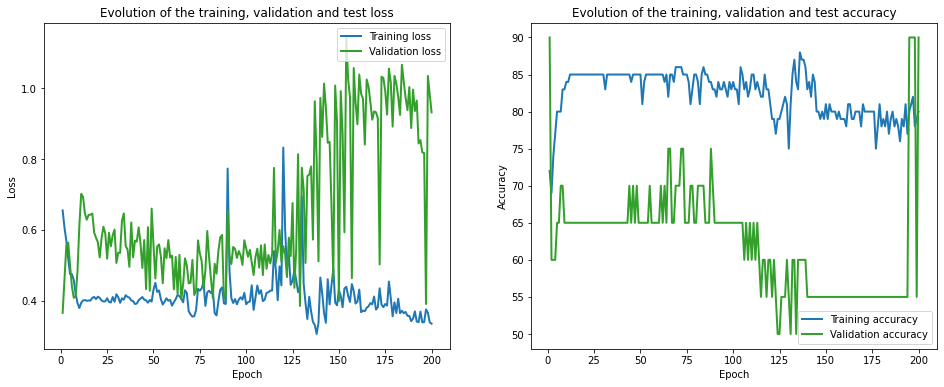

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 164.09it/s]


Initialization done!


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1165.29it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 0.68 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.92 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.53 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 2.03 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.95 train_acc: 30.00% took: 0.00s
val_loss = 0.34 val_acc = 95.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.83 train_acc: 40.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.72 train_acc: 20.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.5

Epoch 16 of 200, 100% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
val_loss = 0.68 val_acc = 65.00%
Snapshot saved at epoch 16.
Epoch 17 of 200, 10% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 20% 	 train_loss: 0.58 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 30% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 40% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 50% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 60% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 70% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 80% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 90% 	 train_loss: 0.73 train_acc: 60.00% took: 0.00s
Epoch 17 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss = 0.72 val_acc = 65.00%
Snapshot saved at epoch 17.
Epoch 18 of 200, 10% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 18 of 200, 20% 	 train_loss: 

Epoch 28 of 200, 10% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 28 of 200, 30% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 40% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 50% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 60% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 70% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 90% 	 train_loss: 0.67 train_acc: 70.00% took: 0.00s
Epoch 28 of 200, 100% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
val_loss = 0.77 val_acc = 65.00%
Snapshot saved at epoch 28.
Epoch 29 of 200, 10% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 29 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 29 of 200, 30% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 29 of 200, 40% 	 tra

Epoch 43 of 200, 60% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 43 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 43 of 200, 80% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 43 of 200, 90% 	 train_loss: 0.90 train_acc: 70.00% took: 0.00s
Epoch 43 of 200, 100% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
val_loss = 0.92 val_acc = 60.00%
Snapshot saved at epoch 43.
Epoch 44 of 200, 10% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 44 of 200, 20% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 44 of 200, 30% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 44 of 200, 40% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 44 of 200, 50% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 44 of 200, 60% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 44 of 200, 70% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 44 of 200, 80% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 44 of 200, 90% 	 t

Epoch 54 of 200, 50% 	 train_loss: 0.20 train_acc: 80.00% took: 0.02s
Epoch 54 of 200, 60% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 54 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 54 of 200, 80% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 54 of 200, 90% 	 train_loss: 1.16 train_acc: 70.00% took: 0.00s
Epoch 54 of 200, 100% 	 train_loss: 0.47 train_acc: 50.00% took: 0.00s
val_loss = 0.50 val_acc = 55.00%
Snapshot saved at epoch 54.
Epoch 55 of 200, 10% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 55 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 55 of 200, 30% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 55 of 200, 40% 	 train_loss: 0.31 train_acc: 100.00% took: 0.00s
Epoch 55 of 200, 50% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 55 of 200, 60% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 55 of 200, 70% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 55 of 200, 80% 	 tr

val_loss = 0.91 val_acc = 55.00%
Snapshot saved at epoch 69.
Epoch 70 of 200, 10% 	 train_loss: 0.35 train_acc: 80.00% took: 0.01s
Epoch 70 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 70 of 200, 30% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 70 of 200, 40% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 70 of 200, 50% 	 train_loss: 0.17 train_acc: 80.00% took: 0.00s
Epoch 70 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 70 of 200, 70% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 70 of 200, 80% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 70 of 200, 90% 	 train_loss: 0.99 train_acc: 70.00% took: 0.00s
Epoch 70 of 200, 100% 	 train_loss: 0.55 train_acc: 60.00% took: 0.00s
val_loss = 0.91 val_acc = 55.00%
Snapshot saved at epoch 70.
Epoch 71 of 200, 10% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 71 of 200, 20% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 71 of 200, 30% 	 train_loss: 0

Epoch 81 of 200, 10% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 81 of 200, 20% 	 train_loss: 0.61 train_acc: 70.00% took: 0.00s
Epoch 81 of 200, 30% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 81 of 200, 40% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 81 of 200, 50% 	 train_loss: 0.18 train_acc: 80.00% took: 0.00s
Epoch 81 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 81 of 200, 70% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 81 of 200, 80% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 81 of 200, 90% 	 train_loss: 1.05 train_acc: 70.00% took: 0.00s
Epoch 81 of 200, 100% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
val_loss = 0.89 val_acc = 55.00%
Snapshot saved at epoch 81.
Epoch 82 of 200, 10% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 82 of 200, 20% 	 train_loss: 0.62 train_acc: 70.00% took: 0.00s
Epoch 82 of 200, 30% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 82 of 200, 40% 	 trai

Epoch 96 of 200, 80% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 96 of 200, 90% 	 train_loss: 1.00 train_acc: 70.00% took: 0.00s
Epoch 96 of 200, 100% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
val_loss = 1.14 val_acc = 55.00%
Snapshot saved at epoch 96.
Epoch 97 of 200, 10% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 97 of 200, 20% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 97 of 200, 30% 	 train_loss: 0.36 train_acc: 70.00% took: 0.00s
Epoch 97 of 200, 40% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 97 of 200, 50% 	 train_loss: 0.18 train_acc: 80.00% took: 0.00s
Epoch 97 of 200, 60% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 97 of 200, 70% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 97 of 200, 80% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 97 of 200, 90% 	 train_loss: 1.11 train_acc: 70.00% took: 0.00s
Epoch 97 of 200, 100% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
val_loss = 1.05 val_acc =

Epoch 112 of 200, 60% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 112 of 200, 70% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 112 of 200, 80% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 112 of 200, 90% 	 train_loss: 0.99 train_acc: 70.00% took: 0.00s
Epoch 112 of 200, 100% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
val_loss = 1.18 val_acc = 55.00%
Snapshot saved at epoch 112.
Epoch 113 of 200, 10% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 113 of 200, 20% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
Epoch 113 of 200, 30% 	 train_loss: 0.35 train_acc: 70.00% took: 0.00s
Epoch 113 of 200, 40% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 113 of 200, 50% 	 train_loss: 0.19 train_acc: 80.00% took: 0.00s
Epoch 113 of 200, 60% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 113 of 200, 70% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 113 of 200, 80% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 113 of

Epoch 123 of 200, 50% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 123 of 200, 60% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 123 of 200, 70% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 123 of 200, 80% 	 train_loss: 0.35 train_acc: 70.00% took: 0.00s
Epoch 123 of 200, 90% 	 train_loss: 0.93 train_acc: 70.00% took: 0.00s
Epoch 123 of 200, 100% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
val_loss = 1.07 val_acc = 55.00%
Snapshot saved at epoch 123.
Epoch 124 of 200, 10% 	 train_loss: 0.34 train_acc: 60.00% took: 0.00s
Epoch 124 of 200, 20% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 124 of 200, 30% 	 train_loss: 0.33 train_acc: 70.00% took: 0.00s
Epoch 124 of 200, 40% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 124 of 200, 50% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 124 of 200, 60% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 124 of 200, 70% 	 train_loss: 0.27 train_acc: 70.00% took: 0.00s
Epoch 124 o

Epoch 139 of 200, 20% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 139 of 200, 30% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
Epoch 139 of 200, 40% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 139 of 200, 50% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 139 of 200, 60% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 139 of 200, 70% 	 train_loss: 0.27 train_acc: 70.00% took: 0.00s
Epoch 139 of 200, 80% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 139 of 200, 90% 	 train_loss: 0.82 train_acc: 70.00% took: 0.00s
Epoch 139 of 200, 100% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
val_loss = 1.12 val_acc = 55.00%
Snapshot saved at epoch 139.
Epoch 140 of 200, 10% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 140 of 200, 20% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 140 of 200, 30% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
Epoch 140 of 200, 40% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 140 o

Epoch 150 of 200, 10% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 150 of 200, 20% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 150 of 200, 30% 	 train_loss: 0.31 train_acc: 70.00% took: 0.00s
Epoch 150 of 200, 40% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 150 of 200, 50% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 150 of 200, 60% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 70% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 150 of 200, 80% 	 train_loss: 0.35 train_acc: 70.00% took: 0.00s
Epoch 150 of 200, 90% 	 train_loss: 0.91 train_acc: 70.00% took: 0.00s
Epoch 150 of 200, 100% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
val_loss = 1.03 val_acc = 55.00%
Snapshot saved at epoch 150.
Epoch 151 of 200, 10% 	 train_loss: 0.33 train_acc: 60.00% took: 0.00s
Epoch 151 of 200, 20% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 151 of 200, 30% 	 train_loss: 0.31 train_acc: 70.00% took: 0.00s
Epoch 151 of 

Epoch 161 of 200, 10% 	 train_loss: 0.33 train_acc: 60.00% took: 0.00s
Epoch 161 of 200, 20% 	 train_loss: 0.66 train_acc: 70.00% took: 0.00s
Epoch 161 of 200, 30% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 161 of 200, 40% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 161 of 200, 50% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 161 of 200, 60% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 161 of 200, 70% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 161 of 200, 80% 	 train_loss: 0.34 train_acc: 70.00% took: 0.00s
Epoch 161 of 200, 90% 	 train_loss: 0.79 train_acc: 70.00% took: 0.00s
Epoch 161 of 200, 100% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
val_loss = 1.03 val_acc = 55.00%
Snapshot saved at epoch 161.
Epoch 162 of 200, 10% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 162 of 200, 20% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 162 of 200, 30% 	 train_loss: 0.29 train_acc: 70.00% took: 0.00s
Epoch 162 of

Epoch 176 of 200, 30% 	 train_loss: 0.29 train_acc: 70.00% took: 0.00s
Epoch 176 of 200, 40% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 176 of 200, 50% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 176 of 200, 60% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 176 of 200, 70% 	 train_loss: 0.28 train_acc: 70.00% took: 0.00s
Epoch 176 of 200, 80% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 176 of 200, 90% 	 train_loss: 0.78 train_acc: 70.00% took: 0.00s
Epoch 176 of 200, 100% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
val_loss = 1.11 val_acc = 55.00%
Snapshot saved at epoch 176.
Epoch 177 of 200, 10% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 177 of 200, 20% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 177 of 200, 30% 	 train_loss: 0.29 train_acc: 70.00% took: 0.00s
Epoch 177 of 200, 40% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 177 of 200, 50% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 177 o

Epoch 187 of 200, 70% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 187 of 200, 80% 	 train_loss: 0.35 train_acc: 70.00% took: 0.01s
Epoch 187 of 200, 90% 	 train_loss: 0.85 train_acc: 70.00% took: 0.00s
Epoch 187 of 200, 100% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
val_loss = 1.03 val_acc = 90.00%
Snapshot saved at epoch 187.
Epoch 188 of 200, 10% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 188 of 200, 20% 	 train_loss: 0.52 train_acc: 70.00% took: 0.00s
Epoch 188 of 200, 30% 	 train_loss: 0.29 train_acc: 70.00% took: 0.00s
Epoch 188 of 200, 40% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 188 of 200, 50% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 188 of 200, 60% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 188 of 200, 70% 	 train_loss: 0.28 train_acc: 70.00% took: 0.00s
Epoch 188 of 200, 80% 	 train_loss: 0.33 train_acc: 70.00% took: 0.00s
Epoch 188 of 200, 90% 	 train_loss: 0.76 train_acc: 70.00% took: 0.00s
Epoch 188 of

Epoch 198 of 200, 80% 	 train_loss: 0.33 train_acc: 70.00% took: 0.00s
Epoch 198 of 200, 90% 	 train_loss: 0.73 train_acc: 70.00% took: 0.00s
Epoch 198 of 200, 100% 	 train_loss: 0.38 train_acc: 70.00% took: 0.00s
val_loss = 1.17 val_acc = 90.00%
Snapshot saved at epoch 198.
Epoch 199 of 200, 10% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 199 of 200, 20% 	 train_loss: 0.51 train_acc: 60.00% took: 0.00s
Epoch 199 of 200, 30% 	 train_loss: 0.29 train_acc: 70.00% took: 0.00s
Epoch 199 of 200, 40% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 199 of 200, 50% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 199 of 200, 60% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 199 of 200, 70% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 199 of 200, 80% 	 train_loss: 0.35 train_acc: 70.00% took: 0.00s
Epoch 199 of 200, 90% 	 train_loss: 0.83 train_acc: 70.00% took: 0.00s
Epoch 199 of 200, 100% 	 train_loss: 0.38 train_acc: 70.00% took: 0.00s
val_loss = 1

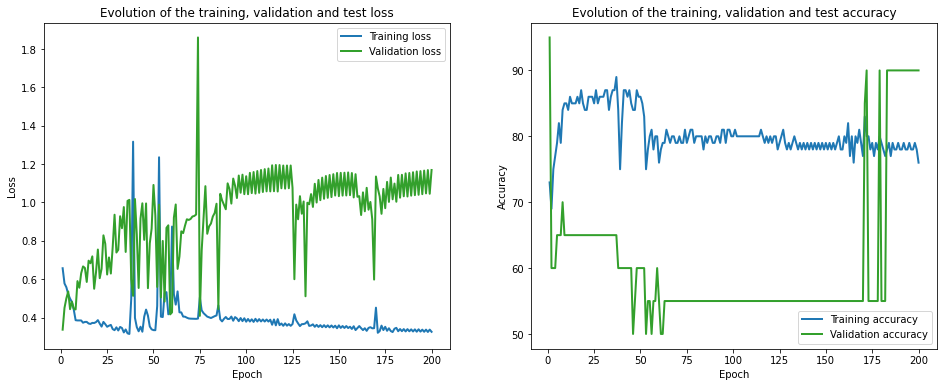

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 153.62it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1204.13it/s]

Finished computing p-values for 500 test points.

Starting repetition 35 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 1.22 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 3.21 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.56 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
val_loss = 0.35 val_acc = 90.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.65 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0

Epoch 11 of 200, 90% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 11 of 200, 100% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
val_loss = 0.27 val_acc = 85.00%
Snapshot saved at epoch 11.
Epoch 12 of 200, 10% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 20% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 30% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 40% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 50% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 60% 	 train_loss: 0.67 train_acc: 70.00% took: 0.00s
Epoch 12 of 200, 70% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 80% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 12 of 200, 90% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 100% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
val_loss = 0.18 val_acc = 90.00%
Snapshot saved at epoch 12.
Epoch 13 of 200, 10% 	 train_loss:

Epoch 27 of 200, 10% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 20% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 30% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 50% 	 train_loss: 0.21 train_acc: 90.00% took: 0.01s
Epoch 27 of 200, 60% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 70% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 80% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 90% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.17 val_acc = 90.00%
Snapshot saved at epoch 27.
Epoch 28 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 20% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 40% 

Epoch 38 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.02s
Epoch 38 of 200, 20% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 40% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 50% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 60% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 70% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 80% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 90% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.19 val_acc = 90.00%
Snapshot saved at epoch 38.
Epoch 39 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 39 of 200, 20% 	 train_loss: 0.44 train_acc: 80.00% took: 0.02s
Epoch 39 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 39 of 200, 40% 

Epoch 49 of 200, 80% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 49 of 200, 90% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 49 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.24 val_acc = 90.00%
Snapshot saved at epoch 49.
Epoch 50 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 50 of 200, 20% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 50 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 50 of 200, 40% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 50 of 200, 50% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 60% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 50 of 200, 70% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 50 of 200, 80% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 90% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.24 val_a

Epoch 60 of 200, 60% 	 train_loss: 0.51 train_acc: 80.00% took: 0.02s
Epoch 60 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 60 of 200, 80% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 60 of 200, 90% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 60 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.24 val_acc = 90.00%
Snapshot saved at epoch 60.
Epoch 61 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 61 of 200, 20% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 61 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 61 of 200, 40% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 61 of 200, 50% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 61 of 200, 60% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 61 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 61 of 200, 80% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 61 of 200, 90% 	

Epoch 72 of 200, 20% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 72 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 72 of 200, 40% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 72 of 200, 50% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 72 of 200, 60% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 72 of 200, 70% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 72 of 200, 80% 	 train_loss: 0.30 train_acc: 90.00% took: 0.02s
Epoch 72 of 200, 90% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 72 of 200, 100% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
val_loss = 0.34 val_acc = 90.00%
Snapshot saved at epoch 72.
Epoch 73 of 200, 10% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 73 of 200, 20% 	 train_loss: 0.54 train_acc: 80.00% took: 0.02s
Epoch 73 of 200, 30% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 73 of 200, 40% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 73 of 200, 50% 

Epoch 87 of 200, 40% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 87 of 200, 50% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 87 of 200, 60% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 87 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 87 of 200, 80% 	 train_loss: 0.30 train_acc: 90.00% took: 0.02s
Epoch 87 of 200, 90% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 87 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 0.36 val_acc = 90.00%
Snapshot saved at epoch 87.
Epoch 88 of 200, 10% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 88 of 200, 20% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 88 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 88 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 88 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 88 of 200, 60% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 88 of 200, 70% 	

Epoch 98 of 200, 80% 	 train_loss: 0.32 train_acc: 90.00% took: 0.02s
Epoch 98 of 200, 90% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 98 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.33 val_acc = 90.00%
Snapshot saved at epoch 98.
Epoch 99 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 99 of 200, 20% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 99 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 99 of 200, 40% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 99 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 99 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 99 of 200, 70% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 99 of 200, 80% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 99 of 200, 90% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 99 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 0.34 val_a

Epoch 109 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.02s
Epoch 109 of 200, 80% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 109 of 200, 90% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 109 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.36 val_acc = 90.00%
Snapshot saved at epoch 109.
Epoch 110 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 110 of 200, 20% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 110 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 110 of 200, 40% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 110 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 110 of 200, 60% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 110 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 110 of 200, 80% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 110 of 200, 90% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 11

Epoch 120 of 200, 80% 	 train_loss: 0.31 train_acc: 90.00% took: 0.02s
Epoch 120 of 200, 90% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 120 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.01s
val_loss = 0.35 val_acc = 90.00%
Snapshot saved at epoch 120.
Epoch 121 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 121 of 200, 20% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 121 of 200, 30% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 121 of 200, 40% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 121 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 121 of 200, 60% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 121 of 200, 70% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 121 of 200, 80% 	 train_loss: 0.28 train_acc: 90.00% took: 0.01s
Epoch 121 of 200, 90% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 121 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_los

Epoch 131 of 200, 30% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 131 of 200, 40% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 131 of 200, 50% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 131 of 200, 60% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 131 of 200, 70% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 131 of 200, 80% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 131 of 200, 90% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 131 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.43 val_acc = 90.00%
Snapshot saved at epoch 131.
Epoch 132 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 132 of 200, 20% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 132 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 132 of 200, 40% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 132 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 1

Epoch 142 of 200, 40% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 142 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.01s
Epoch 142 of 200, 60% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 142 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 142 of 200, 80% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 142 of 200, 90% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 142 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 0.40 val_acc = 90.00%
Snapshot saved at epoch 142.
Epoch 143 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 143 of 200, 20% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 143 of 200, 30% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 143 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 143 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 143 of 200, 60% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 14

Epoch 153 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 153 of 200, 60% 	 train_loss: 0.48 train_acc: 80.00% took: 0.01s
Epoch 153 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 153 of 200, 80% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 153 of 200, 90% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 153 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 0.40 val_acc = 90.00%
Snapshot saved at epoch 153.
Epoch 154 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 154 of 200, 20% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 154 of 200, 30% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 154 of 200, 40% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 154 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 154 of 200, 60% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 154 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 15

Epoch 164 of 200, 60% 	 train_loss: 0.48 train_acc: 80.00% took: 0.02s
Epoch 164 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 164 of 200, 80% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 164 of 200, 90% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 164 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.47 val_acc = 90.00%
Snapshot saved at epoch 164.
Epoch 165 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 165 of 200, 20% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 165 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 165 of 200, 40% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 165 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 165 of 200, 60% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 165 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 165 of 200, 80% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 16

Epoch 180 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 180 of 200, 20% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 180 of 200, 30% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 180 of 200, 40% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 180 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 180 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 180 of 200, 70% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 180 of 200, 80% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 180 of 200, 90% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 180 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 0.59 val_acc = 90.00%
Snapshot saved at epoch 180.
Epoch 181 of 200, 10% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 181 of 200, 20% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 181 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 1

Epoch 190 of 200, 70% 	 train_loss: 0.03 train_acc: 100.00% took: 0.02s
Epoch 190 of 200, 80% 	 train_loss: 0.32 train_acc: 90.00% took: 0.01s
Epoch 190 of 200, 90% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 190 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 0.43 val_acc = 90.00%
Snapshot saved at epoch 190.
Epoch 191 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 191 of 200, 20% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 191 of 200, 30% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 191 of 200, 40% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 191 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 191 of 200, 60% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 191 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 191 of 200, 80% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 191 of 200, 90% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 19

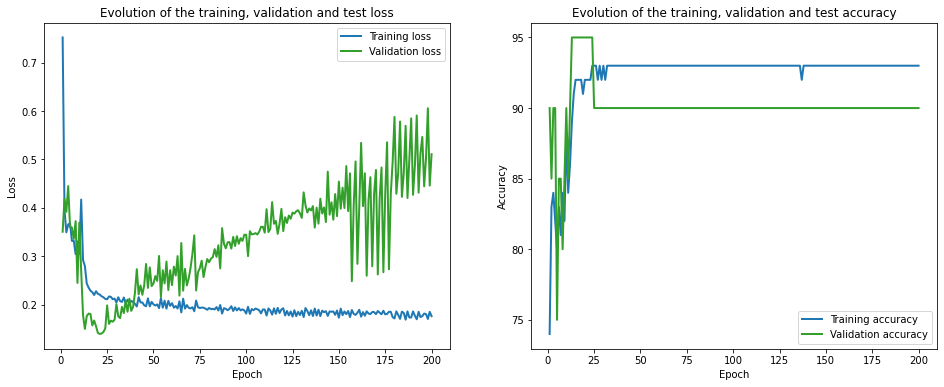

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 161.59it/s]


Initialization done!


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1241.17it/s]
C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


Finished computing p-values for 500 test points.
Training with CES data splitting...
===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.52 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 1.41 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
val_loss = 0.31 val_acc = 95.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 20% 	

Epoch 16 of 200, 50% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 60% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 70% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 80% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 90% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 100% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
val_loss = 0.15 val_acc = 95.00%
Snapshot saved at epoch 16.
Epoch 17 of 200, 10% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 20% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 30% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 40% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 50% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 60% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 70% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 80% 	

Epoch 27 of 200, 70% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 80% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 90% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 0.15 val_acc = 95.00%
Snapshot saved at epoch 27.
Epoch 28 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 20% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 40% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 50% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 60% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 70% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 80% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 90% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 100% 

Epoch 38 of 200, 40% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 50% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 60% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 70% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 80% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 90% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.24 val_acc = 90.00%
Snapshot saved at epoch 38.
Epoch 39 of 200, 10% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 39 of 200, 20% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 39 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 39 of 200, 40% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 39 of 200, 50% 	 train_loss: 0.19 train_acc: 90.00% took: 0.02s
Epoch 39 of 200, 60% 	 train_loss: 0.58 train_acc: 80.00% took: 0.00s
Epoch 39 of 200, 70% 	

Epoch 50 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 50 of 200, 20% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 50 of 200, 30% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 50 of 200, 40% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 50 of 200, 50% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 60% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 50 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 50 of 200, 80% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 90% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.27 val_acc = 90.00%
Snapshot saved at epoch 50.
Epoch 51 of 200, 10% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 51 of 200, 20% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 51 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 51 of 200, 40% 

Epoch 62 of 200, 20% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 62 of 200, 30% 	 train_loss: 0.03 train_acc: 100.00% took: 0.01s
Epoch 62 of 200, 40% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 62 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 62 of 200, 60% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 62 of 200, 70% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 62 of 200, 80% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 62 of 200, 90% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 62 of 200, 100% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
val_loss = 0.25 val_acc = 90.00%
Snapshot saved at epoch 62.
Epoch 63 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 63 of 200, 20% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 63 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 63 of 200, 40% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 63 of 200, 50% 

Epoch 73 of 200, 10% 	 train_loss: 0.04 train_acc: 100.00% took: 0.01s
Epoch 73 of 200, 20% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 73 of 200, 30% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 73 of 200, 40% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 73 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 73 of 200, 60% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 73 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 73 of 200, 80% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 73 of 200, 90% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 73 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.35 val_acc = 90.00%
Snapshot saved at epoch 73.
Epoch 74 of 200, 10% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 74 of 200, 20% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 74 of 200, 30% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 74 of 200, 40% 

Epoch 84 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 84 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 84 of 200, 60% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 84 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 84 of 200, 80% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 84 of 200, 90% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 84 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 0.29 val_acc = 90.00%
Snapshot saved at epoch 84.
Epoch 85 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 85 of 200, 20% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 85 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 85 of 200, 40% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 85 of 200, 50% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 85 of 200, 60% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 85 of 200, 70% 	

Epoch 95 of 200, 80% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 95 of 200, 90% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 95 of 200, 100% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
val_loss = 0.29 val_acc = 90.00%
Snapshot saved at epoch 95.
Epoch 96 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 96 of 200, 20% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 96 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 96 of 200, 40% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 96 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 96 of 200, 60% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 96 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 96 of 200, 80% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 96 of 200, 90% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 96 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.33 val_a

val_loss = 0.32 val_acc = 90.00%
Snapshot saved at epoch 106.
Epoch 107 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.01s
Epoch 107 of 200, 20% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 107 of 200, 30% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 107 of 200, 40% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 107 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 107 of 200, 60% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 107 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 107 of 200, 80% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 107 of 200, 90% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 107 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 0.35 val_acc = 90.00%
Snapshot saved at epoch 107.
Epoch 108 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 108 of 200, 20% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 108 of 200,

Epoch 117 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 117 of 200, 80% 	 train_loss: 0.30 train_acc: 90.00% took: 0.01s
Epoch 117 of 200, 90% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 117 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 0.35 val_acc = 90.00%
Snapshot saved at epoch 117.
Epoch 118 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 118 of 200, 20% 	 train_loss: 0.41 train_acc: 80.00% took: 0.02s
Epoch 118 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 118 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 118 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 118 of 200, 60% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 118 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.02s
Epoch 118 of 200, 80% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 118 of 200, 90% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 11

Epoch 128 of 200, 90% 	 train_loss: 0.19 train_acc: 90.00% took: 0.02s
Epoch 128 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.38 val_acc = 90.00%
Snapshot saved at epoch 128.
Epoch 129 of 200, 10% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 129 of 200, 20% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 129 of 200, 30% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 129 of 200, 40% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 129 of 200, 50% 	 train_loss: 0.17 train_acc: 80.00% took: 0.00s
Epoch 129 of 200, 60% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 129 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 129 of 200, 80% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 129 of 200, 90% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 129 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.34 val_acc = 90.00%
Snapshot saved at epoch 129.
Epoch 130 of 200

Epoch 139 of 200, 40% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 139 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 139 of 200, 60% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 139 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 139 of 200, 80% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 139 of 200, 90% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 139 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 0.32 val_acc = 90.00%
Snapshot saved at epoch 139.
Epoch 140 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 140 of 200, 20% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 140 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 140 of 200, 40% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 140 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 140 of 200, 60% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 14

Epoch 155 of 200, 50% 	 train_loss: 0.15 train_acc: 90.00% took: 0.02s
Epoch 155 of 200, 60% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 155 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 155 of 200, 80% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 155 of 200, 90% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 155 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 0.37 val_acc = 90.00%
Snapshot saved at epoch 155.
Epoch 156 of 200, 10% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 156 of 200, 20% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 156 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 156 of 200, 40% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 156 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 156 of 200, 60% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 156 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 15

Epoch 166 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 166 of 200, 40% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 166 of 200, 50% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 60% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 166 of 200, 70% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 166 of 200, 80% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 90% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 0.49 val_acc = 90.00%
Snapshot saved at epoch 166.
Epoch 167 of 200, 10% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 167 of 200, 20% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 167 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 167 of 200, 40% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 167 of 200, 50% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 1

Epoch 177 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 177 of 200, 40% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 177 of 200, 50% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 177 of 200, 60% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 177 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 177 of 200, 80% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 177 of 200, 90% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 177 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 0.41 val_acc = 90.00%
Snapshot saved at epoch 177.
Epoch 178 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 178 of 200, 20% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 178 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 178 of 200, 40% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 178 of 200, 50% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 1

Epoch 187 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.01s
val_loss = 0.43 val_acc = 90.00%
Snapshot saved at epoch 187.
Epoch 188 of 200, 10% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 188 of 200, 20% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 188 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 188 of 200, 40% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 188 of 200, 50% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 188 of 200, 60% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 188 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 188 of 200, 80% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 188 of 200, 90% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 188 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.43 val_acc = 90.00%
Snapshot saved at epoch 188.
Epoch 189 of 200, 10% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 189 of 20

Epoch 199 of 200, 50% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 199 of 200, 60% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 199 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.01s
Epoch 199 of 200, 80% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 199 of 200, 90% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 199 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.45 val_acc = 90.00%
Snapshot saved at epoch 199.
Epoch 200 of 200, 10% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 200 of 200, 20% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 200 of 200, 30% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 200 of 200, 40% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 200 of 200, 50% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 200 of 200, 60% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 200 of 200, 70% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 20

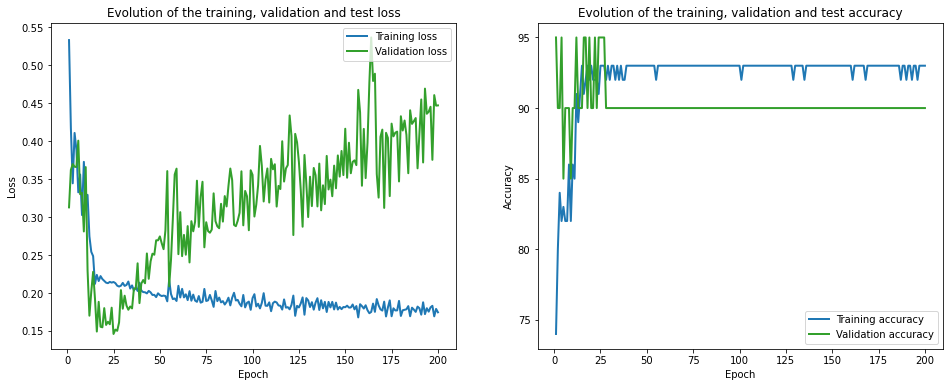

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 154.91it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1039.97it/s]

Finished computing p-values for 500 test points.

Starting repetition 36 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 1.04 train_acc: 20.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 0.00 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 5.28 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 3.10 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.63 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.82 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 1.20 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.81 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
val_loss = 0.45 val_acc = 70.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.30 train_acc: 100.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0

Epoch 17 of 200, 50% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 17 of 200, 60% 	 train_loss: 0.61 train_acc: 60.00% took: 0.00s
Epoch 17 of 200, 70% 	 train_loss: 0.75 train_acc: 70.00% took: 0.00s
Epoch 17 of 200, 80% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 17 of 200, 90% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 100% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
val_loss = 0.45 val_acc = 70.00%
Snapshot saved at epoch 17.
Epoch 18 of 200, 10% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 18 of 200, 20% 	 train_loss: 0.29 train_acc: 100.00% took: 0.00s
Epoch 18 of 200, 30% 	 train_loss: 0.86 train_acc: 50.00% took: 0.00s
Epoch 18 of 200, 40% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 18 of 200, 50% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
Epoch 18 of 200, 60% 	 train_loss: 0.75 train_acc: 60.00% took: 0.00s
Epoch 18 of 200, 70% 	 train_loss: 0.79 train_acc: 70.00% took: 0.00s
Epoch 18 of 200, 80% 	 trai

Epoch 28 of 200, 80% 	 train_loss: 0.55 train_acc: 70.00% took: 0.02s
Epoch 28 of 200, 90% 	 train_loss: 0.24 train_acc: 90.00% took: 0.01s
Epoch 28 of 200, 100% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
val_loss = 0.35 val_acc = 80.00%
Snapshot saved at epoch 28.
Epoch 29 of 200, 10% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 29 of 200, 20% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 29 of 200, 30% 	 train_loss: 0.85 train_acc: 60.00% took: 0.00s
Epoch 29 of 200, 40% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 29 of 200, 50% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 29 of 200, 60% 	 train_loss: 1.03 train_acc: 60.00% took: 0.00s
Epoch 29 of 200, 70% 	 train_loss: 0.44 train_acc: 90.00% took: 0.00s
Epoch 29 of 200, 80% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 29 of 200, 90% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 29 of 200, 100% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
val_loss = 0.33 val_acc = 

Epoch 40 of 200, 20% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 40 of 200, 30% 	 train_loss: 0.80 train_acc: 60.00% took: 0.00s
Epoch 40 of 200, 40% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 40 of 200, 50% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 40 of 200, 60% 	 train_loss: 0.99 train_acc: 60.00% took: 0.00s
Epoch 40 of 200, 70% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 40 of 200, 80% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 40 of 200, 90% 	 train_loss: 0.27 train_acc: 100.00% took: 0.00s
Epoch 40 of 200, 100% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
val_loss = 0.31 val_acc = 85.00%
Snapshot saved at epoch 40.
Epoch 41 of 200, 10% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 41 of 200, 20% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 41 of 200, 30% 	 train_loss: 0.78 train_acc: 60.00% took: 0.00s
Epoch 41 of 200, 40% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 41 of 200, 50% 	 tr

Epoch 56 of 200, 20% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 56 of 200, 30% 	 train_loss: 0.84 train_acc: 60.00% took: 0.00s
Epoch 56 of 200, 40% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 56 of 200, 50% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 56 of 200, 60% 	 train_loss: 0.97 train_acc: 60.00% took: 0.00s
Epoch 56 of 200, 70% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 56 of 200, 80% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 56 of 200, 90% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 56 of 200, 100% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
val_loss = 0.37 val_acc = 80.00%
Snapshot saved at epoch 56.
Epoch 57 of 200, 10% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 20% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 30% 	 train_loss: 0.83 train_acc: 60.00% took: 0.00s
Epoch 57 of 200, 40% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 57 of 200, 50% 	 trai

Epoch 67 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.01s
Epoch 67 of 200, 30% 	 train_loss: 0.83 train_acc: 60.00% took: 0.00s
Epoch 67 of 200, 40% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 67 of 200, 50% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 67 of 200, 60% 	 train_loss: 1.04 train_acc: 60.00% took: 0.00s
Epoch 67 of 200, 70% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 67 of 200, 80% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 67 of 200, 90% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 67 of 200, 100% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
val_loss = 0.43 val_acc = 75.00%
Snapshot saved at epoch 67.
Epoch 68 of 200, 10% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 68 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 68 of 200, 30% 	 train_loss: 0.81 train_acc: 60.00% took: 0.02s
Epoch 68 of 200, 40% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 68 of 200, 50% 	 trai

Epoch 77 of 200, 100% 	 train_loss: 0.23 train_acc: 90.00% took: 0.01s
val_loss = 0.42 val_acc = 75.00%
Snapshot saved at epoch 77.
Epoch 78 of 200, 10% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 78 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 78 of 200, 30% 	 train_loss: 0.85 train_acc: 60.00% took: 0.01s
Epoch 78 of 200, 40% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 78 of 200, 50% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 78 of 200, 60% 	 train_loss: 1.04 train_acc: 60.00% took: 0.00s
Epoch 78 of 200, 70% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 78 of 200, 80% 	 train_loss: 0.53 train_acc: 70.00% took: 0.01s
Epoch 78 of 200, 90% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 78 of 200, 100% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
val_loss = 0.41 val_acc = 75.00%
Snapshot saved at epoch 78.
Epoch 79 of 200, 10% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 79 of 200, 20% 	 train_loss: 

Epoch 93 of 200, 20% 	 train_loss: 0.31 train_acc: 90.00% took: 0.02s
Epoch 93 of 200, 30% 	 train_loss: 0.84 train_acc: 60.00% took: 0.00s
Epoch 93 of 200, 40% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 93 of 200, 50% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 93 of 200, 60% 	 train_loss: 1.02 train_acc: 60.00% took: 0.00s
Epoch 93 of 200, 70% 	 train_loss: 0.70 train_acc: 70.00% took: 0.00s
Epoch 93 of 200, 80% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 93 of 200, 90% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 93 of 200, 100% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
val_loss = 0.43 val_acc = 75.00%
Snapshot saved at epoch 93.
Epoch 94 of 200, 10% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 94 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 94 of 200, 30% 	 train_loss: 0.83 train_acc: 60.00% took: 0.00s
Epoch 94 of 200, 40% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 94 of 200, 50% 	 trai

Epoch 104 of 200, 40% 	 train_loss: 0.36 train_acc: 80.00% took: 0.01s
Epoch 104 of 200, 50% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 104 of 200, 60% 	 train_loss: 1.02 train_acc: 60.00% took: 0.00s
Epoch 104 of 200, 70% 	 train_loss: 0.71 train_acc: 70.00% took: 0.00s
Epoch 104 of 200, 80% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 104 of 200, 90% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 104 of 200, 100% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
val_loss = 0.43 val_acc = 70.00%
Snapshot saved at epoch 104.
Epoch 105 of 200, 10% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 105 of 200, 20% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 105 of 200, 30% 	 train_loss: 0.82 train_acc: 60.00% took: 0.00s
Epoch 105 of 200, 40% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 105 of 200, 50% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 105 of 200, 60% 	 train_loss: 1.03 train_acc: 60.00% took: 0.00s
Epoch 105 of 

Epoch 119 of 200, 90% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 119 of 200, 100% 	 train_loss: 0.24 train_acc: 90.00% took: 0.01s
val_loss = 0.40 val_acc = 80.00%
Snapshot saved at epoch 119.
Epoch 120 of 200, 10% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 120 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 120 of 200, 30% 	 train_loss: 0.84 train_acc: 60.00% took: 0.00s
Epoch 120 of 200, 40% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 120 of 200, 50% 	 train_loss: 0.38 train_acc: 80.00% took: 0.02s
Epoch 120 of 200, 60% 	 train_loss: 1.02 train_acc: 60.00% took: 0.00s
Epoch 120 of 200, 70% 	 train_loss: 0.66 train_acc: 70.00% took: 0.00s
Epoch 120 of 200, 80% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 120 of 200, 90% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 120 of 200, 100% 	 train_loss: 0.24 train_acc: 90.00% took: 0.02s
val_loss = 0.42 val_acc = 75.00%
Snapshot saved at epoch 120.
Epoch 121 of 200, 10

Epoch 136 of 200, 10% 	 train_loss: 0.39 train_acc: 80.00% took: 0.02s
Epoch 136 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 136 of 200, 30% 	 train_loss: 0.83 train_acc: 60.00% took: 0.00s
Epoch 136 of 200, 40% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 136 of 200, 50% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 136 of 200, 60% 	 train_loss: 1.03 train_acc: 60.00% took: 0.00s
Epoch 136 of 200, 70% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 136 of 200, 80% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 136 of 200, 90% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 136 of 200, 100% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
val_loss = 0.38 val_acc = 80.00%
Snapshot saved at epoch 136.
Epoch 137 of 200, 10% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 137 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 137 of 200, 30% 	 train_loss: 0.83 train_acc: 60.00% took: 0.00s
Epoch 137 of 

val_loss = 0.39 val_acc = 80.00%
Snapshot saved at epoch 146.
Epoch 147 of 200, 10% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 147 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 147 of 200, 30% 	 train_loss: 0.82 train_acc: 60.00% took: 0.00s
Epoch 147 of 200, 40% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 147 of 200, 50% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 147 of 200, 60% 	 train_loss: 1.00 train_acc: 60.00% took: 0.00s
Epoch 147 of 200, 70% 	 train_loss: 0.66 train_acc: 70.00% took: 0.02s
Epoch 147 of 200, 80% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 147 of 200, 90% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 147 of 200, 100% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
val_loss = 0.41 val_acc = 75.00%
Snapshot saved at epoch 147.
Epoch 148 of 200, 10% 	 train_loss: 0.35 train_acc: 80.00% took: 0.02s
Epoch 148 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 148 of 200, 30% 

Epoch 158 of 200, 40% 	 train_loss: 0.37 train_acc: 80.00% took: 0.01s
Epoch 158 of 200, 50% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 158 of 200, 60% 	 train_loss: 1.03 train_acc: 60.00% took: 0.00s
Epoch 158 of 200, 70% 	 train_loss: 0.69 train_acc: 70.00% took: 0.00s
Epoch 158 of 200, 80% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 158 of 200, 90% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 158 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
val_loss = 0.36 val_acc = 80.00%
Snapshot saved at epoch 158.
Epoch 159 of 200, 10% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 159 of 200, 20% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 159 of 200, 30% 	 train_loss: 0.82 train_acc: 60.00% took: 0.00s
Epoch 159 of 200, 40% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 159 of 200, 50% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 159 of 200, 60% 	 train_loss: 0.99 train_acc: 60.00% took: 0.00s
Epoch 159 of 

Epoch 174 of 200, 40% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 174 of 200, 50% 	 train_loss: 0.39 train_acc: 80.00% took: 0.01s
Epoch 174 of 200, 60% 	 train_loss: 1.03 train_acc: 60.00% took: 0.00s
Epoch 174 of 200, 70% 	 train_loss: 0.70 train_acc: 70.00% took: 0.00s
Epoch 174 of 200, 80% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 174 of 200, 90% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 174 of 200, 100% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
val_loss = 0.47 val_acc = 65.00%
Snapshot saved at epoch 174.
Epoch 175 of 200, 10% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 175 of 200, 20% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 175 of 200, 30% 	 train_loss: 0.83 train_acc: 60.00% took: 0.00s
Epoch 175 of 200, 40% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 175 of 200, 50% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 175 of 200, 60% 	 train_loss: 1.03 train_acc: 60.00% took: 0.00s
Epoch 175 of 

Epoch 185 of 200, 10% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 185 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 185 of 200, 30% 	 train_loss: 0.82 train_acc: 60.00% took: 0.00s
Epoch 185 of 200, 40% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 185 of 200, 50% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 185 of 200, 60% 	 train_loss: 1.01 train_acc: 60.00% took: 0.00s
Epoch 185 of 200, 70% 	 train_loss: 0.70 train_acc: 70.00% took: 0.00s
Epoch 185 of 200, 80% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 185 of 200, 90% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 185 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
val_loss = 0.39 val_acc = 75.00%
Snapshot saved at epoch 185.
Epoch 186 of 200, 10% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 186 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 186 of 200, 30% 	 train_loss: 0.82 train_acc: 60.00% took: 0.00s
Epoch 186 of 

Epoch 195 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.02s
val_loss = 0.48 val_acc = 70.00%
Snapshot saved at epoch 195.
Epoch 196 of 200, 10% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 20% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 196 of 200, 30% 	 train_loss: 0.83 train_acc: 60.00% took: 0.00s
Epoch 196 of 200, 40% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 50% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 60% 	 train_loss: 1.03 train_acc: 60.00% took: 0.00s
Epoch 196 of 200, 70% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 196 of 200, 80% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 196 of 200, 90% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 196 of 200, 100% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
val_loss = 0.43 val_acc = 70.00%
Snapshot saved at epoch 196.
Epoch 197 of 200, 10% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 197 of 200, 20%

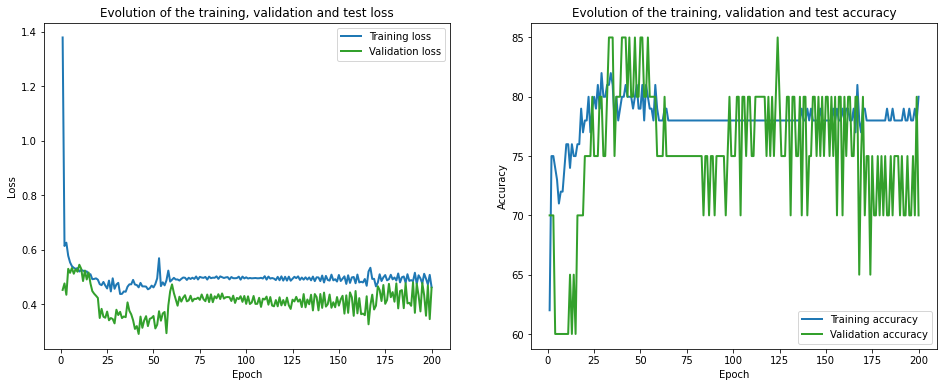

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 150.25it/s]


Initialization done!


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 934.22it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.49 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 0.00 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 3.72 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 1.11 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.58 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.88 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.82 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.60 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
val_loss = 0.47 val_acc = 65.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.32 train_acc: 100.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0

Epoch 12 of 200, 10% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 20% 	 train_loss: 0.28 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 30% 	 train_loss: 0.85 train_acc: 50.00% took: 0.00s
Epoch 12 of 200, 40% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 50% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 60% 	 train_loss: 0.80 train_acc: 50.00% took: 0.00s
Epoch 12 of 200, 70% 	 train_loss: 0.61 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 80% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 12 of 200, 90% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 100% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
val_loss = 0.35 val_acc = 80.00%
Snapshot saved at epoch 12.
Epoch 13 of 200, 10% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 13 of 200, 20% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 13 of 200, 30% 	 train_loss: 0.90 train_acc: 60.00% took: 0.00s
Epoch 13 of 200, 40% 	 tra

Epoch 23 of 200, 60% 	 train_loss: 0.63 train_acc: 60.00% took: 0.02s
Epoch 23 of 200, 70% 	 train_loss: 0.73 train_acc: 70.00% took: 0.01s
Epoch 23 of 200, 80% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 23 of 200, 90% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 23 of 200, 100% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
val_loss = 0.46 val_acc = 65.00%
Snapshot saved at epoch 23.
Epoch 24 of 200, 10% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 24 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 24 of 200, 30% 	 train_loss: 0.87 train_acc: 50.00% took: 0.00s
Epoch 24 of 200, 40% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 24 of 200, 50% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 24 of 200, 60% 	 train_loss: 0.74 train_acc: 60.00% took: 0.00s
Epoch 24 of 200, 70% 	 train_loss: 0.75 train_acc: 70.00% took: 0.00s
Epoch 24 of 200, 80% 	 train_loss: 0.56 train_acc: 70.00% took: 0.02s
Epoch 24 of 200, 90% 	 train

Epoch 34 of 200, 80% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 34 of 200, 90% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 34 of 200, 100% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
val_loss = 0.46 val_acc = 65.00%
Snapshot saved at epoch 34.
Epoch 35 of 200, 10% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 35 of 200, 20% 	 train_loss: 0.29 train_acc: 100.00% took: 0.00s
Epoch 35 of 200, 30% 	 train_loss: 0.88 train_acc: 50.00% took: 0.00s
Epoch 35 of 200, 40% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 35 of 200, 50% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 35 of 200, 60% 	 train_loss: 0.67 train_acc: 60.00% took: 0.00s
Epoch 35 of 200, 70% 	 train_loss: 0.79 train_acc: 70.00% took: 0.00s
Epoch 35 of 200, 80% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 35 of 200, 90% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 35 of 200, 100% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
val_loss = 0.47 val_acc = 

Epoch 46 of 200, 50% 	 train_loss: 0.61 train_acc: 70.00% took: 0.00s
Epoch 46 of 200, 60% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 46 of 200, 70% 	 train_loss: 0.62 train_acc: 70.00% took: 0.00s
Epoch 46 of 200, 80% 	 train_loss: 0.60 train_acc: 70.00% took: 0.00s
Epoch 46 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 46 of 200, 100% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
val_loss = 0.50 val_acc = 65.00%
Snapshot saved at epoch 46.
Epoch 47 of 200, 10% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 47 of 200, 20% 	 train_loss: 0.27 train_acc: 100.00% took: 0.00s
Epoch 47 of 200, 30% 	 train_loss: 0.86 train_acc: 60.00% took: 0.00s
Epoch 47 of 200, 40% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 47 of 200, 50% 	 train_loss: 0.56 train_acc: 60.00% took: 0.00s
Epoch 47 of 200, 60% 	 train_loss: 0.72 train_acc: 60.00% took: 0.00s
Epoch 47 of 200, 70% 	 train_loss: 0.80 train_acc: 70.00% took: 0.00s
Epoch 47 of 200, 80% 	 trai

Epoch 57 of 200, 70% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 57 of 200, 80% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 57 of 200, 90% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
val_loss = 0.34 val_acc = 85.00%
Snapshot saved at epoch 57.
Epoch 58 of 200, 10% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 20% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 58 of 200, 30% 	 train_loss: 0.89 train_acc: 60.00% took: 0.00s
Epoch 58 of 200, 40% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 58 of 200, 50% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 60% 	 train_loss: 1.09 train_acc: 60.00% took: 0.00s
Epoch 58 of 200, 70% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 58 of 200, 80% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 58 of 200, 90% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 100% 	 tra

Epoch 69 of 200, 10% 	 train_loss: 0.30 train_acc: 90.00% took: 0.01s
Epoch 69 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 69 of 200, 30% 	 train_loss: 0.84 train_acc: 60.00% took: 0.00s
Epoch 69 of 200, 40% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 69 of 200, 50% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 69 of 200, 60% 	 train_loss: 0.95 train_acc: 60.00% took: 0.00s
Epoch 69 of 200, 70% 	 train_loss: 0.74 train_acc: 70.00% took: 0.00s
Epoch 69 of 200, 80% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 69 of 200, 90% 	 train_loss: 0.25 train_acc: 100.00% took: 0.00s
Epoch 69 of 200, 100% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
val_loss = 0.36 val_acc = 80.00%
Snapshot saved at epoch 69.
Epoch 70 of 200, 10% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 70 of 200, 20% 	 train_loss: 0.26 train_acc: 90.00% took: 0.02s
Epoch 70 of 200, 30% 	 train_loss: 0.84 train_acc: 60.00% took: 0.00s
Epoch 70 of 200, 40% 	 trai

Epoch 80 of 200, 50% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 80 of 200, 60% 	 train_loss: 0.97 train_acc: 60.00% took: 0.00s
Epoch 80 of 200, 70% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 80 of 200, 80% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 80 of 200, 90% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 80 of 200, 100% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
val_loss = 0.38 val_acc = 75.00%
Snapshot saved at epoch 80.
Epoch 81 of 200, 10% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 81 of 200, 20% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 81 of 200, 30% 	 train_loss: 0.83 train_acc: 60.00% took: 0.00s
Epoch 81 of 200, 40% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 81 of 200, 50% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 81 of 200, 60% 	 train_loss: 0.93 train_acc: 60.00% took: 0.00s
Epoch 81 of 200, 70% 	 train_loss: 0.65 train_acc: 70.00% took: 0.00s
Epoch 81 of 200, 80% 	 train

Epoch 91 of 200, 50% 	 train_loss: 0.39 train_acc: 80.00% took: 0.02s
Epoch 91 of 200, 60% 	 train_loss: 1.00 train_acc: 60.00% took: 0.00s
Epoch 91 of 200, 70% 	 train_loss: 0.78 train_acc: 70.00% took: 0.01s
Epoch 91 of 200, 80% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 91 of 200, 90% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 91 of 200, 100% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
val_loss = 0.35 val_acc = 80.00%
Snapshot saved at epoch 91.
Epoch 92 of 200, 10% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 92 of 200, 20% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 92 of 200, 30% 	 train_loss: 0.82 train_acc: 60.00% took: 0.00s
Epoch 92 of 200, 40% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 92 of 200, 50% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 92 of 200, 60% 	 train_loss: 0.94 train_acc: 60.00% took: 0.00s
Epoch 92 of 200, 70% 	 train_loss: 0.61 train_acc: 70.00% took: 0.00s
Epoch 92 of 200, 80% 	 trai

Epoch 107 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 107 of 200, 30% 	 train_loss: 0.82 train_acc: 60.00% took: 0.00s
Epoch 107 of 200, 40% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 107 of 200, 50% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 107 of 200, 60% 	 train_loss: 0.98 train_acc: 60.00% took: 0.00s
Epoch 107 of 200, 70% 	 train_loss: 0.68 train_acc: 70.00% took: 0.00s
Epoch 107 of 200, 80% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 107 of 200, 90% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 107 of 200, 100% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
val_loss = 0.48 val_acc = 70.00%
Snapshot saved at epoch 107.
Epoch 108 of 200, 10% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 108 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 108 of 200, 30% 	 train_loss: 0.82 train_acc: 60.00% took: 0.00s
Epoch 108 of 200, 40% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 108 of 

Epoch 123 of 200, 40% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 123 of 200, 50% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 123 of 200, 60% 	 train_loss: 0.97 train_acc: 60.00% took: 0.00s
Epoch 123 of 200, 70% 	 train_loss: 0.62 train_acc: 70.00% took: 0.00s
Epoch 123 of 200, 80% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 123 of 200, 90% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 123 of 200, 100% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
val_loss = 0.49 val_acc = 70.00%
Snapshot saved at epoch 123.
Epoch 124 of 200, 10% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 124 of 200, 20% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 124 of 200, 30% 	 train_loss: 0.82 train_acc: 60.00% took: 0.00s
Epoch 124 of 200, 40% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 124 of 200, 50% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 124 of 200, 60% 	 train_loss: 1.02 train_acc: 60.00% took: 0.00s
Epoch 124 of 

Epoch 138 of 200, 90% 	 train_loss: 0.24 train_acc: 100.00% took: 0.02s
Epoch 138 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
val_loss = 0.47 val_acc = 70.00%
Snapshot saved at epoch 138.
Epoch 139 of 200, 10% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 139 of 200, 20% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 139 of 200, 30% 	 train_loss: 0.83 train_acc: 60.00% took: 0.00s
Epoch 139 of 200, 40% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 139 of 200, 50% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 139 of 200, 60% 	 train_loss: 1.02 train_acc: 60.00% took: 0.00s
Epoch 139 of 200, 70% 	 train_loss: 0.74 train_acc: 70.00% took: 0.00s
Epoch 139 of 200, 80% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 139 of 200, 90% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 139 of 200, 100% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
val_loss = 0.37 val_acc = 75.00%
Snapshot saved at epoch 139.
Epoch 140 of 200, 10

Epoch 149 of 200, 90% 	 train_loss: 0.24 train_acc: 100.00% took: 0.02s
Epoch 149 of 200, 100% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
val_loss = 0.35 val_acc = 80.00%
Snapshot saved at epoch 149.
Epoch 150 of 200, 10% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 30% 	 train_loss: 0.82 train_acc: 60.00% took: 0.00s
Epoch 150 of 200, 40% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 150 of 200, 50% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 150 of 200, 60% 	 train_loss: 0.97 train_acc: 60.00% took: 0.00s
Epoch 150 of 200, 70% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 150 of 200, 80% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 150 of 200, 90% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 150 of 200, 100% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
val_loss = 0.43 val_acc = 70.00%
Snapshot saved at epoch 150.
Epoch 151 of 200, 10

Epoch 160 of 200, 50% 	 train_loss: 0.41 train_acc: 80.00% took: 0.01s
Epoch 160 of 200, 60% 	 train_loss: 0.87 train_acc: 60.00% took: 0.00s
Epoch 160 of 200, 70% 	 train_loss: 0.66 train_acc: 70.00% took: 0.00s
Epoch 160 of 200, 80% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 160 of 200, 90% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 160 of 200, 100% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
val_loss = 0.38 val_acc = 80.00%
Snapshot saved at epoch 160.
Epoch 161 of 200, 10% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 161 of 200, 20% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 161 of 200, 30% 	 train_loss: 0.84 train_acc: 60.00% took: 0.00s
Epoch 161 of 200, 40% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 161 of 200, 50% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 161 of 200, 60% 	 train_loss: 0.91 train_acc: 60.00% took: 0.00s
Epoch 161 of 200, 70% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 161 of 2

Epoch 171 of 200, 80% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 171 of 200, 90% 	 train_loss: 0.25 train_acc: 100.00% took: 0.00s
Epoch 171 of 200, 100% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
val_loss = 0.46 val_acc = 75.00%
Snapshot saved at epoch 171.
Epoch 172 of 200, 10% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 172 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 172 of 200, 30% 	 train_loss: 0.86 train_acc: 60.00% took: 0.00s
Epoch 172 of 200, 40% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 172 of 200, 50% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 172 of 200, 60% 	 train_loss: 1.03 train_acc: 60.00% took: 0.00s
Epoch 172 of 200, 70% 	 train_loss: 0.74 train_acc: 70.00% took: 0.00s
Epoch 172 of 200, 80% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 172 of 200, 90% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 172 of 200, 100% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
val_loss = 

Epoch 182 of 200, 50% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 182 of 200, 60% 	 train_loss: 1.00 train_acc: 60.00% took: 0.00s
Epoch 182 of 200, 70% 	 train_loss: 0.73 train_acc: 70.00% took: 0.00s
Epoch 182 of 200, 80% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 182 of 200, 90% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 182 of 200, 100% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
val_loss = 0.44 val_acc = 70.00%
Snapshot saved at epoch 182.
Epoch 183 of 200, 10% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 183 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 183 of 200, 30% 	 train_loss: 0.82 train_acc: 60.00% took: 0.00s
Epoch 183 of 200, 40% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 183 of 200, 50% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 183 of 200, 60% 	 train_loss: 0.99 train_acc: 60.00% took: 0.00s
Epoch 183 of 200, 70% 	 train_loss: 0.71 train_acc: 70.00% took: 0.00s
Epoch 183 of 

Epoch 193 of 200, 80% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 193 of 200, 90% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 193 of 200, 100% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
val_loss = 0.47 val_acc = 65.00%
Snapshot saved at epoch 193.
Epoch 194 of 200, 10% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 194 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 194 of 200, 30% 	 train_loss: 0.82 train_acc: 60.00% took: 0.00s
Epoch 194 of 200, 40% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 194 of 200, 50% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 194 of 200, 60% 	 train_loss: 0.99 train_acc: 60.00% took: 0.00s
Epoch 194 of 200, 70% 	 train_loss: 0.71 train_acc: 70.00% took: 0.00s
Epoch 194 of 200, 80% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 194 of 200, 90% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 194 of 200, 100% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
val_loss = 

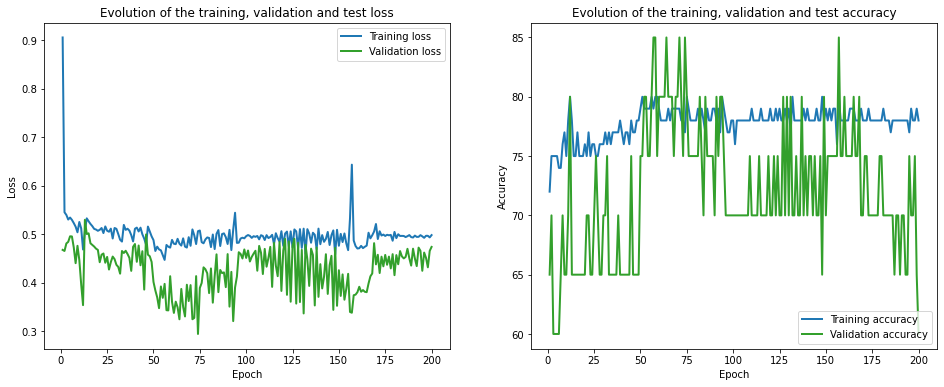

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 155.67it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1294.60it/s]

Finished computing p-values for 500 test points.

Starting repetition 37 of 50:




C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


Training with standard data splitting...
===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 1.89 train_acc: 30.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 1.06 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 3.47 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 1.35 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 1.36 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 1.07 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.81 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 2.00 train_acc: 80.00% took: 0.00s
val_loss = 0.23 val_acc = 90.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 1.80 train_acc: 40.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.00 train_acc: 100.00% took: 

Epoch 12 of 200, 50% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 60% 	 train_loss: 0.25 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 70% 	 train_loss: 0.56 train_acc: 60.00% took: 0.00s
Epoch 12 of 200, 80% 	 train_loss: 1.18 train_acc: 70.00% took: 0.00s
Epoch 12 of 200, 90% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 100% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
val_loss = 0.44 val_acc = 65.00%
Snapshot saved at epoch 12.
Epoch 13 of 200, 10% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
Epoch 13 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 13 of 200, 30% 	 train_loss: 0.37 train_acc: 70.00% took: 0.00s
Epoch 13 of 200, 40% 	 train_loss: 0.61 train_acc: 50.00% took: 0.00s
Epoch 13 of 200, 50% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 13 of 200, 60% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 13 of 200, 70% 	 train_loss: 0.40 train_acc: 60.00% took: 0.00s
Epoch 13 of 200, 80% 	 tra

Epoch 23 of 200, 60% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 23 of 200, 70% 	 train_loss: 0.31 train_acc: 70.00% took: 0.00s
Epoch 23 of 200, 80% 	 train_loss: 0.75 train_acc: 70.00% took: 0.00s
Epoch 23 of 200, 90% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 23 of 200, 100% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
val_loss = 0.32 val_acc = 85.00%
Snapshot saved at epoch 23.
Epoch 24 of 200, 10% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 24 of 200, 20% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 24 of 200, 30% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 24 of 200, 40% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 24 of 200, 50% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 24 of 200, 60% 	 train_loss: 0.25 train_acc: 80.00% took: 0.02s
Epoch 24 of 200, 70% 	 train_loss: 0.40 train_acc: 70.00% took: 0.00s
Epoch 24 of 200, 80% 	 train_loss: 0.89 train_acc: 70.00% took: 0.00s
Epoch 24 of 200, 90% 	 trai

Epoch 34 of 200, 40% 	 train_loss: 0.51 train_acc: 70.00% took: 0.02s
Epoch 34 of 200, 50% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 34 of 200, 60% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 34 of 200, 70% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 34 of 200, 80% 	 train_loss: 0.81 train_acc: 70.00% took: 0.00s
Epoch 34 of 200, 90% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 34 of 200, 100% 	 train_loss: 0.36 train_acc: 70.00% took: 0.00s
val_loss = 0.32 val_acc = 80.00%
Snapshot saved at epoch 34.
Epoch 35 of 200, 10% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 35 of 200, 20% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 35 of 200, 30% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 35 of 200, 40% 	 train_loss: 0.32 train_acc: 100.00% took: 0.00s
Epoch 35 of 200, 50% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 35 of 200, 60% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 35 of 200, 70% 	 tra

Epoch 45 of 200, 70% 	 train_loss: 0.34 train_acc: 70.00% took: 0.01s
Epoch 45 of 200, 80% 	 train_loss: 0.73 train_acc: 70.00% took: 0.00s
Epoch 45 of 200, 90% 	 train_loss: 0.33 train_acc: 90.00% took: 0.01s
Epoch 45 of 200, 100% 	 train_loss: 0.31 train_acc: 100.00% took: 0.00s
val_loss = 0.39 val_acc = 85.00%
Snapshot saved at epoch 45.
Epoch 46 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 46 of 200, 20% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 46 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 46 of 200, 40% 	 train_loss: 0.50 train_acc: 80.00% took: 0.02s
Epoch 46 of 200, 50% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 46 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 46 of 200, 70% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 46 of 200, 80% 	 train_loss: 0.78 train_acc: 70.00% took: 0.02s
Epoch 46 of 200, 90% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 46 of 200, 100% 	 tr

Epoch 60 of 200, 80% 	 train_loss: 0.63 train_acc: 70.00% took: 0.02s
Epoch 60 of 200, 90% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 60 of 200, 100% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
val_loss = 0.47 val_acc = 90.00%
Snapshot saved at epoch 60.
Epoch 61 of 200, 10% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 61 of 200, 20% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 61 of 200, 30% 	 train_loss: 0.19 train_acc: 80.00% took: 0.00s
Epoch 61 of 200, 40% 	 train_loss: 0.30 train_acc: 100.00% took: 0.00s
Epoch 61 of 200, 50% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 61 of 200, 60% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 61 of 200, 70% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 61 of 200, 80% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 61 of 200, 90% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 61 of 200, 100% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
val_loss = 0.60 val_acc =

Epoch 72 of 200, 60% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 72 of 200, 70% 	 train_loss: 0.50 train_acc: 70.00% took: 0.01s
Epoch 72 of 200, 80% 	 train_loss: 0.59 train_acc: 60.00% took: 0.00s
Epoch 72 of 200, 90% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 72 of 200, 100% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
val_loss = 1.39 val_acc = 85.00%
Snapshot saved at epoch 72.
Epoch 73 of 200, 10% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 73 of 200, 20% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 73 of 200, 30% 	 train_loss: 0.18 train_acc: 80.00% took: 0.00s
Epoch 73 of 200, 40% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 73 of 200, 50% 	 train_loss: 0.38 train_acc: 70.00% took: 0.00s
Epoch 73 of 200, 60% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 73 of 200, 70% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 73 of 200, 80% 	 train_loss: 0.61 train_acc: 60.00% took: 0.00s
Epoch 73 of 200, 90% 	 tra

Epoch 83 of 200, 70% 	 train_loss: 0.19 train_acc: 80.00% took: 0.02s
Epoch 83 of 200, 80% 	 train_loss: 0.46 train_acc: 60.00% took: 0.00s
Epoch 83 of 200, 90% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 83 of 200, 100% 	 train_loss: 0.34 train_acc: 70.00% took: 0.00s
val_loss = 0.85 val_acc = 85.00%
Snapshot saved at epoch 83.
Epoch 84 of 200, 10% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 84 of 200, 20% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 84 of 200, 30% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 84 of 200, 40% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 84 of 200, 50% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 84 of 200, 60% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 84 of 200, 70% 	 train_loss: 0.19 train_acc: 80.00% took: 0.00s
Epoch 84 of 200, 80% 	 train_loss: 0.49 train_acc: 60.00% took: 0.00s
Epoch 84 of 200, 90% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 84 of 200, 100% 	 tra

Epoch 95 of 200, 30% 	 train_loss: 0.19 train_acc: 80.00% took: 0.00s
Epoch 95 of 200, 40% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
Epoch 95 of 200, 50% 	 train_loss: 0.40 train_acc: 70.00% took: 0.00s
Epoch 95 of 200, 60% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 95 of 200, 70% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 95 of 200, 80% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 95 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 95 of 200, 100% 	 train_loss: 0.36 train_acc: 70.00% took: 0.00s
val_loss = 1.25 val_acc = 70.00%
Snapshot saved at epoch 95.
Epoch 96 of 200, 10% 	 train_loss: 0.07 train_acc: 90.00% took: 0.00s
Epoch 96 of 200, 20% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 96 of 200, 30% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 96 of 200, 40% 	 train_loss: 0.38 train_acc: 60.00% took: 0.00s
Epoch 96 of 200, 50% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 96 of 200, 60% 	 trai

Epoch 106 of 200, 10% 	 train_loss: 0.07 train_acc: 90.00% took: 0.00s
Epoch 106 of 200, 20% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 106 of 200, 30% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 106 of 200, 40% 	 train_loss: 0.27 train_acc: 70.00% took: 0.00s
Epoch 106 of 200, 50% 	 train_loss: 0.35 train_acc: 70.00% took: 0.00s
Epoch 106 of 200, 60% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 106 of 200, 70% 	 train_loss: 0.15 train_acc: 80.00% took: 0.00s
Epoch 106 of 200, 80% 	 train_loss: 0.52 train_acc: 70.00% took: 0.00s
Epoch 106 of 200, 90% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 106 of 200, 100% 	 train_loss: 0.35 train_acc: 70.00% took: 0.00s
val_loss = 0.95 val_acc = 75.00%
Snapshot saved at epoch 106.
Epoch 107 of 200, 10% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 107 of 200, 20% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 107 of 200, 30% 	 train_loss: 0.69 train_acc: 80.00% took: 0.00s
Epoch 107 of 

Epoch 116 of 200, 100% 	 train_loss: 0.34 train_acc: 70.00% took: 0.00s
val_loss = 1.68 val_acc = 70.00%
Snapshot saved at epoch 116.
Epoch 117 of 200, 10% 	 train_loss: 0.07 train_acc: 90.00% took: 0.00s
Epoch 117 of 200, 20% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 117 of 200, 30% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 117 of 200, 40% 	 train_loss: 0.32 train_acc: 100.00% took: 0.00s
Epoch 117 of 200, 50% 	 train_loss: 0.38 train_acc: 70.00% took: 0.00s
Epoch 117 of 200, 60% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 117 of 200, 70% 	 train_loss: 0.16 train_acc: 80.00% took: 0.00s
Epoch 117 of 200, 80% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 117 of 200, 90% 	 train_loss: 0.35 train_acc: 70.00% took: 0.00s
Epoch 117 of 200, 100% 	 train_loss: 0.36 train_acc: 70.00% took: 0.00s
val_loss = 0.88 val_acc = 75.00%
Snapshot saved at epoch 117.
Epoch 118 of 200, 10% 	 train_loss: 0.21 train_acc: 80.00% took: 0.01s
Epoch 118 of 200, 20%

Epoch 130 of 200, 80% 	 train_loss: 0.37 train_acc: 60.00% took: 0.00s
Epoch 130 of 200, 90% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 130 of 200, 100% 	 train_loss: 0.35 train_acc: 70.00% took: 0.00s
val_loss = 1.94 val_acc = 70.00%
Snapshot saved at epoch 130.
Epoch 131 of 200, 10% 	 train_loss: 0.07 train_acc: 90.00% took: 0.00s
Epoch 131 of 200, 20% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 131 of 200, 30% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 131 of 200, 40% 	 train_loss: 0.31 train_acc: 70.00% took: 0.00s
Epoch 131 of 200, 50% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 131 of 200, 60% 	 train_loss: 0.25 train_acc: 70.00% took: 0.00s
Epoch 131 of 200, 70% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 131 of 200, 80% 	 train_loss: 0.36 train_acc: 70.00% took: 0.00s
Epoch 131 of 200, 90% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 131 of 200, 100% 	 train_loss: 0.34 train_acc: 70.00% took: 0.00s
val_loss = 1

Epoch 142 of 200, 40% 	 train_loss: 0.30 train_acc: 70.00% took: 0.00s
Epoch 142 of 200, 50% 	 train_loss: 0.41 train_acc: 60.00% took: 0.00s
Epoch 142 of 200, 60% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 142 of 200, 70% 	 train_loss: 0.15 train_acc: 80.00% took: 0.00s
Epoch 142 of 200, 80% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 142 of 200, 90% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 142 of 200, 100% 	 train_loss: 0.34 train_acc: 70.00% took: 0.00s
val_loss = 2.08 val_acc = 70.00%
Snapshot saved at epoch 142.
Epoch 143 of 200, 10% 	 train_loss: 0.07 train_acc: 90.00% took: 0.00s
Epoch 143 of 200, 20% 	 train_loss: 0.18 train_acc: 80.00% took: 0.00s
Epoch 143 of 200, 30% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 143 of 200, 40% 	 train_loss: 0.28 train_acc: 70.00% took: 0.00s
Epoch 143 of 200, 50% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 143 of 200, 60% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 143 of 2

Epoch 158 of 200, 30% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 158 of 200, 40% 	 train_loss: 0.24 train_acc: 70.00% took: 0.00s
Epoch 158 of 200, 50% 	 train_loss: 0.40 train_acc: 60.00% took: 0.00s
Epoch 158 of 200, 60% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 158 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 158 of 200, 80% 	 train_loss: 0.34 train_acc: 70.00% took: 0.00s
Epoch 158 of 200, 90% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 158 of 200, 100% 	 train_loss: 0.36 train_acc: 70.00% took: 0.00s
val_loss = 2.55 val_acc = 70.00%
Snapshot saved at epoch 158.
Epoch 159 of 200, 10% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 159 of 200, 20% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 159 of 200, 30% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 159 of 200, 40% 	 train_loss: 0.25 train_acc: 70.00% took: 0.00s
Epoch 159 of 200, 50% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 159 of

Epoch 173 of 200, 100% 	 train_loss: 0.35 train_acc: 70.00% took: 0.00s
val_loss = 1.85 val_acc = 70.00%
Snapshot saved at epoch 173.
Epoch 174 of 200, 10% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 20% 	 train_loss: 0.18 train_acc: 80.00% took: 0.00s
Epoch 174 of 200, 30% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 40% 	 train_loss: 0.28 train_acc: 70.00% took: 0.00s
Epoch 174 of 200, 50% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 174 of 200, 60% 	 train_loss: 0.07 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 70% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 174 of 200, 80% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 174 of 200, 90% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 100% 	 train_loss: 0.35 train_acc: 70.00% took: 0.00s
val_loss = 2.98 val_acc = 70.00%
Snapshot saved at epoch 174.
Epoch 175 of 200, 10% 	 train_loss: 0.07 train_acc: 90.00% took: 0.00s
Epoch 175 of 200, 20%

Epoch 185 of 200, 20% 	 train_loss: 0.12 train_acc: 90.00% took: 0.02s
Epoch 185 of 200, 30% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 185 of 200, 40% 	 train_loss: 0.28 train_acc: 70.00% took: 0.00s
Epoch 185 of 200, 50% 	 train_loss: 0.37 train_acc: 70.00% took: 0.00s
Epoch 185 of 200, 60% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 185 of 200, 70% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 185 of 200, 80% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 185 of 200, 90% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 185 of 200, 100% 	 train_loss: 0.37 train_acc: 70.00% took: 0.00s
val_loss = 1.64 val_acc = 65.00%
Snapshot saved at epoch 185.
Epoch 186 of 200, 10% 	 train_loss: 0.07 train_acc: 90.00% took: 0.00s
Epoch 186 of 200, 20% 	 train_loss: 0.18 train_acc: 80.00% took: 0.00s
Epoch 186 of 200, 30% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 186 of 200, 40% 	 train_loss: 0.38 train_acc: 60.00% took: 0.00s
Epoch 186 of 2

Epoch 196 of 200, 10% 	 train_loss: 0.07 train_acc: 100.00% took: 0.02s
Epoch 196 of 200, 20% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 30% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 196 of 200, 40% 	 train_loss: 0.37 train_acc: 60.00% took: 0.00s
Epoch 196 of 200, 50% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 60% 	 train_loss: 0.17 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 70% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 80% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 90% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 100% 	 train_loss: 0.36 train_acc: 70.00% took: 0.00s
val_loss = 1.60 val_acc = 65.00%
Snapshot saved at epoch 196.
Epoch 197 of 200, 10% 	 train_loss: 0.07 train_acc: 90.00% took: 0.00s
Epoch 197 of 200, 20% 	 train_loss: 0.17 train_acc: 80.00% took: 0.00s
Epoch 197 of 200, 30% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 197 of 

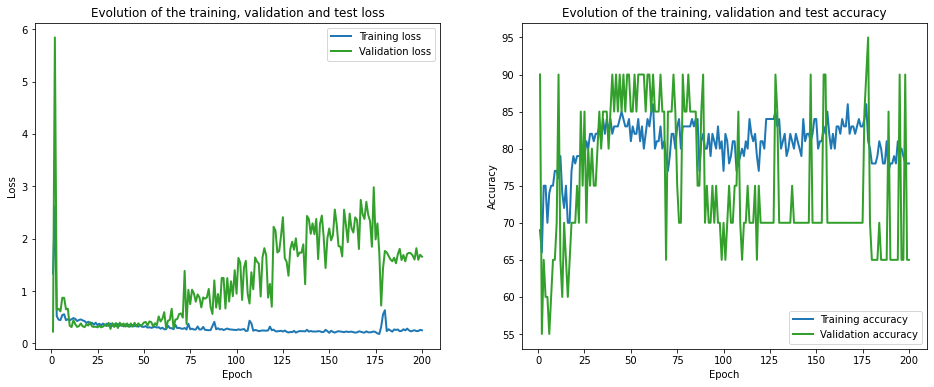

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 160.23it/s]


Initialization done!


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1276.44it/s]
C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


Finished computing p-values for 500 test points.
Training with CES data splitting...
===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 1.06 train_acc: 20.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 0.52 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 4.36 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.93 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 1.16 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 1.65 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 1.08 train_acc: 20.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 1.06 train_acc: 70.00% took: 0.00s
val_loss = 0.15 val_acc = 100.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.90 train_acc: 40.00% took: 0.00s
Epoch 2 of 200, 20%

Epoch 16 of 200, 20% 	 train_loss: 0.17 train_acc: 100.00% took: 0.01s
Epoch 16 of 200, 30% 	 train_loss: 0.27 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 40% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 50% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 60% 	 train_loss: 0.30 train_acc: 80.00% took: 0.02s
Epoch 16 of 200, 70% 	 train_loss: 0.29 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 80% 	 train_loss: 0.80 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 90% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 100% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
val_loss = 0.33 val_acc = 85.00%
Snapshot saved at epoch 16.
Epoch 17 of 200, 10% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 20% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 30% 	 train_loss: 0.25 train_acc: 70.00% took: 0.00s
Epoch 17 of 200, 40% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 17 of 200, 50% 	 tra

Epoch 31 of 200, 100% 	 train_loss: 0.38 train_acc: 60.00% took: 0.00s
val_loss = 0.30 val_acc = 90.00%
Snapshot saved at epoch 31.
Epoch 32 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 32 of 200, 20% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 32 of 200, 30% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 32 of 200, 40% 	 train_loss: 0.33 train_acc: 100.00% took: 0.00s
Epoch 32 of 200, 50% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 32 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 32 of 200, 70% 	 train_loss: 0.33 train_acc: 70.00% took: 0.00s
Epoch 32 of 200, 80% 	 train_loss: 0.73 train_acc: 70.00% took: 0.00s
Epoch 32 of 200, 90% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 32 of 200, 100% 	 train_loss: 0.35 train_acc: 70.00% took: 0.00s
val_loss = 0.34 val_acc = 85.00%
Snapshot saved at epoch 32.
Epoch 33 of 200, 10% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 33 of 200, 20% 	 train_loss: 

Epoch 47 of 200, 50% 	 train_loss: 0.48 train_acc: 70.00% took: 0.02s
Epoch 47 of 200, 60% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 47 of 200, 70% 	 train_loss: 0.37 train_acc: 70.00% took: 0.01s
Epoch 47 of 200, 80% 	 train_loss: 0.64 train_acc: 70.00% took: 0.00s
Epoch 47 of 200, 90% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 47 of 200, 100% 	 train_loss: 0.29 train_acc: 100.00% took: 0.00s
val_loss = 0.42 val_acc = 85.00%
Snapshot saved at epoch 47.
Epoch 48 of 200, 10% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 48 of 200, 20% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 48 of 200, 30% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 48 of 200, 40% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 48 of 200, 50% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 48 of 200, 60% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 48 of 200, 70% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 48 of 200, 80% 	 tra

Epoch 63 of 200, 10% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 63 of 200, 20% 	 train_loss: 0.13 train_acc: 90.00% took: 0.01s
Epoch 63 of 200, 30% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 63 of 200, 40% 	 train_loss: 0.31 train_acc: 100.00% took: 0.00s
Epoch 63 of 200, 50% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 63 of 200, 60% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 63 of 200, 70% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 63 of 200, 80% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 63 of 200, 90% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 63 of 200, 100% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
val_loss = 0.62 val_acc = 85.00%
Snapshot saved at epoch 63.
Epoch 64 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 64 of 200, 20% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 64 of 200, 30% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 64 of 200, 40% 	 tra

Epoch 74 of 200, 40% 	 train_loss: 0.31 train_acc: 100.00% took: 0.01s
Epoch 74 of 200, 50% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 74 of 200, 60% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 74 of 200, 70% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 74 of 200, 80% 	 train_loss: 0.53 train_acc: 60.00% took: 0.00s
Epoch 74 of 200, 90% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 74 of 200, 100% 	 train_loss: 0.35 train_acc: 70.00% took: 0.00s
val_loss = 0.40 val_acc = 75.00%
Snapshot saved at epoch 74.
Epoch 75 of 200, 10% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 75 of 200, 20% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 75 of 200, 30% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 75 of 200, 40% 	 train_loss: 0.31 train_acc: 70.00% took: 0.00s
Epoch 75 of 200, 50% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 75 of 200, 60% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 75 of 200, 70% 	 tra

Epoch 85 of 200, 10% 	 train_loss: 0.44 train_acc: 80.00% took: 0.02s
Epoch 85 of 200, 20% 	 train_loss: 0.16 train_acc: 100.00% took: 0.01s
Epoch 85 of 200, 30% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 85 of 200, 40% 	 train_loss: 0.36 train_acc: 70.00% took: 0.00s
Epoch 85 of 200, 50% 	 train_loss: 0.42 train_acc: 60.00% took: 0.00s
Epoch 85 of 200, 60% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 85 of 200, 70% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 85 of 200, 80% 	 train_loss: 0.56 train_acc: 60.00% took: 0.00s
Epoch 85 of 200, 90% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 85 of 200, 100% 	 train_loss: 0.36 train_acc: 70.00% took: 0.00s
val_loss = 1.08 val_acc = 70.00%
Snapshot saved at epoch 85.
Epoch 86 of 200, 10% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 86 of 200, 20% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 86 of 200, 30% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 86 of 200, 40% 	 trai

Epoch 100 of 200, 50% 	 train_loss: 0.44 train_acc: 70.00% took: 0.02s
Epoch 100 of 200, 60% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 70% 	 train_loss: 0.17 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 80% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 100 of 200, 90% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 100% 	 train_loss: 0.35 train_acc: 70.00% took: 0.00s
val_loss = 1.64 val_acc = 70.00%
Snapshot saved at epoch 100.
Epoch 101 of 200, 10% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 20% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 101 of 200, 30% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 40% 	 train_loss: 0.47 train_acc: 60.00% took: 0.00s
Epoch 101 of 200, 50% 	 train_loss: 0.69 train_acc: 70.00% took: 0.00s
Epoch 101 of 200, 60% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 70% 	 train_loss: 0.16 train_acc: 80.00% took: 0.00s
Epoch 101 of 

Epoch 111 of 200, 70% 	 train_loss: 0.16 train_acc: 100.00% took: 0.02s
Epoch 111 of 200, 80% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 111 of 200, 90% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 100% 	 train_loss: 0.38 train_acc: 70.00% took: 0.00s
val_loss = 1.16 val_acc = 70.00%
Snapshot saved at epoch 111.
Epoch 112 of 200, 10% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 112 of 200, 20% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 112 of 200, 30% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 112 of 200, 40% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 112 of 200, 50% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 112 of 200, 60% 	 train_loss: 0.22 train_acc: 70.00% took: 0.00s
Epoch 112 of 200, 70% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 112 of 200, 80% 	 train_loss: 0.33 train_acc: 70.00% took: 0.00s
Epoch 112 of 200, 90% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 112 o

Epoch 122 of 200, 80% 	 train_loss: 0.54 train_acc: 70.00% took: 0.02s
Epoch 122 of 200, 90% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 122 of 200, 100% 	 train_loss: 0.37 train_acc: 70.00% took: 0.00s
val_loss = 1.10 val_acc = 65.00%
Snapshot saved at epoch 122.
Epoch 123 of 200, 10% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 123 of 200, 20% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 123 of 200, 30% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 123 of 200, 40% 	 train_loss: 0.42 train_acc: 60.00% took: 0.00s
Epoch 123 of 200, 50% 	 train_loss: 0.35 train_acc: 70.00% took: 0.00s
Epoch 123 of 200, 60% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 123 of 200, 70% 	 train_loss: 0.21 train_acc: 70.00% took: 0.00s
Epoch 123 of 200, 80% 	 train_loss: 0.40 train_acc: 70.00% took: 0.00s
Epoch 123 of 200, 90% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 123 of 200, 100% 	 train_loss: 0.37 train_acc: 70.00% took: 0.00s
val_loss = 1

Epoch 135 of 200, 10% 	 train_loss: 0.09 train_acc: 90.00% took: 0.02s
Epoch 135 of 200, 20% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 135 of 200, 30% 	 train_loss: 0.10 train_acc: 90.00% took: 0.01s
Epoch 135 of 200, 40% 	 train_loss: 0.31 train_acc: 70.00% took: 0.00s
Epoch 135 of 200, 50% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 135 of 200, 60% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 135 of 200, 70% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 135 of 200, 80% 	 train_loss: 0.38 train_acc: 70.00% took: 0.00s
Epoch 135 of 200, 90% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 135 of 200, 100% 	 train_loss: 0.38 train_acc: 70.00% took: 0.00s
val_loss = 1.91 val_acc = 70.00%
Snapshot saved at epoch 135.
Epoch 136 of 200, 10% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 136 of 200, 20% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 136 of 200, 30% 	 train_loss: 0.10 train_acc: 90.00% took: 0.02s
Epoch 136 o

Epoch 146 of 200, 30% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 146 of 200, 40% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 146 of 200, 50% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 146 of 200, 60% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 146 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 146 of 200, 80% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 146 of 200, 90% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 146 of 200, 100% 	 train_loss: 0.36 train_acc: 70.00% took: 0.00s
val_loss = 0.92 val_acc = 70.00%
Snapshot saved at epoch 146.
Epoch 147 of 200, 10% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 147 of 200, 20% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 147 of 200, 30% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 147 of 200, 40% 	 train_loss: 0.30 train_acc: 70.00% took: 0.00s
Epoch 147 of 200, 50% 	 train_loss: 0.34 train_acc: 70.00% took: 0.00s
Epoch 147 of

Epoch 158 of 200, 70% 	 train_loss: 0.15 train_acc: 80.00% took: 0.02s
Epoch 158 of 200, 80% 	 train_loss: 0.36 train_acc: 70.00% took: 0.00s
Epoch 158 of 200, 90% 	 train_loss: 0.14 train_acc: 90.00% took: 0.01s
Epoch 158 of 200, 100% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
val_loss = 1.76 val_acc = 90.00%
Snapshot saved at epoch 158.
Epoch 159 of 200, 10% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 159 of 200, 20% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 159 of 200, 30% 	 train_loss: 0.08 train_acc: 90.00% took: 0.01s
Epoch 159 of 200, 40% 	 train_loss: 0.27 train_acc: 70.00% took: 0.00s
Epoch 159 of 200, 50% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 159 of 200, 60% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 159 of 200, 70% 	 train_loss: 0.16 train_acc: 80.00% took: 0.00s
Epoch 159 of 200, 80% 	 train_loss: 0.44 train_acc: 70.00% took: 0.02s
Epoch 159 of 200, 90% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 159 of 

Epoch 174 of 200, 20% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 30% 	 train_loss: 0.08 train_acc: 90.00% took: 0.01s
Epoch 174 of 200, 40% 	 train_loss: 0.23 train_acc: 70.00% took: 0.00s
Epoch 174 of 200, 50% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
Epoch 174 of 200, 60% 	 train_loss: 0.26 train_acc: 70.00% took: 0.00s
Epoch 174 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 174 of 200, 80% 	 train_loss: 0.34 train_acc: 70.00% took: 0.02s
Epoch 174 of 200, 90% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 100% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
val_loss = 1.46 val_acc = 75.00%
Snapshot saved at epoch 174.
Epoch 175 of 200, 10% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 175 of 200, 20% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 175 of 200, 30% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 175 of 200, 40% 	 train_loss: 0.29 train_acc: 70.00% took: 0.00s
Epoch 175 of

Epoch 185 of 200, 40% 	 train_loss: 0.26 train_acc: 70.00% took: 0.00s
Epoch 185 of 200, 50% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 185 of 200, 60% 	 train_loss: 0.07 train_acc: 90.00% took: 0.00s
Epoch 185 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 185 of 200, 80% 	 train_loss: 0.74 train_acc: 70.00% took: 0.00s
Epoch 185 of 200, 90% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 185 of 200, 100% 	 train_loss: 0.40 train_acc: 70.00% took: 0.00s
val_loss = 1.87 val_acc = 70.00%
Snapshot saved at epoch 185.
Epoch 186 of 200, 10% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 186 of 200, 20% 	 train_loss: 0.25 train_acc: 100.00% took: 0.00s
Epoch 186 of 200, 30% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 186 of 200, 40% 	 train_loss: 0.36 train_acc: 70.00% took: 0.00s
Epoch 186 of 200, 50% 	 train_loss: 0.36 train_acc: 70.00% took: 0.00s
Epoch 186 of 200, 60% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 186 o

Epoch 196 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 196 of 200, 20% 	 train_loss: 0.25 train_acc: 70.00% took: 0.00s
Epoch 196 of 200, 30% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 196 of 200, 40% 	 train_loss: 0.23 train_acc: 70.00% took: 0.00s
Epoch 196 of 200, 50% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 60% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 196 of 200, 70% 	 train_loss: 0.15 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 80% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 196 of 200, 90% 	 train_loss: 0.34 train_acc: 70.00% took: 0.00s
Epoch 196 of 200, 100% 	 train_loss: 0.35 train_acc: 70.00% took: 0.00s
val_loss = 2.66 val_acc = 70.00%
Snapshot saved at epoch 196.
Epoch 197 of 200, 10% 	 train_loss: 0.07 train_acc: 90.00% took: 0.00s
Epoch 197 of 200, 20% 	 train_loss: 0.27 train_acc: 70.00% took: 0.00s
Epoch 197 of 200, 30% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 197 of 

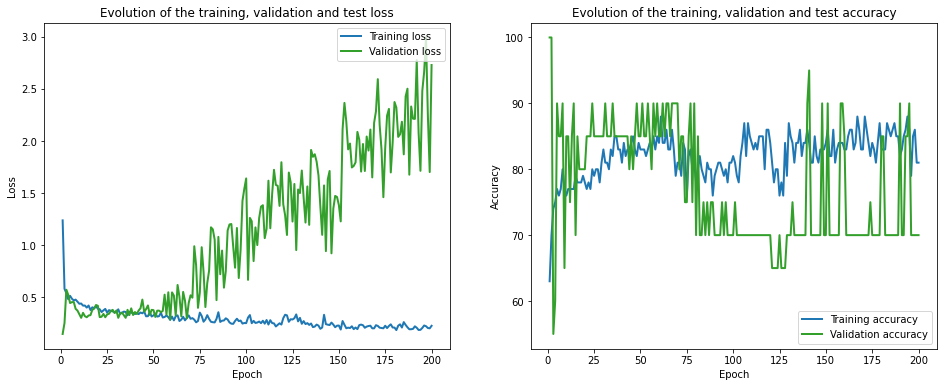

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 159.94it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1167.98it/s]

Finished computing p-values for 500 test points.

Starting repetition 38 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 1.60 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 1.54 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 2.82 train_acc: 30.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 1.85 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.57 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.51 train_acc: 60.00% took: 0.00s
val_loss = 0.19 val_acc = 100.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.56 train_acc: 50.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.

Epoch 11 of 200, 100% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
val_loss = 0.25 val_acc = 80.00%
Snapshot saved at epoch 11.
Epoch 12 of 200, 10% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 20% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 30% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 12 of 200, 40% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 60% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 70% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 80% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 90% 	 train_loss: 0.70 train_acc: 60.00% took: 0.00s
Epoch 12 of 200, 100% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
val_loss = 0.25 val_acc = 80.00%
Snapshot saved at epoch 12.
Epoch 13 of 200, 10% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 13 of 200, 20% 	 train_loss

val_loss = 0.30 val_acc = 80.00%
Snapshot saved at epoch 27.
Epoch 28 of 200, 10% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 20% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 30% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 28 of 200, 40% 	 train_loss: 0.26 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 60% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 70% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 80% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 90% 	 train_loss: 0.70 train_acc: 60.00% took: 0.00s
Epoch 28 of 200, 100% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
val_loss = 0.30 val_acc = 80.00%
Snapshot saved at epoch 28.
Epoch 29 of 200, 10% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 29 of 200, 20% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 29 of 200, 30% 	 train_loss

Epoch 39 of 200, 40% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 39 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 39 of 200, 60% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 39 of 200, 70% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 39 of 200, 80% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 39 of 200, 90% 	 train_loss: 0.70 train_acc: 60.00% took: 0.00s
Epoch 39 of 200, 100% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
val_loss = 0.33 val_acc = 80.00%
Snapshot saved at epoch 39.
Epoch 40 of 200, 10% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 40 of 200, 20% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 40 of 200, 30% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 40 of 200, 40% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 40 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 40 of 200, 60% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 40 of 200, 70% 	 

Epoch 55 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.01s
Epoch 55 of 200, 60% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 55 of 200, 70% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 55 of 200, 80% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 55 of 200, 90% 	 train_loss: 0.68 train_acc: 60.00% took: 0.00s
Epoch 55 of 200, 100% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
val_loss = 0.33 val_acc = 75.00%
Snapshot saved at epoch 55.
Epoch 56 of 200, 10% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 56 of 200, 20% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 56 of 200, 30% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 56 of 200, 40% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 56 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 56 of 200, 60% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 56 of 200, 70% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 56 of 200, 80% 	 t

Epoch 71 of 200, 10% 	 train_loss: 0.20 train_acc: 100.00% took: 0.01s
Epoch 71 of 200, 20% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 71 of 200, 30% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 71 of 200, 40% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 71 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 71 of 200, 60% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 71 of 200, 70% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 71 of 200, 80% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 71 of 200, 90% 	 train_loss: 0.66 train_acc: 60.00% took: 0.02s
Epoch 71 of 200, 100% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
val_loss = 0.31 val_acc = 80.00%
Snapshot saved at epoch 71.
Epoch 72 of 200, 10% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 72 of 200, 20% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 72 of 200, 30% 	 train_loss: 0.57 train_acc: 70.00% took: 0.02s
Epoch 72 of 200, 40% 	 t

Epoch 81 of 200, 100% 	 train_loss: 0.39 train_acc: 80.00% took: 0.02s
val_loss = 0.30 val_acc = 80.00%
Snapshot saved at epoch 81.
Epoch 82 of 200, 10% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 82 of 200, 20% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 82 of 200, 30% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 82 of 200, 40% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 82 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 82 of 200, 60% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 82 of 200, 70% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 82 of 200, 80% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 82 of 200, 90% 	 train_loss: 0.66 train_acc: 60.00% took: 0.00s
Epoch 82 of 200, 100% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
val_loss = 0.30 val_acc = 80.00%
Snapshot saved at epoch 82.
Epoch 83 of 200, 10% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 83 of 200, 20% 	 train_los

Epoch 97 of 200, 70% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 97 of 200, 80% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 97 of 200, 90% 	 train_loss: 0.65 train_acc: 60.00% took: 0.00s
Epoch 97 of 200, 100% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
val_loss = 0.29 val_acc = 80.00%
Snapshot saved at epoch 97.
Epoch 98 of 200, 10% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 98 of 200, 20% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 98 of 200, 30% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 98 of 200, 40% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 98 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 98 of 200, 60% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 98 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 98 of 200, 80% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 98 of 200, 90% 	 train_loss: 0.62 train_acc: 70.00% took: 0.00s
Epoch 98 of 200, 100% 	 t

Epoch 108 of 200, 80% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 108 of 200, 90% 	 train_loss: 0.64 train_acc: 60.00% took: 0.00s
Epoch 108 of 200, 100% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
val_loss = 0.29 val_acc = 80.00%
Snapshot saved at epoch 108.
Epoch 109 of 200, 10% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 109 of 200, 20% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 109 of 200, 30% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 109 of 200, 40% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 109 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 109 of 200, 60% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 109 of 200, 70% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 109 of 200, 80% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 109 of 200, 90% 	 train_loss: 0.64 train_acc: 60.00% took: 0.00s
Epoch 109 of 200, 100% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
val_loss =

Epoch 119 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 119 of 200, 80% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 119 of 200, 90% 	 train_loss: 0.60 train_acc: 70.00% took: 0.00s
Epoch 119 of 200, 100% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
val_loss = 0.28 val_acc = 80.00%
Snapshot saved at epoch 119.
Epoch 120 of 200, 10% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 120 of 200, 20% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 120 of 200, 30% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 120 of 200, 40% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 120 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 120 of 200, 60% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 120 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 120 of 200, 80% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 120 of 200, 90% 	 train_loss: 0.60 train_acc: 70.00% took: 0.00s
Epoch 120 o

Epoch 130 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.02s
Epoch 130 of 200, 80% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 130 of 200, 90% 	 train_loss: 0.60 train_acc: 70.00% took: 0.00s
Epoch 130 of 200, 100% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
val_loss = 0.28 val_acc = 80.00%
Snapshot saved at epoch 130.
Epoch 131 of 200, 10% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 131 of 200, 20% 	 train_loss: 0.32 train_acc: 90.00% took: 0.02s
Epoch 131 of 200, 30% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 131 of 200, 40% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 131 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 131 of 200, 60% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 131 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.02s
Epoch 131 of 200, 80% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 131 of 200, 90% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 131 o

Epoch 141 of 200, 60% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 141 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.01s
Epoch 141 of 200, 80% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 141 of 200, 90% 	 train_loss: 0.60 train_acc: 70.00% took: 0.00s
Epoch 141 of 200, 100% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
val_loss = 0.28 val_acc = 80.00%
Snapshot saved at epoch 141.
Epoch 142 of 200, 10% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 142 of 200, 20% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 142 of 200, 30% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 142 of 200, 40% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 142 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 142 of 200, 60% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 142 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 142 of 200, 80% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 142 o

Epoch 152 of 200, 30% 	 train_loss: 0.57 train_acc: 70.00% took: 0.02s
Epoch 152 of 200, 40% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 152 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 152 of 200, 60% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 152 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 152 of 200, 80% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 152 of 200, 90% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 152 of 200, 100% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
val_loss = 0.28 val_acc = 80.00%
Snapshot saved at epoch 152.
Epoch 153 of 200, 10% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 153 of 200, 20% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 153 of 200, 30% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 153 of 200, 40% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 153 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 153

Epoch 163 of 200, 60% 	 train_loss: 0.26 train_acc: 90.00% took: 0.02s
Epoch 163 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 163 of 200, 80% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 163 of 200, 90% 	 train_loss: 0.60 train_acc: 70.00% took: 0.00s
Epoch 163 of 200, 100% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
val_loss = 0.29 val_acc = 80.00%
Snapshot saved at epoch 163.
Epoch 164 of 200, 10% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 164 of 200, 20% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 164 of 200, 30% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 164 of 200, 40% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 164 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 164 of 200, 60% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 164 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 164 of 200, 80% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 164 o

Epoch 174 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 174 of 200, 60% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 80% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 174 of 200, 90% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 174 of 200, 100% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
val_loss = 0.28 val_acc = 80.00%
Snapshot saved at epoch 174.
Epoch 175 of 200, 10% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 175 of 200, 20% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 175 of 200, 30% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 175 of 200, 40% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 175 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 175 of 200, 60% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 175 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 175 

Epoch 189 of 200, 40% 	 train_loss: 0.21 train_acc: 100.00% took: 0.01s
Epoch 189 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 189 of 200, 60% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 189 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 189 of 200, 80% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 189 of 200, 90% 	 train_loss: 0.60 train_acc: 70.00% took: 0.00s
Epoch 189 of 200, 100% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
val_loss = 0.28 val_acc = 80.00%
Snapshot saved at epoch 189.
Epoch 190 of 200, 10% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 190 of 200, 20% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 190 of 200, 30% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 190 of 200, 40% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 190 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 190 of 200, 60% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 190

Epoch 199 of 200, 100% 	 train_loss: 0.38 train_acc: 80.00% took: 0.02s
val_loss = 0.28 val_acc = 80.00%
Snapshot saved at epoch 199.
Epoch 200 of 200, 10% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 200 of 200, 20% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 200 of 200, 30% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 200 of 200, 40% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 200 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 200 of 200, 60% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 200 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 200 of 200, 80% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 200 of 200, 90% 	 train_loss: 0.60 train_acc: 70.00% took: 0.00s
Epoch 200 of 200, 100% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
val_loss = 0.28 val_acc = 80.00%
Snapshot saved at epoch 200.
Training done! A list of 200 models saved.


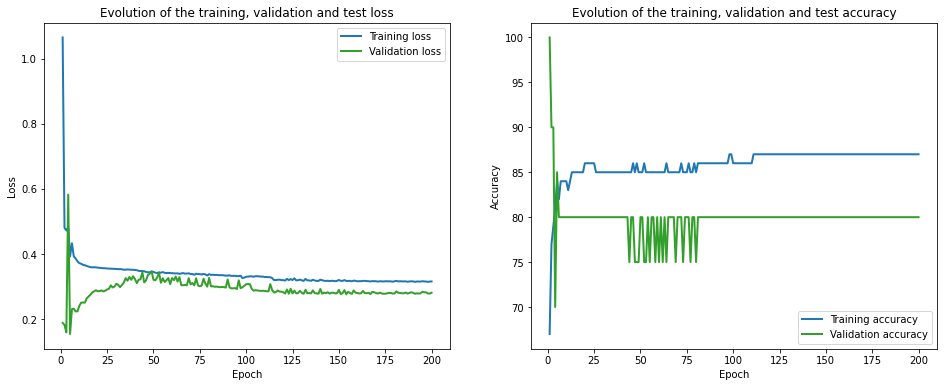

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 152.92it/s]


Initialization done!


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1037.79it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 1.15 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 1.81 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.73 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 3.99 train_acc: 30.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 3.20 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.86 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.65 train_acc: 70.00% took: 0.00s
val_loss = 0.09 val_acc = 100.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 1.08 train_acc: 40.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0

Epoch 16 of 200, 60% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 70% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 80% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 90% 	 train_loss: 0.67 train_acc: 60.00% took: 0.00s
Epoch 16 of 200, 100% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
val_loss = 0.27 val_acc = 80.00%
Snapshot saved at epoch 16.
Epoch 17 of 200, 10% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 20% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 30% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 17 of 200, 40% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 50% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 60% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 70% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 80% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 90% 	 tr

Epoch 27 of 200, 60% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 70% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 80% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 90% 	 train_loss: 0.70 train_acc: 60.00% took: 0.00s
Epoch 27 of 200, 100% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
val_loss = 0.30 val_acc = 80.00%
Snapshot saved at epoch 27.
Epoch 28 of 200, 10% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 20% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 30% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 28 of 200, 40% 	 train_loss: 0.26 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 60% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 70% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 80% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 90% 	 tr

Snapshot saved at epoch 41.
Epoch 42 of 200, 10% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 42 of 200, 20% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 42 of 200, 30% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 42 of 200, 40% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 42 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 42 of 200, 60% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 42 of 200, 70% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 42 of 200, 80% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 42 of 200, 90% 	 train_loss: 0.70 train_acc: 60.00% took: 0.00s
Epoch 42 of 200, 100% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
val_loss = 0.32 val_acc = 75.00%
Snapshot saved at epoch 42.
Epoch 43 of 200, 10% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 43 of 200, 20% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 43 of 200, 30% 	 train_loss: 0.56 train_acc: 70.00% took: 0.

Epoch 57 of 200, 60% 	 train_loss: 0.34 train_acc: 80.00% took: 0.02s
Epoch 57 of 200, 70% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 80% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 57 of 200, 90% 	 train_loss: 0.68 train_acc: 60.00% took: 0.00s
Epoch 57 of 200, 100% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
val_loss = 0.34 val_acc = 75.00%
Snapshot saved at epoch 57.
Epoch 58 of 200, 10% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 58 of 200, 20% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 30% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 58 of 200, 40% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 58 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 58 of 200, 60% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 70% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 80% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 58 of 200, 90% 	 tr

Epoch 73 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 73 of 200, 60% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 73 of 200, 70% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 73 of 200, 80% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 73 of 200, 90% 	 train_loss: 0.66 train_acc: 60.00% took: 0.00s
Epoch 73 of 200, 100% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
val_loss = 0.34 val_acc = 75.00%
Snapshot saved at epoch 73.
Epoch 74 of 200, 10% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 74 of 200, 20% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 74 of 200, 30% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 74 of 200, 40% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 74 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 74 of 200, 60% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 74 of 200, 70% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 74 of 200, 80% 	 t

val_loss = 0.34 val_acc = 75.00%
Snapshot saved at epoch 84.
Epoch 85 of 200, 10% 	 train_loss: 0.19 train_acc: 100.00% took: 0.01s
Epoch 85 of 200, 20% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 85 of 200, 30% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 85 of 200, 40% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 85 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 85 of 200, 60% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 85 of 200, 70% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 85 of 200, 80% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 85 of 200, 90% 	 train_loss: 0.65 train_acc: 60.00% took: 0.00s
Epoch 85 of 200, 100% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
val_loss = 0.33 val_acc = 75.00%
Snapshot saved at epoch 85.
Epoch 86 of 200, 10% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 86 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 86 of 200, 30% 	 train_loss

Epoch 101 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 30% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 101 of 200, 40% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 101 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 101 of 200, 60% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 80% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 101 of 200, 90% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 101 of 200, 100% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
val_loss = 0.31 val_acc = 80.00%
Snapshot saved at epoch 101.
Epoch 102 of 200, 10% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 102 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 102 of 200, 30% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 102 of 200, 40% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 102 

val_loss = 0.31 val_acc = 80.00%
Snapshot saved at epoch 111.
Epoch 112 of 200, 10% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 112 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 112 of 200, 30% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 112 of 200, 40% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 112 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 112 of 200, 60% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 112 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 112 of 200, 80% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 112 of 200, 90% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 112 of 200, 100% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
val_loss = 0.31 val_acc = 80.00%
Snapshot saved at epoch 112.
Epoch 113 of 200, 10% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 113 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 113 of 200, 30%

Epoch 122 of 200, 90% 	 train_loss: 0.63 train_acc: 70.00% took: 0.02s
Epoch 122 of 200, 100% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
val_loss = 0.31 val_acc = 80.00%
Snapshot saved at epoch 122.
Epoch 123 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 123 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 123 of 200, 30% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 123 of 200, 40% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 123 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 123 of 200, 60% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 123 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 123 of 200, 80% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 123 of 200, 90% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 123 of 200, 100% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
val_loss = 0.31 val_acc = 80.00%
Snapshot saved at epoch 123.
Epoch 124 of 200, 10

Epoch 134 of 200, 20% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 134 of 200, 30% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 134 of 200, 40% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 134 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 134 of 200, 60% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 134 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 134 of 200, 80% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 134 of 200, 90% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 134 of 200, 100% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
val_loss = 0.31 val_acc = 80.00%
Snapshot saved at epoch 134.
Epoch 135 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 135 of 200, 20% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 135 of 200, 30% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 135 of 200, 40% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 135 o

Epoch 149 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.02s
Epoch 149 of 200, 60% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 149 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 149 of 200, 80% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 149 of 200, 90% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 149 of 200, 100% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
val_loss = 0.30 val_acc = 80.00%
Snapshot saved at epoch 149.
Epoch 150 of 200, 10% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 20% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 30% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 150 of 200, 40% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 150 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 150 of 200, 60% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 150 o

Epoch 160 of 200, 40% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 160 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 160 of 200, 60% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 160 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 160 of 200, 80% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 160 of 200, 90% 	 train_loss: 0.64 train_acc: 70.00% took: 0.00s
Epoch 160 of 200, 100% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
val_loss = 0.30 val_acc = 80.00%
Snapshot saved at epoch 160.
Epoch 161 of 200, 10% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 161 of 200, 20% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 161 of 200, 30% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 161 of 200, 40% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 161 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 161 of 200, 60% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 161 

Epoch 175 of 200, 20% 	 train_loss: 0.26 train_acc: 90.00% took: 0.02s
Epoch 175 of 200, 30% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 175 of 200, 40% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 175 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 175 of 200, 60% 	 train_loss: 0.32 train_acc: 90.00% took: 0.02s
Epoch 175 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 175 of 200, 80% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 175 of 200, 90% 	 train_loss: 0.65 train_acc: 60.00% took: 0.00s
Epoch 175 of 200, 100% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
val_loss = 0.31 val_acc = 80.00%
Snapshot saved at epoch 175.
Epoch 176 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 176 of 200, 20% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 176 of 200, 30% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 176 of 200, 40% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 176 o

Epoch 189 of 200, 10% 	 train_loss: 0.24 train_acc: 90.00% took: 0.02s
Epoch 189 of 200, 20% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 189 of 200, 30% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 189 of 200, 40% 	 train_loss: 0.19 train_acc: 100.00% took: 0.02s
Epoch 189 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 189 of 200, 60% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 189 of 200, 70% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 189 of 200, 80% 	 train_loss: 0.34 train_acc: 80.00% took: 0.02s
Epoch 189 of 200, 90% 	 train_loss: 0.65 train_acc: 60.00% took: 0.00s
Epoch 189 of 200, 100% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
val_loss = 0.30 val_acc = 80.00%
Snapshot saved at epoch 189.
Epoch 190 of 200, 10% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 190 of 200, 20% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 190 of 200, 30% 	 train_loss: 0.59 train_acc: 70.00% took: 0.02s
Epoch 190 of

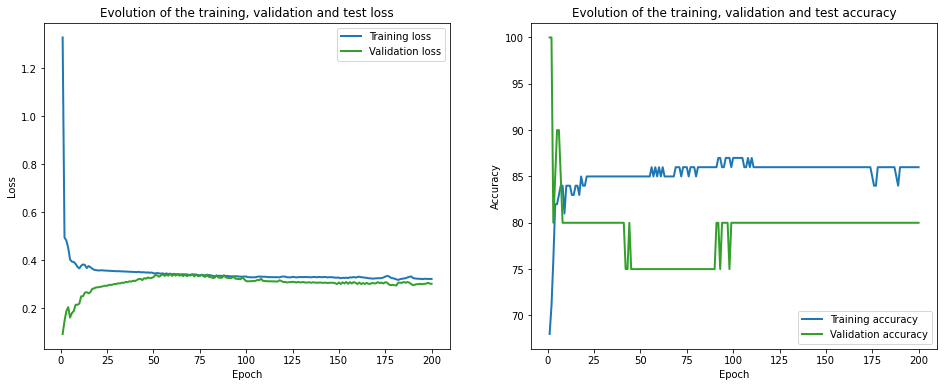

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 143.47it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1279.07it/s]

Finished computing p-values for 500 test points.

Starting repetition 39 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.53 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 1.14 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 1.75 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 1.07 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.77 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
val_loss = 0.52 val_acc = 70.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.38 train_acc: 70.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 

val_loss = 0.45 val_acc = 80.00%
Snapshot saved at epoch 14.
Epoch 15 of 200, 10% 	 train_loss: 0.40 train_acc: 70.00% took: 0.01s
Epoch 15 of 200, 20% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 15 of 200, 30% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 15 of 200, 40% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 50% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 60% 	 train_loss: 0.52 train_acc: 70.00% took: 0.00s
Epoch 15 of 200, 70% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 15 of 200, 80% 	 train_loss: 0.45 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 90% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 15 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 0.43 val_acc = 80.00%
Snapshot saved at epoch 15.
Epoch 16 of 200, 10% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 20% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 30% 	 train_loss

Epoch 25 of 200, 80% 	 train_loss: 0.44 train_acc: 90.00% took: 0.00s
Epoch 25 of 200, 90% 	 train_loss: 0.45 train_acc: 80.00% took: 0.01s
Epoch 25 of 200, 100% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
val_loss = 0.41 val_acc = 80.00%
Snapshot saved at epoch 25.
Epoch 26 of 200, 10% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 26 of 200, 20% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 26 of 200, 30% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 26 of 200, 40% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 26 of 200, 50% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 26 of 200, 60% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 26 of 200, 70% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 26 of 200, 80% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 26 of 200, 90% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 26 of 200, 100% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
val_loss = 0.46 val_acc

Epoch 37 of 200, 10% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 37 of 200, 20% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 37 of 200, 30% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 37 of 200, 40% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 37 of 200, 50% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 37 of 200, 60% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 37 of 200, 70% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 37 of 200, 80% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 37 of 200, 90% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 37 of 200, 100% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
val_loss = 0.41 val_acc = 80.00%
Snapshot saved at epoch 37.
Epoch 38 of 200, 10% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 38 of 200, 20% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 30% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 40% 	 

Epoch 51 of 200, 10% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 51 of 200, 20% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 51 of 200, 30% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 51 of 200, 40% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 51 of 200, 50% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 51 of 200, 60% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 51 of 200, 70% 	 train_loss: 0.65 train_acc: 80.00% took: 0.02s
Epoch 51 of 200, 80% 	 train_loss: 0.48 train_acc: 90.00% took: 0.00s
Epoch 51 of 200, 90% 	 train_loss: 0.52 train_acc: 70.00% took: 0.00s
Epoch 51 of 200, 100% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
val_loss = 0.38 val_acc = 80.00%
Snapshot saved at epoch 51.
Epoch 52 of 200, 10% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 52 of 200, 20% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 52 of 200, 30% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 52 of 200, 40% 	 t

Epoch 62 of 200, 60% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 62 of 200, 70% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 62 of 200, 80% 	 train_loss: 0.47 train_acc: 90.00% took: 0.00s
Epoch 62 of 200, 90% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 62 of 200, 100% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
val_loss = 0.37 val_acc = 80.00%
Snapshot saved at epoch 62.
Epoch 63 of 200, 10% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 63 of 200, 20% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 63 of 200, 30% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 63 of 200, 40% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 63 of 200, 50% 	 train_loss: 0.08 train_acc: 90.00% took: 0.00s
Epoch 63 of 200, 60% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 63 of 200, 70% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 63 of 200, 80% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 63 of 200, 90% 	 tr

Epoch 73 of 200, 100% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
val_loss = 0.46 val_acc = 80.00%
Snapshot saved at epoch 73.
Epoch 74 of 200, 10% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 74 of 200, 20% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 74 of 200, 30% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 74 of 200, 40% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 74 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 74 of 200, 60% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 74 of 200, 70% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 74 of 200, 80% 	 train_loss: 0.44 train_acc: 90.00% took: 0.00s
Epoch 74 of 200, 90% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 74 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 0.47 val_acc = 80.00%
Snapshot saved at epoch 74.
Epoch 75 of 200, 10% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 75 of 200, 20% 	 train_loss

Epoch 84 of 200, 80% 	 train_loss: 0.51 train_acc: 90.00% took: 0.00s
Epoch 84 of 200, 90% 	 train_loss: 0.44 train_acc: 60.00% took: 0.00s
Epoch 84 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 0.49 val_acc = 80.00%
Snapshot saved at epoch 84.
Epoch 85 of 200, 10% 	 train_loss: 0.52 train_acc: 70.00% took: 0.00s
Epoch 85 of 200, 20% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 85 of 200, 30% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 85 of 200, 40% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 85 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 85 of 200, 60% 	 train_loss: 0.52 train_acc: 70.00% took: 0.00s
Epoch 85 of 200, 70% 	 train_loss: 0.78 train_acc: 80.00% took: 0.00s
Epoch 85 of 200, 80% 	 train_loss: 0.61 train_acc: 90.00% took: 0.00s
Epoch 85 of 200, 90% 	 train_loss: 0.46 train_acc: 60.00% took: 0.00s
Epoch 85 of 200, 100% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
val_loss = 0.49 val_acc 

Epoch 99 of 200, 70% 	 train_loss: 0.48 train_acc: 80.00% took: 0.02s
Epoch 99 of 200, 80% 	 train_loss: 0.63 train_acc: 90.00% took: 0.00s
Epoch 99 of 200, 90% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 99 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 0.48 val_acc = 80.00%
Snapshot saved at epoch 99.
Epoch 100 of 200, 10% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 20% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 30% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 100 of 200, 40% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 100 of 200, 60% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 100 of 200, 70% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 80% 	 train_loss: 0.61 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 90% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 100 of 200

Epoch 110 of 200, 50% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 110 of 200, 60% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 110 of 200, 70% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 110 of 200, 80% 	 train_loss: 0.96 train_acc: 80.00% took: 0.00s
Epoch 110 of 200, 90% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 110 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.37 val_acc = 80.00%
Snapshot saved at epoch 110.
Epoch 111 of 200, 10% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 111 of 200, 20% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 30% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 40% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 50% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 60% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 111 of 200, 70% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 111 

Epoch 125 of 200, 80% 	 train_loss: 0.54 train_acc: 90.00% took: 0.02s
Epoch 125 of 200, 90% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 125 of 200, 100% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
val_loss = 0.40 val_acc = 80.00%
Snapshot saved at epoch 125.
Epoch 126 of 200, 10% 	 train_loss: 0.52 train_acc: 70.00% took: 0.00s
Epoch 126 of 200, 20% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 126 of 200, 30% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 126 of 200, 40% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 126 of 200, 50% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 126 of 200, 60% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 126 of 200, 70% 	 train_loss: 0.40 train_acc: 70.00% took: 0.00s
Epoch 126 of 200, 80% 	 train_loss: 0.50 train_acc: 90.00% took: 0.00s
Epoch 126 of 200, 90% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 126 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss

Epoch 140 of 200, 50% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 140 of 200, 60% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 140 of 200, 70% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 140 of 200, 80% 	 train_loss: 0.58 train_acc: 90.00% took: 0.00s
Epoch 140 of 200, 90% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 140 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 0.37 val_acc = 80.00%
Snapshot saved at epoch 140.
Epoch 141 of 200, 10% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 141 of 200, 20% 	 train_loss: 0.07 train_acc: 100.00% took: 0.01s
Epoch 141 of 200, 30% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 141 of 200, 40% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 141 of 200, 50% 	 train_loss: 0.09 train_acc: 90.00% took: 0.01s
Epoch 141 of 200, 60% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 141 of 200, 70% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 141 o

Epoch 155 of 200, 10% 	 train_loss: 0.48 train_acc: 80.00% took: 0.02s
Epoch 155 of 200, 20% 	 train_loss: 0.07 train_acc: 100.00% took: 0.01s
Epoch 155 of 200, 30% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 155 of 200, 40% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 155 of 200, 50% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 155 of 200, 60% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 155 of 200, 70% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 155 of 200, 80% 	 train_loss: 0.56 train_acc: 90.00% took: 0.00s
Epoch 155 of 200, 90% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 155 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 0.37 val_acc = 80.00%
Snapshot saved at epoch 155.
Epoch 156 of 200, 10% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 156 of 200, 20% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 156 of 200, 30% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 156

Epoch 165 of 200, 80% 	 train_loss: 0.53 train_acc: 90.00% took: 0.00s
Epoch 165 of 200, 90% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 165 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 0.36 val_acc = 80.00%
Snapshot saved at epoch 165.
Epoch 166 of 200, 10% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 166 of 200, 20% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 166 of 200, 30% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 166 of 200, 40% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 50% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 60% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 166 of 200, 70% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 166 of 200, 80% 	 train_loss: 0.53 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 90% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 166 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss 

Epoch 176 of 200, 50% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 176 of 200, 60% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 176 of 200, 70% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 176 of 200, 80% 	 train_loss: 0.55 train_acc: 90.00% took: 0.00s
Epoch 176 of 200, 90% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 176 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.37 val_acc = 80.00%
Snapshot saved at epoch 176.
Epoch 177 of 200, 10% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 177 of 200, 20% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 177 of 200, 30% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 177 of 200, 40% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 177 of 200, 50% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 177 of 200, 60% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 177 of 200, 70% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 177 o

Epoch 187 of 200, 10% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 187 of 200, 20% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 187 of 200, 30% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 187 of 200, 40% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 187 of 200, 50% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 187 of 200, 60% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 187 of 200, 70% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 187 of 200, 80% 	 train_loss: 0.53 train_acc: 90.00% took: 0.00s
Epoch 187 of 200, 90% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 187 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 0.36 val_acc = 80.00%
Snapshot saved at epoch 187.
Epoch 188 of 200, 10% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 188 of 200, 20% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 188 of 200, 30% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 188

Epoch 197 of 200, 80% 	 train_loss: 0.53 train_acc: 90.00% took: 0.00s
Epoch 197 of 200, 90% 	 train_loss: 0.47 train_acc: 70.00% took: 0.01s
Epoch 197 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.37 val_acc = 80.00%
Snapshot saved at epoch 197.
Epoch 198 of 200, 10% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 198 of 200, 20% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 198 of 200, 30% 	 train_loss: 0.11 train_acc: 100.00% took: 0.02s
Epoch 198 of 200, 40% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 198 of 200, 50% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 198 of 200, 60% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 198 of 200, 70% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 198 of 200, 80% 	 train_loss: 0.53 train_acc: 90.00% took: 0.02s
Epoch 198 of 200, 90% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 198 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss 

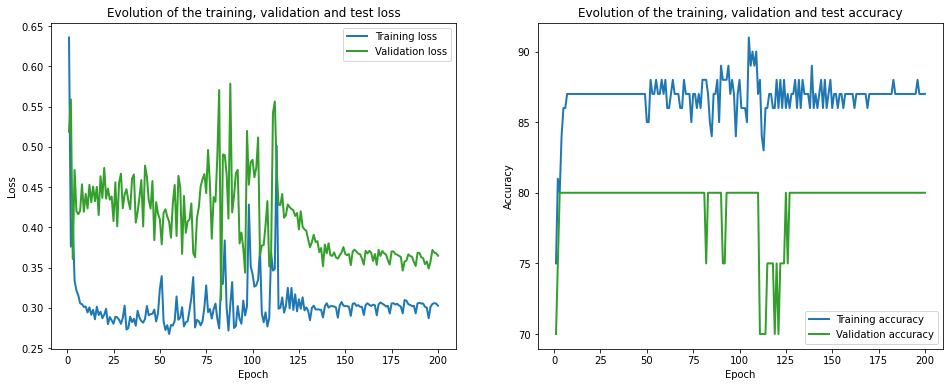

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 148.93it/s]


Initialization done!


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 967.15it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.60 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 1.30 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 1.08 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.87 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.69 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.56 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.84 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
val_loss = 0.57 val_acc = 70.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.34 train_acc: 70.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0

Epoch 17 of 200, 60% 	 train_loss: 0.52 train_acc: 70.00% took: 0.02s
Epoch 17 of 200, 70% 	 train_loss: 0.39 train_acc: 80.00% took: 0.01s
Epoch 17 of 200, 80% 	 train_loss: 0.48 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 90% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 100% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
val_loss = 0.41 val_acc = 80.00%
Snapshot saved at epoch 17.
Epoch 18 of 200, 10% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 18 of 200, 20% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 18 of 200, 30% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 18 of 200, 40% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 18 of 200, 50% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 18 of 200, 60% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 18 of 200, 70% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 18 of 200, 80% 	 train_loss: 0.44 train_acc: 90.00% took: 0.00s
Epoch 18 of 200, 90% 	 tr

val_loss = 0.42 val_acc = 75.00%
Snapshot saved at epoch 29.
Epoch 30 of 200, 10% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 30 of 200, 20% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 30 of 200, 30% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 30 of 200, 40% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 30 of 200, 50% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 30 of 200, 60% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 30 of 200, 70% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 30 of 200, 80% 	 train_loss: 0.52 train_acc: 90.00% took: 0.00s
Epoch 30 of 200, 90% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 30 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 0.50 val_acc = 75.00%
Snapshot saved at epoch 30.
Epoch 31 of 200, 10% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 31 of 200, 20% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 31 of 200, 30% 	 train_loss

Epoch 41 of 200, 30% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 41 of 200, 40% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 41 of 200, 50% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 41 of 200, 60% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 41 of 200, 70% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 41 of 200, 80% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 41 of 200, 90% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 41 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 0.49 val_acc = 80.00%
Snapshot saved at epoch 41.
Epoch 42 of 200, 10% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 42 of 200, 20% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 42 of 200, 30% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 42 of 200, 40% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 42 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 42 of 200, 60% 	 

Epoch 52 of 200, 40% 	 train_loss: 0.32 train_acc: 90.00% took: 0.02s
Epoch 52 of 200, 50% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 52 of 200, 60% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 52 of 200, 70% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 52 of 200, 80% 	 train_loss: 0.57 train_acc: 90.00% took: 0.00s
Epoch 52 of 200, 90% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 52 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 0.49 val_acc = 80.00%
Snapshot saved at epoch 52.
Epoch 53 of 200, 10% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 53 of 200, 20% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 53 of 200, 30% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 53 of 200, 40% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 53 of 200, 50% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 53 of 200, 60% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 53 of 200, 70% 	 tr

Epoch 63 of 200, 90% 	 train_loss: 0.38 train_acc: 80.00% took: 0.01s
Epoch 63 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.42 val_acc = 80.00%
Snapshot saved at epoch 63.
Epoch 64 of 200, 10% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 64 of 200, 20% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 64 of 200, 30% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 64 of 200, 40% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 64 of 200, 50% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 64 of 200, 60% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 64 of 200, 70% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 64 of 200, 80% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 64 of 200, 90% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 64 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 0.50 val_acc = 80.00%
Snapshot saved at epoch 64.
Epoch 65 of 200, 10% 	 train_los

val_loss = 0.50 val_acc = 80.00%
Snapshot saved at epoch 74.
Epoch 75 of 200, 10% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 75 of 200, 20% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 75 of 200, 30% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 75 of 200, 40% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 75 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 75 of 200, 60% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 75 of 200, 70% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 75 of 200, 80% 	 train_loss: 0.66 train_acc: 80.00% took: 0.00s
Epoch 75 of 200, 90% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 75 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 0.45 val_acc = 80.00%
Snapshot saved at epoch 75.
Epoch 76 of 200, 10% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 76 of 200, 20% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 76 of 200, 30% 	 train_loss:

Epoch 86 of 200, 40% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 86 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.01s
Epoch 86 of 200, 60% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 86 of 200, 70% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 86 of 200, 80% 	 train_loss: 0.66 train_acc: 90.00% took: 0.00s
Epoch 86 of 200, 90% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 86 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.42 val_acc = 75.00%
Snapshot saved at epoch 86.
Epoch 87 of 200, 10% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 87 of 200, 20% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 87 of 200, 30% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 87 of 200, 40% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 87 of 200, 50% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 87 of 200, 60% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 87 of 200, 70% 	 

Epoch 97 of 200, 30% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 97 of 200, 40% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 97 of 200, 50% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 97 of 200, 60% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 97 of 200, 70% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 97 of 200, 80% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 97 of 200, 90% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 97 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.40 val_acc = 80.00%
Snapshot saved at epoch 97.
Epoch 98 of 200, 10% 	 train_loss: 0.52 train_acc: 70.00% took: 0.00s
Epoch 98 of 200, 20% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 98 of 200, 30% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 98 of 200, 40% 	 train_loss: 0.22 train_acc: 90.00% took: 0.01s
Epoch 98 of 200, 50% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 98 of 200, 60% 	

val_loss = 0.44 val_acc = 80.00%
Snapshot saved at epoch 107.
Epoch 108 of 200, 10% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 108 of 200, 20% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 108 of 200, 30% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 108 of 200, 40% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 108 of 200, 50% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 108 of 200, 60% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 108 of 200, 70% 	 train_loss: 0.90 train_acc: 80.00% took: 0.00s
Epoch 108 of 200, 80% 	 train_loss: 0.58 train_acc: 90.00% took: 0.00s
Epoch 108 of 200, 90% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 108 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.39 val_acc = 75.00%
Snapshot saved at epoch 108.
Epoch 109 of 200, 10% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 109 of 200, 20% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 109 of 200, 30

val_loss = 0.35 val_acc = 80.00%
Snapshot saved at epoch 118.
Epoch 119 of 200, 10% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 119 of 200, 20% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 119 of 200, 30% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 119 of 200, 40% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 119 of 200, 50% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 119 of 200, 60% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 119 of 200, 70% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 119 of 200, 80% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 119 of 200, 90% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 119 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 0.31 val_acc = 80.00%
Snapshot saved at epoch 119.
Epoch 120 of 200, 10% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 120 of 200, 20% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 120 of 200, 

Epoch 129 of 200, 80% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 129 of 200, 90% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 129 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.34 val_acc = 80.00%
Snapshot saved at epoch 129.
Epoch 130 of 200, 10% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 130 of 200, 20% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 130 of 200, 30% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 130 of 200, 40% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 130 of 200, 50% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 130 of 200, 60% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 130 of 200, 70% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 130 of 200, 80% 	 train_loss: 0.59 train_acc: 90.00% took: 0.00s
Epoch 130 of 200, 90% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 130 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss 

Epoch 141 of 200, 10% 	 train_loss: 0.45 train_acc: 80.00% took: 0.01s
Epoch 141 of 200, 20% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 141 of 200, 30% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 141 of 200, 40% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 141 of 200, 50% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 141 of 200, 60% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 141 of 200, 70% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 141 of 200, 80% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 141 of 200, 90% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 141 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.36 val_acc = 80.00%
Snapshot saved at epoch 141.
Epoch 142 of 200, 10% 	 train_loss: 0.46 train_acc: 80.00% took: 0.02s
Epoch 142 of 200, 20% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 142 of 200, 30% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 142

Epoch 152 of 200, 20% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 152 of 200, 30% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 152 of 200, 40% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 152 of 200, 50% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 152 of 200, 60% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 152 of 200, 70% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 152 of 200, 80% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 152 of 200, 90% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 152 of 200, 100% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
val_loss = 0.42 val_acc = 75.00%
Snapshot saved at epoch 152.
Epoch 153 of 200, 10% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 153 of 200, 20% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 153 of 200, 30% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 153 of 200, 40% 	 train_loss: 0.51 train_acc: 90.00% took: 0.00s
Epoch 153

Epoch 162 of 200, 80% 	 train_loss: 0.43 train_acc: 90.00% took: 0.02s
Epoch 162 of 200, 90% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 162 of 200, 100% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
val_loss = 0.56 val_acc = 80.00%
Snapshot saved at epoch 162.
Epoch 163 of 200, 10% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 163 of 200, 20% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 163 of 200, 30% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 163 of 200, 40% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 163 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 163 of 200, 60% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 163 of 200, 70% 	 train_loss: 0.40 train_acc: 70.00% took: 0.00s
Epoch 163 of 200, 80% 	 train_loss: 0.49 train_acc: 90.00% took: 0.00s
Epoch 163 of 200, 90% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 163 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss

val_loss = 0.51 val_acc = 80.00%
Snapshot saved at epoch 177.
Epoch 178 of 200, 10% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 178 of 200, 20% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 30% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 178 of 200, 40% 	 train_loss: 0.56 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 178 of 200, 60% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 178 of 200, 70% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 178 of 200, 80% 	 train_loss: 0.53 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 90% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 0.55 val_acc = 80.00%
Snapshot saved at epoch 178.
Epoch 179 of 200, 10% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 179 of 200, 20% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 179 of 200, 30

Epoch 189 of 200, 10% 	 train_loss: 0.47 train_acc: 80.00% took: 0.01s
Epoch 189 of 200, 20% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 189 of 200, 30% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 189 of 200, 40% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 189 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 189 of 200, 60% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 189 of 200, 70% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 189 of 200, 80% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 189 of 200, 90% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 189 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 0.33 val_acc = 80.00%
Snapshot saved at epoch 189.
Epoch 190 of 200, 10% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 190 of 200, 20% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 190 of 200, 30% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 19

Epoch 200 of 200, 10% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 200 of 200, 20% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 200 of 200, 30% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 200 of 200, 40% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 200 of 200, 50% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 200 of 200, 60% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 200 of 200, 70% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 200 of 200, 80% 	 train_loss: 0.45 train_acc: 90.00% took: 0.00s
Epoch 200 of 200, 90% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 200 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 0.33 val_acc = 80.00%
Snapshot saved at epoch 200.
Training done! A list of 200 models saved.


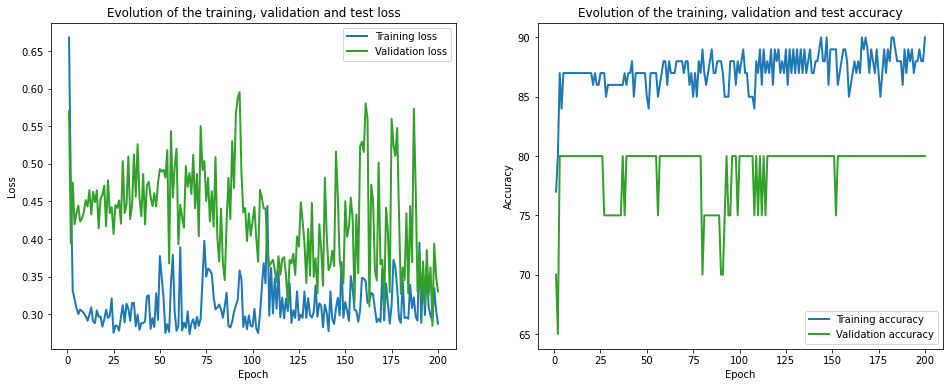

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 156.98it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1288.59it/s]

Finished computing p-values for 500 test points.

Starting repetition 40 of 50:




C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


Training with standard data splitting...
===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.64 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.59 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 1.59 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.79 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.66 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.71 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.49 train_acc: 90.00% took: 0.00s
val_loss = 0.42 val_acc = 60.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.37 train_acc: 90.00% took: 0.

Epoch 16 of 200, 50% 	 train_loss: 0.34 train_acc: 80.00% took: 0.02s
Epoch 16 of 200, 60% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 70% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 80% 	 train_loss: 0.25 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 90% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 100% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
val_loss = 0.57 val_acc = 85.00%
Snapshot saved at epoch 16.
Epoch 17 of 200, 10% 	 train_loss: 0.12 train_acc: 100.00% took: 0.02s
Epoch 17 of 200, 20% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 30% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 40% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 50% 	 train_loss: 0.33 train_acc: 80.00% took: 0.02s
Epoch 17 of 200, 60% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 70% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 17 of 200, 80% 	 tr

val_loss = 0.61 val_acc = 90.00%
Snapshot saved at epoch 31.
Epoch 32 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 32 of 200, 20% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 32 of 200, 30% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 32 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 32 of 200, 50% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 32 of 200, 60% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 32 of 200, 70% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 32 of 200, 80% 	 train_loss: 0.28 train_acc: 100.00% took: 0.00s
Epoch 32 of 200, 90% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 32 of 200, 100% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
val_loss = 0.63 val_acc = 90.00%
Snapshot saved at epoch 32.
Epoch 33 of 200, 10% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 33 of 200, 20% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 33 of 200, 30% 	 train_loss

Epoch 43 of 200, 50% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 43 of 200, 60% 	 train_loss: 0.69 train_acc: 80.00% took: 0.01s
Epoch 43 of 200, 70% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 43 of 200, 80% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 43 of 200, 90% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 43 of 200, 100% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
val_loss = 0.68 val_acc = 80.00%
Snapshot saved at epoch 43.
Epoch 44 of 200, 10% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 44 of 200, 20% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 44 of 200, 30% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 44 of 200, 40% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 44 of 200, 50% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 44 of 200, 60% 	 train_loss: 0.75 train_acc: 80.00% took: 0.00s
Epoch 44 of 200, 70% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 44 of 200, 80% 	 tra

Epoch 54 of 200, 80% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 54 of 200, 90% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 54 of 200, 100% 	 train_loss: 0.22 train_acc: 80.00% took: 0.01s
val_loss = 0.73 val_acc = 85.00%
Snapshot saved at epoch 54.
Epoch 55 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 55 of 200, 20% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 55 of 200, 30% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 55 of 200, 40% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 55 of 200, 50% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 55 of 200, 60% 	 train_loss: 0.66 train_acc: 80.00% took: 0.00s
Epoch 55 of 200, 70% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 55 of 200, 80% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 55 of 200, 90% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 55 of 200, 100% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
val_loss = 0.84 val_acc 

val_loss = 0.78 val_acc = 90.00%
Snapshot saved at epoch 69.
Epoch 70 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 70 of 200, 20% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 70 of 200, 30% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 70 of 200, 40% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 70 of 200, 50% 	 train_loss: 0.32 train_acc: 80.00% took: 0.01s
Epoch 70 of 200, 60% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 70 of 200, 70% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 70 of 200, 80% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 70 of 200, 90% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 70 of 200, 100% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
val_loss = 0.70 val_acc = 90.00%
Snapshot saved at epoch 70.
Epoch 71 of 200, 10% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 71 of 200, 20% 	 train_loss: 0.31 train_acc: 70.00% took: 0.00s
Epoch 71 of 200, 30% 	 train_loss:

Epoch 85 of 200, 100% 	 train_loss: 0.21 train_acc: 90.00% took: 0.02s
val_loss = 0.84 val_acc = 85.00%
Snapshot saved at epoch 85.
Epoch 86 of 200, 10% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 86 of 200, 20% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 86 of 200, 30% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 86 of 200, 40% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 86 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.02s
Epoch 86 of 200, 60% 	 train_loss: 0.64 train_acc: 80.00% took: 0.00s
Epoch 86 of 200, 70% 	 train_loss: 0.40 train_acc: 80.00% took: 0.01s
Epoch 86 of 200, 80% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 86 of 200, 90% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 86 of 200, 100% 	 train_loss: 0.21 train_acc: 90.00% took: 0.01s
val_loss = 0.72 val_acc = 90.00%
Snapshot saved at epoch 86.
Epoch 87 of 200, 10% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 87 of 200, 20% 	 train_loss:

val_loss = 0.89 val_acc = 75.00%
Snapshot saved at epoch 100.
Epoch 101 of 200, 10% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 20% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 30% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 40% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 50% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 60% 	 train_loss: 0.65 train_acc: 80.00% took: 0.00s
Epoch 101 of 200, 70% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 101 of 200, 80% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 90% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 101 of 200, 100% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
val_loss = 0.73 val_acc = 85.00%
Snapshot saved at epoch 101.
Epoch 102 of 200, 10% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 102 of 200, 20% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 102 of 200, 30% 	

Epoch 116 of 200, 100% 	 train_loss: 0.17 train_acc: 90.00% took: 0.02s
val_loss = 0.77 val_acc = 80.00%
Snapshot saved at epoch 116.
Epoch 117 of 200, 10% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 117 of 200, 20% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 117 of 200, 30% 	 train_loss: 0.19 train_acc: 80.00% took: 0.00s
Epoch 117 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 117 of 200, 50% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 117 of 200, 60% 	 train_loss: 0.74 train_acc: 80.00% took: 0.00s
Epoch 117 of 200, 70% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 117 of 200, 80% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 117 of 200, 90% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 117 of 200, 100% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
val_loss = 0.85 val_acc = 80.00%
Snapshot saved at epoch 117.
Epoch 118 of 200, 10% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 118 of 200, 20%

Epoch 128 of 200, 10% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 128 of 200, 20% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 128 of 200, 30% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 128 of 200, 40% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 128 of 200, 50% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 128 of 200, 60% 	 train_loss: 0.79 train_acc: 80.00% took: 0.00s
Epoch 128 of 200, 70% 	 train_loss: 0.49 train_acc: 60.00% took: 0.00s
Epoch 128 of 200, 80% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 128 of 200, 90% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 128 of 200, 100% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
val_loss = 0.91 val_acc = 80.00%
Snapshot saved at epoch 128.
Epoch 129 of 200, 10% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 129 of 200, 20% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 129 of 200, 30% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 129 of 

val_loss = 0.91 val_acc = 80.00%
Snapshot saved at epoch 138.
Epoch 139 of 200, 10% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 139 of 200, 20% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 139 of 200, 30% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 139 of 200, 40% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 139 of 200, 50% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 139 of 200, 60% 	 train_loss: 0.78 train_acc: 80.00% took: 0.00s
Epoch 139 of 200, 70% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 139 of 200, 80% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 139 of 200, 90% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 139 of 200, 100% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
val_loss = 0.87 val_acc = 85.00%
Snapshot saved at epoch 139.
Epoch 140 of 200, 10% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 140 of 200, 20% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 140 of 200, 30% 

Epoch 149 of 200, 60% 	 train_loss: 0.69 train_acc: 80.00% took: 0.00s
Epoch 149 of 200, 70% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 149 of 200, 80% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 149 of 200, 90% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 149 of 200, 100% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
val_loss = 0.87 val_acc = 85.00%
Snapshot saved at epoch 149.
Epoch 150 of 200, 10% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 20% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 30% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 150 of 200, 40% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 50% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 60% 	 train_loss: 0.67 train_acc: 80.00% took: 0.00s
Epoch 150 of 200, 70% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 150 of 200, 80% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 150 o

Epoch 164 of 200, 100% 	 train_loss: 0.14 train_acc: 90.00% took: 0.02s
val_loss = 0.85 val_acc = 80.00%
Snapshot saved at epoch 164.
Epoch 165 of 200, 10% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 165 of 200, 20% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 165 of 200, 30% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 165 of 200, 40% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 165 of 200, 50% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 165 of 200, 60% 	 train_loss: 0.87 train_acc: 80.00% took: 0.00s
Epoch 165 of 200, 70% 	 train_loss: 0.51 train_acc: 60.00% took: 0.00s
Epoch 165 of 200, 80% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 165 of 200, 90% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 165 of 200, 100% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
val_loss = 0.89 val_acc = 80.00%
Snapshot saved at epoch 165.
Epoch 166 of 200, 10% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 20

Epoch 180 of 200, 100% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
val_loss = 0.88 val_acc = 80.00%
Snapshot saved at epoch 180.
Epoch 181 of 200, 10% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 181 of 200, 20% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 181 of 200, 30% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 181 of 200, 40% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 181 of 200, 50% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 181 of 200, 60% 	 train_loss: 0.71 train_acc: 80.00% took: 0.00s
Epoch 181 of 200, 70% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 181 of 200, 80% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 181 of 200, 90% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 181 of 200, 100% 	 train_loss: 0.14 train_acc: 80.00% took: 0.00s
val_loss = 0.87 val_acc = 85.00%
Snapshot saved at epoch 181.
Epoch 182 of 200, 10% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 182 of 200, 20

Epoch 195 of 200, 80% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 195 of 200, 90% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 195 of 200, 100% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
val_loss = 0.89 val_acc = 80.00%
Snapshot saved at epoch 195.
Epoch 196 of 200, 10% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 196 of 200, 20% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 196 of 200, 30% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 196 of 200, 40% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 196 of 200, 50% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 196 of 200, 60% 	 train_loss: 0.69 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 70% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 80% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 196 of 200, 90% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 100% 	 train_loss: 0.15 train_acc: 80.00% took: 0.00s
val_loss =

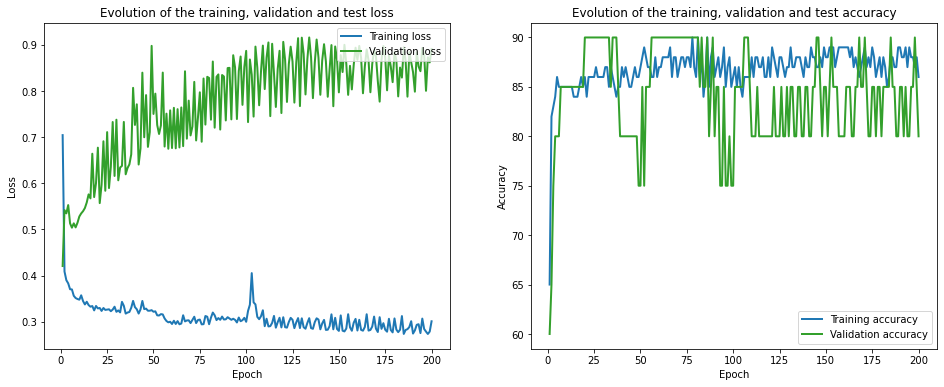

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 152.61it/s]


Initialization done!


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1110.96it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 1.34 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 1.77 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 2.57 train_acc: 30.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 2.96 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 2.61 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 1.75 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.58 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.51 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
val_loss = 0.53 val_acc = 55.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.2

Epoch 16 of 200, 50% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 60% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 70% 	 train_loss: 0.53 train_acc: 60.00% took: 0.00s
Epoch 16 of 200, 80% 	 train_loss: 0.28 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 90% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 100% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
val_loss = 0.63 val_acc = 85.00%
Snapshot saved at epoch 16.
Epoch 17 of 200, 10% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 20% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 30% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 40% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 50% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 60% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 70% 	 train_loss: 0.49 train_acc: 60.00% took: 0.00s
Epoch 17 of 200, 80% 	 tr

Epoch 31 of 200, 80% 	 train_loss: 0.22 train_acc: 100.00% took: 0.02s
Epoch 31 of 200, 90% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 31 of 200, 100% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
val_loss = 0.58 val_acc = 90.00%
Snapshot saved at epoch 31.
Epoch 32 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 32 of 200, 20% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 32 of 200, 30% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 32 of 200, 40% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
Epoch 32 of 200, 50% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 32 of 200, 60% 	 train_loss: 0.58 train_acc: 80.00% took: 0.00s
Epoch 32 of 200, 70% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 32 of 200, 80% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 32 of 200, 90% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 32 of 200, 100% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
val_loss = 0.60 val_acc 

Epoch 42 of 200, 80% 	 train_loss: 0.21 train_acc: 100.00% took: 0.02s
Epoch 42 of 200, 90% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 42 of 200, 100% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
val_loss = 0.70 val_acc = 85.00%
Snapshot saved at epoch 42.
Epoch 43 of 200, 10% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 43 of 200, 20% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 43 of 200, 30% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 43 of 200, 40% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 43 of 200, 50% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 43 of 200, 60% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 43 of 200, 70% 	 train_loss: 0.43 train_acc: 60.00% took: 0.00s
Epoch 43 of 200, 80% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 43 of 200, 90% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 43 of 200, 100% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
val_loss = 0.68 val_acc 

Epoch 53 of 200, 80% 	 train_loss: 0.25 train_acc: 100.00% took: 0.02s
Epoch 53 of 200, 90% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 53 of 200, 100% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
val_loss = 0.77 val_acc = 85.00%
Snapshot saved at epoch 53.
Epoch 54 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 54 of 200, 20% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 54 of 200, 30% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 54 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 54 of 200, 50% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 54 of 200, 60% 	 train_loss: 0.67 train_acc: 80.00% took: 0.00s
Epoch 54 of 200, 70% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 54 of 200, 80% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 54 of 200, 90% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 54 of 200, 100% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
val_loss = 0.76 val_acc 

val_loss = 0.79 val_acc = 85.00%
Snapshot saved at epoch 68.
Epoch 69 of 200, 10% 	 train_loss: 0.11 train_acc: 100.00% took: 0.01s
Epoch 69 of 200, 20% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 69 of 200, 30% 	 train_loss: 0.19 train_acc: 80.00% took: 0.00s
Epoch 69 of 200, 40% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 69 of 200, 50% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 69 of 200, 60% 	 train_loss: 0.70 train_acc: 80.00% took: 0.00s
Epoch 69 of 200, 70% 	 train_loss: 0.38 train_acc: 90.00% took: 0.02s
Epoch 69 of 200, 80% 	 train_loss: 0.28 train_acc: 100.00% took: 0.00s
Epoch 69 of 200, 90% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 69 of 200, 100% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
val_loss = 0.91 val_acc = 80.00%
Snapshot saved at epoch 69.
Epoch 70 of 200, 10% 	 train_loss: 0.11 train_acc: 100.00% took: 0.02s
Epoch 70 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 70 of 200, 30% 	 train_loss:

val_loss = 0.75 val_acc = 90.00%
Snapshot saved at epoch 84.
Epoch 85 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.01s
Epoch 85 of 200, 20% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 85 of 200, 30% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 85 of 200, 40% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 85 of 200, 50% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 85 of 200, 60% 	 train_loss: 0.88 train_acc: 80.00% took: 0.00s
Epoch 85 of 200, 70% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 85 of 200, 80% 	 train_loss: 0.32 train_acc: 100.00% took: 0.00s
Epoch 85 of 200, 90% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 85 of 200, 100% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
val_loss = 0.83 val_acc = 90.00%
Snapshot saved at epoch 85.
Epoch 86 of 200, 10% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 86 of 200, 20% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 86 of 200, 30% 	 train_loss: 

Epoch 100 of 200, 40% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 50% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 60% 	 train_loss: 0.73 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 70% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 80% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 100 of 200, 90% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 100% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
val_loss = 0.97 val_acc = 75.00%
Snapshot saved at epoch 100.
Epoch 101 of 200, 10% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 20% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 30% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 40% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 101 of 200, 60% 	 train_loss: 0.68 train_acc: 80.00% took: 0.00s
Epoch 101 of 

Epoch 111 of 200, 40% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 60% 	 train_loss: 0.75 train_acc: 80.00% took: 0.00s
Epoch 111 of 200, 70% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 111 of 200, 80% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 90% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 111 of 200, 100% 	 train_loss: 0.17 train_acc: 80.00% took: 0.00s
val_loss = 0.90 val_acc = 85.00%
Snapshot saved at epoch 111.
Epoch 112 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 112 of 200, 20% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 112 of 200, 30% 	 train_loss: 0.19 train_acc: 80.00% took: 0.00s
Epoch 112 of 200, 40% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 112 of 200, 50% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 112 of 200, 60% 	 train_loss: 0.72 train_acc: 80.00% took: 0.00s
Epoch 112 of

Epoch 126 of 200, 100% 	 train_loss: 0.16 train_acc: 90.00% took: 0.02s
val_loss = 0.93 val_acc = 85.00%
Snapshot saved at epoch 126.
Epoch 127 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 127 of 200, 20% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 127 of 200, 30% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 127 of 200, 40% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 127 of 200, 50% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 127 of 200, 60% 	 train_loss: 0.70 train_acc: 80.00% took: 0.00s
Epoch 127 of 200, 70% 	 train_loss: 0.43 train_acc: 60.00% took: 0.00s
Epoch 127 of 200, 80% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 127 of 200, 90% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 127 of 200, 100% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
val_loss = 0.97 val_acc = 85.00%
Snapshot saved at epoch 127.
Epoch 128 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 128 of 200, 2

Epoch 137 of 200, 80% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 137 of 200, 90% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 137 of 200, 100% 	 train_loss: 0.15 train_acc: 80.00% took: 0.00s
val_loss = 0.98 val_acc = 85.00%
Snapshot saved at epoch 137.
Epoch 138 of 200, 10% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 138 of 200, 20% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 138 of 200, 30% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 138 of 200, 40% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 138 of 200, 50% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 138 of 200, 60% 	 train_loss: 0.70 train_acc: 80.00% took: 0.00s
Epoch 138 of 200, 70% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 138 of 200, 80% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 138 of 200, 90% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 138 of 200, 100% 	 train_loss: 0.15 train_acc: 90.00% took: 0.01s
val_loss =

Epoch 148 of 200, 30% 	 train_loss: 0.20 train_acc: 80.00% took: 0.01s
Epoch 148 of 200, 40% 	 train_loss: 0.19 train_acc: 90.00% took: 0.01s
Epoch 148 of 200, 50% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 148 of 200, 60% 	 train_loss: 0.74 train_acc: 80.00% took: 0.00s
Epoch 148 of 200, 70% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 148 of 200, 80% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 148 of 200, 90% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 148 of 200, 100% 	 train_loss: 0.15 train_acc: 80.00% took: 0.00s
val_loss = 0.97 val_acc = 85.00%
Snapshot saved at epoch 148.
Epoch 149 of 200, 10% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 149 of 200, 20% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 149 of 200, 30% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 149 of 200, 40% 	 train_loss: 0.19 train_acc: 90.00% took: 0.01s
Epoch 149 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 149 of

Epoch 158 of 200, 100% 	 train_loss: 0.14 train_acc: 90.00% took: 0.02s
val_loss = 1.00 val_acc = 80.00%
Snapshot saved at epoch 158.
Epoch 159 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 159 of 200, 20% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 159 of 200, 30% 	 train_loss: 0.19 train_acc: 80.00% took: 0.00s
Epoch 159 of 200, 40% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 159 of 200, 50% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 159 of 200, 60% 	 train_loss: 0.73 train_acc: 80.00% took: 0.00s
Epoch 159 of 200, 70% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 159 of 200, 80% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 159 of 200, 90% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 159 of 200, 100% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
val_loss = 1.02 val_acc = 85.00%
Snapshot saved at epoch 159.
Epoch 160 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 160 of 200, 2

Epoch 169 of 200, 60% 	 train_loss: 0.74 train_acc: 80.00% took: 0.01s
Epoch 169 of 200, 70% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 169 of 200, 80% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 169 of 200, 90% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 169 of 200, 100% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
val_loss = 1.03 val_acc = 85.00%
Snapshot saved at epoch 169.
Epoch 170 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 170 of 200, 20% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 170 of 200, 30% 	 train_loss: 0.19 train_acc: 80.00% took: 0.00s
Epoch 170 of 200, 40% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 170 of 200, 50% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 170 of 200, 60% 	 train_loss: 0.73 train_acc: 80.00% took: 0.00s
Epoch 170 of 200, 70% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 170 of 200, 80% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 170 o

Epoch 185 of 200, 80% 	 train_loss: 0.16 train_acc: 100.00% took: 0.02s
Epoch 185 of 200, 90% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 185 of 200, 100% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
val_loss = 0.98 val_acc = 85.00%
Snapshot saved at epoch 185.
Epoch 186 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 186 of 200, 20% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 186 of 200, 30% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 186 of 200, 40% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 186 of 200, 50% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 186 of 200, 60% 	 train_loss: 0.75 train_acc: 80.00% took: 0.00s
Epoch 186 of 200, 70% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 186 of 200, 80% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 186 of 200, 90% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 186 of 200, 100% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
val_loss =

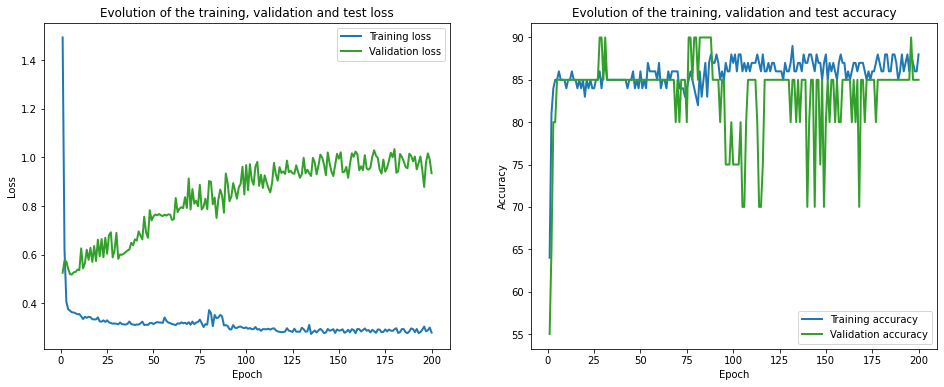

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 133.57it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1054.80it/s]

Finished computing p-values for 500 test points.

Starting repetition 41 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.62 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.80 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 3.28 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 1.05 train_acc: 10.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.77 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 1.64 train_acc: 30.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 1.47 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
val_loss = 0.37 val_acc = 75.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.

Epoch 11 of 200, 100% 	 train_loss: 0.27 train_acc: 100.00% took: 0.02s
val_loss = 0.38 val_acc = 85.00%
Snapshot saved at epoch 11.
Epoch 12 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 20% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 30% 	 train_loss: 0.40 train_acc: 70.00% took: 0.00s
Epoch 12 of 200, 40% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 12 of 200, 50% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 60% 	 train_loss: 0.86 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 70% 	 train_loss: 1.63 train_acc: 30.00% took: 0.00s
Epoch 12 of 200, 80% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 90% 	 train_loss: 0.39 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 100% 	 train_loss: 0.26 train_acc: 100.00% took: 0.00s
val_loss = 0.36 val_acc = 90.00%
Snapshot saved at epoch 12.
Epoch 13 of 200, 10% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 13 of 200, 20% 	 train_los

val_loss = 0.26 val_acc = 95.00%
Snapshot saved at epoch 22.
Epoch 23 of 200, 10% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 23 of 200, 20% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 23 of 200, 30% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 23 of 200, 40% 	 train_loss: 0.65 train_acc: 70.00% took: 0.00s
Epoch 23 of 200, 50% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 23 of 200, 60% 	 train_loss: 0.72 train_acc: 80.00% took: 0.00s
Epoch 23 of 200, 70% 	 train_loss: 1.19 train_acc: 80.00% took: 0.00s
Epoch 23 of 200, 80% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 23 of 200, 90% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 23 of 200, 100% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
val_loss = 0.25 val_acc = 90.00%
Snapshot saved at epoch 23.
Epoch 24 of 200, 10% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 24 of 200, 20% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 24 of 200, 30% 	 train_loss:

val_loss = 0.24 val_acc = 95.00%
Snapshot saved at epoch 33.
Epoch 34 of 200, 10% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 34 of 200, 20% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 34 of 200, 30% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 34 of 200, 40% 	 train_loss: 0.60 train_acc: 70.00% took: 0.00s
Epoch 34 of 200, 50% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 34 of 200, 60% 	 train_loss: 0.67 train_acc: 80.00% took: 0.00s
Epoch 34 of 200, 70% 	 train_loss: 1.19 train_acc: 70.00% took: 0.00s
Epoch 34 of 200, 80% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 34 of 200, 90% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 34 of 200, 100% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
val_loss = 0.24 val_acc = 95.00%
Snapshot saved at epoch 34.
Epoch 35 of 200, 10% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 35 of 200, 20% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 35 of 200, 30% 	 train_loss:

Epoch 44 of 200, 80% 	 train_loss: 0.48 train_acc: 70.00% took: 0.02s
Epoch 44 of 200, 90% 	 train_loss: 0.27 train_acc: 100.00% took: 0.01s
Epoch 44 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 0.24 val_acc = 95.00%
Snapshot saved at epoch 44.
Epoch 45 of 200, 10% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 45 of 200, 20% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 45 of 200, 30% 	 train_loss: 0.37 train_acc: 70.00% took: 0.00s
Epoch 45 of 200, 40% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 45 of 200, 50% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 45 of 200, 60% 	 train_loss: 0.72 train_acc: 80.00% took: 0.00s
Epoch 45 of 200, 70% 	 train_loss: 1.20 train_acc: 50.00% took: 0.00s
Epoch 45 of 200, 80% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 45 of 200, 90% 	 train_loss: 0.26 train_acc: 100.00% took: 0.00s
Epoch 45 of 200, 100% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
val_loss = 0.23 val_ac

Epoch 59 of 200, 70% 	 train_loss: 1.14 train_acc: 60.00% took: 0.00s
Epoch 59 of 200, 80% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 59 of 200, 90% 	 train_loss: 0.26 train_acc: 100.00% took: 0.00s
Epoch 59 of 200, 100% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
val_loss = 0.22 val_acc = 95.00%
Snapshot saved at epoch 59.
Epoch 60 of 200, 10% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 60 of 200, 20% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 60 of 200, 30% 	 train_loss: 0.38 train_acc: 70.00% took: 0.00s
Epoch 60 of 200, 40% 	 train_loss: 0.53 train_acc: 60.00% took: 0.00s
Epoch 60 of 200, 50% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 60 of 200, 60% 	 train_loss: 0.76 train_acc: 80.00% took: 0.00s
Epoch 60 of 200, 70% 	 train_loss: 1.13 train_acc: 60.00% took: 0.00s
Epoch 60 of 200, 80% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 60 of 200, 90% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 60 of 200, 100% 	 t

Epoch 75 of 200, 20% 	 train_loss: 0.23 train_acc: 90.00% took: 0.01s
Epoch 75 of 200, 30% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 75 of 200, 40% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 75 of 200, 50% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 75 of 200, 60% 	 train_loss: 0.79 train_acc: 80.00% took: 0.00s
Epoch 75 of 200, 70% 	 train_loss: 1.06 train_acc: 60.00% took: 0.00s
Epoch 75 of 200, 80% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 75 of 200, 90% 	 train_loss: 0.26 train_acc: 100.00% took: 0.00s
Epoch 75 of 200, 100% 	 train_loss: 0.11 train_acc: 100.00% took: 0.02s
val_loss = 0.21 val_acc = 95.00%
Snapshot saved at epoch 75.
Epoch 76 of 200, 10% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 76 of 200, 20% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 76 of 200, 30% 	 train_loss: 0.36 train_acc: 70.00% took: 0.02s
Epoch 76 of 200, 40% 	 train_loss: 0.52 train_acc: 60.00% took: 0.00s
Epoch 76 of 200, 50% 	 tr

Epoch 90 of 200, 70% 	 train_loss: 0.92 train_acc: 60.00% took: 0.00s
Epoch 90 of 200, 80% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 90 of 200, 90% 	 train_loss: 0.25 train_acc: 100.00% took: 0.00s
Epoch 90 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 0.22 val_acc = 85.00%
Snapshot saved at epoch 90.
Epoch 91 of 200, 10% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 91 of 200, 20% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 91 of 200, 30% 	 train_loss: 0.36 train_acc: 70.00% took: 0.00s
Epoch 91 of 200, 40% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 91 of 200, 50% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 91 of 200, 60% 	 train_loss: 0.78 train_acc: 80.00% took: 0.00s
Epoch 91 of 200, 70% 	 train_loss: 0.93 train_acc: 70.00% took: 0.00s
Epoch 91 of 200, 80% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 91 of 200, 90% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 91 of 200, 100% 	 

val_loss = 0.19 val_acc = 95.00%
Snapshot saved at epoch 101.
Epoch 102 of 200, 10% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 102 of 200, 20% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 102 of 200, 30% 	 train_loss: 0.35 train_acc: 70.00% took: 0.00s
Epoch 102 of 200, 40% 	 train_loss: 0.48 train_acc: 60.00% took: 0.00s
Epoch 102 of 200, 50% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 102 of 200, 60% 	 train_loss: 0.81 train_acc: 80.00% took: 0.00s
Epoch 102 of 200, 70% 	 train_loss: 0.92 train_acc: 60.00% took: 0.00s
Epoch 102 of 200, 80% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 102 of 200, 90% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 102 of 200, 100% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
val_loss = 0.19 val_acc = 95.00%
Snapshot saved at epoch 102.
Epoch 103 of 200, 10% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 103 of 200, 20% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 103 of 200, 30%

Epoch 118 of 200, 20% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 118 of 200, 30% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 118 of 200, 40% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 118 of 200, 50% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 118 of 200, 60% 	 train_loss: 0.89 train_acc: 80.00% took: 0.00s
Epoch 118 of 200, 70% 	 train_loss: 0.99 train_acc: 60.00% took: 0.00s
Epoch 118 of 200, 80% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 118 of 200, 90% 	 train_loss: 0.25 train_acc: 100.00% took: 0.00s
Epoch 118 of 200, 100% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
val_loss = 0.24 val_acc = 85.00%
Snapshot saved at epoch 118.
Epoch 119 of 200, 10% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 119 of 200, 20% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 119 of 200, 30% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 119 of 200, 40% 	 train_loss: 0.46 train_acc: 60.00% took: 0.00s
Epoch 119 o

val_loss = 0.26 val_acc = 85.00%
Snapshot saved at epoch 128.
Epoch 129 of 200, 10% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 129 of 200, 20% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 129 of 200, 30% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 129 of 200, 40% 	 train_loss: 0.48 train_acc: 60.00% took: 0.00s
Epoch 129 of 200, 50% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 129 of 200, 60% 	 train_loss: 0.82 train_acc: 80.00% took: 0.00s
Epoch 129 of 200, 70% 	 train_loss: 1.05 train_acc: 60.00% took: 0.00s
Epoch 129 of 200, 80% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 129 of 200, 90% 	 train_loss: 0.27 train_acc: 100.00% took: 0.00s
Epoch 129 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 0.24 val_acc = 85.00%
Snapshot saved at epoch 129.
Epoch 130 of 200, 10% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 130 of 200, 20% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 130 of 200, 30

Epoch 144 of 200, 80% 	 train_loss: 0.37 train_acc: 80.00% took: 0.02s
Epoch 144 of 200, 90% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 144 of 200, 100% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
val_loss = 0.27 val_acc = 85.00%
Snapshot saved at epoch 144.
Epoch 145 of 200, 10% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 145 of 200, 20% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 145 of 200, 30% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 145 of 200, 40% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 145 of 200, 50% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 145 of 200, 60% 	 train_loss: 0.83 train_acc: 80.00% took: 0.00s
Epoch 145 of 200, 70% 	 train_loss: 0.85 train_acc: 70.00% took: 0.00s
Epoch 145 of 200, 80% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 145 of 200, 90% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 145 of 200, 100% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
val_loss 

val_loss = 0.31 val_acc = 85.00%
Snapshot saved at epoch 159.
Epoch 160 of 200, 10% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 160 of 200, 20% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 160 of 200, 30% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 160 of 200, 40% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 160 of 200, 50% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 160 of 200, 60% 	 train_loss: 0.84 train_acc: 70.00% took: 0.00s
Epoch 160 of 200, 70% 	 train_loss: 0.88 train_acc: 60.00% took: 0.00s
Epoch 160 of 200, 80% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 160 of 200, 90% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 160 of 200, 100% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
val_loss = 0.32 val_acc = 85.00%
Snapshot saved at epoch 160.
Epoch 161 of 200, 10% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 161 of 200, 20% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 161 of 200, 30%

Epoch 175 of 200, 80% 	 train_loss: 0.37 train_acc: 80.00% took: 0.02s
Epoch 175 of 200, 90% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 175 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 0.43 val_acc = 80.00%
Snapshot saved at epoch 175.
Epoch 176 of 200, 10% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 176 of 200, 20% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 176 of 200, 30% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 176 of 200, 40% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 176 of 200, 50% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 176 of 200, 60% 	 train_loss: 0.81 train_acc: 90.00% took: 0.00s
Epoch 176 of 200, 70% 	 train_loss: 0.99 train_acc: 60.00% took: 0.00s
Epoch 176 of 200, 80% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 176 of 200, 90% 	 train_loss: 0.28 train_acc: 100.00% took: 0.00s
Epoch 176 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss

Epoch 187 of 200, 60% 	 train_loss: 0.82 train_acc: 80.00% took: 0.00s
Epoch 187 of 200, 70% 	 train_loss: 0.98 train_acc: 60.00% took: 0.01s
Epoch 187 of 200, 80% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 187 of 200, 90% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 187 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 0.44 val_acc = 85.00%
Snapshot saved at epoch 187.
Epoch 188 of 200, 10% 	 train_loss: 0.36 train_acc: 70.00% took: 0.00s
Epoch 188 of 200, 20% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 188 of 200, 30% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 188 of 200, 40% 	 train_loss: 0.48 train_acc: 60.00% took: 0.00s
Epoch 188 of 200, 50% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 188 of 200, 60% 	 train_loss: 0.83 train_acc: 70.00% took: 0.00s
Epoch 188 of 200, 70% 	 train_loss: 0.96 train_acc: 60.00% took: 0.00s
Epoch 188 of 200, 80% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 188 o

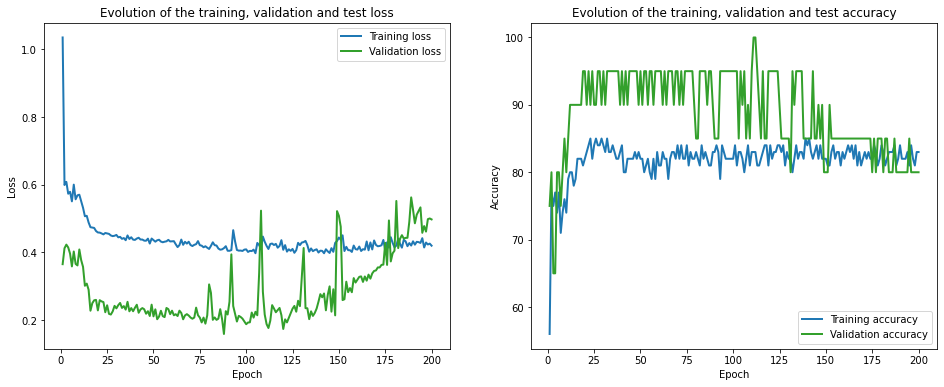

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 151.61it/s]


Initialization done!


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1437.30it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 1.54 train_acc: 20.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 3.85 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 1.11 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 1.06 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 1.46 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 1.78 train_acc: 30.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 5.86 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.18 train_acc: 80.00% took: 0.00s
val_loss = 0.32 val_acc = 75.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0

Epoch 16 of 200, 70% 	 train_loss: 1.14 train_acc: 50.00% took: 0.02s
Epoch 16 of 200, 80% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 90% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 0.23 val_acc = 95.00%
Snapshot saved at epoch 16.
Epoch 17 of 200, 10% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 20% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 30% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 17 of 200, 40% 	 train_loss: 0.61 train_acc: 70.00% took: 0.00s
Epoch 17 of 200, 50% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 60% 	 train_loss: 0.71 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 70% 	 train_loss: 1.20 train_acc: 70.00% took: 0.00s
Epoch 17 of 200, 80% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 90% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 100% 	 t

Epoch 32 of 200, 40% 	 train_loss: 0.58 train_acc: 70.00% took: 0.01s
Epoch 32 of 200, 50% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 32 of 200, 60% 	 train_loss: 0.70 train_acc: 80.00% took: 0.00s
Epoch 32 of 200, 70% 	 train_loss: 1.04 train_acc: 80.00% took: 0.00s
Epoch 32 of 200, 80% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 32 of 200, 90% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 32 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.23 val_acc = 95.00%
Snapshot saved at epoch 32.
Epoch 33 of 200, 10% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 33 of 200, 20% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 33 of 200, 30% 	 train_loss: 0.40 train_acc: 70.00% took: 0.01s
Epoch 33 of 200, 40% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 33 of 200, 50% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 33 of 200, 60% 	 train_loss: 0.71 train_acc: 80.00% took: 0.00s
Epoch 33 of 200, 70% 	 t

Epoch 43 of 200, 20% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 43 of 200, 30% 	 train_loss: 0.38 train_acc: 70.00% took: 0.00s
Epoch 43 of 200, 40% 	 train_loss: 0.53 train_acc: 60.00% took: 0.00s
Epoch 43 of 200, 50% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 43 of 200, 60% 	 train_loss: 0.72 train_acc: 80.00% took: 0.00s
Epoch 43 of 200, 70% 	 train_loss: 1.07 train_acc: 60.00% took: 0.00s
Epoch 43 of 200, 80% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 43 of 200, 90% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 43 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 0.28 val_acc = 85.00%
Snapshot saved at epoch 43.
Epoch 44 of 200, 10% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 44 of 200, 20% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 44 of 200, 30% 	 train_loss: 0.35 train_acc: 70.00% took: 0.00s
Epoch 44 of 200, 40% 	 train_loss: 0.52 train_acc: 60.00% took: 0.00s
Epoch 44 of 200, 50% 	 tra

Epoch 58 of 200, 80% 	 train_loss: 0.46 train_acc: 70.00% took: 0.02s
Epoch 58 of 200, 90% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 100% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
val_loss = 0.29 val_acc = 85.00%
Snapshot saved at epoch 58.
Epoch 59 of 200, 10% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 59 of 200, 20% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 59 of 200, 30% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 59 of 200, 40% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 59 of 200, 50% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 59 of 200, 60% 	 train_loss: 0.75 train_acc: 80.00% took: 0.00s
Epoch 59 of 200, 70% 	 train_loss: 1.01 train_acc: 60.00% took: 0.00s
Epoch 59 of 200, 80% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 59 of 200, 90% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 59 of 200, 100% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
val_loss = 0.26 val_acc

Epoch 74 of 200, 20% 	 train_loss: 0.26 train_acc: 90.00% took: 0.01s
Epoch 74 of 200, 30% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 74 of 200, 40% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 74 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 74 of 200, 60% 	 train_loss: 0.79 train_acc: 70.00% took: 0.00s
Epoch 74 of 200, 70% 	 train_loss: 1.09 train_acc: 70.00% took: 0.00s
Epoch 74 of 200, 80% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 74 of 200, 90% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 74 of 200, 100% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
val_loss = 0.37 val_acc = 85.00%
Snapshot saved at epoch 74.
Epoch 75 of 200, 10% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 75 of 200, 20% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 75 of 200, 30% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 75 of 200, 40% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 75 of 200, 50% 	 tra

Epoch 89 of 200, 90% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 89 of 200, 100% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
val_loss = 0.32 val_acc = 85.00%
Snapshot saved at epoch 89.
Epoch 90 of 200, 10% 	 train_loss: 0.31 train_acc: 70.00% took: 0.00s
Epoch 90 of 200, 20% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 90 of 200, 30% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 90 of 200, 40% 	 train_loss: 0.55 train_acc: 60.00% took: 0.00s
Epoch 90 of 200, 50% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 90 of 200, 60% 	 train_loss: 0.83 train_acc: 70.00% took: 0.00s
Epoch 90 of 200, 70% 	 train_loss: 0.97 train_acc: 60.00% took: 0.00s
Epoch 90 of 200, 80% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 90 of 200, 90% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 90 of 200, 100% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
val_loss = 0.35 val_acc = 85.00%
Snapshot saved at epoch 90.
Epoch 91 of 200, 10% 	 train_lo

Epoch 105 of 200, 90% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 105 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.35 val_acc = 80.00%
Snapshot saved at epoch 105.
Epoch 106 of 200, 10% 	 train_loss: 0.35 train_acc: 70.00% took: 0.00s
Epoch 106 of 200, 20% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 106 of 200, 30% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 106 of 200, 40% 	 train_loss: 0.50 train_acc: 60.00% took: 0.00s
Epoch 106 of 200, 50% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 106 of 200, 60% 	 train_loss: 0.79 train_acc: 80.00% took: 0.00s
Epoch 106 of 200, 70% 	 train_loss: 0.97 train_acc: 60.00% took: 0.00s
Epoch 106 of 200, 80% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 106 of 200, 90% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 106 of 200, 100% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
val_loss = 0.30 val_acc = 80.00%
Snapshot saved at epoch 106.
Epoch 107 of 200,

val_loss = 0.31 val_acc = 85.00%
Snapshot saved at epoch 120.
Epoch 121 of 200, 10% 	 train_loss: 0.33 train_acc: 70.00% took: 0.00s
Epoch 121 of 200, 20% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 121 of 200, 30% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 121 of 200, 40% 	 train_loss: 0.52 train_acc: 60.00% took: 0.00s
Epoch 121 of 200, 50% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 121 of 200, 60% 	 train_loss: 0.83 train_acc: 70.00% took: 0.00s
Epoch 121 of 200, 70% 	 train_loss: 0.93 train_acc: 60.00% took: 0.00s
Epoch 121 of 200, 80% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 121 of 200, 90% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 121 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
val_loss = 0.30 val_acc = 85.00%
Snapshot saved at epoch 121.
Epoch 122 of 200, 10% 	 train_loss: 0.33 train_acc: 70.00% took: 0.00s
Epoch 122 of 200, 20% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 122 of 200, 30

Epoch 136 of 200, 70% 	 train_loss: 1.06 train_acc: 60.00% took: 0.00s
Epoch 136 of 200, 80% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 136 of 200, 90% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 136 of 200, 100% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
val_loss = 0.34 val_acc = 85.00%
Snapshot saved at epoch 136.
Epoch 137 of 200, 10% 	 train_loss: 0.40 train_acc: 70.00% took: 0.00s
Epoch 137 of 200, 20% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 137 of 200, 30% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 137 of 200, 40% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 137 of 200, 50% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 137 of 200, 60% 	 train_loss: 0.78 train_acc: 90.00% took: 0.00s
Epoch 137 of 200, 70% 	 train_loss: 0.97 train_acc: 60.00% took: 0.00s
Epoch 137 of 200, 80% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 137 of 200, 90% 	 train_loss: 0.25 train_acc: 100.00% took: 0.00s
Epoch 137 o

Epoch 147 of 200, 100% 	 train_loss: 0.27 train_acc: 90.00% took: 0.01s
val_loss = 0.33 val_acc = 85.00%
Snapshot saved at epoch 147.
Epoch 148 of 200, 10% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 148 of 200, 20% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 148 of 200, 30% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 148 of 200, 40% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 148 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 148 of 200, 60% 	 train_loss: 0.81 train_acc: 90.00% took: 0.00s
Epoch 148 of 200, 70% 	 train_loss: 0.96 train_acc: 60.00% took: 0.00s
Epoch 148 of 200, 80% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 148 of 200, 90% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 148 of 200, 100% 	 train_loss: 0.27 train_acc: 100.00% took: 0.00s
val_loss = 0.27 val_acc = 90.00%
Snapshot saved at epoch 148.
Epoch 149 of 200, 10% 	 train_loss: 0.34 train_acc: 70.00% took: 0.00s
Epoch 149 of 200, 20

Epoch 162 of 200, 10% 	 train_loss: 0.29 train_acc: 80.00% took: 0.02s
Epoch 162 of 200, 20% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 162 of 200, 30% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 162 of 200, 40% 	 train_loss: 0.53 train_acc: 60.00% took: 0.00s
Epoch 162 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 162 of 200, 60% 	 train_loss: 0.81 train_acc: 70.00% took: 0.00s
Epoch 162 of 200, 70% 	 train_loss: 0.91 train_acc: 70.00% took: 0.00s
Epoch 162 of 200, 80% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 162 of 200, 90% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 162 of 200, 100% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
val_loss = 0.26 val_acc = 90.00%
Snapshot saved at epoch 162.
Epoch 163 of 200, 10% 	 train_loss: 0.34 train_acc: 70.00% took: 0.00s
Epoch 163 of 200, 20% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 163 of 200, 30% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 163 of 

Epoch 172 of 200, 90% 	 train_loss: 0.20 train_acc: 100.00% took: 0.01s
Epoch 172 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss = 0.24 val_acc = 90.00%
Snapshot saved at epoch 172.
Epoch 173 of 200, 10% 	 train_loss: 0.33 train_acc: 70.00% took: 0.00s
Epoch 173 of 200, 20% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 173 of 200, 30% 	 train_loss: 0.31 train_acc: 80.00% took: 0.01s
Epoch 173 of 200, 40% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
Epoch 173 of 200, 50% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 173 of 200, 60% 	 train_loss: 0.81 train_acc: 80.00% took: 0.00s
Epoch 173 of 200, 70% 	 train_loss: 0.90 train_acc: 70.00% took: 0.00s
Epoch 173 of 200, 80% 	 train_loss: 0.41 train_acc: 80.00% took: 0.02s
Epoch 173 of 200, 90% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 173 of 200, 100% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
val_loss = 0.23 val_acc = 95.00%
Snapshot saved at epoch 173.
Epoch 174 of 200, 1

Epoch 183 of 200, 80% 	 train_loss: 0.48 train_acc: 70.00% took: 0.01s
Epoch 183 of 200, 90% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 183 of 200, 100% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
val_loss = 0.26 val_acc = 95.00%
Snapshot saved at epoch 183.
Epoch 184 of 200, 10% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
Epoch 184 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 184 of 200, 30% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 184 of 200, 40% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 184 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.01s
Epoch 184 of 200, 60% 	 train_loss: 0.79 train_acc: 80.00% took: 0.00s
Epoch 184 of 200, 70% 	 train_loss: 0.93 train_acc: 70.00% took: 0.00s
Epoch 184 of 200, 80% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 184 of 200, 90% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 184 of 200, 100% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
val_loss = 0.

Epoch 195 of 200, 40% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 195 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 195 of 200, 60% 	 train_loss: 0.80 train_acc: 90.00% took: 0.00s
Epoch 195 of 200, 70% 	 train_loss: 0.84 train_acc: 70.00% took: 0.00s
Epoch 195 of 200, 80% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 195 of 200, 90% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 195 of 200, 100% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
val_loss = 0.19 val_acc = 95.00%
Snapshot saved at epoch 195.
Epoch 196 of 200, 10% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 20% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 196 of 200, 30% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 40% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 50% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 196 of 200, 60% 	 train_loss: 0.79 train_acc: 80.00% took: 0.00s
Epoch 196 of 2

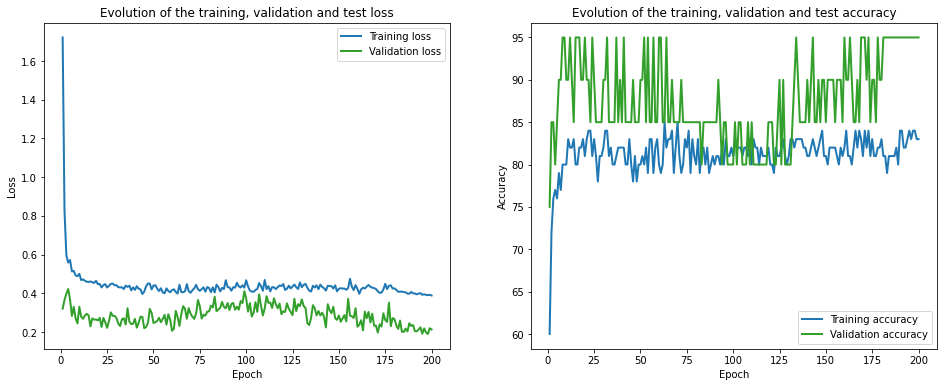

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 146.62it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|███████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 924.33it/s]

Finished computing p-values for 500 test points.

Starting repetition 42 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 6.09 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.83 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.90 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.86 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.78 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
val_loss = 0.52 val_acc = 70.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0

Epoch 16 of 200, 50% 	 train_loss: 0.27 train_acc: 80.00% took: 0.01s
Epoch 16 of 200, 60% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 70% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 80% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 90% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 100% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
val_loss = 0.43 val_acc = 80.00%
Snapshot saved at epoch 16.
Epoch 17 of 200, 10% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 20% 	 train_loss: 0.52 train_acc: 70.00% took: 0.00s
Epoch 17 of 200, 30% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 40% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 50% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 60% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 70% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 80% 	 t

Epoch 27 of 200, 50% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 60% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 70% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 90% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 0.54 val_acc = 80.00%
Snapshot saved at epoch 27.
Epoch 28 of 200, 10% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 20% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 28 of 200, 30% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 40% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 50% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 60% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 70% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 80% 	

Epoch 43 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.02s
Epoch 43 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 43 of 200, 90% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 43 of 200, 100% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
val_loss = 0.61 val_acc = 80.00%
Snapshot saved at epoch 43.
Epoch 44 of 200, 10% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 44 of 200, 20% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 44 of 200, 30% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 44 of 200, 40% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 44 of 200, 50% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 44 of 200, 60% 	 train_loss: 0.14 train_acc: 100.00% took: 0.02s
Epoch 44 of 200, 70% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 44 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 44 of 200, 90% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 44 of 200, 100% 

Epoch 59 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.02s
Epoch 59 of 200, 60% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 59 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 59 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 59 of 200, 90% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 59 of 200, 100% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
val_loss = 0.63 val_acc = 80.00%
Snapshot saved at epoch 59.
Epoch 60 of 200, 10% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 60 of 200, 20% 	 train_loss: 0.52 train_acc: 70.00% took: 0.00s
Epoch 60 of 200, 30% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 60 of 200, 40% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 60 of 200, 50% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 60 of 200, 60% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 60 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 60 of 200, 80% 	

val_loss = 0.60 val_acc = 80.00%
Snapshot saved at epoch 74.
Epoch 75 of 200, 10% 	 train_loss: 0.45 train_acc: 80.00% took: 0.01s
Epoch 75 of 200, 20% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
Epoch 75 of 200, 30% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 75 of 200, 40% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 75 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 75 of 200, 60% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 75 of 200, 70% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 75 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 75 of 200, 90% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 75 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 0.63 val_acc = 80.00%
Snapshot saved at epoch 75.
Epoch 76 of 200, 10% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 76 of 200, 20% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 76 of 200, 30% 	 train_loss

Snapshot saved at epoch 89.
Epoch 90 of 200, 10% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 90 of 200, 20% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 90 of 200, 30% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 90 of 200, 40% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 90 of 200, 50% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 90 of 200, 60% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 90 of 200, 70% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 90 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 90 of 200, 90% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 90 of 200, 100% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
val_loss = 0.66 val_acc = 80.00%
Snapshot saved at epoch 90.
Epoch 91 of 200, 10% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 91 of 200, 20% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 91 of 200, 30% 	 train_loss: 0.42 train_acc: 80.00% took: 0.

Epoch 101 of 200, 70% 	 train_loss: 0.08 train_acc: 100.00% took: 0.02s
Epoch 101 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 101 of 200, 90% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 101 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 0.72 val_acc = 80.00%
Snapshot saved at epoch 101.
Epoch 102 of 200, 10% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 102 of 200, 20% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 102 of 200, 30% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 102 of 200, 40% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 102 of 200, 50% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 102 of 200, 60% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 102 of 200, 70% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 102 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 102 of 200, 90% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 10

Epoch 116 of 200, 60% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 116 of 200, 70% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 116 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 116 of 200, 90% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 116 of 200, 100% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
val_loss = 0.80 val_acc = 80.00%
Snapshot saved at epoch 116.
Epoch 117 of 200, 10% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 117 of 200, 20% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 117 of 200, 30% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 117 of 200, 40% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 117 of 200, 50% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 117 of 200, 60% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 117 of 200, 70% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 117 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 1

Epoch 132 of 200, 10% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 132 of 200, 20% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 132 of 200, 30% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 132 of 200, 40% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 132 of 200, 50% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 132 of 200, 60% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 132 of 200, 70% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 132 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 132 of 200, 90% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 132 of 200, 100% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
val_loss = 0.82 val_acc = 80.00%
Snapshot saved at epoch 132.
Epoch 133 of 200, 10% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 133 of 200, 20% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 133 of 200, 30% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 133 

Epoch 142 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.02s
Epoch 142 of 200, 90% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 142 of 200, 100% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
val_loss = 0.85 val_acc = 80.00%
Snapshot saved at epoch 142.
Epoch 143 of 200, 10% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 143 of 200, 20% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 143 of 200, 30% 	 train_loss: 0.45 train_acc: 80.00% took: 0.02s
Epoch 143 of 200, 40% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 143 of 200, 50% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 143 of 200, 60% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 143 of 200, 70% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 143 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 143 of 200, 90% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 143 of 200, 100% 	 train_loss: 0.07 train_acc: 100.00% took: 0.01s
val_los

val_loss = 0.88 val_acc = 80.00%
Snapshot saved at epoch 157.
Epoch 158 of 200, 10% 	 train_loss: 0.41 train_acc: 80.00% took: 0.01s
Epoch 158 of 200, 20% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 158 of 200, 30% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 158 of 200, 40% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 158 of 200, 50% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 158 of 200, 60% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 158 of 200, 70% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 158 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 158 of 200, 90% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 158 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 0.86 val_acc = 80.00%
Snapshot saved at epoch 158.
Epoch 159 of 200, 10% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 159 of 200, 20% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 159 of 200, 

Epoch 169 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 169 of 200, 50% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 169 of 200, 60% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 169 of 200, 70% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 169 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 169 of 200, 90% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 169 of 200, 100% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
val_loss = 0.91 val_acc = 80.00%
Snapshot saved at epoch 169.
Epoch 170 of 200, 10% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 170 of 200, 20% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 170 of 200, 30% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 170 of 200, 40% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 170 of 200, 50% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 170 of 200, 60% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 1

Epoch 183 of 200, 90% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 183 of 200, 100% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
val_loss = 0.99 val_acc = 80.00%
Snapshot saved at epoch 183.
Epoch 184 of 200, 10% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 184 of 200, 20% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 184 of 200, 30% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 184 of 200, 40% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 184 of 200, 50% 	 train_loss: 0.13 train_acc: 100.00% took: 0.01s
Epoch 184 of 200, 60% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 184 of 200, 70% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 184 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 184 of 200, 90% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 184 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.85 val_acc = 80.00%
Snapshot saved at epoch 184.
Epoch 185 of 200

val_loss = 1.02 val_acc = 80.00%
Snapshot saved at epoch 198.
Epoch 199 of 200, 10% 	 train_loss: 0.40 train_acc: 80.00% took: 0.01s
Epoch 199 of 200, 20% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 199 of 200, 30% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 199 of 200, 40% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 199 of 200, 50% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 199 of 200, 60% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 199 of 200, 70% 	 train_loss: 0.09 train_acc: 100.00% took: 0.02s
Epoch 199 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 199 of 200, 90% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 199 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 0.84 val_acc = 80.00%
Snapshot saved at epoch 199.
Epoch 200 of 200, 10% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 200 of 200, 20% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 200 of 200, 

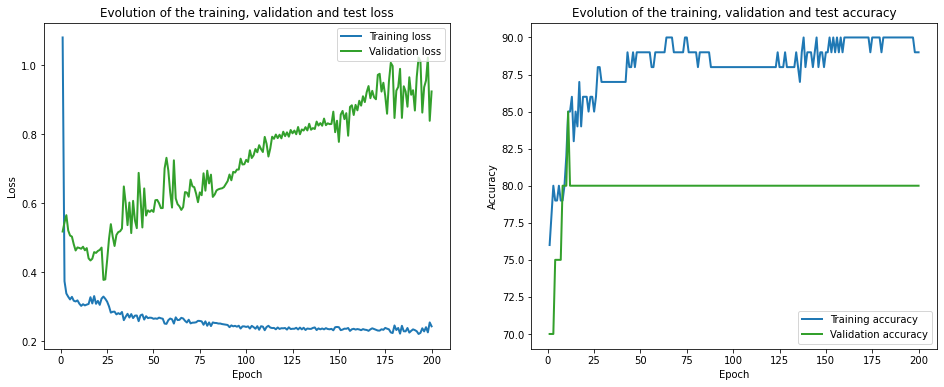

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 147.49it/s]


Initialization done!


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1017.25it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 1.84 train_acc: 20.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 22.45 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 4.65 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 1.92 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.53 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
val_loss = 0.58 val_acc = 85.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.71 train_acc: 70.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss

Epoch 16 of 200, 60% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 70% 	 train_loss: 0.14 train_acc: 100.00% took: 0.01s
Epoch 16 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 90% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 100% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
val_loss = 0.63 val_acc = 80.00%
Snapshot saved at epoch 16.
Epoch 17 of 200, 10% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 20% 	 train_loss: 0.60 train_acc: 70.00% took: 0.00s
Epoch 17 of 200, 30% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 40% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 50% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 60% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 70% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 90% 

val_loss = 0.54 val_acc = 80.00%
Snapshot saved at epoch 31.
Epoch 32 of 200, 10% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 32 of 200, 20% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 32 of 200, 30% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 32 of 200, 40% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 32 of 200, 50% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 32 of 200, 60% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 32 of 200, 70% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 32 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 32 of 200, 90% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 32 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 0.61 val_acc = 80.00%
Snapshot saved at epoch 32.
Epoch 33 of 200, 10% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 33 of 200, 20% 	 train_loss: 0.62 train_acc: 70.00% took: 0.00s
Epoch 33 of 200, 30% 	 train_loss

Epoch 47 of 200, 30% 	 train_loss: 0.44 train_acc: 80.00% took: 0.01s
Epoch 47 of 200, 40% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 47 of 200, 50% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 47 of 200, 60% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 47 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 47 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 47 of 200, 90% 	 train_loss: 0.32 train_acc: 80.00% took: 0.02s
Epoch 47 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.62 val_acc = 80.00%
Snapshot saved at epoch 47.
Epoch 48 of 200, 10% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 48 of 200, 20% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 48 of 200, 30% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 48 of 200, 40% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 48 of 200, 50% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 48 of 200, 60% 	 t

Epoch 62 of 200, 60% 	 train_loss: 0.08 train_acc: 100.00% took: 0.02s
Epoch 62 of 200, 70% 	 train_loss: 0.09 train_acc: 100.00% took: 0.01s
Epoch 62 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 62 of 200, 90% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 62 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 0.68 val_acc = 80.00%
Snapshot saved at epoch 62.
Epoch 63 of 200, 10% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 63 of 200, 20% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 63 of 200, 30% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 63 of 200, 40% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 63 of 200, 50% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 63 of 200, 60% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 63 of 200, 70% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 63 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 63 of 200, 90%

Epoch 73 of 200, 50% 	 train_loss: 0.18 train_acc: 100.00% took: 0.02s
Epoch 73 of 200, 60% 	 train_loss: 0.08 train_acc: 100.00% took: 0.01s
Epoch 73 of 200, 70% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 73 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 73 of 200, 90% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 73 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 0.72 val_acc = 80.00%
Snapshot saved at epoch 73.
Epoch 74 of 200, 10% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 74 of 200, 20% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 74 of 200, 30% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 74 of 200, 40% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 74 of 200, 50% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 74 of 200, 60% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 74 of 200, 70% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 74 of 200, 80%

Epoch 88 of 200, 70% 	 train_loss: 0.11 train_acc: 100.00% took: 0.01s
Epoch 88 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.01s
Epoch 88 of 200, 90% 	 train_loss: 0.34 train_acc: 80.00% took: 0.01s
Epoch 88 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 0.72 val_acc = 80.00%
Snapshot saved at epoch 88.
Epoch 89 of 200, 10% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 89 of 200, 20% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 89 of 200, 30% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 89 of 200, 40% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 89 of 200, 50% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 89 of 200, 60% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 89 of 200, 70% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 89 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 89 of 200, 90% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 89 of 200, 100%

Epoch 103 of 200, 40% 	 train_loss: 0.31 train_acc: 80.00% took: 0.02s
Epoch 103 of 200, 50% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 103 of 200, 60% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 103 of 200, 70% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 103 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 103 of 200, 90% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 103 of 200, 100% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
val_loss = 0.77 val_acc = 80.00%
Snapshot saved at epoch 103.
Epoch 104 of 200, 10% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 104 of 200, 20% 	 train_loss: 0.52 train_acc: 70.00% took: 0.00s
Epoch 104 of 200, 30% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 104 of 200, 40% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 104 of 200, 50% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 104 of 200, 60% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 1

Epoch 119 of 200, 20% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 119 of 200, 30% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 119 of 200, 40% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 119 of 200, 50% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 119 of 200, 60% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 119 of 200, 70% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 119 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 119 of 200, 90% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 119 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.75 val_acc = 80.00%
Snapshot saved at epoch 119.
Epoch 120 of 200, 10% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 120 of 200, 20% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 120 of 200, 30% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 120 of 200, 40% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 120

Epoch 134 of 200, 100% 	 train_loss: 0.07 train_acc: 100.00% took: 0.02s
val_loss = 0.85 val_acc = 80.00%
Snapshot saved at epoch 134.
Epoch 135 of 200, 10% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 135 of 200, 20% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 135 of 200, 30% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 135 of 200, 40% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 135 of 200, 50% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 135 of 200, 60% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 135 of 200, 70% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 135 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 135 of 200, 90% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 135 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.77 val_acc = 80.00%
Snapshot saved at epoch 135.
Epoch 136 of 200, 10% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 136 of 200

Epoch 145 of 200, 50% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 145 of 200, 60% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 145 of 200, 70% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 145 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.02s
Epoch 145 of 200, 90% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 145 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.01s
val_loss = 0.78 val_acc = 80.00%
Snapshot saved at epoch 145.
Epoch 146 of 200, 10% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 146 of 200, 20% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 146 of 200, 30% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 146 of 200, 40% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 146 of 200, 50% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 146 of 200, 60% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 146 of 200, 70% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 

Epoch 159 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.02s
Epoch 159 of 200, 90% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 159 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.82 val_acc = 80.00%
Snapshot saved at epoch 159.
Epoch 160 of 200, 10% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 160 of 200, 20% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 160 of 200, 30% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 160 of 200, 40% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 160 of 200, 50% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 160 of 200, 60% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 160 of 200, 70% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 160 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 160 of 200, 90% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 160 of 200, 100% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
val_lo

Epoch 170 of 200, 70% 	 train_loss: 0.09 train_acc: 100.00% took: 0.02s
Epoch 170 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 170 of 200, 90% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 170 of 200, 100% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
val_loss = 0.97 val_acc = 80.00%
Snapshot saved at epoch 170.
Epoch 171 of 200, 10% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 171 of 200, 20% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 171 of 200, 30% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 171 of 200, 40% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 171 of 200, 50% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 171 of 200, 60% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 171 of 200, 70% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 171 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 171 of 200, 90% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 1

Epoch 181 of 200, 60% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 181 of 200, 70% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 181 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 181 of 200, 90% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 181 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 0.81 val_acc = 80.00%
Snapshot saved at epoch 181.
Epoch 182 of 200, 10% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 182 of 200, 20% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 182 of 200, 30% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 182 of 200, 40% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 182 of 200, 50% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 182 of 200, 60% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 182 of 200, 70% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 182 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 

Epoch 192 of 200, 40% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 192 of 200, 50% 	 train_loss: 0.13 train_acc: 100.00% took: 0.01s
Epoch 192 of 200, 60% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 192 of 200, 70% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 192 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 192 of 200, 90% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 192 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.80 val_acc = 80.00%
Snapshot saved at epoch 192.
Epoch 193 of 200, 10% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 193 of 200, 20% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 193 of 200, 30% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 193 of 200, 40% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 193 of 200, 50% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 193 of 200, 60% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 1

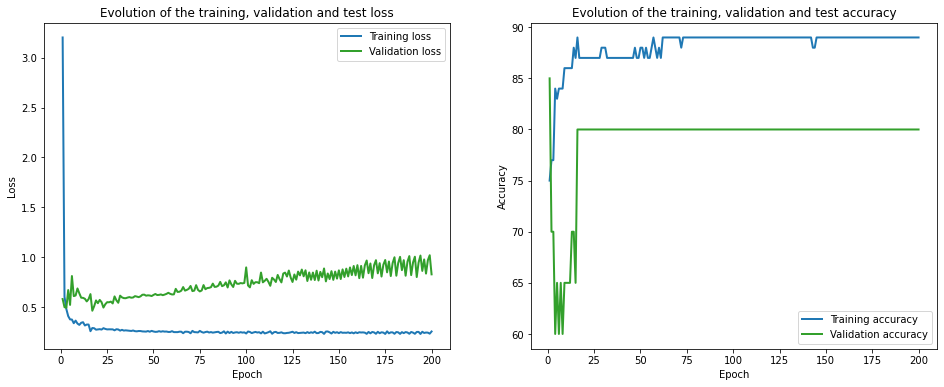

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 153.16it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1102.26it/s]

Finished computing p-values for 500 test points.

Starting repetition 43 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 0.68 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 1.04 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.44 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.54 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
val_loss = 0.06 val_acc = 100.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0

Epoch 15 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 60% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 15 of 200, 70% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 80% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 90% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 15 of 200, 100% 	 train_loss: 0.47 train_acc: 90.00% took: 0.00s
val_loss = 0.11 val_acc = 95.00%
Snapshot saved at epoch 15.
Epoch 16 of 200, 10% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 20% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 30% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 60% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 70% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 80% 	 trai

Epoch 26 of 200, 60% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 26 of 200, 70% 	 train_loss: 0.36 train_acc: 90.00% took: 0.01s
Epoch 26 of 200, 80% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 26 of 200, 90% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 26 of 200, 100% 	 train_loss: 0.47 train_acc: 90.00% took: 0.00s
val_loss = 0.11 val_acc = 95.00%
Snapshot saved at epoch 26.
Epoch 27 of 200, 10% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 20% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 27 of 200, 30% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 40% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 60% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 27 of 200, 70% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 80% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 90% 	 tra

Epoch 37 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.02s
Epoch 37 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 37 of 200, 60% 	 train_loss: 0.41 train_acc: 70.00% took: 0.01s
Epoch 37 of 200, 70% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 37 of 200, 80% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 37 of 200, 90% 	 train_loss: 0.44 train_acc: 60.00% took: 0.00s
Epoch 37 of 200, 100% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
val_loss = 0.12 val_acc = 95.00%
Snapshot saved at epoch 37.
Epoch 38 of 200, 10% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 20% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 38 of 200, 30% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 60% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 38 of 200, 70% 	 tr

Epoch 52 of 200, 70% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 52 of 200, 80% 	 train_loss: 0.22 train_acc: 80.00% took: 0.01s
Epoch 52 of 200, 90% 	 train_loss: 0.43 train_acc: 60.00% took: 0.00s
Epoch 52 of 200, 100% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
val_loss = 0.11 val_acc = 95.00%
Snapshot saved at epoch 52.
Epoch 53 of 200, 10% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 53 of 200, 20% 	 train_loss: 0.37 train_acc: 70.00% took: 0.00s
Epoch 53 of 200, 30% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 53 of 200, 40% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 53 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 53 of 200, 60% 	 train_loss: 0.40 train_acc: 70.00% took: 0.00s
Epoch 53 of 200, 70% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 53 of 200, 80% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 53 of 200, 90% 	 train_loss: 0.45 train_acc: 60.00% took: 0.00s
Epoch 53 of 200, 100% 	 tr

Epoch 68 of 200, 60% 	 train_loss: 0.40 train_acc: 70.00% took: 0.00s
Epoch 68 of 200, 70% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 68 of 200, 80% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 68 of 200, 90% 	 train_loss: 0.46 train_acc: 60.00% took: 0.00s
Epoch 68 of 200, 100% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
val_loss = 0.12 val_acc = 95.00%
Snapshot saved at epoch 68.
Epoch 69 of 200, 10% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 69 of 200, 20% 	 train_loss: 0.36 train_acc: 70.00% took: 0.00s
Epoch 69 of 200, 30% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 69 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 69 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 69 of 200, 60% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 69 of 200, 70% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 69 of 200, 80% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 69 of 200, 90% 	 tra

Epoch 79 of 200, 30% 	 train_loss: 0.19 train_acc: 100.00% took: 0.02s
Epoch 79 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 79 of 200, 50% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 79 of 200, 60% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 79 of 200, 70% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 79 of 200, 80% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 79 of 200, 90% 	 train_loss: 0.45 train_acc: 60.00% took: 0.00s
Epoch 79 of 200, 100% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
val_loss = 0.12 val_acc = 95.00%
Snapshot saved at epoch 79.
Epoch 80 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 80 of 200, 20% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
Epoch 80 of 200, 30% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 80 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 80 of 200, 50% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 80 of 200, 60% 	 t

Epoch 94 of 200, 50% 	 train_loss: 0.18 train_acc: 90.00% took: 0.02s
Epoch 94 of 200, 60% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 94 of 200, 70% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 94 of 200, 80% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 94 of 200, 90% 	 train_loss: 0.43 train_acc: 60.00% took: 0.00s
Epoch 94 of 200, 100% 	 train_loss: 0.51 train_acc: 90.00% took: 0.00s
val_loss = 0.10 val_acc = 95.00%
Snapshot saved at epoch 94.
Epoch 95 of 200, 10% 	 train_loss: 0.19 train_acc: 80.00% took: 0.00s
Epoch 95 of 200, 20% 	 train_loss: 0.34 train_acc: 70.00% took: 0.00s
Epoch 95 of 200, 30% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 95 of 200, 40% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 95 of 200, 50% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 95 of 200, 60% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 95 of 200, 70% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 95 of 200, 80% 	 tra

Snapshot saved at epoch 109.
Epoch 110 of 200, 10% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 110 of 200, 20% 	 train_loss: 0.33 train_acc: 70.00% took: 0.00s
Epoch 110 of 200, 30% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 110 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 110 of 200, 50% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 110 of 200, 60% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 110 of 200, 70% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 110 of 200, 80% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 110 of 200, 90% 	 train_loss: 0.46 train_acc: 60.00% took: 0.00s
Epoch 110 of 200, 100% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
val_loss = 0.12 val_acc = 95.00%
Snapshot saved at epoch 110.
Epoch 111 of 200, 10% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 20% 	 train_loss: 0.34 train_acc: 70.00% took: 0.00s
Epoch 111 of 200, 30% 	 train_loss: 0.18 train_acc: 10

Epoch 120 of 200, 100% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
val_loss = 0.12 val_acc = 95.00%
Snapshot saved at epoch 120.
Epoch 121 of 200, 10% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 121 of 200, 20% 	 train_loss: 0.35 train_acc: 70.00% took: 0.00s
Epoch 121 of 200, 30% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 121 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.02s
Epoch 121 of 200, 50% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 121 of 200, 60% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 121 of 200, 70% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 121 of 200, 80% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 121 of 200, 90% 	 train_loss: 0.45 train_acc: 60.00% took: 0.00s
Epoch 121 of 200, 100% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
val_loss = 0.12 val_acc = 95.00%
Snapshot saved at epoch 121.
Epoch 122 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 122 of 200, 20

val_loss = 0.12 val_acc = 95.00%
Snapshot saved at epoch 135.
Epoch 136 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 136 of 200, 20% 	 train_loss: 0.33 train_acc: 70.00% took: 0.00s
Epoch 136 of 200, 30% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 136 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 136 of 200, 50% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 136 of 200, 60% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 136 of 200, 70% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 136 of 200, 80% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 136 of 200, 90% 	 train_loss: 0.46 train_acc: 60.00% took: 0.00s
Epoch 136 of 200, 100% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
val_loss = 0.12 val_acc = 95.00%
Snapshot saved at epoch 136.
Epoch 137 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 137 of 200, 20% 	 train_loss: 0.33 train_acc: 70.00% took: 0.00s
Epoch 137 of 200, 30%

Epoch 151 of 200, 70% 	 train_loss: 0.31 train_acc: 90.00% took: 0.02s
Epoch 151 of 200, 80% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 151 of 200, 90% 	 train_loss: 0.46 train_acc: 60.00% took: 0.00s
Epoch 151 of 200, 100% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
val_loss = 0.13 val_acc = 95.00%
Snapshot saved at epoch 151.
Epoch 152 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 152 of 200, 20% 	 train_loss: 0.30 train_acc: 70.00% took: 0.00s
Epoch 152 of 200, 30% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 152 of 200, 40% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 152 of 200, 50% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 152 of 200, 60% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 152 of 200, 70% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 152 of 200, 80% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 152 of 200, 90% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 152 of

Epoch 162 of 200, 20% 	 train_loss: 0.28 train_acc: 80.00% took: 0.02s
Epoch 162 of 200, 30% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 162 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.01s
Epoch 162 of 200, 50% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 162 of 200, 60% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 162 of 200, 70% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 162 of 200, 80% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 162 of 200, 90% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 162 of 200, 100% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
val_loss = 0.13 val_acc = 95.00%
Snapshot saved at epoch 162.
Epoch 163 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 163 of 200, 20% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 163 of 200, 30% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 163 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 163 

val_loss = 0.24 val_acc = 90.00%
Snapshot saved at epoch 172.
Epoch 173 of 200, 10% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 173 of 200, 20% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 173 of 200, 30% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 173 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 173 of 200, 50% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 173 of 200, 60% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 173 of 200, 70% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 173 of 200, 80% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 173 of 200, 90% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 173 of 200, 100% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
val_loss = 0.23 val_acc = 90.00%
Snapshot saved at epoch 173.
Epoch 174 of 200, 10% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 20% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 174 of 200, 30%

Epoch 189 of 200, 10% 	 train_loss: 0.16 train_acc: 90.00% took: 0.02s
Epoch 189 of 200, 20% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 189 of 200, 30% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 189 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 189 of 200, 50% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 189 of 200, 60% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 189 of 200, 70% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 189 of 200, 80% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 189 of 200, 90% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 189 of 200, 100% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
val_loss = 0.26 val_acc = 90.00%
Snapshot saved at epoch 189.
Epoch 190 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 190 of 200, 20% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 190 of 200, 30% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 190 o

Epoch 199 of 200, 100% 	 train_loss: 0.36 train_acc: 90.00% took: 0.01s
val_loss = 0.25 val_acc = 90.00%
Snapshot saved at epoch 199.
Epoch 200 of 200, 10% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 200 of 200, 20% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 200 of 200, 30% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 200 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.01s
Epoch 200 of 200, 50% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 200 of 200, 60% 	 train_loss: 0.40 train_acc: 70.00% took: 0.01s
Epoch 200 of 200, 70% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 200 of 200, 80% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 200 of 200, 90% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 200 of 200, 100% 	 train_loss: 0.36 train_acc: 90.00% took: 0.01s
val_loss = 0.27 val_acc = 90.00%
Snapshot saved at epoch 200.
Training done! A list of 200 models saved.


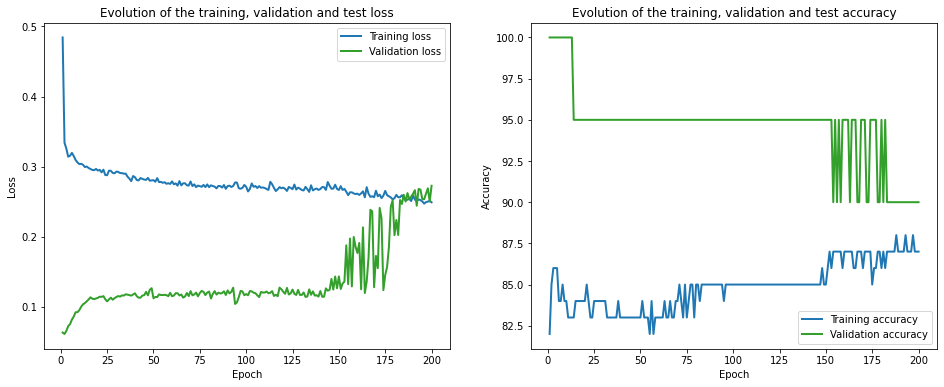

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 152.94it/s]


Initialization done!


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1034.68it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.87 train_acc: 30.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 0.72 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.63 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 1.09 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.66 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
val_loss = 0.08 val_acc = 100.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0

Epoch 16 of 200, 10% 	 train_loss: 0.26 train_acc: 80.00% took: 0.01s
Epoch 16 of 200, 20% 	 train_loss: 0.38 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 30% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 50% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 60% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 70% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 90% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 100% 	 train_loss: 0.47 train_acc: 90.00% took: 0.00s
val_loss = 0.11 val_acc = 95.00%
Snapshot saved at epoch 16.
Epoch 17 of 200, 10% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 17 of 200, 20% 	 train_loss: 0.37 train_acc: 70.00% took: 0.00s
Epoch 17 of 200, 30% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 40% 	 trai

Epoch 31 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 60% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 31 of 200, 70% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 80% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 31 of 200, 90% 	 train_loss: 0.46 train_acc: 60.00% took: 0.00s
Epoch 31 of 200, 100% 	 train_loss: 0.45 train_acc: 90.00% took: 0.00s
val_loss = 0.11 val_acc = 95.00%
Snapshot saved at epoch 31.
Epoch 32 of 200, 10% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 32 of 200, 20% 	 train_loss: 0.35 train_acc: 70.00% took: 0.00s
Epoch 32 of 200, 30% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 32 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 32 of 200, 50% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 32 of 200, 60% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 32 of 200, 70% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 32 of 200, 80% 	 tra

val_loss = 0.11 val_acc = 95.00%
Snapshot saved at epoch 46.
Epoch 47 of 200, 10% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 47 of 200, 20% 	 train_loss: 0.34 train_acc: 70.00% took: 0.00s
Epoch 47 of 200, 30% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 47 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 47 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 47 of 200, 60% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 47 of 200, 70% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 47 of 200, 80% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 47 of 200, 90% 	 train_loss: 0.46 train_acc: 60.00% took: 0.00s
Epoch 47 of 200, 100% 	 train_loss: 0.44 train_acc: 90.00% took: 0.00s
val_loss = 0.12 val_acc = 95.00%
Snapshot saved at epoch 47.
Epoch 48 of 200, 10% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 48 of 200, 20% 	 train_loss: 0.33 train_acc: 70.00% took: 0.00s
Epoch 48 of 200, 30% 	 train_loss: 

Epoch 62 of 200, 20% 	 train_loss: 0.33 train_acc: 70.00% took: 0.01s
Epoch 62 of 200, 30% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 62 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 62 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 62 of 200, 60% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 62 of 200, 70% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 62 of 200, 80% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 62 of 200, 90% 	 train_loss: 0.46 train_acc: 60.00% took: 0.00s
Epoch 62 of 200, 100% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
val_loss = 0.12 val_acc = 95.00%
Snapshot saved at epoch 62.
Epoch 63 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 63 of 200, 20% 	 train_loss: 0.33 train_acc: 70.00% took: 0.00s
Epoch 63 of 200, 30% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 63 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 63 of 200, 50% 	 t

Epoch 73 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.02s
Epoch 73 of 200, 20% 	 train_loss: 0.33 train_acc: 70.00% took: 0.00s
Epoch 73 of 200, 30% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 73 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 73 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 73 of 200, 60% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 73 of 200, 70% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 73 of 200, 80% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 73 of 200, 90% 	 train_loss: 0.47 train_acc: 60.00% took: 0.00s
Epoch 73 of 200, 100% 	 train_loss: 0.44 train_acc: 90.00% took: 0.00s
val_loss = 0.12 val_acc = 95.00%
Snapshot saved at epoch 73.
Epoch 74 of 200, 10% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 74 of 200, 20% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
Epoch 74 of 200, 30% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 74 of 200, 40% 	 tr

Epoch 89 of 200, 30% 	 train_loss: 0.17 train_acc: 100.00% took: 0.02s
Epoch 89 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 89 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 60% 	 train_loss: 0.40 train_acc: 70.00% took: 0.00s
Epoch 89 of 200, 70% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 80% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 90% 	 train_loss: 0.46 train_acc: 60.00% took: 0.00s
Epoch 89 of 200, 100% 	 train_loss: 0.45 train_acc: 90.00% took: 0.00s
val_loss = 0.11 val_acc = 95.00%
Snapshot saved at epoch 89.
Epoch 90 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 90 of 200, 20% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
Epoch 90 of 200, 30% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 90 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 90 of 200, 50% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 90 of 200, 60% 	 t

Epoch 100 of 200, 30% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 100 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 100 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 60% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 100 of 200, 70% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 80% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 90% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 100 of 200, 100% 	 train_loss: 0.45 train_acc: 90.00% took: 0.00s
val_loss = 0.11 val_acc = 95.00%
Snapshot saved at epoch 100.
Epoch 101 of 200, 10% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 101 of 200, 20% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
Epoch 101 of 200, 30% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 101 of 200, 40% 	 train_loss: 0.00 train_acc: 100.00% took: 0.00s
Epoch 101 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 101 

val_loss = 0.11 val_acc = 95.00%
Snapshot saved at epoch 115.
Epoch 116 of 200, 10% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 116 of 200, 20% 	 train_loss: 0.33 train_acc: 70.00% took: 0.00s
Epoch 116 of 200, 30% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 116 of 200, 40% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 116 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 116 of 200, 60% 	 train_loss: 0.44 train_acc: 60.00% took: 0.00s
Epoch 116 of 200, 70% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 116 of 200, 80% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 116 of 200, 90% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 116 of 200, 100% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
val_loss = 0.11 val_acc = 95.00%
Snapshot saved at epoch 116.
Epoch 117 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 117 of 200, 20% 	 train_loss: 0.31 train_acc: 70.00% took: 0.00s
Epoch 117 of 200, 30%

Epoch 130 of 200, 100% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
val_loss = 0.11 val_acc = 95.00%
Snapshot saved at epoch 130.
Epoch 131 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 131 of 200, 20% 	 train_loss: 0.32 train_acc: 70.00% took: 0.00s
Epoch 131 of 200, 30% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 131 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 131 of 200, 50% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 131 of 200, 60% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 131 of 200, 70% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 131 of 200, 80% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 131 of 200, 90% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 131 of 200, 100% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
val_loss = 0.12 val_acc = 95.00%
Snapshot saved at epoch 131.
Epoch 132 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 132 of 200, 20

val_loss = 0.20 val_acc = 95.00%
Snapshot saved at epoch 141.
Epoch 142 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 142 of 200, 20% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 142 of 200, 30% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 142 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 142 of 200, 50% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 142 of 200, 60% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 142 of 200, 70% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 142 of 200, 80% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 142 of 200, 90% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 142 of 200, 100% 	 train_loss: 0.52 train_acc: 90.00% took: 0.00s
val_loss = 0.12 val_acc = 95.00%
Snapshot saved at epoch 142.
Epoch 143 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 143 of 200, 20% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 143 of 200, 30%

Epoch 152 of 200, 100% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
val_loss = 0.17 val_acc = 95.00%
Snapshot saved at epoch 152.
Epoch 153 of 200, 10% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 153 of 200, 20% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 153 of 200, 30% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 153 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 153 of 200, 50% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 153 of 200, 60% 	 train_loss: 0.40 train_acc: 70.00% took: 0.00s
Epoch 153 of 200, 70% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 153 of 200, 80% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 153 of 200, 90% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 153 of 200, 100% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
val_loss = 0.22 val_acc = 95.00%
Snapshot saved at epoch 153.
Epoch 154 of 200, 10% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 154 of 200, 20

Epoch 163 of 200, 70% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 163 of 200, 80% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 163 of 200, 90% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 163 of 200, 100% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
val_loss = 0.18 val_acc = 95.00%
Snapshot saved at epoch 163.
Epoch 164 of 200, 10% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 164 of 200, 20% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 164 of 200, 30% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 164 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 164 of 200, 50% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 164 of 200, 60% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 164 of 200, 70% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 164 of 200, 80% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 164 of 200, 90% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 164 of

Epoch 174 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.01s
Epoch 174 of 200, 50% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 60% 	 train_loss: 0.40 train_acc: 70.00% took: 0.00s
Epoch 174 of 200, 70% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 80% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 90% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 174 of 200, 100% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
val_loss = 0.24 val_acc = 90.00%
Snapshot saved at epoch 174.
Epoch 175 of 200, 10% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 175 of 200, 20% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 175 of 200, 30% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 175 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 175 of 200, 50% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 175 of 200, 60% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 175 o

Epoch 185 of 200, 20% 	 train_loss: 0.26 train_acc: 80.00% took: 0.02s
Epoch 185 of 200, 30% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 185 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 185 of 200, 50% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 185 of 200, 60% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 185 of 200, 70% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 185 of 200, 80% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 185 of 200, 90% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 185 of 200, 100% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
val_loss = 0.25 val_acc = 90.00%
Snapshot saved at epoch 185.
Epoch 186 of 200, 10% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 186 of 200, 20% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 186 of 200, 30% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 186 of 200, 40% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 186 

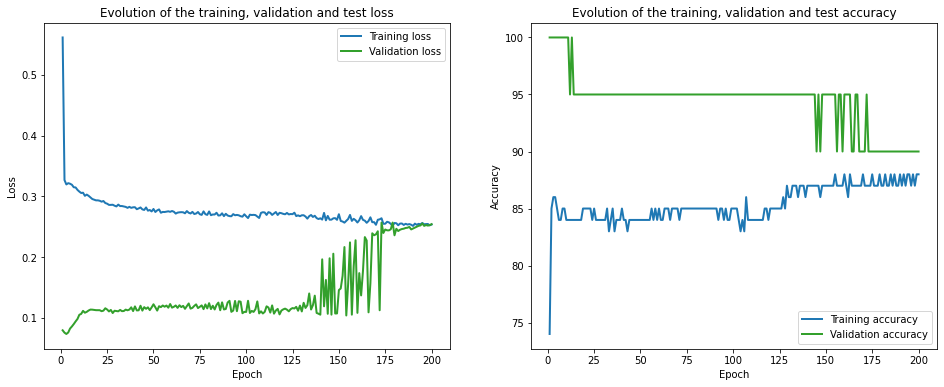

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 149.99it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1176.35it/s]

Finished computing p-values for 500 test points.

Starting repetition 44 of 50:



Training with standard data splitting...


C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 1.61 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.87 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.57 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.66 train_acc: 40.00% took: 0.00s
val_loss = 1.61 val_acc = 50.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.52 train_acc: 70.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.4

Epoch 15 of 200, 50% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 15 of 200, 60% 	 train_loss: 0.42 train_acc: 90.00% took: 0.01s
Epoch 15 of 200, 70% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 15 of 200, 80% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 15 of 200, 90% 	 train_loss: 0.74 train_acc: 80.00% took: 0.00s
Epoch 15 of 200, 100% 	 train_loss: 0.52 train_acc: 60.00% took: 0.00s
val_loss = 0.62 val_acc = 65.00%
Snapshot saved at epoch 15.
Epoch 16 of 200, 10% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 20% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 30% 	 train_loss: 0.29 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 40% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 50% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 60% 	 train_loss: 0.50 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 70% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 80% 	 train

Epoch 27 of 200, 10% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 20% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 30% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 40% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 50% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 60% 	 train_loss: 0.45 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 70% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 80% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 90% 	 train_loss: 0.72 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 100% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
val_loss = 0.50 val_acc = 70.00%
Snapshot saved at epoch 27.
Epoch 28 of 200, 10% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 20% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 30% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 40% 	 trai

Epoch 41 of 200, 70% 	 train_loss: 0.28 train_acc: 90.00% took: 0.02s
Epoch 41 of 200, 80% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 41 of 200, 90% 	 train_loss: 0.71 train_acc: 80.00% took: 0.00s
Epoch 41 of 200, 100% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
val_loss = 0.58 val_acc = 70.00%
Snapshot saved at epoch 41.
Epoch 42 of 200, 10% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 42 of 200, 20% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 42 of 200, 30% 	 train_loss: 0.25 train_acc: 90.00% took: 0.02s
Epoch 42 of 200, 40% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 42 of 200, 50% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 42 of 200, 60% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 42 of 200, 70% 	 train_loss: 0.30 train_acc: 100.00% took: 0.00s
Epoch 42 of 200, 80% 	 train_loss: 0.22 train_acc: 90.00% took: 0.02s
Epoch 42 of 200, 90% 	 train_loss: 0.75 train_acc: 80.00% took: 0.00s
Epoch 42 of 200, 100% 	 tr

Epoch 52 of 200, 80% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 52 of 200, 90% 	 train_loss: 0.77 train_acc: 80.00% took: 0.00s
Epoch 52 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
val_loss = 0.58 val_acc = 70.00%
Snapshot saved at epoch 52.
Epoch 53 of 200, 10% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 53 of 200, 20% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 53 of 200, 30% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 53 of 200, 40% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 53 of 200, 50% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 53 of 200, 60% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 53 of 200, 70% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 53 of 200, 80% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 53 of 200, 90% 	 train_loss: 0.71 train_acc: 80.00% took: 0.00s
Epoch 53 of 200, 100% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
val_loss = 0.65 val_acc = 

Epoch 64 of 200, 40% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 64 of 200, 50% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 64 of 200, 60% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 64 of 200, 70% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 64 of 200, 80% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 64 of 200, 90% 	 train_loss: 0.75 train_acc: 80.00% took: 0.00s
Epoch 64 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
val_loss = 0.62 val_acc = 70.00%
Snapshot saved at epoch 64.
Epoch 65 of 200, 10% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 65 of 200, 20% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 65 of 200, 30% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 65 of 200, 40% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 65 of 200, 50% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 65 of 200, 60% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
Epoch 65 of 200, 70% 	 trai

Epoch 79 of 200, 20% 	 train_loss: 0.22 train_acc: 90.00% took: 0.02s
Epoch 79 of 200, 30% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 79 of 200, 40% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 79 of 200, 50% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 79 of 200, 60% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 79 of 200, 70% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 79 of 200, 80% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 79 of 200, 90% 	 train_loss: 0.78 train_acc: 80.00% took: 0.02s
Epoch 79 of 200, 100% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
val_loss = 0.63 val_acc = 70.00%
Snapshot saved at epoch 79.
Epoch 80 of 200, 10% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 80 of 200, 20% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 80 of 200, 30% 	 train_loss: 0.29 train_acc: 90.00% took: 0.02s
Epoch 80 of 200, 40% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 80 of 200, 50% 	 trai

Epoch 94 of 200, 20% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 94 of 200, 30% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 94 of 200, 40% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 94 of 200, 50% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 94 of 200, 60% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
Epoch 94 of 200, 70% 	 train_loss: 0.26 train_acc: 100.00% took: 0.00s
Epoch 94 of 200, 80% 	 train_loss: 0.25 train_acc: 90.00% took: 0.02s
Epoch 94 of 200, 90% 	 train_loss: 0.77 train_acc: 80.00% took: 0.00s
Epoch 94 of 200, 100% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
val_loss = 0.64 val_acc = 70.00%
Snapshot saved at epoch 94.
Epoch 95 of 200, 10% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 95 of 200, 20% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 95 of 200, 30% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 95 of 200, 40% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 95 of 200, 50% 	 tra

val_loss = 0.62 val_acc = 70.00%
Snapshot saved at epoch 104.
Epoch 105 of 200, 10% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 105 of 200, 20% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 105 of 200, 30% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 105 of 200, 40% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 105 of 200, 50% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 105 of 200, 60% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 105 of 200, 70% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 105 of 200, 80% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 105 of 200, 90% 	 train_loss: 0.79 train_acc: 80.00% took: 0.00s
Epoch 105 of 200, 100% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
val_loss = 0.65 val_acc = 70.00%
Snapshot saved at epoch 105.
Epoch 106 of 200, 10% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 106 of 200, 20% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 106 of 200, 30%

Epoch 115 of 200, 70% 	 train_loss: 0.31 train_acc: 90.00% took: 0.02s
Epoch 115 of 200, 80% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 115 of 200, 90% 	 train_loss: 0.79 train_acc: 80.00% took: 0.00s
Epoch 115 of 200, 100% 	 train_loss: 0.25 train_acc: 100.00% took: 0.00s
val_loss = 0.59 val_acc = 70.00%
Snapshot saved at epoch 115.
Epoch 116 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.01s
Epoch 116 of 200, 20% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 116 of 200, 30% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 116 of 200, 40% 	 train_loss: 0.14 train_acc: 90.00% took: 0.01s
Epoch 116 of 200, 50% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 116 of 200, 60% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 116 of 200, 70% 	 train_loss: 0.28 train_acc: 90.00% took: 0.01s
Epoch 116 of 200, 80% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 116 of 200, 90% 	 train_loss: 0.78 train_acc: 80.00% took: 0.00s
Epoch 116 of

Epoch 130 of 200, 30% 	 train_loss: 0.28 train_acc: 90.00% took: 0.01s
Epoch 130 of 200, 40% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 130 of 200, 50% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 130 of 200, 60% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 130 of 200, 70% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 130 of 200, 80% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 130 of 200, 90% 	 train_loss: 0.78 train_acc: 80.00% took: 0.00s
Epoch 130 of 200, 100% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
val_loss = 0.59 val_acc = 70.00%
Snapshot saved at epoch 130.
Epoch 131 of 200, 10% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 131 of 200, 20% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 131 of 200, 30% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 131 of 200, 40% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 131 of 200, 50% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 131 of 

val_loss = 0.60 val_acc = 70.00%
Snapshot saved at epoch 140.
Epoch 141 of 200, 10% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 141 of 200, 20% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 141 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 141 of 200, 40% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 141 of 200, 50% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 141 of 200, 60% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 141 of 200, 70% 	 train_loss: 0.25 train_acc: 100.00% took: 0.00s
Epoch 141 of 200, 80% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 141 of 200, 90% 	 train_loss: 0.79 train_acc: 80.00% took: 0.00s
Epoch 141 of 200, 100% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
val_loss = 0.58 val_acc = 70.00%
Snapshot saved at epoch 141.
Epoch 142 of 200, 10% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 142 of 200, 20% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 142 of 200, 3

Epoch 156 of 200, 70% 	 train_loss: 0.25 train_acc: 100.00% took: 0.01s
Epoch 156 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 156 of 200, 90% 	 train_loss: 0.75 train_acc: 80.00% took: 0.00s
Epoch 156 of 200, 100% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
val_loss = 0.62 val_acc = 70.00%
Snapshot saved at epoch 156.
Epoch 157 of 200, 10% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 157 of 200, 20% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 157 of 200, 30% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 157 of 200, 40% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 157 of 200, 50% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 157 of 200, 60% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 157 of 200, 70% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 157 of 200, 80% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 157 of 200, 90% 	 train_loss: 0.78 train_acc: 80.00% took: 0.00s
Epoch 157 o

Epoch 172 of 200, 50% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 172 of 200, 60% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 172 of 200, 70% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 172 of 200, 80% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 172 of 200, 90% 	 train_loss: 0.79 train_acc: 80.00% took: 0.00s
Epoch 172 of 200, 100% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
val_loss = 0.59 val_acc = 70.00%
Snapshot saved at epoch 172.
Epoch 173 of 200, 10% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 173 of 200, 20% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 173 of 200, 30% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 173 of 200, 40% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 173 of 200, 50% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 173 of 200, 60% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 173 of 200, 70% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 173 of 

Epoch 183 of 200, 60% 	 train_loss: 0.38 train_acc: 90.00% took: 0.01s
Epoch 183 of 200, 70% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 183 of 200, 80% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 183 of 200, 90% 	 train_loss: 0.81 train_acc: 80.00% took: 0.00s
Epoch 183 of 200, 100% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
val_loss = 0.65 val_acc = 70.00%
Snapshot saved at epoch 183.
Epoch 184 of 200, 10% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 184 of 200, 20% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 184 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 184 of 200, 40% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 184 of 200, 50% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 184 of 200, 60% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 184 of 200, 70% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 184 of 200, 80% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 184 of

Epoch 198 of 200, 20% 	 train_loss: 0.24 train_acc: 90.00% took: 0.02s
Epoch 198 of 200, 30% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 198 of 200, 40% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 198 of 200, 50% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 198 of 200, 60% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 198 of 200, 70% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 198 of 200, 80% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 198 of 200, 90% 	 train_loss: 0.79 train_acc: 80.00% took: 0.00s
Epoch 198 of 200, 100% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
val_loss = 0.58 val_acc = 70.00%
Snapshot saved at epoch 198.
Epoch 199 of 200, 10% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 199 of 200, 20% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 199 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 199 of 200, 40% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 199 of 

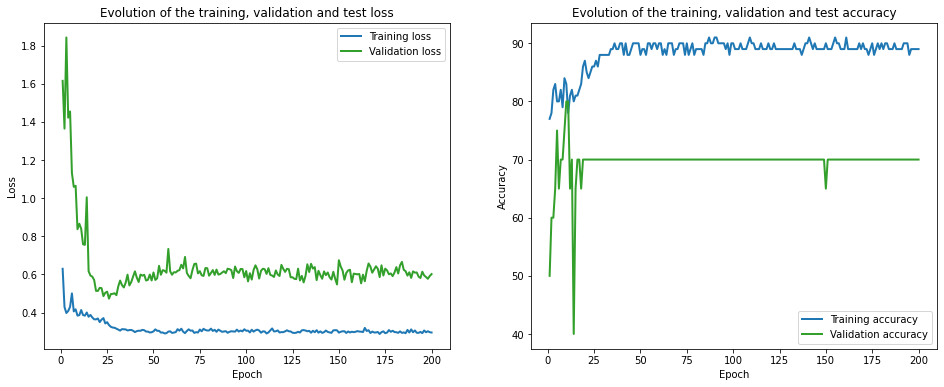

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 153.46it/s]


Initialization done!


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1039.58it/s]


Finished computing p-values for 500 test points.
Training with CES data splitting...


C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.96 train_acc: 20.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 1.93 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.45 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.70 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.75 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 2.64 train_acc: 30.00% took: 0.00s
val_loss = 2.17 val_acc = 25.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.33 train_acc: 80.00% took: 0.01s
Epoch 2 of 200, 20% 	 train_loss: 1.83 train_acc: 60.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.3

Epoch 15 of 200, 70% 	 train_loss: 0.53 train_acc: 60.00% took: 0.02s
Epoch 15 of 200, 80% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 90% 	 train_loss: 0.62 train_acc: 80.00% took: 0.01s
Epoch 15 of 200, 100% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
val_loss = 0.74 val_acc = 80.00%
Snapshot saved at epoch 15.
Epoch 16 of 200, 10% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 20% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 30% 	 train_loss: 0.26 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 40% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 50% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 60% 	 train_loss: 0.47 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 70% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 80% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 90% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 100% 	 tr

Epoch 26 of 200, 70% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 26 of 200, 80% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 26 of 200, 90% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 26 of 200, 100% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
val_loss = 0.59 val_acc = 75.00%
Snapshot saved at epoch 26.
Epoch 27 of 200, 10% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 30% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 40% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 50% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 60% 	 train_loss: 0.53 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 70% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 80% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 90% 	 train_loss: 0.71 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 100% 	 tra

Epoch 37 of 200, 50% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 37 of 200, 60% 	 train_loss: 0.48 train_acc: 90.00% took: 0.00s
Epoch 37 of 200, 70% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 37 of 200, 80% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 37 of 200, 90% 	 train_loss: 0.73 train_acc: 80.00% took: 0.00s
Epoch 37 of 200, 100% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
val_loss = 0.48 val_acc = 75.00%
Snapshot saved at epoch 37.
Epoch 38 of 200, 10% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 30% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 40% 	 train_loss: 0.13 train_acc: 90.00% took: 0.01s
Epoch 38 of 200, 50% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 60% 	 train_loss: 0.44 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 70% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 80% 	 train

Epoch 52 of 200, 10% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 52 of 200, 20% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 52 of 200, 30% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 52 of 200, 40% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 52 of 200, 50% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 52 of 200, 60% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 52 of 200, 70% 	 train_loss: 0.31 train_acc: 100.00% took: 0.00s
Epoch 52 of 200, 80% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 52 of 200, 90% 	 train_loss: 0.69 train_acc: 80.00% took: 0.00s
Epoch 52 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss = 0.50 val_acc = 70.00%
Snapshot saved at epoch 52.
Epoch 53 of 200, 10% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 53 of 200, 20% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 53 of 200, 30% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 53 of 200, 40% 	 tr

val_loss = 0.64 val_acc = 70.00%
Snapshot saved at epoch 62.
Epoch 63 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.01s
Epoch 63 of 200, 20% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 63 of 200, 30% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 63 of 200, 40% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 63 of 200, 50% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 63 of 200, 60% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 63 of 200, 70% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 63 of 200, 80% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 63 of 200, 90% 	 train_loss: 0.70 train_acc: 80.00% took: 0.00s
Epoch 63 of 200, 100% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
val_loss = 0.63 val_acc = 70.00%
Snapshot saved at epoch 63.
Epoch 64 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 64 of 200, 20% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 64 of 200, 30% 	 train_loss: 

Epoch 79 of 200, 40% 	 train_loss: 0.15 train_acc: 90.00% took: 0.02s
Epoch 79 of 200, 50% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 79 of 200, 60% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 79 of 200, 70% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 79 of 200, 80% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 79 of 200, 90% 	 train_loss: 0.79 train_acc: 80.00% took: 0.00s
Epoch 79 of 200, 100% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
val_loss = 0.59 val_acc = 70.00%
Snapshot saved at epoch 79.
Epoch 80 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 80 of 200, 20% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 80 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 80 of 200, 40% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 80 of 200, 50% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 80 of 200, 60% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 80 of 200, 70% 	 trai

Epoch 91 of 200, 30% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 91 of 200, 40% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 91 of 200, 50% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 91 of 200, 60% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 91 of 200, 70% 	 train_loss: 0.28 train_acc: 100.00% took: 0.00s
Epoch 91 of 200, 80% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 91 of 200, 90% 	 train_loss: 0.79 train_acc: 80.00% took: 0.00s
Epoch 91 of 200, 100% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
val_loss = 0.60 val_acc = 70.00%
Snapshot saved at epoch 91.
Epoch 92 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 92 of 200, 20% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 92 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 92 of 200, 40% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 92 of 200, 50% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 92 of 200, 60% 	 tra

Epoch 107 of 200, 10% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 107 of 200, 20% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 107 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 107 of 200, 40% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 107 of 200, 50% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 107 of 200, 60% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 107 of 200, 70% 	 train_loss: 0.27 train_acc: 100.00% took: 0.00s
Epoch 107 of 200, 80% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 107 of 200, 90% 	 train_loss: 0.75 train_acc: 80.00% took: 0.00s
Epoch 107 of 200, 100% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
val_loss = 0.67 val_acc = 70.00%
Snapshot saved at epoch 107.
Epoch 108 of 200, 10% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 108 of 200, 20% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 108 of 200, 30% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 108 o

Epoch 118 of 200, 70% 	 train_loss: 0.27 train_acc: 100.00% took: 0.00s
Epoch 118 of 200, 80% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 118 of 200, 90% 	 train_loss: 0.80 train_acc: 80.00% took: 0.00s
Epoch 118 of 200, 100% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
val_loss = 0.60 val_acc = 70.00%
Snapshot saved at epoch 118.
Epoch 119 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 119 of 200, 20% 	 train_loss: 0.24 train_acc: 90.00% took: 0.02s
Epoch 119 of 200, 30% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 119 of 200, 40% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 119 of 200, 50% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 119 of 200, 60% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 119 of 200, 70% 	 train_loss: 0.26 train_acc: 100.00% took: 0.02s
Epoch 119 of 200, 80% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 119 of 200, 90% 	 train_loss: 0.78 train_acc: 80.00% took: 0.00s
Epoch 119 o

Epoch 129 of 200, 100% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
val_loss = 0.62 val_acc = 70.00%
Snapshot saved at epoch 129.
Epoch 130 of 200, 10% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 130 of 200, 20% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 130 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 130 of 200, 40% 	 train_loss: 0.15 train_acc: 90.00% took: 0.01s
Epoch 130 of 200, 50% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 130 of 200, 60% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 130 of 200, 70% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 130 of 200, 80% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 130 of 200, 90% 	 train_loss: 0.79 train_acc: 80.00% took: 0.00s
Epoch 130 of 200, 100% 	 train_loss: 0.25 train_acc: 100.00% took: 0.02s
val_loss = 0.66 val_acc = 70.00%
Snapshot saved at epoch 130.
Epoch 131 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 131 of 200, 2

Epoch 145 of 200, 60% 	 train_loss: 0.41 train_acc: 90.00% took: 0.02s
Epoch 145 of 200, 70% 	 train_loss: 0.28 train_acc: 100.00% took: 0.00s
Epoch 145 of 200, 80% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 145 of 200, 90% 	 train_loss: 0.83 train_acc: 80.00% took: 0.00s
Epoch 145 of 200, 100% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
val_loss = 0.63 val_acc = 70.00%
Snapshot saved at epoch 145.
Epoch 146 of 200, 10% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 146 of 200, 20% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 146 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 146 of 200, 40% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 146 of 200, 50% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 146 of 200, 60% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 146 of 200, 70% 	 train_loss: 0.29 train_acc: 100.00% took: 0.00s
Epoch 146 of 200, 80% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 146 o

Epoch 161 of 200, 80% 	 train_loss: 0.23 train_acc: 90.00% took: 0.02s
Epoch 161 of 200, 90% 	 train_loss: 0.78 train_acc: 80.00% took: 0.00s
Epoch 161 of 200, 100% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
val_loss = 0.63 val_acc = 70.00%
Snapshot saved at epoch 161.
Epoch 162 of 200, 10% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 162 of 200, 20% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 162 of 200, 30% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 162 of 200, 40% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 162 of 200, 50% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 162 of 200, 60% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 162 of 200, 70% 	 train_loss: 0.28 train_acc: 100.00% took: 0.00s
Epoch 162 of 200, 80% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 162 of 200, 90% 	 train_loss: 0.78 train_acc: 80.00% took: 0.00s
Epoch 162 of 200, 100% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
val_loss = 

Epoch 177 of 200, 60% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 177 of 200, 70% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 177 of 200, 80% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 177 of 200, 90% 	 train_loss: 0.79 train_acc: 80.00% took: 0.00s
Epoch 177 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
val_loss = 0.63 val_acc = 70.00%
Snapshot saved at epoch 177.
Epoch 178 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 178 of 200, 20% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 30% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 40% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 50% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 178 of 200, 60% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 70% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 80% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 178 of 

Epoch 188 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.02s
Epoch 188 of 200, 20% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 188 of 200, 30% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 188 of 200, 40% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 188 of 200, 50% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 188 of 200, 60% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 188 of 200, 70% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 188 of 200, 80% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 188 of 200, 90% 	 train_loss: 0.78 train_acc: 80.00% took: 0.00s
Epoch 188 of 200, 100% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
val_loss = 0.57 val_acc = 70.00%
Snapshot saved at epoch 188.
Epoch 189 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 189 of 200, 20% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 189 of 200, 30% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 189 of

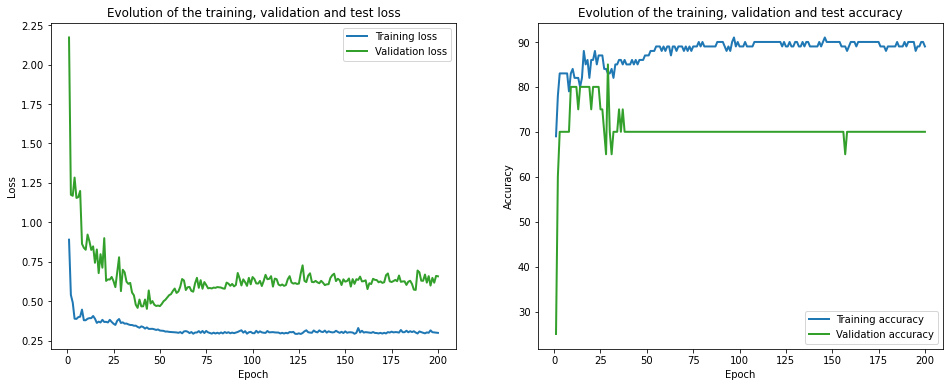

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 154.48it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1097.03it/s]

Finished computing p-values for 500 test points.

Starting repetition 45 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.72 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 3.26 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 1.11 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.75 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.95 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.60 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.48 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
val_loss = 0.98 val_acc = 60.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 1.17 train_acc: 60.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.85 train_acc: 40.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.

Epoch 15 of 200, 90% 	 train_loss: 0.43 train_acc: 70.00% took: 0.02s
Epoch 15 of 200, 100% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
val_loss = 0.52 val_acc = 80.00%
Snapshot saved at epoch 15.
Epoch 16 of 200, 10% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 20% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 30% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 40% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 50% 	 train_loss: 0.68 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 60% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 70% 	 train_loss: 0.76 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 80% 	 train_loss: 0.53 train_acc: 90.00% took: 0.00s
Epoch 16 of 200, 90% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 100% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
val_loss = 0.52 val_acc = 80.00%
Snapshot saved at epoch 16.
Epoch 17 of 200, 10% 	 train_loss:

Epoch 26 of 200, 80% 	 train_loss: 0.52 train_acc: 90.00% took: 0.01s
Epoch 26 of 200, 90% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 26 of 200, 100% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
val_loss = 0.64 val_acc = 80.00%
Snapshot saved at epoch 26.
Epoch 27 of 200, 10% 	 train_loss: 0.59 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 20% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 30% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 50% 	 train_loss: 0.66 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 60% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 70% 	 train_loss: 0.77 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 80% 	 train_loss: 0.50 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 90% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 27 of 200, 100% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
val_loss = 0.58 val_acc =

Epoch 38 of 200, 60% 	 train_loss: 0.04 train_acc: 100.00% took: 0.02s
Epoch 38 of 200, 70% 	 train_loss: 0.83 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 80% 	 train_loss: 0.55 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 90% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 38 of 200, 100% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
val_loss = 0.78 val_acc = 55.00%
Snapshot saved at epoch 38.
Epoch 39 of 200, 10% 	 train_loss: 0.78 train_acc: 60.00% took: 0.00s
Epoch 39 of 200, 20% 	 train_loss: 0.60 train_acc: 50.00% took: 0.00s
Epoch 39 of 200, 30% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 39 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 39 of 200, 50% 	 train_loss: 0.64 train_acc: 80.00% took: 0.00s
Epoch 39 of 200, 60% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 39 of 200, 70% 	 train_loss: 0.82 train_acc: 80.00% took: 0.00s
Epoch 39 of 200, 80% 	 train_loss: 0.52 train_acc: 90.00% took: 0.00s
Epoch 39 of 200, 90% 	 tr

val_loss = 0.56 val_acc = 80.00%
Snapshot saved at epoch 49.
Epoch 50 of 200, 10% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 20% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 50 of 200, 30% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 50 of 200, 50% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 50 of 200, 60% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 50 of 200, 70% 	 train_loss: 0.77 train_acc: 80.00% took: 0.00s
Epoch 50 of 200, 80% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 50 of 200, 90% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 50 of 200, 100% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
val_loss = 0.52 val_acc = 80.00%
Snapshot saved at epoch 50.
Epoch 51 of 200, 10% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 51 of 200, 20% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 51 of 200, 30% 	 train_loss:

Epoch 61 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.02s
Epoch 61 of 200, 50% 	 train_loss: 0.54 train_acc: 80.00% took: 0.01s
Epoch 61 of 200, 60% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 61 of 200, 70% 	 train_loss: 0.78 train_acc: 80.00% took: 0.00s
Epoch 61 of 200, 80% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 61 of 200, 90% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 61 of 200, 100% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
val_loss = 0.54 val_acc = 75.00%
Snapshot saved at epoch 61.
Epoch 62 of 200, 10% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 62 of 200, 20% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 62 of 200, 30% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 62 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 62 of 200, 50% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 62 of 200, 60% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 62 of 200, 70% 	 

Epoch 77 of 200, 30% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 77 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 77 of 200, 50% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 77 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 77 of 200, 70% 	 train_loss: 0.76 train_acc: 80.00% took: 0.00s
Epoch 77 of 200, 80% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 77 of 200, 90% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 77 of 200, 100% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
val_loss = 0.52 val_acc = 75.00%
Snapshot saved at epoch 77.
Epoch 78 of 200, 10% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 78 of 200, 20% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 78 of 200, 30% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 78 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 78 of 200, 50% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 78 of 200, 60% 	 t

Epoch 88 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 88 of 200, 50% 	 train_loss: 0.64 train_acc: 80.00% took: 0.00s
Epoch 88 of 200, 60% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 88 of 200, 70% 	 train_loss: 0.83 train_acc: 80.00% took: 0.00s
Epoch 88 of 200, 80% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 88 of 200, 90% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 88 of 200, 100% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
val_loss = 0.52 val_acc = 75.00%
Snapshot saved at epoch 88.
Epoch 89 of 200, 10% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 20% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 89 of 200, 30% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 89 of 200, 50% 	 train_loss: 0.58 train_acc: 80.00% took: 0.00s
Epoch 89 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 89 of 200, 70% 	 

Epoch 99 of 200, 70% 	 train_loss: 0.83 train_acc: 80.00% took: 0.01s
Epoch 99 of 200, 80% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 99 of 200, 90% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 99 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.48 val_acc = 75.00%
Snapshot saved at epoch 99.
Epoch 100 of 200, 10% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 20% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 30% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 40% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 100 of 200, 50% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 100 of 200, 70% 	 train_loss: 0.80 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 80% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 90% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 100 of 200

Epoch 110 of 200, 60% 	 train_loss: 0.02 train_acc: 100.00% took: 0.02s
Epoch 110 of 200, 70% 	 train_loss: 0.83 train_acc: 80.00% took: 0.00s
Epoch 110 of 200, 80% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 110 of 200, 90% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 110 of 200, 100% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
val_loss = 0.49 val_acc = 80.00%
Snapshot saved at epoch 110.
Epoch 111 of 200, 10% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 20% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 111 of 200, 30% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 111 of 200, 40% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 50% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 111 of 200, 60% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 70% 	 train_loss: 0.82 train_acc: 80.00% took: 0.00s
Epoch 111 of 200, 80% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 111 

Epoch 121 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 121 of 200, 70% 	 train_loss: 0.78 train_acc: 80.00% took: 0.01s
Epoch 121 of 200, 80% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 121 of 200, 90% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 121 of 200, 100% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
val_loss = 0.48 val_acc = 75.00%
Snapshot saved at epoch 121.
Epoch 122 of 200, 10% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 122 of 200, 20% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 122 of 200, 30% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 122 of 200, 40% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 122 of 200, 50% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 122 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 122 of 200, 70% 	 train_loss: 0.79 train_acc: 80.00% took: 0.00s
Epoch 122 of 200, 80% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 122 

Epoch 132 of 200, 90% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 132 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.01s
val_loss = 0.84 val_acc = 45.00%
Snapshot saved at epoch 132.
Epoch 133 of 200, 10% 	 train_loss: 0.93 train_acc: 70.00% took: 0.00s
Epoch 133 of 200, 20% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 133 of 200, 30% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 133 of 200, 40% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 133 of 200, 50% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 133 of 200, 60% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 133 of 200, 70% 	 train_loss: 1.17 train_acc: 80.00% took: 0.00s
Epoch 133 of 200, 80% 	 train_loss: 0.50 train_acc: 90.00% took: 0.00s
Epoch 133 of 200, 90% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 133 of 200, 100% 	 train_loss: 1.74 train_acc: 90.00% took: 0.00s
val_loss = 0.83 val_acc = 70.00%
Snapshot saved at epoch 133.
Epoch 134 of 200, 10%

Epoch 146 of 200, 70% 	 train_loss: 0.79 train_acc: 80.00% took: 0.00s
Epoch 146 of 200, 80% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 146 of 200, 90% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 146 of 200, 100% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
val_loss = 0.49 val_acc = 75.00%
Snapshot saved at epoch 146.
Epoch 147 of 200, 10% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 147 of 200, 20% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 147 of 200, 30% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 147 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 147 of 200, 50% 	 train_loss: 0.54 train_acc: 80.00% took: 0.02s
Epoch 147 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 147 of 200, 70% 	 train_loss: 0.79 train_acc: 80.00% took: 0.00s
Epoch 147 of 200, 80% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 147 of 200, 90% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 147 o

Epoch 157 of 200, 40% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 157 of 200, 50% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 157 of 200, 60% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 157 of 200, 70% 	 train_loss: 0.82 train_acc: 80.00% took: 0.00s
Epoch 157 of 200, 80% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 157 of 200, 90% 	 train_loss: 0.44 train_acc: 70.00% took: 0.02s
Epoch 157 of 200, 100% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
val_loss = 0.49 val_acc = 75.00%
Snapshot saved at epoch 157.
Epoch 158 of 200, 10% 	 train_loss: 0.32 train_acc: 90.00% took: 0.01s
Epoch 158 of 200, 20% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 158 of 200, 30% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 158 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 158 of 200, 50% 	 train_loss: 0.54 train_acc: 80.00% took: 0.02s
Epoch 158 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 158

Epoch 171 of 200, 70% 	 train_loss: 0.79 train_acc: 80.00% took: 0.00s
Epoch 171 of 200, 80% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 171 of 200, 90% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 171 of 200, 100% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
val_loss = 0.50 val_acc = 75.00%
Snapshot saved at epoch 171.
Epoch 172 of 200, 10% 	 train_loss: 0.31 train_acc: 90.00% took: 0.01s
Epoch 172 of 200, 20% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 172 of 200, 30% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 172 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 172 of 200, 50% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 172 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 172 of 200, 70% 	 train_loss: 0.78 train_acc: 80.00% took: 0.00s
Epoch 172 of 200, 80% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 172 of 200, 90% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 172 o

Epoch 182 of 200, 40% 	 train_loss: 0.14 train_acc: 100.00% took: 0.01s
Epoch 182 of 200, 50% 	 train_loss: 1.21 train_acc: 80.00% took: 0.00s
Epoch 182 of 200, 60% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 182 of 200, 70% 	 train_loss: 0.77 train_acc: 80.00% took: 0.00s
Epoch 182 of 200, 80% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 182 of 200, 90% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 182 of 200, 100% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
val_loss = 0.57 val_acc = 60.00%
Snapshot saved at epoch 182.
Epoch 183 of 200, 10% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 183 of 200, 20% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 183 of 200, 30% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 183 of 200, 40% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 183 of 200, 50% 	 train_loss: 0.97 train_acc: 80.00% took: 0.00s
Epoch 183 of 200, 60% 	 train_loss: 0.02 train_acc: 100.00% took: 0.01s
Epoch 183 

Epoch 193 of 200, 10% 	 train_loss: 0.33 train_acc: 90.00% took: 0.02s
Epoch 193 of 200, 20% 	 train_loss: 0.53 train_acc: 70.00% took: 0.01s
Epoch 193 of 200, 30% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 193 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 193 of 200, 50% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
Epoch 193 of 200, 60% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 193 of 200, 70% 	 train_loss: 0.75 train_acc: 80.00% took: 0.00s
Epoch 193 of 200, 80% 	 train_loss: 0.54 train_acc: 80.00% took: 0.02s
Epoch 193 of 200, 90% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 193 of 200, 100% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
val_loss = 0.52 val_acc = 70.00%
Snapshot saved at epoch 193.
Epoch 194 of 200, 10% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 194 of 200, 20% 	 train_loss: 0.53 train_acc: 70.00% took: 0.02s
Epoch 194 of 200, 30% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 194 o

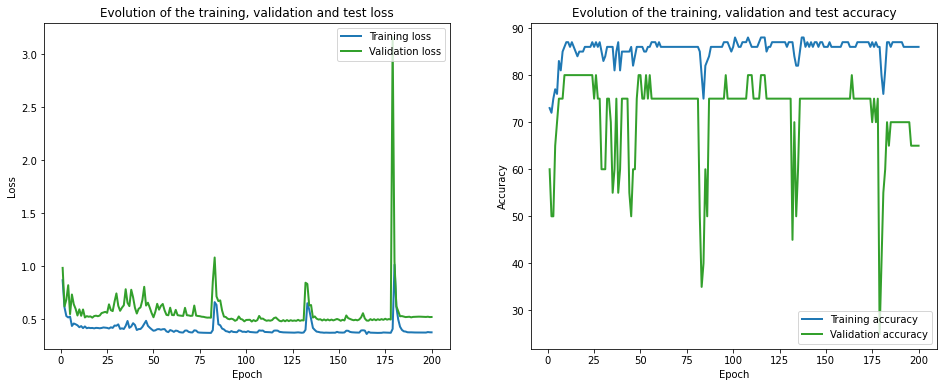

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 137.26it/s]


Initialization done!


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1098.99it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 2.05 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 2.09 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.76 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.78 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.71 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.67 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.73 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.29 train_acc: 100.00% took: 0.00s
val_loss = 0.67 val_acc = 45.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.69 train_acc: 60.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.

val_loss = 0.52 val_acc = 80.00%
Snapshot saved at epoch 11.
Epoch 12 of 200, 10% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 20% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 12 of 200, 30% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 40% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 50% 	 train_loss: 0.70 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 60% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 70% 	 train_loss: 0.77 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 80% 	 train_loss: 0.54 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 90% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 12 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
val_loss = 0.53 val_acc = 80.00%
Snapshot saved at epoch 12.
Epoch 13 of 200, 10% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 13 of 200, 20% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 13 of 200, 30% 	 train_loss: 

Epoch 23 of 200, 60% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 23 of 200, 70% 	 train_loss: 0.76 train_acc: 80.00% took: 0.00s
Epoch 23 of 200, 80% 	 train_loss: 0.50 train_acc: 90.00% took: 0.00s
Epoch 23 of 200, 90% 	 train_loss: 0.45 train_acc: 70.00% took: 0.00s
Epoch 23 of 200, 100% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
val_loss = 0.52 val_acc = 80.00%
Snapshot saved at epoch 23.
Epoch 24 of 200, 10% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 24 of 200, 20% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 24 of 200, 30% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 24 of 200, 40% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 24 of 200, 50% 	 train_loss: 0.68 train_acc: 80.00% took: 0.00s
Epoch 24 of 200, 60% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 24 of 200, 70% 	 train_loss: 0.75 train_acc: 80.00% took: 0.00s
Epoch 24 of 200, 80% 	 train_loss: 0.51 train_acc: 90.00% took: 0.00s
Epoch 24 of 200, 90% 	 tr

Epoch 34 of 200, 30% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 34 of 200, 40% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 34 of 200, 50% 	 train_loss: 0.74 train_acc: 80.00% took: 0.00s
Epoch 34 of 200, 60% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 34 of 200, 70% 	 train_loss: 0.77 train_acc: 80.00% took: 0.00s
Epoch 34 of 200, 80% 	 train_loss: 0.51 train_acc: 90.00% took: 0.00s
Epoch 34 of 200, 90% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 34 of 200, 100% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
val_loss = 0.54 val_acc = 80.00%
Snapshot saved at epoch 34.
Epoch 35 of 200, 10% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 35 of 200, 20% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 35 of 200, 30% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 35 of 200, 40% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 35 of 200, 50% 	 train_loss: 0.69 train_acc: 80.00% took: 0.00s
Epoch 35 of 200, 60% 	 tr

Epoch 45 of 200, 50% 	 train_loss: 0.67 train_acc: 80.00% took: 0.00s
Epoch 45 of 200, 60% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 45 of 200, 70% 	 train_loss: 0.77 train_acc: 80.00% took: 0.00s
Epoch 45 of 200, 80% 	 train_loss: 0.52 train_acc: 90.00% took: 0.00s
Epoch 45 of 200, 90% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 45 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
val_loss = 0.59 val_acc = 80.00%
Snapshot saved at epoch 45.
Epoch 46 of 200, 10% 	 train_loss: 0.55 train_acc: 90.00% took: 0.00s
Epoch 46 of 200, 20% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 46 of 200, 30% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 46 of 200, 40% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 46 of 200, 50% 	 train_loss: 0.73 train_acc: 80.00% took: 0.00s
Epoch 46 of 200, 60% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 46 of 200, 70% 	 train_loss: 0.79 train_acc: 80.00% took: 0.00s
Epoch 46 of 200, 80% 	 tr

Epoch 56 of 200, 20% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 56 of 200, 30% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 56 of 200, 40% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 56 of 200, 50% 	 train_loss: 0.68 train_acc: 80.00% took: 0.00s
Epoch 56 of 200, 60% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 56 of 200, 70% 	 train_loss: 0.77 train_acc: 80.00% took: 0.00s
Epoch 56 of 200, 80% 	 train_loss: 0.51 train_acc: 90.00% took: 0.00s
Epoch 56 of 200, 90% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 56 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
val_loss = 0.58 val_acc = 80.00%
Snapshot saved at epoch 56.
Epoch 57 of 200, 10% 	 train_loss: 0.51 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 20% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 57 of 200, 30% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 57 of 200, 40% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 57 of 200, 50% 	 tr

Epoch 67 of 200, 70% 	 train_loss: 0.77 train_acc: 80.00% took: 0.00s
Epoch 67 of 200, 80% 	 train_loss: 0.52 train_acc: 90.00% took: 0.01s
Epoch 67 of 200, 90% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 67 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
val_loss = 0.54 val_acc = 80.00%
Snapshot saved at epoch 67.
Epoch 68 of 200, 10% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 68 of 200, 20% 	 train_loss: 0.47 train_acc: 80.00% took: 0.02s
Epoch 68 of 200, 30% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 68 of 200, 40% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 68 of 200, 50% 	 train_loss: 0.67 train_acc: 80.00% took: 0.00s
Epoch 68 of 200, 60% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 68 of 200, 70% 	 train_loss: 0.77 train_acc: 80.00% took: 0.02s
Epoch 68 of 200, 80% 	 train_loss: 0.52 train_acc: 90.00% took: 0.00s
Epoch 68 of 200, 90% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 68 of 200, 100% 	 tr

Epoch 83 of 200, 60% 	 train_loss: 0.02 train_acc: 100.00% took: 0.02s
Epoch 83 of 200, 70% 	 train_loss: 0.76 train_acc: 80.00% took: 0.00s
Epoch 83 of 200, 80% 	 train_loss: 0.51 train_acc: 90.00% took: 0.01s
Epoch 83 of 200, 90% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 83 of 200, 100% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
val_loss = 0.52 val_acc = 80.00%
Snapshot saved at epoch 83.
Epoch 84 of 200, 10% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 84 of 200, 20% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 84 of 200, 30% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 84 of 200, 40% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 84 of 200, 50% 	 train_loss: 0.67 train_acc: 80.00% took: 0.00s
Epoch 84 of 200, 60% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 84 of 200, 70% 	 train_loss: 0.76 train_acc: 80.00% took: 0.00s
Epoch 84 of 200, 80% 	 train_loss: 0.51 train_acc: 90.00% took: 0.00s
Epoch 84 of 200, 90% 	 tr

Epoch 99 of 200, 60% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 99 of 200, 70% 	 train_loss: 0.76 train_acc: 80.00% took: 0.00s
Epoch 99 of 200, 80% 	 train_loss: 0.51 train_acc: 90.00% took: 0.00s
Epoch 99 of 200, 90% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 99 of 200, 100% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
val_loss = 0.53 val_acc = 80.00%
Snapshot saved at epoch 99.
Epoch 100 of 200, 10% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 20% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 30% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 40% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 100 of 200, 50% 	 train_loss: 0.67 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 60% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 100 of 200, 70% 	 train_loss: 0.76 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 80% 	 train_loss: 0.51 train_acc: 90.00% took: 0.00s
Epoch 100 of 200,

Epoch 114 of 200, 50% 	 train_loss: 0.69 train_acc: 80.00% took: 0.00s
Epoch 114 of 200, 60% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 114 of 200, 70% 	 train_loss: 0.75 train_acc: 80.00% took: 0.00s
Epoch 114 of 200, 80% 	 train_loss: 0.50 train_acc: 90.00% took: 0.00s
Epoch 114 of 200, 90% 	 train_loss: 0.43 train_acc: 70.00% took: 0.00s
Epoch 114 of 200, 100% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
val_loss = 0.57 val_acc = 80.00%
Snapshot saved at epoch 114.
Epoch 115 of 200, 10% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 115 of 200, 20% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 115 of 200, 30% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 115 of 200, 40% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 115 of 200, 50% 	 train_loss: 0.68 train_acc: 80.00% took: 0.00s
Epoch 115 of 200, 60% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 115 of 200, 70% 	 train_loss: 0.75 train_acc: 80.00% took: 0.00s
Epoch 115 o

Epoch 128 of 200, 80% 	 train_loss: 0.51 train_acc: 90.00% took: 0.00s
Epoch 128 of 200, 90% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 128 of 200, 100% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
val_loss = 0.53 val_acc = 80.00%
Snapshot saved at epoch 128.
Epoch 129 of 200, 10% 	 train_loss: 0.38 train_acc: 90.00% took: 0.01s
Epoch 129 of 200, 20% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 129 of 200, 30% 	 train_loss: 0.46 train_acc: 80.00% took: 0.01s
Epoch 129 of 200, 40% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 129 of 200, 50% 	 train_loss: 0.67 train_acc: 80.00% took: 0.00s
Epoch 129 of 200, 60% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 129 of 200, 70% 	 train_loss: 0.76 train_acc: 80.00% took: 0.00s
Epoch 129 of 200, 80% 	 train_loss: 0.51 train_acc: 90.00% took: 0.00s
Epoch 129 of 200, 90% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 129 of 200, 100% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
val_loss = 

Epoch 143 of 200, 20% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 143 of 200, 30% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 143 of 200, 40% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 143 of 200, 50% 	 train_loss: 0.66 train_acc: 80.00% took: 0.00s
Epoch 143 of 200, 60% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 143 of 200, 70% 	 train_loss: 0.76 train_acc: 80.00% took: 0.00s
Epoch 143 of 200, 80% 	 train_loss: 0.51 train_acc: 90.00% took: 0.00s
Epoch 143 of 200, 90% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 143 of 200, 100% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
val_loss = 0.52 val_acc = 80.00%
Snapshot saved at epoch 143.
Epoch 144 of 200, 10% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 144 of 200, 20% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 144 of 200, 30% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 144 of 200, 40% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 144 o

Epoch 153 of 200, 100% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
val_loss = 0.52 val_acc = 80.00%
Snapshot saved at epoch 153.
Epoch 154 of 200, 10% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 154 of 200, 20% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 154 of 200, 30% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 154 of 200, 40% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 154 of 200, 50% 	 train_loss: 0.66 train_acc: 80.00% took: 0.00s
Epoch 154 of 200, 60% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 154 of 200, 70% 	 train_loss: 0.77 train_acc: 80.00% took: 0.00s
Epoch 154 of 200, 80% 	 train_loss: 0.51 train_acc: 90.00% took: 0.00s
Epoch 154 of 200, 90% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 154 of 200, 100% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
val_loss = 0.52 val_acc = 80.00%
Snapshot saved at epoch 154.
Epoch 155 of 200, 10% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 155 of 200, 20

Epoch 165 of 200, 10% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 165 of 200, 20% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 165 of 200, 30% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 165 of 200, 40% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 165 of 200, 50% 	 train_loss: 0.66 train_acc: 80.00% took: 0.00s
Epoch 165 of 200, 60% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 165 of 200, 70% 	 train_loss: 0.77 train_acc: 80.00% took: 0.00s
Epoch 165 of 200, 80% 	 train_loss: 0.51 train_acc: 90.00% took: 0.00s
Epoch 165 of 200, 90% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 165 of 200, 100% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
val_loss = 0.52 val_acc = 80.00%
Snapshot saved at epoch 165.
Epoch 166 of 200, 10% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 20% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 166 of 200, 30% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 166 of

Epoch 178 of 200, 50% 	 train_loss: 0.65 train_acc: 80.00% took: 0.00s
Epoch 178 of 200, 60% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 178 of 200, 70% 	 train_loss: 0.77 train_acc: 80.00% took: 0.00s
Epoch 178 of 200, 80% 	 train_loss: 0.51 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 90% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 178 of 200, 100% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
val_loss = 0.52 val_acc = 80.00%
Snapshot saved at epoch 178.
Epoch 179 of 200, 10% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 179 of 200, 20% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 179 of 200, 30% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 179 of 200, 40% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 179 of 200, 50% 	 train_loss: 0.66 train_acc: 80.00% took: 0.00s
Epoch 179 of 200, 60% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 179 of 200, 70% 	 train_loss: 0.77 train_acc: 80.00% took: 0.00s
Epoch 179 o

Epoch 189 of 200, 10% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 189 of 200, 20% 	 train_loss: 0.47 train_acc: 80.00% took: 0.01s
Epoch 189 of 200, 30% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 189 of 200, 40% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 189 of 200, 50% 	 train_loss: 0.66 train_acc: 80.00% took: 0.00s
Epoch 189 of 200, 60% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 189 of 200, 70% 	 train_loss: 0.77 train_acc: 80.00% took: 0.00s
Epoch 189 of 200, 80% 	 train_loss: 0.51 train_acc: 90.00% took: 0.00s
Epoch 189 of 200, 90% 	 train_loss: 0.42 train_acc: 70.00% took: 0.00s
Epoch 189 of 200, 100% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
val_loss = 0.52 val_acc = 80.00%
Snapshot saved at epoch 189.
Epoch 190 of 200, 10% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 190 of 200, 20% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 190 of 200, 30% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 190 of

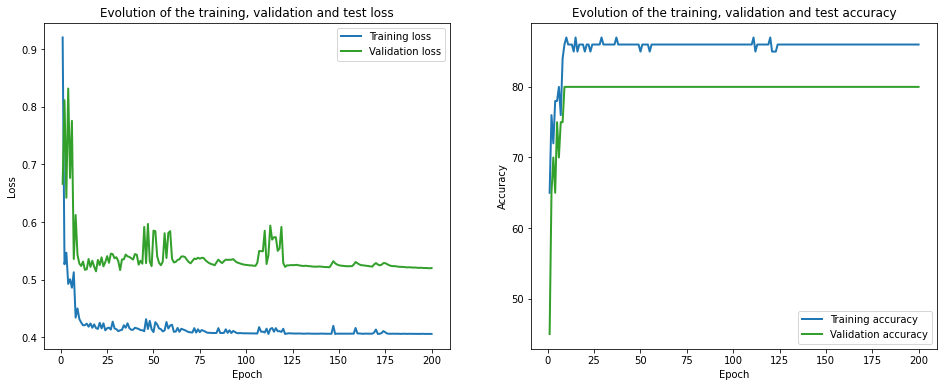

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 154.59it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1062.28it/s]

Finished computing p-values for 500 test points.

Starting repetition 46 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.74 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 1.34 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.68 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 1.16 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 1.05 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 0.76 val_acc = 70.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.72 train_acc: 60.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss:

Epoch 15 of 200, 60% 	 train_loss: 0.64 train_acc: 70.00% took: 0.02s
Epoch 15 of 200, 70% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 15 of 200, 80% 	 train_loss: 0.24 train_acc: 100.00% took: 0.01s
Epoch 15 of 200, 90% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 15 of 200, 100% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
val_loss = 0.60 val_acc = 70.00%
Snapshot saved at epoch 15.
Epoch 16 of 200, 10% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 20% 	 train_loss: 0.65 train_acc: 60.00% took: 0.00s
Epoch 16 of 200, 30% 	 train_loss: 0.64 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 40% 	 train_loss: 0.97 train_acc: 60.00% took: 0.00s
Epoch 16 of 200, 50% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 60% 	 train_loss: 0.62 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 70% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 80% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 90% 	

Epoch 26 of 200, 50% 	 train_loss: 0.59 train_acc: 60.00% took: 0.00s
Epoch 26 of 200, 60% 	 train_loss: 1.32 train_acc: 50.00% took: 0.00s
Epoch 26 of 200, 70% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 26 of 200, 80% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 26 of 200, 90% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 26 of 200, 100% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
val_loss = 0.62 val_acc = 70.00%
Snapshot saved at epoch 26.
Epoch 27 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 20% 	 train_loss: 0.61 train_acc: 60.00% took: 0.00s
Epoch 27 of 200, 30% 	 train_loss: 0.65 train_acc: 70.00% took: 0.00s
Epoch 27 of 200, 40% 	 train_loss: 0.72 train_acc: 60.00% took: 0.00s
Epoch 27 of 200, 50% 	 train_loss: 0.69 train_acc: 30.00% took: 0.00s
Epoch 27 of 200, 60% 	 train_loss: 1.40 train_acc: 50.00% took: 0.00s
Epoch 27 of 200, 70% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 80% 	 t

Epoch 41 of 200, 100% 	 train_loss: 0.15 train_acc: 100.00% took: 0.01s
val_loss = 0.71 val_acc = 70.00%
Snapshot saved at epoch 41.
Epoch 42 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 42 of 200, 20% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 42 of 200, 30% 	 train_loss: 0.66 train_acc: 70.00% took: 0.00s
Epoch 42 of 200, 40% 	 train_loss: 0.91 train_acc: 60.00% took: 0.00s
Epoch 42 of 200, 50% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 42 of 200, 60% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 42 of 200, 70% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 42 of 200, 80% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 42 of 200, 90% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 42 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 0.72 val_acc = 70.00%
Snapshot saved at epoch 42.
Epoch 43 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 43 of 200, 20% 	 train_l

Epoch 57 of 200, 100% 	 train_loss: 0.16 train_acc: 90.00% took: 0.02s
val_loss = 1.04 val_acc = 65.00%
Snapshot saved at epoch 57.
Epoch 58 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 58 of 200, 20% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 58 of 200, 30% 	 train_loss: 0.64 train_acc: 70.00% took: 0.00s
Epoch 58 of 200, 40% 	 train_loss: 0.86 train_acc: 60.00% took: 0.00s
Epoch 58 of 200, 50% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 60% 	 train_loss: 0.74 train_acc: 60.00% took: 0.00s
Epoch 58 of 200, 70% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 58 of 200, 80% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 58 of 200, 90% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 1.20 val_acc = 65.00%
Snapshot saved at epoch 58.
Epoch 59 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 59 of 200, 20% 	 train_lo

Epoch 72 of 200, 90% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 72 of 200, 100% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
val_loss = 1.07 val_acc = 70.00%
Snapshot saved at epoch 72.
Epoch 73 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 73 of 200, 20% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
Epoch 73 of 200, 30% 	 train_loss: 0.71 train_acc: 70.00% took: 0.00s
Epoch 73 of 200, 40% 	 train_loss: 0.91 train_acc: 60.00% took: 0.00s
Epoch 73 of 200, 50% 	 train_loss: 0.25 train_acc: 100.00% took: 0.00s
Epoch 73 of 200, 60% 	 train_loss: 0.64 train_acc: 60.00% took: 0.00s
Epoch 73 of 200, 70% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 73 of 200, 80% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 73 of 200, 90% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 73 of 200, 100% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
val_loss = 0.98 val_acc = 65.00%
Snapshot saved at epoch 73.
Epoch 74 of 200, 10% 	 train_l

Epoch 83 of 200, 80% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 83 of 200, 90% 	 train_loss: 0.18 train_acc: 100.00% took: 0.01s
Epoch 83 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 1.02 val_acc = 75.00%
Snapshot saved at epoch 83.
Epoch 84 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 84 of 200, 20% 	 train_loss: 0.94 train_acc: 70.00% took: 0.00s
Epoch 84 of 200, 30% 	 train_loss: 1.48 train_acc: 60.00% took: 0.00s
Epoch 84 of 200, 40% 	 train_loss: 2.09 train_acc: 70.00% took: 0.00s
Epoch 84 of 200, 50% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 84 of 200, 60% 	 train_loss: 0.64 train_acc: 70.00% took: 0.00s
Epoch 84 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 84 of 200, 80% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 84 of 200, 90% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
Epoch 84 of 200, 100% 	 train_loss: 2.14 train_acc: 90.00% took: 0.00s
val_loss = 3.14 val_a

Epoch 99 of 200, 60% 	 train_loss: 0.81 train_acc: 60.00% took: 0.00s
Epoch 99 of 200, 70% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 99 of 200, 80% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 99 of 200, 90% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 99 of 200, 100% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
val_loss = 1.35 val_acc = 65.00%
Snapshot saved at epoch 99.
Epoch 100 of 200, 10% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 100 of 200, 20% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 100 of 200, 30% 	 train_loss: 0.61 train_acc: 70.00% took: 0.00s
Epoch 100 of 200, 40% 	 train_loss: 0.81 train_acc: 60.00% took: 0.00s
Epoch 100 of 200, 50% 	 train_loss: 0.28 train_acc: 100.00% took: 0.00s
Epoch 100 of 200, 60% 	 train_loss: 0.85 train_acc: 60.00% took: 0.00s
Epoch 100 of 200, 70% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 100 of 200, 80% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 100 of 2

Epoch 110 of 200, 70% 	 train_loss: 0.16 train_acc: 100.00% took: 0.01s
Epoch 110 of 200, 80% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 110 of 200, 90% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 110 of 200, 100% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
val_loss = 1.66 val_acc = 65.00%
Snapshot saved at epoch 110.
Epoch 111 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 20% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 111 of 200, 30% 	 train_loss: 0.61 train_acc: 70.00% took: 0.00s
Epoch 111 of 200, 40% 	 train_loss: 0.80 train_acc: 60.00% took: 0.01s
Epoch 111 of 200, 50% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 111 of 200, 60% 	 train_loss: 0.82 train_acc: 60.00% took: 0.00s
Epoch 111 of 200, 70% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 80% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 90% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 1

Epoch 121 of 200, 70% 	 train_loss: 0.15 train_acc: 100.00% took: 0.02s
Epoch 121 of 200, 80% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 121 of 200, 90% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 121 of 200, 100% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
val_loss = 1.32 val_acc = 70.00%
Snapshot saved at epoch 121.
Epoch 122 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 122 of 200, 20% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 122 of 200, 30% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 122 of 200, 40% 	 train_loss: 0.66 train_acc: 70.00% took: 0.00s
Epoch 122 of 200, 50% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 122 of 200, 60% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 122 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 122 of 200, 80% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 122 of 200, 90% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch

val_loss = 1.83 val_acc = 65.00%
Snapshot saved at epoch 136.
Epoch 137 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 137 of 200, 20% 	 train_loss: 0.65 train_acc: 70.00% took: 0.00s
Epoch 137 of 200, 30% 	 train_loss: 0.61 train_acc: 70.00% took: 0.00s
Epoch 137 of 200, 40% 	 train_loss: 1.41 train_acc: 60.00% took: 0.00s
Epoch 137 of 200, 50% 	 train_loss: 0.25 train_acc: 100.00% took: 0.00s
Epoch 137 of 200, 60% 	 train_loss: 0.68 train_acc: 70.00% took: 0.00s
Epoch 137 of 200, 70% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 137 of 200, 80% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 137 of 200, 90% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 137 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 1.59 val_acc = 65.00%
Snapshot saved at epoch 137.
Epoch 138 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 138 of 200, 20% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
Epoch 138 of 200, 

val_loss = 2.11 val_acc = 65.00%
Snapshot saved at epoch 148.
Epoch 149 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 149 of 200, 20% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 149 of 200, 30% 	 train_loss: 0.68 train_acc: 70.00% took: 0.00s
Epoch 149 of 200, 40% 	 train_loss: 0.63 train_acc: 60.00% took: 0.00s
Epoch 149 of 200, 50% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 149 of 200, 60% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 149 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 149 of 200, 80% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 149 of 200, 90% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 149 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 2.05 val_acc = 65.00%
Snapshot saved at epoch 149.
Epoch 150 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 150 of 200, 20% 	 train_loss: 0.66 train_acc: 70.00% took: 0.00s
Epoch 150 of 200,

Epoch 165 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.01s
Epoch 165 of 200, 20% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 165 of 200, 30% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 165 of 200, 40% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 165 of 200, 50% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 165 of 200, 60% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 165 of 200, 70% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 165 of 200, 80% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 165 of 200, 90% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 165 of 200, 100% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
val_loss = 2.44 val_acc = 65.00%
Snapshot saved at epoch 165.
Epoch 166 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 166 of 200, 20% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 166 of 200, 30% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 16

val_loss = 2.67 val_acc = 70.00%
Snapshot saved at epoch 180.
Epoch 181 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.01s
Epoch 181 of 200, 20% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 181 of 200, 30% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 181 of 200, 40% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 181 of 200, 50% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 181 of 200, 60% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 181 of 200, 70% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 181 of 200, 80% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 181 of 200, 90% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 181 of 200, 100% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
val_loss = 2.70 val_acc = 65.00%
Snapshot saved at epoch 181.
Epoch 182 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 182 of 200, 20% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 182 of 200,

val_loss = 1.59 val_acc = 70.00%
Snapshot saved at epoch 191.
Epoch 192 of 200, 10% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 192 of 200, 20% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 192 of 200, 30% 	 train_loss: 0.62 train_acc: 70.00% took: 0.00s
Epoch 192 of 200, 40% 	 train_loss: 0.66 train_acc: 70.00% took: 0.00s
Epoch 192 of 200, 50% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 192 of 200, 60% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 192 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 192 of 200, 80% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 192 of 200, 90% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 192 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 2.41 val_acc = 65.00%
Snapshot saved at epoch 192.
Epoch 193 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 193 of 200, 20% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 193 of 200,

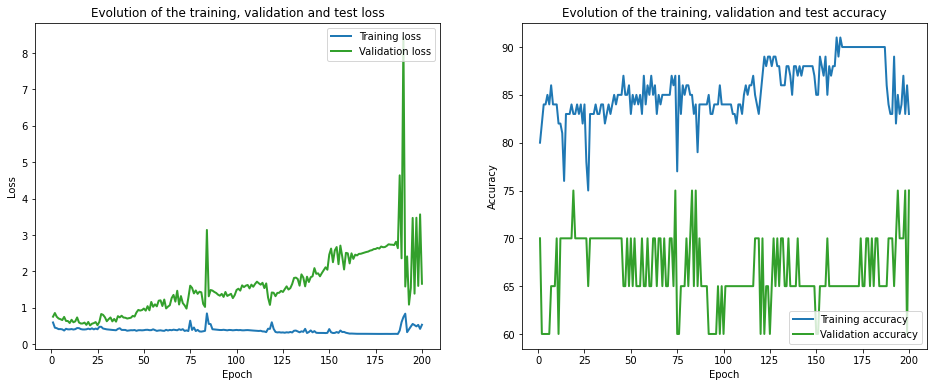

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 153.51it/s]


Initialization done!


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1087.03it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.40 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 0.65 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 1.99 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.87 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.66 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.43 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
val_loss = 0.78 val_acc = 70.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.76 train_acc: 60.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 

Epoch 17 of 200, 10% 	 train_loss: 0.03 train_acc: 100.00% took: 0.01s
Epoch 17 of 200, 20% 	 train_loss: 0.51 train_acc: 60.00% took: 0.00s
Epoch 17 of 200, 30% 	 train_loss: 0.83 train_acc: 70.00% took: 0.00s
Epoch 17 of 200, 40% 	 train_loss: 0.81 train_acc: 60.00% took: 0.00s
Epoch 17 of 200, 50% 	 train_loss: 0.47 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 60% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 17 of 200, 70% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 80% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 90% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 100% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
val_loss = 0.81 val_acc = 70.00%
Snapshot saved at epoch 17.
Epoch 18 of 200, 10% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 18 of 200, 20% 	 train_loss: 0.47 train_acc: 60.00% took: 0.00s
Epoch 18 of 200, 30% 	 train_loss: 0.78 train_acc: 70.00% took: 0.00s
Epoch 18 of 200, 40% 	 

Epoch 28 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.01s
Epoch 28 of 200, 20% 	 train_loss: 0.51 train_acc: 60.00% took: 0.00s
Epoch 28 of 200, 30% 	 train_loss: 0.87 train_acc: 70.00% took: 0.00s
Epoch 28 of 200, 40% 	 train_loss: 0.88 train_acc: 60.00% took: 0.00s
Epoch 28 of 200, 50% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 60% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 28 of 200, 70% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 80% 	 train_loss: 0.30 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 100% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
val_loss = 0.83 val_acc = 60.00%
Snapshot saved at epoch 28.
Epoch 29 of 200, 10% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 29 of 200, 20% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 29 of 200, 30% 	 train_loss: 0.65 train_acc: 70.00% took: 0.00s
Epoch 29 of 200, 40% 	 t

Epoch 39 of 200, 40% 	 train_loss: 0.84 train_acc: 60.00% took: 0.00s
Epoch 39 of 200, 50% 	 train_loss: 0.40 train_acc: 100.00% took: 0.00s
Epoch 39 of 200, 60% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 39 of 200, 70% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 39 of 200, 80% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 39 of 200, 90% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 39 of 200, 100% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
val_loss = 1.02 val_acc = 70.00%
Snapshot saved at epoch 39.
Epoch 40 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 40 of 200, 20% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 40 of 200, 30% 	 train_loss: 0.82 train_acc: 70.00% took: 0.00s
Epoch 40 of 200, 40% 	 train_loss: 0.84 train_acc: 60.00% took: 0.00s
Epoch 40 of 200, 50% 	 train_loss: 0.41 train_acc: 100.00% took: 0.00s
Epoch 40 of 200, 60% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 40 of 200, 70% 	

Epoch 55 of 200, 10% 	 train_loss: 0.04 train_acc: 100.00% took: 0.02s
Epoch 55 of 200, 20% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 55 of 200, 30% 	 train_loss: 0.63 train_acc: 80.00% took: 0.00s
Epoch 55 of 200, 40% 	 train_loss: 0.91 train_acc: 60.00% took: 0.00s
Epoch 55 of 200, 50% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 55 of 200, 60% 	 train_loss: 0.64 train_acc: 70.00% took: 0.00s
Epoch 55 of 200, 70% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 55 of 200, 80% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 55 of 200, 90% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 55 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 1.09 val_acc = 70.00%
Snapshot saved at epoch 55.
Epoch 56 of 200, 10% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 56 of 200, 20% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 56 of 200, 30% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 56 of 200, 40% 	 

Epoch 65 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 1.16 val_acc = 75.00%
Snapshot saved at epoch 65.
Epoch 66 of 200, 10% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 66 of 200, 20% 	 train_loss: 0.60 train_acc: 70.00% took: 0.00s
Epoch 66 of 200, 30% 	 train_loss: 0.69 train_acc: 70.00% took: 0.00s
Epoch 66 of 200, 40% 	 train_loss: 0.78 train_acc: 60.00% took: 0.00s
Epoch 66 of 200, 50% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 66 of 200, 60% 	 train_loss: 0.73 train_acc: 60.00% took: 0.00s
Epoch 66 of 200, 70% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 66 of 200, 80% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 66 of 200, 90% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 66 of 200, 100% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
val_loss = 1.23 val_acc = 70.00%
Snapshot saved at epoch 66.
Epoch 67 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 67 of 200, 20% 	 train_

val_loss = 1.13 val_acc = 70.00%
Snapshot saved at epoch 76.
Epoch 77 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 77 of 200, 20% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 77 of 200, 30% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 77 of 200, 40% 	 train_loss: 0.77 train_acc: 60.00% took: 0.00s
Epoch 77 of 200, 50% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 77 of 200, 60% 	 train_loss: 0.67 train_acc: 60.00% took: 0.00s
Epoch 77 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 77 of 200, 80% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 77 of 200, 90% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 77 of 200, 100% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
val_loss = 1.42 val_acc = 70.00%
Snapshot saved at epoch 77.
Epoch 78 of 200, 10% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 78 of 200, 20% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 78 of 200, 30% 	 train_l

Epoch 92 of 200, 80% 	 train_loss: 0.19 train_acc: 100.00% took: 0.01s
Epoch 92 of 200, 90% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 92 of 200, 100% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
val_loss = 1.22 val_acc = 75.00%
Snapshot saved at epoch 92.
Epoch 93 of 200, 10% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 93 of 200, 20% 	 train_loss: 0.83 train_acc: 60.00% took: 0.01s
Epoch 93 of 200, 30% 	 train_loss: 0.73 train_acc: 70.00% took: 0.00s
Epoch 93 of 200, 40% 	 train_loss: 0.75 train_acc: 70.00% took: 0.00s
Epoch 93 of 200, 50% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 93 of 200, 60% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 93 of 200, 70% 	 train_loss: 0.14 train_acc: 100.00% took: 0.02s
Epoch 93 of 200, 80% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 93 of 200, 90% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 93 of 200, 100% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
val_loss = 0.77 val_a

Epoch 103 of 200, 90% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 103 of 200, 100% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
val_loss = 1.73 val_acc = 75.00%
Snapshot saved at epoch 103.
Epoch 104 of 200, 10% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 104 of 200, 20% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 104 of 200, 30% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 104 of 200, 40% 	 train_loss: 0.80 train_acc: 60.00% took: 0.00s
Epoch 104 of 200, 50% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 104 of 200, 60% 	 train_loss: 0.66 train_acc: 60.00% took: 0.00s
Epoch 104 of 200, 70% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 104 of 200, 80% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 104 of 200, 90% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 104 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 1.85 val_acc = 65.00%
Snapshot saved at epoch 104.
Epoch 105 of 20

Epoch 114 of 200, 40% 	 train_loss: 0.68 train_acc: 60.00% took: 0.02s
Epoch 114 of 200, 50% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 114 of 200, 60% 	 train_loss: 0.61 train_acc: 70.00% took: 0.00s
Epoch 114 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 114 of 200, 80% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 114 of 200, 90% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 114 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 1.71 val_acc = 70.00%
Snapshot saved at epoch 114.
Epoch 115 of 200, 10% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 115 of 200, 20% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 115 of 200, 30% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 115 of 200, 40% 	 train_loss: 0.78 train_acc: 60.00% took: 0.00s
Epoch 115 of 200, 50% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 115 of 200, 60% 	 train_loss: 0.61 train_acc: 70.00% took: 0.00s
Epoch 11

Epoch 125 of 200, 60% 	 train_loss: 0.65 train_acc: 60.00% took: 0.00s
Epoch 125 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 125 of 200, 80% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 125 of 200, 90% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 125 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 2.00 val_acc = 75.00%
Snapshot saved at epoch 125.
Epoch 126 of 200, 10% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 126 of 200, 20% 	 train_loss: 0.80 train_acc: 70.00% took: 0.00s
Epoch 126 of 200, 30% 	 train_loss: 0.94 train_acc: 70.00% took: 0.00s
Epoch 126 of 200, 40% 	 train_loss: 1.17 train_acc: 60.00% took: 0.00s
Epoch 126 of 200, 50% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 126 of 200, 60% 	 train_loss: 0.70 train_acc: 60.00% took: 0.00s
Epoch 126 of 200, 70% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 126 of 200, 80% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 1

Epoch 136 of 200, 40% 	 train_loss: 1.20 train_acc: 60.00% took: 0.00s
Epoch 136 of 200, 50% 	 train_loss: 0.20 train_acc: 100.00% took: 0.01s
Epoch 136 of 200, 60% 	 train_loss: 0.69 train_acc: 60.00% took: 0.00s
Epoch 136 of 200, 70% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 136 of 200, 80% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 136 of 200, 90% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 136 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 1.72 val_acc = 75.00%
Snapshot saved at epoch 136.
Epoch 137 of 200, 10% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 137 of 200, 20% 	 train_loss: 0.73 train_acc: 60.00% took: 0.00s
Epoch 137 of 200, 30% 	 train_loss: 0.68 train_acc: 70.00% took: 0.00s
Epoch 137 of 200, 40% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 137 of 200, 50% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 137 of 200, 60% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 13

Epoch 147 of 200, 60% 	 train_loss: 0.54 train_acc: 70.00% took: 0.02s
Epoch 147 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 147 of 200, 80% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 147 of 200, 90% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 147 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 2.15 val_acc = 60.00%
Snapshot saved at epoch 147.
Epoch 148 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 148 of 200, 20% 	 train_loss: 0.60 train_acc: 70.00% took: 0.00s
Epoch 148 of 200, 30% 	 train_loss: 0.60 train_acc: 70.00% took: 0.00s
Epoch 148 of 200, 40% 	 train_loss: 1.25 train_acc: 70.00% took: 0.00s
Epoch 148 of 200, 50% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 148 of 200, 60% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 148 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 148 of 200, 80% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 1

Epoch 162 of 200, 80% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 162 of 200, 90% 	 train_loss: 2.58 train_acc: 90.00% took: 0.00s
Epoch 162 of 200, 100% 	 train_loss: 2.65 train_acc: 80.00% took: 0.00s
val_loss = 2.04 val_acc = 70.00%
Snapshot saved at epoch 162.
Epoch 163 of 200, 10% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 163 of 200, 20% 	 train_loss: 7.65 train_acc: 60.00% took: 0.00s
Epoch 163 of 200, 30% 	 train_loss: 0.89 train_acc: 70.00% took: 0.00s
Epoch 163 of 200, 40% 	 train_loss: 19.88 train_acc: 60.00% took: 0.00s
Epoch 163 of 200, 50% 	 train_loss: 0.54 train_acc: 90.00% took: 0.00s
Epoch 163 of 200, 60% 	 train_loss: 0.67 train_acc: 60.00% took: 0.00s
Epoch 163 of 200, 70% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 163 of 200, 80% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 163 of 200, 90% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 163 of 200, 100% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
val_loss

Epoch 174 of 200, 10% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 174 of 200, 20% 	 train_loss: 0.55 train_acc: 70.00% took: 0.01s
Epoch 174 of 200, 30% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 174 of 200, 40% 	 train_loss: 0.79 train_acc: 70.00% took: 0.00s
Epoch 174 of 200, 50% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 60% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 174 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 174 of 200, 80% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 174 of 200, 90% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 174 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 1.51 val_acc = 75.00%
Snapshot saved at epoch 174.
Epoch 175 of 200, 10% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 175 of 200, 20% 	 train_loss: 0.63 train_acc: 80.00% took: 0.00s
Epoch 175 of 200, 30% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 17

Epoch 184 of 200, 80% 	 train_loss: 0.11 train_acc: 100.00% took: 0.02s
Epoch 184 of 200, 90% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 184 of 200, 100% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
val_loss = 1.55 val_acc = 65.00%
Snapshot saved at epoch 184.
Epoch 185 of 200, 10% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 185 of 200, 20% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 185 of 200, 30% 	 train_loss: 0.87 train_acc: 70.00% took: 0.00s
Epoch 185 of 200, 40% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 185 of 200, 50% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 185 of 200, 60% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 185 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 185 of 200, 80% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 185 of 200, 90% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 185 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_l

Epoch 195 of 200, 60% 	 train_loss: 0.70 train_acc: 60.00% took: 0.00s
Epoch 195 of 200, 70% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 195 of 200, 80% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 195 of 200, 90% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 195 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 2.18 val_acc = 75.00%
Snapshot saved at epoch 195.
Epoch 196 of 200, 10% 	 train_loss: 0.02 train_acc: 100.00% took: 0.00s
Epoch 196 of 200, 20% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 30% 	 train_loss: 0.88 train_acc: 80.00% took: 0.00s
Epoch 196 of 200, 40% 	 train_loss: 0.66 train_acc: 60.00% took: 0.00s
Epoch 196 of 200, 50% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 196 of 200, 60% 	 train_loss: 0.66 train_acc: 60.00% took: 0.00s
Epoch 196 of 200, 70% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 196 of 200, 80% 	 train_loss: 0.20 train_acc: 100.00% took: 0.00s
Epoch 19

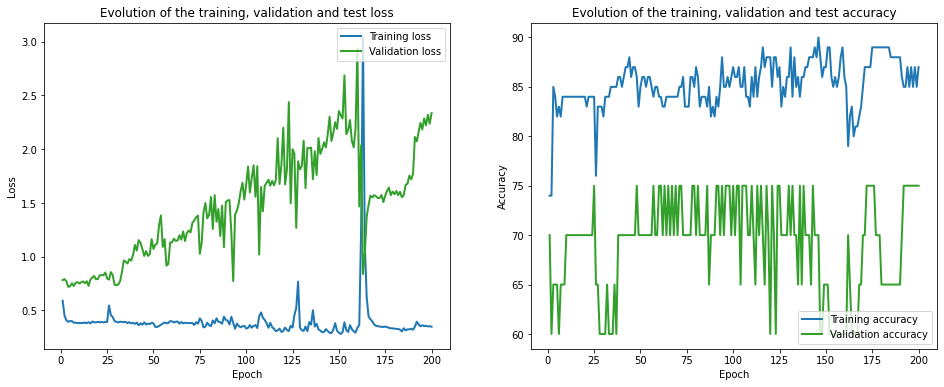

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 147.34it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1162.85it/s]

Finished computing p-values for 500 test points.

Starting repetition 47 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 1.16 train_acc: 20.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 1.79 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 2.63 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.01 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 3.95 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 1.14 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.44 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.26 train_acc: 100.00% took: 0.00s
val_loss = 0.25 val_acc = 80.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0

Epoch 11 of 200, 90% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 11 of 200, 100% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
val_loss = 0.43 val_acc = 80.00%
Snapshot saved at epoch 11.
Epoch 12 of 200, 10% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 20% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 30% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 40% 	 train_loss: 0.83 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 50% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 60% 	 train_loss: 0.61 train_acc: 70.00% took: 0.00s
Epoch 12 of 200, 70% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 80% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 90% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 100% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
val_loss = 0.39 val_acc = 80.00%
Snapshot saved at epoch 12.
Epoch 13 of 200, 10% 	 train_loss

Epoch 27 of 200, 20% 	 train_loss: 0.40 train_acc: 80.00% took: 0.02s
Epoch 27 of 200, 30% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 40% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 50% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 60% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 27 of 200, 70% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 80% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 90% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 100% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
val_loss = 0.46 val_acc = 85.00%
Snapshot saved at epoch 27.
Epoch 28 of 200, 10% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 20% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 30% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 40% 	 train_loss: 0.58 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 50% 	 tr

val_loss = 0.46 val_acc = 85.00%
Snapshot saved at epoch 37.
Epoch 38 of 200, 10% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 20% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 30% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 40% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 60% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 38 of 200, 70% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 80% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 90% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
val_loss = 0.47 val_acc = 85.00%
Snapshot saved at epoch 38.
Epoch 39 of 200, 10% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 39 of 200, 20% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 39 of 200, 30% 	 train_loss:

Epoch 48 of 200, 100% 	 train_loss: 0.27 train_acc: 90.00% took: 0.02s
val_loss = 0.50 val_acc = 85.00%
Snapshot saved at epoch 48.
Epoch 49 of 200, 10% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 49 of 200, 20% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 49 of 200, 30% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 49 of 200, 40% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 49 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 49 of 200, 60% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 49 of 200, 70% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 49 of 200, 80% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 49 of 200, 90% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 49 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
val_loss = 0.50 val_acc = 85.00%
Snapshot saved at epoch 49.
Epoch 50 of 200, 10% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 50 of 200, 20% 	 train_loss:

Epoch 65 of 200, 80% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 65 of 200, 90% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 65 of 200, 100% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
val_loss = 0.57 val_acc = 85.00%
Snapshot saved at epoch 65.
Epoch 66 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 66 of 200, 20% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
Epoch 66 of 200, 30% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 66 of 200, 40% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 66 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 66 of 200, 60% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 66 of 200, 70% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 66 of 200, 80% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 66 of 200, 90% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 66 of 200, 100% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
val_loss = 0.54 val_acc

Epoch 80 of 200, 100% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
val_loss = 0.56 val_acc = 85.00%
Snapshot saved at epoch 80.
Epoch 81 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 81 of 200, 20% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 81 of 200, 30% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 81 of 200, 40% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 81 of 200, 50% 	 train_loss: 0.19 train_acc: 90.00% took: 0.02s
Epoch 81 of 200, 60% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 81 of 200, 70% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 81 of 200, 80% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 81 of 200, 90% 	 train_loss: 0.22 train_acc: 100.00% took: 0.00s
Epoch 81 of 200, 100% 	 train_loss: 0.25 train_acc: 90.00% took: 0.02s
val_loss = 0.58 val_acc = 85.00%
Snapshot saved at epoch 81.
Epoch 82 of 200, 10% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 82 of 200, 20% 	 train_loss

Epoch 97 of 200, 10% 	 train_loss: 0.11 train_acc: 100.00% took: 0.01s
Epoch 97 of 200, 20% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
Epoch 97 of 200, 30% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 97 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 97 of 200, 50% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 97 of 200, 60% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 97 of 200, 70% 	 train_loss: 0.23 train_acc: 90.00% took: 0.02s
Epoch 97 of 200, 80% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 97 of 200, 90% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 97 of 200, 100% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
val_loss = 0.59 val_acc = 85.00%
Snapshot saved at epoch 97.
Epoch 98 of 200, 10% 	 train_loss: 0.11 train_acc: 100.00% took: 0.02s
Epoch 98 of 200, 20% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 98 of 200, 30% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 98 of 200, 40% 	 tra

Epoch 108 of 200, 40% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 108 of 200, 50% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 108 of 200, 60% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 108 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 108 of 200, 80% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 108 of 200, 90% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 108 of 200, 100% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
val_loss = 0.57 val_acc = 85.00%
Snapshot saved at epoch 108.
Epoch 109 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 109 of 200, 20% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 109 of 200, 30% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 109 of 200, 40% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 109 of 200, 50% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 109 of 200, 60% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 109 of 

Epoch 119 of 200, 80% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 119 of 200, 90% 	 train_loss: 0.15 train_acc: 100.00% took: 0.01s
Epoch 119 of 200, 100% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
val_loss = 0.57 val_acc = 85.00%
Snapshot saved at epoch 119.
Epoch 120 of 200, 10% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 120 of 200, 20% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
Epoch 120 of 200, 30% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 120 of 200, 40% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 120 of 200, 50% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 120 of 200, 60% 	 train_loss: 0.52 train_acc: 70.00% took: 0.02s
Epoch 120 of 200, 70% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 120 of 200, 80% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 120 of 200, 90% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 120 of 200, 100% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
val_loss = 

Epoch 135 of 200, 70% 	 train_loss: 0.22 train_acc: 90.00% took: 0.01s
Epoch 135 of 200, 80% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 135 of 200, 90% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 135 of 200, 100% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
val_loss = 0.60 val_acc = 85.00%
Snapshot saved at epoch 135.
Epoch 136 of 200, 10% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 136 of 200, 20% 	 train_loss: 0.37 train_acc: 80.00% took: 0.02s
Epoch 136 of 200, 30% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 136 of 200, 40% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 136 of 200, 50% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 136 of 200, 60% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 136 of 200, 70% 	 train_loss: 0.16 train_acc: 100.00% took: 0.02s
Epoch 136 of 200, 80% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 136 of 200, 90% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 136 of

Epoch 146 of 200, 70% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 146 of 200, 80% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 146 of 200, 90% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 146 of 200, 100% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
val_loss = 0.64 val_acc = 85.00%
Snapshot saved at epoch 146.
Epoch 147 of 200, 10% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 147 of 200, 20% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 147 of 200, 30% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 147 of 200, 40% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 147 of 200, 50% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 147 of 200, 60% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 147 of 200, 70% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 147 of 200, 80% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 147 of 200, 90% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 147 of 

val_loss = 0.66 val_acc = 85.00%
Snapshot saved at epoch 157.
Epoch 158 of 200, 10% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 158 of 200, 20% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 158 of 200, 30% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 158 of 200, 40% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 158 of 200, 50% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 158 of 200, 60% 	 train_loss: 0.40 train_acc: 70.00% took: 0.00s
Epoch 158 of 200, 70% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 158 of 200, 80% 	 train_loss: 0.19 train_acc: 80.00% took: 0.00s
Epoch 158 of 200, 90% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 158 of 200, 100% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
val_loss = 0.63 val_acc = 85.00%
Snapshot saved at epoch 158.
Epoch 159 of 200, 10% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 159 of 200, 20% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 159 of 200, 30% 

Epoch 172 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 172 of 200, 80% 	 train_loss: 0.19 train_acc: 80.00% took: 0.00s
Epoch 172 of 200, 90% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 172 of 200, 100% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
val_loss = 0.65 val_acc = 85.00%
Snapshot saved at epoch 172.
Epoch 173 of 200, 10% 	 train_loss: 0.13 train_acc: 90.00% took: 0.01s
Epoch 173 of 200, 20% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 173 of 200, 30% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 173 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 173 of 200, 50% 	 train_loss: 0.21 train_acc: 90.00% took: 0.01s
Epoch 173 of 200, 60% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 173 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 173 of 200, 80% 	 train_loss: 0.19 train_acc: 80.00% took: 0.00s
Epoch 173 of 200, 90% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 173 of 2

val_loss = 0.65 val_acc = 85.00%
Snapshot saved at epoch 186.
Epoch 187 of 200, 10% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 187 of 200, 20% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 187 of 200, 30% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 187 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 187 of 200, 50% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 187 of 200, 60% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 187 of 200, 70% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 187 of 200, 80% 	 train_loss: 0.19 train_acc: 80.00% took: 0.00s
Epoch 187 of 200, 90% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 187 of 200, 100% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
val_loss = 0.68 val_acc = 85.00%
Snapshot saved at epoch 187.
Epoch 188 of 200, 10% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 188 of 200, 20% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 188 of 200, 30% 	

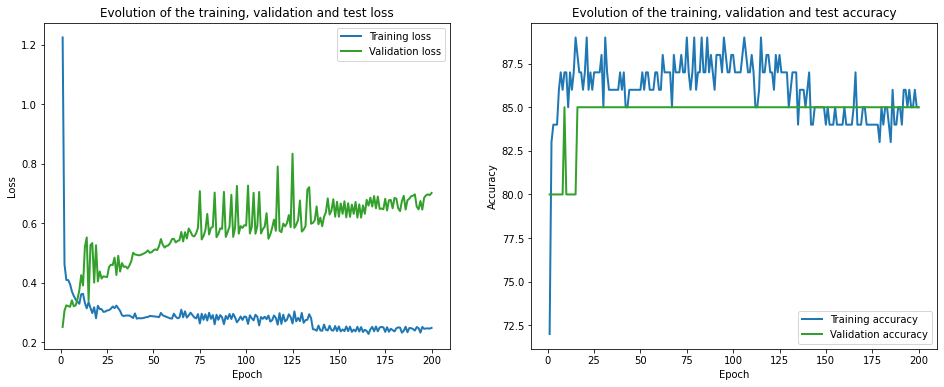

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 155.60it/s]


Initialization done!


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1120.45it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 1.01 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 1.57 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
val_loss = 0.73 val_acc = 75.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0

Epoch 11 of 200, 90% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 11 of 200, 100% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
val_loss = 0.58 val_acc = 85.00%
Snapshot saved at epoch 11.
Epoch 12 of 200, 10% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 20% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 30% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 40% 	 train_loss: 0.63 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 50% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 60% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 12 of 200, 70% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 80% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 90% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 100% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
val_loss = 0.59 val_acc = 85.00%
Snapshot saved at epoch 12.
Epoch 13 of 200, 10% 	 train_los

Epoch 27 of 200, 20% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 30% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 40% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 50% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 60% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 70% 	 train_loss: 0.26 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 80% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 90% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 100% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
val_loss = 0.49 val_acc = 85.00%
Snapshot saved at epoch 27.
Epoch 28 of 200, 10% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 20% 	 train_loss: 0.58 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 30% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 40% 	 train_loss: 0.54 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 50% 	 tra

Epoch 38 of 200, 60% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 38 of 200, 70% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 80% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 90% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 100% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
val_loss = 0.52 val_acc = 85.00%
Snapshot saved at epoch 38.
Epoch 39 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 39 of 200, 20% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 39 of 200, 30% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 39 of 200, 40% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 39 of 200, 50% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 39 of 200, 60% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 39 of 200, 70% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 39 of 200, 80% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 39 of 200, 90% 	 tra

Epoch 50 of 200, 30% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 50 of 200, 40% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 50 of 200, 50% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 50 of 200, 60% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 50 of 200, 70% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 50 of 200, 80% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 50 of 200, 90% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 50 of 200, 100% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
val_loss = 0.57 val_acc = 85.00%
Snapshot saved at epoch 50.
Epoch 51 of 200, 10% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 51 of 200, 20% 	 train_loss: 0.68 train_acc: 80.00% took: 0.00s
Epoch 51 of 200, 30% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 51 of 200, 40% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 51 of 200, 50% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 51 of 200, 60% 	 tra

Epoch 66 of 200, 70% 	 train_loss: 0.20 train_acc: 100.00% took: 0.02s
Epoch 66 of 200, 80% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 66 of 200, 90% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 66 of 200, 100% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
val_loss = 0.55 val_acc = 85.00%
Snapshot saved at epoch 66.
Epoch 67 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 67 of 200, 20% 	 train_loss: 0.56 train_acc: 80.00% took: 0.00s
Epoch 67 of 200, 30% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 67 of 200, 40% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 67 of 200, 50% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 67 of 200, 60% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 67 of 200, 70% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 67 of 200, 80% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 67 of 200, 90% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 67 of 200, 100% 	 t

Epoch 77 of 200, 60% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 77 of 200, 70% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 77 of 200, 80% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 77 of 200, 90% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 77 of 200, 100% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
val_loss = 0.59 val_acc = 85.00%
Snapshot saved at epoch 77.
Epoch 78 of 200, 10% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 78 of 200, 20% 	 train_loss: 0.63 train_acc: 80.00% took: 0.00s
Epoch 78 of 200, 30% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 78 of 200, 40% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 78 of 200, 50% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 78 of 200, 60% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 78 of 200, 70% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 78 of 200, 80% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 78 of 200, 90% 	 trai

Epoch 89 of 200, 10% 	 train_loss: 0.09 train_acc: 100.00% took: 0.02s
Epoch 89 of 200, 20% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
Epoch 89 of 200, 30% 	 train_loss: 0.28 train_acc: 100.00% took: 0.00s
Epoch 89 of 200, 40% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 89 of 200, 50% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 60% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 89 of 200, 70% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 89 of 200, 80% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 90% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 89 of 200, 100% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
val_loss = 0.58 val_acc = 85.00%
Snapshot saved at epoch 89.
Epoch 90 of 200, 10% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 90 of 200, 20% 	 train_loss: 0.61 train_acc: 80.00% took: 0.00s
Epoch 90 of 200, 30% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 90 of 200, 40% 	 t

Epoch 99 of 200, 90% 	 train_loss: 0.17 train_acc: 90.00% took: 0.01s
Epoch 99 of 200, 100% 	 train_loss: 0.26 train_acc: 70.00% took: 0.01s
val_loss = 0.75 val_acc = 85.00%
Snapshot saved at epoch 99.
Epoch 100 of 200, 10% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 100 of 200, 20% 	 train_loss: 0.64 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 30% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 40% 	 train_loss: 0.44 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 50% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 60% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 100 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 80% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 90% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 100% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
val_loss = 0.58 val_acc = 85.00%
Snapshot saved at epoch 100.
Epoch 101 of 200, 10% 	 

Epoch 110 of 200, 100% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
val_loss = 0.57 val_acc = 85.00%
Snapshot saved at epoch 110.
Epoch 111 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 20% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 111 of 200, 30% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 40% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 111 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 60% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 111 of 200, 70% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 111 of 200, 80% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 90% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 111 of 200, 100% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
val_loss = 0.59 val_acc = 85.00%
Snapshot saved at epoch 111.
Epoch 112 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 112 of 200, 2

Epoch 127 of 200, 30% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 127 of 200, 40% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 127 of 200, 50% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 127 of 200, 60% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 127 of 200, 70% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 127 of 200, 80% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 127 of 200, 90% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 127 of 200, 100% 	 train_loss: 0.24 train_acc: 70.00% took: 0.00s
val_loss = 0.63 val_acc = 85.00%
Snapshot saved at epoch 127.
Epoch 128 of 200, 10% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 128 of 200, 20% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
Epoch 128 of 200, 30% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 128 of 200, 40% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 128 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 128 of 

val_loss = 0.78 val_acc = 85.00%
Snapshot saved at epoch 138.
Epoch 139 of 200, 10% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 139 of 200, 20% 	 train_loss: 0.63 train_acc: 80.00% took: 0.00s
Epoch 139 of 200, 30% 	 train_loss: 0.19 train_acc: 100.00% took: 0.00s
Epoch 139 of 200, 40% 	 train_loss: 0.45 train_acc: 90.00% took: 0.00s
Epoch 139 of 200, 50% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 139 of 200, 60% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 139 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 139 of 200, 80% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 139 of 200, 90% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 139 of 200, 100% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
val_loss = 0.59 val_acc = 85.00%
Snapshot saved at epoch 139.
Epoch 140 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 140 of 200, 20% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 140 of 200, 30

Epoch 149 of 200, 60% 	 train_loss: 0.41 train_acc: 70.00% took: 0.02s
Epoch 149 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 149 of 200, 80% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 149 of 200, 90% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 149 of 200, 100% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
val_loss = 0.66 val_acc = 85.00%
Snapshot saved at epoch 149.
Epoch 150 of 200, 10% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 20% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 150 of 200, 30% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 150 of 200, 40% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 50% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 60% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 150 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 80% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 150 of 2

Epoch 160 of 200, 90% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 160 of 200, 100% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
val_loss = 0.63 val_acc = 85.00%
Snapshot saved at epoch 160.
Epoch 161 of 200, 10% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 161 of 200, 20% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 161 of 200, 30% 	 train_loss: 0.21 train_acc: 80.00% took: 0.01s
Epoch 161 of 200, 40% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 161 of 200, 50% 	 train_loss: 0.21 train_acc: 90.00% took: 0.01s
Epoch 161 of 200, 60% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 161 of 200, 70% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 161 of 200, 80% 	 train_loss: 0.20 train_acc: 80.00% took: 0.01s
Epoch 161 of 200, 90% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 161 of 200, 100% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
val_loss = 0.68 val_acc = 85.00%
Snapshot saved at epoch 161.
Epoch 162 of 200, 10% 

Epoch 177 of 200, 10% 	 train_loss: 0.13 train_acc: 90.00% took: 0.01s
Epoch 177 of 200, 20% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 177 of 200, 30% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 177 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 177 of 200, 50% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 177 of 200, 60% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 177 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 177 of 200, 80% 	 train_loss: 0.19 train_acc: 80.00% took: 0.00s
Epoch 177 of 200, 90% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 177 of 200, 100% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
val_loss = 0.68 val_acc = 85.00%
Snapshot saved at epoch 177.
Epoch 178 of 200, 10% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 178 of 200, 20% 	 train_loss: 0.46 train_acc: 80.00% took: 0.02s
Epoch 178 of 200, 30% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 178 of 2

Epoch 189 of 200, 50% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 189 of 200, 60% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 189 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 189 of 200, 80% 	 train_loss: 0.19 train_acc: 80.00% took: 0.00s
Epoch 189 of 200, 90% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 189 of 200, 100% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
val_loss = 0.63 val_acc = 85.00%
Snapshot saved at epoch 189.
Epoch 190 of 200, 10% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 190 of 200, 20% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 190 of 200, 30% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 190 of 200, 40% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 190 of 200, 50% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 190 of 200, 60% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 190 of 200, 70% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 190 of 

Epoch 200 of 200, 30% 	 train_loss: 0.21 train_acc: 80.00% took: 0.00s
Epoch 200 of 200, 40% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 200 of 200, 50% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 200 of 200, 60% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 200 of 200, 70% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 200 of 200, 80% 	 train_loss: 0.19 train_acc: 80.00% took: 0.00s
Epoch 200 of 200, 90% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 200 of 200, 100% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
val_loss = 0.67 val_acc = 85.00%
Snapshot saved at epoch 200.
Training done! A list of 200 models saved.


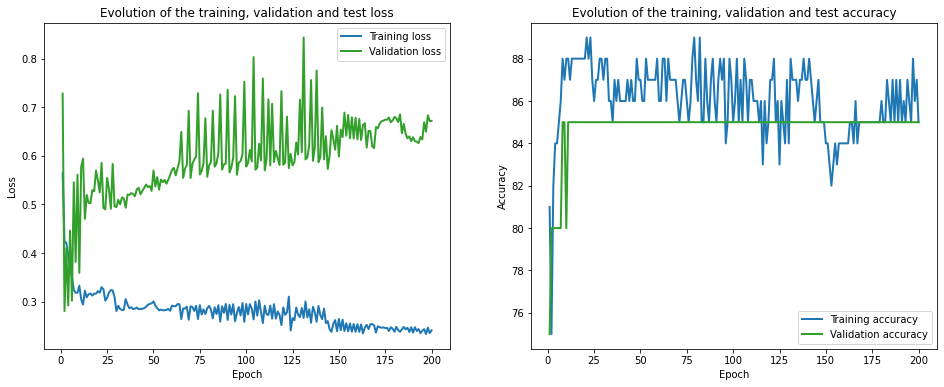

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 157.71it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1143.66it/s]

Finished computing p-values for 500 test points.

Starting repetition 48 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.79 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 1.01 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 1.29 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 1.33 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.90 train_acc: 30.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.56 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.94 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.47 train_acc: 80.00% took: 0.01s
val_loss = 0.31 val_acc = 90.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.

Epoch 16 of 200, 40% 	 train_loss: 0.71 train_acc: 50.00% took: 0.00s
Epoch 16 of 200, 50% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 60% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 16 of 200, 70% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 80% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 16 of 200, 90% 	 train_loss: 0.65 train_acc: 70.00% took: 0.00s
Epoch 16 of 200, 100% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
val_loss = 0.87 val_acc = 65.00%
Snapshot saved at epoch 16.
Epoch 17 of 200, 10% 	 train_loss: 0.08 train_acc: 100.00% took: 0.02s
Epoch 17 of 200, 20% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 30% 	 train_loss: 0.89 train_acc: 60.00% took: 0.00s
Epoch 17 of 200, 40% 	 train_loss: 0.58 train_acc: 60.00% took: 0.00s
Epoch 17 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 60% 	 train_loss: 0.25 train_acc: 90.00% took: 0.02s
Epoch 17 of 200, 70% 	

Epoch 27 of 200, 50% 	 train_loss: 0.13 train_acc: 100.00% took: 0.02s
Epoch 27 of 200, 60% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 80% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 90% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 100% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
val_loss = 0.61 val_acc = 80.00%
Snapshot saved at epoch 27.
Epoch 28 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 20% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 28 of 200, 30% 	 train_loss: 0.86 train_acc: 60.00% took: 0.00s
Epoch 28 of 200, 40% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.02s
Epoch 28 of 200, 60% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 28 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 28 of 200, 80% 	

Epoch 38 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.02s
Epoch 38 of 200, 20% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 38 of 200, 30% 	 train_loss: 0.92 train_acc: 60.00% took: 0.00s
Epoch 38 of 200, 40% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 60% 	 train_loss: 0.27 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 70% 	 train_loss: 0.03 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 80% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 90% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 100% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
val_loss = 0.67 val_acc = 85.00%
Snapshot saved at epoch 38.
Epoch 39 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 39 of 200, 20% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 39 of 200, 30% 	 train_loss: 0.91 train_acc: 60.00% took: 0.00s
Epoch 39 of 200, 40% 	

Epoch 48 of 200, 100% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
val_loss = 0.64 val_acc = 85.00%
Snapshot saved at epoch 48.
Epoch 49 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.01s
Epoch 49 of 200, 20% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 49 of 200, 30% 	 train_loss: 0.88 train_acc: 70.00% took: 0.00s
Epoch 49 of 200, 40% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 49 of 200, 50% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 49 of 200, 60% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 49 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 49 of 200, 80% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 49 of 200, 90% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 49 of 200, 100% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
val_loss = 0.65 val_acc = 85.00%
Snapshot saved at epoch 49.
Epoch 50 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 50 of 200, 20% 	 train_l

Epoch 64 of 200, 90% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 64 of 200, 100% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
val_loss = 0.65 val_acc = 85.00%
Snapshot saved at epoch 64.
Epoch 65 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 65 of 200, 20% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 65 of 200, 30% 	 train_loss: 0.97 train_acc: 70.00% took: 0.00s
Epoch 65 of 200, 40% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 65 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 65 of 200, 60% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 65 of 200, 70% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 65 of 200, 80% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 65 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 65 of 200, 100% 	 train_loss: 0.18 train_acc: 90.00% took: 0.02s
val_loss = 0.65 val_acc = 85.00%
Snapshot saved at epoch 65.
Epoch 66 of 200, 10% 	 train_los

Epoch 76 of 200, 90% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 76 of 200, 100% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
val_loss = 0.67 val_acc = 85.00%
Snapshot saved at epoch 76.
Epoch 77 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 77 of 200, 20% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 77 of 200, 30% 	 train_loss: 0.98 train_acc: 70.00% took: 0.00s
Epoch 77 of 200, 40% 	 train_loss: 0.60 train_acc: 70.00% took: 0.02s
Epoch 77 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 77 of 200, 60% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 77 of 200, 70% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 77 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 77 of 200, 90% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 77 of 200, 100% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
val_loss = 0.67 val_acc = 85.00%
Snapshot saved at epoch 77.
Epoch 78 of 200, 10% 	 train_lo

Epoch 87 of 200, 100% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
val_loss = 0.66 val_acc = 85.00%
Snapshot saved at epoch 87.
Epoch 88 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 88 of 200, 20% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 88 of 200, 30% 	 train_loss: 1.00 train_acc: 70.00% took: 0.00s
Epoch 88 of 200, 40% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 88 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 88 of 200, 60% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 88 of 200, 70% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 88 of 200, 80% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 88 of 200, 90% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 88 of 200, 100% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
val_loss = 0.67 val_acc = 85.00%
Snapshot saved at epoch 88.
Epoch 89 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 89 of 200, 20% 	 train_l

Epoch 99 of 200, 60% 	 train_loss: 0.44 train_acc: 90.00% took: 0.00s
Epoch 99 of 200, 70% 	 train_loss: 0.08 train_acc: 100.00% took: 0.01s
Epoch 99 of 200, 80% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 99 of 200, 90% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 99 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 0.70 val_acc = 85.00%
Snapshot saved at epoch 99.
Epoch 100 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 100 of 200, 20% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 30% 	 train_loss: 0.98 train_acc: 70.00% took: 0.00s
Epoch 100 of 200, 40% 	 train_loss: 0.61 train_acc: 70.00% took: 0.00s
Epoch 100 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 100 of 200, 60% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 70% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 100 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 100 of 

Epoch 110 of 200, 70% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 110 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 110 of 200, 90% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 110 of 200, 100% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
val_loss = 0.70 val_acc = 85.00%
Snapshot saved at epoch 110.
Epoch 111 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 20% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 30% 	 train_loss: 1.02 train_acc: 70.00% took: 0.00s
Epoch 111 of 200, 40% 	 train_loss: 0.60 train_acc: 70.00% took: 0.00s
Epoch 111 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 60% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 70% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 90% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 1

Epoch 121 of 200, 100% 	 train_loss: 0.14 train_acc: 100.00% took: 0.02s
val_loss = 0.74 val_acc = 85.00%
Snapshot saved at epoch 121.
Epoch 122 of 200, 10% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 122 of 200, 20% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 122 of 200, 30% 	 train_loss: 1.01 train_acc: 70.00% took: 0.00s
Epoch 122 of 200, 40% 	 train_loss: 0.68 train_acc: 60.00% took: 0.00s
Epoch 122 of 200, 50% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 122 of 200, 60% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 122 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 122 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 122 of 200, 90% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 122 of 200, 100% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
val_loss = 0.75 val_acc = 85.00%
Snapshot saved at epoch 122.
Epoch 123 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 123 of 20

Epoch 132 of 200, 90% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 132 of 200, 100% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
val_loss = 0.72 val_acc = 85.00%
Snapshot saved at epoch 132.
Epoch 133 of 200, 10% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 133 of 200, 20% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 133 of 200, 30% 	 train_loss: 1.02 train_acc: 70.00% took: 0.00s
Epoch 133 of 200, 40% 	 train_loss: 0.63 train_acc: 70.00% took: 0.00s
Epoch 133 of 200, 50% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 133 of 200, 60% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 133 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 133 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 133 of 200, 90% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 133 of 200, 100% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
val_loss = 0.70 val_acc = 85.00%
Snapshot saved at epoch 133.
Epoch 134 of 200

Epoch 144 of 200, 40% 	 train_loss: 0.73 train_acc: 70.00% took: 0.01s
Epoch 144 of 200, 50% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 144 of 200, 60% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 144 of 200, 70% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 144 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 144 of 200, 90% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 144 of 200, 100% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
val_loss = 0.78 val_acc = 80.00%
Snapshot saved at epoch 144.
Epoch 145 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 145 of 200, 20% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 145 of 200, 30% 	 train_loss: 1.01 train_acc: 70.00% took: 0.02s
Epoch 145 of 200, 40% 	 train_loss: 0.72 train_acc: 70.00% took: 0.00s
Epoch 145 of 200, 50% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 145 of 200, 60% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 14

Epoch 156 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 156 of 200, 30% 	 train_loss: 1.01 train_acc: 70.00% took: 0.00s
Epoch 156 of 200, 40% 	 train_loss: 0.69 train_acc: 70.00% took: 0.00s
Epoch 156 of 200, 50% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 156 of 200, 60% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 156 of 200, 70% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 156 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 156 of 200, 90% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 156 of 200, 100% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
val_loss = 0.78 val_acc = 80.00%
Snapshot saved at epoch 156.
Epoch 157 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 157 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 157 of 200, 30% 	 train_loss: 1.03 train_acc: 70.00% took: 0.00s
Epoch 157 of 200, 40% 	 train_loss: 0.70 train_acc: 70.00% took: 0.00s
Epoch 157 

Epoch 167 of 200, 90% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 167 of 200, 100% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
val_loss = 0.79 val_acc = 85.00%
Snapshot saved at epoch 167.
Epoch 168 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 168 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 168 of 200, 30% 	 train_loss: 1.02 train_acc: 70.00% took: 0.00s
Epoch 168 of 200, 40% 	 train_loss: 0.69 train_acc: 70.00% took: 0.00s
Epoch 168 of 200, 50% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 168 of 200, 60% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 168 of 200, 70% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 168 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 168 of 200, 90% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 168 of 200, 100% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
val_loss = 0.75 val_acc = 80.00%
Snapshot saved at epoch 168.
Epoch 169 of 200,

Epoch 179 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.01s
Epoch 179 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 179 of 200, 30% 	 train_loss: 1.04 train_acc: 70.00% took: 0.00s
Epoch 179 of 200, 40% 	 train_loss: 0.69 train_acc: 70.00% took: 0.00s
Epoch 179 of 200, 50% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 179 of 200, 60% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 179 of 200, 70% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 179 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 179 of 200, 90% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 179 of 200, 100% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
val_loss = 0.78 val_acc = 80.00%
Snapshot saved at epoch 179.
Epoch 180 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 180 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 180 of 200, 30% 	 train_loss: 1.03 train_acc: 70.00% took: 0.00s
Epoch 18

val_loss = 0.76 val_acc = 80.00%
Snapshot saved at epoch 189.
Epoch 190 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 190 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 190 of 200, 30% 	 train_loss: 1.02 train_acc: 70.00% took: 0.00s
Epoch 190 of 200, 40% 	 train_loss: 0.69 train_acc: 70.00% took: 0.00s
Epoch 190 of 200, 50% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 190 of 200, 60% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 190 of 200, 70% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 190 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 190 of 200, 90% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 190 of 200, 100% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
val_loss = 0.81 val_acc = 80.00%
Snapshot saved at epoch 190.
Epoch 191 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 191 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 191 of 200,

Epoch 200 of 200, 60% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 200 of 200, 70% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 200 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 200 of 200, 90% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 200 of 200, 100% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
val_loss = 0.80 val_acc = 80.00%
Snapshot saved at epoch 200.
Training done! A list of 200 models saved.


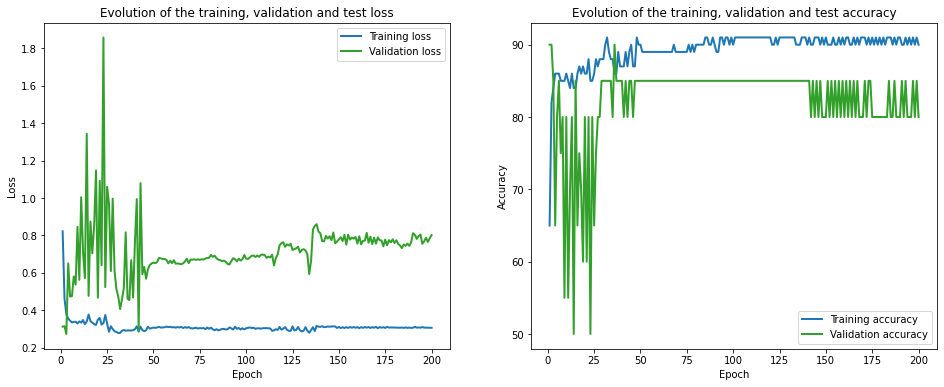

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 155.90it/s]


Initialization done!


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1063.79it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 1.02 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 2.46 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 1.48 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.89 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 1.24 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.62 train_acc: 80.00% took: 0.00s
val_loss = 0.52 val_acc = 75.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.6

Epoch 17 of 200, 10% 	 train_loss: 0.08 train_acc: 100.00% took: 0.01s
Epoch 17 of 200, 20% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 30% 	 train_loss: 0.80 train_acc: 70.00% took: 0.00s
Epoch 17 of 200, 40% 	 train_loss: 0.67 train_acc: 60.00% took: 0.00s
Epoch 17 of 200, 50% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 60% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 17 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 80% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 17 of 200, 90% 	 train_loss: 0.71 train_acc: 70.00% took: 0.00s
Epoch 17 of 200, 100% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
val_loss = 1.04 val_acc = 60.00%
Snapshot saved at epoch 17.
Epoch 18 of 200, 10% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 18 of 200, 20% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
Epoch 18 of 200, 30% 	 train_loss: 0.88 train_acc: 60.00% took: 0.01s
Epoch 18 of 200, 40% 	 

val_loss = 0.52 val_acc = 85.00%
Snapshot saved at epoch 31.
Epoch 32 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.01s
Epoch 32 of 200, 20% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 32 of 200, 30% 	 train_loss: 0.91 train_acc: 60.00% took: 0.00s
Epoch 32 of 200, 40% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 32 of 200, 50% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 32 of 200, 60% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 32 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 32 of 200, 80% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 32 of 200, 90% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 32 of 200, 100% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
val_loss = 0.42 val_acc = 90.00%
Snapshot saved at epoch 32.
Epoch 33 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 33 of 200, 20% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 33 of 200, 30% 	 train_lo

Epoch 43 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.02s
Epoch 43 of 200, 20% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 43 of 200, 30% 	 train_loss: 0.92 train_acc: 70.00% took: 0.00s
Epoch 43 of 200, 40% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 43 of 200, 50% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 43 of 200, 60% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 43 of 200, 70% 	 train_loss: 0.04 train_acc: 100.00% took: 0.00s
Epoch 43 of 200, 80% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 43 of 200, 90% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 43 of 200, 100% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
val_loss = 0.64 val_acc = 80.00%
Snapshot saved at epoch 43.
Epoch 44 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 44 of 200, 20% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 44 of 200, 30% 	 train_loss: 0.93 train_acc: 70.00% took: 0.00s
Epoch 44 of 200, 40% 	 

Epoch 58 of 200, 90% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 100% 	 train_loss: 0.18 train_acc: 90.00% took: 0.01s
val_loss = 0.68 val_acc = 80.00%
Snapshot saved at epoch 58.
Epoch 59 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 59 of 200, 20% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 59 of 200, 30% 	 train_loss: 1.03 train_acc: 70.00% took: 0.00s
Epoch 59 of 200, 40% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 59 of 200, 50% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 59 of 200, 60% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 59 of 200, 70% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 59 of 200, 80% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 59 of 200, 90% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 59 of 200, 100% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
val_loss = 0.64 val_acc = 75.00%
Snapshot saved at epoch 59.
Epoch 60 of 200, 10% 	 train_los

Epoch 69 of 200, 70% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 69 of 200, 80% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 69 of 200, 90% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 69 of 200, 100% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
val_loss = 0.68 val_acc = 80.00%
Snapshot saved at epoch 69.
Epoch 70 of 200, 10% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 70 of 200, 20% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 70 of 200, 30% 	 train_loss: 1.04 train_acc: 70.00% took: 0.00s
Epoch 70 of 200, 40% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 70 of 200, 50% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 70 of 200, 60% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 70 of 200, 70% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 70 of 200, 80% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 70 of 200, 90% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 70 of 200, 100% 

Epoch 85 of 200, 30% 	 train_loss: 1.04 train_acc: 70.00% took: 0.01s
Epoch 85 of 200, 40% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 85 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 85 of 200, 60% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 85 of 200, 70% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 85 of 200, 80% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 85 of 200, 90% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 85 of 200, 100% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
val_loss = 0.69 val_acc = 80.00%
Snapshot saved at epoch 85.
Epoch 86 of 200, 10% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 86 of 200, 20% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 86 of 200, 30% 	 train_loss: 1.00 train_acc: 70.00% took: 0.00s
Epoch 86 of 200, 40% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 86 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 86 of 200, 60% 	 

Epoch 96 of 200, 20% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 96 of 200, 30% 	 train_loss: 1.02 train_acc: 70.00% took: 0.00s
Epoch 96 of 200, 40% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 96 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 96 of 200, 60% 	 train_loss: 0.44 train_acc: 90.00% took: 0.00s
Epoch 96 of 200, 70% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 96 of 200, 80% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 96 of 200, 90% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 96 of 200, 100% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
val_loss = 0.73 val_acc = 85.00%
Snapshot saved at epoch 96.
Epoch 97 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 97 of 200, 20% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 97 of 200, 30% 	 train_loss: 1.06 train_acc: 70.00% took: 0.00s
Epoch 97 of 200, 40% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 97 of 200, 50% 	 t

Epoch 111 of 200, 20% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 30% 	 train_loss: 1.03 train_acc: 70.00% took: 0.00s
Epoch 111 of 200, 40% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 111 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 60% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 70% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 80% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 90% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 100% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
val_loss = 0.69 val_acc = 80.00%
Snapshot saved at epoch 111.
Epoch 112 of 200, 10% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 112 of 200, 20% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 112 of 200, 30% 	 train_loss: 1.07 train_acc: 70.00% took: 0.00s
Epoch 112 of 200, 40% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 112 

Epoch 121 of 200, 80% 	 train_loss: 0.08 train_acc: 100.00% took: 0.02s
Epoch 121 of 200, 90% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 121 of 200, 100% 	 train_loss: 0.16 train_acc: 90.00% took: 0.01s
val_loss = 0.73 val_acc = 85.00%
Snapshot saved at epoch 121.
Epoch 122 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 122 of 200, 20% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
Epoch 122 of 200, 30% 	 train_loss: 1.04 train_acc: 70.00% took: 0.00s
Epoch 122 of 200, 40% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 122 of 200, 50% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 122 of 200, 60% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
Epoch 122 of 200, 70% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 122 of 200, 80% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 122 of 200, 90% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 122 of 200, 100% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
val_loss

Epoch 132 of 200, 50% 	 train_loss: 0.09 train_acc: 100.00% took: 0.01s
Epoch 132 of 200, 60% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 132 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 132 of 200, 80% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 132 of 200, 90% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 132 of 200, 100% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
val_loss = 0.76 val_acc = 85.00%
Snapshot saved at epoch 132.
Epoch 133 of 200, 10% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 133 of 200, 20% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 133 of 200, 30% 	 train_loss: 1.01 train_acc: 70.00% took: 0.00s
Epoch 133 of 200, 40% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 133 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 133 of 200, 60% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 133 of 200, 70% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 13

Epoch 143 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 143 of 200, 20% 	 train_loss: 0.22 train_acc: 90.00% took: 0.01s
Epoch 143 of 200, 30% 	 train_loss: 1.09 train_acc: 70.00% took: 0.00s
Epoch 143 of 200, 40% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 143 of 200, 50% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 143 of 200, 60% 	 train_loss: 0.45 train_acc: 90.00% took: 0.00s
Epoch 143 of 200, 70% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 143 of 200, 80% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 143 of 200, 90% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 143 of 200, 100% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
val_loss = 0.76 val_acc = 85.00%
Snapshot saved at epoch 143.
Epoch 144 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.02s
Epoch 144 of 200, 20% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 144 of 200, 30% 	 train_loss: 1.09 train_acc: 70.00% took: 0.00s
Epoch 144

Epoch 154 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 154 of 200, 20% 	 train_loss: 0.21 train_acc: 90.00% took: 0.01s
Epoch 154 of 200, 30% 	 train_loss: 1.10 train_acc: 70.00% took: 0.00s
Epoch 154 of 200, 40% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 154 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 154 of 200, 60% 	 train_loss: 0.45 train_acc: 90.00% took: 0.00s
Epoch 154 of 200, 70% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 154 of 200, 80% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 154 of 200, 90% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 154 of 200, 100% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
val_loss = 0.74 val_acc = 85.00%
Snapshot saved at epoch 154.
Epoch 155 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.02s
Epoch 155 of 200, 20% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 155 of 200, 30% 	 train_loss: 1.11 train_acc: 70.00% took: 0.00s
Epoch 155

val_loss = 0.74 val_acc = 85.00%
Snapshot saved at epoch 164.
Epoch 165 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 165 of 200, 20% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 165 of 200, 30% 	 train_loss: 1.11 train_acc: 70.00% took: 0.00s
Epoch 165 of 200, 40% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 165 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 165 of 200, 60% 	 train_loss: 0.45 train_acc: 90.00% took: 0.00s
Epoch 165 of 200, 70% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 165 of 200, 80% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 165 of 200, 90% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 165 of 200, 100% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
val_loss = 0.74 val_acc = 85.00%
Snapshot saved at epoch 165.
Epoch 166 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 166 of 200, 20% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 

Epoch 175 of 200, 80% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 175 of 200, 90% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 175 of 200, 100% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
val_loss = 0.74 val_acc = 85.00%
Snapshot saved at epoch 175.
Epoch 176 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 176 of 200, 20% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 176 of 200, 30% 	 train_loss: 1.12 train_acc: 70.00% took: 0.00s
Epoch 176 of 200, 40% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 176 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 176 of 200, 60% 	 train_loss: 0.45 train_acc: 90.00% took: 0.00s
Epoch 176 of 200, 70% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 176 of 200, 80% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 176 of 200, 90% 	 train_loss: 0.25 train_acc: 90.00% took: 0.02s
Epoch 176 of 200, 100% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
val_loss

Epoch 190 of 200, 30% 	 train_loss: 1.11 train_acc: 70.00% took: 0.00s
Epoch 190 of 200, 40% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 190 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 190 of 200, 60% 	 train_loss: 0.45 train_acc: 90.00% took: 0.00s
Epoch 190 of 200, 70% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 190 of 200, 80% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 190 of 200, 90% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 190 of 200, 100% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
val_loss = 0.75 val_acc = 85.00%
Snapshot saved at epoch 190.
Epoch 191 of 200, 10% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 191 of 200, 20% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 191 of 200, 30% 	 train_loss: 1.12 train_acc: 70.00% took: 0.00s
Epoch 191 of 200, 40% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 191 of 200, 50% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 191

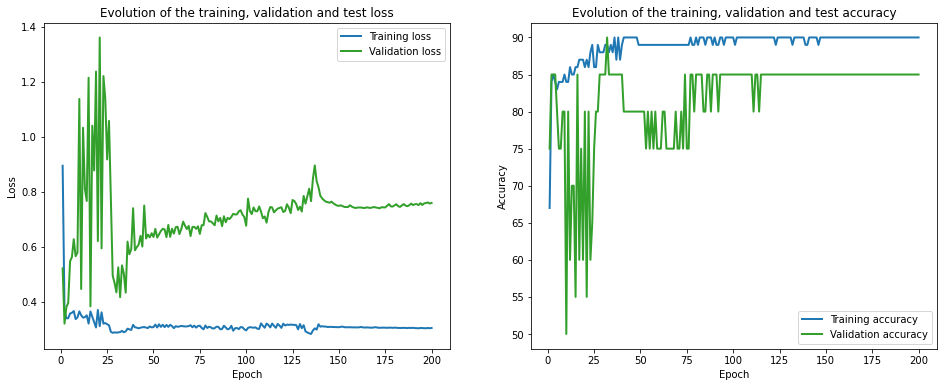

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 153.06it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1228.86it/s]

Finished computing p-values for 500 test points.

Starting repetition 49 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 1.40 train_acc: 30.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 1.74 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 1.24 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 6.31 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 1.84 train_acc: 30.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.84 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.41 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.71 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.63 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.58 train_acc: 80.00% took: 0.00s
val_loss = 0.44 val_acc = 55.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.35 train_acc: 100.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.

Epoch 12 of 200, 70% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 12 of 200, 80% 	 train_loss: 0.72 train_acc: 60.00% took: 0.00s
Epoch 12 of 200, 90% 	 train_loss: 0.28 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 100% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
val_loss = 0.51 val_acc = 70.00%
Snapshot saved at epoch 12.
Epoch 13 of 200, 10% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 13 of 200, 20% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 13 of 200, 30% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 13 of 200, 40% 	 train_loss: 0.69 train_acc: 80.00% took: 0.00s
Epoch 13 of 200, 50% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 13 of 200, 60% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 13 of 200, 70% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 13 of 200, 80% 	 train_loss: 0.97 train_acc: 50.00% took: 0.00s
Epoch 13 of 200, 90% 	 train_loss: 0.28 train_acc: 100.00% took: 0.00s
Epoch 13 of 200, 100% 	 tr

Epoch 23 of 200, 50% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 23 of 200, 60% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 23 of 200, 70% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 23 of 200, 80% 	 train_loss: 0.82 train_acc: 60.00% took: 0.00s
Epoch 23 of 200, 90% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 23 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss = 0.56 val_acc = 70.00%
Snapshot saved at epoch 23.
Epoch 24 of 200, 10% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 24 of 200, 20% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 24 of 200, 30% 	 train_loss: 0.57 train_acc: 80.00% took: 0.00s
Epoch 24 of 200, 40% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 24 of 200, 50% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
Epoch 24 of 200, 60% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 24 of 200, 70% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 24 of 200, 80% 	 tra

Epoch 35 of 200, 50% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 35 of 200, 60% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 35 of 200, 70% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 35 of 200, 80% 	 train_loss: 0.78 train_acc: 60.00% took: 0.00s
Epoch 35 of 200, 90% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 35 of 200, 100% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
val_loss = 0.58 val_acc = 70.00%
Snapshot saved at epoch 35.
Epoch 36 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 36 of 200, 20% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 36 of 200, 30% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 36 of 200, 40% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 36 of 200, 50% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 36 of 200, 60% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 36 of 200, 70% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 36 of 200, 80% 	 tra

Epoch 46 of 200, 40% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 46 of 200, 50% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 46 of 200, 60% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 46 of 200, 70% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 46 of 200, 80% 	 train_loss: 0.75 train_acc: 60.00% took: 0.00s
Epoch 46 of 200, 90% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 46 of 200, 100% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
val_loss = 0.59 val_acc = 70.00%
Snapshot saved at epoch 46.
Epoch 47 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 47 of 200, 20% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 47 of 200, 30% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 47 of 200, 40% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 47 of 200, 50% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 47 of 200, 60% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 47 of 200, 70% 	 tra

Epoch 57 of 200, 50% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 57 of 200, 60% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 70% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 57 of 200, 80% 	 train_loss: 0.73 train_acc: 60.00% took: 0.00s
Epoch 57 of 200, 90% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 57 of 200, 100% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
val_loss = 0.59 val_acc = 70.00%
Snapshot saved at epoch 57.
Epoch 58 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 58 of 200, 20% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 30% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 58 of 200, 40% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 50% 	 train_loss: 0.40 train_acc: 80.00% took: 0.02s
Epoch 58 of 200, 60% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 70% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 58 of 200, 80% 	 tra

Epoch 69 of 200, 30% 	 train_loss: 0.57 train_acc: 70.00% took: 0.01s
Epoch 69 of 200, 40% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 69 of 200, 50% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 69 of 200, 60% 	 train_loss: 0.43 train_acc: 90.00% took: 0.00s
Epoch 69 of 200, 70% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 69 of 200, 80% 	 train_loss: 0.72 train_acc: 60.00% took: 0.00s
Epoch 69 of 200, 90% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 69 of 200, 100% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
val_loss = 0.59 val_acc = 70.00%
Snapshot saved at epoch 69.
Epoch 70 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 70 of 200, 20% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 70 of 200, 30% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 70 of 200, 40% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 70 of 200, 50% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 70 of 200, 60% 	 tra

Epoch 80 of 200, 20% 	 train_loss: 0.17 train_acc: 90.00% took: 0.02s
Epoch 80 of 200, 30% 	 train_loss: 0.59 train_acc: 70.00% took: 0.01s
Epoch 80 of 200, 40% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 80 of 200, 50% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 80 of 200, 60% 	 train_loss: 0.47 train_acc: 90.00% took: 0.00s
Epoch 80 of 200, 70% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 80 of 200, 80% 	 train_loss: 0.70 train_acc: 60.00% took: 0.00s
Epoch 80 of 200, 90% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 80 of 200, 100% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
val_loss = 0.60 val_acc = 70.00%
Snapshot saved at epoch 80.
Epoch 81 of 200, 10% 	 train_loss: 0.09 train_acc: 100.00% took: 0.02s
Epoch 81 of 200, 20% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 81 of 200, 30% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 81 of 200, 40% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 81 of 200, 50% 	 tra

Epoch 90 of 200, 100% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
val_loss = 0.58 val_acc = 70.00%
Snapshot saved at epoch 90.
Epoch 91 of 200, 10% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 91 of 200, 20% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 91 of 200, 30% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 91 of 200, 40% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 91 of 200, 50% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 91 of 200, 60% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
Epoch 91 of 200, 70% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 91 of 200, 80% 	 train_loss: 0.79 train_acc: 60.00% took: 0.00s
Epoch 91 of 200, 90% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 91 of 200, 100% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
val_loss = 0.60 val_acc = 70.00%
Snapshot saved at epoch 91.
Epoch 92 of 200, 10% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 92 of 200, 20% 	 train_loss

Epoch 101 of 200, 90% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 101 of 200, 100% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
val_loss = 0.60 val_acc = 70.00%
Snapshot saved at epoch 101.
Epoch 102 of 200, 10% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 102 of 200, 20% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 102 of 200, 30% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 102 of 200, 40% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 102 of 200, 50% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 102 of 200, 60% 	 train_loss: 0.52 train_acc: 90.00% took: 0.00s
Epoch 102 of 200, 70% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 102 of 200, 80% 	 train_loss: 0.73 train_acc: 60.00% took: 0.00s
Epoch 102 of 200, 90% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 102 of 200, 100% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
val_loss = 0.60 val_acc = 70.00%
Snapshot saved at epoch 102.
Epoch 103 of 200, 1

Epoch 112 of 200, 100% 	 train_loss: 0.32 train_acc: 90.00% took: 0.02s
val_loss = 0.60 val_acc = 70.00%
Snapshot saved at epoch 112.
Epoch 113 of 200, 10% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 113 of 200, 20% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 113 of 200, 30% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 113 of 200, 40% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 113 of 200, 50% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 113 of 200, 60% 	 train_loss: 0.54 train_acc: 90.00% took: 0.00s
Epoch 113 of 200, 70% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 113 of 200, 80% 	 train_loss: 0.71 train_acc: 60.00% took: 0.00s
Epoch 113 of 200, 90% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 113 of 200, 100% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
val_loss = 0.61 val_acc = 70.00%
Snapshot saved at epoch 113.
Epoch 114 of 200, 10% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 114 of 200, 2

val_loss = 0.61 val_acc = 70.00%
Snapshot saved at epoch 123.
Epoch 124 of 200, 10% 	 train_loss: 0.08 train_acc: 100.00% took: 0.01s
Epoch 124 of 200, 20% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 124 of 200, 30% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 124 of 200, 40% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 124 of 200, 50% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 124 of 200, 60% 	 train_loss: 0.56 train_acc: 90.00% took: 0.00s
Epoch 124 of 200, 70% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 124 of 200, 80% 	 train_loss: 0.65 train_acc: 60.00% took: 0.00s
Epoch 124 of 200, 90% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 124 of 200, 100% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
val_loss = 0.60 val_acc = 70.00%
Snapshot saved at epoch 124.
Epoch 125 of 200, 10% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 125 of 200, 20% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 125 of 200, 30

val_loss = 0.60 val_acc = 70.00%
Snapshot saved at epoch 134.
Epoch 135 of 200, 10% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 135 of 200, 20% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 135 of 200, 30% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 135 of 200, 40% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 135 of 200, 50% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 135 of 200, 60% 	 train_loss: 0.58 train_acc: 90.00% took: 0.00s
Epoch 135 of 200, 70% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 135 of 200, 80% 	 train_loss: 0.66 train_acc: 60.00% took: 0.00s
Epoch 135 of 200, 90% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 135 of 200, 100% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
val_loss = 0.60 val_acc = 70.00%
Snapshot saved at epoch 135.
Epoch 136 of 200, 10% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 136 of 200, 20% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 136 of 200, 30

Epoch 150 of 200, 60% 	 train_loss: 0.59 train_acc: 90.00% took: 0.00s
Epoch 150 of 200, 70% 	 train_loss: 0.29 train_acc: 90.00% took: 0.01s
Epoch 150 of 200, 80% 	 train_loss: 0.65 train_acc: 60.00% took: 0.00s
Epoch 150 of 200, 90% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 150 of 200, 100% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
val_loss = 0.60 val_acc = 70.00%
Snapshot saved at epoch 150.
Epoch 151 of 200, 10% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 151 of 200, 20% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 151 of 200, 30% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 151 of 200, 40% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 151 of 200, 50% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 151 of 200, 60% 	 train_loss: 0.59 train_acc: 90.00% took: 0.00s
Epoch 151 of 200, 70% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 151 of 200, 80% 	 train_loss: 0.67 train_acc: 60.00% took: 0.00s
Epoch 151 of

val_loss = 0.60 val_acc = 70.00%
Snapshot saved at epoch 165.
Epoch 166 of 200, 10% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 166 of 200, 20% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 30% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 166 of 200, 40% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 50% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 166 of 200, 60% 	 train_loss: 0.60 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 70% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 166 of 200, 80% 	 train_loss: 0.63 train_acc: 60.00% took: 0.00s
Epoch 166 of 200, 90% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 166 of 200, 100% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
val_loss = 0.60 val_acc = 70.00%
Snapshot saved at epoch 166.
Epoch 167 of 200, 10% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 167 of 200, 20% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 167 of 200, 30

Epoch 181 of 200, 100% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
val_loss = 0.60 val_acc = 70.00%
Snapshot saved at epoch 181.
Epoch 182 of 200, 10% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 182 of 200, 20% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 182 of 200, 30% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 182 of 200, 40% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 182 of 200, 50% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 182 of 200, 60% 	 train_loss: 0.60 train_acc: 90.00% took: 0.00s
Epoch 182 of 200, 70% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 182 of 200, 80% 	 train_loss: 0.65 train_acc: 60.00% took: 0.00s
Epoch 182 of 200, 90% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 182 of 200, 100% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
val_loss = 0.60 val_acc = 70.00%
Snapshot saved at epoch 182.
Epoch 183 of 200, 10% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 183 of 200, 2

Epoch 193 of 200, 10% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 193 of 200, 20% 	 train_loss: 0.15 train_acc: 90.00% took: 0.01s
Epoch 193 of 200, 30% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 193 of 200, 40% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 193 of 200, 50% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 193 of 200, 60% 	 train_loss: 0.61 train_acc: 90.00% took: 0.00s
Epoch 193 of 200, 70% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
Epoch 193 of 200, 80% 	 train_loss: 0.64 train_acc: 70.00% took: 0.00s
Epoch 193 of 200, 90% 	 train_loss: 0.17 train_acc: 100.00% took: 0.00s
Epoch 193 of 200, 100% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
val_loss = 0.60 val_acc = 70.00%
Snapshot saved at epoch 193.
Epoch 194 of 200, 10% 	 train_loss: 0.08 train_acc: 100.00% took: 0.00s
Epoch 194 of 200, 20% 	 train_loss: 0.15 train_acc: 90.00% took: 0.00s
Epoch 194 of 200, 30% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 194 o

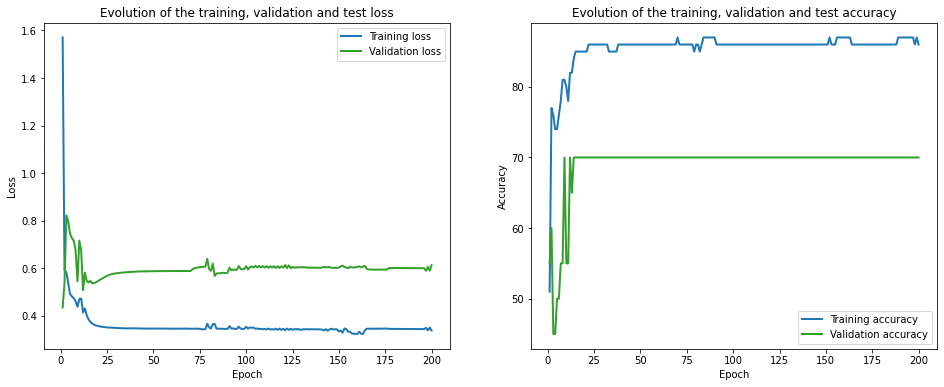

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 155.30it/s]


Initialization done!


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1147.54it/s]

Finished computing p-values for 500 test points.
Training with CES data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.78 train_acc: 30.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 0.94 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 1.50 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 3.80 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.72 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.66 train_acc: 40.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 0.65 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 0.59 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 0.66 train_acc: 80.00% took: 0.00s
val_loss = 0.41 val_acc = 55.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.30 train_acc: 100.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.

Epoch 12 of 200, 60% 	 train_loss: 0.37 train_acc: 80.00% took: 0.01s
Epoch 12 of 200, 70% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 80% 	 train_loss: 0.73 train_acc: 60.00% took: 0.00s
Epoch 12 of 200, 90% 	 train_loss: 0.68 train_acc: 40.00% took: 0.00s
Epoch 12 of 200, 100% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
val_loss = 0.42 val_acc = 70.00%
Snapshot saved at epoch 12.
Epoch 13 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 13 of 200, 20% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 13 of 200, 30% 	 train_loss: 0.56 train_acc: 60.00% took: 0.00s
Epoch 13 of 200, 40% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 13 of 200, 50% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 13 of 200, 60% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 13 of 200, 70% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 13 of 200, 80% 	 train_loss: 0.71 train_acc: 60.00% took: 0.00s
Epoch 13 of 200, 90% 	 tra

Epoch 24 of 200, 10% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 24 of 200, 20% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 24 of 200, 30% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 24 of 200, 40% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 24 of 200, 50% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 24 of 200, 60% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
Epoch 24 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 24 of 200, 80% 	 train_loss: 0.87 train_acc: 60.00% took: 0.02s
Epoch 24 of 200, 90% 	 train_loss: 0.35 train_acc: 100.00% took: 0.00s
Epoch 24 of 200, 100% 	 train_loss: 0.29 train_acc: 90.00% took: 0.00s
val_loss = 0.39 val_acc = 70.00%
Snapshot saved at epoch 24.
Epoch 25 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 25 of 200, 20% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 25 of 200, 30% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 25 of 200, 40% 	 tra

Epoch 35 of 200, 90% 	 train_loss: 0.28 train_acc: 100.00% took: 0.00s
Epoch 35 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss = 0.40 val_acc = 70.00%
Snapshot saved at epoch 35.
Epoch 36 of 200, 10% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 36 of 200, 20% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 36 of 200, 30% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 36 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 36 of 200, 50% 	 train_loss: 0.26 train_acc: 80.00% took: 0.00s
Epoch 36 of 200, 60% 	 train_loss: 0.50 train_acc: 90.00% took: 0.00s
Epoch 36 of 200, 70% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 36 of 200, 80% 	 train_loss: 0.77 train_acc: 60.00% took: 0.00s
Epoch 36 of 200, 90% 	 train_loss: 0.29 train_acc: 100.00% took: 0.00s
Epoch 36 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss = 0.40 val_acc = 70.00%
Snapshot saved at epoch 36.
Epoch 37 of 200, 10% 	 train_loss:

val_loss = 0.39 val_acc = 70.00%
Snapshot saved at epoch 46.
Epoch 47 of 200, 10% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 47 of 200, 20% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 47 of 200, 30% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 47 of 200, 40% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 47 of 200, 50% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 47 of 200, 60% 	 train_loss: 0.54 train_acc: 90.00% took: 0.00s
Epoch 47 of 200, 70% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 47 of 200, 80% 	 train_loss: 0.78 train_acc: 60.00% took: 0.00s
Epoch 47 of 200, 90% 	 train_loss: 0.26 train_acc: 100.00% took: 0.00s
Epoch 47 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss = 0.41 val_acc = 70.00%
Snapshot saved at epoch 47.
Epoch 48 of 200, 10% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 48 of 200, 20% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 48 of 200, 30% 	 train_loss: 0

Epoch 62 of 200, 10% 	 train_loss: 0.16 train_acc: 90.00% took: 0.01s
Epoch 62 of 200, 20% 	 train_loss: 0.14 train_acc: 90.00% took: 0.00s
Epoch 62 of 200, 30% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 62 of 200, 40% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 62 of 200, 50% 	 train_loss: 0.25 train_acc: 80.00% took: 0.00s
Epoch 62 of 200, 60% 	 train_loss: 0.56 train_acc: 90.00% took: 0.00s
Epoch 62 of 200, 70% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 62 of 200, 80% 	 train_loss: 0.75 train_acc: 70.00% took: 0.00s
Epoch 62 of 200, 90% 	 train_loss: 0.25 train_acc: 100.00% took: 0.00s
Epoch 62 of 200, 100% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
val_loss = 0.41 val_acc = 70.00%
Snapshot saved at epoch 62.
Epoch 63 of 200, 10% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 63 of 200, 20% 	 train_loss: 0.13 train_acc: 90.00% took: 0.00s
Epoch 63 of 200, 30% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 63 of 200, 40% 	 trai

Epoch 73 of 200, 10% 	 train_loss: 0.12 train_acc: 100.00% took: 0.01s
Epoch 73 of 200, 20% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 73 of 200, 30% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
Epoch 73 of 200, 40% 	 train_loss: 0.27 train_acc: 90.00% took: 0.00s
Epoch 73 of 200, 50% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 73 of 200, 60% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
Epoch 73 of 200, 70% 	 train_loss: 0.12 train_acc: 90.00% took: 0.00s
Epoch 73 of 200, 80% 	 train_loss: 0.60 train_acc: 70.00% took: 0.00s
Epoch 73 of 200, 90% 	 train_loss: 0.21 train_acc: 100.00% took: 0.00s
Epoch 73 of 200, 100% 	 train_loss: 0.23 train_acc: 90.00% took: 0.00s
val_loss = 0.32 val_acc = 70.00%
Snapshot saved at epoch 73.
Epoch 74 of 200, 10% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 74 of 200, 20% 	 train_loss: 0.15 train_acc: 100.00% took: 0.01s
Epoch 74 of 200, 30% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 74 of 200, 40% 	 t

Epoch 84 of 200, 40% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 84 of 200, 50% 	 train_loss: 0.19 train_acc: 90.00% took: 0.01s
Epoch 84 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 84 of 200, 70% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 84 of 200, 80% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 84 of 200, 90% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 84 of 200, 100% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
val_loss = 0.28 val_acc = 70.00%
Snapshot saved at epoch 84.
Epoch 85 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 85 of 200, 20% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 85 of 200, 30% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 85 of 200, 40% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 85 of 200, 50% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 85 of 200, 60% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 85 of 200, 70% 	 tra

Epoch 100 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.02s
Epoch 100 of 200, 20% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 100 of 200, 30% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 40% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 50% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 60% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 70% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 80% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 100 of 200, 90% 	 train_loss: 0.23 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 100% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
val_loss = 0.28 val_acc = 70.00%
Snapshot saved at epoch 100.
Epoch 101 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 101 of 200, 20% 	 train_loss: 0.16 train_acc: 100.00% took: 0.01s
Epoch 101 of 200, 30% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 101 

Epoch 111 of 200, 10% 	 train_loss: 0.13 train_acc: 100.00% took: 0.02s
Epoch 111 of 200, 20% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 30% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 111 of 200, 40% 	 train_loss: 0.22 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 50% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 60% 	 train_loss: 0.46 train_acc: 90.00% took: 0.02s
Epoch 111 of 200, 70% 	 train_loss: 0.11 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 80% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 111 of 200, 90% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 100% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
val_loss = 0.29 val_acc = 70.00%
Snapshot saved at epoch 111.
Epoch 112 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 112 of 200, 20% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 112 of 200, 30% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 112

val_loss = 0.29 val_acc = 70.00%
Snapshot saved at epoch 121.
Epoch 122 of 200, 10% 	 train_loss: 0.13 train_acc: 100.00% took: 0.01s
Epoch 122 of 200, 20% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 122 of 200, 30% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 122 of 200, 40% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 122 of 200, 50% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 122 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 122 of 200, 70% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 122 of 200, 80% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 122 of 200, 90% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 122 of 200, 100% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
val_loss = 0.29 val_acc = 70.00%
Snapshot saved at epoch 122.
Epoch 123 of 200, 10% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 123 of 200, 20% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 123 of 200, 3

Epoch 133 of 200, 50% 	 train_loss: 0.19 train_acc: 90.00% took: 0.02s
Epoch 133 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.01s
Epoch 133 of 200, 70% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 133 of 200, 80% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 133 of 200, 90% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 133 of 200, 100% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
val_loss = 0.29 val_acc = 70.00%
Snapshot saved at epoch 133.
Epoch 134 of 200, 10% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 134 of 200, 20% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 134 of 200, 30% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 134 of 200, 40% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 134 of 200, 50% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 134 of 200, 60% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 134 of 200, 70% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 134 of

Epoch 144 of 200, 10% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 144 of 200, 20% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 144 of 200, 30% 	 train_loss: 0.40 train_acc: 70.00% took: 0.00s
Epoch 144 of 200, 40% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 144 of 200, 50% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 144 of 200, 60% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 144 of 200, 70% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 144 of 200, 80% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 144 of 200, 90% 	 train_loss: 0.24 train_acc: 80.00% took: 0.00s
Epoch 144 of 200, 100% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
val_loss = 0.29 val_acc = 70.00%
Snapshot saved at epoch 144.
Epoch 145 of 200, 10% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 145 of 200, 20% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 145 of 200, 30% 	 train_loss: 0.40 train_acc: 70.00% took: 0.00s
Epoch 145 

val_loss = 0.29 val_acc = 70.00%
Snapshot saved at epoch 159.
Epoch 160 of 200, 10% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 160 of 200, 20% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 160 of 200, 30% 	 train_loss: 0.38 train_acc: 70.00% took: 0.00s
Epoch 160 of 200, 40% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 160 of 200, 50% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 160 of 200, 60% 	 train_loss: 0.47 train_acc: 90.00% took: 0.00s
Epoch 160 of 200, 70% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 160 of 200, 80% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 160 of 200, 90% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 160 of 200, 100% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
val_loss = 0.29 val_acc = 70.00%
Snapshot saved at epoch 160.
Epoch 161 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 161 of 200, 20% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 161 of 200, 3

Epoch 175 of 200, 80% 	 train_loss: 0.52 train_acc: 70.00% took: 0.02s
Epoch 175 of 200, 90% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 175 of 200, 100% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
val_loss = 0.27 val_acc = 70.00%
Snapshot saved at epoch 175.
Epoch 176 of 200, 10% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 176 of 200, 20% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 176 of 200, 30% 	 train_loss: 0.38 train_acc: 70.00% took: 0.00s
Epoch 176 of 200, 40% 	 train_loss: 0.28 train_acc: 90.00% took: 0.00s
Epoch 176 of 200, 50% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 176 of 200, 60% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 176 of 200, 70% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 176 of 200, 80% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 176 of 200, 90% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 176 of 200, 100% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
val_loss =

Epoch 187 of 200, 90% 	 train_loss: 0.22 train_acc: 80.00% took: 0.02s
Epoch 187 of 200, 100% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
val_loss = 0.27 val_acc = 70.00%
Snapshot saved at epoch 187.
Epoch 188 of 200, 10% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 188 of 200, 20% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 188 of 200, 30% 	 train_loss: 0.38 train_acc: 70.00% took: 0.00s
Epoch 188 of 200, 40% 	 train_loss: 0.18 train_acc: 80.00% took: 0.00s
Epoch 188 of 200, 50% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 188 of 200, 60% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 188 of 200, 70% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 188 of 200, 80% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 188 of 200, 90% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 188 of 200, 100% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
val_loss = 0.28 val_acc = 70.00%
Snapshot saved at epoch 188.
Epoch 189 of 200, 1

Epoch 198 of 200, 100% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
val_loss = 0.28 val_acc = 70.00%
Snapshot saved at epoch 198.
Epoch 199 of 200, 10% 	 train_loss: 0.14 train_acc: 100.00% took: 0.00s
Epoch 199 of 200, 20% 	 train_loss: 0.16 train_acc: 100.00% took: 0.00s
Epoch 199 of 200, 30% 	 train_loss: 0.39 train_acc: 70.00% took: 0.00s
Epoch 199 of 200, 40% 	 train_loss: 0.19 train_acc: 80.00% took: 0.00s
Epoch 199 of 200, 50% 	 train_loss: 0.18 train_acc: 90.00% took: 0.00s
Epoch 199 of 200, 60% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 199 of 200, 70% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 199 of 200, 80% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 199 of 200, 90% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 199 of 200, 100% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
val_loss = 0.28 val_acc = 70.00%
Snapshot saved at epoch 199.
Epoch 200 of 200, 10% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 200 of 200, 

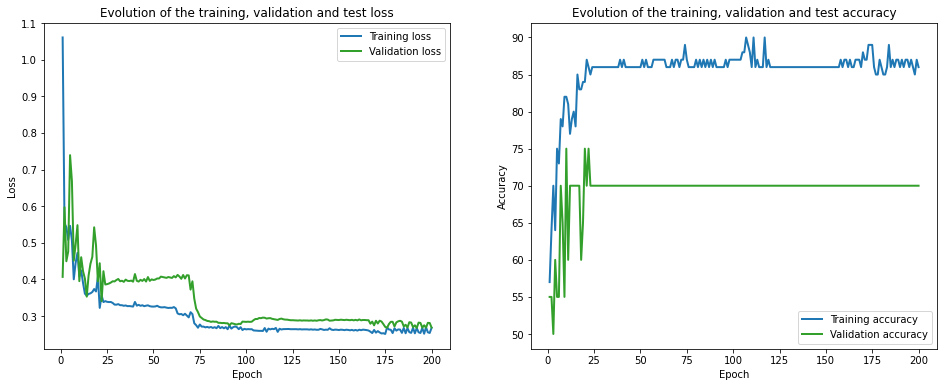

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 138.14it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1074.35it/s]

Finished computing p-values for 500 test points.

Starting repetition 50 of 50:

Training with standard data splitting...



C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 0.60 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.09 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.07 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.73 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.23 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 1.72 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 1.28 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 4.64 train_acc: 30.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 7.15 train_acc: 40.00% took: 0.00s
val_loss = 0.24 val_acc = 85.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 

val_loss = 0.34 val_acc = 65.00%
Snapshot saved at epoch 12.
Epoch 13 of 200, 10% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 13 of 200, 20% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 13 of 200, 30% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 13 of 200, 40% 	 train_loss: 0.39 train_acc: 100.00% took: 0.00s
Epoch 13 of 200, 50% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 13 of 200, 60% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 13 of 200, 70% 	 train_loss: 0.97 train_acc: 60.00% took: 0.00s
Epoch 13 of 200, 80% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 13 of 200, 90% 	 train_loss: 0.61 train_acc: 70.00% took: 0.00s
Epoch 13 of 200, 100% 	 train_loss: 0.62 train_acc: 60.00% took: 0.00s
val_loss = 0.34 val_acc = 65.00%
Snapshot saved at epoch 13.
Epoch 14 of 200, 10% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 14 of 200, 20% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 14 of 200, 30% 	 train_loss: 

Epoch 24 of 200, 90% 	 train_loss: 0.65 train_acc: 70.00% took: 0.02s
Epoch 24 of 200, 100% 	 train_loss: 0.93 train_acc: 50.00% took: 0.00s
val_loss = 0.37 val_acc = 65.00%
Snapshot saved at epoch 24.
Epoch 25 of 200, 10% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 25 of 200, 20% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 25 of 200, 30% 	 train_loss: 0.16 train_acc: 100.00% took: 0.02s
Epoch 25 of 200, 40% 	 train_loss: 0.44 train_acc: 100.00% took: 0.00s
Epoch 25 of 200, 50% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 25 of 200, 60% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 25 of 200, 70% 	 train_loss: 0.75 train_acc: 70.00% took: 0.00s
Epoch 25 of 200, 80% 	 train_loss: 0.46 train_acc: 80.00% took: 0.00s
Epoch 25 of 200, 90% 	 train_loss: 0.61 train_acc: 70.00% took: 0.00s
Epoch 25 of 200, 100% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
val_loss = 0.34 val_acc = 65.00%
Snapshot saved at epoch 25.
Epoch 26 of 200, 10% 	 train_loss:

val_loss = 0.29 val_acc = 80.00%
Snapshot saved at epoch 39.
Epoch 40 of 200, 10% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 40 of 200, 20% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
Epoch 40 of 200, 30% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 40 of 200, 40% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 40 of 200, 50% 	 train_loss: 0.59 train_acc: 70.00% took: 0.00s
Epoch 40 of 200, 60% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 40 of 200, 70% 	 train_loss: 1.04 train_acc: 70.00% took: 0.00s
Epoch 40 of 200, 80% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 40 of 200, 90% 	 train_loss: 0.68 train_acc: 60.00% took: 0.00s
Epoch 40 of 200, 100% 	 train_loss: 0.73 train_acc: 60.00% took: 0.00s
val_loss = 0.33 val_acc = 80.00%
Snapshot saved at epoch 40.
Epoch 41 of 200, 10% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 41 of 200, 20% 	 train_loss: 0.18 train_acc: 100.00% took: 0.00s
Epoch 41 of 200, 30% 	 train_loss: 

Epoch 51 of 200, 60% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 51 of 200, 70% 	 train_loss: 0.99 train_acc: 90.00% took: 0.00s
Epoch 51 of 200, 80% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 51 of 200, 90% 	 train_loss: 0.45 train_acc: 70.00% took: 0.02s
Epoch 51 of 200, 100% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
val_loss = 0.35 val_acc = 80.00%
Snapshot saved at epoch 51.
Epoch 52 of 200, 10% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 52 of 200, 20% 	 train_loss: 0.12 train_acc: 100.00% took: 0.01s
Epoch 52 of 200, 30% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 52 of 200, 40% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 52 of 200, 50% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 52 of 200, 60% 	 train_loss: 0.31 train_acc: 80.00% took: 0.00s
Epoch 52 of 200, 70% 	 train_loss: 0.98 train_acc: 90.00% took: 0.00s
Epoch 52 of 200, 80% 	 train_loss: 0.46 train_acc: 80.00% took: 0.01s
Epoch 52 of 200, 90% 	 tra

Epoch 62 of 200, 80% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 62 of 200, 90% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 62 of 200, 100% 	 train_loss: 0.44 train_acc: 60.00% took: 0.00s
val_loss = 0.34 val_acc = 80.00%
Snapshot saved at epoch 62.
Epoch 63 of 200, 10% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
Epoch 63 of 200, 20% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 63 of 200, 30% 	 train_loss: 0.09 train_acc: 100.00% took: 0.00s
Epoch 63 of 200, 40% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 63 of 200, 50% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 63 of 200, 60% 	 train_loss: 0.30 train_acc: 80.00% took: 0.00s
Epoch 63 of 200, 70% 	 train_loss: 0.99 train_acc: 80.00% took: 0.00s
Epoch 63 of 200, 80% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 63 of 200, 90% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 63 of 200, 100% 	 train_loss: 0.44 train_acc: 70.00% took: 0.00s
val_loss = 0.34 val_acc =

Epoch 73 of 200, 70% 	 train_loss: 0.97 train_acc: 80.00% took: 0.00s
Epoch 73 of 200, 80% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 73 of 200, 90% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 73 of 200, 100% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
val_loss = 0.36 val_acc = 80.00%
Snapshot saved at epoch 73.
Epoch 74 of 200, 10% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 74 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 74 of 200, 30% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 74 of 200, 40% 	 train_loss: 0.31 train_acc: 90.00% took: 0.00s
Epoch 74 of 200, 50% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 74 of 200, 60% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 74 of 200, 70% 	 train_loss: 0.97 train_acc: 80.00% took: 0.00s
Epoch 74 of 200, 80% 	 train_loss: 0.48 train_acc: 80.00% took: 0.00s
Epoch 74 of 200, 90% 	 train_loss: 0.46 train_acc: 70.00% took: 0.00s
Epoch 74 of 200, 100% 	 tr

Epoch 88 of 200, 100% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
val_loss = 0.35 val_acc = 80.00%
Snapshot saved at epoch 88.
Epoch 89 of 200, 10% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 89 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 89 of 200, 30% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 89 of 200, 40% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 89 of 200, 50% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 89 of 200, 60% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 89 of 200, 70% 	 train_loss: 0.98 train_acc: 80.00% took: 0.00s
Epoch 89 of 200, 80% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 89 of 200, 90% 	 train_loss: 0.47 train_acc: 70.00% took: 0.00s
Epoch 89 of 200, 100% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
val_loss = 0.35 val_acc = 80.00%
Snapshot saved at epoch 89.
Epoch 90 of 200, 10% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 90 of 200, 20% 	 train_loss:

val_loss = 0.35 val_acc = 80.00%
Snapshot saved at epoch 99.
Epoch 100 of 200, 10% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.01s
Epoch 100 of 200, 30% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 100 of 200, 40% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 100 of 200, 50% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 60% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 70% 	 train_loss: 0.99 train_acc: 80.00% took: 0.00s
Epoch 100 of 200, 80% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 100 of 200, 90% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 100 of 200, 100% 	 train_loss: 0.42 train_acc: 80.00% took: 0.00s
val_loss = 0.34 val_acc = 80.00%
Snapshot saved at epoch 100.
Epoch 101 of 200, 10% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 101 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 101 of 200, 30%

Epoch 110 of 200, 90% 	 train_loss: 0.48 train_acc: 70.00% took: 0.02s
Epoch 110 of 200, 100% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
val_loss = 0.34 val_acc = 80.00%
Snapshot saved at epoch 110.
Epoch 111 of 200, 10% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 111 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 30% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 40% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 111 of 200, 50% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 111 of 200, 60% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 111 of 200, 70% 	 train_loss: 0.99 train_acc: 80.00% took: 0.00s
Epoch 111 of 200, 80% 	 train_loss: 0.52 train_acc: 70.00% took: 0.00s
Epoch 111 of 200, 90% 	 train_loss: 0.48 train_acc: 70.00% took: 0.00s
Epoch 111 of 200, 100% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
val_loss = 0.34 val_acc = 80.00%
Snapshot saved at epoch 111.
Epoch 112 of 200, 10

Epoch 121 of 200, 60% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 121 of 200, 70% 	 train_loss: 0.98 train_acc: 80.00% took: 0.00s
Epoch 121 of 200, 80% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 121 of 200, 90% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 121 of 200, 100% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
val_loss = 0.34 val_acc = 80.00%
Snapshot saved at epoch 121.
Epoch 122 of 200, 10% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 122 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 122 of 200, 30% 	 train_loss: 0.17 train_acc: 90.00% took: 0.00s
Epoch 122 of 200, 40% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 122 of 200, 50% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 122 of 200, 60% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 122 of 200, 70% 	 train_loss: 0.98 train_acc: 80.00% took: 0.00s
Epoch 122 of 200, 80% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 122 of 

val_loss = 0.34 val_acc = 80.00%
Snapshot saved at epoch 135.
Epoch 136 of 200, 10% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 136 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 136 of 200, 30% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 136 of 200, 40% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 136 of 200, 50% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 136 of 200, 60% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 136 of 200, 70% 	 train_loss: 0.95 train_acc: 80.00% took: 0.02s
Epoch 136 of 200, 80% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 136 of 200, 90% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 136 of 200, 100% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
val_loss = 0.34 val_acc = 80.00%
Snapshot saved at epoch 136.
Epoch 137 of 200, 10% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 137 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 137 of 200, 30%

Epoch 146 of 200, 100% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
val_loss = 0.34 val_acc = 80.00%
Snapshot saved at epoch 146.
Epoch 147 of 200, 10% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 147 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 147 of 200, 30% 	 train_loss: 0.20 train_acc: 90.00% took: 0.00s
Epoch 147 of 200, 40% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 147 of 200, 50% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 147 of 200, 60% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 147 of 200, 70% 	 train_loss: 0.93 train_acc: 80.00% took: 0.00s
Epoch 147 of 200, 80% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 147 of 200, 90% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 147 of 200, 100% 	 train_loss: 0.36 train_acc: 90.00% took: 0.00s
val_loss = 0.34 val_acc = 80.00%
Snapshot saved at epoch 147.
Epoch 148 of 200, 10% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 148 of 200, 20%

Epoch 162 of 200, 50% 	 train_loss: 0.50 train_acc: 80.00% took: 0.02s
Epoch 162 of 200, 60% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 162 of 200, 70% 	 train_loss: 0.94 train_acc: 80.00% took: 0.00s
Epoch 162 of 200, 80% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 162 of 200, 90% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 162 of 200, 100% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
val_loss = 0.34 val_acc = 80.00%
Snapshot saved at epoch 162.
Epoch 163 of 200, 10% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 163 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 163 of 200, 30% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 163 of 200, 40% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 163 of 200, 50% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 163 of 200, 60% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 163 of 200, 70% 	 train_loss: 0.93 train_acc: 80.00% took: 0.00s
Epoch 163 of 

Epoch 173 of 200, 30% 	 train_loss: 0.11 train_acc: 90.00% took: 0.02s
Epoch 173 of 200, 40% 	 train_loss: 0.30 train_acc: 90.00% took: 0.00s
Epoch 173 of 200, 50% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 173 of 200, 60% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 173 of 200, 70% 	 train_loss: 0.90 train_acc: 90.00% took: 0.00s
Epoch 173 of 200, 80% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 173 of 200, 90% 	 train_loss: 0.50 train_acc: 70.00% took: 0.02s
Epoch 173 of 200, 100% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
val_loss = 0.35 val_acc = 80.00%
Snapshot saved at epoch 173.
Epoch 174 of 200, 10% 	 train_loss: 0.38 train_acc: 80.00% took: 0.00s
Epoch 174 of 200, 20% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 174 of 200, 30% 	 train_loss: 0.24 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 40% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 174 of 200, 50% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 174 of 

Epoch 184 of 200, 30% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 184 of 200, 40% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 184 of 200, 50% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 184 of 200, 60% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 184 of 200, 70% 	 train_loss: 0.97 train_acc: 80.00% took: 0.00s
Epoch 184 of 200, 80% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 184 of 200, 90% 	 train_loss: 0.50 train_acc: 70.00% took: 0.02s
Epoch 184 of 200, 100% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
val_loss = 0.33 val_acc = 80.00%
Snapshot saved at epoch 184.
Epoch 185 of 200, 10% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 185 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 185 of 200, 30% 	 train_loss: 0.22 train_acc: 80.00% took: 0.00s
Epoch 185 of 200, 40% 	 train_loss: 0.34 train_acc: 90.00% took: 0.01s
Epoch 185 of 200, 50% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 185 of 

Epoch 194 of 200, 90% 	 train_loss: 0.50 train_acc: 70.00% took: 0.02s
Epoch 194 of 200, 100% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
val_loss = 0.34 val_acc = 80.00%
Snapshot saved at epoch 194.
Epoch 195 of 200, 10% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 195 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 195 of 200, 30% 	 train_loss: 0.20 train_acc: 80.00% took: 0.00s
Epoch 195 of 200, 40% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 195 of 200, 50% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 195 of 200, 60% 	 train_loss: 0.29 train_acc: 80.00% took: 0.00s
Epoch 195 of 200, 70% 	 train_loss: 0.93 train_acc: 80.00% took: 0.00s
Epoch 195 of 200, 80% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
Epoch 195 of 200, 90% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 195 of 200, 100% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
val_loss = 0.34 val_acc = 80.00%
Snapshot saved at epoch 195.
Epoch 196 of 200, 10%

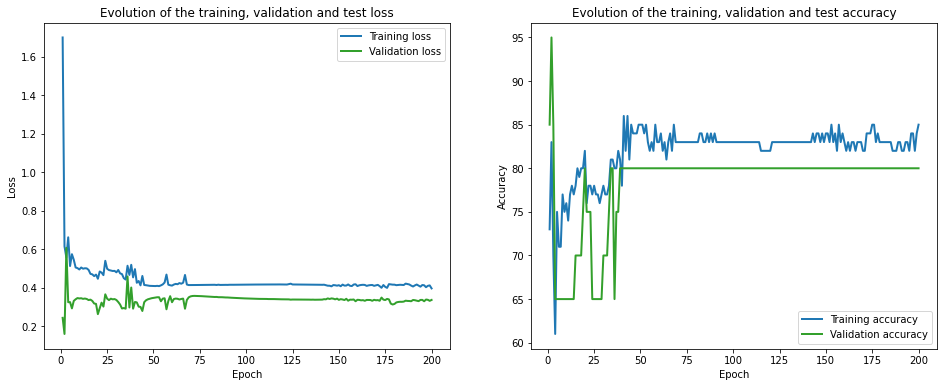

Computing standard benchmark p-values for 500 test points...
Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 157.43it/s]


Initialization done!


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1209.66it/s]


Finished computing p-values for 500 test points.
Training with CES data splitting...


C:\Users\16266\AppData\Local\Temp\ipykernel_29608\3423077815.py:20: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  th.nn.init.xavier_uniform(m.weight)


===== HYPERPARAMETERS =====
batch_size= 10
n_epochs= 200
learning_rate= 1
Epoch 1 of 200, 10% 	 train_loss: 1.18 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 20% 	 train_loss: 1.31 train_acc: 60.00% took: 0.00s
Epoch 1 of 200, 30% 	 train_loss: 0.10 train_acc: 90.00% took: 0.00s
Epoch 1 of 200, 40% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 1 of 200, 50% 	 train_loss: 0.76 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 60% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 1 of 200, 70% 	 train_loss: 1.71 train_acc: 50.00% took: 0.00s
Epoch 1 of 200, 80% 	 train_loss: 1.09 train_acc: 80.00% took: 0.00s
Epoch 1 of 200, 90% 	 train_loss: 3.02 train_acc: 30.00% took: 0.00s
Epoch 1 of 200, 100% 	 train_loss: 4.37 train_acc: 40.00% took: 0.00s
val_loss = 0.34 val_acc = 80.00%
Snapshot saved at epoch 1.
Epoch 2 of 200, 10% 	 train_loss: 0.67 train_acc: 70.00% took: 0.00s
Epoch 2 of 200, 20% 	 train_loss: 1.01 train_acc: 60.00% took: 0.00s
Epoch 2 of 200, 30% 	 train_loss: 0.

Epoch 11 of 200, 90% 	 train_loss: 0.83 train_acc: 30.00% took: 0.00s
Epoch 11 of 200, 100% 	 train_loss: 0.73 train_acc: 50.00% took: 0.00s
val_loss = 0.25 val_acc = 100.00%
Snapshot saved at epoch 11.
Epoch 12 of 200, 10% 	 train_loss: 0.50 train_acc: 60.00% took: 0.00s
Epoch 12 of 200, 20% 	 train_loss: 0.48 train_acc: 90.00% took: 0.02s
Epoch 12 of 200, 30% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 40% 	 train_loss: 0.52 train_acc: 100.00% took: 0.00s
Epoch 12 of 200, 50% 	 train_loss: 0.50 train_acc: 70.00% took: 0.00s
Epoch 12 of 200, 60% 	 train_loss: 0.37 train_acc: 70.00% took: 0.00s
Epoch 12 of 200, 70% 	 train_loss: 0.79 train_acc: 50.00% took: 0.00s
Epoch 12 of 200, 80% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 12 of 200, 90% 	 train_loss: 0.52 train_acc: 70.00% took: 0.00s
Epoch 12 of 200, 100% 	 train_loss: 0.51 train_acc: 60.00% took: 0.00s
val_loss = 0.29 val_acc = 75.00%
Snapshot saved at epoch 12.
Epoch 13 of 200, 10% 	 train_loss:

Epoch 26 of 200, 80% 	 train_loss: 0.45 train_acc: 80.00% took: 0.02s
Epoch 26 of 200, 90% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 26 of 200, 100% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
val_loss = 0.28 val_acc = 75.00%
Snapshot saved at epoch 26.
Epoch 27 of 200, 10% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 20% 	 train_loss: 0.26 train_acc: 90.00% took: 0.00s
Epoch 27 of 200, 30% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 27 of 200, 40% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 50% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 60% 	 train_loss: 0.40 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 70% 	 train_loss: 1.00 train_acc: 60.00% took: 0.00s
Epoch 27 of 200, 80% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 27 of 200, 90% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 27 of 200, 100% 	 train_loss: 0.55 train_acc: 70.00% took: 0.00s
val_loss = 0.28 val_acc = 

Epoch 37 of 200, 80% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 37 of 200, 90% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 37 of 200, 100% 	 train_loss: 0.61 train_acc: 60.00% took: 0.00s
val_loss = 0.27 val_acc = 75.00%
Snapshot saved at epoch 37.
Epoch 38 of 200, 10% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 20% 	 train_loss: 0.24 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 30% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 38 of 200, 40% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 50% 	 train_loss: 0.47 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 60% 	 train_loss: 0.39 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 70% 	 train_loss: 0.99 train_acc: 60.00% took: 0.00s
Epoch 38 of 200, 80% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 38 of 200, 90% 	 train_loss: 0.58 train_acc: 70.00% took: 0.00s
Epoch 38 of 200, 100% 	 train_loss: 0.61 train_acc: 60.00% took: 0.00s
val_loss = 0.26 val_acc =

Epoch 53 of 200, 60% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 53 of 200, 70% 	 train_loss: 0.62 train_acc: 90.00% took: 0.00s
Epoch 53 of 200, 80% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 53 of 200, 90% 	 train_loss: 0.53 train_acc: 60.00% took: 0.00s
Epoch 53 of 200, 100% 	 train_loss: 0.55 train_acc: 60.00% took: 0.00s
val_loss = 0.33 val_acc = 80.00%
Snapshot saved at epoch 53.
Epoch 54 of 200, 10% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 54 of 200, 20% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 54 of 200, 30% 	 train_loss: 0.05 train_acc: 100.00% took: 0.00s
Epoch 54 of 200, 40% 	 train_loss: 0.39 train_acc: 90.00% took: 0.00s
Epoch 54 of 200, 50% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 54 of 200, 60% 	 train_loss: 0.34 train_acc: 80.00% took: 0.00s
Epoch 54 of 200, 70% 	 train_loss: 0.89 train_acc: 80.00% took: 0.00s
Epoch 54 of 200, 80% 	 train_loss: 0.41 train_acc: 80.00% took: 0.00s
Epoch 54 of 200, 90% 	 tra

Epoch 64 of 200, 60% 	 train_loss: 0.30 train_acc: 80.00% took: 0.01s
Epoch 64 of 200, 70% 	 train_loss: 0.72 train_acc: 90.00% took: 0.00s
Epoch 64 of 200, 80% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 64 of 200, 90% 	 train_loss: 0.44 train_acc: 80.00% took: 0.00s
Epoch 64 of 200, 100% 	 train_loss: 0.46 train_acc: 90.00% took: 0.00s
val_loss = 0.35 val_acc = 80.00%
Snapshot saved at epoch 64.
Epoch 65 of 200, 10% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 65 of 200, 20% 	 train_loss: 0.11 train_acc: 100.00% took: 0.00s
Epoch 65 of 200, 30% 	 train_loss: 0.06 train_acc: 100.00% took: 0.00s
Epoch 65 of 200, 40% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 65 of 200, 50% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 65 of 200, 60% 	 train_loss: 0.32 train_acc: 80.00% took: 0.00s
Epoch 65 of 200, 70% 	 train_loss: 0.56 train_acc: 90.00% took: 0.00s
Epoch 65 of 200, 80% 	 train_loss: 0.45 train_acc: 80.00% took: 0.00s
Epoch 65 of 200, 90% 	 tra

Epoch 79 of 200, 100% 	 train_loss: 0.40 train_acc: 80.00% took: 0.02s
val_loss = 0.34 val_acc = 80.00%
Snapshot saved at epoch 79.
Epoch 80 of 200, 10% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 80 of 200, 20% 	 train_loss: 0.10 train_acc: 100.00% took: 0.00s
Epoch 80 of 200, 30% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 80 of 200, 40% 	 train_loss: 0.25 train_acc: 90.00% took: 0.00s
Epoch 80 of 200, 50% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 80 of 200, 60% 	 train_loss: 0.33 train_acc: 80.00% took: 0.00s
Epoch 80 of 200, 70% 	 train_loss: 1.50 train_acc: 60.00% took: 0.00s
Epoch 80 of 200, 80% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 80 of 200, 90% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 80 of 200, 100% 	 train_loss: 0.35 train_acc: 90.00% took: 0.00s
val_loss = 0.30 val_acc = 80.00%
Snapshot saved at epoch 80.
Epoch 81 of 200, 10% 	 train_loss: 0.35 train_acc: 80.00% took: 0.00s
Epoch 81 of 200, 20% 	 train_loss: 

Epoch 95 of 200, 10% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 95 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 95 of 200, 30% 	 train_loss: 0.12 train_acc: 100.00% took: 0.00s
Epoch 95 of 200, 40% 	 train_loss: 0.32 train_acc: 90.00% took: 0.00s
Epoch 95 of 200, 50% 	 train_loss: 0.55 train_acc: 80.00% took: 0.00s
Epoch 95 of 200, 60% 	 train_loss: 0.28 train_acc: 80.00% took: 0.01s
Epoch 95 of 200, 70% 	 train_loss: 1.04 train_acc: 80.00% took: 0.00s
Epoch 95 of 200, 80% 	 train_loss: 0.50 train_acc: 80.00% took: 0.01s
Epoch 95 of 200, 90% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 95 of 200, 100% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
val_loss = 0.32 val_acc = 80.00%
Snapshot saved at epoch 95.
Epoch 96 of 200, 10% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 96 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 96 of 200, 30% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 96 of 200, 40% 	 t

val_loss = 0.32 val_acc = 80.00%
Snapshot saved at epoch 109.
Epoch 110 of 200, 10% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 110 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 110 of 200, 30% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 110 of 200, 40% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 110 of 200, 50% 	 train_loss: 0.57 train_acc: 70.00% took: 0.00s
Epoch 110 of 200, 60% 	 train_loss: 0.28 train_acc: 80.00% took: 0.01s
Epoch 110 of 200, 70% 	 train_loss: 1.00 train_acc: 80.00% took: 0.00s
Epoch 110 of 200, 80% 	 train_loss: 0.49 train_acc: 80.00% took: 0.00s
Epoch 110 of 200, 90% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 110 of 200, 100% 	 train_loss: 0.43 train_acc: 80.00% took: 0.00s
val_loss = 0.32 val_acc = 80.00%
Snapshot saved at epoch 110.
Epoch 111 of 200, 10% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 111 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 111 of 200, 30

Epoch 121 of 200, 10% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 121 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 121 of 200, 30% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 121 of 200, 40% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 121 of 200, 50% 	 train_loss: 0.56 train_acc: 70.00% took: 0.00s
Epoch 121 of 200, 60% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 121 of 200, 70% 	 train_loss: 1.00 train_acc: 80.00% took: 0.00s
Epoch 121 of 200, 80% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 121 of 200, 90% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 121 of 200, 100% 	 train_loss: 0.42 train_acc: 90.00% took: 0.00s
val_loss = 0.33 val_acc = 80.00%
Snapshot saved at epoch 121.
Epoch 122 of 200, 10% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 122 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 122 of 200, 30% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 122 

Epoch 131 of 200, 100% 	 train_loss: 0.41 train_acc: 90.00% took: 0.02s
val_loss = 0.33 val_acc = 80.00%
Snapshot saved at epoch 131.
Epoch 132 of 200, 10% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 132 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 132 of 200, 30% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 132 of 200, 40% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 132 of 200, 50% 	 train_loss: 0.54 train_acc: 80.00% took: 0.00s
Epoch 132 of 200, 60% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 132 of 200, 70% 	 train_loss: 0.99 train_acc: 80.00% took: 0.00s
Epoch 132 of 200, 80% 	 train_loss: 0.51 train_acc: 70.00% took: 0.00s
Epoch 132 of 200, 90% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 132 of 200, 100% 	 train_loss: 0.41 train_acc: 90.00% took: 0.00s
val_loss = 0.33 val_acc = 80.00%
Snapshot saved at epoch 132.
Epoch 133 of 200, 10% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
Epoch 133 of 200, 20

val_loss = 0.33 val_acc = 80.00%
Snapshot saved at epoch 147.
Epoch 148 of 200, 10% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 148 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 148 of 200, 30% 	 train_loss: 0.15 train_acc: 100.00% took: 0.00s
Epoch 148 of 200, 40% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 148 of 200, 50% 	 train_loss: 0.53 train_acc: 80.00% took: 0.00s
Epoch 148 of 200, 60% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 148 of 200, 70% 	 train_loss: 0.99 train_acc: 80.00% took: 0.00s
Epoch 148 of 200, 80% 	 train_loss: 0.52 train_acc: 70.00% took: 0.00s
Epoch 148 of 200, 90% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 148 of 200, 100% 	 train_loss: 0.40 train_acc: 90.00% took: 0.00s
val_loss = 0.33 val_acc = 80.00%
Snapshot saved at epoch 148.
Epoch 149 of 200, 10% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 149 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 149 of 200, 30

Epoch 162 of 200, 80% 	 train_loss: 0.53 train_acc: 70.00% took: 0.02s
Epoch 162 of 200, 90% 	 train_loss: 0.49 train_acc: 70.00% took: 0.01s
Epoch 162 of 200, 100% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
val_loss = 0.34 val_acc = 80.00%
Snapshot saved at epoch 162.
Epoch 163 of 200, 10% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 163 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 163 of 200, 30% 	 train_loss: 0.16 train_acc: 90.00% took: 0.00s
Epoch 163 of 200, 40% 	 train_loss: 0.33 train_acc: 90.00% took: 0.00s
Epoch 163 of 200, 50% 	 train_loss: 0.52 train_acc: 80.00% took: 0.00s
Epoch 163 of 200, 60% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 163 of 200, 70% 	 train_loss: 0.98 train_acc: 80.00% took: 0.00s
Epoch 163 of 200, 80% 	 train_loss: 0.53 train_acc: 70.00% took: 0.00s
Epoch 163 of 200, 90% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 163 of 200, 100% 	 train_loss: 0.38 train_acc: 90.00% took: 0.00s
val_loss = 0

Epoch 178 of 200, 60% 	 train_loss: 0.28 train_acc: 80.00% took: 0.02s
Epoch 178 of 200, 70% 	 train_loss: 0.95 train_acc: 80.00% took: 0.00s
Epoch 178 of 200, 80% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 178 of 200, 90% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 178 of 200, 100% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
val_loss = 0.34 val_acc = 80.00%
Snapshot saved at epoch 178.
Epoch 179 of 200, 10% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 179 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 179 of 200, 30% 	 train_loss: 0.19 train_acc: 90.00% took: 0.00s
Epoch 179 of 200, 40% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 179 of 200, 50% 	 train_loss: 0.51 train_acc: 80.00% took: 0.00s
Epoch 179 of 200, 60% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 179 of 200, 70% 	 train_loss: 0.95 train_acc: 80.00% took: 0.00s
Epoch 179 of 200, 80% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 179 of 

Epoch 189 of 200, 100% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
val_loss = 0.34 val_acc = 80.00%
Snapshot saved at epoch 189.
Epoch 190 of 200, 10% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 190 of 200, 20% 	 train_loss: 0.13 train_acc: 100.00% took: 0.00s
Epoch 190 of 200, 30% 	 train_loss: 0.21 train_acc: 90.00% took: 0.00s
Epoch 190 of 200, 40% 	 train_loss: 0.34 train_acc: 90.00% took: 0.00s
Epoch 190 of 200, 50% 	 train_loss: 0.50 train_acc: 80.00% took: 0.00s
Epoch 190 of 200, 60% 	 train_loss: 0.28 train_acc: 80.00% took: 0.00s
Epoch 190 of 200, 70% 	 train_loss: 0.92 train_acc: 80.00% took: 0.00s
Epoch 190 of 200, 80% 	 train_loss: 0.54 train_acc: 70.00% took: 0.00s
Epoch 190 of 200, 90% 	 train_loss: 0.49 train_acc: 70.00% took: 0.00s
Epoch 190 of 200, 100% 	 train_loss: 0.37 train_acc: 90.00% took: 0.00s
val_loss = 0.34 val_acc = 80.00%
Snapshot saved at epoch 190.
Epoch 191 of 200, 10% 	 train_loss: 0.37 train_acc: 80.00% took: 0.00s
Epoch 191 of 200, 20%

Epoch 200 of 200, 90% 	 train_loss: 0.48 train_acc: 70.00% took: 0.02s
Epoch 200 of 200, 100% 	 train_loss: 0.36 train_acc: 80.00% took: 0.00s
val_loss = 0.35 val_acc = 80.00%
Snapshot saved at epoch 200.
Training done! A list of 200 models saved.


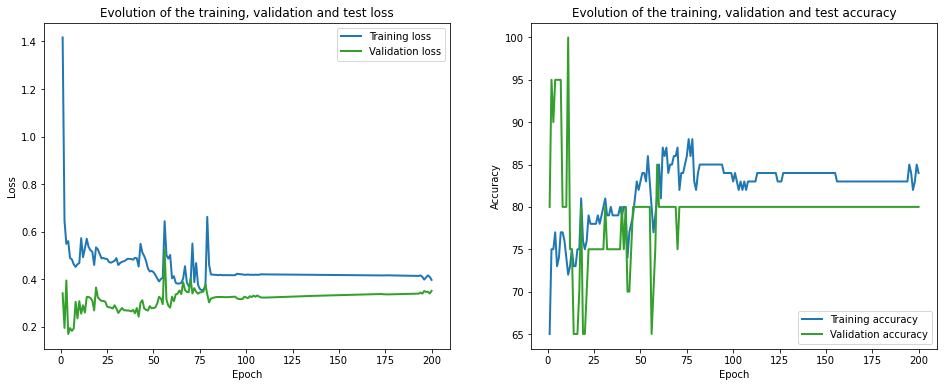

Calibrating each model in the list...


100%|███████████████████████████████████████████████████████████████████████████████| 200/200 [00:01<00:00, 153.93it/s]


Initialization done!
Computing naive benchmark p-values for 500 test points...


100%|██████████████████████████████████████████████████████████████████████████████| 500/500 [00:00<00:00, 1004.81it/s]

Finished computing p-values for 500 test points.
running 50 repetitions takes 942.297124


In [11]:
from time import time

def add_header(df):
    df["n_epoch"] = n_epoch
    df["n_calib"] = n_cal
    return df

results = pd.DataFrame({})

start = time()
for r in range(num_repetitions):
    print("\nStarting repetition {:d} of {:d}:\n".format(r+1, num_repetitions))
    sys.stdout.flush()
    
    # Change random seed for this repetition
    seed = 1000+r
    results_new = run_experiment(seed, train_set, n_train, val_set, n_val, n_cal, 
                                 test_set, n_test, lr, n_epoch, alpha_list, batch_size)
    results_new = add_header(results_new)
    results_new["Repetition"] = r
    results = pd.concat([results, results_new])
print('running {:d} repetitions takes {:4f}'.format(num_repetitions, time()-start))

In [12]:
sb_results = results[results["Method"]=="Standard benchmark"]
nb_results = results[results["Method"]=="Naive benchmark"]

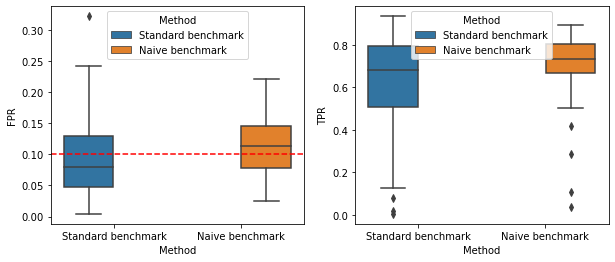

In [13]:
import seaborn as sns
fig, (ax1, ax2) = plt.subplots(1,2, figsize=(10,4))
sns.boxplot(y="Fixed-FPR", x="Method", hue="Method", data=results, ax=ax1)
ax1.set(xlabel='Method', ylabel='FPR')
ax1.axhline(alpha_list[0], ls='--', color="red")
ax1.legend(loc='upper center', title='Method')

sns.boxplot(y="Fixed-TPR", x="Method", hue="Method", data=results, ax=ax2)
ax2.set(xlabel='Method', ylabel='TPR')
ax2.legend(loc='upper center', title='Method')
plt.show()

In [14]:
results

,Alpha,BH-Rejections,BH-FDP,BH-Power,Storey-BH-Rejections,Storey-BH-FDP,Storey-BH-Power,Fixed-Rejections,Fixed-FPR,Fixed-TPR,Method,train_loss_history,val_loss_history,train_acc_history,val_acc_history,n_epoch,n_calib,Repetition
0,0.1,0.0,0.000000,0.000000,211.0,0.109005,0.720307,211.0,0.096234,0.720307,Standard benchmark,"[1.523742427676916, 0.4369536876678467, 0.3922...","[0.3839602917432785, 0.4145713895559311, 0.582...","[67.99999982118607, 77.99999922513962, 84.9999...","[79.99999821186066, 69.9999988079071, 60.00000...",200,20,0
0,0.1,0.0,0.000000,0.000000,132.0,0.060606,0.475096,190.0,0.096234,0.639847,Naive benchmark,"[0.9317968884948641, 1.2277998704463244, 0.590...","[0.8284200429916382, 0.5541247129440308, 0.132...","[73.00000011920929, 77.99999952316284, 80.9999...","[84.99999940395355, 90.00000059604645, 94.9999...",200,20,0
0,0.1,0.0,0.000000,0.000000,321.0,0.239875,0.934866,321.0,0.322176,0.934866,Standard benchmark,"[0.773203031718731, 0.3709545262157917, 0.3429...","[0.11035030335187912, 0.12712740153074265, 0.1...","[78.99999916553497, 80.99999964237213, 79.9999...","[100.0, 100.0, 100.0, 90.00000059604645, 94.99...",200,20,1
0,0.1,0.0,0.000000,0.000000,0.0,0.000000,0.000000,183.0,0.171548,0.544061,Naive benchmark,"[0.49268471598625185, 0.43765404596924784, 0.3...","[0.10716506093740463, 0.1739722564816475, 0.18...","[81.99999928474426, 75.99999904632568, 82.9999...","[100.0, 100.0, 94.9999988079071, 94.9999988079...",200,20,1
0,0.1,0.0,0.000000,0.000000,0.0,0.000000,0.000000,190.0,0.050209,0.681992,Standard benchmark,"[0.6359972149133682, 0.4527566835284233, 0.410...","[0.8720678091049194, 1.0905052423477173, 0.942...","[75.99999934434891, 78.99999976158142, 80.9999...","[30.000000447034836, 35.00000089406967, 45.000...",200,20,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,0.1,249.0,0.144578,0.816092,249.0,0.144578,0.816092,265.0,0.171548,0.858238,Naive benchmark,"[0.8942274987697602, 0.3688191704452038, 0.339...","[0.5211089253425598, 0.3197224736213684, 0.379...","[67.00000047683716, 83.99999976158142, 85.0, 8...","[75.0, 84.99999940395355, 84.99999940395355, 8...",200,20,47
0,0.1,0.0,0.000000,0.000000,0.0,0.000000,0.000000,6.0,0.004184,0.019157,Standard benchmark,"[1.5701839357614518, 0.5915926337242127, 0.582...","[0.4351308047771454, 0.5364885330200195, 0.822...","[51.000000834465034, 77.00000047683716, 75.999...","[55.000001192092896, 59.99999940395355, 45.000...",200,20,48
0,0.1,275.0,0.178182,0.865900,275.0,0.178182,0.865900,275.0,0.205021,0.865900,Naive benchmark,"[1.060607460141182, 0.5531507551670074, 0.5424...","[0.4067784249782562, 0.5967600345611572, 0.449...","[57.00000137090683, 64.00000043213367, 70.0000...","[55.000001192092896, 55.000001192092896, 50.00...",200,20,48
0,0.1,0.0,0.000000,0.000000,0.0,0.000000,0.000000,37.0,0.016736,0.126437,Standard benchmark,"[1.6995850123465062, 0.6152600735425949, 0.557...","[0.24415557086467743, 0.16037379205226898, 0.6...","[73.00000041723251, 82.99999952316284, 70.0000...","[84.99999940395355, 94.9999988079071, 84.99999...",200,20,49


Standard benchmark index number is 0, false positive rate is 0.096234


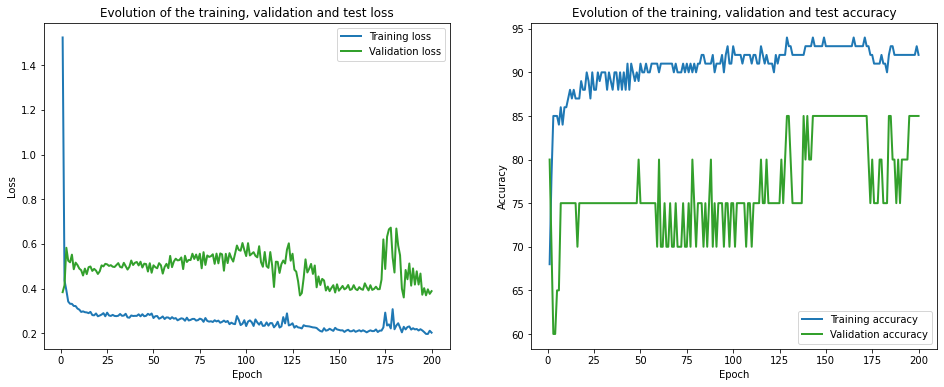

Standard benchmark index number is 1, false positive rate is 0.322176


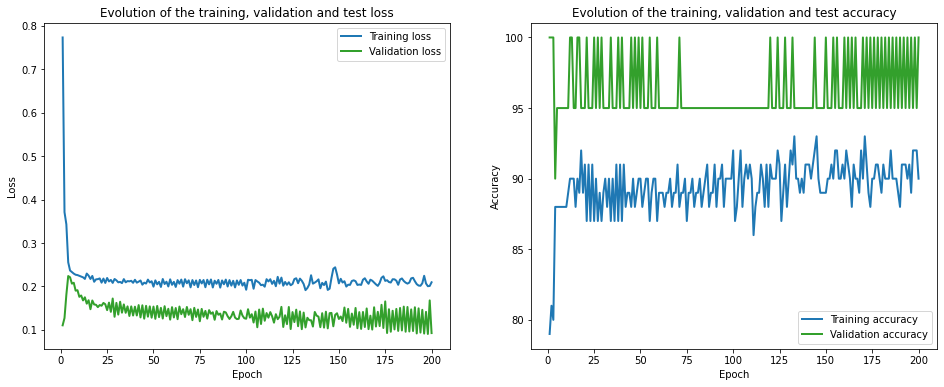

Standard benchmark index number is 2, false positive rate is 0.050209


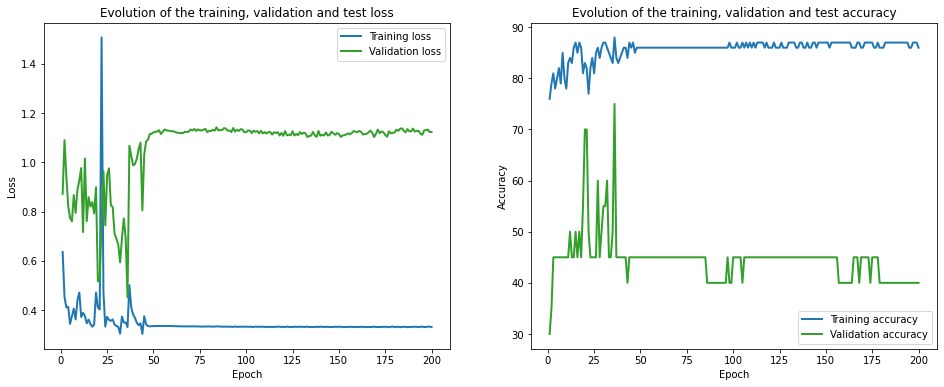

Standard benchmark index number is 3, false positive rate is 0.079498


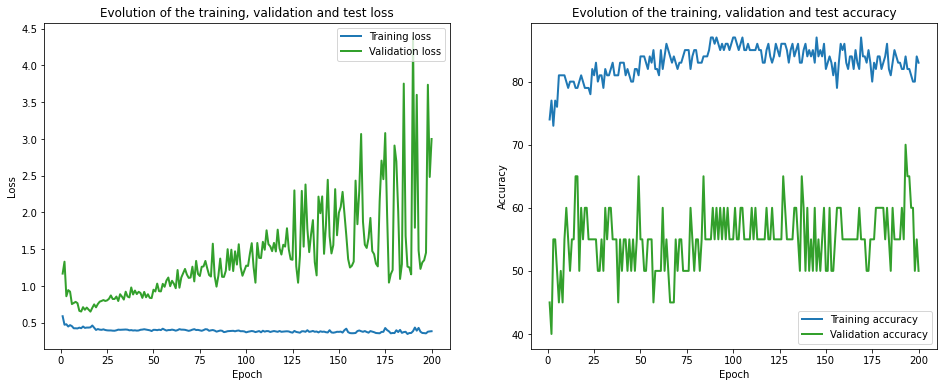

Standard benchmark index number is 4, false positive rate is 0.104603


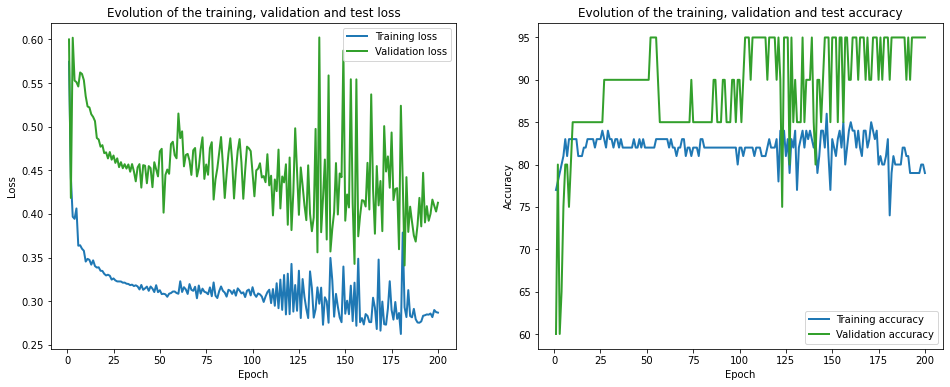

Standard benchmark index number is 5, false positive rate is 0.083682


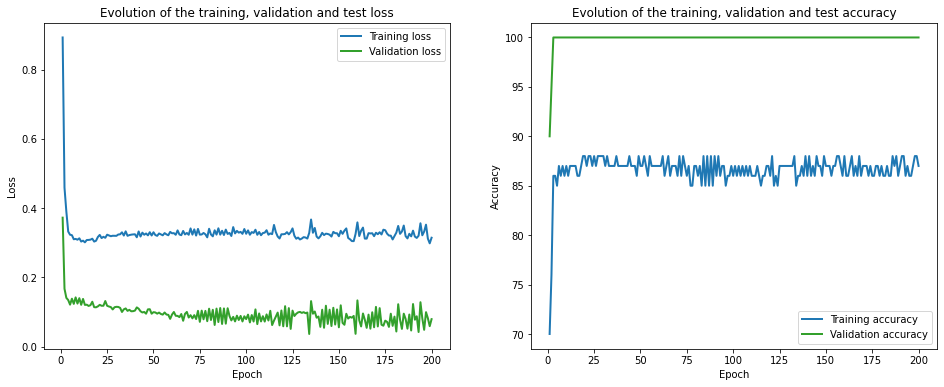

Standard benchmark index number is 6, false positive rate is 0.234310


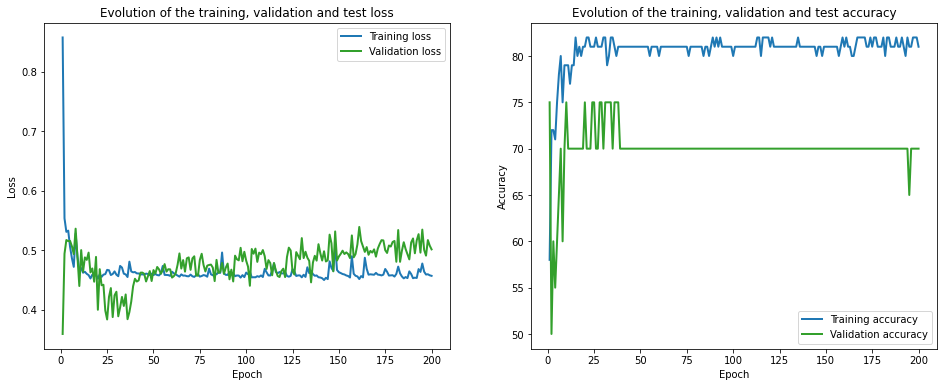

Standard benchmark index number is 7, false positive rate is 0.046025


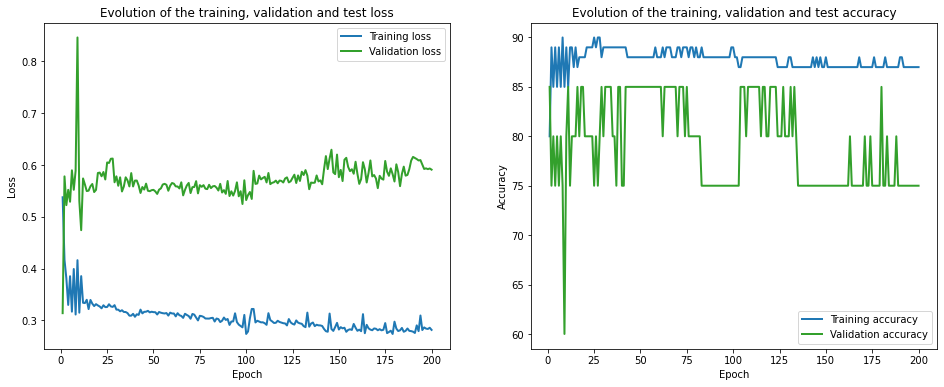

Standard benchmark index number is 8, false positive rate is 0.029289


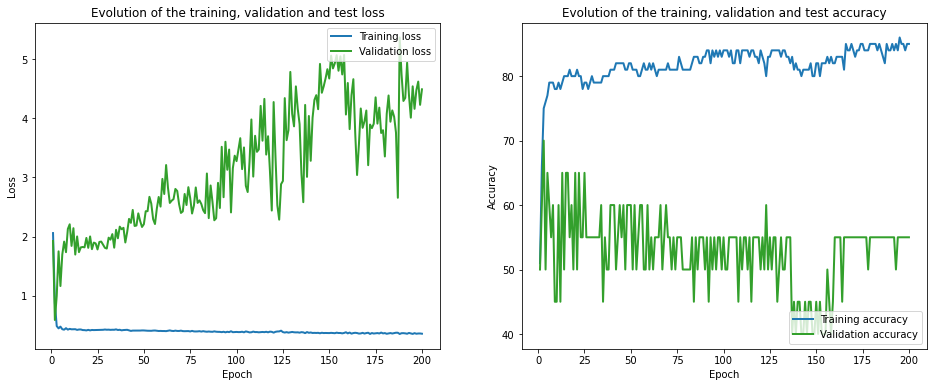

Standard benchmark index number is 9, false positive rate is 0.037657


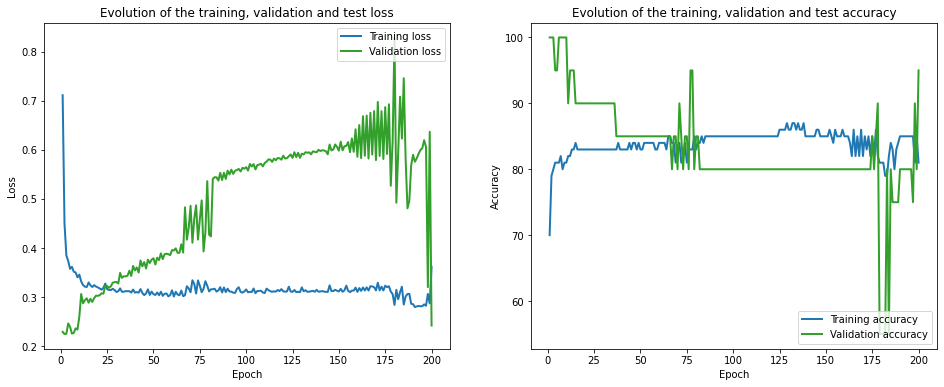

Standard benchmark index number is 10, false positive rate is 0.050209


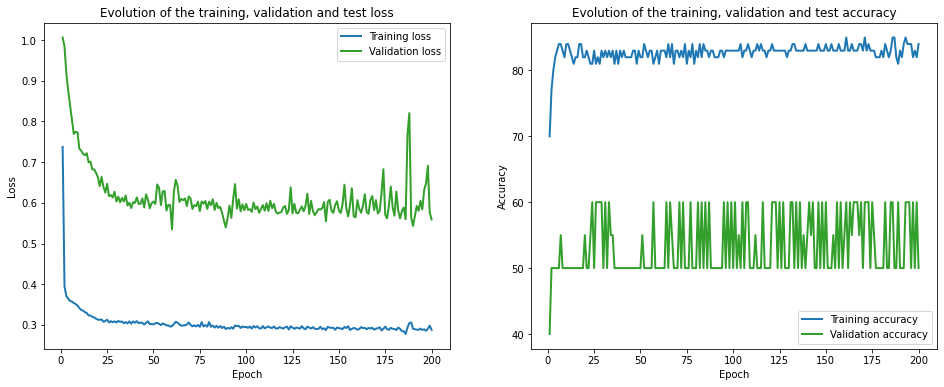

Standard benchmark index number is 11, false positive rate is 0.087866


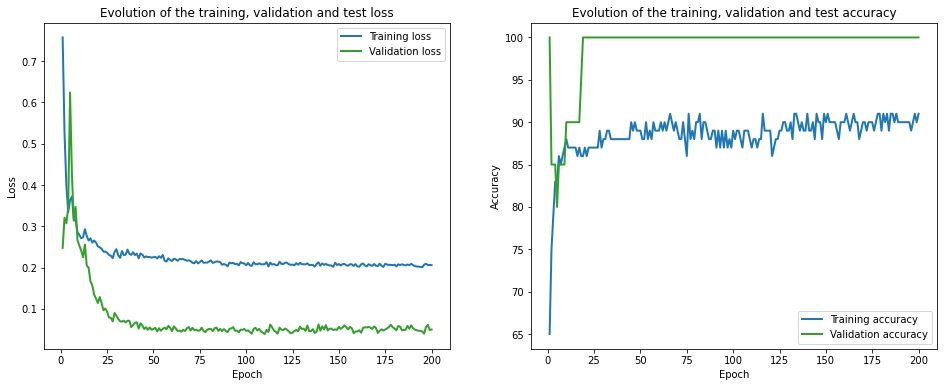

Standard benchmark index number is 12, false positive rate is 0.050209


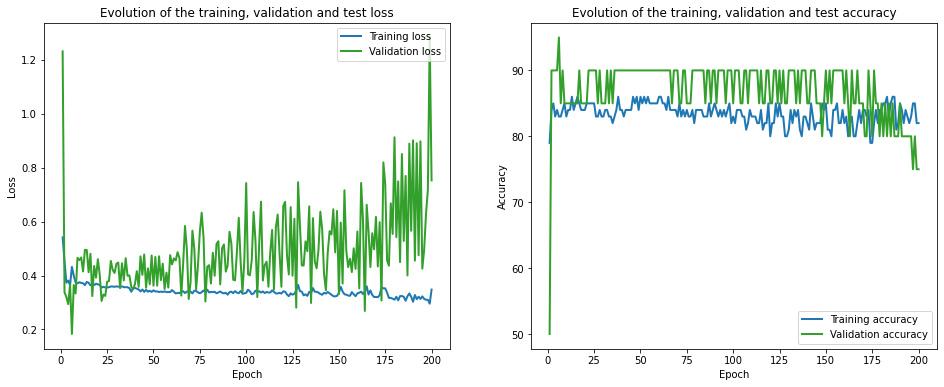

Standard benchmark index number is 13, false positive rate is 0.020921


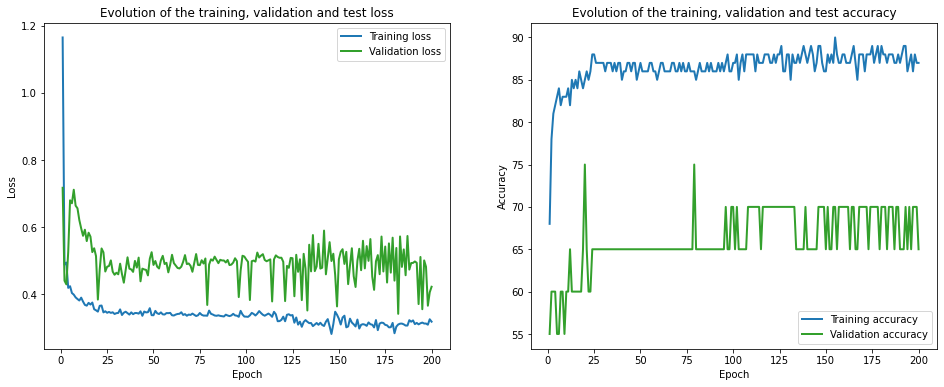

Standard benchmark index number is 14, false positive rate is 0.154812


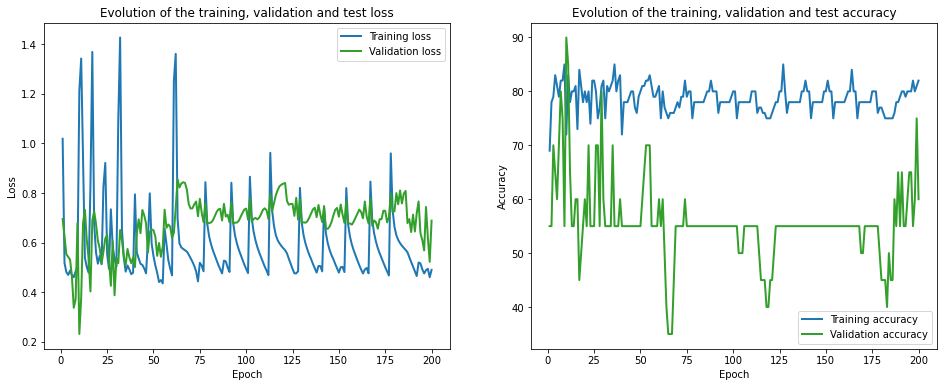

Standard benchmark index number is 15, false positive rate is 0.041841


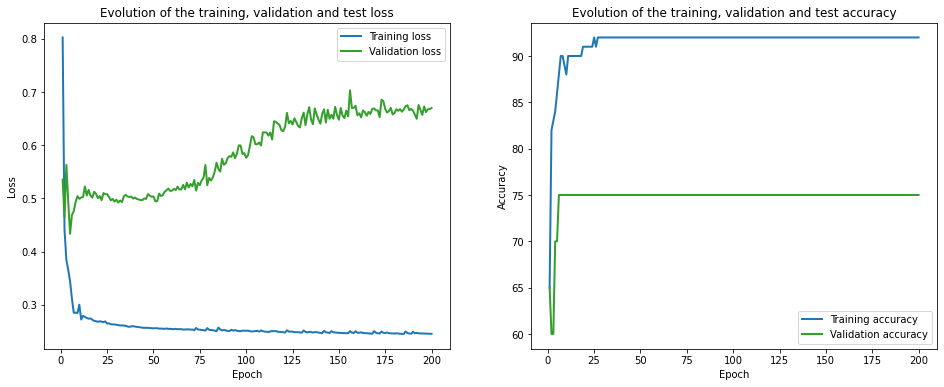

Standard benchmark index number is 16, false positive rate is 0.100418


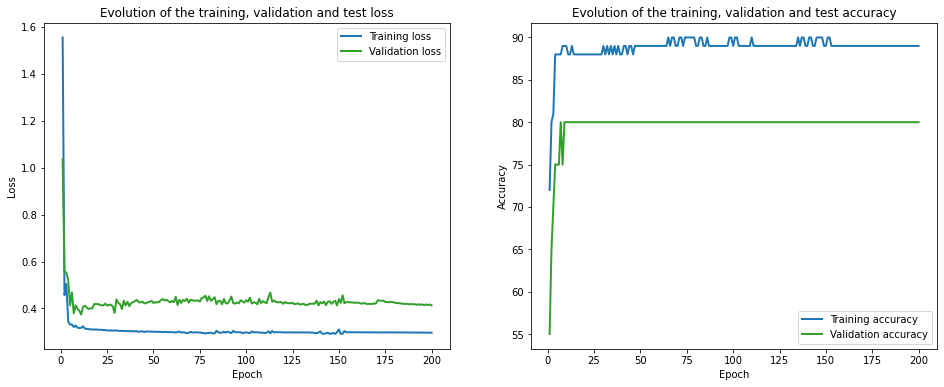

Standard benchmark index number is 17, false positive rate is 0.121339


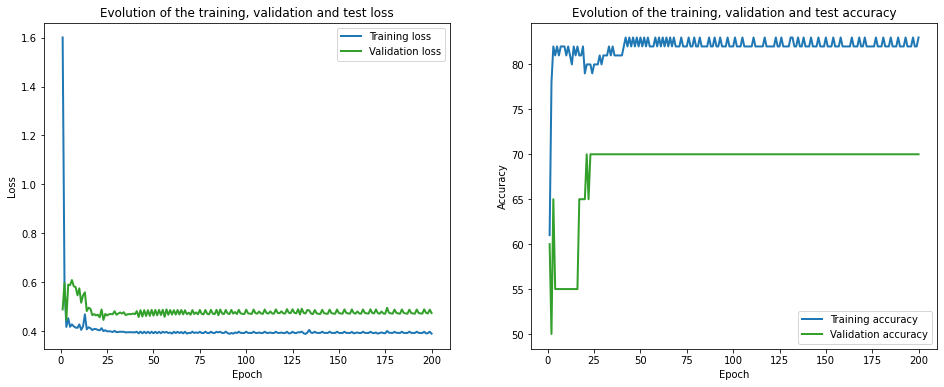

Standard benchmark index number is 18, false positive rate is 0.025105


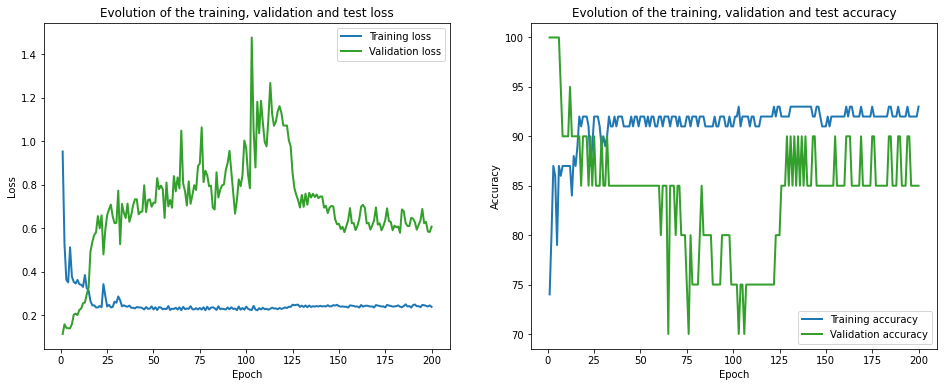

Standard benchmark index number is 19, false positive rate is 0.016736


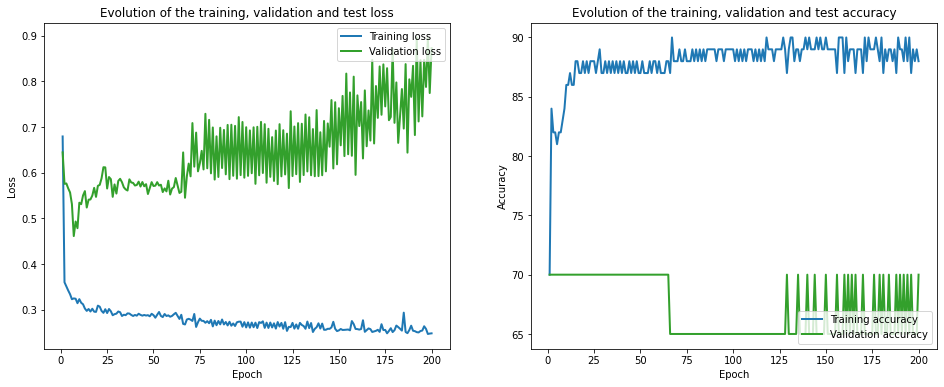

Standard benchmark index number is 20, false positive rate is 0.209205


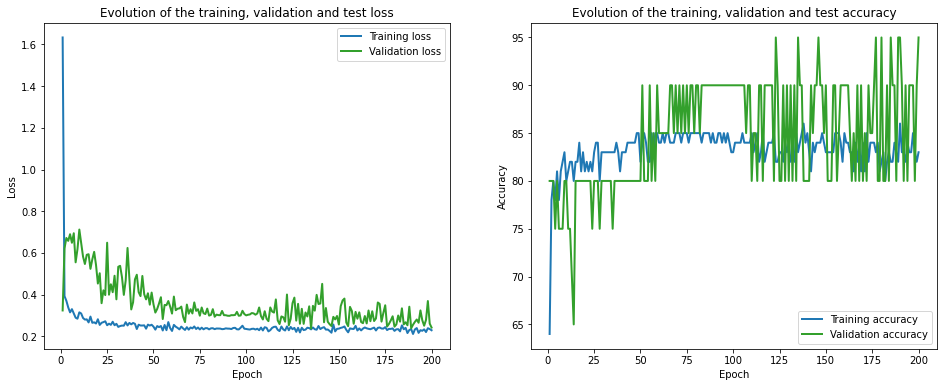

Standard benchmark index number is 21, false positive rate is 0.230126


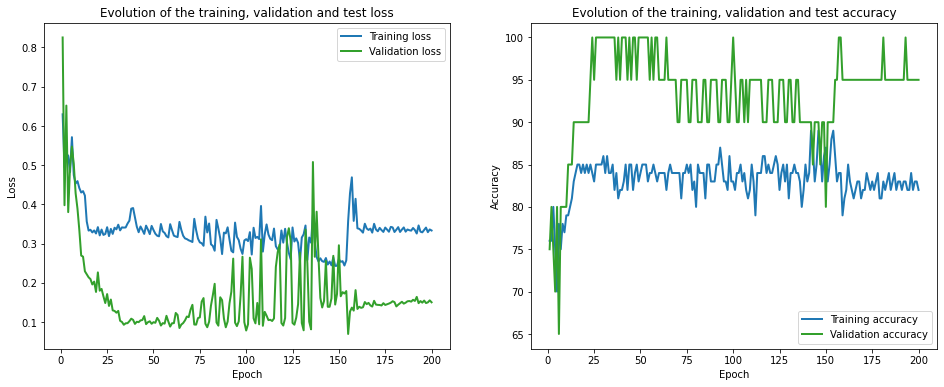

Standard benchmark index number is 22, false positive rate is 0.112971


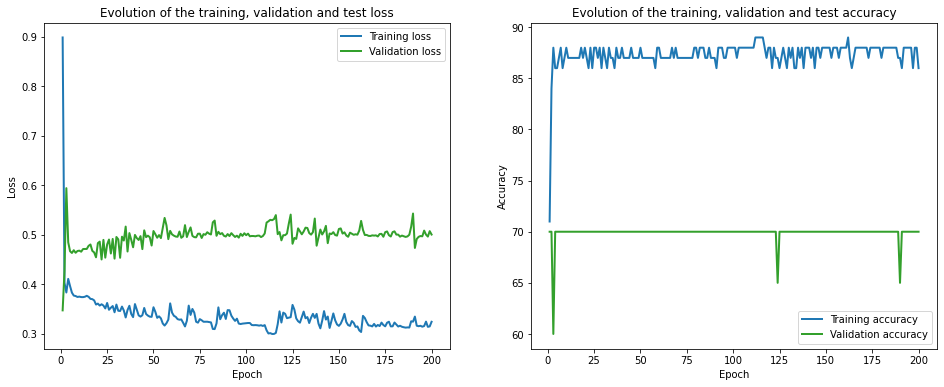

Standard benchmark index number is 23, false positive rate is 0.242678


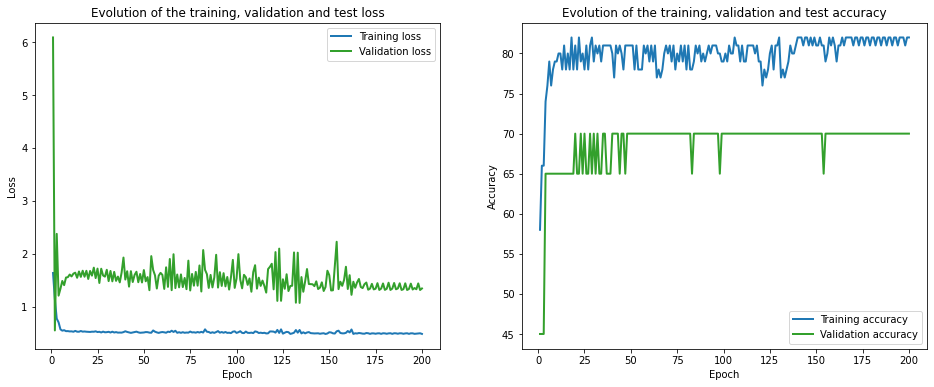

Standard benchmark index number is 24, false positive rate is 0.020921


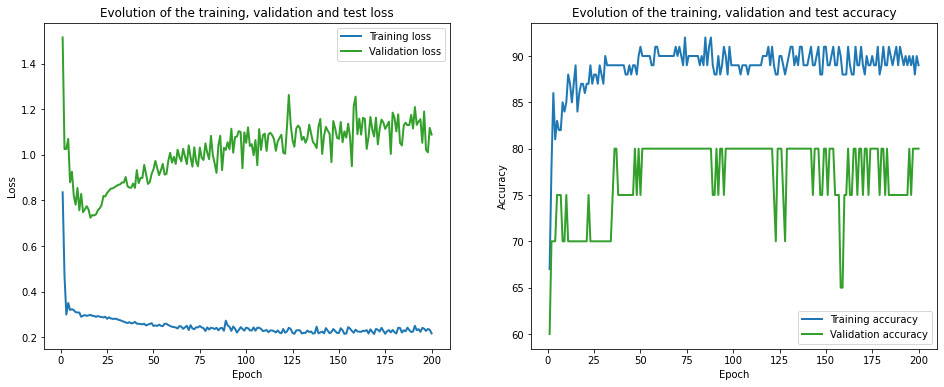

Standard benchmark index number is 25, false positive rate is 0.146444


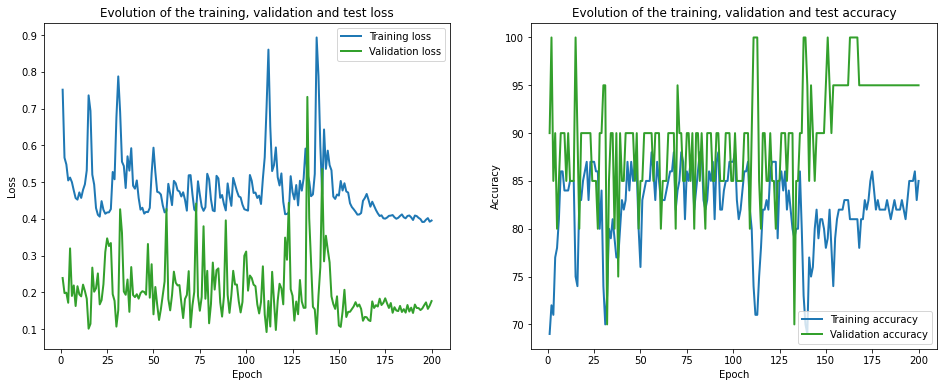

Standard benchmark index number is 26, false positive rate is 0.071130


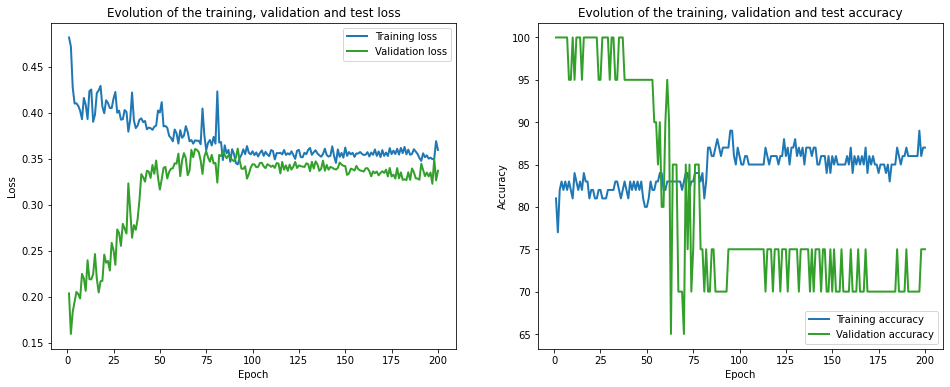

Standard benchmark index number is 27, false positive rate is 0.167364


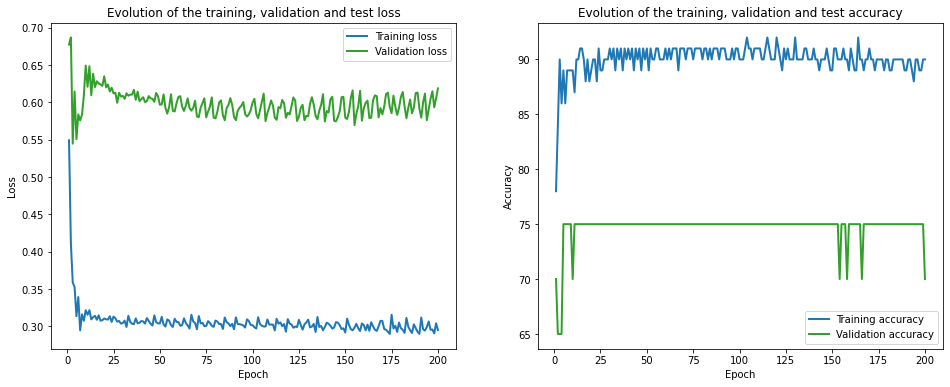

Standard benchmark index number is 28, false positive rate is 0.129707


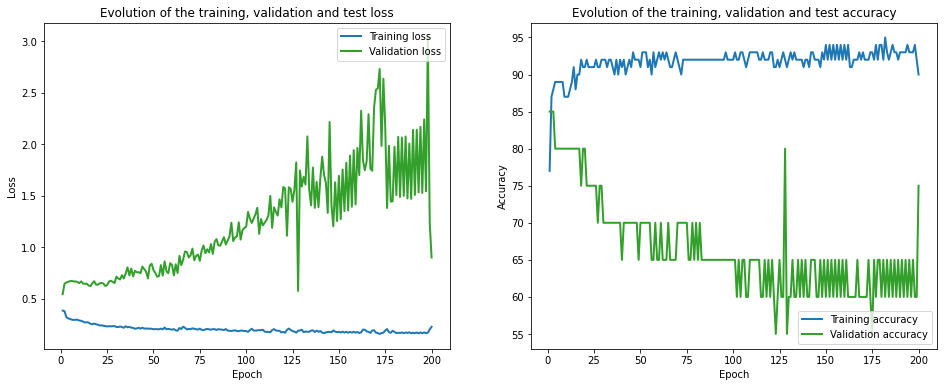

Standard benchmark index number is 29, false positive rate is 0.062762


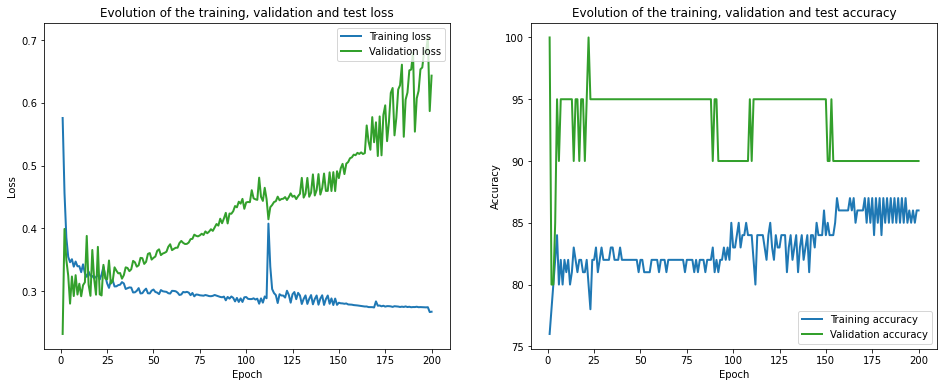

Standard benchmark index number is 30, false positive rate is 0.129707


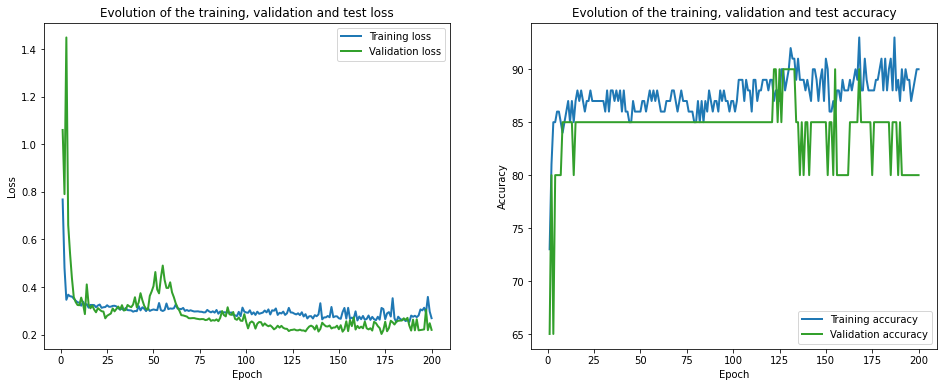

Standard benchmark index number is 31, false positive rate is 0.184100


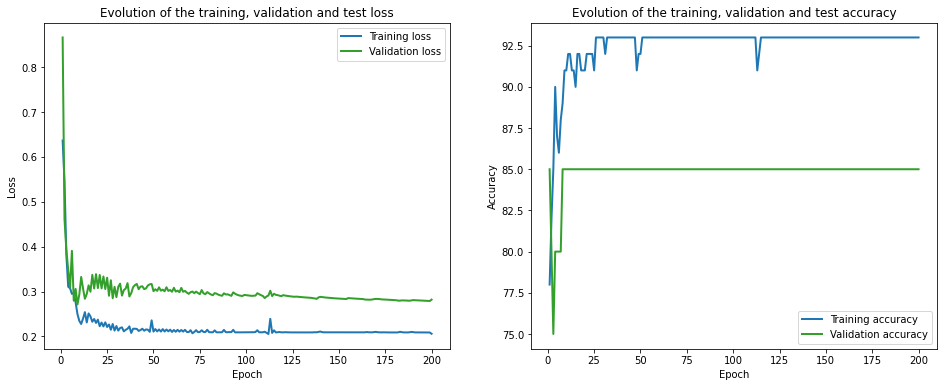

Standard benchmark index number is 32, false positive rate is 0.020921


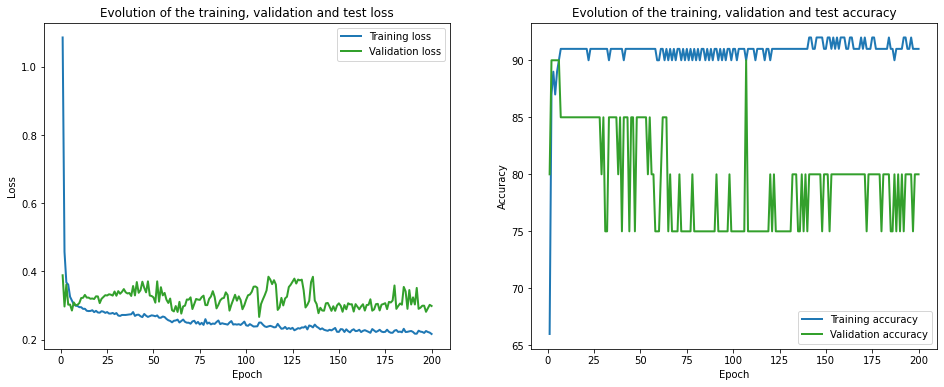

Standard benchmark index number is 33, false positive rate is 0.041841


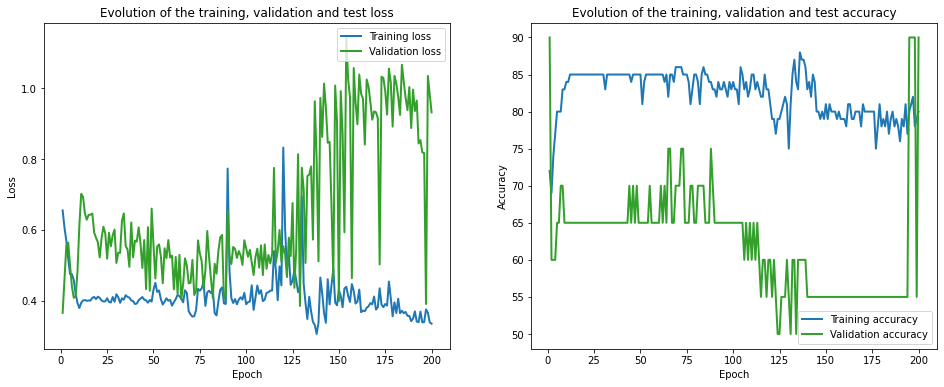

Standard benchmark index number is 34, false positive rate is 0.071130


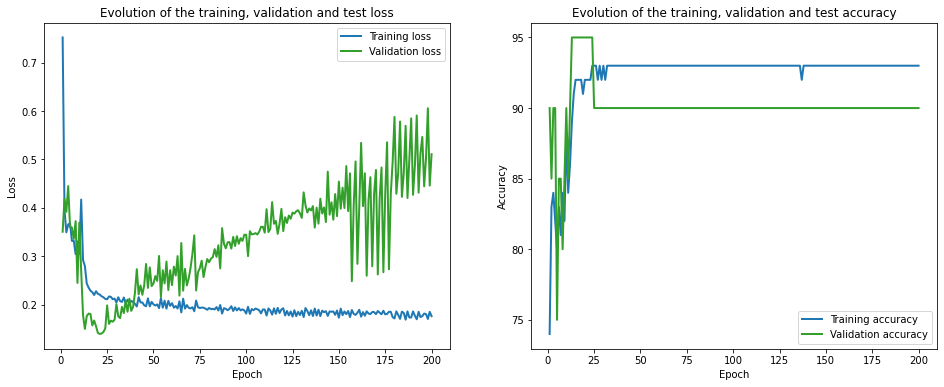

Standard benchmark index number is 35, false positive rate is 0.079498


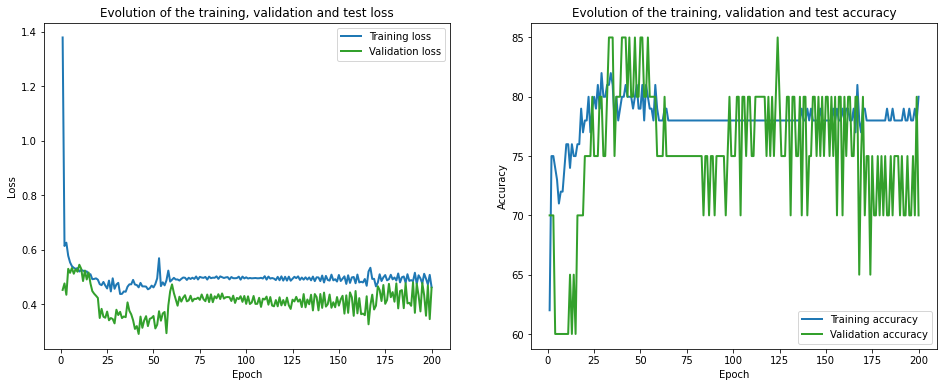

Standard benchmark index number is 36, false positive rate is 0.117155


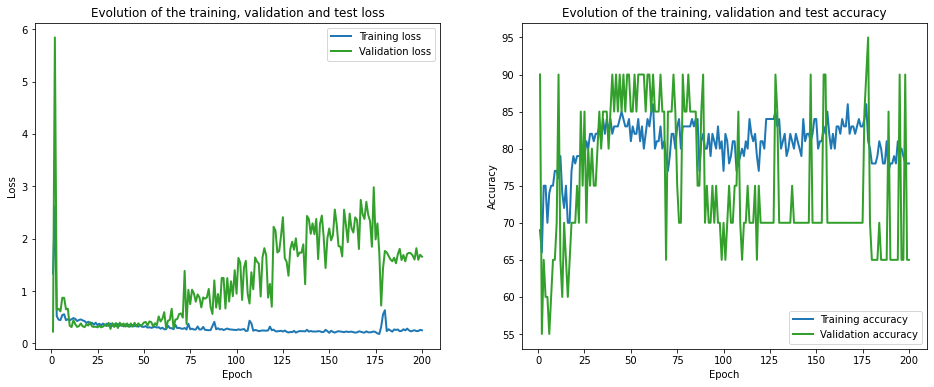

Standard benchmark index number is 37, false positive rate is 0.033473


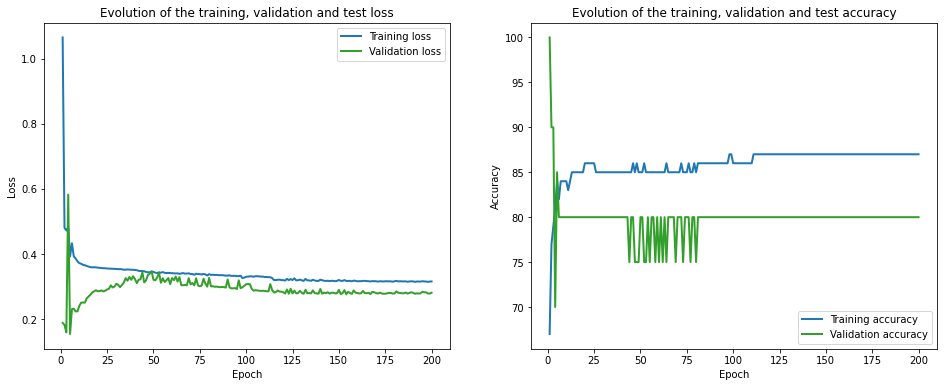

Standard benchmark index number is 38, false positive rate is 0.196653


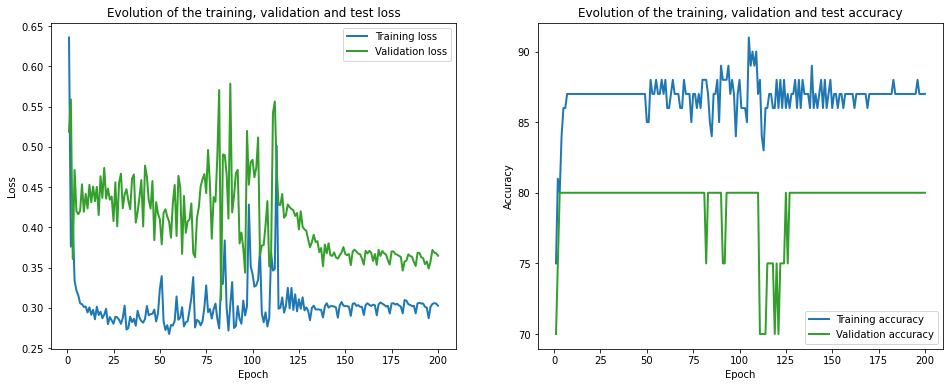

Standard benchmark index number is 39, false positive rate is 0.062762


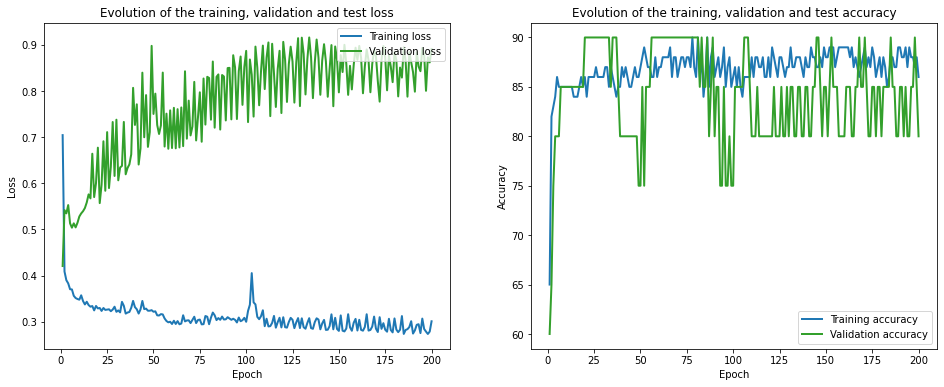

Standard benchmark index number is 40, false positive rate is 0.071130


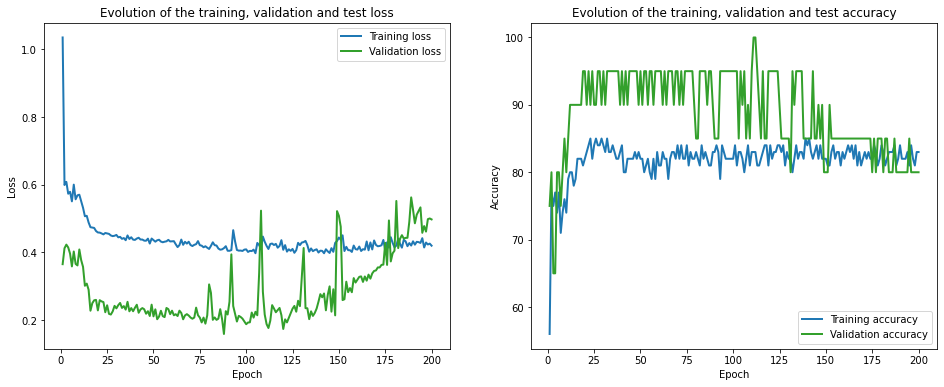

Standard benchmark index number is 41, false positive rate is 0.050209


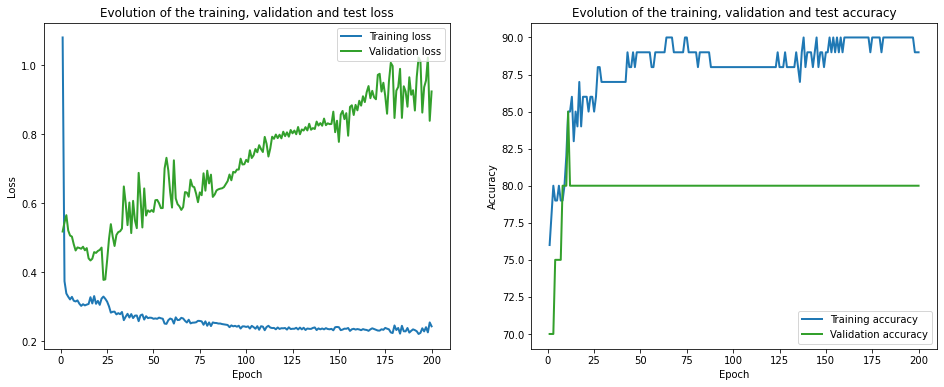

Standard benchmark index number is 42, false positive rate is 0.050209


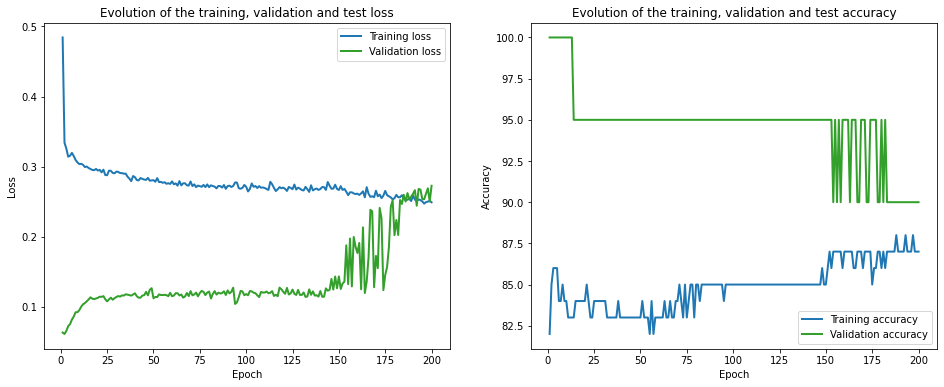

Standard benchmark index number is 43, false positive rate is 0.200837


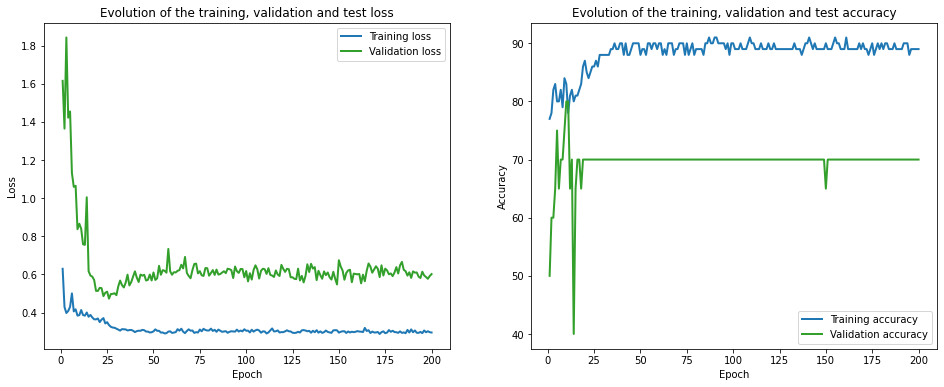

Standard benchmark index number is 44, false positive rate is 0.175732


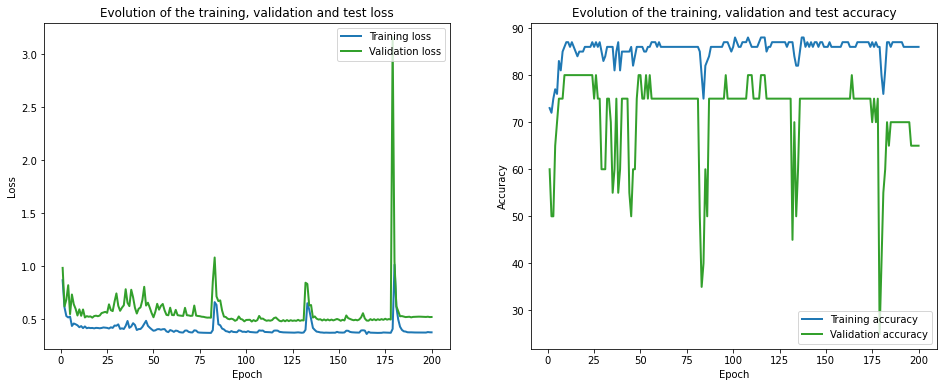

Standard benchmark index number is 45, false positive rate is 0.125523


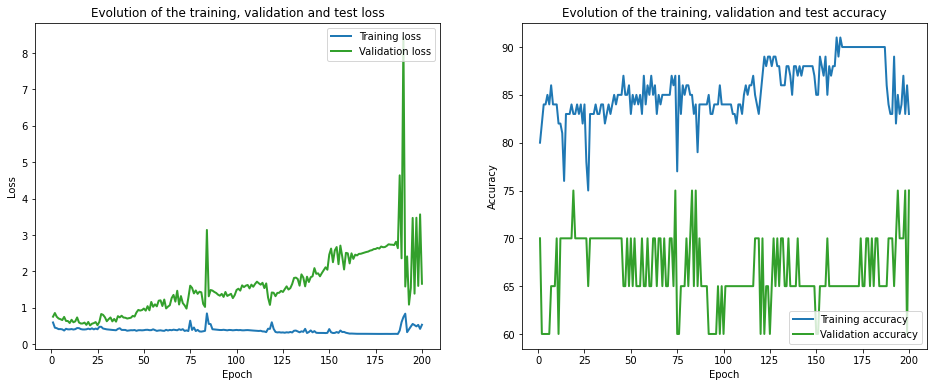

Standard benchmark index number is 46, false positive rate is 0.125523


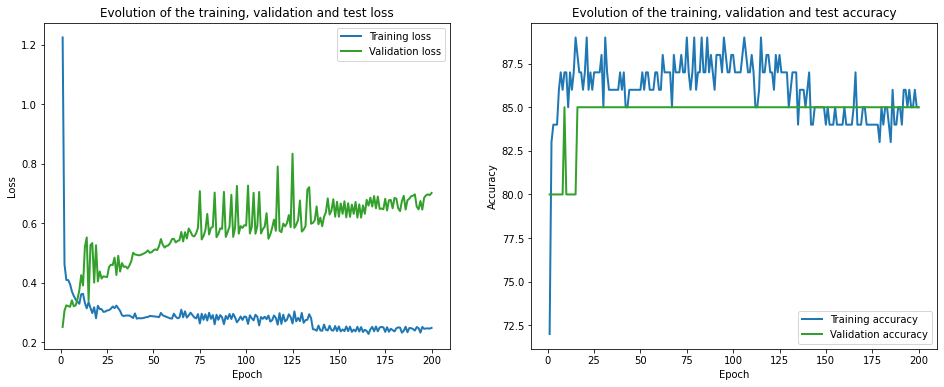

Standard benchmark index number is 47, false positive rate is 0.054393


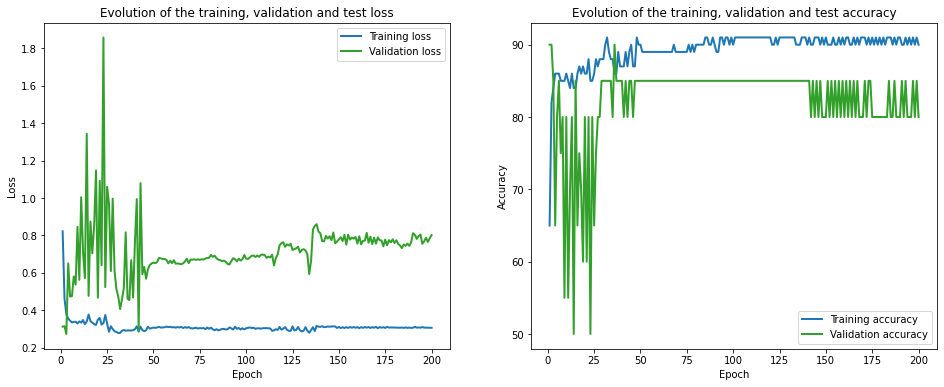

Standard benchmark index number is 48, false positive rate is 0.004184


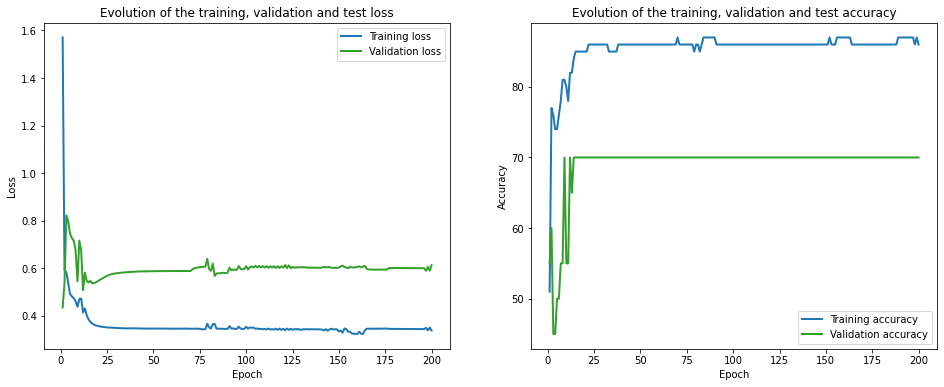

Standard benchmark index number is 49, false positive rate is 0.016736


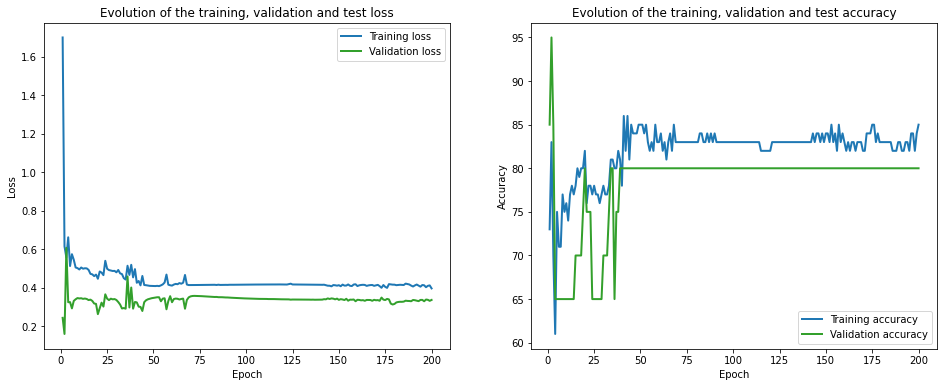

In [15]:
for i in range(len(sb_results)):
    print('Standard benchmark index number is {:d}, false positive rate is {:4f}'.format(i,sb_results.iloc[i]["Fixed-FPR"]))
    plot_loss_acc(sb_results.iloc[i].train_loss_history, sb_results.iloc[i].val_loss_history, 
                      sb_results.iloc[i].train_acc_history, sb_results.iloc[i].val_acc_history)

Naive benchmark index number is 0, false positive rate is 0.096234


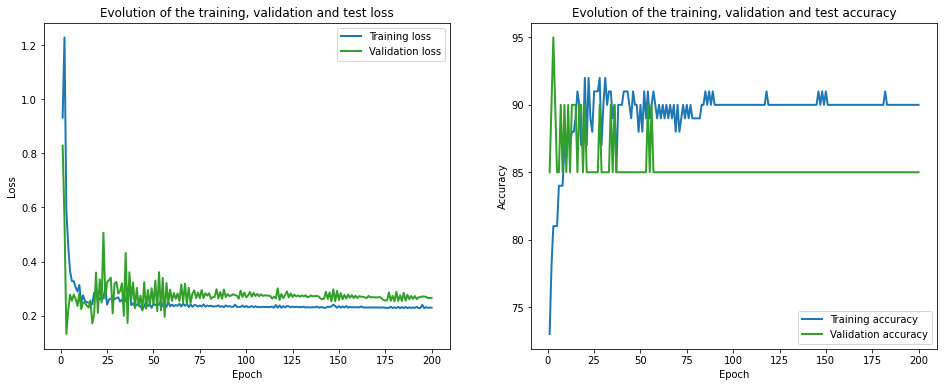

Naive benchmark index number is 1, false positive rate is 0.171548


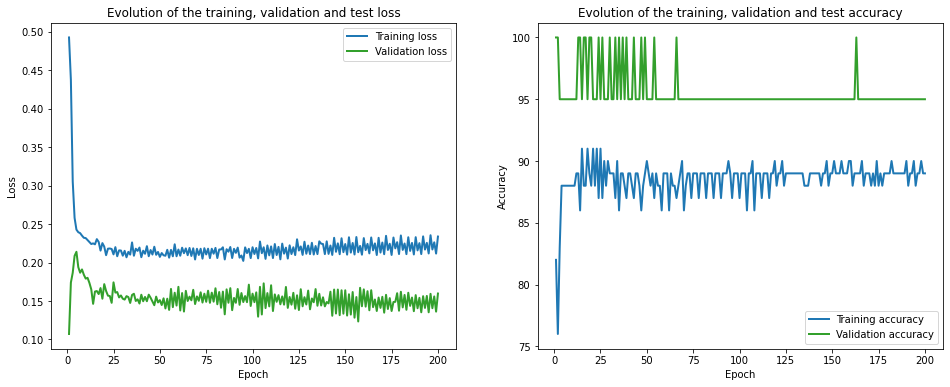

Naive benchmark index number is 2, false positive rate is 0.121339


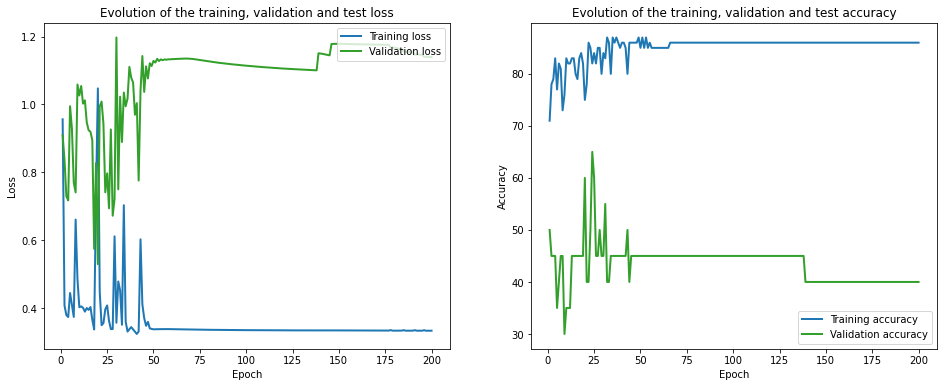

Naive benchmark index number is 3, false positive rate is 0.071130


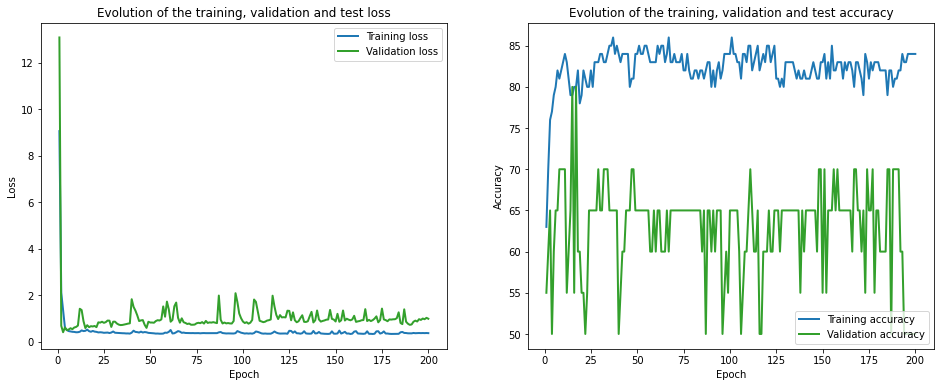

Naive benchmark index number is 4, false positive rate is 0.192469


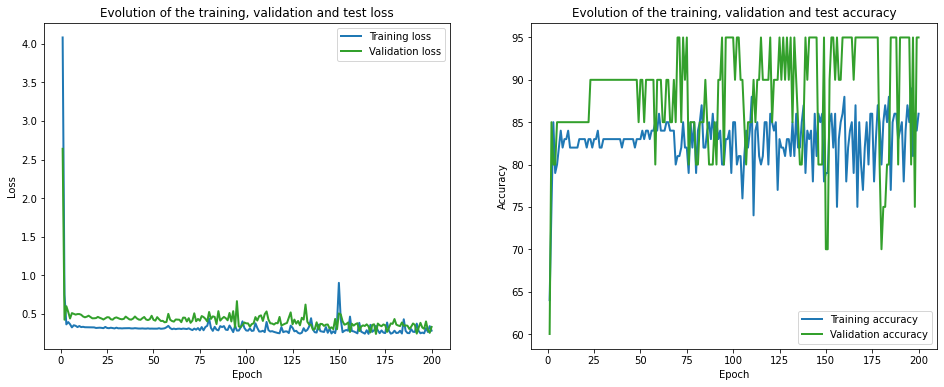

Naive benchmark index number is 5, false positive rate is 0.221757


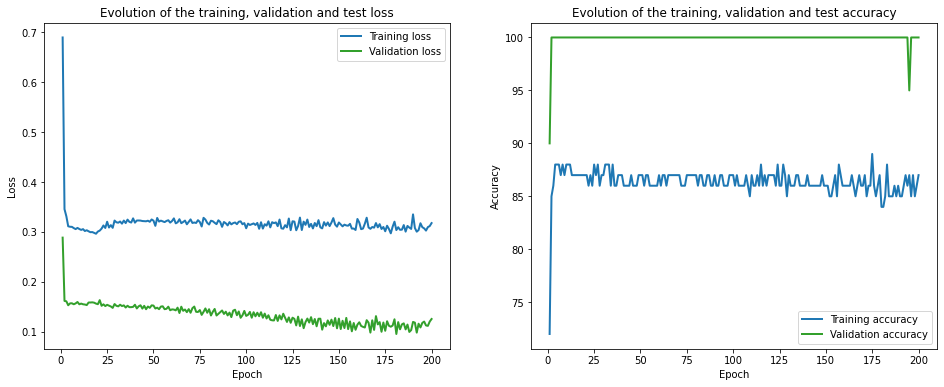

Naive benchmark index number is 6, false positive rate is 0.213389


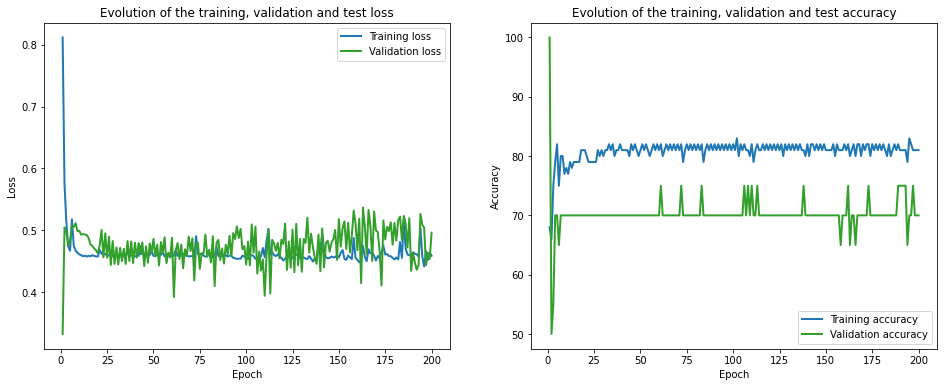

Naive benchmark index number is 7, false positive rate is 0.071130


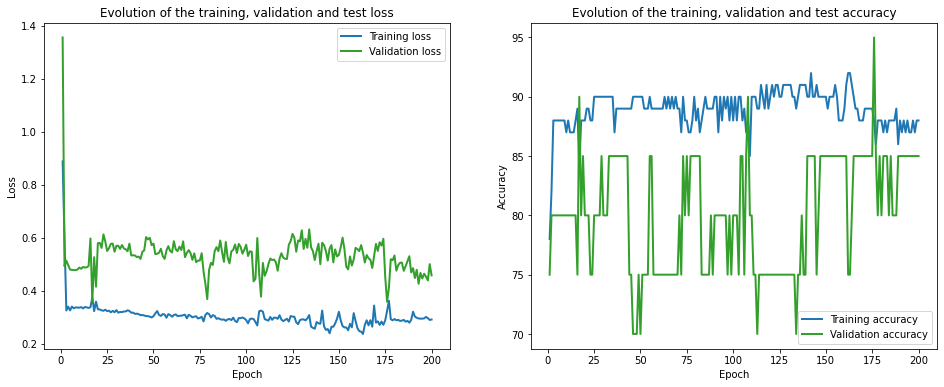

Naive benchmark index number is 8, false positive rate is 0.046025


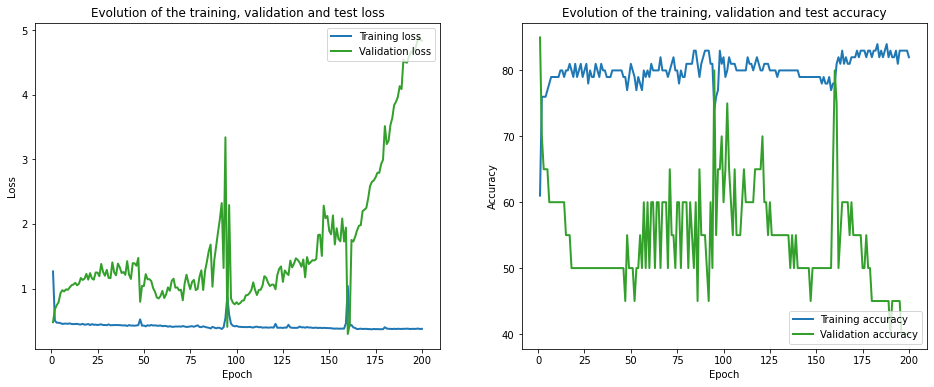

Naive benchmark index number is 9, false positive rate is 0.129707


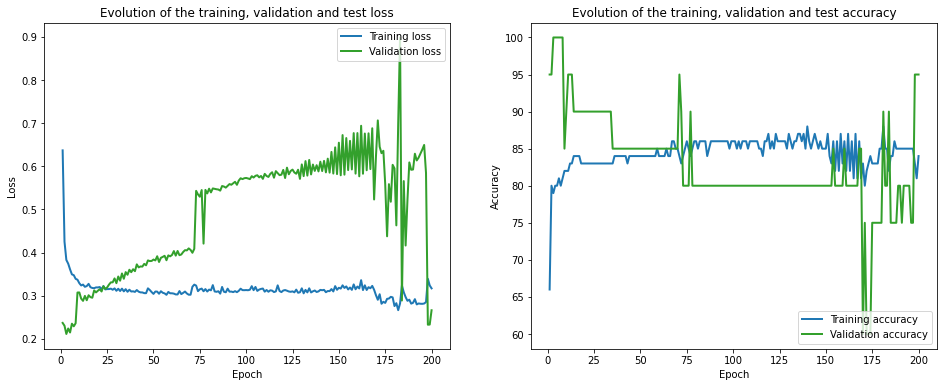

Naive benchmark index number is 10, false positive rate is 0.083682


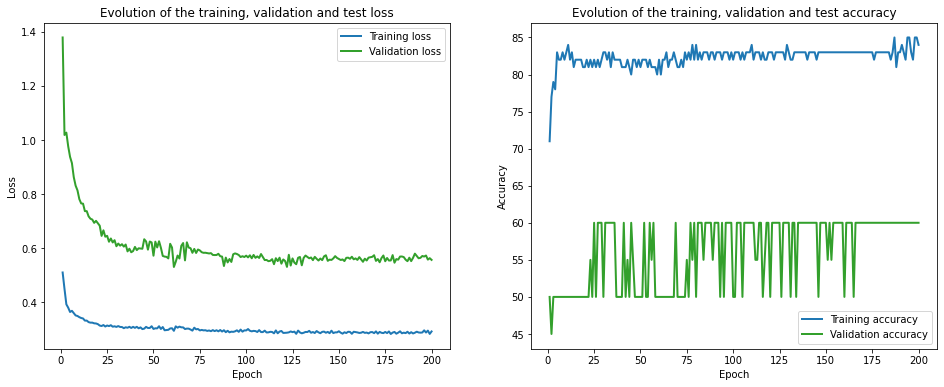

Naive benchmark index number is 11, false positive rate is 0.146444


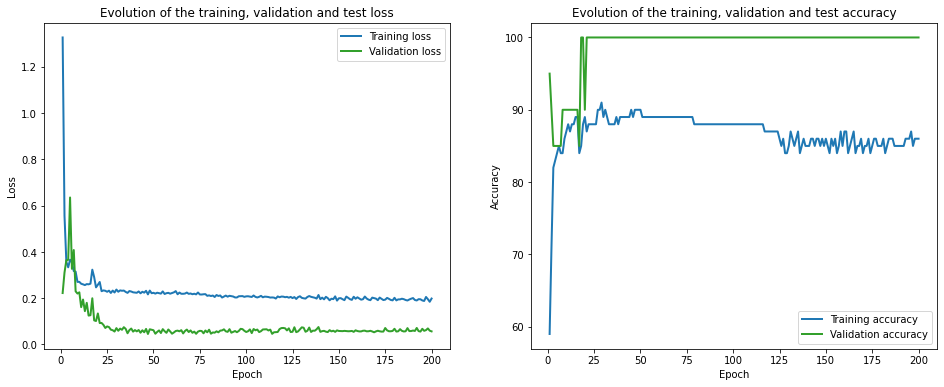

Naive benchmark index number is 12, false positive rate is 0.037657


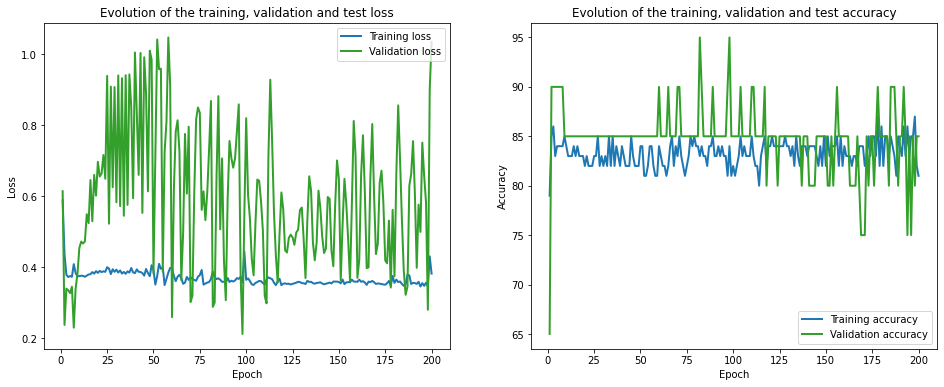

Naive benchmark index number is 13, false positive rate is 0.096234


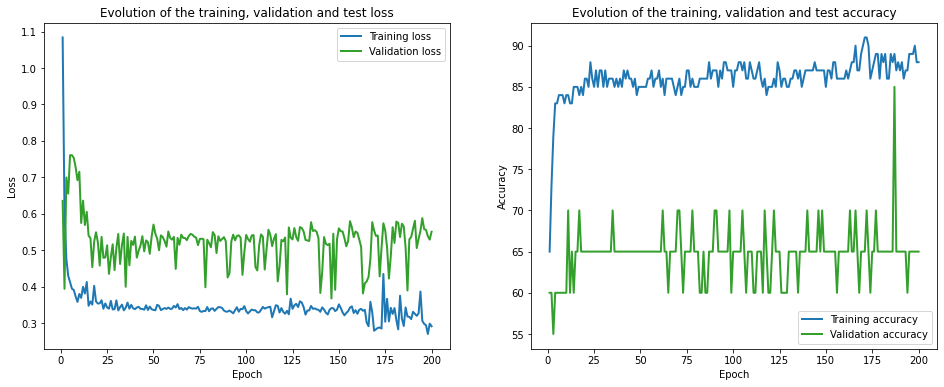

Naive benchmark index number is 14, false positive rate is 0.205021


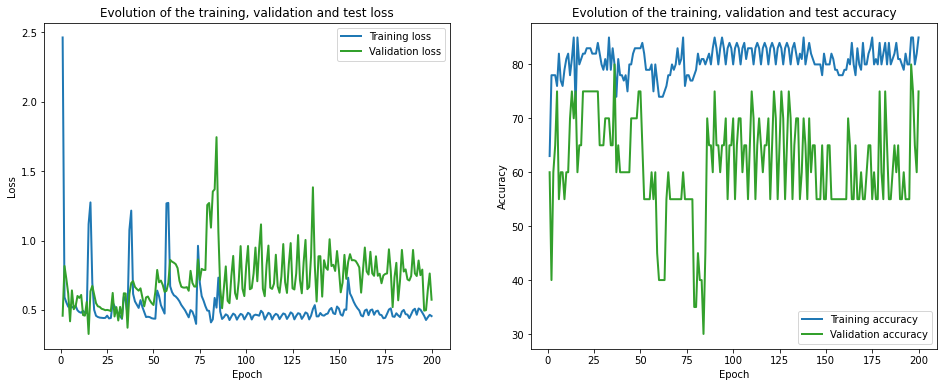

Naive benchmark index number is 15, false positive rate is 0.221757


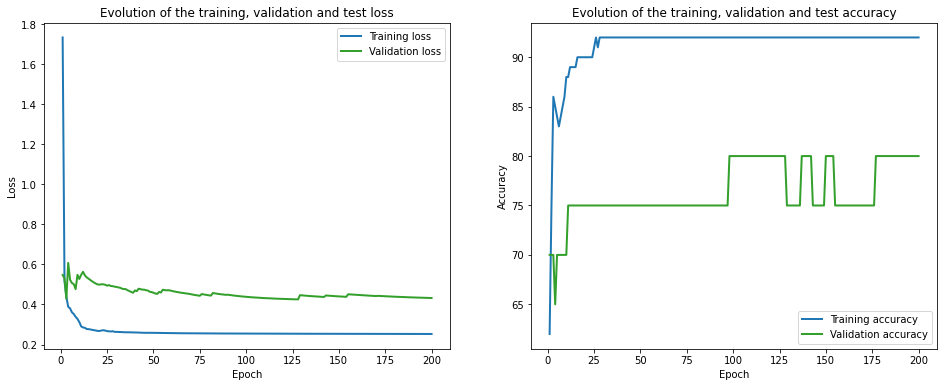

Naive benchmark index number is 16, false positive rate is 0.138075


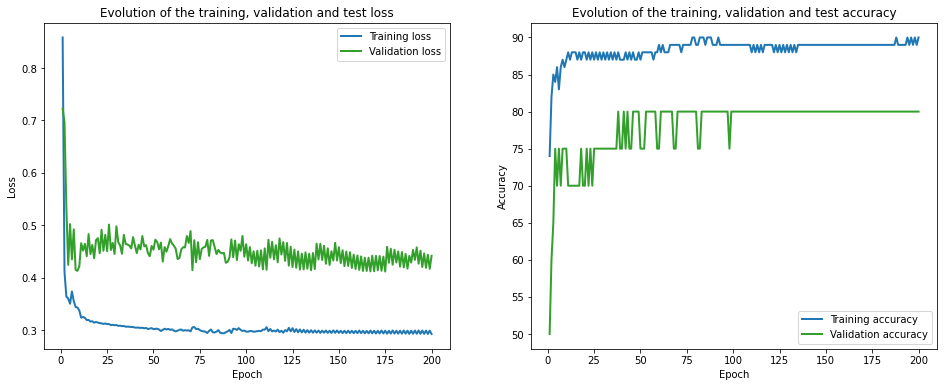

Naive benchmark index number is 17, false positive rate is 0.154812


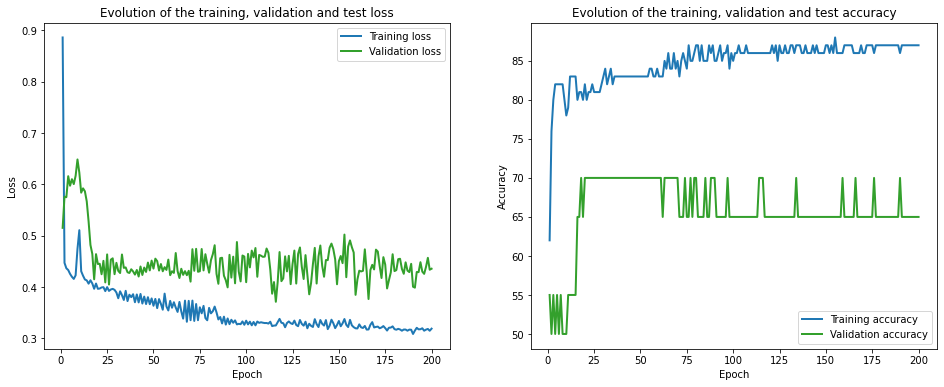

Naive benchmark index number is 18, false positive rate is 0.041841


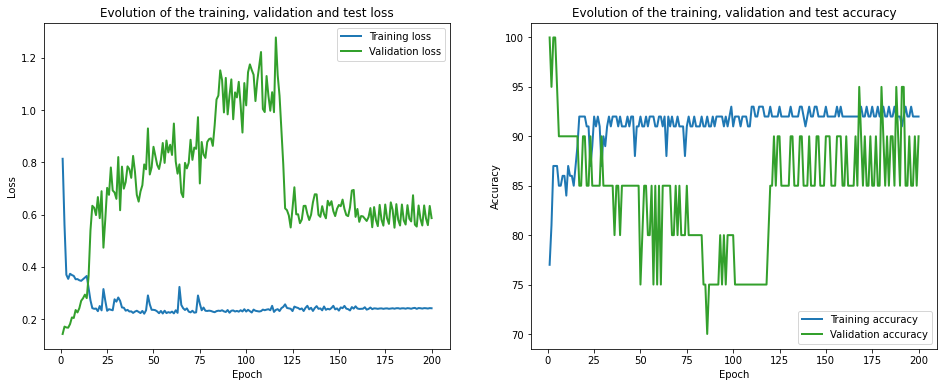

Naive benchmark index number is 19, false positive rate is 0.054393


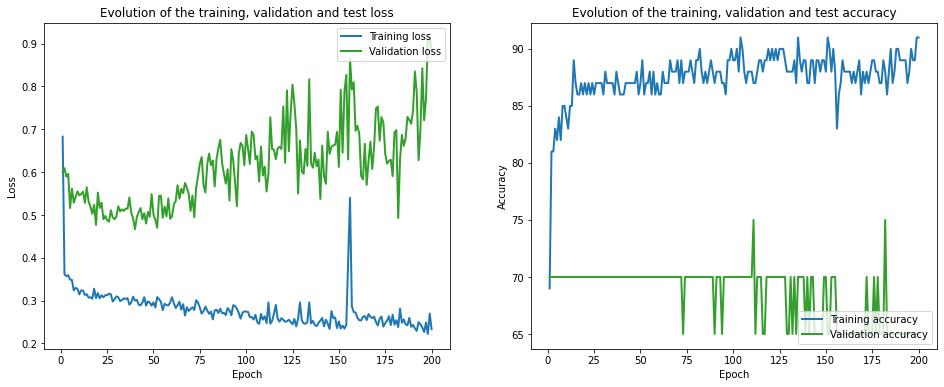

Naive benchmark index number is 20, false positive rate is 0.046025


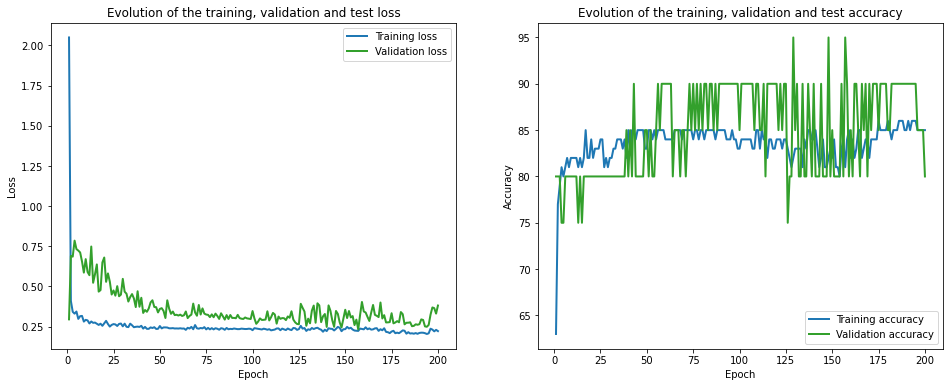

Naive benchmark index number is 21, false positive rate is 0.142259


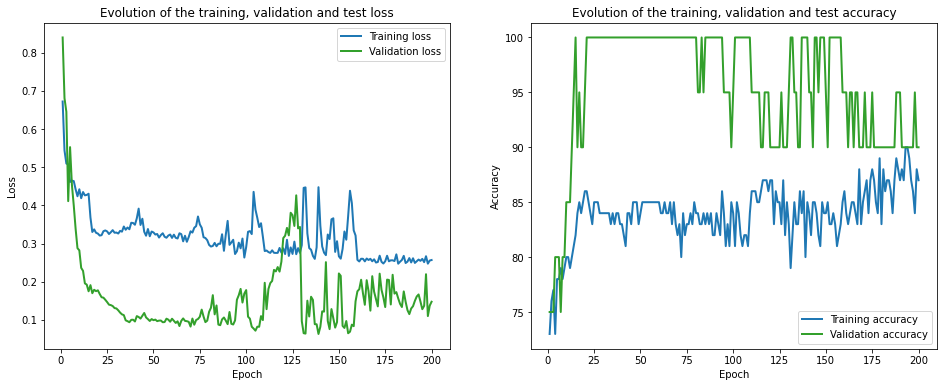

Naive benchmark index number is 22, false positive rate is 0.108787


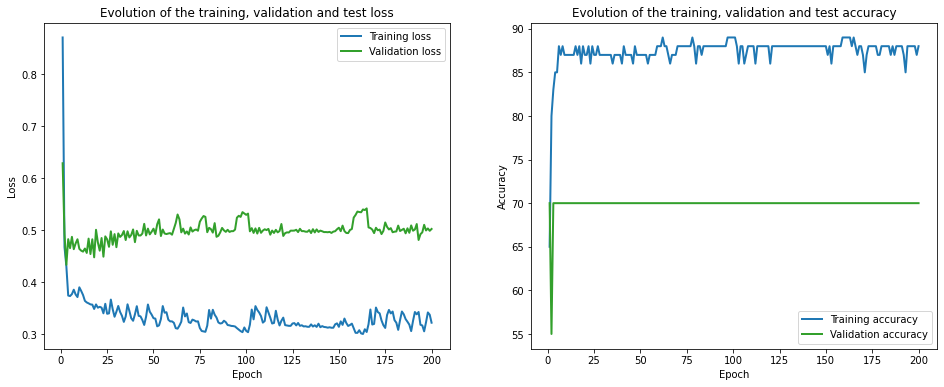

Naive benchmark index number is 23, false positive rate is 0.083682


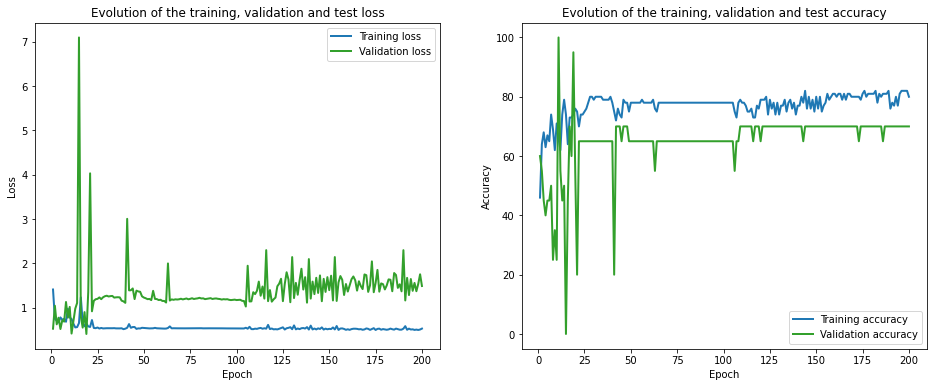

Naive benchmark index number is 24, false positive rate is 0.087866


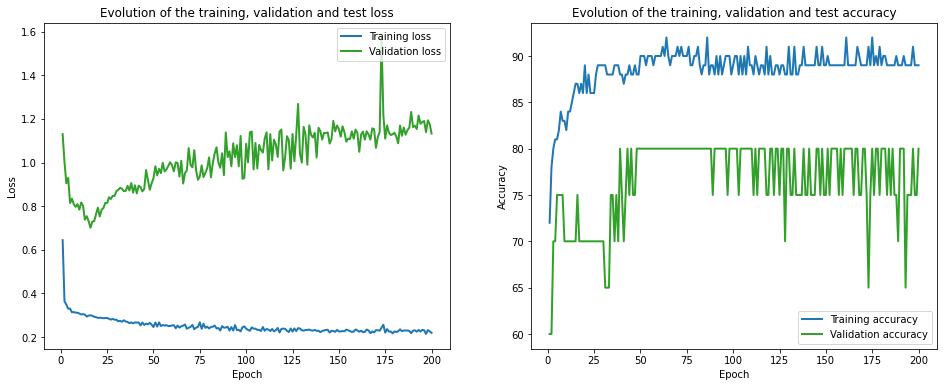

Naive benchmark index number is 25, false positive rate is 0.075314


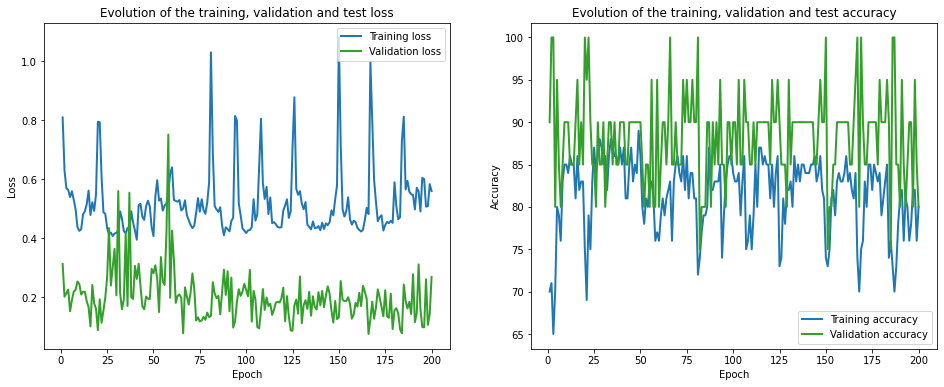

Naive benchmark index number is 26, false positive rate is 0.071130


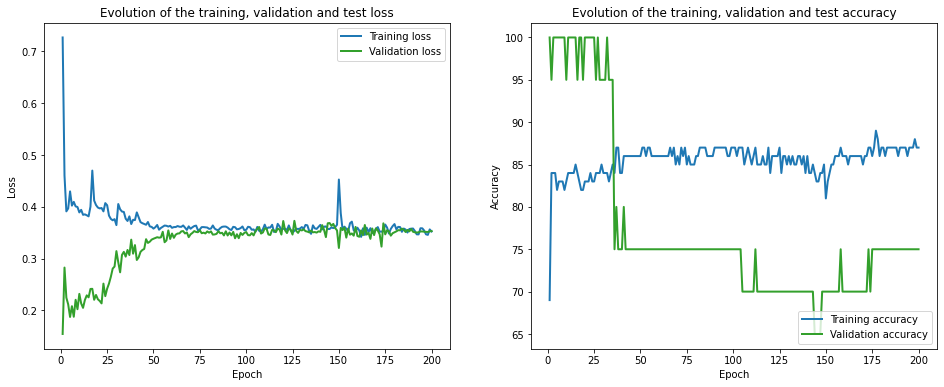

Naive benchmark index number is 27, false positive rate is 0.142259


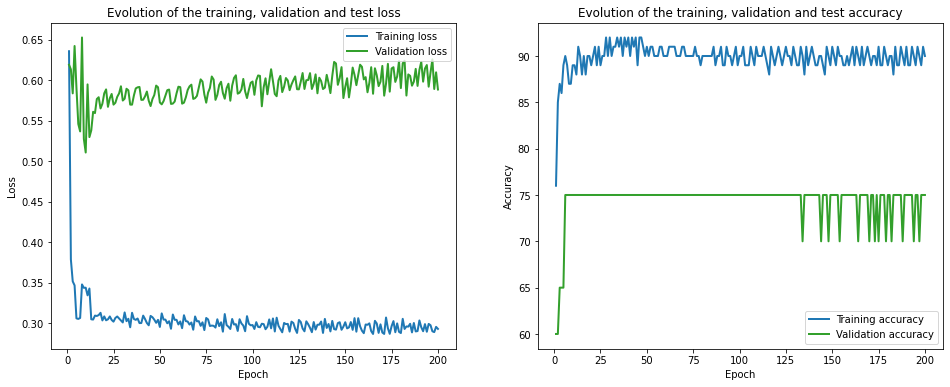

Naive benchmark index number is 28, false positive rate is 0.071130


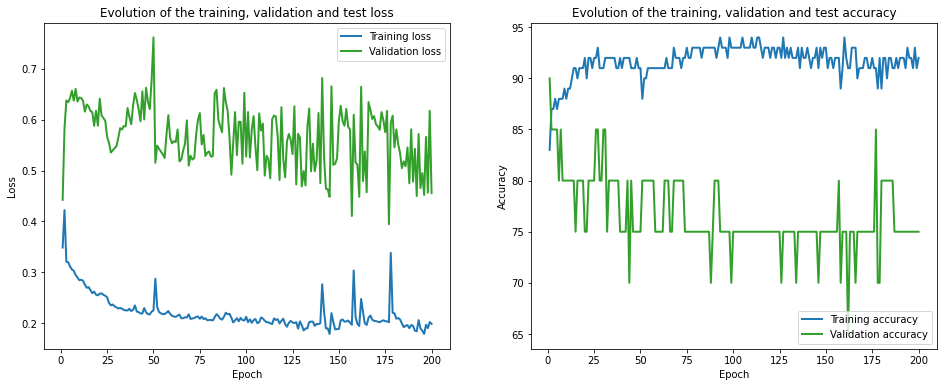

Naive benchmark index number is 29, false positive rate is 0.025105


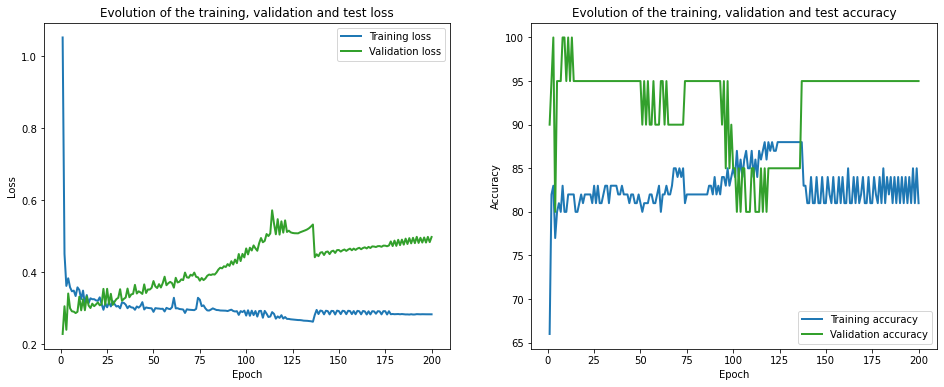

Naive benchmark index number is 30, false positive rate is 0.054393


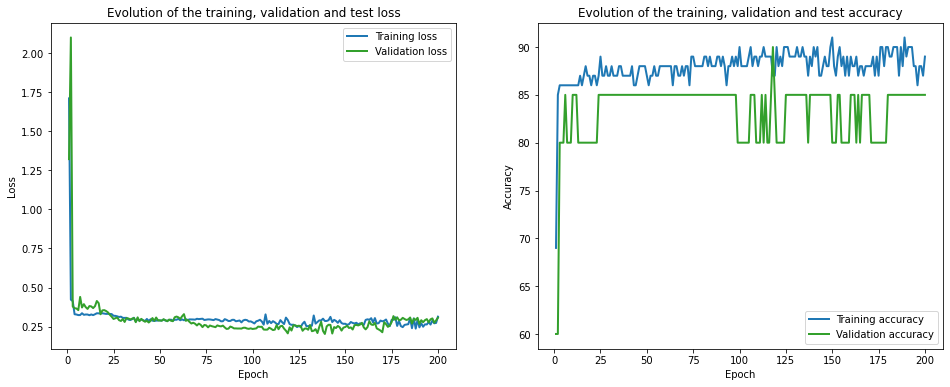

Naive benchmark index number is 31, false positive rate is 0.117155


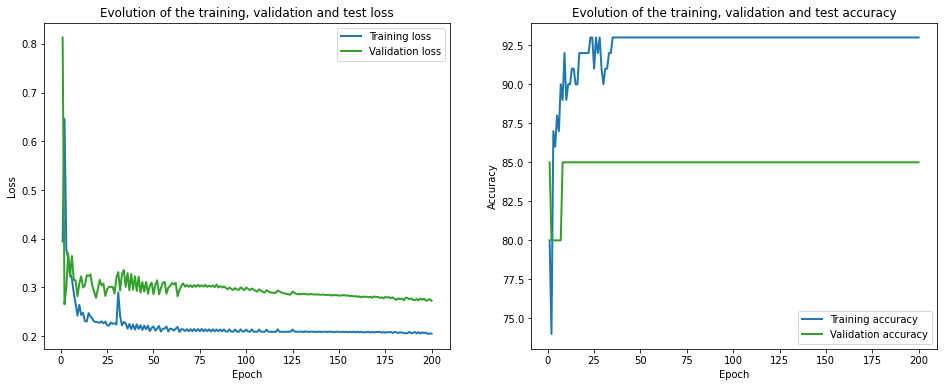

Naive benchmark index number is 32, false positive rate is 0.117155


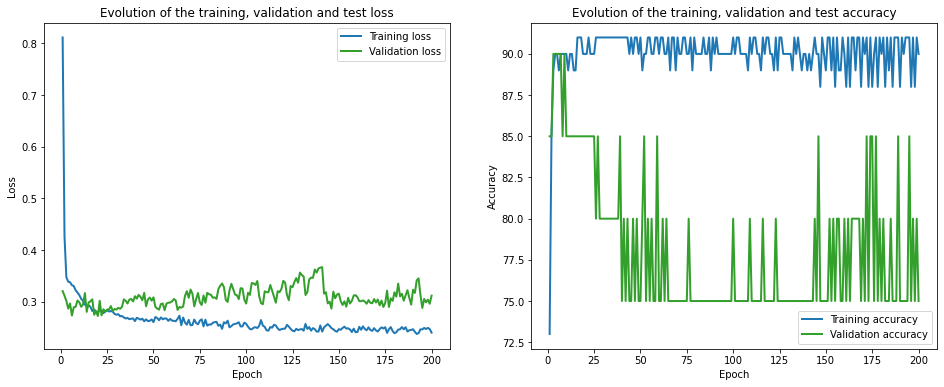

Naive benchmark index number is 33, false positive rate is 0.138075


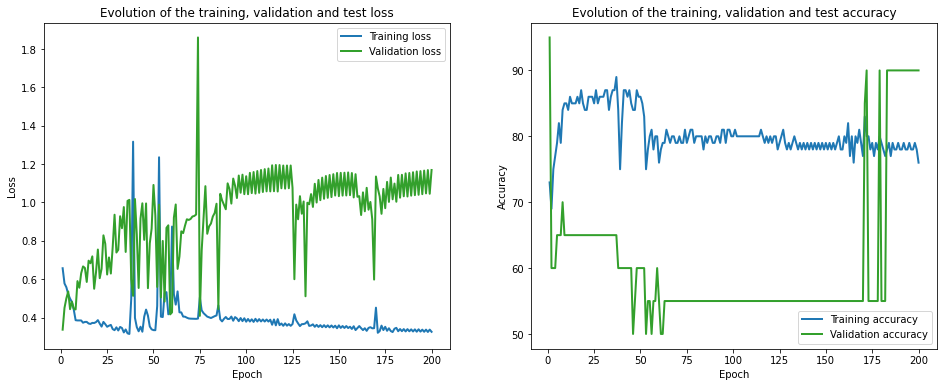

Naive benchmark index number is 34, false positive rate is 0.096234


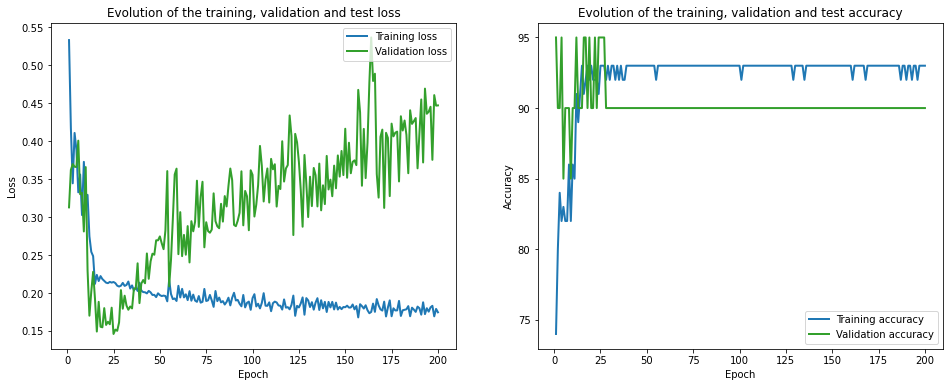

Naive benchmark index number is 35, false positive rate is 0.138075


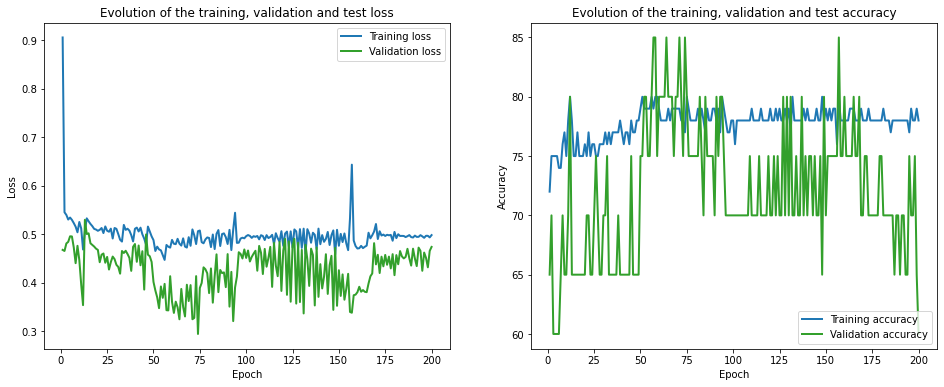

Naive benchmark index number is 36, false positive rate is 0.179916


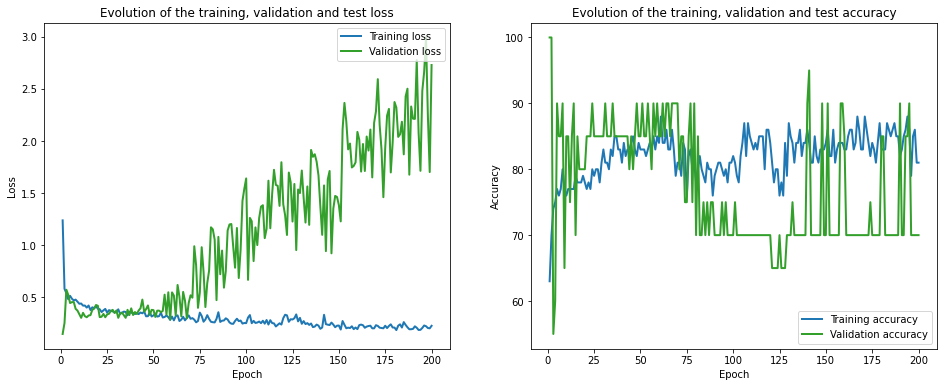

Naive benchmark index number is 37, false positive rate is 0.100418


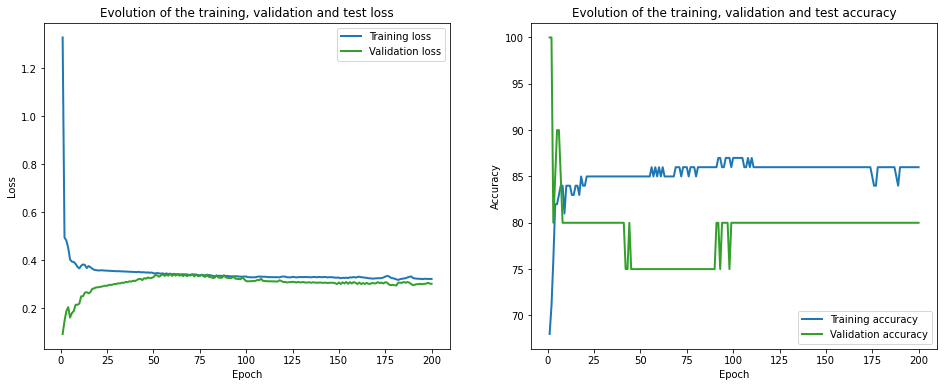

Naive benchmark index number is 38, false positive rate is 0.138075


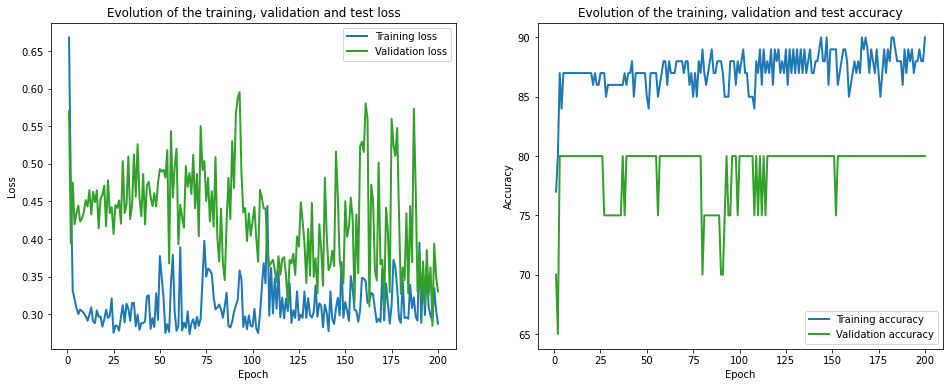

Naive benchmark index number is 39, false positive rate is 0.058577


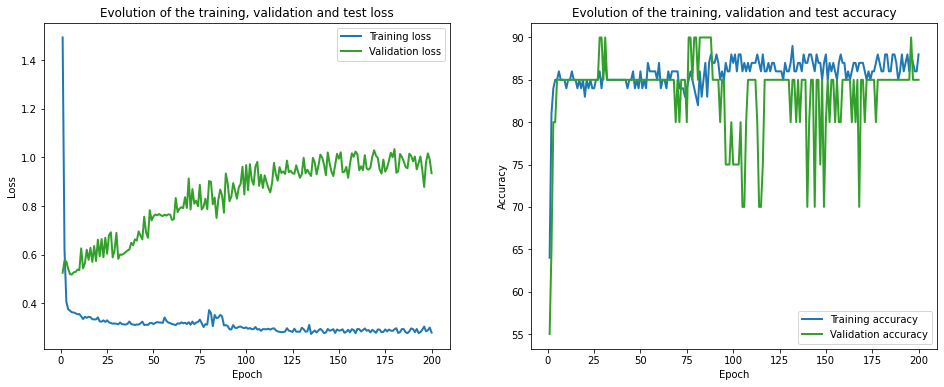

Naive benchmark index number is 40, false positive rate is 0.087866


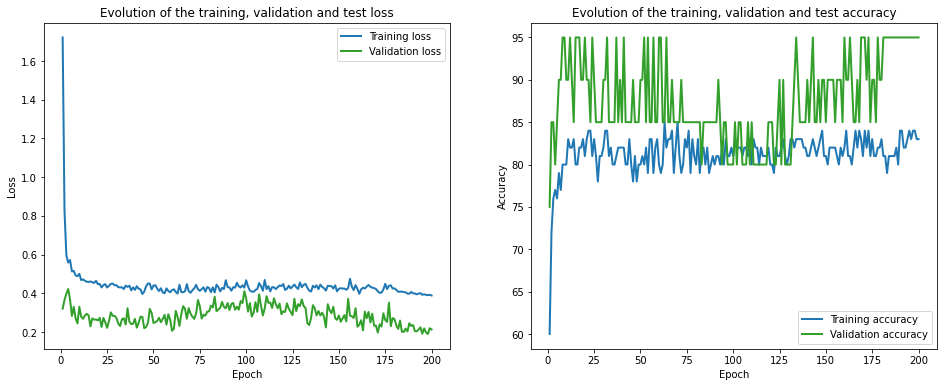

Naive benchmark index number is 41, false positive rate is 0.142259


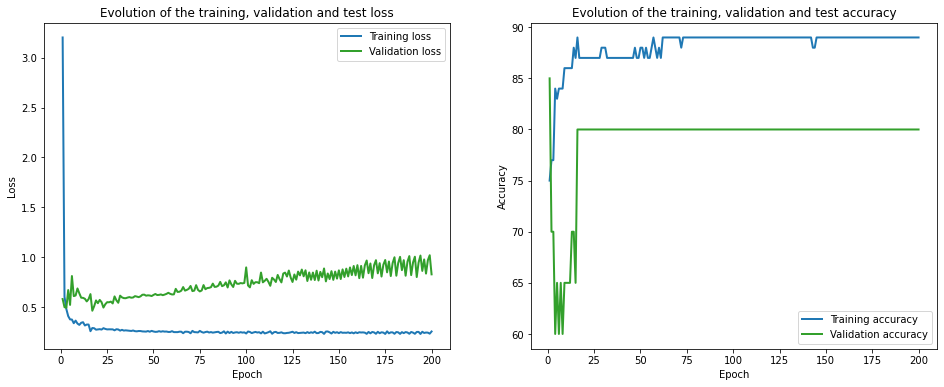

Naive benchmark index number is 42, false positive rate is 0.146444


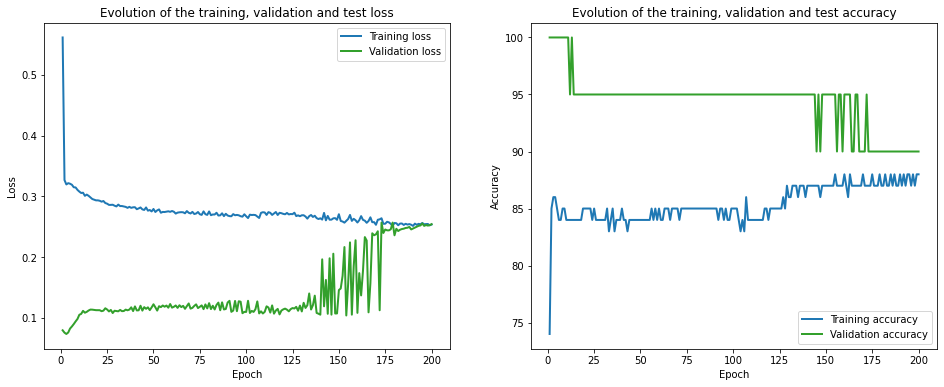

Naive benchmark index number is 43, false positive rate is 0.104603


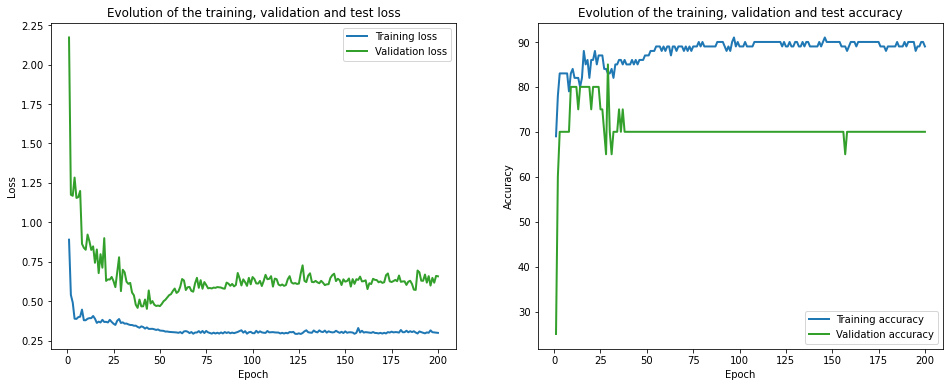

Naive benchmark index number is 44, false positive rate is 0.104603


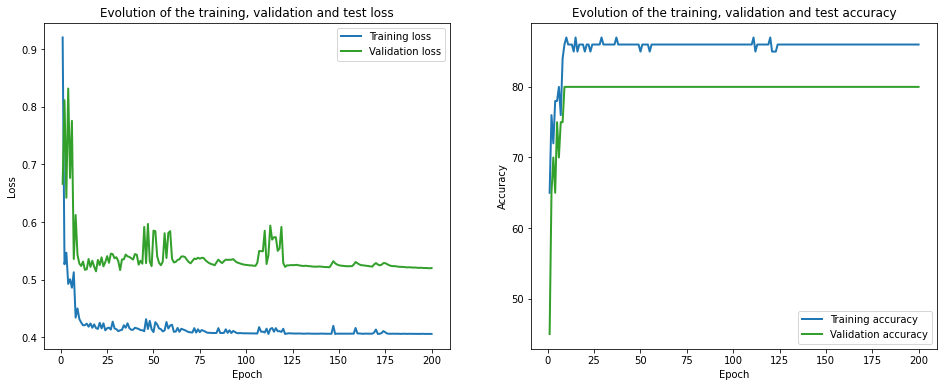

Naive benchmark index number is 45, false positive rate is 0.146444


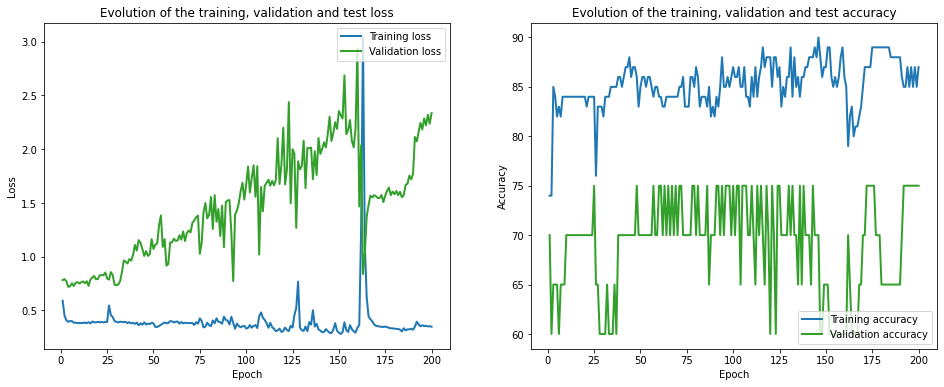

Naive benchmark index number is 46, false positive rate is 0.117155


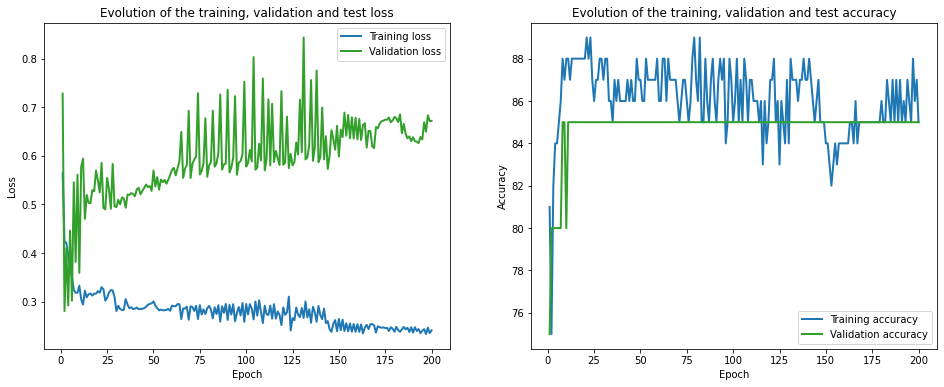

Naive benchmark index number is 47, false positive rate is 0.171548


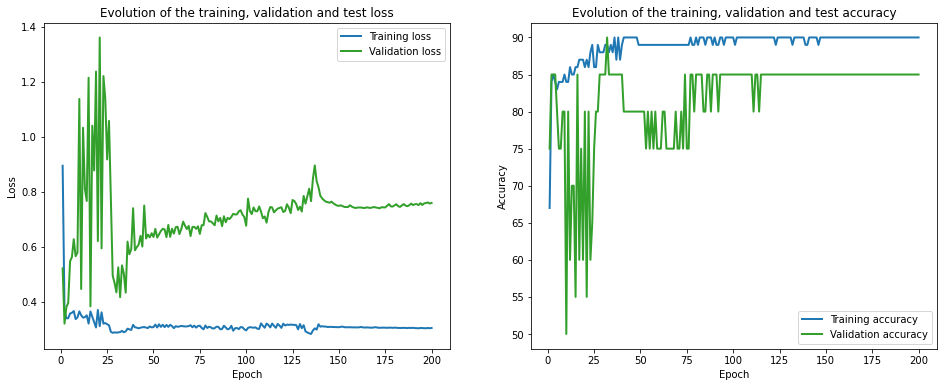

Naive benchmark index number is 48, false positive rate is 0.205021


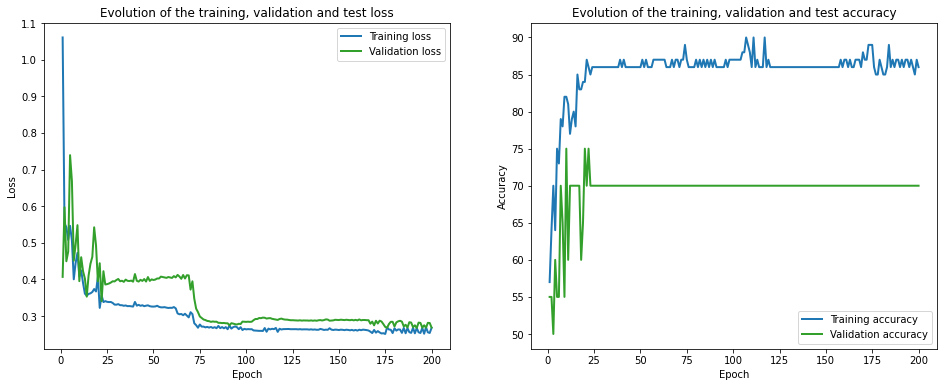

Naive benchmark index number is 49, false positive rate is 0.100418


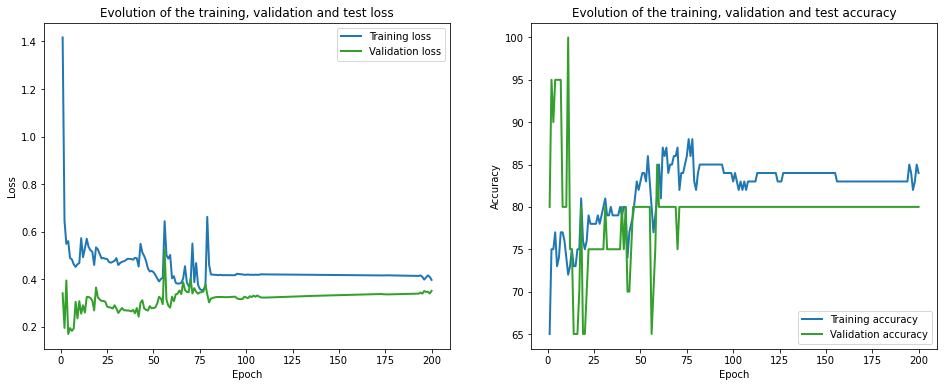

In [16]:
for i in range(len(nb_results)):
    print('Naive benchmark index number is {:d}, false positive rate is {:4f}'.format(i,nb_results.iloc[i]["Fixed-FPR"]))
    plot_loss_acc(nb_results.iloc[i].train_loss_history, nb_results.iloc[i].val_loss_history, 
                      nb_results.iloc[i].train_acc_history, nb_results.iloc[i].val_acc_history)